In [16]:
!pip install scikit-optimize
!pip install statsmodels

In [17]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np
from collections import Counter

import statsmodels.stats.api as sms
from matplotlib import style
style.use('seaborn')
%matplotlib inline
#graphs in svg look clearer
%config InlineBackend.figure_format = 'svg' 

In [18]:
import warnings
warnings.filterwarnings("ignore")

# Functions

In [19]:
from sklearn import metrics

def mae(y_gt, Y_pr):
    return metrics.mean_absolute_error(y_gt, Y_pr)

def mse(y_gt, Y_pr):
    return metrics.mean_squared_error(y_gt, Y_pr)

def rmse(y_gt, Y_pr):
    my_mse = mse(y_gt, Y_pr)
    return np.sqrt(my_mse)

def medae(y_gt, Y_pr):
    return metrics.median_absolute_error(y_gt, Y_pr)

def R2(y_gt, Y_pr):
    return metrics.r2_score(y_gt, Y_pr)

def calc_metrics(true, pred):

    mse1 = mse(true, pred)

    rmse1 = rmse(true, pred)

    mae1 = mae(true, pred)

    medae1 = medae(true, pred)

    R21 = R2(true, pred)

    print('*** VAL **: ')
    print("MSE:   {}\nRMSE:  {}\nR2:    {}\nMAE:   {}\nMedAE: {}".format(mse1, rmse1, R21, mae1, medae1))
    print('-'*30)

In [20]:
def target_distr_linear(train_label, test_label, predicted_dv): 
    sns.kdeplot(train_label, label='train')
    sns.kdeplot(test_label, label='test')
    sns.kdeplot(predicted_dv, label='pred')
    plt.legend()
    plt.show()

    sns.scatterplot(test_label, predicted_dv, color='blueviolet')
    plt.title('Linear model')
    plt.xlabel('True Values')
    plt.ylabel('Predictions')
    plt.show()

In [21]:
from scipy.stats import norm

def draw_histogram(data):
    f,ax_hist = plt.subplots(1)
    sns.distplot(data, hist=True,  kde=True, rug=True, bins=10, fit=norm, ax=ax_hist);
    plt.xlabel("values")
    plt.title("Distribution") 

    mean=data.mean()

    ax_hist.axvline(mean, color='r', linestyle='--', label=f"Mean={mean:.3f}")
    ax_hist.legend()

    plt.show()

In [22]:
def draw_res_analys(errors, pred):
    sns.scatterplot(list(range(len(errors))),errors);
    plt.title("Distibution of errors")
    plt.ylabel('Error');
    plt.xlabel('Index');
    plt.show();

    sns.scatterplot(pred,errors);
    plt.title('Relationship of true value vs error (resudual analysis)')
    plt.ylabel('Error');
    plt.xlabel('True value');
    plt.show();

In [23]:
def get_feature_imp(model, X_train):
    imp = model.get_feature_importance(data=X_train)
    fig, axes = plt.subplots(1, 1, figsize=(12, 8))
    axes.barh(width=imp, y=model.feature_names_)
    axes.set_title('Finetuned Catboost feature importance')
    plt.show()

### Load df

In [24]:
import pickle

with open('./dataset_FOREIGN_kws_oscr_PCA.pkl', 'rb') as f:
    df = pickle.load(f, encoding='utf-8')

In [25]:
df.shape

(8784, 33867)

# Preprocessing

In [26]:
prep_df = df.copy(deep=True)

In [27]:
prep_df.shape

(8784, 33867)

In [28]:
prep_df.isna().sum()

age_access_type         0
name                    0
director                3
genre                   0
average_rating        337
                     ... 
has_oscar_director      0
has_oscar_editor        0
has_oscar_operator      0
has_oscar_producer      0
has_oscar_writer        0
Length: 33867, dtype: int64

### filter by year

In [29]:
prep_df = prep_df[prep_df['release_year'] >= 2000]

In [30]:
prep_df.shape

(6773, 33867)

In [31]:
prep_df.isna().sum()

age_access_type         0
name                    0
director                0
genre                   0
average_rating        321
                     ... 
has_oscar_director      0
has_oscar_editor        0
has_oscar_operator      0
has_oscar_producer      0
has_oscar_writer        0
Length: 33867, dtype: int64

### topN

In [32]:
prep_df.dropna(subset=['ACTOR', 'COMPOSER', 'DESIGN', 'DIRECTOR', 'EDITOR', 'OPERATOR', 'PRODUCER', 'WRITER'],
              inplace=True)


In [33]:
prep_df.shape

(4820, 33867)

In [34]:
prep_df.isna().sum()

age_access_type         0
name                    0
director                0
genre                   0
average_rating        118
                     ... 
has_oscar_director      0
has_oscar_editor        0
has_oscar_operator      0
has_oscar_producer      0
has_oscar_writer        0
Length: 33867, dtype: int64

In [35]:
def add_topN_feature(df, col, n: int):
    items = []
    
    for i in df[col]:
        items.extend(i)

    topN = [x[0] for x in Counter(items).most_common()][:n]

    df[f'top{n}{col}'] = df[col].apply(lambda x: [int(item in x) for item in topN])
    df.drop(col, axis=1, inplace=True)
    return topN, f'top{n}{col}'

In [36]:
def ohe_topN_features(df, topN, cat):
    for i in range(len(topN)):
        df[f'{topN[i]}'] = [item[i] for item in df[cat]]
    df.drop(cat, axis=1, inplace=True)
    return df

In [37]:
prep_df.columns

Index(['age_access_type', 'name', 'director', 'genre', 'average_rating',
       'type', 'country', 'release_type', 'release_year', 'duration',
       ...
       'млрд', 'рф', 'has_oscar_actor', 'has_oscar_composer',
       'has_oscar_design', 'has_oscar_director', 'has_oscar_editor',
       'has_oscar_operator', 'has_oscar_producer', 'has_oscar_writer'],
      dtype='object', length=33867)

In [38]:
top10genres, name = add_topN_feature(prep_df, 'genre', 10)
prep_df = ohe_topN_features(prep_df, top10genres, name)

top5countries, name = add_topN_feature(prep_df, 'country', 5)
prep_df = ohe_topN_features(prep_df, top5countries, name)

top10actors, name = add_topN_feature(prep_df, 'ACTOR', 10)
prep_df = ohe_topN_features(prep_df, top10actors, name)

top3directors, name = add_topN_feature(prep_df, 'COMPOSER', 3)
prep_df = ohe_topN_features(prep_df, top3directors, name)

top2DESIGN, name = add_topN_feature(prep_df, 'DESIGN', 2)
prep_df = ohe_topN_features(prep_df, top2DESIGN, name)

top2DIRECTOR, name = add_topN_feature(prep_df, 'DIRECTOR', 2)
prep_df = ohe_topN_features(prep_df, top2DIRECTOR, name)

top2EDITOR, name = add_topN_feature(prep_df, 'EDITOR', 2)
prep_df = ohe_topN_features(prep_df, top2EDITOR, name)

top2OPERATOR, name = add_topN_feature(prep_df, 'OPERATOR', 2)
prep_df = ohe_topN_features(prep_df, top2OPERATOR, name)

top3PRODUCER, name = add_topN_feature(prep_df, 'PRODUCER', 3)
prep_df = ohe_topN_features(prep_df, top3PRODUCER, name)

top2WRITER, name = add_topN_feature(prep_df, 'WRITER', 2)
prep_df = ohe_topN_features(prep_df, top2WRITER, name)

In [39]:
prep_df.head().T

,4,5,11,13,16
age_access_type,6,16,16,6,16
name,Пламенное сердце,Роман с кукушкой,Звездный путь,Пес-самурай и город кошек,Стартрек: Бесконечность
director,"[40f78e6d-3c9f-434f-a505-c6ffdd045763, 332105c...",[f5fba6fe-94b3-4e69-acfc-da6867320386],[5a7ba90d-25b5-40ed-aa38-c923850c254c],"[558348e8-62ac-43b9-bbcb-02ed0a6325c8, 84155e6...",[d4ecb571-a231-4d94-8c78-1f84e674c53e]
average_rating,6.4,NaN,7.75,7.2,6.9
type,MOVIE,MOVIE,MOVIE,MOVIE,MOVIE
...,...,...,...,...,...
Харви Вайнштейн,0,0,0,0,0
Боб Вайнштейн,0,0,0,0,0
Адриан Политовски,0,0,0,1,0
Люк Бессон,0,0,0,0,0


In [40]:
prep_df.columns[:30]

Index(['age_access_type', 'name', 'director', 'average_rating', 'type',
       'release_type', 'release_year', 'duration', 'actor', 'element_uid',
       'BUDGET', 'MARKETING', 'RUS', 'USA', 'WORLD', 'element_id', 'rating',
       'джек', 'расследовать', 'подруга', 'ограбление', 'катя', 'макс',
       'мечтать', 'отважный', 'фрэнк', 'воспитывать', 'супергерой',
       'безжалостный', 'маньяк'],
      dtype='object')

In [41]:
# cols = ['age_access_type', 'name', 'type',
#        'release_year', 'duration', 'element_uid',
#        'BUDGET', 'MARKETING', 'RUS', 'USA', 'WORLD', 'element_id',
#         'rating',
#        'Drama', 'Comedy', 'Thriller', 'Action',
#        '364fdc2e-bdfe-40be-b2c5-d30f43ec432e', 'Adventure', 'Melodrama',
#        'Sci-Fi', 'Horror', '9fa28b61-a257-4a3e-945b-a9ef76a146d6', 'Family',
#        'usa', 'great-britain', 'russia', 'france', 'germany', 'canada',
#        'Бернард Коллако', 'Роджер Бреннер', 'Марк Фальво', 'Крис Уилсон',
#        'Джимми Стар', 'Ласко Аткинс', 'Розмари Ховард', 'Кадролша Она Кароле',
#        'Ричард Прайс', 'Дж.К. Симмонс', 'Саманта Келли', 'Марко Белтрами',
#        'Джон Дебни', 'Кристоф Бек', 'Джеймс Ньютон Ховард', 'Оливье Берио',
#        'Рави Бансал', 'Коллин Этвуд', 'Дэниэл Эттиэс', 'Адам Дэвидсон',
#        'Такер Гейтс', 'Крис Гилл', 'Майкл Кан', 'Джеффри Форд', 'Джим Дено',
#        'Дариуш Вольски', 'Оливер Вуд', 'Харви Вайнштейн', 'Боб Вайнштейн',
#        'Адриан Политовски', 'Арнон Милчен', 'Стэн Ли', 'Люк Бессон',
#        'Джек Кёрби']

In [42]:
prep_df.drop(['director', 'average_rating', 'release_type', 'actor', 'element_id'], axis=1, inplace=True)

In [43]:
# prep_df = prep_df[cols]

In [44]:
skewed_num_features = ['duration', 'BUDGET', 'MARKETING', 'RUS', 'USA', 'WORLD',] # can try 'average_rating'

In [45]:
from collections import Counter
from sklearn.feature_extraction.text import TfidfVectorizer
import numpy as np
from sklearn.model_selection import train_test_split
import pandas as pd

class Preprocesser:
    def __init__(self, 
#                 mulpiple_cat_features: list,
                skewed_num_features: list,
               # text_features: list,
               # release_year_feature: str,
#                 mltpl_cat_n_top: dict
                ):
#         self.mulpiple_cat_features = mulpiple_cat_features
        self.skewed_num_features = skewed_num_features
        #self.text_features = text_features
#         self.mltpl_cat_n_top = mltpl_cat_n_top
       # self.release_year_feature = release_year_feature
        # self.tokenizer = Tokenizer(nlp.vocab)
        
    def __get_top_n_mltpl_cat_features(self, df_pr, col):
        all_cats = []
        for element_values in df_pr[col]:
            all_cats.extend(element_values)
        return Counter(all_cats).most_common(self.mltpl_cat_n_top[col])
            
    def __preprocess_mulpiple_cat_features(self, df_pr):
        for col in self.mulpiple_cat_features:
            feature_number = self.mltpl_cat_n_top[col]
            df_pr[[f'{col}_{i}' for i in range(feature_number)]] = pd.DataFrame(np.full((len(df), feature_number), np.nan))
            for i in df_pr.index:
                names = df_pr.loc[i, col]
                for k, name in enumerate(names[:int(feature_number)]):
                    df_pr.loc[i, f'{col}_{k}'] = name
            df_pr.drop(col, axis=1, inplace=True)

        return df_pr
    
    def __preprocess_skewed_num_features(self, df_pr):
        for col in self.skewed_num_features:
            df_pr[col] = df_pr[col].apply(lambda x: np.log1p(x))
        return df_pr
    
    def __preprocess_text_features(self, df_pr):
        for col in self.text_features:
            df_pr[col] = df_pr[col].apply(lambda x: self.tokenizer(x))
        return df_pr
            
    def preprocess(self,
                   df: pd.DataFrame):
        df_pr = df.copy()
#         df_pr = self.__preprocess_mulpiple_cat_features(df_pr)
        df_pr = self.__preprocess_skewed_num_features(df_pr)
        # df_pr = self.__preprocess_text_features(df_pr)
        
        return df_pr
        

In [46]:
preprocesser = Preprocesser(
#     mltpl_cat_features,
            skewed_num_features,
            #text_features,
#             mltpl_cat_n_top
                           )

In [47]:
df_pr = preprocesser.preprocess(prep_df)

In [48]:
df_pr.isnull().sum()

age_access_type      0
name                 0
type                 0
release_year         0
duration             0
                    ..
Харви Вайнштейн      0
Боб Вайнштейн        0
Адриан Политовски    0
Люк Бессон           0
Стэн Ли              0
Length: 33893, dtype: int64

### target destr

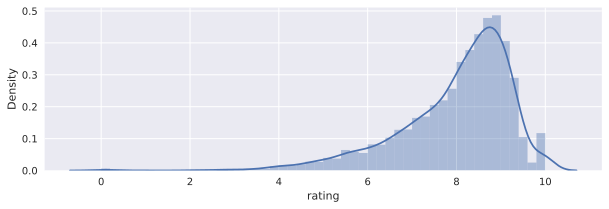

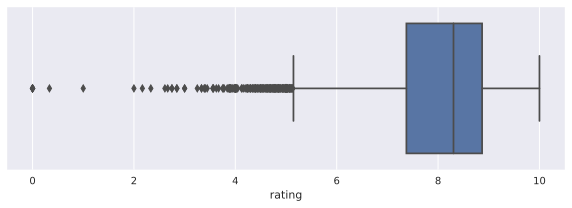

In [49]:
plt.figure(figsize=(10, 3))
sns.distplot(df_pr['rating'])
plt.show()

plt.figure(figsize=(10, 3))
sns.boxplot(df_pr['rating'], orient='h')
plt.show()

### Look at 5 movies for demo

* Чикатило ee48def6-c311-4b73-a878-1a5d3d1679a3,
* Манюня 9b202b16-55bf-418a-b01d-9f0329b18790,
* Оффлайн 49a3d528-44c0-408e-b6fc-a1507ce7641a
* Молодой человек 0271c9b5-b7b2-4e3f-96af-b9cefed99397
* Приплыли! 02eaefe0-296d-4e6f-b52f-2e2507d07103

In [50]:
demo_df = df_pr.loc[df_pr['element_uid'].isin(['ee48def6-c311-4b73-a878-1a5d3d1679a3', 
                                    '9b202b16-55bf-418a-b01d-9f0329b18790',
                                    '49a3d528-44c0-408e-b6fc-a1507ce7641a',
                                    '0271c9b5-b7b2-4e3f-96af-b9cefed99397',
                                    '02eaefe0-296d-4e6f-b52f-2e2507d07103'])]

In [51]:
ddf = demo_df.copy()

In [52]:
ddf.drop(['release_year', 'element_uid', 'name'], axis=1, inplace=True)

In [53]:
ddf.T

""
age_access_type
type
duration
BUDGET
MARKETING
...
Харви Вайнштейн
Боб Вайнштейн
Адриан Политовски
Люк Бессон


## Split

In [54]:
df_pr.columns

Index(['age_access_type', 'name', 'type', 'release_year', 'duration',
       'element_uid', 'BUDGET', 'MARKETING', 'RUS', 'USA',
       ...
       'Такер Гейтс', 'Крис Гилл', 'Майкл Кан', 'Джим Дено', 'Дариуш Вольски',
       'Харви Вайнштейн', 'Боб Вайнштейн', 'Адриан Политовски', 'Люк Бессон',
       'Стэн Ли'],
      dtype='object', length=33893)

In [55]:
from sklearn.model_selection import train_test_split

sorted_df = df_pr.sort_values('release_year')

test = sorted_df[sorted_df['release_year'] == 2022]
train = sorted_df[sorted_df['release_year'] != 2022]

# for looking at samples
test_df = test.copy(deep=True)
train_df = train.copy(deep=True)

test.drop(['release_year', 'element_uid', 'name'], axis=1, inplace=True)
train.drop(['release_year', 'element_uid', 'name'], axis=1, inplace=True)

X_test, y_test = test.drop('rating', axis=1), test['rating']
X, y = train.drop('rating', axis=1), train['rating']
X_train, X_val, y_train, y_val = train_test_split(X, y,
                                                  test_size=0.1, 
                                                  shuffle=False)
X_train.shape, X_val.shape, X_test.shape, y_train.shape, y_val.shape, y_test.shape


((4276, 33889), (476, 33889), (68, 33889), (4276,), (476,), (68,))

In [56]:
X_train.columns

Index(['age_access_type', 'type', 'duration', 'BUDGET', 'MARKETING', 'RUS',
       'USA', 'WORLD', 'джек', 'расследовать',
       ...
       'Такер Гейтс', 'Крис Гилл', 'Майкл Кан', 'Джим Дено', 'Дариуш Вольски',
       'Харви Вайнштейн', 'Боб Вайнштейн', 'Адриан Политовски', 'Люк Бессон',
       'Стэн Ли'],
      dtype='object', length=33889)

In [57]:
cat_features = ['age_access_type', 'type']

## Get just keywords

In [58]:
X_train.columns[:30]

Index(['age_access_type', 'type', 'duration', 'BUDGET', 'MARKETING', 'RUS',
       'USA', 'WORLD', 'джек', 'расследовать', 'подруга', 'ограбление', 'катя',
       'макс', 'мечтать', 'отважный', 'фрэнк', 'воспитывать', 'супергерой',
       'безжалостный', 'маньяк', 'эксцентричный', 'одержимый', 'влюбляться',
       'капитан', 'приключение', 'плен', 'городок', 'пес', 'побег'],
      dtype='object')

In [59]:
X_train.columns[-50:]

Index(['рф', 'has_oscar_actor', 'has_oscar_composer', 'has_oscar_design',
       'has_oscar_director', 'has_oscar_editor', 'has_oscar_operator',
       'has_oscar_producer', 'has_oscar_writer', 'Drama', 'Comedy', 'Thriller',
       'Action', '364fdc2e-bdfe-40be-b2c5-d30f43ec432e', 'Adventure', 'Sci-Fi',
       'Horror', 'Melodrama', '9fa28b61-a257-4a3e-945b-a9ef76a146d6', 'usa',
       'great-britain', 'france', 'germany', 'canada', 'Бернард Коллако',
       'Роджер Бреннер', 'Марк Фальво', 'Крис Уилсон', 'Джимми Стар',
       'Ласко Аткинс', 'Розмари Ховард', 'Кадролша Она Кароле',
       'Дж.К. Симмонс', 'Саманта Келли', 'Джон Дебни', 'Марко Белтрами',
       'Кристоф Бек', 'Оливье Берио', 'Рави Бансал', 'Адам Дэвидсон',
       'Такер Гейтс', 'Крис Гилл', 'Майкл Кан', 'Джим Дено', 'Дариуш Вольски',
       'Харви Вайнштейн', 'Боб Вайнштейн', 'Адриан Политовски', 'Люк Бессон',
       'Стэн Ли'],
      dtype='object')

In [60]:
X_train_kws = X_train.drop(['age_access_type', 'type', 'duration', 'BUDGET', 'MARKETING', 'RUS',
       'USA', 'WORLD','has_oscar_actor', 'has_oscar_composer', 'has_oscar_design',
       'has_oscar_director', 'has_oscar_editor', 'has_oscar_operator',
       'has_oscar_producer', 'has_oscar_writer', 'Drama', 'Comedy', 'Thriller',
       'Action', '364fdc2e-bdfe-40be-b2c5-d30f43ec432e', 'Adventure', 'Sci-Fi',
       'Horror', 'Melodrama', '9fa28b61-a257-4a3e-945b-a9ef76a146d6', 'usa',
       'great-britain', 'france', 'germany', 'canada', 'Бернард Коллако',
       'Роджер Бреннер', 'Марк Фальво', 'Крис Уилсон', 'Джимми Стар',
       'Ласко Аткинс', 'Розмари Ховард', 'Кадролша Она Кароле',
       'Дж.К. Симмонс', 'Саманта Келли', 'Джон Дебни', 'Марко Белтрами',
       'Кристоф Бек', 'Оливье Берио', 'Рави Бансал', 'Адам Дэвидсон',
       'Такер Гейтс', 'Крис Гилл', 'Майкл Кан', 'Джим Дено', 'Дариуш Вольски',
       'Харви Вайнштейн', 'Боб Вайнштейн', 'Адриан Политовски', 'Люк Бессон',
       'Стэн Ли'], axis=1)

X_train_df = X_train[['age_access_type', 'type', 'duration', 'BUDGET', 'MARKETING', 'RUS',
       'USA', 'WORLD','has_oscar_actor', 'has_oscar_composer', 'has_oscar_design',
       'has_oscar_director', 'has_oscar_editor', 'has_oscar_operator',
       'has_oscar_producer', 'has_oscar_writer', 'Drama', 'Comedy', 'Thriller',
       'Action', '364fdc2e-bdfe-40be-b2c5-d30f43ec432e', 'Adventure', 'Sci-Fi',
       'Horror', 'Melodrama', '9fa28b61-a257-4a3e-945b-a9ef76a146d6', 'usa',
       'great-britain', 'france', 'germany', 'canada', 'Бернард Коллако',
       'Роджер Бреннер', 'Марк Фальво', 'Крис Уилсон', 'Джимми Стар',
       'Ласко Аткинс', 'Розмари Ховард', 'Кадролша Она Кароле',
       'Дж.К. Симмонс', 'Саманта Келли', 'Джон Дебни', 'Марко Белтрами',
       'Кристоф Бек', 'Оливье Берио', 'Рави Бансал', 'Адам Дэвидсон',
       'Такер Гейтс', 'Крис Гилл', 'Майкл Кан', 'Джим Дено', 'Дариуш Вольски',
       'Харви Вайнштейн', 'Боб Вайнштейн', 'Адриан Политовски', 'Люк Бессон',
       'Стэн Ли']]

X_val_kws = X_val.drop(['age_access_type', 'type', 'duration', 'BUDGET', 'MARKETING', 'RUS',
       'USA', 'WORLD','has_oscar_actor', 'has_oscar_composer', 'has_oscar_design',
       'has_oscar_director', 'has_oscar_editor', 'has_oscar_operator',
       'has_oscar_producer', 'has_oscar_writer', 'Drama', 'Comedy', 'Thriller',
       'Action', '364fdc2e-bdfe-40be-b2c5-d30f43ec432e', 'Adventure', 'Sci-Fi',
       'Horror', 'Melodrama', '9fa28b61-a257-4a3e-945b-a9ef76a146d6', 'usa',
       'great-britain', 'france', 'germany', 'canada', 'Бернард Коллако',
       'Роджер Бреннер', 'Марк Фальво', 'Крис Уилсон', 'Джимми Стар',
       'Ласко Аткинс', 'Розмари Ховард', 'Кадролша Она Кароле',
       'Дж.К. Симмонс', 'Саманта Келли', 'Джон Дебни', 'Марко Белтрами',
       'Кристоф Бек', 'Оливье Берио', 'Рави Бансал', 'Адам Дэвидсон',
       'Такер Гейтс', 'Крис Гилл', 'Майкл Кан', 'Джим Дено', 'Дариуш Вольски',
       'Харви Вайнштейн', 'Боб Вайнштейн', 'Адриан Политовски', 'Люк Бессон',
       'Стэн Ли'], axis=1)

X_val_df = X_val[['age_access_type', 'type', 'duration', 'BUDGET', 'MARKETING', 'RUS',
       'USA', 'WORLD','has_oscar_actor', 'has_oscar_composer', 'has_oscar_design',
       'has_oscar_director', 'has_oscar_editor', 'has_oscar_operator',
       'has_oscar_producer', 'has_oscar_writer', 'Drama', 'Comedy', 'Thriller',
       'Action', '364fdc2e-bdfe-40be-b2c5-d30f43ec432e', 'Adventure', 'Sci-Fi',
       'Horror', 'Melodrama', '9fa28b61-a257-4a3e-945b-a9ef76a146d6', 'usa',
       'great-britain', 'france', 'germany', 'canada', 'Бернард Коллако',
       'Роджер Бреннер', 'Марк Фальво', 'Крис Уилсон', 'Джимми Стар',
       'Ласко Аткинс', 'Розмари Ховард', 'Кадролша Она Кароле',
       'Дж.К. Симмонс', 'Саманта Келли', 'Джон Дебни', 'Марко Белтрами',
       'Кристоф Бек', 'Оливье Берио', 'Рави Бансал', 'Адам Дэвидсон',
       'Такер Гейтс', 'Крис Гилл', 'Майкл Кан', 'Джим Дено', 'Дариуш Вольски',
       'Харви Вайнштейн', 'Боб Вайнштейн', 'Адриан Политовски', 'Люк Бессон',
       'Стэн Ли']]

X_test_kws = X_test.drop(['age_access_type', 'type', 'duration', 'BUDGET', 'MARKETING', 'RUS',
       'USA', 'WORLD','has_oscar_actor', 'has_oscar_composer', 'has_oscar_design',
       'has_oscar_director', 'has_oscar_editor', 'has_oscar_operator',
       'has_oscar_producer', 'has_oscar_writer', 'Drama', 'Comedy', 'Thriller',
       'Action', '364fdc2e-bdfe-40be-b2c5-d30f43ec432e', 'Adventure', 'Sci-Fi',
       'Horror', 'Melodrama', '9fa28b61-a257-4a3e-945b-a9ef76a146d6', 'usa',
       'great-britain', 'france', 'germany', 'canada', 'Бернард Коллако',
       'Роджер Бреннер', 'Марк Фальво', 'Крис Уилсон', 'Джимми Стар',
       'Ласко Аткинс', 'Розмари Ховард', 'Кадролша Она Кароле',
       'Дж.К. Симмонс', 'Саманта Келли', 'Джон Дебни', 'Марко Белтрами',
       'Кристоф Бек', 'Оливье Берио', 'Рави Бансал', 'Адам Дэвидсон',
       'Такер Гейтс', 'Крис Гилл', 'Майкл Кан', 'Джим Дено', 'Дариуш Вольски',
       'Харви Вайнштейн', 'Боб Вайнштейн', 'Адриан Политовски', 'Люк Бессон',
       'Стэн Ли'], axis=1)

X_test_df = X_test[['age_access_type', 'type', 'duration', 'BUDGET', 'MARKETING', 'RUS',
       'USA', 'WORLD','has_oscar_actor', 'has_oscar_composer', 'has_oscar_design',
       'has_oscar_director', 'has_oscar_editor', 'has_oscar_operator',
       'has_oscar_producer', 'has_oscar_writer', 'Drama', 'Comedy', 'Thriller',
       'Action', '364fdc2e-bdfe-40be-b2c5-d30f43ec432e', 'Adventure', 'Sci-Fi',
       'Horror', 'Melodrama', '9fa28b61-a257-4a3e-945b-a9ef76a146d6', 'usa',
       'great-britain', 'france', 'germany', 'canada', 'Бернард Коллако',
       'Роджер Бреннер', 'Марк Фальво', 'Крис Уилсон', 'Джимми Стар',
       'Ласко Аткинс', 'Розмари Ховард', 'Кадролша Она Кароле',
       'Дж.К. Симмонс', 'Саманта Келли', 'Джон Дебни', 'Марко Белтрами',
       'Кристоф Бек', 'Оливье Берио', 'Рави Бансал', 'Адам Дэвидсон',
       'Такер Гейтс', 'Крис Гилл', 'Майкл Кан', 'Джим Дено', 'Дариуш Вольски',
       'Харви Вайнштейн', 'Боб Вайнштейн', 'Адриан Политовски', 'Люк Бессон',
       'Стэн Ли']]

## Standartization

In [61]:
from sklearn.preprocessing import StandardScaler
sc = StandardScaler()

X_train_kws = sc.fit_transform(X_train_kws)
X_val_kws = sc.transform(X_val_kws)
X_test_kws = sc.transform(X_test_kws)

## PCA

In [62]:
from sklearn.decomposition import PCA

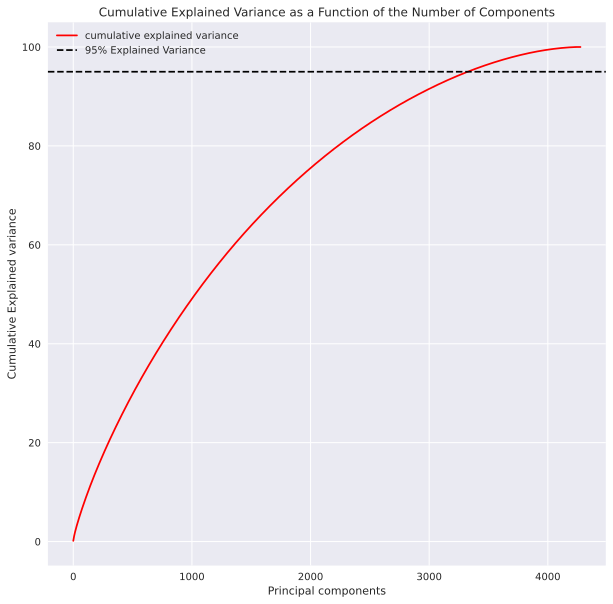

In [63]:
pca = PCA()
pca.fit(X_train_kws)
cumsum = np.cumsum(pca.explained_variance_ratio_)*100
d = [n for n in range(len(cumsum))]
plt.figure(figsize=(10, 10))
plt.plot(d,cumsum, color = 'red',label='cumulative explained variance')
plt.title('Cumulative Explained Variance as a Function of the Number of Components')
plt.ylabel('Cumulative Explained variance')
plt.xlabel('Principal components')
plt.axhline(y = 95, color='k', linestyle='--', label = '95% Explained Variance')
plt.legend(loc='best')

In [64]:
pca.n_components_

4276

In [87]:
pca = PCA(n_components=1000) # 3000

X_train_kws_pca = pca.fit_transform(X_train_kws)
X_val_kws_pca = pca.transform(X_val_kws)
X_test_kws_pca = pca.transform(X_test_kws)

**Convert to dataframe**

In [88]:
component_names = [f"PC{i+1}" for i in range(X_train_kws_pca.shape[1])]
X_train_kws_pca = pd.DataFrame(X_train_kws_pca, columns=component_names)
X_train_kws_pca.head()

,PC1,PC2,PC3,PC4,PC5,PC6,PC7,PC8,PC9,PC10,...,PC991,PC992,PC993,PC994,PC995,PC996,PC997,PC998,PC999,PC1000
0,1.485026,-0.471850,-0.056456,1.766362,0.935805,-0.312928,-0.105211,-0.120156,-0.483745,-0.078238,...,-3.322456,-0.494393,-1.521862,0.349129,3.529696,-0.118794,4.239640,-1.067011,3.106492,0.149633
1,-0.052180,-0.084550,0.065255,0.002086,-0.418819,-0.164943,-0.037394,-0.748211,-0.031083,-0.135751,...,-1.112973,-1.386158,0.458198,-1.839602,1.448493,-0.495140,0.818220,0.767085,1.419664,-0.649999
2,-0.160094,-0.447951,0.321590,0.510548,-0.063877,0.399198,3.412473,3.546884,5.237045,-0.269705,...,2.243123,3.506607,-8.895172,-6.306863,2.669038,1.308034,4.597078,3.361645,-7.067294,2.108814
3,-0.359653,0.273460,-0.347768,-0.045992,-0.500713,0.604164,-0.962203,-0.198036,0.448968,-0.311006,...,5.032947,-6.470477,-2.362281,0.870717,-7.279201,-0.688991,-4.589163,2.112380,-2.146580,0.416655
4,-0.225732,-0.548083,-0.066500,1.250071,0.225342,0.554550,2.228710,-1.558322,-0.204255,-0.345307,...,1.819791,-6.388084,-0.325924,1.670823,1.506934,2.591821,1.266295,-5.413752,3.582288,-0.788037


In [89]:
X_train_df = X_train_df.reset_index().drop('index', axis=1)
X_train = X_train_df.join(X_train_kws_pca, on=X_train_df.index)
X_train.head()

,age_access_type,type,duration,BUDGET,MARKETING,RUS,USA,WORLD,has_oscar_actor,has_oscar_composer,...,PC991,PC992,PC993,PC994,PC995,PC996,PC997,PC998,PC999,PC1000
0,12,MOVIE,15.479437,NaN,NaN,13.270785,13.347369,17.921885,0,0,...,-3.322456,-0.494393,-1.521862,0.349129,3.529696,-0.118794,4.239640,-1.067011,3.106492,0.149633
1,16,MOVIE,15.597220,17.216708,NaN,NaN,16.877041,16.877041,0,0,...,-1.112973,-1.386158,0.458198,-1.839602,1.448493,-0.495140,0.818220,0.767085,1.419664,-0.649999
2,18,MOVIE,16.039053,18.450240,17.56971,14.062371,19.050384,19.948006,0,0,...,2.243123,3.506607,-8.895172,-6.306863,2.669038,1.308034,4.597078,3.361645,-7.067294,2.108814
3,12,MOVIE,15.617221,17.989898,NaN,NaN,17.446812,18.323362,0,0,...,5.032947,-6.470477,-2.362281,0.870717,-7.279201,-0.688991,-4.589163,2.112380,-2.146580,0.416655
4,16,MOVIE,15.720599,14.508658,NaN,NaN,14.271217,14.531609,0,0,...,1.819791,-6.388084,-0.325924,1.670823,1.506934,2.591821,1.266295,-5.413752,3.582288,-0.788037


In [90]:
component_names = [f"PC{i+1}" for i in range(X_val_kws_pca.shape[1])]
X_val_kws_pca = pd.DataFrame(X_val_kws_pca, columns=component_names)
X_val_kws_pca.head()

,PC1,PC2,PC3,PC4,PC5,PC6,PC7,PC8,PC9,PC10,...,PC991,PC992,PC993,PC994,PC995,PC996,PC997,PC998,PC999,PC1000
0,-0.471490,-0.248845,0.044249,-0.480287,0.836079,-0.335604,-0.291960,-0.364544,0.226145,-0.285812,...,0.748819,0.052687,0.049231,0.488529,0.502815,0.652362,-0.911773,-0.780625,0.433479,0.725775
1,-0.350243,1.153307,2.537339,-0.163178,-0.267115,-0.368040,-0.375797,-0.331860,0.058396,-0.248241,...,0.901066,0.054097,0.244170,0.667603,-0.198765,-1.915155,1.054593,-0.224438,0.771800,-0.147484
2,-0.137171,-0.339699,-0.170655,-0.036151,-0.207869,0.682815,-0.301696,0.340408,0.258738,0.062377,...,1.839920,-0.173293,-0.078429,0.472918,0.844495,1.446779,-0.243994,0.120837,0.139536,-2.003207
3,-0.433011,-0.555253,-0.032970,-0.325062,0.001934,-0.458072,-0.482814,-0.055682,-0.114011,-0.241879,...,1.121582,-0.072514,0.196017,-1.766099,0.578850,-0.509290,0.535520,0.940910,0.164934,1.150250
4,1.974908,-0.122853,-0.266515,0.032982,-0.309094,-0.763170,2.743062,9.486577,-8.171220,-3.751516,...,0.127835,0.713873,1.258206,-0.173126,-0.275502,-0.547979,-0.307703,-0.965873,-0.031913,0.094533


In [91]:
X_val_df = X_val_df.reset_index().drop('index', axis=1)
X_val = X_val_df.join(X_val_kws_pca, on=X_val_df.index)
X_val.head()

,age_access_type,type,duration,BUDGET,MARKETING,RUS,USA,WORLD,has_oscar_actor,has_oscar_composer,...,PC991,PC992,PC993,PC994,PC995,PC996,PC997,PC998,PC999,PC1000
0,12,MOVIE,15.479437,NaN,NaN,11.419252,NaN,14.269874,0,0,...,0.748819,0.052687,0.049231,0.488529,0.502815,0.652362,-0.911773,-0.780625,0.433479,0.725775
1,16,MOVIE,15.806121,NaN,NaN,9.449279,NaN,13.975485,0,0,...,0.901066,0.054097,0.244170,0.667603,-0.198765,-1.915155,1.054593,-0.224438,0.771800,-0.147484
2,12,MOVIE,15.627073,NaN,NaN,7.149132,NaN,7.151485,0,0,...,1.839920,-0.173293,-0.078429,0.472918,0.844495,1.446779,-0.243994,0.120837,0.139536,-2.003207
3,6,MOVIE,15.566448,NaN,NaN,NaN,NaN,15.981272,0,1,...,1.121582,-0.072514,0.196017,-1.766099,0.578850,-0.509290,0.535520,0.940910,0.164934,1.150250
4,18,MOVIE,15.755690,NaN,NaN,11.680370,8.917981,13.016456,0,0,...,0.127835,0.713873,1.258206,-0.173126,-0.275502,-0.547979,-0.307703,-0.965873,-0.031913,0.094533


In [92]:
component_names = [f"PC{i+1}" for i in range(X_test_kws_pca.shape[1])]
X_test_kws_pca = pd.DataFrame(X_test_kws_pca, columns=component_names)
X_test_kws_pca.head()

,PC1,PC2,PC3,PC4,PC5,PC6,PC7,PC8,PC9,PC10,...,PC991,PC992,PC993,PC994,PC995,PC996,PC997,PC998,PC999,PC1000
0,-0.150024,-0.214686,-0.239231,0.064217,-0.383452,0.149007,-0.465244,-0.223509,-0.155072,-0.424683,...,0.144565,0.501789,-0.101913,-0.465913,0.712357,-0.071560,-0.078798,0.511885,0.407849,1.214165
1,-0.093998,0.267310,-0.454230,-0.015568,-0.491347,-0.211376,0.182109,-0.476342,-0.216152,-0.151017,...,-0.489629,0.495830,0.049965,2.153657,0.461789,-1.169112,0.271379,0.014158,-0.914823,0.111561
2,-0.290231,0.116196,-0.429461,-0.054584,-0.285061,-0.315829,-0.535777,-0.467808,0.014706,-0.227457,...,-0.441606,0.133644,0.333443,-0.171807,0.198096,-0.178365,-0.155862,0.320186,0.270907,-0.112152
3,-0.212464,-0.497434,-0.009460,-0.091527,-0.401606,-0.340733,-0.394081,-0.098496,-0.215399,-0.186259,...,-0.204566,-0.480019,0.253823,0.310363,-0.077001,-0.355869,-0.359097,-0.045853,-0.036754,-0.629017
4,-0.312342,-0.500530,0.000155,-0.034796,-0.389332,-0.352790,-0.302596,-0.481993,0.052255,-0.215210,...,1.165638,0.376894,0.461303,0.910177,0.142992,-0.042557,-0.501815,1.024559,0.977577,0.726386


In [93]:
X_test_df = X_test_df.reset_index().drop('index', axis=1)
X_test = X_test_df.join(X_test_kws_pca, on=X_test_df.index)
X_test.head()

,age_access_type,type,duration,BUDGET,MARKETING,RUS,USA,WORLD,has_oscar_actor,has_oscar_composer,...,PC991,PC992,PC993,PC994,PC995,PC996,PC997,PC998,PC999,PC1000
0,18,SERIAL,17.044733,NaN,NaN,NaN,NaN,NaN,0,0,...,0.144565,0.501789,-0.101913,-0.465913,0.712357,-0.071560,-0.078798,0.511885,0.407849,1.214165
1,18,SERIAL,16.200597,NaN,NaN,NaN,NaN,NaN,0,0,...,-0.489629,0.495830,0.049965,2.153657,0.461789,-1.169112,0.271379,0.014158,-0.914823,0.111561
2,18,SERIAL,16.064695,NaN,NaN,NaN,NaN,NaN,0,0,...,-0.441606,0.133644,0.333443,-0.171807,0.198096,-0.178365,-0.155862,0.320186,0.270907,-0.112152
3,18,SERIAL,16.626117,NaN,NaN,NaN,NaN,NaN,0,0,...,-0.204566,-0.480019,0.253823,0.310363,-0.077001,-0.355869,-0.359097,-0.045853,-0.036754,-0.629017
4,16,MOVIE,15.665539,15.894952,NaN,NaN,NaN,NaN,0,0,...,1.165638,0.376894,0.461303,0.910177,0.142992,-0.042557,-0.501815,1.024559,0.977577,0.726386


# Modeling

In [94]:
import catboost as cat
from catboost import CatBoostRegressor
from sklearn.model_selection import GridSearchCV, RandomizedSearchCV

from scipy.stats import uniform, randint

In [95]:
train_dataset = cat.Pool(data=X_train,
                        label=y_train,
                         cat_features=cat_features)

test_dataset = cat.Pool(data=X_test, 
                        label=y_test,
                         cat_features=cat_features)

val_dataset = cat.Pool(X_val, y_val,
                       cat_features=cat_features)

cat_params = {
    'loss_function': 'RMSE',
    'eval_metric': 'MAE',
    'verbose': True,
    'random_seed': 321,
    'allow_writing_files': False, 
    'cat_features': cat_features
}

cat_model = cat.CatBoostRegressor(**cat_params)

cat_model.fit(
    train_dataset,
    eval_set=val_dataset,
    early_stopping_rounds=500,
    verbose=100,
    plot=False
)

Learning rate set to 0.063969
0:	learn: 0.9292553	test: 1.0461114	best: 1.0461114 (0)	total: 35.9ms	remaining: 35.9s
100:	learn: 0.6290371	test: 0.8657920	best: 0.8656521 (98)	total: 4.9s	remaining: 43.6s
200:	learn: 0.5351646	test: 0.8612052	best: 0.8612052 (200)	total: 9.75s	remaining: 38.7s
300:	learn: 0.4374183	test: 0.8612741	best: 0.8607029 (294)	total: 14.6s	remaining: 33.9s
400:	learn: 0.3544368	test: 0.8548503	best: 0.8537377 (390)	total: 19.6s	remaining: 29.3s
500:	learn: 0.2892562	test: 0.8517346	best: 0.8517346 (500)	total: 24.7s	remaining: 24.6s
600:	learn: 0.2382537	test: 0.8508746	best: 0.8499029 (530)	total: 29.7s	remaining: 19.7s
700:	learn: 0.1950247	test: 0.8514441	best: 0.8499029 (530)	total: 34.9s	remaining: 14.9s
800:	learn: 0.1592149	test: 0.8523114	best: 0.8499029 (530)	total: 40s	remaining: 9.93s
900:	learn: 0.1319756	test: 0.8527462	best: 0.8499029 (530)	total: 45.2s	remaining: 4.96s
999:	learn: 0.1096236	test: 0.8512030	best: 0.8499029 (530)	total: 50s	remain

In [96]:
y_pred = cat_model.predict(test_dataset)

In [97]:
calc_metrics(y_test, y_pred)

*** VAL **: 
MSE:   0.9607079360157875
RMSE:  0.980157097620472
R2:    0.47749504921286623
MAE:   0.7762618677745746
MedAE: 0.6654590568656391
------------------------------


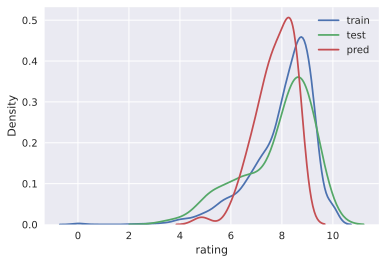

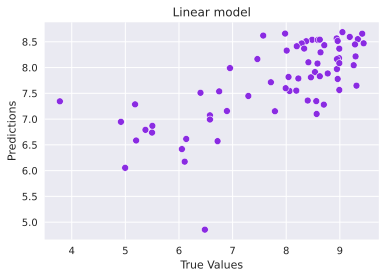

In [98]:
target_distr_linear(y_train, y_test, y_pred)   

In [99]:
cat_model.save_model('cat_reg_okko_ratings_cat_ntop_scors_kws_oscr_pca')

**Feature importance**

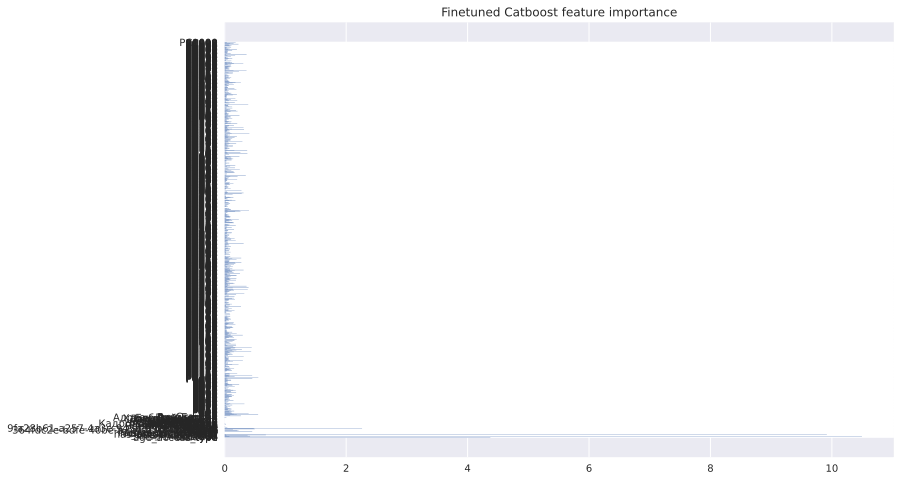

In [100]:
get_feature_imp(cat_model, train_dataset)

1)  The most influential features:  
    - duration  
    - average_rating  
    - age_access_type  

2)  The lowest influential features:  
    - actors and directors are not so important

**Detecting heteroscedasticity**

**Graphical Method:**

Firstly do the regression analysis and then plot the error terms against the predicted values. 
If there is a definite pattern (like linear or quadratic or funnel shaped) obtained from the scatter plot then heteroscedasticity is present.

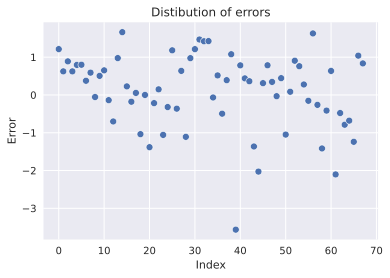

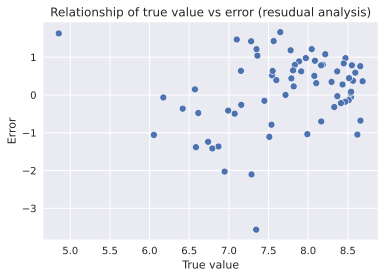

In [101]:
errors = y_test - y_pred
draw_res_analys(errors, y_pred)

**Conclusion**
* The trend in the second figure is not visible, now we will confirm the presence of heteroskedasticity on tests.

In [102]:
test_df['PREDS'] = y_pred.tolist()
test_df['TARGET'] = y_test.tolist()
test_df

,age_access_type,name,type,release_year,duration,element_uid,BUDGET,MARKETING,RUS,USA,...,Майкл Кан,Джим Дено,Дариуш Вольски,Харви Вайнштейн,Боб Вайнштейн,Адриан Политовски,Люк Бессон,Стэн Ли,PREDS,TARGET
10400,18,Не оставляй меня,SERIAL,2022,17.044733,00de4f79-d52d-4d2c-871c-e6e8432cc3df,NaN,NaN,NaN,NaN,...,0,0,0,0,0,0,0,0,8.044835,9.258333
10300,18,Индекс страха,SERIAL,2022,16.200597,e281b84c-bb78-466a-ac71-c557aacc5c13,NaN,NaN,NaN,NaN,...,0,0,0,0,0,0,0,0,7.911867,8.536232
10322,18,На взводе: Битва за UBER,SERIAL,2022,16.064695,fecde143-2a72-4a70-8efc-188079a62f1a,NaN,NaN,NaN,NaN,...,0,0,0,0,0,0,0,0,7.884719,8.773810
10439,18,Жена путешественника во времени,SERIAL,2022,16.626117,7becd8d8-1fb8-4ee6-b903-47817686ddd8,NaN,NaN,NaN,NaN,...,0,0,0,0,0,0,0,0,8.366021,8.990000
46,16,Боец: Король ринга,MOVIE,2022,15.665539,1f2481e2-55ec-429f-9e3d-6c3ea2087d00,15.894952,NaN,NaN,NaN,...,0,0,0,0,0,0,0,0,7.830845,8.626496
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4414,18,Отряд «Призрак»,MOVIE,2022,15.656060,f132627d-5b3b-443f-bccd-feb92b51d08d,NaN,NaN,NaN,NaN,...,0,0,0,0,0,0,0,0,7.537429,6.750000
4415,12,Падение Луны,MOVIE,2022,15.869634,595c19b8-a22f-4beb-ab9f-5431fd3929ea,18.826146,NaN,15.237295,16.763137,...,0,0,0,0,0,0,0,0,8.659111,7.979399
4417,16,Парни под прикрытием,MOVIE,2022,15.501910,1b9df53f-e556-4f00-8d1f-67b2cc74e01a,NaN,NaN,12.266231,NaN,...,0,0,0,0,0,0,0,0,6.737643,5.497999
3392,16,9 жизней,MOVIE,2022,15.566448,a7979b64-cf82-4c7f-86d8-05670b07d1b0,NaN,NaN,12.154206,NaN,...,0,0,0,0,0,0,0,0,7.359682,8.400693


# Tuning

In [103]:
train_dataset = cat.Pool(X_train, y_train, 
                         cat_features=cat_features) 

test_dataset = cat.Pool(X_test, y_test,
                         cat_features=cat_features)

cat_params = {
    'loss_function': 'RMSE',
    'eval_metric': 'MAE',
    'verbose': True,
    'random_seed': 321,
    'allow_writing_files': False, 
    'cat_features': cat_features
}

In [104]:
parameters_distr = {'depth': randint(5, 10),
              'learning_rate': uniform(0.01, 0.1),
              'iterations': [5000, 10000, 15000]
             }

cat_model = cat.CatBoostRegressor(**cat_params)
grid = RandomizedSearchCV(estimator=cat_model, param_distributions=parameters_distr, 
                            cv=3, 
                          n_jobs=2,
                          verbose=3)

grid.fit(X_train, y_train)

import pickle
with open('bestimator_okko_rat_ntop_tune_pca_oscr', 'wb') as f:
    pickle.dump(grid.best_estimator_, f)
grid.best_params_

Fitting 3 folds for each of 10 candidates, totalling 30 fits


/root/anaconda3/lib/python3.9/site-packages/xgboost/compat.py:36: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  from pandas import MultiIndex, Int64Index
/root/anaconda3/lib/python3.9/site-packages/xgboost/compat.py:36: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  from pandas import MultiIndex, Int64Index


0:	learn: 0.9968403	total: 169ms	remaining: 42m 18s
1:	learn: 0.9834618	total: 215ms	remaining: 26m 50s
2:	learn: 0.9686147	total: 262ms	remaining: 21m 48s
3:	learn: 0.9540416	total: 293ms	remaining: 18m 20s
4:	learn: 0.9428365	total: 406ms	remaining: 20m 18s
5:	learn: 0.9301330	total: 457ms	remaining: 19m 3s
6:	learn: 0.9201569	total: 501ms	remaining: 17m 52s
7:	learn: 0.9097506	total: 556ms	remaining: 17m 22s
8:	learn: 0.9000998	total: 665ms	remaining: 18m 27s
9:	learn: 0.8923082	total: 706ms	remaining: 17m 38s
10:	learn: 0.8847410	total: 786ms	remaining: 17m 50s
11:	learn: 0.8752462	total: 836ms	remaining: 17m 24s
12:	learn: 0.8673166	total: 890ms	remaining: 17m 5s
13:	learn: 0.8609693	total: 997ms	remaining: 17m 47s
14:	learn: 0.8536595	total: 1.06s	remaining: 17m 40s
15:	learn: 0.8469926	total: 1.11s	remaining: 17m 21s
16:	learn: 0.8402623	total: 1.15s	remaining: 16m 55s
17:	learn: 0.8339667	total: 1.24s	remaining: 17m 11s
18:	learn: 0.8281335	total: 1.28s	remaining: 16m 53s
19:	l

154:	learn: 0.6237431	total: 10.1s	remaining: 16m 7s
155:	learn: 0.6226812	total: 10.1s	remaining: 16m 5s
156:	learn: 0.6212635	total: 10.2s	remaining: 16m 3s
157:	learn: 0.6200073	total: 10.3s	remaining: 16m 6s
158:	learn: 0.6192961	total: 10.3s	remaining: 16m 5s
159:	learn: 0.6187322	total: 10.4s	remaining: 16m 3s
160:	learn: 0.6181908	total: 10.4s	remaining: 16m
161:	learn: 0.6174928	total: 10.6s	remaining: 16m 6s
162:	learn: 0.6172057	total: 10.6s	remaining: 16m 5s
163:	learn: 0.6161708	total: 10.7s	remaining: 16m 5s
164:	learn: 0.6153495	total: 10.7s	remaining: 16m 2s
165:	learn: 0.6143514	total: 10.8s	remaining: 16m 8s
166:	learn: 0.6132104	total: 10.9s	remaining: 16m 10s
167:	learn: 0.6121706	total: 11s	remaining: 16m 8s
168:	learn: 0.6112752	total: 11s	remaining: 16m 8s
169:	learn: 0.6101027	total: 11.1s	remaining: 16m 10s
170:	learn: 0.6090323	total: 11.2s	remaining: 16m 9s
171:	learn: 0.6078882	total: 11.3s	remaining: 16m 10s
172:	learn: 0.6066643	total: 11.3s	remaining: 16m 

306:	learn: 0.4573415	total: 20.3s	remaining: 16m 10s
307:	learn: 0.4561836	total: 20.3s	remaining: 16m 10s
308:	learn: 0.4549894	total: 20.4s	remaining: 16m 9s
309:	learn: 0.4537297	total: 20.5s	remaining: 16m 11s
310:	learn: 0.4525569	total: 20.6s	remaining: 16m 11s
311:	learn: 0.4516173	total: 20.6s	remaining: 16m 10s
312:	learn: 0.4503618	total: 20.7s	remaining: 16m 10s
313:	learn: 0.4490675	total: 20.8s	remaining: 16m 12s
314:	learn: 0.4480396	total: 20.8s	remaining: 16m 11s
315:	learn: 0.4471082	total: 20.9s	remaining: 16m 10s
316:	learn: 0.4459954	total: 20.9s	remaining: 16m 10s
317:	learn: 0.4447355	total: 21.1s	remaining: 16m 12s
318:	learn: 0.4437964	total: 21.1s	remaining: 16m 11s
319:	learn: 0.4425521	total: 21.2s	remaining: 16m 11s
320:	learn: 0.4414239	total: 21.2s	remaining: 16m 11s
321:	learn: 0.4402592	total: 21.3s	remaining: 16m 12s
322:	learn: 0.4388925	total: 21.4s	remaining: 16m 12s
323:	learn: 0.4377700	total: 21.5s	remaining: 16m 13s
324:	learn: 0.4367561	total: 

458:	learn: 0.3247652	total: 30.6s	remaining: 16m 7s
459:	learn: 0.3243486	total: 30.6s	remaining: 16m 7s
460:	learn: 0.3237805	total: 30.7s	remaining: 16m 7s
461:	learn: 0.3229177	total: 30.8s	remaining: 16m 8s
462:	learn: 0.3221765	total: 30.8s	remaining: 16m 8s
463:	learn: 0.3213312	total: 30.9s	remaining: 16m 8s
464:	learn: 0.3204906	total: 31s	remaining: 16m 7s
465:	learn: 0.3196002	total: 31s	remaining: 16m 8s
466:	learn: 0.3187946	total: 31.1s	remaining: 16m 8s
467:	learn: 0.3184862	total: 31.2s	remaining: 16m 8s
468:	learn: 0.3181508	total: 31.2s	remaining: 16m 8s
469:	learn: 0.3174074	total: 31.4s	remaining: 16m 9s
470:	learn: 0.3164716	total: 31.4s	remaining: 16m 8s
471:	learn: 0.3159488	total: 31.4s	remaining: 16m 7s
472:	learn: 0.3151688	total: 31.5s	remaining: 16m 6s
473:	learn: 0.3142979	total: 31.6s	remaining: 16m 9s
474:	learn: 0.3134242	total: 31.7s	remaining: 16m 8s
475:	learn: 0.3126342	total: 31.7s	remaining: 16m 8s
476:	learn: 0.3119758	total: 31.8s	remaining: 16m 

613:	learn: 0.2264152	total: 41.1s	remaining: 16m 2s
614:	learn: 0.2261838	total: 41.2s	remaining: 16m 2s
615:	learn: 0.2255978	total: 41.2s	remaining: 16m 1s
616:	learn: 0.2250426	total: 41.2s	remaining: 16m 1s
617:	learn: 0.2243432	total: 41.4s	remaining: 16m 2s
618:	learn: 0.2238565	total: 41.4s	remaining: 16m 1s
619:	learn: 0.2236795	total: 41.4s	remaining: 16m 1s
620:	learn: 0.2232022	total: 41.5s	remaining: 16m
621:	learn: 0.2226994	total: 41.6s	remaining: 16m 1s
622:	learn: 0.2221881	total: 41.6s	remaining: 16m 1s
623:	learn: 0.2217983	total: 41.7s	remaining: 16m
624:	learn: 0.2211790	total: 41.8s	remaining: 16m
625:	learn: 0.2206546	total: 41.9s	remaining: 16m 1s
626:	learn: 0.2202814	total: 42s	remaining: 16m 1s
627:	learn: 0.2196161	total: 42s	remaining: 16m 1s
628:	learn: 0.2190448	total: 42.1s	remaining: 16m 1s
629:	learn: 0.2186535	total: 42.2s	remaining: 16m 1s
630:	learn: 0.2183004	total: 42.2s	remaining: 16m 1s
631:	learn: 0.2178218	total: 42.3s	remaining: 16m 1s
632:	l

766:	learn: 0.1613079	total: 51.4s	remaining: 15m 53s
767:	learn: 0.1610623	total: 51.4s	remaining: 15m 53s
768:	learn: 0.1606449	total: 51.5s	remaining: 15m 53s
769:	learn: 0.1603363	total: 51.6s	remaining: 15m 54s
770:	learn: 0.1599275	total: 51.7s	remaining: 15m 53s
771:	learn: 0.1598260	total: 51.7s	remaining: 15m 53s
772:	learn: 0.1594097	total: 51.8s	remaining: 15m 53s
773:	learn: 0.1589815	total: 51.9s	remaining: 15m 53s
774:	learn: 0.1585489	total: 51.9s	remaining: 15m 53s
775:	learn: 0.1583119	total: 52s	remaining: 15m 52s
776:	learn: 0.1579023	total: 52s	remaining: 15m 52s
777:	learn: 0.1575183	total: 52.1s	remaining: 15m 53s
778:	learn: 0.1571568	total: 52.2s	remaining: 15m 52s
779:	learn: 0.1567387	total: 52.3s	remaining: 15m 53s
780:	learn: 0.1563882	total: 52.3s	remaining: 15m 53s
781:	learn: 0.1561109	total: 52.4s	remaining: 15m 53s
782:	learn: 0.1557521	total: 52.5s	remaining: 15m 52s
783:	learn: 0.1554105	total: 52.5s	remaining: 15m 52s
784:	learn: 0.1549989	total: 52.

919:	learn: 0.1171856	total: 1m 1s	remaining: 15m 38s
920:	learn: 0.1169162	total: 1m 1s	remaining: 15m 38s
921:	learn: 0.1168305	total: 1m 1s	remaining: 15m 38s
922:	learn: 0.1165911	total: 1m 1s	remaining: 15m 38s
923:	learn: 0.1164163	total: 1m 1s	remaining: 15m 38s
924:	learn: 0.1160721	total: 1m 1s	remaining: 15m 37s
925:	learn: 0.1158129	total: 1m 1s	remaining: 15m 38s
926:	learn: 0.1155354	total: 1m 1s	remaining: 15m 38s
927:	learn: 0.1155317	total: 1m 1s	remaining: 15m 37s
928:	learn: 0.1152632	total: 1m 1s	remaining: 15m 37s
929:	learn: 0.1150867	total: 1m 1s	remaining: 15m 37s
930:	learn: 0.1148186	total: 1m 2s	remaining: 15m 37s
931:	learn: 0.1145271	total: 1m 2s	remaining: 15m 37s
932:	learn: 0.1142577	total: 1m 2s	remaining: 15m 36s
933:	learn: 0.1140177	total: 1m 2s	remaining: 15m 37s
934:	learn: 0.1137072	total: 1m 2s	remaining: 15m 36s
935:	learn: 0.1136243	total: 1m 2s	remaining: 15m 36s
936:	learn: 0.1134664	total: 1m 2s	remaining: 15m 36s
937:	learn: 0.1134403	total:

1069:	learn: 0.0871881	total: 1m 11s	remaining: 15m 30s
1070:	learn: 0.0870658	total: 1m 11s	remaining: 15m 30s
1071:	learn: 0.0868329	total: 1m 11s	remaining: 15m 30s
1072:	learn: 0.0866921	total: 1m 11s	remaining: 15m 30s
1073:	learn: 0.0864793	total: 1m 11s	remaining: 15m 30s
1074:	learn: 0.0862785	total: 1m 11s	remaining: 15m 30s
1075:	learn: 0.0861901	total: 1m 11s	remaining: 15m 30s
1076:	learn: 0.0859745	total: 1m 11s	remaining: 15m 30s
1077:	learn: 0.0857149	total: 1m 12s	remaining: 15m 31s
1078:	learn: 0.0857063	total: 1m 12s	remaining: 15m 30s
1079:	learn: 0.0857009	total: 1m 12s	remaining: 15m 30s
1080:	learn: 0.0856027	total: 1m 12s	remaining: 15m 30s
1081:	learn: 0.0854566	total: 1m 12s	remaining: 15m 30s
1082:	learn: 0.0852485	total: 1m 12s	remaining: 15m 30s
1083:	learn: 0.0850112	total: 1m 12s	remaining: 15m 30s
1084:	learn: 0.0848745	total: 1m 12s	remaining: 15m 30s
1085:	learn: 0.0846615	total: 1m 12s	remaining: 15m 30s
1086:	learn: 0.0844796	total: 1m 12s	remaining: 

1215:	learn: 0.0672126	total: 1m 21s	remaining: 15m 21s
1216:	learn: 0.0670226	total: 1m 21s	remaining: 15m 20s
1217:	learn: 0.0668992	total: 1m 21s	remaining: 15m 21s
1218:	learn: 0.0667870	total: 1m 21s	remaining: 15m 21s
1219:	learn: 0.0667151	total: 1m 21s	remaining: 15m 20s
1220:	learn: 0.0666990	total: 1m 21s	remaining: 15m 20s
1221:	learn: 0.0666112	total: 1m 21s	remaining: 15m 21s
1222:	learn: 0.0664438	total: 1m 21s	remaining: 15m 20s
1223:	learn: 0.0662732	total: 1m 21s	remaining: 15m 21s
1224:	learn: 0.0661759	total: 1m 21s	remaining: 15m 20s
1225:	learn: 0.0659980	total: 1m 22s	remaining: 15m 21s
1226:	learn: 0.0658894	total: 1m 22s	remaining: 15m 20s
1227:	learn: 0.0657469	total: 1m 22s	remaining: 15m 20s
1228:	learn: 0.0656829	total: 1m 22s	remaining: 15m 20s
1229:	learn: 0.0655151	total: 1m 22s	remaining: 15m 20s
1230:	learn: 0.0653934	total: 1m 22s	remaining: 15m 20s
1231:	learn: 0.0652558	total: 1m 22s	remaining: 15m 20s
1232:	learn: 0.0651268	total: 1m 22s	remaining: 

1361:	learn: 0.0522339	total: 1m 31s	remaining: 15m 14s
1362:	learn: 0.0521169	total: 1m 31s	remaining: 15m 14s
1363:	learn: 0.0520588	total: 1m 31s	remaining: 15m 13s
1364:	learn: 0.0519478	total: 1m 31s	remaining: 15m 13s
1365:	learn: 0.0518362	total: 1m 31s	remaining: 15m 13s
1366:	learn: 0.0517345	total: 1m 31s	remaining: 15m 13s
1367:	learn: 0.0516517	total: 1m 31s	remaining: 15m 13s
1368:	learn: 0.0515872	total: 1m 31s	remaining: 15m 13s
1369:	learn: 0.0514654	total: 1m 31s	remaining: 15m 13s
1370:	learn: 0.0513958	total: 1m 31s	remaining: 15m 13s
1371:	learn: 0.0513921	total: 1m 31s	remaining: 15m 13s
1372:	learn: 0.0512913	total: 1m 31s	remaining: 15m 12s
1373:	learn: 0.0512736	total: 1m 32s	remaining: 15m 12s
1374:	learn: 0.0512170	total: 1m 32s	remaining: 15m 12s
1375:	learn: 0.0510983	total: 1m 32s	remaining: 15m 12s
1376:	learn: 0.0510846	total: 1m 32s	remaining: 15m 12s
1377:	learn: 0.0509533	total: 1m 32s	remaining: 15m 13s
1378:	learn: 0.0509268	total: 1m 32s	remaining: 

1509:	learn: 0.0422953	total: 1m 40s	remaining: 15m 1s
1510:	learn: 0.0422100	total: 1m 40s	remaining: 15m 1s
1511:	learn: 0.0421304	total: 1m 41s	remaining: 15m 1s
1512:	learn: 0.0421047	total: 1m 41s	remaining: 15m 1s
1513:	learn: 0.0420311	total: 1m 41s	remaining: 15m 1s
1514:	learn: 0.0419695	total: 1m 41s	remaining: 15m 1s
1515:	learn: 0.0419235	total: 1m 41s	remaining: 15m 1s
1516:	learn: 0.0418554	total: 1m 41s	remaining: 15m
1517:	learn: 0.0418454	total: 1m 41s	remaining: 15m 1s
1518:	learn: 0.0417300	total: 1m 41s	remaining: 15m 1s
1519:	learn: 0.0416622	total: 1m 41s	remaining: 15m 1s
1520:	learn: 0.0416277	total: 1m 41s	remaining: 15m
1521:	learn: 0.0415574	total: 1m 41s	remaining: 15m
1522:	learn: 0.0414591	total: 1m 41s	remaining: 15m
1523:	learn: 0.0414463	total: 1m 41s	remaining: 15m
1524:	learn: 0.0413974	total: 1m 41s	remaining: 15m
1525:	learn: 0.0413221	total: 1m 42s	remaining: 15m
1526:	learn: 0.0412242	total: 1m 42s	remaining: 15m
1527:	learn: 0.0411720	total: 1m 4

1656:	learn: 0.0346425	total: 1m 50s	remaining: 14m 51s
1657:	learn: 0.0346224	total: 1m 50s	remaining: 14m 51s
1658:	learn: 0.0345932	total: 1m 50s	remaining: 14m 51s
1659:	learn: 0.0345177	total: 1m 50s	remaining: 14m 51s
1660:	learn: 0.0344741	total: 1m 50s	remaining: 14m 51s
1661:	learn: 0.0344499	total: 1m 51s	remaining: 14m 51s
1662:	learn: 0.0343880	total: 1m 51s	remaining: 14m 51s
1663:	learn: 0.0343109	total: 1m 51s	remaining: 14m 51s
1664:	learn: 0.0342766	total: 1m 51s	remaining: 14m 50s
1665:	learn: 0.0342364	total: 1m 51s	remaining: 14m 50s
1666:	learn: 0.0341852	total: 1m 51s	remaining: 14m 50s
1667:	learn: 0.0341201	total: 1m 51s	remaining: 14m 50s
1668:	learn: 0.0340675	total: 1m 51s	remaining: 14m 50s
1669:	learn: 0.0340527	total: 1m 51s	remaining: 14m 50s
1670:	learn: 0.0340193	total: 1m 51s	remaining: 14m 50s
1671:	learn: 0.0339912	total: 1m 51s	remaining: 14m 49s
1672:	learn: 0.0339692	total: 1m 51s	remaining: 14m 49s
1673:	learn: 0.0339636	total: 1m 51s	remaining: 

1803:	learn: 0.0287392	total: 2m	remaining: 14m 42s
1804:	learn: 0.0286871	total: 2m	remaining: 14m 42s
1805:	learn: 0.0286446	total: 2m	remaining: 14m 42s
1806:	learn: 0.0285988	total: 2m	remaining: 14m 42s
1807:	learn: 0.0285701	total: 2m	remaining: 14m 42s
1808:	learn: 0.0285474	total: 2m	remaining: 14m 42s
1809:	learn: 0.0284978	total: 2m 1s	remaining: 14m 42s
1810:	learn: 0.0284531	total: 2m 1s	remaining: 14m 41s
1811:	learn: 0.0284198	total: 2m 1s	remaining: 14m 41s
1812:	learn: 0.0283770	total: 2m 1s	remaining: 14m 41s
1813:	learn: 0.0283491	total: 2m 1s	remaining: 14m 41s
1814:	learn: 0.0282933	total: 2m 1s	remaining: 14m 41s
1815:	learn: 0.0282876	total: 2m 1s	remaining: 14m 41s
1816:	learn: 0.0282304	total: 2m 1s	remaining: 14m 41s
1817:	learn: 0.0282106	total: 2m 1s	remaining: 14m 41s
1818:	learn: 0.0281630	total: 2m 1s	remaining: 14m 41s
1819:	learn: 0.0281310	total: 2m 1s	remaining: 14m 41s
1820:	learn: 0.0280972	total: 2m 1s	remaining: 14m 41s
1821:	learn: 0.0280650	total

1952:	learn: 0.0239605	total: 2m 10s	remaining: 14m 33s
1953:	learn: 0.0239393	total: 2m 10s	remaining: 14m 33s
1954:	learn: 0.0239244	total: 2m 10s	remaining: 14m 33s
1955:	learn: 0.0238925	total: 2m 10s	remaining: 14m 33s
1956:	learn: 0.0238496	total: 2m 11s	remaining: 14m 33s
1957:	learn: 0.0238160	total: 2m 11s	remaining: 14m 33s
1958:	learn: 0.0237914	total: 2m 11s	remaining: 14m 33s
1959:	learn: 0.0237727	total: 2m 11s	remaining: 14m 33s
1960:	learn: 0.0237383	total: 2m 11s	remaining: 14m 33s
1961:	learn: 0.0236903	total: 2m 11s	remaining: 14m 33s
1962:	learn: 0.0236456	total: 2m 11s	remaining: 14m 33s
1963:	learn: 0.0236193	total: 2m 11s	remaining: 14m 33s
1964:	learn: 0.0236032	total: 2m 11s	remaining: 14m 32s
1965:	learn: 0.0235910	total: 2m 11s	remaining: 14m 32s
1966:	learn: 0.0235530	total: 2m 11s	remaining: 14m 32s
1967:	learn: 0.0235425	total: 2m 11s	remaining: 14m 32s
1968:	learn: 0.0235160	total: 2m 11s	remaining: 14m 32s
1969:	learn: 0.0234971	total: 2m 11s	remaining: 

2098:	learn: 0.0200065	total: 2m 20s	remaining: 14m 23s
2099:	learn: 0.0200051	total: 2m 20s	remaining: 14m 23s
2100:	learn: 0.0199595	total: 2m 20s	remaining: 14m 23s
2101:	learn: 0.0199344	total: 2m 20s	remaining: 14m 23s
2102:	learn: 0.0199061	total: 2m 20s	remaining: 14m 23s
2103:	learn: 0.0198760	total: 2m 20s	remaining: 14m 23s
2104:	learn: 0.0198408	total: 2m 20s	remaining: 14m 23s
2105:	learn: 0.0198370	total: 2m 20s	remaining: 14m 23s
2106:	learn: 0.0198196	total: 2m 20s	remaining: 14m 22s
2107:	learn: 0.0198081	total: 2m 21s	remaining: 14m 22s
2108:	learn: 0.0197993	total: 2m 21s	remaining: 14m 22s
2109:	learn: 0.0197681	total: 2m 21s	remaining: 14m 22s
2110:	learn: 0.0197415	total: 2m 21s	remaining: 14m 22s
2111:	learn: 0.0197147	total: 2m 21s	remaining: 14m 22s
2112:	learn: 0.0196865	total: 2m 21s	remaining: 14m 22s
2113:	learn: 0.0196604	total: 2m 21s	remaining: 14m 22s
2114:	learn: 0.0196234	total: 2m 21s	remaining: 14m 22s
2115:	learn: 0.0196124	total: 2m 21s	remaining: 

2244:	learn: 0.0171756	total: 2m 29s	remaining: 14m 11s
2245:	learn: 0.0171611	total: 2m 29s	remaining: 14m 11s
2246:	learn: 0.0171409	total: 2m 30s	remaining: 14m 11s
2247:	learn: 0.0171149	total: 2m 30s	remaining: 14m 11s
2248:	learn: 0.0170826	total: 2m 30s	remaining: 14m 11s
2249:	learn: 0.0170595	total: 2m 30s	remaining: 14m 11s
2250:	learn: 0.0170347	total: 2m 30s	remaining: 14m 11s
2251:	learn: 0.0170064	total: 2m 30s	remaining: 14m 11s
2252:	learn: 0.0169741	total: 2m 30s	remaining: 14m 10s
2253:	learn: 0.0169579	total: 2m 30s	remaining: 14m 11s
2254:	learn: 0.0169383	total: 2m 30s	remaining: 14m 10s
2255:	learn: 0.0169261	total: 2m 30s	remaining: 14m 10s
2256:	learn: 0.0168988	total: 2m 30s	remaining: 14m 10s
2257:	learn: 0.0168959	total: 2m 30s	remaining: 14m 10s
2258:	learn: 0.0168705	total: 2m 30s	remaining: 14m 10s
2259:	learn: 0.0168420	total: 2m 30s	remaining: 14m 10s
2260:	learn: 0.0168413	total: 2m 30s	remaining: 14m 10s
2261:	learn: 0.0168265	total: 2m 31s	remaining: 

2391:	learn: 0.0130392	total: 2m 40s	remaining: 14m 3s
2392:	learn: 0.0130264	total: 2m 40s	remaining: 14m 3s
2393:	learn: 0.0130092	total: 2m 40s	remaining: 14m 3s
2394:	learn: 0.0129847	total: 2m 40s	remaining: 14m 3s
2395:	learn: 0.0129592	total: 2m 40s	remaining: 14m 3s
2396:	learn: 0.0129534	total: 2m 40s	remaining: 14m 3s
2397:	learn: 0.0129343	total: 2m 40s	remaining: 14m 3s
2398:	learn: 0.0129323	total: 2m 40s	remaining: 14m 2s
2399:	learn: 0.0129092	total: 2m 40s	remaining: 14m 2s
2400:	learn: 0.0128971	total: 2m 40s	remaining: 14m 2s
2401:	learn: 0.0128965	total: 2m 40s	remaining: 14m 2s
2402:	learn: 0.0128953	total: 2m 40s	remaining: 14m 2s
2403:	learn: 0.0128830	total: 2m 40s	remaining: 14m 3s
2404:	learn: 0.0128598	total: 2m 40s	remaining: 14m 2s
2405:	learn: 0.0128416	total: 2m 41s	remaining: 14m 2s
2406:	learn: 0.0128389	total: 2m 41s	remaining: 14m 2s
2407:	learn: 0.0128337	total: 2m 41s	remaining: 14m 2s
2408:	learn: 0.0128148	total: 2m 41s	remaining: 14m 2s
2409:	lear

2539:	learn: 0.0110662	total: 2m 49s	remaining: 13m 53s
2540:	learn: 0.0110555	total: 2m 49s	remaining: 13m 53s
2541:	learn: 0.0110459	total: 2m 49s	remaining: 13m 52s
2542:	learn: 0.0110356	total: 2m 50s	remaining: 13m 52s
2543:	learn: 0.0110226	total: 2m 50s	remaining: 13m 52s
2544:	learn: 0.0110034	total: 2m 50s	remaining: 13m 52s
2545:	learn: 0.0109871	total: 2m 50s	remaining: 13m 52s
2546:	learn: 0.0109857	total: 2m 50s	remaining: 13m 52s
2547:	learn: 0.0109673	total: 2m 50s	remaining: 13m 52s
2548:	learn: 0.0109555	total: 2m 50s	remaining: 13m 52s
2549:	learn: 0.0109448	total: 2m 50s	remaining: 13m 52s
2550:	learn: 0.0109290	total: 2m 50s	remaining: 13m 52s
2551:	learn: 0.0109100	total: 2m 50s	remaining: 13m 51s
2552:	learn: 0.0109061	total: 2m 50s	remaining: 13m 51s
2553:	learn: 0.0108948	total: 2m 50s	remaining: 13m 51s
2554:	learn: 0.0108794	total: 2m 50s	remaining: 13m 51s
2555:	learn: 0.0108777	total: 2m 50s	remaining: 13m 51s
2556:	learn: 0.0108583	total: 2m 50s	remaining: 

2685:	learn: 0.0094416	total: 2m 59s	remaining: 13m 43s
2686:	learn: 0.0094370	total: 2m 59s	remaining: 13m 43s
2687:	learn: 0.0094307	total: 2m 59s	remaining: 13m 44s
2688:	learn: 0.0094167	total: 2m 59s	remaining: 13m 43s
2689:	learn: 0.0094080	total: 3m	remaining: 13m 43s
2690:	learn: 0.0093935	total: 3m	remaining: 13m 43s
2691:	learn: 0.0093770	total: 3m	remaining: 13m 43s
2692:	learn: 0.0093662	total: 3m	remaining: 13m 43s
2693:	learn: 0.0093493	total: 3m	remaining: 13m 43s
2694:	learn: 0.0093396	total: 3m	remaining: 13m 43s
2695:	learn: 0.0093290	total: 3m	remaining: 13m 43s
2696:	learn: 0.0093214	total: 3m	remaining: 13m 43s
2697:	learn: 0.0093196	total: 3m	remaining: 13m 43s
2698:	learn: 0.0093085	total: 3m	remaining: 13m 43s
2699:	learn: 0.0092904	total: 3m	remaining: 13m 43s
2700:	learn: 0.0092754	total: 3m	remaining: 13m 43s
2701:	learn: 0.0092631	total: 3m	remaining: 13m 43s
2702:	learn: 0.0092541	total: 3m	remaining: 13m 42s
2703:	learn: 0.0092480	total: 3m	remaining: 13m 

2834:	learn: 0.0081370	total: 3m 9s	remaining: 13m 33s
2835:	learn: 0.0081255	total: 3m 9s	remaining: 13m 33s
2836:	learn: 0.0081192	total: 3m 9s	remaining: 13m 33s
2837:	learn: 0.0081182	total: 3m 9s	remaining: 13m 33s
2838:	learn: 0.0081107	total: 3m 9s	remaining: 13m 33s
2839:	learn: 0.0080993	total: 3m 9s	remaining: 13m 33s
2840:	learn: 0.0080967	total: 3m 10s	remaining: 13m 33s
2841:	learn: 0.0080938	total: 3m 10s	remaining: 13m 33s
2842:	learn: 0.0080801	total: 3m 10s	remaining: 13m 33s
2843:	learn: 0.0080772	total: 3m 10s	remaining: 13m 33s
2844:	learn: 0.0080614	total: 3m 10s	remaining: 13m 33s
2845:	learn: 0.0080494	total: 3m 10s	remaining: 13m 32s
2846:	learn: 0.0080403	total: 3m 10s	remaining: 13m 33s
2847:	learn: 0.0080341	total: 3m 10s	remaining: 13m 32s
2848:	learn: 0.0080253	total: 3m 10s	remaining: 13m 32s
2849:	learn: 0.0080190	total: 3m 10s	remaining: 13m 32s
2850:	learn: 0.0080106	total: 3m 10s	remaining: 13m 32s
2851:	learn: 0.0080017	total: 3m 10s	remaining: 13m 32

2980:	learn: 0.0070649	total: 3m 19s	remaining: 13m 23s
2981:	learn: 0.0070571	total: 3m 19s	remaining: 13m 23s
2982:	learn: 0.0070495	total: 3m 19s	remaining: 13m 23s
2983:	learn: 0.0070451	total: 3m 19s	remaining: 13m 23s
2984:	learn: 0.0070400	total: 3m 19s	remaining: 13m 22s
2985:	learn: 0.0070337	total: 3m 19s	remaining: 13m 22s
2986:	learn: 0.0070302	total: 3m 19s	remaining: 13m 23s
2987:	learn: 0.0070275	total: 3m 19s	remaining: 13m 22s
2988:	learn: 0.0070239	total: 3m 19s	remaining: 13m 22s
2989:	learn: 0.0070156	total: 3m 19s	remaining: 13m 22s
2990:	learn: 0.0070086	total: 3m 19s	remaining: 13m 22s
2991:	learn: 0.0070041	total: 3m 19s	remaining: 13m 22s
2992:	learn: 0.0069957	total: 3m 20s	remaining: 13m 22s
2993:	learn: 0.0069845	total: 3m 20s	remaining: 13m 22s
2994:	learn: 0.0069824	total: 3m 20s	remaining: 13m 22s
2995:	learn: 0.0069784	total: 3m 20s	remaining: 13m 22s
2996:	learn: 0.0069749	total: 3m 20s	remaining: 13m 22s
2997:	learn: 0.0069671	total: 3m 20s	remaining: 

3126:	learn: 0.0060917	total: 3m 28s	remaining: 13m 12s
3127:	learn: 0.0060878	total: 3m 28s	remaining: 13m 12s
3128:	learn: 0.0060810	total: 3m 28s	remaining: 13m 12s
3129:	learn: 0.0060764	total: 3m 28s	remaining: 13m 12s
3130:	learn: 0.0060720	total: 3m 28s	remaining: 13m 12s
3131:	learn: 0.0060679	total: 3m 29s	remaining: 13m 12s
3132:	learn: 0.0060616	total: 3m 29s	remaining: 13m 11s
3133:	learn: 0.0060543	total: 3m 29s	remaining: 13m 11s
3134:	learn: 0.0060501	total: 3m 29s	remaining: 13m 11s
3135:	learn: 0.0060439	total: 3m 29s	remaining: 13m 11s
3136:	learn: 0.0060320	total: 3m 29s	remaining: 13m 11s
3137:	learn: 0.0060284	total: 3m 29s	remaining: 13m 11s
3138:	learn: 0.0060265	total: 3m 29s	remaining: 13m 11s
3139:	learn: 0.0060190	total: 3m 29s	remaining: 13m 11s
3140:	learn: 0.0060162	total: 3m 29s	remaining: 13m 11s
3141:	learn: 0.0060094	total: 3m 29s	remaining: 13m 10s
3142:	learn: 0.0060086	total: 3m 29s	remaining: 13m 10s
3143:	learn: 0.0060016	total: 3m 29s	remaining: 

3274:	learn: 0.0053590	total: 3m 38s	remaining: 13m 1s
3275:	learn: 0.0053530	total: 3m 38s	remaining: 13m 1s
3276:	learn: 0.0053474	total: 3m 38s	remaining: 13m 1s
3277:	learn: 0.0053413	total: 3m 38s	remaining: 13m 1s
3278:	learn: 0.0053352	total: 3m 38s	remaining: 13m 1s
3279:	learn: 0.0053311	total: 3m 38s	remaining: 13m 1s
3280:	learn: 0.0053262	total: 3m 38s	remaining: 13m 1s
3281:	learn: 0.0053224	total: 3m 38s	remaining: 13m 1s
3282:	learn: 0.0053190	total: 3m 38s	remaining: 13m 1s
3283:	learn: 0.0053133	total: 3m 39s	remaining: 13m 1s
3284:	learn: 0.0053068	total: 3m 39s	remaining: 13m 1s
3285:	learn: 0.0053058	total: 3m 39s	remaining: 13m 1s
3286:	learn: 0.0053048	total: 3m 39s	remaining: 13m
3287:	learn: 0.0053001	total: 3m 39s	remaining: 13m
3288:	learn: 0.0052978	total: 3m 39s	remaining: 13m 1s
3289:	learn: 0.0052959	total: 3m 39s	remaining: 13m
3290:	learn: 0.0052927	total: 3m 39s	remaining: 13m
3291:	learn: 0.0052849	total: 3m 39s	remaining: 13m
3292:	learn: 0.0052817	to

3421:	learn: 0.0047732	total: 3m 48s	remaining: 12m 51s
3422:	learn: 0.0047702	total: 3m 48s	remaining: 12m 51s
3423:	learn: 0.0047669	total: 3m 48s	remaining: 12m 51s
3424:	learn: 0.0047640	total: 3m 48s	remaining: 12m 51s
3425:	learn: 0.0047637	total: 3m 48s	remaining: 12m 51s
3426:	learn: 0.0047602	total: 3m 48s	remaining: 12m 51s
3427:	learn: 0.0047547	total: 3m 48s	remaining: 12m 51s
3428:	learn: 0.0047507	total: 3m 48s	remaining: 12m 51s
3429:	learn: 0.0047454	total: 3m 48s	remaining: 12m 51s
3430:	learn: 0.0047434	total: 3m 48s	remaining: 12m 51s
3431:	learn: 0.0047374	total: 3m 48s	remaining: 12m 51s
3432:	learn: 0.0047370	total: 3m 48s	remaining: 12m 51s
3433:	learn: 0.0047337	total: 3m 48s	remaining: 12m 50s
3434:	learn: 0.0047276	total: 3m 48s	remaining: 12m 50s
3435:	learn: 0.0047229	total: 3m 49s	remaining: 12m 50s
3436:	learn: 0.0047169	total: 3m 49s	remaining: 12m 50s
3437:	learn: 0.0047153	total: 3m 49s	remaining: 12m 50s
3438:	learn: 0.0047126	total: 3m 49s	remaining: 

3567:	learn: 0.0042288	total: 3m 57s	remaining: 12m 40s
3568:	learn: 0.0042246	total: 3m 57s	remaining: 12m 40s
3569:	learn: 0.0042208	total: 3m 57s	remaining: 12m 40s
3570:	learn: 0.0042168	total: 3m 57s	remaining: 12m 40s
3571:	learn: 0.0042112	total: 3m 57s	remaining: 12m 40s
3572:	learn: 0.0042074	total: 3m 57s	remaining: 12m 40s
3573:	learn: 0.0042071	total: 3m 57s	remaining: 12m 40s
3574:	learn: 0.0042042	total: 3m 57s	remaining: 12m 40s
3575:	learn: 0.0041996	total: 3m 58s	remaining: 12m 40s
3576:	learn: 0.0041957	total: 3m 58s	remaining: 12m 40s
3577:	learn: 0.0041890	total: 3m 58s	remaining: 12m 40s
3578:	learn: 0.0041847	total: 3m 58s	remaining: 12m 40s
3579:	learn: 0.0041809	total: 3m 58s	remaining: 12m 40s
3580:	learn: 0.0041787	total: 3m 58s	remaining: 12m 40s
3581:	learn: 0.0041762	total: 3m 58s	remaining: 12m 39s
3582:	learn: 0.0041714	total: 3m 58s	remaining: 12m 39s
3583:	learn: 0.0041697	total: 3m 58s	remaining: 12m 39s
3584:	learn: 0.0041692	total: 3m 58s	remaining: 

3716:	learn: 0.0037699	total: 4m 7s	remaining: 12m 30s
3717:	learn: 0.0037655	total: 4m 7s	remaining: 12m 30s
3718:	learn: 0.0037604	total: 4m 7s	remaining: 12m 30s
3719:	learn: 0.0037573	total: 4m 7s	remaining: 12m 30s
3720:	learn: 0.0037571	total: 4m 7s	remaining: 12m 30s
3721:	learn: 0.0037569	total: 4m 7s	remaining: 12m 29s
3722:	learn: 0.0037564	total: 4m 7s	remaining: 12m 29s
3723:	learn: 0.0037510	total: 4m 7s	remaining: 12m 29s
3724:	learn: 0.0037477	total: 4m 7s	remaining: 12m 29s
3725:	learn: 0.0037434	total: 4m 7s	remaining: 12m 29s
3726:	learn: 0.0037415	total: 4m 7s	remaining: 12m 29s
3727:	learn: 0.0037379	total: 4m 7s	remaining: 12m 29s
3728:	learn: 0.0037342	total: 4m 8s	remaining: 12m 29s
3729:	learn: 0.0037330	total: 4m 8s	remaining: 12m 29s
3730:	learn: 0.0037313	total: 4m 8s	remaining: 12m 29s
3731:	learn: 0.0037287	total: 4m 8s	remaining: 12m 29s
3732:	learn: 0.0037285	total: 4m 8s	remaining: 12m 29s
3733:	learn: 0.0037255	total: 4m 8s	remaining: 12m 29s
3734:	lear

3863:	learn: 0.0033941	total: 4m 16s	remaining: 12m 20s
3864:	learn: 0.0033932	total: 4m 16s	remaining: 12m 20s
3865:	learn: 0.0033907	total: 4m 16s	remaining: 12m 19s
3866:	learn: 0.0033885	total: 4m 17s	remaining: 12m 20s
3867:	learn: 0.0033869	total: 4m 17s	remaining: 12m 20s
3868:	learn: 0.0033843	total: 4m 17s	remaining: 12m 20s
3869:	learn: 0.0033814	total: 4m 17s	remaining: 12m 19s
3870:	learn: 0.0033801	total: 4m 17s	remaining: 12m 19s
3871:	learn: 0.0033776	total: 4m 17s	remaining: 12m 19s
3872:	learn: 0.0033743	total: 4m 17s	remaining: 12m 19s
3873:	learn: 0.0033720	total: 4m 17s	remaining: 12m 19s
3874:	learn: 0.0033689	total: 4m 17s	remaining: 12m 19s
3875:	learn: 0.0033659	total: 4m 17s	remaining: 12m 19s
3876:	learn: 0.0033642	total: 4m 17s	remaining: 12m 19s
3877:	learn: 0.0033626	total: 4m 17s	remaining: 12m 19s
3878:	learn: 0.0033588	total: 4m 17s	remaining: 12m 19s
3879:	learn: 0.0033548	total: 4m 17s	remaining: 12m 19s
3880:	learn: 0.0033519	total: 4m 17s	remaining: 

4009:	learn: 0.0030351	total: 4m 26s	remaining: 12m 10s
4010:	learn: 0.0030326	total: 4m 26s	remaining: 12m 9s
4011:	learn: 0.0030296	total: 4m 26s	remaining: 12m 10s
4012:	learn: 0.0030266	total: 4m 26s	remaining: 12m 9s
4013:	learn: 0.0030236	total: 4m 26s	remaining: 12m 9s
4014:	learn: 0.0030211	total: 4m 26s	remaining: 12m 9s
4015:	learn: 0.0030184	total: 4m 26s	remaining: 12m 9s
4016:	learn: 0.0030159	total: 4m 26s	remaining: 12m 9s
4017:	learn: 0.0030158	total: 4m 26s	remaining: 12m 9s
4018:	learn: 0.0030129	total: 4m 26s	remaining: 12m 9s
4019:	learn: 0.0030116	total: 4m 27s	remaining: 12m 9s
4020:	learn: 0.0030114	total: 4m 27s	remaining: 12m 9s
4021:	learn: 0.0030112	total: 4m 27s	remaining: 12m 9s
4022:	learn: 0.0030092	total: 4m 27s	remaining: 12m 9s
4023:	learn: 0.0030060	total: 4m 27s	remaining: 12m 9s
4024:	learn: 0.0030032	total: 4m 27s	remaining: 12m 9s
4025:	learn: 0.0030007	total: 4m 27s	remaining: 12m 9s
4026:	learn: 0.0029993	total: 4m 27s	remaining: 12m 8s
4027:	le

4158:	learn: 0.0027289	total: 4m 36s	remaining: 12m
4159:	learn: 0.0027268	total: 4m 36s	remaining: 12m
4160:	learn: 0.0027248	total: 4m 36s	remaining: 12m
4161:	learn: 0.0027221	total: 4m 36s	remaining: 12m
4162:	learn: 0.0027205	total: 4m 36s	remaining: 12m
4163:	learn: 0.0027189	total: 4m 36s	remaining: 12m
4164:	learn: 0.0027154	total: 4m 36s	remaining: 12m
4165:	learn: 0.0027154	total: 4m 36s	remaining: 12m
4166:	learn: 0.0027137	total: 4m 36s	remaining: 12m
4167:	learn: 0.0027118	total: 4m 37s	remaining: 12m
4168:	learn: 0.0027093	total: 4m 37s	remaining: 11m 59s
4169:	learn: 0.0027076	total: 4m 37s	remaining: 11m 59s
4170:	learn: 0.0027053	total: 4m 37s	remaining: 11m 59s
4171:	learn: 0.0027042	total: 4m 37s	remaining: 11m 59s
4172:	learn: 0.0027012	total: 4m 37s	remaining: 11m 59s
4173:	learn: 0.0026995	total: 4m 37s	remaining: 11m 59s
4174:	learn: 0.0026960	total: 4m 37s	remaining: 11m 59s
4175:	learn: 0.0026934	total: 4m 37s	remaining: 11m 59s
4176:	learn: 0.0026930	total: 4m

4305:	learn: 0.0024684	total: 4m 46s	remaining: 11m 50s
4306:	learn: 0.0024678	total: 4m 46s	remaining: 11m 50s
4307:	learn: 0.0024655	total: 4m 46s	remaining: 11m 50s
4308:	learn: 0.0024638	total: 4m 46s	remaining: 11m 50s
4309:	learn: 0.0024619	total: 4m 46s	remaining: 11m 50s
4310:	learn: 0.0024585	total: 4m 46s	remaining: 11m 50s
4311:	learn: 0.0024582	total: 4m 46s	remaining: 11m 50s
4312:	learn: 0.0024580	total: 4m 46s	remaining: 11m 50s
4313:	learn: 0.0024579	total: 4m 46s	remaining: 11m 50s
4314:	learn: 0.0024557	total: 4m 46s	remaining: 11m 50s
4315:	learn: 0.0024534	total: 4m 46s	remaining: 11m 49s
4316:	learn: 0.0024524	total: 4m 46s	remaining: 11m 49s
4317:	learn: 0.0024506	total: 4m 46s	remaining: 11m 49s
4318:	learn: 0.0024479	total: 4m 46s	remaining: 11m 49s
4319:	learn: 0.0024475	total: 4m 47s	remaining: 11m 49s
4320:	learn: 0.0024451	total: 4m 47s	remaining: 11m 49s
4321:	learn: 0.0024431	total: 4m 47s	remaining: 11m 49s
4322:	learn: 0.0024415	total: 4m 47s	remaining: 

4451:	learn: 0.0022306	total: 4m 56s	remaining: 11m 41s
4452:	learn: 0.0022286	total: 4m 56s	remaining: 11m 41s
4453:	learn: 0.0022266	total: 4m 56s	remaining: 11m 41s
4454:	learn: 0.0022264	total: 4m 56s	remaining: 11m 41s
4455:	learn: 0.0022238	total: 4m 56s	remaining: 11m 41s
4456:	learn: 0.0022221	total: 4m 56s	remaining: 11m 41s
4457:	learn: 0.0022206	total: 4m 56s	remaining: 11m 41s
4458:	learn: 0.0022185	total: 4m 56s	remaining: 11m 40s
4459:	learn: 0.0022166	total: 4m 56s	remaining: 11m 40s
4460:	learn: 0.0022153	total: 4m 56s	remaining: 11m 40s
4461:	learn: 0.0022143	total: 4m 56s	remaining: 11m 40s
4462:	learn: 0.0022143	total: 4m 56s	remaining: 11m 40s
4463:	learn: 0.0022117	total: 4m 56s	remaining: 11m 40s
4464:	learn: 0.0022112	total: 4m 56s	remaining: 11m 40s
4465:	learn: 0.0022090	total: 4m 56s	remaining: 11m 40s
4466:	learn: 0.0022085	total: 4m 57s	remaining: 11m 40s
4467:	learn: 0.0022063	total: 4m 57s	remaining: 11m 40s
4468:	learn: 0.0022059	total: 4m 57s	remaining: 

4599:	learn: 0.0020395	total: 5m 5s	remaining: 11m 31s
4600:	learn: 0.0020382	total: 5m 5s	remaining: 11m 31s
4601:	learn: 0.0020375	total: 5m 5s	remaining: 11m 31s
4602:	learn: 0.0020365	total: 5m 5s	remaining: 11m 30s
4603:	learn: 0.0020356	total: 5m 5s	remaining: 11m 30s
4604:	learn: 0.0020352	total: 5m 6s	remaining: 11m 30s
4605:	learn: 0.0020321	total: 5m 6s	remaining: 11m 30s
4606:	learn: 0.0020301	total: 5m 6s	remaining: 11m 30s
4607:	learn: 0.0020296	total: 5m 6s	remaining: 11m 30s
4608:	learn: 0.0020276	total: 5m 6s	remaining: 11m 30s
4609:	learn: 0.0020261	total: 5m 6s	remaining: 11m 30s
4610:	learn: 0.0020253	total: 5m 6s	remaining: 11m 30s
4611:	learn: 0.0020245	total: 5m 6s	remaining: 11m 30s
4612:	learn: 0.0020237	total: 5m 6s	remaining: 11m 30s
4613:	learn: 0.0020232	total: 5m 6s	remaining: 11m 30s
4614:	learn: 0.0020214	total: 5m 6s	remaining: 11m 30s
4615:	learn: 0.0020207	total: 5m 6s	remaining: 11m 30s
4616:	learn: 0.0020186	total: 5m 6s	remaining: 11m 30s
4617:	lear

4746:	learn: 0.0018627	total: 5m 15s	remaining: 11m 21s
4747:	learn: 0.0018618	total: 5m 15s	remaining: 11m 21s
4748:	learn: 0.0018603	total: 5m 15s	remaining: 11m 21s
4749:	learn: 0.0018595	total: 5m 15s	remaining: 11m 21s
4750:	learn: 0.0018593	total: 5m 15s	remaining: 11m 21s
4751:	learn: 0.0018585	total: 5m 15s	remaining: 11m 21s
4752:	learn: 0.0018577	total: 5m 15s	remaining: 11m 21s
4753:	learn: 0.0018570	total: 5m 16s	remaining: 11m 21s
4754:	learn: 0.0018559	total: 5m 16s	remaining: 11m 21s
4755:	learn: 0.0018547	total: 5m 16s	remaining: 11m 20s
4756:	learn: 0.0018539	total: 5m 16s	remaining: 11m 20s
4757:	learn: 0.0018536	total: 5m 16s	remaining: 11m 20s
4758:	learn: 0.0018526	total: 5m 16s	remaining: 11m 20s
4759:	learn: 0.0018518	total: 5m 16s	remaining: 11m 20s
4760:	learn: 0.0018507	total: 5m 16s	remaining: 11m 20s
4761:	learn: 0.0018493	total: 5m 16s	remaining: 11m 20s
4762:	learn: 0.0018490	total: 5m 16s	remaining: 11m 20s
4763:	learn: 0.0018478	total: 5m 16s	remaining: 

4892:	learn: 0.0017166	total: 5m 24s	remaining: 11m 11s
4893:	learn: 0.0017156	total: 5m 25s	remaining: 11m 11s
4894:	learn: 0.0017146	total: 5m 25s	remaining: 11m 11s
4895:	learn: 0.0017145	total: 5m 25s	remaining: 11m 11s
4896:	learn: 0.0017126	total: 5m 25s	remaining: 11m 10s
4897:	learn: 0.0017126	total: 5m 25s	remaining: 11m 10s
4898:	learn: 0.0017123	total: 5m 25s	remaining: 11m 10s
4899:	learn: 0.0017109	total: 5m 25s	remaining: 11m 10s
4900:	learn: 0.0017102	total: 5m 25s	remaining: 11m 10s
4901:	learn: 0.0017085	total: 5m 25s	remaining: 11m 10s
4902:	learn: 0.0017071	total: 5m 25s	remaining: 11m 10s
4903:	learn: 0.0017066	total: 5m 25s	remaining: 11m 10s
4904:	learn: 0.0017063	total: 5m 25s	remaining: 11m 10s
4905:	learn: 0.0017054	total: 5m 25s	remaining: 11m 10s
4906:	learn: 0.0017045	total: 5m 25s	remaining: 11m 10s
4907:	learn: 0.0017027	total: 5m 25s	remaining: 11m 10s
4908:	learn: 0.0017020	total: 5m 25s	remaining: 11m 10s
4909:	learn: 0.0017019	total: 5m 26s	remaining: 

5040:	learn: 0.0015833	total: 5m 34s	remaining: 11m
5041:	learn: 0.0015826	total: 5m 34s	remaining: 11m
5042:	learn: 0.0015824	total: 5m 34s	remaining: 11m
5043:	learn: 0.0015815	total: 5m 34s	remaining: 11m
5044:	learn: 0.0015814	total: 5m 34s	remaining: 11m
5045:	learn: 0.0015807	total: 5m 34s	remaining: 11m
5046:	learn: 0.0015790	total: 5m 34s	remaining: 11m
5047:	learn: 0.0015783	total: 5m 34s	remaining: 11m
5048:	learn: 0.0015778	total: 5m 34s	remaining: 11m
5049:	learn: 0.0015767	total: 5m 34s	remaining: 10m 59s
5050:	learn: 0.0015761	total: 5m 35s	remaining: 10m 59s
5051:	learn: 0.0015761	total: 5m 35s	remaining: 10m 59s
5052:	learn: 0.0015759	total: 5m 35s	remaining: 10m 59s
5053:	learn: 0.0015756	total: 5m 35s	remaining: 10m 59s
5054:	learn: 0.0015740	total: 5m 35s	remaining: 10m 59s
5055:	learn: 0.0015739	total: 5m 35s	remaining: 10m 59s
5056:	learn: 0.0015730	total: 5m 35s	remaining: 10m 59s
5057:	learn: 0.0015720	total: 5m 35s	remaining: 10m 59s
5058:	learn: 0.0015714	total

5186:	learn: 0.0014720	total: 5m 43s	remaining: 10m 49s
5187:	learn: 0.0014713	total: 5m 43s	remaining: 10m 49s
5188:	learn: 0.0014707	total: 5m 43s	remaining: 10m 49s
5189:	learn: 0.0014699	total: 5m 43s	remaining: 10m 49s
5190:	learn: 0.0014683	total: 5m 43s	remaining: 10m 49s
5191:	learn: 0.0014660	total: 5m 43s	remaining: 10m 49s
5192:	learn: 0.0014657	total: 5m 43s	remaining: 10m 49s
5193:	learn: 0.0014651	total: 5m 43s	remaining: 10m 49s
5194:	learn: 0.0014641	total: 5m 44s	remaining: 10m 49s
5195:	learn: 0.0014639	total: 5m 44s	remaining: 10m 49s
5196:	learn: 0.0014635	total: 5m 44s	remaining: 10m 49s
5197:	learn: 0.0014625	total: 5m 44s	remaining: 10m 49s
5198:	learn: 0.0014610	total: 5m 44s	remaining: 10m 49s
5199:	learn: 0.0014603	total: 5m 44s	remaining: 10m 49s
5200:	learn: 0.0014593	total: 5m 44s	remaining: 10m 48s
5201:	learn: 0.0014580	total: 5m 44s	remaining: 10m 48s
5202:	learn: 0.0014576	total: 5m 44s	remaining: 10m 48s
5203:	learn: 0.0014572	total: 5m 44s	remaining: 

5332:	learn: 0.0013536	total: 5m 52s	remaining: 10m 39s
5333:	learn: 0.0013528	total: 5m 52s	remaining: 10m 39s
5334:	learn: 0.0013519	total: 5m 53s	remaining: 10m 39s
5335:	learn: 0.0013511	total: 5m 53s	remaining: 10m 39s
5336:	learn: 0.0013504	total: 5m 53s	remaining: 10m 39s
5337:	learn: 0.0013493	total: 5m 53s	remaining: 10m 39s
5338:	learn: 0.0013485	total: 5m 53s	remaining: 10m 39s
5339:	learn: 0.0013480	total: 5m 53s	remaining: 10m 39s
5340:	learn: 0.0013475	total: 5m 53s	remaining: 10m 39s
5341:	learn: 0.0013462	total: 5m 53s	remaining: 10m 39s
5342:	learn: 0.0013460	total: 5m 53s	remaining: 10m 39s
5343:	learn: 0.0013445	total: 5m 53s	remaining: 10m 38s
5344:	learn: 0.0013436	total: 5m 53s	remaining: 10m 38s
5345:	learn: 0.0013422	total: 5m 53s	remaining: 10m 38s
5346:	learn: 0.0013418	total: 5m 53s	remaining: 10m 38s
5347:	learn: 0.0013410	total: 5m 53s	remaining: 10m 38s
5348:	learn: 0.0013409	total: 5m 53s	remaining: 10m 38s
5349:	learn: 0.0013402	total: 5m 53s	remaining: 

5479:	learn: 0.0012494	total: 6m 2s	remaining: 10m 29s
5480:	learn: 0.0012492	total: 6m 2s	remaining: 10m 29s
5481:	learn: 0.0012491	total: 6m 2s	remaining: 10m 29s
5482:	learn: 0.0012486	total: 6m 2s	remaining: 10m 29s
5483:	learn: 0.0012477	total: 6m 2s	remaining: 10m 29s
5484:	learn: 0.0012466	total: 6m 2s	remaining: 10m 29s
5485:	learn: 0.0012456	total: 6m 2s	remaining: 10m 29s
5486:	learn: 0.0012445	total: 6m 2s	remaining: 10m 29s
5487:	learn: 0.0012443	total: 6m 3s	remaining: 10m 29s
5488:	learn: 0.0012439	total: 6m 3s	remaining: 10m 29s
5489:	learn: 0.0012431	total: 6m 3s	remaining: 10m 29s
5490:	learn: 0.0012427	total: 6m 3s	remaining: 10m 29s
5491:	learn: 0.0012423	total: 6m 3s	remaining: 10m 29s
5492:	learn: 0.0012414	total: 6m 3s	remaining: 10m 28s
5493:	learn: 0.0012403	total: 6m 3s	remaining: 10m 28s
5494:	learn: 0.0012394	total: 6m 3s	remaining: 10m 28s
5495:	learn: 0.0012390	total: 6m 3s	remaining: 10m 28s
5496:	learn: 0.0012375	total: 6m 3s	remaining: 10m 28s
5497:	lear

5627:	learn: 0.0011635	total: 6m 12s	remaining: 10m 19s
5628:	learn: 0.0011627	total: 6m 12s	remaining: 10m 19s
5629:	learn: 0.0011616	total: 6m 12s	remaining: 10m 19s
5630:	learn: 0.0011609	total: 6m 12s	remaining: 10m 19s
5631:	learn: 0.0011609	total: 6m 12s	remaining: 10m 19s
5632:	learn: 0.0011601	total: 6m 12s	remaining: 10m 19s
5633:	learn: 0.0011594	total: 6m 12s	remaining: 10m 19s
5634:	learn: 0.0011586	total: 6m 12s	remaining: 10m 19s
5635:	learn: 0.0011585	total: 6m 12s	remaining: 10m 19s
5636:	learn: 0.0011573	total: 6m 12s	remaining: 10m 19s
5637:	learn: 0.0011566	total: 6m 12s	remaining: 10m 19s
5638:	learn: 0.0011557	total: 6m 12s	remaining: 10m 19s
5639:	learn: 0.0011553	total: 6m 12s	remaining: 10m 18s
5640:	learn: 0.0011548	total: 6m 13s	remaining: 10m 18s
5641:	learn: 0.0011542	total: 6m 13s	remaining: 10m 18s
5642:	learn: 0.0011534	total: 6m 13s	remaining: 10m 18s
5643:	learn: 0.0011533	total: 6m 13s	remaining: 10m 18s
5644:	learn: 0.0011527	total: 6m 13s	remaining: 

5773:	learn: 0.0010761	total: 6m 21s	remaining: 10m 9s
5774:	learn: 0.0010757	total: 6m 21s	remaining: 10m 9s
5775:	learn: 0.0010750	total: 6m 21s	remaining: 10m 9s
5776:	learn: 0.0010744	total: 6m 21s	remaining: 10m 9s
5777:	learn: 0.0010740	total: 6m 21s	remaining: 10m 9s
5778:	learn: 0.0010732	total: 6m 21s	remaining: 10m 9s
5779:	learn: 0.0010730	total: 6m 21s	remaining: 10m 9s
5780:	learn: 0.0010723	total: 6m 21s	remaining: 10m 8s
5781:	learn: 0.0010716	total: 6m 21s	remaining: 10m 8s
5782:	learn: 0.0010713	total: 6m 21s	remaining: 10m 8s
5783:	learn: 0.0010708	total: 6m 22s	remaining: 10m 8s
5784:	learn: 0.0010706	total: 6m 22s	remaining: 10m 8s
5785:	learn: 0.0010704	total: 6m 22s	remaining: 10m 8s
5786:	learn: 0.0010698	total: 6m 22s	remaining: 10m 8s
5787:	learn: 0.0010696	total: 6m 22s	remaining: 10m 8s
5788:	learn: 0.0010690	total: 6m 22s	remaining: 10m 8s
5789:	learn: 0.0010684	total: 6m 22s	remaining: 10m 8s
5790:	learn: 0.0010680	total: 6m 22s	remaining: 10m 8s
5791:	lear

5922:	learn: 0.0010006	total: 6m 31s	remaining: 9m 59s
5923:	learn: 0.0009999	total: 6m 31s	remaining: 9m 59s
5924:	learn: 0.0009994	total: 6m 31s	remaining: 9m 59s
5925:	learn: 0.0009990	total: 6m 31s	remaining: 9m 59s
5926:	learn: 0.0009986	total: 6m 31s	remaining: 9m 59s
5927:	learn: 0.0009982	total: 6m 31s	remaining: 9m 59s
5928:	learn: 0.0009975	total: 6m 31s	remaining: 9m 59s
5929:	learn: 0.0009967	total: 6m 31s	remaining: 9m 59s
5930:	learn: 0.0009957	total: 6m 31s	remaining: 9m 59s
5931:	learn: 0.0009948	total: 6m 32s	remaining: 9m 59s
5932:	learn: 0.0009940	total: 6m 32s	remaining: 9m 59s
5933:	learn: 0.0009937	total: 6m 32s	remaining: 9m 59s
5934:	learn: 0.0009932	total: 6m 32s	remaining: 9m 59s
5935:	learn: 0.0009927	total: 6m 32s	remaining: 9m 59s
5936:	learn: 0.0009920	total: 6m 32s	remaining: 9m 58s
5937:	learn: 0.0009913	total: 6m 32s	remaining: 9m 58s
5938:	learn: 0.0009910	total: 6m 32s	remaining: 9m 58s
5939:	learn: 0.0009900	total: 6m 32s	remaining: 9m 58s
5940:	lear

6070:	learn: 0.0009279	total: 6m 41s	remaining: 9m 50s
6071:	learn: 0.0009277	total: 6m 41s	remaining: 9m 50s
6072:	learn: 0.0009275	total: 6m 41s	remaining: 9m 50s
6073:	learn: 0.0009273	total: 6m 41s	remaining: 9m 50s
6074:	learn: 0.0009271	total: 6m 41s	remaining: 9m 49s
6075:	learn: 0.0009268	total: 6m 41s	remaining: 9m 49s
6076:	learn: 0.0009266	total: 6m 41s	remaining: 9m 49s
6077:	learn: 0.0009265	total: 6m 41s	remaining: 9m 49s
6078:	learn: 0.0009264	total: 6m 41s	remaining: 9m 49s
6079:	learn: 0.0009264	total: 6m 41s	remaining: 9m 49s
6080:	learn: 0.0009259	total: 6m 41s	remaining: 9m 49s
6081:	learn: 0.0009259	total: 6m 41s	remaining: 9m 49s
6082:	learn: 0.0009256	total: 6m 41s	remaining: 9m 49s
6083:	learn: 0.0009252	total: 6m 42s	remaining: 9m 49s
6084:	learn: 0.0009250	total: 6m 42s	remaining: 9m 49s
6085:	learn: 0.0009249	total: 6m 42s	remaining: 9m 49s
6086:	learn: 0.0009246	total: 6m 42s	remaining: 9m 49s
6087:	learn: 0.0009241	total: 6m 42s	remaining: 9m 48s
6088:	lear

6218:	learn: 0.0008661	total: 6m 50s	remaining: 9m 39s
6219:	learn: 0.0008658	total: 6m 50s	remaining: 9m 39s
6220:	learn: 0.0008648	total: 6m 50s	remaining: 9m 39s
6221:	learn: 0.0008645	total: 6m 50s	remaining: 9m 39s
6222:	learn: 0.0008640	total: 6m 50s	remaining: 9m 39s
6223:	learn: 0.0008639	total: 6m 50s	remaining: 9m 39s
6224:	learn: 0.0008632	total: 6m 51s	remaining: 9m 39s
6225:	learn: 0.0008629	total: 6m 51s	remaining: 9m 39s
6226:	learn: 0.0008628	total: 6m 51s	remaining: 9m 39s
6227:	learn: 0.0008623	total: 6m 51s	remaining: 9m 39s
6228:	learn: 0.0008621	total: 6m 51s	remaining: 9m 39s
6229:	learn: 0.0008613	total: 6m 51s	remaining: 9m 39s
6230:	learn: 0.0008611	total: 6m 51s	remaining: 9m 38s
6231:	learn: 0.0008606	total: 6m 51s	remaining: 9m 38s
6232:	learn: 0.0008599	total: 6m 51s	remaining: 9m 38s
6233:	learn: 0.0008593	total: 6m 51s	remaining: 9m 38s
6234:	learn: 0.0008589	total: 6m 51s	remaining: 9m 38s
6235:	learn: 0.0008581	total: 6m 51s	remaining: 9m 38s
6236:	lear

6367:	learn: 0.0008072	total: 7m	remaining: 9m 29s
6368:	learn: 0.0008068	total: 7m	remaining: 9m 29s
6369:	learn: 0.0008064	total: 7m	remaining: 9m 29s
6370:	learn: 0.0008057	total: 7m	remaining: 9m 29s
6371:	learn: 0.0008049	total: 7m	remaining: 9m 29s
6372:	learn: 0.0008045	total: 7m	remaining: 9m 29s
6373:	learn: 0.0008042	total: 7m	remaining: 9m 29s
6374:	learn: 0.0008037	total: 7m	remaining: 9m 29s
6375:	learn: 0.0008032	total: 7m	remaining: 9m 29s
6376:	learn: 0.0008029	total: 7m 1s	remaining: 9m 29s
6377:	learn: 0.0008025	total: 7m 1s	remaining: 9m 29s
6378:	learn: 0.0008024	total: 7m 1s	remaining: 9m 29s
6379:	learn: 0.0008019	total: 7m 1s	remaining: 9m 29s
6380:	learn: 0.0008017	total: 7m 1s	remaining: 9m 29s
6381:	learn: 0.0008012	total: 7m 1s	remaining: 9m 28s
6382:	learn: 0.0008012	total: 7m 1s	remaining: 9m 28s
6383:	learn: 0.0008009	total: 7m 1s	remaining: 9m 28s
6384:	learn: 0.0008006	total: 7m 1s	remaining: 9m 28s
6385:	learn: 0.0008000	total: 7m 1s	remaining: 9m 28s
6

6519:	learn: 0.0007494	total: 7m 10s	remaining: 9m 19s
6520:	learn: 0.0007492	total: 7m 10s	remaining: 9m 19s
6521:	learn: 0.0007489	total: 7m 10s	remaining: 9m 19s
6522:	learn: 0.0007482	total: 7m 10s	remaining: 9m 19s
6523:	learn: 0.0007478	total: 7m 10s	remaining: 9m 19s
6524:	learn: 0.0007476	total: 7m 10s	remaining: 9m 19s
6525:	learn: 0.0007473	total: 7m 10s	remaining: 9m 19s
6526:	learn: 0.0007470	total: 7m 10s	remaining: 9m 19s
6527:	learn: 0.0007466	total: 7m 10s	remaining: 9m 19s
6528:	learn: 0.0007462	total: 7m 10s	remaining: 9m 19s
6529:	learn: 0.0007459	total: 7m 11s	remaining: 9m 19s
6530:	learn: 0.0007456	total: 7m 11s	remaining: 9m 19s
6531:	learn: 0.0007451	total: 7m 11s	remaining: 9m 18s
6532:	learn: 0.0007446	total: 7m 11s	remaining: 9m 18s
6533:	learn: 0.0007439	total: 7m 11s	remaining: 9m 18s
6534:	learn: 0.0007438	total: 7m 11s	remaining: 9m 18s
6535:	learn: 0.0007434	total: 7m 11s	remaining: 9m 18s
6536:	learn: 0.0007432	total: 7m 11s	remaining: 9m 18s
6537:	lear

6668:	learn: 0.0006979	total: 7m 19s	remaining: 9m 9s
6669:	learn: 0.0006976	total: 7m 19s	remaining: 9m 9s
6670:	learn: 0.0006973	total: 7m 19s	remaining: 9m 9s
6671:	learn: 0.0006968	total: 7m 20s	remaining: 9m 9s
6672:	learn: 0.0006965	total: 7m 20s	remaining: 9m 9s
6673:	learn: 0.0006958	total: 7m 20s	remaining: 9m 9s
6674:	learn: 0.0006956	total: 7m 20s	remaining: 9m 9s
6675:	learn: 0.0006951	total: 7m 20s	remaining: 9m 8s
6676:	learn: 0.0006947	total: 7m 20s	remaining: 9m 8s
6677:	learn: 0.0006944	total: 7m 20s	remaining: 9m 8s
6678:	learn: 0.0006941	total: 7m 20s	remaining: 9m 8s
6679:	learn: 0.0006935	total: 7m 20s	remaining: 9m 8s
6680:	learn: 0.0006932	total: 7m 20s	remaining: 9m 8s
6681:	learn: 0.0006924	total: 7m 20s	remaining: 9m 8s
6682:	learn: 0.0006923	total: 7m 20s	remaining: 9m 8s
6683:	learn: 0.0006920	total: 7m 20s	remaining: 9m 8s
6684:	learn: 0.0006918	total: 7m 20s	remaining: 9m 8s
6685:	learn: 0.0006917	total: 7m 21s	remaining: 9m 8s
6686:	learn: 0.0006911	total

6820:	learn: 0.0006515	total: 7m 29s	remaining: 8m 58s
6821:	learn: 0.0006513	total: 7m 29s	remaining: 8m 58s
6822:	learn: 0.0006510	total: 7m 29s	remaining: 8m 58s
6823:	learn: 0.0006507	total: 7m 29s	remaining: 8m 58s
6824:	learn: 0.0006505	total: 7m 29s	remaining: 8m 58s
6825:	learn: 0.0006502	total: 7m 29s	remaining: 8m 58s
6826:	learn: 0.0006499	total: 7m 29s	remaining: 8m 58s
6827:	learn: 0.0006496	total: 7m 29s	remaining: 8m 58s
6828:	learn: 0.0006493	total: 7m 30s	remaining: 8m 58s
6829:	learn: 0.0006491	total: 7m 30s	remaining: 8m 58s
6830:	learn: 0.0006489	total: 7m 30s	remaining: 8m 58s
6831:	learn: 0.0006487	total: 7m 30s	remaining: 8m 58s
6832:	learn: 0.0006483	total: 7m 30s	remaining: 8m 58s
6833:	learn: 0.0006482	total: 7m 30s	remaining: 8m 58s
6834:	learn: 0.0006481	total: 7m 30s	remaining: 8m 58s
6835:	learn: 0.0006478	total: 7m 30s	remaining: 8m 58s
6836:	learn: 0.0006477	total: 7m 30s	remaining: 8m 57s
6837:	learn: 0.0006476	total: 7m 30s	remaining: 8m 57s
6838:	lear

6968:	learn: 0.0006101	total: 7m 38s	remaining: 8m 48s
6969:	learn: 0.0006098	total: 7m 39s	remaining: 8m 48s
6970:	learn: 0.0006096	total: 7m 39s	remaining: 8m 48s
6971:	learn: 0.0006096	total: 7m 39s	remaining: 8m 48s
6972:	learn: 0.0006091	total: 7m 39s	remaining: 8m 48s
6973:	learn: 0.0006088	total: 7m 39s	remaining: 8m 48s
6974:	learn: 0.0006085	total: 7m 39s	remaining: 8m 48s
6975:	learn: 0.0006083	total: 7m 39s	remaining: 8m 48s
6976:	learn: 0.0006079	total: 7m 39s	remaining: 8m 48s
6977:	learn: 0.0006078	total: 7m 39s	remaining: 8m 48s
6978:	learn: 0.0006075	total: 7m 39s	remaining: 8m 48s
6979:	learn: 0.0006071	total: 7m 39s	remaining: 8m 48s
6980:	learn: 0.0006067	total: 7m 39s	remaining: 8m 48s
6981:	learn: 0.0006066	total: 7m 39s	remaining: 8m 48s
6982:	learn: 0.0006063	total: 7m 39s	remaining: 8m 48s
6983:	learn: 0.0006060	total: 7m 39s	remaining: 8m 47s
6984:	learn: 0.0006060	total: 7m 40s	remaining: 8m 47s
6985:	learn: 0.0006055	total: 7m 40s	remaining: 8m 47s
6986:	lear

7116:	learn: 0.0005694	total: 7m 48s	remaining: 8m 39s
7117:	learn: 0.0005692	total: 7m 48s	remaining: 8m 39s
7118:	learn: 0.0005692	total: 7m 48s	remaining: 8m 39s
7119:	learn: 0.0005693	total: 7m 49s	remaining: 8m 39s
7120:	learn: 0.0005690	total: 7m 49s	remaining: 8m 39s
7121:	learn: 0.0005688	total: 7m 49s	remaining: 8m 38s
7122:	learn: 0.0005686	total: 7m 49s	remaining: 8m 38s
7123:	learn: 0.0005683	total: 7m 49s	remaining: 8m 38s
7124:	learn: 0.0005681	total: 7m 49s	remaining: 8m 38s
7125:	learn: 0.0005680	total: 7m 49s	remaining: 8m 38s
7126:	learn: 0.0005680	total: 7m 49s	remaining: 8m 38s
7127:	learn: 0.0005680	total: 7m 49s	remaining: 8m 38s
7128:	learn: 0.0005677	total: 7m 49s	remaining: 8m 38s
7129:	learn: 0.0005674	total: 7m 49s	remaining: 8m 38s
7130:	learn: 0.0005673	total: 7m 49s	remaining: 8m 38s
7131:	learn: 0.0005670	total: 7m 49s	remaining: 8m 38s
7132:	learn: 0.0005664	total: 7m 49s	remaining: 8m 38s
7133:	learn: 0.0005662	total: 7m 49s	remaining: 8m 38s
7134:	lear

7264:	learn: 0.0005362	total: 7m 58s	remaining: 8m 29s
7265:	learn: 0.0005356	total: 7m 58s	remaining: 8m 29s
7266:	learn: 0.0005354	total: 7m 58s	remaining: 8m 28s
7267:	learn: 0.0005350	total: 7m 58s	remaining: 8m 28s
7268:	learn: 0.0005347	total: 7m 58s	remaining: 8m 28s
7269:	learn: 0.0005342	total: 7m 58s	remaining: 8m 28s
7270:	learn: 0.0005340	total: 7m 58s	remaining: 8m 28s
7271:	learn: 0.0005340	total: 7m 58s	remaining: 8m 28s
7272:	learn: 0.0005339	total: 7m 58s	remaining: 8m 28s
7273:	learn: 0.0005337	total: 7m 58s	remaining: 8m 28s
7274:	learn: 0.0005337	total: 7m 58s	remaining: 8m 28s
7275:	learn: 0.0005335	total: 7m 58s	remaining: 8m 28s
7276:	learn: 0.0005334	total: 7m 58s	remaining: 8m 28s
7277:	learn: 0.0005330	total: 7m 59s	remaining: 8m 28s
7278:	learn: 0.0005326	total: 7m 59s	remaining: 8m 28s
7279:	learn: 0.0005322	total: 7m 59s	remaining: 8m 28s
7280:	learn: 0.0005321	total: 7m 59s	remaining: 8m 28s
7281:	learn: 0.0005317	total: 7m 59s	remaining: 8m 28s
7282:	lear

7416:	learn: 0.0005002	total: 8m 8s	remaining: 8m 19s
7417:	learn: 0.0005000	total: 8m 8s	remaining: 8m 18s
7418:	learn: 0.0004999	total: 8m 8s	remaining: 8m 18s
7419:	learn: 0.0004997	total: 8m 8s	remaining: 8m 18s
7420:	learn: 0.0004994	total: 8m 8s	remaining: 8m 18s
7421:	learn: 0.0004992	total: 8m 8s	remaining: 8m 18s
7422:	learn: 0.0004992	total: 8m 8s	remaining: 8m 18s
7423:	learn: 0.0004990	total: 8m 8s	remaining: 8m 18s
7424:	learn: 0.0004987	total: 8m 8s	remaining: 8m 18s
7425:	learn: 0.0004986	total: 8m 8s	remaining: 8m 18s
7426:	learn: 0.0004986	total: 8m 8s	remaining: 8m 18s
7427:	learn: 0.0004983	total: 8m 8s	remaining: 8m 18s
7428:	learn: 0.0004978	total: 8m 8s	remaining: 8m 18s
7429:	learn: 0.0004977	total: 8m 8s	remaining: 8m 18s
7430:	learn: 0.0004974	total: 8m 8s	remaining: 8m 17s
7431:	learn: 0.0004971	total: 8m 8s	remaining: 8m 17s
7432:	learn: 0.0004967	total: 8m 9s	remaining: 8m 17s
7433:	learn: 0.0004966	total: 8m 9s	remaining: 8m 17s
7434:	learn: 0.0004963	total

7565:	learn: 0.0004691	total: 8m 17s	remaining: 8m 8s
7566:	learn: 0.0004689	total: 8m 17s	remaining: 8m 8s
7567:	learn: 0.0004688	total: 8m 17s	remaining: 8m 8s
7568:	learn: 0.0004687	total: 8m 17s	remaining: 8m 8s
7569:	learn: 0.0004685	total: 8m 17s	remaining: 8m 8s
7570:	learn: 0.0004682	total: 8m 17s	remaining: 8m 8s
7571:	learn: 0.0004679	total: 8m 17s	remaining: 8m 8s
7572:	learn: 0.0004676	total: 8m 17s	remaining: 8m 8s
7573:	learn: 0.0004674	total: 8m 17s	remaining: 8m 8s
7574:	learn: 0.0004672	total: 8m 18s	remaining: 8m 8s
7575:	learn: 0.0004671	total: 8m 18s	remaining: 8m 8s
7576:	learn: 0.0004667	total: 8m 18s	remaining: 8m 8s
7577:	learn: 0.0004664	total: 8m 18s	remaining: 8m 8s
7578:	learn: 0.0004660	total: 8m 18s	remaining: 8m 7s
7579:	learn: 0.0004659	total: 8m 18s	remaining: 8m 7s
7580:	learn: 0.0004657	total: 8m 18s	remaining: 8m 7s
7581:	learn: 0.0004655	total: 8m 18s	remaining: 8m 7s
7582:	learn: 0.0004655	total: 8m 18s	remaining: 8m 7s
7583:	learn: 0.0004653	total

7717:	learn: 0.0004364	total: 8m 27s	remaining: 7m 58s
7718:	learn: 0.0004361	total: 8m 27s	remaining: 7m 58s
7719:	learn: 0.0004359	total: 8m 27s	remaining: 7m 58s
7720:	learn: 0.0004356	total: 8m 27s	remaining: 7m 58s
7721:	learn: 0.0004352	total: 8m 27s	remaining: 7m 58s
7722:	learn: 0.0004351	total: 8m 27s	remaining: 7m 58s
7723:	learn: 0.0004349	total: 8m 27s	remaining: 7m 58s
7724:	learn: 0.0004347	total: 8m 28s	remaining: 7m 58s
7725:	learn: 0.0004344	total: 8m 28s	remaining: 7m 58s
7726:	learn: 0.0004343	total: 8m 28s	remaining: 7m 58s
7727:	learn: 0.0004343	total: 8m 28s	remaining: 7m 58s
7728:	learn: 0.0004339	total: 8m 28s	remaining: 7m 58s
7729:	learn: 0.0004337	total: 8m 28s	remaining: 7m 58s
7730:	learn: 0.0004334	total: 8m 28s	remaining: 7m 58s
7731:	learn: 0.0004333	total: 8m 28s	remaining: 7m 58s
7732:	learn: 0.0004331	total: 8m 28s	remaining: 7m 57s
7733:	learn: 0.0004330	total: 8m 28s	remaining: 7m 57s
7734:	learn: 0.0004328	total: 8m 28s	remaining: 7m 57s
7735:	lear

7865:	learn: 0.0004102	total: 8m 37s	remaining: 7m 49s
7866:	learn: 0.0004101	total: 8m 37s	remaining: 7m 49s
7867:	learn: 0.0004098	total: 8m 37s	remaining: 7m 49s
7868:	learn: 0.0004096	total: 8m 37s	remaining: 7m 48s
7869:	learn: 0.0004094	total: 8m 37s	remaining: 7m 48s
7870:	learn: 0.0004092	total: 8m 37s	remaining: 7m 48s
7871:	learn: 0.0004089	total: 8m 37s	remaining: 7m 48s
7872:	learn: 0.0004089	total: 8m 37s	remaining: 7m 48s
7873:	learn: 0.0004088	total: 8m 37s	remaining: 7m 48s
7874:	learn: 0.0004084	total: 8m 37s	remaining: 7m 48s
7875:	learn: 0.0004083	total: 8m 37s	remaining: 7m 48s
7876:	learn: 0.0004082	total: 8m 38s	remaining: 7m 48s
7877:	learn: 0.0004082	total: 8m 38s	remaining: 7m 48s
7878:	learn: 0.0004081	total: 8m 38s	remaining: 7m 48s
7879:	learn: 0.0004078	total: 8m 38s	remaining: 7m 48s
7880:	learn: 0.0004078	total: 8m 38s	remaining: 7m 48s
7881:	learn: 0.0004076	total: 8m 38s	remaining: 7m 48s
7882:	learn: 0.0004076	total: 8m 38s	remaining: 7m 47s
7883:	lear

8013:	learn: 0.0003843	total: 8m 46s	remaining: 7m 39s
8014:	learn: 0.0003838	total: 8m 46s	remaining: 7m 39s
8015:	learn: 0.0003836	total: 8m 46s	remaining: 7m 39s
8016:	learn: 0.0003835	total: 8m 46s	remaining: 7m 39s
8017:	learn: 0.0003833	total: 8m 47s	remaining: 7m 38s
8018:	learn: 0.0003831	total: 8m 47s	remaining: 7m 38s
8019:	learn: 0.0003830	total: 8m 47s	remaining: 7m 38s
8020:	learn: 0.0003830	total: 8m 47s	remaining: 7m 38s
8021:	learn: 0.0003827	total: 8m 47s	remaining: 7m 38s
8022:	learn: 0.0003825	total: 8m 47s	remaining: 7m 38s
8023:	learn: 0.0003822	total: 8m 47s	remaining: 7m 38s
8024:	learn: 0.0003818	total: 8m 47s	remaining: 7m 38s
8025:	learn: 0.0003816	total: 8m 47s	remaining: 7m 38s
8026:	learn: 0.0003814	total: 8m 47s	remaining: 7m 38s
8027:	learn: 0.0003812	total: 8m 47s	remaining: 7m 38s
8028:	learn: 0.0003810	total: 8m 47s	remaining: 7m 38s
8029:	learn: 0.0003808	total: 8m 47s	remaining: 7m 38s
8030:	learn: 0.0003807	total: 8m 47s	remaining: 7m 38s
8031:	lear

8161:	learn: 0.0003598	total: 8m 56s	remaining: 7m 29s
8162:	learn: 0.0003595	total: 8m 56s	remaining: 7m 29s
8163:	learn: 0.0003593	total: 8m 56s	remaining: 7m 29s
8164:	learn: 0.0003591	total: 8m 56s	remaining: 7m 29s
8165:	learn: 0.0003589	total: 8m 56s	remaining: 7m 29s
8166:	learn: 0.0003587	total: 8m 56s	remaining: 7m 29s
8167:	learn: 0.0003585	total: 8m 56s	remaining: 7m 29s
8168:	learn: 0.0003583	total: 8m 57s	remaining: 7m 29s
8169:	learn: 0.0003582	total: 8m 57s	remaining: 7m 28s
8170:	learn: 0.0003580	total: 8m 57s	remaining: 7m 28s
8171:	learn: 0.0003578	total: 8m 57s	remaining: 7m 28s
8172:	learn: 0.0003576	total: 8m 57s	remaining: 7m 28s
8173:	learn: 0.0003574	total: 8m 57s	remaining: 7m 28s
8174:	learn: 0.0003572	total: 8m 57s	remaining: 7m 28s
8175:	learn: 0.0003570	total: 8m 57s	remaining: 7m 28s
8176:	learn: 0.0003569	total: 8m 57s	remaining: 7m 28s
8177:	learn: 0.0003567	total: 8m 57s	remaining: 7m 28s
8178:	learn: 0.0003566	total: 8m 57s	remaining: 7m 28s
8179:	lear

8312:	learn: 0.0003364	total: 9m 6s	remaining: 7m 19s
8313:	learn: 0.0003362	total: 9m 6s	remaining: 7m 19s
8314:	learn: 0.0003361	total: 9m 6s	remaining: 7m 19s
8315:	learn: 0.0003360	total: 9m 6s	remaining: 7m 19s
8316:	learn: 0.0003359	total: 9m 6s	remaining: 7m 19s
8317:	learn: 0.0003359	total: 9m 6s	remaining: 7m 19s
8318:	learn: 0.0003356	total: 9m 6s	remaining: 7m 19s
8319:	learn: 0.0003355	total: 9m 6s	remaining: 7m 18s
8320:	learn: 0.0003354	total: 9m 6s	remaining: 7m 18s
8321:	learn: 0.0003352	total: 9m 6s	remaining: 7m 18s
8322:	learn: 0.0003352	total: 9m 6s	remaining: 7m 18s
8323:	learn: 0.0003351	total: 9m 7s	remaining: 7m 18s
8324:	learn: 0.0003349	total: 9m 7s	remaining: 7m 18s
8325:	learn: 0.0003349	total: 9m 7s	remaining: 7m 18s
8326:	learn: 0.0003346	total: 9m 7s	remaining: 7m 18s
8327:	learn: 0.0003345	total: 9m 7s	remaining: 7m 18s
8328:	learn: 0.0003344	total: 9m 7s	remaining: 7m 18s
8329:	learn: 0.0003343	total: 9m 7s	remaining: 7m 18s
8330:	learn: 0.0003342	total

8462:	learn: 0.0003149	total: 9m 16s	remaining: 7m 9s
8463:	learn: 0.0003148	total: 9m 16s	remaining: 7m 9s
8464:	learn: 0.0003148	total: 9m 16s	remaining: 7m 9s
8465:	learn: 0.0003146	total: 9m 16s	remaining: 7m 9s
8466:	learn: 0.0003144	total: 9m 16s	remaining: 7m 9s
8467:	learn: 0.0003142	total: 9m 16s	remaining: 7m 9s
8468:	learn: 0.0003140	total: 9m 16s	remaining: 7m 9s
8469:	learn: 0.0003140	total: 9m 16s	remaining: 7m 9s
8470:	learn: 0.0003139	total: 9m 16s	remaining: 7m 9s
8471:	learn: 0.0003138	total: 9m 16s	remaining: 7m 9s
8472:	learn: 0.0003134	total: 9m 16s	remaining: 7m 8s
8473:	learn: 0.0003132	total: 9m 16s	remaining: 7m 8s
8474:	learn: 0.0003131	total: 9m 16s	remaining: 7m 8s
8475:	learn: 0.0003131	total: 9m 17s	remaining: 7m 8s
8476:	learn: 0.0003130	total: 9m 17s	remaining: 7m 8s
8477:	learn: 0.0003129	total: 9m 17s	remaining: 7m 8s
8478:	learn: 0.0003128	total: 9m 17s	remaining: 7m 8s
8479:	learn: 0.0003126	total: 9m 17s	remaining: 7m 8s
8480:	learn: 0.0003124	total

8614:	learn: 0.0002953	total: 9m 25s	remaining: 6m 59s
8615:	learn: 0.0002952	total: 9m 25s	remaining: 6m 59s
8616:	learn: 0.0002951	total: 9m 26s	remaining: 6m 59s
8617:	learn: 0.0002950	total: 9m 26s	remaining: 6m 59s
8618:	learn: 0.0002947	total: 9m 26s	remaining: 6m 59s
8619:	learn: 0.0002945	total: 9m 26s	remaining: 6m 59s
8620:	learn: 0.0002945	total: 9m 26s	remaining: 6m 59s
8621:	learn: 0.0002945	total: 9m 26s	remaining: 6m 58s
8622:	learn: 0.0002944	total: 9m 26s	remaining: 6m 58s
8623:	learn: 0.0002943	total: 9m 26s	remaining: 6m 58s
8624:	learn: 0.0002942	total: 9m 26s	remaining: 6m 58s
8625:	learn: 0.0002942	total: 9m 26s	remaining: 6m 58s
8626:	learn: 0.0002941	total: 9m 26s	remaining: 6m 58s
8627:	learn: 0.0002939	total: 9m 26s	remaining: 6m 58s
8628:	learn: 0.0002938	total: 9m 26s	remaining: 6m 58s
8629:	learn: 0.0002938	total: 9m 26s	remaining: 6m 58s
8630:	learn: 0.0002937	total: 9m 26s	remaining: 6m 58s
8631:	learn: 0.0002937	total: 9m 26s	remaining: 6m 58s
8632:	lear

8762:	learn: 0.0002779	total: 9m 35s	remaining: 6m 49s
8763:	learn: 0.0002777	total: 9m 35s	remaining: 6m 49s
8764:	learn: 0.0002776	total: 9m 35s	remaining: 6m 49s
8765:	learn: 0.0002775	total: 9m 35s	remaining: 6m 49s
8766:	learn: 0.0002773	total: 9m 35s	remaining: 6m 49s
8767:	learn: 0.0002771	total: 9m 36s	remaining: 6m 49s
8768:	learn: 0.0002770	total: 9m 36s	remaining: 6m 49s
8769:	learn: 0.0002769	total: 9m 36s	remaining: 6m 49s
8770:	learn: 0.0002768	total: 9m 36s	remaining: 6m 49s
8771:	learn: 0.0002769	total: 9m 36s	remaining: 6m 49s
8772:	learn: 0.0002768	total: 9m 36s	remaining: 6m 49s
8773:	learn: 0.0002766	total: 9m 36s	remaining: 6m 49s
8774:	learn: 0.0002764	total: 9m 36s	remaining: 6m 48s
8775:	learn: 0.0002762	total: 9m 36s	remaining: 6m 48s
8776:	learn: 0.0002761	total: 9m 36s	remaining: 6m 48s
8777:	learn: 0.0002760	total: 9m 36s	remaining: 6m 48s
8778:	learn: 0.0002760	total: 9m 36s	remaining: 6m 48s
8779:	learn: 0.0002758	total: 9m 36s	remaining: 6m 48s
8780:	lear

8910:	learn: 0.0002602	total: 9m 45s	remaining: 6m 40s
8911:	learn: 0.0002601	total: 9m 45s	remaining: 6m 40s
8912:	learn: 0.0002600	total: 9m 45s	remaining: 6m 40s
8913:	learn: 0.0002599	total: 9m 45s	remaining: 6m 39s
8914:	learn: 0.0002598	total: 9m 45s	remaining: 6m 39s
8915:	learn: 0.0002597	total: 9m 45s	remaining: 6m 39s
8916:	learn: 0.0002596	total: 9m 46s	remaining: 6m 39s
8917:	learn: 0.0002596	total: 9m 46s	remaining: 6m 39s
8918:	learn: 0.0002595	total: 9m 46s	remaining: 6m 39s
8919:	learn: 0.0002594	total: 9m 46s	remaining: 6m 39s
8920:	learn: 0.0002593	total: 9m 46s	remaining: 6m 39s
8921:	learn: 0.0002593	total: 9m 46s	remaining: 6m 39s
8922:	learn: 0.0002592	total: 9m 46s	remaining: 6m 39s
8923:	learn: 0.0002590	total: 9m 46s	remaining: 6m 39s
8924:	learn: 0.0002589	total: 9m 46s	remaining: 6m 39s
8925:	learn: 0.0002588	total: 9m 46s	remaining: 6m 39s
8926:	learn: 0.0002587	total: 9m 46s	remaining: 6m 39s
8927:	learn: 0.0002587	total: 9m 46s	remaining: 6m 39s
8928:	lear

9058:	learn: 0.0002459	total: 9m 55s	remaining: 6m 30s
9059:	learn: 0.0002458	total: 9m 55s	remaining: 6m 30s
9060:	learn: 0.0002457	total: 9m 55s	remaining: 6m 30s
9061:	learn: 0.0002456	total: 9m 55s	remaining: 6m 30s
9062:	learn: 0.0002454	total: 9m 56s	remaining: 6m 30s
9063:	learn: 0.0002453	total: 9m 56s	remaining: 6m 30s
9064:	learn: 0.0002452	total: 9m 56s	remaining: 6m 30s
9065:	learn: 0.0002450	total: 9m 56s	remaining: 6m 30s
9066:	learn: 0.0002448	total: 9m 56s	remaining: 6m 30s
9067:	learn: 0.0002447	total: 9m 56s	remaining: 6m 30s
9068:	learn: 0.0002446	total: 9m 56s	remaining: 6m 30s
9069:	learn: 0.0002445	total: 9m 56s	remaining: 6m 29s
9070:	learn: 0.0002445	total: 9m 56s	remaining: 6m 29s
9071:	learn: 0.0002444	total: 9m 56s	remaining: 6m 29s
9072:	learn: 0.0002442	total: 9m 56s	remaining: 6m 29s
9073:	learn: 0.0002441	total: 9m 56s	remaining: 6m 29s
9074:	learn: 0.0002439	total: 9m 56s	remaining: 6m 29s
9075:	learn: 0.0002437	total: 9m 56s	remaining: 6m 29s
9076:	lear

9207:	learn: 0.0002292	total: 10m 5s	remaining: 6m 20s
9208:	learn: 0.0002291	total: 10m 5s	remaining: 6m 20s
9209:	learn: 0.0002290	total: 10m 5s	remaining: 6m 20s
9210:	learn: 0.0002289	total: 10m 5s	remaining: 6m 20s
9211:	learn: 0.0002289	total: 10m 5s	remaining: 6m 20s
9212:	learn: 0.0002288	total: 10m 5s	remaining: 6m 20s
9213:	learn: 0.0002287	total: 10m 5s	remaining: 6m 20s
9214:	learn: 0.0002287	total: 10m 5s	remaining: 6m 20s
9215:	learn: 0.0002287	total: 10m 5s	remaining: 6m 20s
9216:	learn: 0.0002286	total: 10m 5s	remaining: 6m 20s
9217:	learn: 0.0002285	total: 10m 6s	remaining: 6m 20s
9218:	learn: 0.0002284	total: 10m 6s	remaining: 6m 20s
9219:	learn: 0.0002283	total: 10m 6s	remaining: 6m 19s
9220:	learn: 0.0002282	total: 10m 6s	remaining: 6m 19s
9221:	learn: 0.0002282	total: 10m 6s	remaining: 6m 19s
9222:	learn: 0.0002280	total: 10m 6s	remaining: 6m 19s
9223:	learn: 0.0002280	total: 10m 6s	remaining: 6m 19s
9224:	learn: 0.0002279	total: 10m 6s	remaining: 6m 19s
9225:	lear

9354:	learn: 0.0002160	total: 10m 15s	remaining: 6m 11s
9355:	learn: 0.0002159	total: 10m 15s	remaining: 6m 11s
9356:	learn: 0.0002158	total: 10m 15s	remaining: 6m 11s
9357:	learn: 0.0002157	total: 10m 15s	remaining: 6m 10s
9358:	learn: 0.0002155	total: 10m 15s	remaining: 6m 10s
9359:	learn: 0.0002155	total: 10m 15s	remaining: 6m 10s
9360:	learn: 0.0002154	total: 10m 15s	remaining: 6m 10s
9361:	learn: 0.0002151	total: 10m 15s	remaining: 6m 10s
9362:	learn: 0.0002151	total: 10m 15s	remaining: 6m 10s
9363:	learn: 0.0002150	total: 10m 15s	remaining: 6m 10s
9364:	learn: 0.0002147	total: 10m 15s	remaining: 6m 10s
9365:	learn: 0.0002146	total: 10m 15s	remaining: 6m 10s
9366:	learn: 0.0002145	total: 10m 15s	remaining: 6m 10s
9367:	learn: 0.0002144	total: 10m 15s	remaining: 6m 10s
9368:	learn: 0.0002143	total: 10m 15s	remaining: 6m 10s
9369:	learn: 0.0002142	total: 10m 16s	remaining: 6m 10s
9370:	learn: 0.0002141	total: 10m 16s	remaining: 6m 10s
9371:	learn: 0.0002140	total: 10m 16s	remaining:

9502:	learn: 0.0002024	total: 10m 24s	remaining: 6m 1s
9503:	learn: 0.0002023	total: 10m 24s	remaining: 6m 1s
9504:	learn: 0.0002023	total: 10m 24s	remaining: 6m 1s
9505:	learn: 0.0002022	total: 10m 24s	remaining: 6m 1s
9506:	learn: 0.0002021	total: 10m 25s	remaining: 6m 1s
9507:	learn: 0.0002020	total: 10m 25s	remaining: 6m 1s
9508:	learn: 0.0002019	total: 10m 25s	remaining: 6m 1s
9509:	learn: 0.0002018	total: 10m 25s	remaining: 6m
9510:	learn: 0.0002017	total: 10m 25s	remaining: 6m
9511:	learn: 0.0002016	total: 10m 25s	remaining: 6m
9512:	learn: 0.0002016	total: 10m 25s	remaining: 6m
9513:	learn: 0.0002016	total: 10m 25s	remaining: 6m
9514:	learn: 0.0002015	total: 10m 25s	remaining: 6m
9515:	learn: 0.0002014	total: 10m 25s	remaining: 6m
9516:	learn: 0.0002013	total: 10m 25s	remaining: 6m
9517:	learn: 0.0002012	total: 10m 25s	remaining: 6m
9518:	learn: 0.0002010	total: 10m 25s	remaining: 6m
9519:	learn: 0.0002009	total: 10m 25s	remaining: 6m
9520:	learn: 0.0002009	total: 10m 25s	remai

9649:	learn: 0.0001903	total: 10m 34s	remaining: 5m 51s
9650:	learn: 0.0001902	total: 10m 34s	remaining: 5m 51s
9651:	learn: 0.0001900	total: 10m 34s	remaining: 5m 51s
9652:	learn: 0.0001899	total: 10m 34s	remaining: 5m 51s
9653:	learn: 0.0001898	total: 10m 35s	remaining: 5m 51s
9654:	learn: 0.0001897	total: 10m 35s	remaining: 5m 51s
9655:	learn: 0.0001896	total: 10m 35s	remaining: 5m 51s
9656:	learn: 0.0001895	total: 10m 35s	remaining: 5m 51s
9657:	learn: 0.0001895	total: 10m 35s	remaining: 5m 51s
9658:	learn: 0.0001893	total: 10m 35s	remaining: 5m 51s
9659:	learn: 0.0001893	total: 10m 35s	remaining: 5m 51s
9660:	learn: 0.0001892	total: 10m 35s	remaining: 5m 51s
9661:	learn: 0.0001892	total: 10m 35s	remaining: 5m 51s
9662:	learn: 0.0001891	total: 10m 35s	remaining: 5m 51s
9663:	learn: 0.0001890	total: 10m 35s	remaining: 5m 51s
9664:	learn: 0.0001889	total: 10m 35s	remaining: 5m 50s
9665:	learn: 0.0001887	total: 10m 35s	remaining: 5m 50s
9666:	learn: 0.0001886	total: 10m 35s	remaining:

9795:	learn: 0.0001790	total: 10m 44s	remaining: 5m 42s
9796:	learn: 0.0001789	total: 10m 44s	remaining: 5m 42s
9797:	learn: 0.0001789	total: 10m 44s	remaining: 5m 42s
9798:	learn: 0.0001787	total: 10m 44s	remaining: 5m 42s
9799:	learn: 0.0001787	total: 10m 44s	remaining: 5m 41s
9800:	learn: 0.0001787	total: 10m 44s	remaining: 5m 41s
9801:	learn: 0.0001785	total: 10m 44s	remaining: 5m 41s
9802:	learn: 0.0001785	total: 10m 44s	remaining: 5m 41s
9803:	learn: 0.0001784	total: 10m 44s	remaining: 5m 41s
9804:	learn: 0.0001784	total: 10m 44s	remaining: 5m 41s
9805:	learn: 0.0001783	total: 10m 44s	remaining: 5m 41s
9806:	learn: 0.0001782	total: 10m 45s	remaining: 5m 41s
9807:	learn: 0.0001782	total: 10m 45s	remaining: 5m 41s
9808:	learn: 0.0001780	total: 10m 45s	remaining: 5m 41s
9809:	learn: 0.0001780	total: 10m 45s	remaining: 5m 41s
9810:	learn: 0.0001780	total: 10m 45s	remaining: 5m 41s
9811:	learn: 0.0001779	total: 10m 45s	remaining: 5m 41s
9812:	learn: 0.0001778	total: 10m 45s	remaining:

9941:	learn: 0.0001692	total: 10m 53s	remaining: 5m 32s
9942:	learn: 0.0001690	total: 10m 54s	remaining: 5m 32s
9943:	learn: 0.0001690	total: 10m 54s	remaining: 5m 32s
9944:	learn: 0.0001689	total: 10m 54s	remaining: 5m 32s
9945:	learn: 0.0001689	total: 10m 54s	remaining: 5m 32s
9946:	learn: 0.0001688	total: 10m 54s	remaining: 5m 32s
9947:	learn: 0.0001688	total: 10m 54s	remaining: 5m 32s
9948:	learn: 0.0001687	total: 10m 54s	remaining: 5m 32s
9949:	learn: 0.0001687	total: 10m 54s	remaining: 5m 32s
9950:	learn: 0.0001686	total: 10m 54s	remaining: 5m 32s
9951:	learn: 0.0001686	total: 10m 54s	remaining: 5m 32s
9952:	learn: 0.0001686	total: 10m 54s	remaining: 5m 31s
9953:	learn: 0.0001685	total: 10m 54s	remaining: 5m 31s
9954:	learn: 0.0001684	total: 10m 54s	remaining: 5m 31s
9955:	learn: 0.0001684	total: 10m 54s	remaining: 5m 31s
9956:	learn: 0.0001683	total: 10m 54s	remaining: 5m 31s
9957:	learn: 0.0001682	total: 10m 54s	remaining: 5m 31s
9958:	learn: 0.0001682	total: 10m 55s	remaining:

10087:	learn: 0.0001598	total: 11m 3s	remaining: 5m 23s
10088:	learn: 0.0001598	total: 11m 3s	remaining: 5m 22s
10089:	learn: 0.0001596	total: 11m 3s	remaining: 5m 22s
10090:	learn: 0.0001595	total: 11m 3s	remaining: 5m 22s
10091:	learn: 0.0001595	total: 11m 3s	remaining: 5m 22s
10092:	learn: 0.0001595	total: 11m 3s	remaining: 5m 22s
10093:	learn: 0.0001594	total: 11m 3s	remaining: 5m 22s
10094:	learn: 0.0001593	total: 11m 3s	remaining: 5m 22s
10095:	learn: 0.0001592	total: 11m 3s	remaining: 5m 22s
10096:	learn: 0.0001592	total: 11m 4s	remaining: 5m 22s
10097:	learn: 0.0001591	total: 11m 4s	remaining: 5m 22s
10098:	learn: 0.0001590	total: 11m 4s	remaining: 5m 22s
10099:	learn: 0.0001589	total: 11m 4s	remaining: 5m 22s
10100:	learn: 0.0001588	total: 11m 4s	remaining: 5m 22s
10101:	learn: 0.0001587	total: 11m 4s	remaining: 5m 22s
10102:	learn: 0.0001586	total: 11m 4s	remaining: 5m 22s
10103:	learn: 0.0001586	total: 11m 4s	remaining: 5m 21s
10104:	learn: 0.0001585	total: 11m 4s	remaining:

10232:	learn: 0.0001502	total: 11m 13s	remaining: 5m 13s
10233:	learn: 0.0001500	total: 11m 13s	remaining: 5m 13s
10234:	learn: 0.0001500	total: 11m 13s	remaining: 5m 13s
10235:	learn: 0.0001499	total: 11m 13s	remaining: 5m 13s
10236:	learn: 0.0001499	total: 11m 13s	remaining: 5m 13s
10237:	learn: 0.0001499	total: 11m 13s	remaining: 5m 13s
10238:	learn: 0.0001498	total: 11m 13s	remaining: 5m 13s
10239:	learn: 0.0001498	total: 11m 13s	remaining: 5m 13s
10240:	learn: 0.0001497	total: 11m 13s	remaining: 5m 13s
10241:	learn: 0.0001497	total: 11m 13s	remaining: 5m 12s
10242:	learn: 0.0001496	total: 11m 13s	remaining: 5m 12s
10243:	learn: 0.0001495	total: 11m 13s	remaining: 5m 12s
10244:	learn: 0.0001494	total: 11m 13s	remaining: 5m 12s
10245:	learn: 0.0001494	total: 11m 13s	remaining: 5m 12s
10246:	learn: 0.0001493	total: 11m 14s	remaining: 5m 12s
10247:	learn: 0.0001493	total: 11m 14s	remaining: 5m 12s
10248:	learn: 0.0001492	total: 11m 14s	remaining: 5m 12s
10249:	learn: 0.0001491	total: 

10377:	learn: 0.0001411	total: 11m 22s	remaining: 5m 4s
10378:	learn: 0.0001410	total: 11m 22s	remaining: 5m 3s
10379:	learn: 0.0001409	total: 11m 22s	remaining: 5m 3s
10380:	learn: 0.0001409	total: 11m 22s	remaining: 5m 3s
10381:	learn: 0.0001408	total: 11m 23s	remaining: 5m 3s
10382:	learn: 0.0001408	total: 11m 23s	remaining: 5m 3s
10383:	learn: 0.0001407	total: 11m 23s	remaining: 5m 3s
10384:	learn: 0.0001406	total: 11m 23s	remaining: 5m 3s
10385:	learn: 0.0001406	total: 11m 23s	remaining: 5m 3s
10386:	learn: 0.0001405	total: 11m 23s	remaining: 5m 3s
10387:	learn: 0.0001404	total: 11m 23s	remaining: 5m 3s
10388:	learn: 0.0001403	total: 11m 23s	remaining: 5m 3s
10389:	learn: 0.0001403	total: 11m 23s	remaining: 5m 3s
10390:	learn: 0.0001402	total: 11m 23s	remaining: 5m 3s
10391:	learn: 0.0001402	total: 11m 23s	remaining: 5m 3s
10392:	learn: 0.0001401	total: 11m 23s	remaining: 5m 3s
10393:	learn: 0.0001401	total: 11m 23s	remaining: 5m 2s
10394:	learn: 0.0001400	total: 11m 23s	remaining

10522:	learn: 0.0001328	total: 11m 31s	remaining: 4m 54s
10523:	learn: 0.0001327	total: 11m 32s	remaining: 4m 54s
10524:	learn: 0.0001327	total: 11m 32s	remaining: 4m 54s
10525:	learn: 0.0001327	total: 11m 32s	remaining: 4m 54s
10526:	learn: 0.0001327	total: 11m 32s	remaining: 4m 54s
10527:	learn: 0.0001326	total: 11m 32s	remaining: 4m 54s
10528:	learn: 0.0001326	total: 11m 32s	remaining: 4m 53s
10529:	learn: 0.0001326	total: 11m 32s	remaining: 4m 53s
10530:	learn: 0.0001325	total: 11m 32s	remaining: 4m 53s
10531:	learn: 0.0001324	total: 11m 32s	remaining: 4m 53s
10532:	learn: 0.0001324	total: 11m 32s	remaining: 4m 53s
10533:	learn: 0.0001323	total: 11m 32s	remaining: 4m 53s
10534:	learn: 0.0001323	total: 11m 32s	remaining: 4m 53s
10535:	learn: 0.0001322	total: 11m 32s	remaining: 4m 53s
10536:	learn: 0.0001322	total: 11m 32s	remaining: 4m 53s
10537:	learn: 0.0001322	total: 11m 32s	remaining: 4m 53s
10538:	learn: 0.0001321	total: 11m 33s	remaining: 4m 53s
10539:	learn: 0.0001320	total: 

10665:	learn: 0.0001254	total: 11m 41s	remaining: 4m 45s
10666:	learn: 0.0001253	total: 11m 41s	remaining: 4m 44s
10667:	learn: 0.0001253	total: 11m 41s	remaining: 4m 44s
10668:	learn: 0.0001253	total: 11m 41s	remaining: 4m 44s
10669:	learn: 0.0001253	total: 11m 41s	remaining: 4m 44s
10670:	learn: 0.0001252	total: 11m 41s	remaining: 4m 44s
10671:	learn: 0.0001251	total: 11m 41s	remaining: 4m 44s
10672:	learn: 0.0001251	total: 11m 41s	remaining: 4m 44s
10673:	learn: 0.0001250	total: 11m 41s	remaining: 4m 44s
10674:	learn: 0.0001250	total: 11m 42s	remaining: 4m 44s
10675:	learn: 0.0001250	total: 11m 42s	remaining: 4m 44s
10676:	learn: 0.0001249	total: 11m 42s	remaining: 4m 44s
10677:	learn: 0.0001249	total: 11m 42s	remaining: 4m 44s
10678:	learn: 0.0001248	total: 11m 42s	remaining: 4m 44s
10679:	learn: 0.0001248	total: 11m 42s	remaining: 4m 44s
10680:	learn: 0.0001248	total: 11m 42s	remaining: 4m 44s
10681:	learn: 0.0001248	total: 11m 42s	remaining: 4m 43s
10682:	learn: 0.0001247	total: 

10808:	learn: 0.0001188	total: 11m 50s	remaining: 4m 35s
10809:	learn: 0.0001188	total: 11m 50s	remaining: 4m 35s
10810:	learn: 0.0001187	total: 11m 50s	remaining: 4m 35s
10811:	learn: 0.0001186	total: 11m 50s	remaining: 4m 35s
10812:	learn: 0.0001184	total: 11m 50s	remaining: 4m 35s
10813:	learn: 0.0001183	total: 11m 50s	remaining: 4m 35s
10814:	learn: 0.0001183	total: 11m 51s	remaining: 4m 35s
10815:	learn: 0.0001183	total: 11m 51s	remaining: 4m 35s
10816:	learn: 0.0001182	total: 11m 51s	remaining: 4m 35s
10817:	learn: 0.0001182	total: 11m 51s	remaining: 4m 34s
10818:	learn: 0.0001181	total: 11m 51s	remaining: 4m 34s
10819:	learn: 0.0001181	total: 11m 51s	remaining: 4m 34s
10820:	learn: 0.0001180	total: 11m 51s	remaining: 4m 34s
10821:	learn: 0.0001179	total: 11m 51s	remaining: 4m 34s
10822:	learn: 0.0001179	total: 11m 51s	remaining: 4m 34s
10823:	learn: 0.0001179	total: 11m 51s	remaining: 4m 34s
10824:	learn: 0.0001178	total: 11m 51s	remaining: 4m 34s
10825:	learn: 0.0001178	total: 

10951:	learn: 0.0001122	total: 12m	remaining: 4m 26s
10952:	learn: 0.0001122	total: 12m	remaining: 4m 26s
10953:	learn: 0.0001120	total: 12m	remaining: 4m 26s
10954:	learn: 0.0001120	total: 12m	remaining: 4m 25s
10955:	learn: 0.0001119	total: 12m	remaining: 4m 25s
10956:	learn: 0.0001119	total: 12m	remaining: 4m 25s
10957:	learn: 0.0001118	total: 12m	remaining: 4m 25s
10958:	learn: 0.0001117	total: 12m	remaining: 4m 25s
10959:	learn: 0.0001117	total: 12m	remaining: 4m 25s
10960:	learn: 0.0001116	total: 12m	remaining: 4m 25s
10961:	learn: 0.0001115	total: 12m	remaining: 4m 25s
10962:	learn: 0.0001115	total: 12m	remaining: 4m 25s
10963:	learn: 0.0001114	total: 12m	remaining: 4m 25s
10964:	learn: 0.0001114	total: 12m	remaining: 4m 25s
10965:	learn: 0.0001113	total: 12m 1s	remaining: 4m 25s
10966:	learn: 0.0001112	total: 12m 1s	remaining: 4m 25s
10967:	learn: 0.0001112	total: 12m 1s	remaining: 4m 25s
10968:	learn: 0.0001111	total: 12m 1s	remaining: 4m 25s
10969:	learn: 0.0001111	total: 12m

11098:	learn: 0.0001051	total: 12m 9s	remaining: 4m 16s
11099:	learn: 0.0001051	total: 12m 9s	remaining: 4m 16s
11100:	learn: 0.0001051	total: 12m 9s	remaining: 4m 16s
11101:	learn: 0.0001050	total: 12m 9s	remaining: 4m 16s
11102:	learn: 0.0001050	total: 12m 9s	remaining: 4m 16s
11103:	learn: 0.0001049	total: 12m 9s	remaining: 4m 16s
11104:	learn: 0.0001049	total: 12m 9s	remaining: 4m 16s
11105:	learn: 0.0001049	total: 12m 10s	remaining: 4m 15s
11106:	learn: 0.0001048	total: 12m 10s	remaining: 4m 15s
11107:	learn: 0.0001047	total: 12m 10s	remaining: 4m 15s
11108:	learn: 0.0001046	total: 12m 10s	remaining: 4m 15s
11109:	learn: 0.0001046	total: 12m 10s	remaining: 4m 15s
11110:	learn: 0.0001046	total: 12m 10s	remaining: 4m 15s
11111:	learn: 0.0001045	total: 12m 10s	remaining: 4m 15s
11112:	learn: 0.0001044	total: 12m 10s	remaining: 4m 15s
11113:	learn: 0.0001044	total: 12m 10s	remaining: 4m 15s
11114:	learn: 0.0001044	total: 12m 10s	remaining: 4m 15s
11115:	learn: 0.0001043	total: 12m 10s

11242:	learn: 0.0000989	total: 12m 19s	remaining: 4m 7s
11243:	learn: 0.0000988	total: 12m 19s	remaining: 4m 6s
11244:	learn: 0.0000988	total: 12m 19s	remaining: 4m 6s
11245:	learn: 0.0000988	total: 12m 19s	remaining: 4m 6s
11246:	learn: 0.0000987	total: 12m 19s	remaining: 4m 6s
11247:	learn: 0.0000986	total: 12m 19s	remaining: 4m 6s
11248:	learn: 0.0000986	total: 12m 19s	remaining: 4m 6s
11249:	learn: 0.0000985	total: 12m 19s	remaining: 4m 6s
11250:	learn: 0.0000985	total: 12m 19s	remaining: 4m 6s
11251:	learn: 0.0000984	total: 12m 19s	remaining: 4m 6s
11252:	learn: 0.0000983	total: 12m 19s	remaining: 4m 6s
11253:	learn: 0.0000983	total: 12m 19s	remaining: 4m 6s
11254:	learn: 0.0000982	total: 12m 20s	remaining: 4m 6s
11255:	learn: 0.0000982	total: 12m 20s	remaining: 4m 6s
11256:	learn: 0.0000982	total: 12m 20s	remaining: 4m 6s
11257:	learn: 0.0000982	total: 12m 20s	remaining: 4m 6s
11258:	learn: 0.0000981	total: 12m 20s	remaining: 4m 5s
11259:	learn: 0.0000981	total: 12m 20s	remaining

11388:	learn: 0.0000931	total: 12m 28s	remaining: 3m 57s
11389:	learn: 0.0000931	total: 12m 29s	remaining: 3m 57s
11390:	learn: 0.0000930	total: 12m 29s	remaining: 3m 57s
11391:	learn: 0.0000930	total: 12m 29s	remaining: 3m 57s
11392:	learn: 0.0000930	total: 12m 29s	remaining: 3m 57s
11393:	learn: 0.0000930	total: 12m 29s	remaining: 3m 57s
11394:	learn: 0.0000929	total: 12m 29s	remaining: 3m 57s
11395:	learn: 0.0000929	total: 12m 29s	remaining: 3m 57s
11396:	learn: 0.0000929	total: 12m 29s	remaining: 3m 56s
11397:	learn: 0.0000929	total: 12m 29s	remaining: 3m 56s
11398:	learn: 0.0000929	total: 12m 29s	remaining: 3m 56s
11399:	learn: 0.0000928	total: 12m 29s	remaining: 3m 56s
11400:	learn: 0.0000928	total: 12m 29s	remaining: 3m 56s
11401:	learn: 0.0000928	total: 12m 29s	remaining: 3m 56s
11402:	learn: 0.0000928	total: 12m 29s	remaining: 3m 56s
11403:	learn: 0.0000928	total: 12m 29s	remaining: 3m 56s
11404:	learn: 0.0000928	total: 12m 30s	remaining: 3m 56s
11405:	learn: 0.0000927	total: 

11531:	learn: 0.0000882	total: 12m 38s	remaining: 3m 47s
11532:	learn: 0.0000881	total: 12m 38s	remaining: 3m 47s
11533:	learn: 0.0000881	total: 12m 38s	remaining: 3m 47s
11534:	learn: 0.0000881	total: 12m 38s	remaining: 3m 47s
11535:	learn: 0.0000881	total: 12m 38s	remaining: 3m 47s
11536:	learn: 0.0000880	total: 12m 38s	remaining: 3m 47s
11537:	learn: 0.0000880	total: 12m 38s	remaining: 3m 47s
11538:	learn: 0.0000879	total: 12m 38s	remaining: 3m 47s
11539:	learn: 0.0000878	total: 12m 38s	remaining: 3m 47s
11540:	learn: 0.0000878	total: 12m 38s	remaining: 3m 47s
11541:	learn: 0.0000877	total: 12m 38s	remaining: 3m 47s
11542:	learn: 0.0000877	total: 12m 38s	remaining: 3m 47s
11543:	learn: 0.0000876	total: 12m 38s	remaining: 3m 47s
11544:	learn: 0.0000876	total: 12m 38s	remaining: 3m 47s
11545:	learn: 0.0000876	total: 12m 39s	remaining: 3m 47s
11546:	learn: 0.0000876	total: 12m 39s	remaining: 3m 47s
11547:	learn: 0.0000876	total: 12m 39s	remaining: 3m 46s
11548:	learn: 0.0000875	total: 

11674:	learn: 0.0000834	total: 12m 47s	remaining: 3m 38s
11675:	learn: 0.0000833	total: 12m 47s	remaining: 3m 38s
11676:	learn: 0.0000833	total: 12m 47s	remaining: 3m 38s
11677:	learn: 0.0000833	total: 12m 47s	remaining: 3m 38s
11678:	learn: 0.0000833	total: 12m 47s	remaining: 3m 38s
11679:	learn: 0.0000833	total: 12m 47s	remaining: 3m 38s
11680:	learn: 0.0000832	total: 12m 47s	remaining: 3m 38s
11681:	learn: 0.0000832	total: 12m 47s	remaining: 3m 38s
11682:	learn: 0.0000832	total: 12m 47s	remaining: 3m 37s
11683:	learn: 0.0000831	total: 12m 47s	remaining: 3m 37s
11684:	learn: 0.0000831	total: 12m 47s	remaining: 3m 37s
11685:	learn: 0.0000831	total: 12m 47s	remaining: 3m 37s
11686:	learn: 0.0000831	total: 12m 47s	remaining: 3m 37s
11687:	learn: 0.0000831	total: 12m 47s	remaining: 3m 37s
11688:	learn: 0.0000830	total: 12m 47s	remaining: 3m 37s
11689:	learn: 0.0000830	total: 12m 48s	remaining: 3m 37s
11690:	learn: 0.0000829	total: 12m 48s	remaining: 3m 37s
11691:	learn: 0.0000829	total: 

11817:	learn: 0.0000790	total: 12m 56s	remaining: 3m 29s
11818:	learn: 0.0000789	total: 12m 56s	remaining: 3m 29s
11819:	learn: 0.0000789	total: 12m 56s	remaining: 3m 28s
11820:	learn: 0.0000788	total: 12m 56s	remaining: 3m 28s
11821:	learn: 0.0000788	total: 12m 56s	remaining: 3m 28s
11822:	learn: 0.0000787	total: 12m 56s	remaining: 3m 28s
11823:	learn: 0.0000787	total: 12m 56s	remaining: 3m 28s
11824:	learn: 0.0000787	total: 12m 57s	remaining: 3m 28s
11825:	learn: 0.0000787	total: 12m 57s	remaining: 3m 28s
11826:	learn: 0.0000786	total: 12m 57s	remaining: 3m 28s
11827:	learn: 0.0000786	total: 12m 57s	remaining: 3m 28s
11828:	learn: 0.0000785	total: 12m 57s	remaining: 3m 28s
11829:	learn: 0.0000785	total: 12m 57s	remaining: 3m 28s
11830:	learn: 0.0000784	total: 12m 57s	remaining: 3m 28s
11831:	learn: 0.0000784	total: 12m 57s	remaining: 3m 28s
11832:	learn: 0.0000784	total: 12m 57s	remaining: 3m 28s
11833:	learn: 0.0000783	total: 12m 57s	remaining: 3m 28s
11834:	learn: 0.0000783	total: 

11963:	learn: 0.0000745	total: 13m 5s	remaining: 3m 19s
11964:	learn: 0.0000745	total: 13m 5s	remaining: 3m 19s
11965:	learn: 0.0000745	total: 13m 6s	remaining: 3m 19s
11966:	learn: 0.0000744	total: 13m 6s	remaining: 3m 19s
11967:	learn: 0.0000744	total: 13m 6s	remaining: 3m 19s
11968:	learn: 0.0000744	total: 13m 6s	remaining: 3m 19s
11969:	learn: 0.0000744	total: 13m 6s	remaining: 3m 19s
11970:	learn: 0.0000743	total: 13m 6s	remaining: 3m 18s
11971:	learn: 0.0000743	total: 13m 6s	remaining: 3m 18s
11972:	learn: 0.0000743	total: 13m 6s	remaining: 3m 18s
11973:	learn: 0.0000743	total: 13m 6s	remaining: 3m 18s
11974:	learn: 0.0000743	total: 13m 6s	remaining: 3m 18s
11975:	learn: 0.0000742	total: 13m 6s	remaining: 3m 18s
11976:	learn: 0.0000742	total: 13m 6s	remaining: 3m 18s
11977:	learn: 0.0000742	total: 13m 6s	remaining: 3m 18s
11978:	learn: 0.0000742	total: 13m 6s	remaining: 3m 18s
11979:	learn: 0.0000742	total: 13m 6s	remaining: 3m 18s
11980:	learn: 0.0000741	total: 13m 7s	remaining:

12107:	learn: 0.0000707	total: 13m 15s	remaining: 3m 9s
12108:	learn: 0.0000707	total: 13m 15s	remaining: 3m 9s
12109:	learn: 0.0000706	total: 13m 15s	remaining: 3m 9s
12110:	learn: 0.0000706	total: 13m 15s	remaining: 3m 9s
12111:	learn: 0.0000705	total: 13m 15s	remaining: 3m 9s
12112:	learn: 0.0000704	total: 13m 15s	remaining: 3m 9s
12113:	learn: 0.0000704	total: 13m 15s	remaining: 3m 9s
12114:	learn: 0.0000704	total: 13m 15s	remaining: 3m 9s
12115:	learn: 0.0000703	total: 13m 15s	remaining: 3m 9s
12116:	learn: 0.0000703	total: 13m 15s	remaining: 3m 9s
12117:	learn: 0.0000703	total: 13m 16s	remaining: 3m 9s
12118:	learn: 0.0000702	total: 13m 16s	remaining: 3m 9s
12119:	learn: 0.0000701	total: 13m 16s	remaining: 3m 9s
12120:	learn: 0.0000701	total: 13m 16s	remaining: 3m 9s
12121:	learn: 0.0000701	total: 13m 16s	remaining: 3m 9s
12122:	learn: 0.0000701	total: 13m 16s	remaining: 3m 8s
12123:	learn: 0.0000701	total: 13m 16s	remaining: 3m 8s
12124:	learn: 0.0000701	total: 13m 16s	remaining

12253:	learn: 0.0000666	total: 13m 25s	remaining: 3m
12254:	learn: 0.0000665	total: 13m 25s	remaining: 3m
12255:	learn: 0.0000664	total: 13m 25s	remaining: 3m
12256:	learn: 0.0000664	total: 13m 25s	remaining: 3m
12257:	learn: 0.0000663	total: 13m 25s	remaining: 3m
12258:	learn: 0.0000663	total: 13m 25s	remaining: 3m
12259:	learn: 0.0000663	total: 13m 25s	remaining: 3m
12260:	learn: 0.0000663	total: 13m 25s	remaining: 2m 59s
12261:	learn: 0.0000662	total: 13m 25s	remaining: 2m 59s
12262:	learn: 0.0000662	total: 13m 25s	remaining: 2m 59s
12263:	learn: 0.0000662	total: 13m 25s	remaining: 2m 59s
12264:	learn: 0.0000662	total: 13m 25s	remaining: 2m 59s
12265:	learn: 0.0000662	total: 13m 25s	remaining: 2m 59s
12266:	learn: 0.0000661	total: 13m 25s	remaining: 2m 59s
12267:	learn: 0.0000661	total: 13m 25s	remaining: 2m 59s
12268:	learn: 0.0000661	total: 13m 26s	remaining: 2m 59s
12269:	learn: 0.0000661	total: 13m 26s	remaining: 2m 59s
12270:	learn: 0.0000661	total: 13m 26s	remaining: 2m 59s
12

12397:	learn: 0.0000630	total: 13m 34s	remaining: 2m 50s
12398:	learn: 0.0000630	total: 13m 34s	remaining: 2m 50s
12399:	learn: 0.0000630	total: 13m 34s	remaining: 2m 50s
12400:	learn: 0.0000629	total: 13m 34s	remaining: 2m 50s
12401:	learn: 0.0000629	total: 13m 34s	remaining: 2m 50s
12402:	learn: 0.0000629	total: 13m 35s	remaining: 2m 50s
12403:	learn: 0.0000629	total: 13m 35s	remaining: 2m 50s
12404:	learn: 0.0000628	total: 13m 35s	remaining: 2m 50s
12405:	learn: 0.0000628	total: 13m 35s	remaining: 2m 50s
12406:	learn: 0.0000628	total: 13m 35s	remaining: 2m 50s
12407:	learn: 0.0000628	total: 13m 35s	remaining: 2m 50s
12408:	learn: 0.0000627	total: 13m 35s	remaining: 2m 50s
12409:	learn: 0.0000627	total: 13m 35s	remaining: 2m 50s
12410:	learn: 0.0000626	total: 13m 35s	remaining: 2m 50s
12411:	learn: 0.0000626	total: 13m 35s	remaining: 2m 50s
12412:	learn: 0.0000625	total: 13m 35s	remaining: 2m 49s
12413:	learn: 0.0000625	total: 13m 35s	remaining: 2m 49s
12414:	learn: 0.0000625	total: 

12540:	learn: 0.0000595	total: 13m 44s	remaining: 2m 41s
12541:	learn: 0.0000595	total: 13m 44s	remaining: 2m 41s
12542:	learn: 0.0000595	total: 13m 44s	remaining: 2m 41s
12543:	learn: 0.0000595	total: 13m 44s	remaining: 2m 41s
12544:	learn: 0.0000594	total: 13m 44s	remaining: 2m 41s
12545:	learn: 0.0000594	total: 13m 44s	remaining: 2m 41s
12546:	learn: 0.0000594	total: 13m 44s	remaining: 2m 41s
12547:	learn: 0.0000593	total: 13m 44s	remaining: 2m 41s
12548:	learn: 0.0000593	total: 13m 44s	remaining: 2m 41s
12549:	learn: 0.0000593	total: 13m 44s	remaining: 2m 40s
12550:	learn: 0.0000592	total: 13m 44s	remaining: 2m 40s
12551:	learn: 0.0000592	total: 13m 44s	remaining: 2m 40s
12552:	learn: 0.0000592	total: 13m 44s	remaining: 2m 40s
12553:	learn: 0.0000592	total: 13m 44s	remaining: 2m 40s
12554:	learn: 0.0000592	total: 13m 44s	remaining: 2m 40s
12555:	learn: 0.0000591	total: 13m 45s	remaining: 2m 40s
12556:	learn: 0.0000591	total: 13m 45s	remaining: 2m 40s
12557:	learn: 0.0000591	total: 

12683:	learn: 0.0000561	total: 13m 53s	remaining: 2m 32s
12684:	learn: 0.0000561	total: 13m 53s	remaining: 2m 32s
12685:	learn: 0.0000560	total: 13m 53s	remaining: 2m 32s
12686:	learn: 0.0000560	total: 13m 53s	remaining: 2m 31s
12687:	learn: 0.0000560	total: 13m 53s	remaining: 2m 31s
12688:	learn: 0.0000560	total: 13m 53s	remaining: 2m 31s
12689:	learn: 0.0000559	total: 13m 53s	remaining: 2m 31s
12690:	learn: 0.0000559	total: 13m 53s	remaining: 2m 31s
12691:	learn: 0.0000559	total: 13m 53s	remaining: 2m 31s
12692:	learn: 0.0000559	total: 13m 53s	remaining: 2m 31s
12693:	learn: 0.0000558	total: 13m 54s	remaining: 2m 31s
12694:	learn: 0.0000558	total: 13m 54s	remaining: 2m 31s
12695:	learn: 0.0000558	total: 13m 54s	remaining: 2m 31s
12696:	learn: 0.0000558	total: 13m 54s	remaining: 2m 31s
12697:	learn: 0.0000558	total: 13m 54s	remaining: 2m 31s
12698:	learn: 0.0000558	total: 13m 54s	remaining: 2m 31s
12699:	learn: 0.0000558	total: 13m 54s	remaining: 2m 31s
12700:	learn: 0.0000557	total: 

12828:	learn: 0.0000532	total: 14m 3s	remaining: 2m 22s
12829:	learn: 0.0000532	total: 14m 3s	remaining: 2m 22s
12830:	learn: 0.0000531	total: 14m 3s	remaining: 2m 22s
12831:	learn: 0.0000531	total: 14m 3s	remaining: 2m 22s
12832:	learn: 0.0000530	total: 14m 3s	remaining: 2m 22s
12833:	learn: 0.0000530	total: 14m 3s	remaining: 2m 22s
12834:	learn: 0.0000530	total: 14m 4s	remaining: 2m 22s
12835:	learn: 0.0000530	total: 14m 4s	remaining: 2m 22s
12836:	learn: 0.0000530	total: 14m 4s	remaining: 2m 22s
12837:	learn: 0.0000529	total: 14m 4s	remaining: 2m 22s
12838:	learn: 0.0000529	total: 14m 4s	remaining: 2m 22s
12839:	learn: 0.0000529	total: 14m 4s	remaining: 2m 22s
12840:	learn: 0.0000529	total: 14m 4s	remaining: 2m 21s
12841:	learn: 0.0000529	total: 14m 4s	remaining: 2m 21s
12842:	learn: 0.0000528	total: 14m 4s	remaining: 2m 21s
12843:	learn: 0.0000528	total: 14m 4s	remaining: 2m 21s
12844:	learn: 0.0000528	total: 14m 4s	remaining: 2m 21s
12845:	learn: 0.0000527	total: 14m 4s	remaining:

12973:	learn: 0.0000503	total: 14m 12s	remaining: 2m 13s
12974:	learn: 0.0000502	total: 14m 12s	remaining: 2m 13s
12975:	learn: 0.0000502	total: 14m 12s	remaining: 2m 13s
12976:	learn: 0.0000502	total: 14m 12s	remaining: 2m 12s
12977:	learn: 0.0000502	total: 14m 13s	remaining: 2m 12s
12978:	learn: 0.0000502	total: 14m 13s	remaining: 2m 12s
12979:	learn: 0.0000501	total: 14m 13s	remaining: 2m 12s
12980:	learn: 0.0000501	total: 14m 13s	remaining: 2m 12s
12981:	learn: 0.0000501	total: 14m 13s	remaining: 2m 12s
12982:	learn: 0.0000501	total: 14m 13s	remaining: 2m 12s
12983:	learn: 0.0000501	total: 14m 13s	remaining: 2m 12s
12984:	learn: 0.0000500	total: 14m 13s	remaining: 2m 12s
12985:	learn: 0.0000500	total: 14m 13s	remaining: 2m 12s
12986:	learn: 0.0000500	total: 14m 13s	remaining: 2m 12s
12987:	learn: 0.0000500	total: 14m 13s	remaining: 2m 12s
12988:	learn: 0.0000499	total: 14m 13s	remaining: 2m 12s
12989:	learn: 0.0000499	total: 14m 13s	remaining: 2m 12s
12990:	learn: 0.0000499	total: 

13118:	learn: 0.0000475	total: 14m 22s	remaining: 2m 3s
13119:	learn: 0.0000475	total: 14m 22s	remaining: 2m 3s
13120:	learn: 0.0000475	total: 14m 22s	remaining: 2m 3s
13121:	learn: 0.0000475	total: 14m 22s	remaining: 2m 3s
13122:	learn: 0.0000475	total: 14m 22s	remaining: 2m 3s
13123:	learn: 0.0000474	total: 14m 23s	remaining: 2m 3s
13124:	learn: 0.0000474	total: 14m 23s	remaining: 2m 3s
13125:	learn: 0.0000474	total: 14m 23s	remaining: 2m 3s
13126:	learn: 0.0000474	total: 14m 23s	remaining: 2m 3s
13127:	learn: 0.0000474	total: 14m 23s	remaining: 2m 3s
13128:	learn: 0.0000473	total: 14m 23s	remaining: 2m 3s
13129:	learn: 0.0000473	total: 14m 23s	remaining: 2m 2s
13130:	learn: 0.0000473	total: 14m 23s	remaining: 2m 2s
13131:	learn: 0.0000473	total: 14m 23s	remaining: 2m 2s
13132:	learn: 0.0000473	total: 14m 23s	remaining: 2m 2s
13133:	learn: 0.0000472	total: 14m 23s	remaining: 2m 2s
13134:	learn: 0.0000472	total: 14m 23s	remaining: 2m 2s
13135:	learn: 0.0000472	total: 14m 23s	remaining

13263:	learn: 0.0000448	total: 14m 32s	remaining: 1m 54s
13264:	learn: 0.0000448	total: 14m 32s	remaining: 1m 54s
13265:	learn: 0.0000448	total: 14m 32s	remaining: 1m 54s
13266:	learn: 0.0000448	total: 14m 32s	remaining: 1m 53s
13267:	learn: 0.0000448	total: 14m 32s	remaining: 1m 53s
13268:	learn: 0.0000448	total: 14m 32s	remaining: 1m 53s
13269:	learn: 0.0000447	total: 14m 32s	remaining: 1m 53s
13270:	learn: 0.0000447	total: 14m 32s	remaining: 1m 53s
13271:	learn: 0.0000447	total: 14m 33s	remaining: 1m 53s
13272:	learn: 0.0000447	total: 14m 33s	remaining: 1m 53s
13273:	learn: 0.0000446	total: 14m 33s	remaining: 1m 53s
13274:	learn: 0.0000446	total: 14m 33s	remaining: 1m 53s
13275:	learn: 0.0000446	total: 14m 33s	remaining: 1m 53s
13276:	learn: 0.0000446	total: 14m 33s	remaining: 1m 53s
13277:	learn: 0.0000446	total: 14m 33s	remaining: 1m 53s
13278:	learn: 0.0000446	total: 14m 33s	remaining: 1m 53s
13279:	learn: 0.0000446	total: 14m 33s	remaining: 1m 53s
13280:	learn: 0.0000446	total: 

13406:	learn: 0.0000424	total: 14m 42s	remaining: 1m 44s
13407:	learn: 0.0000424	total: 14m 42s	remaining: 1m 44s
13408:	learn: 0.0000424	total: 14m 42s	remaining: 1m 44s
13409:	learn: 0.0000424	total: 14m 42s	remaining: 1m 44s
13410:	learn: 0.0000423	total: 14m 42s	remaining: 1m 44s
13411:	learn: 0.0000423	total: 14m 42s	remaining: 1m 44s
13412:	learn: 0.0000423	total: 14m 42s	remaining: 1m 44s
13413:	learn: 0.0000423	total: 14m 42s	remaining: 1m 44s
13414:	learn: 0.0000422	total: 14m 42s	remaining: 1m 44s
13415:	learn: 0.0000422	total: 14m 42s	remaining: 1m 44s
13416:	learn: 0.0000422	total: 14m 42s	remaining: 1m 44s
13417:	learn: 0.0000422	total: 14m 42s	remaining: 1m 44s
13418:	learn: 0.0000422	total: 14m 42s	remaining: 1m 44s
13419:	learn: 0.0000422	total: 14m 42s	remaining: 1m 43s
13420:	learn: 0.0000422	total: 14m 42s	remaining: 1m 43s
13421:	learn: 0.0000421	total: 14m 43s	remaining: 1m 43s
13422:	learn: 0.0000421	total: 14m 43s	remaining: 1m 43s
13423:	learn: 0.0000421	total: 

13549:	learn: 0.0000399	total: 14m 52s	remaining: 1m 35s
13550:	learn: 0.0000399	total: 14m 52s	remaining: 1m 35s
13551:	learn: 0.0000399	total: 14m 52s	remaining: 1m 35s
13552:	learn: 0.0000399	total: 14m 52s	remaining: 1m 35s
13553:	learn: 0.0000398	total: 14m 52s	remaining: 1m 35s
13554:	learn: 0.0000398	total: 14m 52s	remaining: 1m 35s
13555:	learn: 0.0000398	total: 14m 52s	remaining: 1m 35s
13556:	learn: 0.0000398	total: 14m 52s	remaining: 1m 35s
13557:	learn: 0.0000398	total: 14m 52s	remaining: 1m 34s
13558:	learn: 0.0000398	total: 14m 52s	remaining: 1m 34s
13559:	learn: 0.0000398	total: 14m 52s	remaining: 1m 34s
13560:	learn: 0.0000398	total: 14m 52s	remaining: 1m 34s
13561:	learn: 0.0000397	total: 14m 52s	remaining: 1m 34s
13562:	learn: 0.0000397	total: 14m 52s	remaining: 1m 34s
13563:	learn: 0.0000397	total: 14m 53s	remaining: 1m 34s
13564:	learn: 0.0000397	total: 14m 53s	remaining: 1m 34s
13565:	learn: 0.0000397	total: 14m 53s	remaining: 1m 34s
13566:	learn: 0.0000397	total: 

13693:	learn: 0.0000378	total: 15m 1s	remaining: 1m 26s
13694:	learn: 0.0000378	total: 15m 1s	remaining: 1m 25s
13695:	learn: 0.0000378	total: 15m 1s	remaining: 1m 25s
13696:	learn: 0.0000378	total: 15m 2s	remaining: 1m 25s
13697:	learn: 0.0000377	total: 15m 2s	remaining: 1m 25s
13698:	learn: 0.0000377	total: 15m 2s	remaining: 1m 25s
13699:	learn: 0.0000377	total: 15m 2s	remaining: 1m 25s
13700:	learn: 0.0000377	total: 15m 2s	remaining: 1m 25s
13701:	learn: 0.0000377	total: 15m 2s	remaining: 1m 25s
13702:	learn: 0.0000377	total: 15m 2s	remaining: 1m 25s
13703:	learn: 0.0000377	total: 15m 2s	remaining: 1m 25s
13704:	learn: 0.0000376	total: 15m 2s	remaining: 1m 25s
13705:	learn: 0.0000376	total: 15m 2s	remaining: 1m 25s
13706:	learn: 0.0000376	total: 15m 2s	remaining: 1m 25s
13707:	learn: 0.0000376	total: 15m 2s	remaining: 1m 25s
13708:	learn: 0.0000376	total: 15m 2s	remaining: 1m 25s
13709:	learn: 0.0000376	total: 15m 2s	remaining: 1m 24s
13710:	learn: 0.0000376	total: 15m 3s	remaining:

13838:	learn: 0.0000357	total: 15m 11s	remaining: 1m 16s
13839:	learn: 0.0000357	total: 15m 11s	remaining: 1m 16s
13840:	learn: 0.0000357	total: 15m 11s	remaining: 1m 16s
13841:	learn: 0.0000357	total: 15m 11s	remaining: 1m 16s
13842:	learn: 0.0000357	total: 15m 11s	remaining: 1m 16s
13843:	learn: 0.0000357	total: 15m 11s	remaining: 1m 16s
13844:	learn: 0.0000356	total: 15m 11s	remaining: 1m 16s
13845:	learn: 0.0000356	total: 15m 12s	remaining: 1m 16s
13846:	learn: 0.0000356	total: 15m 12s	remaining: 1m 15s
13847:	learn: 0.0000356	total: 15m 12s	remaining: 1m 15s
13848:	learn: 0.0000356	total: 15m 12s	remaining: 1m 15s
13849:	learn: 0.0000356	total: 15m 12s	remaining: 1m 15s
13850:	learn: 0.0000356	total: 15m 12s	remaining: 1m 15s
13851:	learn: 0.0000355	total: 15m 12s	remaining: 1m 15s
13852:	learn: 0.0000355	total: 15m 12s	remaining: 1m 15s
13853:	learn: 0.0000355	total: 15m 12s	remaining: 1m 15s
13854:	learn: 0.0000355	total: 15m 12s	remaining: 1m 15s
13855:	learn: 0.0000355	total: 

13982:	learn: 0.0000336	total: 15m 20s	remaining: 1m 6s
13983:	learn: 0.0000336	total: 15m 20s	remaining: 1m 6s
13984:	learn: 0.0000336	total: 15m 20s	remaining: 1m 6s
13985:	learn: 0.0000336	total: 15m 21s	remaining: 1m 6s
13986:	learn: 0.0000336	total: 15m 21s	remaining: 1m 6s
13987:	learn: 0.0000336	total: 15m 21s	remaining: 1m 6s
13988:	learn: 0.0000336	total: 15m 21s	remaining: 1m 6s
13989:	learn: 0.0000336	total: 15m 21s	remaining: 1m 6s
13990:	learn: 0.0000336	total: 15m 21s	remaining: 1m 6s
13991:	learn: 0.0000336	total: 15m 21s	remaining: 1m 6s
13992:	learn: 0.0000335	total: 15m 21s	remaining: 1m 6s
13993:	learn: 0.0000335	total: 15m 21s	remaining: 1m 6s
13994:	learn: 0.0000335	total: 15m 21s	remaining: 1m 6s
13995:	learn: 0.0000335	total: 15m 21s	remaining: 1m 6s
13996:	learn: 0.0000335	total: 15m 21s	remaining: 1m 6s
13997:	learn: 0.0000335	total: 15m 21s	remaining: 1m 5s
13998:	learn: 0.0000335	total: 15m 21s	remaining: 1m 5s
13999:	learn: 0.0000335	total: 15m 21s	remaining

14129:	learn: 0.0000319	total: 15m 29s	remaining: 57.2s
14130:	learn: 0.0000319	total: 15m 29s	remaining: 57.2s
14131:	learn: 0.0000319	total: 15m 29s	remaining: 57.1s
14132:	learn: 0.0000319	total: 15m 29s	remaining: 57s
14133:	learn: 0.0000319	total: 15m 30s	remaining: 57s
14134:	learn: 0.0000319	total: 15m 30s	remaining: 56.9s
14135:	learn: 0.0000319	total: 15m 30s	remaining: 56.9s
14136:	learn: 0.0000319	total: 15m 30s	remaining: 56.8s
14137:	learn: 0.0000318	total: 15m 30s	remaining: 56.7s
14138:	learn: 0.0000318	total: 15m 30s	remaining: 56.7s
14139:	learn: 0.0000318	total: 15m 30s	remaining: 56.6s
14140:	learn: 0.0000318	total: 15m 30s	remaining: 56.5s
14141:	learn: 0.0000318	total: 15m 30s	remaining: 56.5s
14142:	learn: 0.0000318	total: 15m 30s	remaining: 56.4s
14143:	learn: 0.0000318	total: 15m 30s	remaining: 56.3s
14144:	learn: 0.0000318	total: 15m 30s	remaining: 56.3s
14145:	learn: 0.0000317	total: 15m 30s	remaining: 56.2s
14146:	learn: 0.0000317	total: 15m 30s	remaining: 56

14275:	learn: 0.0000301	total: 15m 39s	remaining: 47.6s
14276:	learn: 0.0000301	total: 15m 39s	remaining: 47.6s
14277:	learn: 0.0000301	total: 15m 39s	remaining: 47.5s
14278:	learn: 0.0000301	total: 15m 39s	remaining: 47.4s
14279:	learn: 0.0000300	total: 15m 39s	remaining: 47.4s
14280:	learn: 0.0000300	total: 15m 39s	remaining: 47.3s
14281:	learn: 0.0000300	total: 15m 39s	remaining: 47.2s
14282:	learn: 0.0000300	total: 15m 39s	remaining: 47.2s
14283:	learn: 0.0000300	total: 15m 39s	remaining: 47.1s
14284:	learn: 0.0000300	total: 15m 39s	remaining: 47s
14285:	learn: 0.0000299	total: 15m 39s	remaining: 47s
14286:	learn: 0.0000299	total: 15m 39s	remaining: 46.9s
14287:	learn: 0.0000299	total: 15m 39s	remaining: 46.8s
14288:	learn: 0.0000299	total: 15m 40s	remaining: 46.8s
14289:	learn: 0.0000299	total: 15m 40s	remaining: 46.7s
14290:	learn: 0.0000299	total: 15m 40s	remaining: 46.6s
14291:	learn: 0.0000299	total: 15m 40s	remaining: 46.6s
14292:	learn: 0.0000299	total: 15m 40s	remaining: 46

14421:	learn: 0.0000283	total: 15m 48s	remaining: 38s
14422:	learn: 0.0000283	total: 15m 48s	remaining: 38s
14423:	learn: 0.0000283	total: 15m 48s	remaining: 37.9s
14424:	learn: 0.0000283	total: 15m 48s	remaining: 37.8s
14425:	learn: 0.0000283	total: 15m 48s	remaining: 37.8s
14426:	learn: 0.0000283	total: 15m 48s	remaining: 37.7s
14427:	learn: 0.0000283	total: 15m 49s	remaining: 37.6s
14428:	learn: 0.0000283	total: 15m 49s	remaining: 37.6s
14429:	learn: 0.0000282	total: 15m 49s	remaining: 37.5s
14430:	learn: 0.0000282	total: 15m 49s	remaining: 37.4s
14431:	learn: 0.0000282	total: 15m 49s	remaining: 37.4s
14432:	learn: 0.0000282	total: 15m 49s	remaining: 37.3s
14433:	learn: 0.0000282	total: 15m 49s	remaining: 37.2s
14434:	learn: 0.0000282	total: 15m 49s	remaining: 37.2s
14435:	learn: 0.0000282	total: 15m 49s	remaining: 37.1s
14436:	learn: 0.0000282	total: 15m 49s	remaining: 37s
14437:	learn: 0.0000281	total: 15m 49s	remaining: 37s
14438:	learn: 0.0000281	total: 15m 49s	remaining: 36.9s


14567:	learn: 0.0000267	total: 15m 58s	remaining: 28.4s
14568:	learn: 0.0000267	total: 15m 58s	remaining: 28.3s
14569:	learn: 0.0000267	total: 15m 58s	remaining: 28.3s
14570:	learn: 0.0000267	total: 15m 58s	remaining: 28.2s
14571:	learn: 0.0000267	total: 15m 58s	remaining: 28.1s
14572:	learn: 0.0000267	total: 15m 58s	remaining: 28.1s
14573:	learn: 0.0000266	total: 15m 58s	remaining: 28s
14574:	learn: 0.0000266	total: 15m 58s	remaining: 27.9s
14575:	learn: 0.0000266	total: 15m 58s	remaining: 27.9s
14576:	learn: 0.0000266	total: 15m 58s	remaining: 27.8s
14577:	learn: 0.0000266	total: 15m 58s	remaining: 27.8s
14578:	learn: 0.0000266	total: 15m 58s	remaining: 27.7s
14579:	learn: 0.0000266	total: 15m 58s	remaining: 27.6s
14580:	learn: 0.0000266	total: 15m 58s	remaining: 27.6s
14581:	learn: 0.0000266	total: 15m 59s	remaining: 27.5s
14582:	learn: 0.0000266	total: 15m 59s	remaining: 27.4s
14583:	learn: 0.0000266	total: 15m 59s	remaining: 27.4s
14584:	learn: 0.0000266	total: 15m 59s	remaining: 

14716:	learn: 0.0000252	total: 16m 8s	remaining: 18.6s
14717:	learn: 0.0000252	total: 16m 8s	remaining: 18.6s
14718:	learn: 0.0000252	total: 16m 8s	remaining: 18.5s
14719:	learn: 0.0000252	total: 16m 8s	remaining: 18.4s
14720:	learn: 0.0000252	total: 16m 8s	remaining: 18.4s
14721:	learn: 0.0000252	total: 16m 8s	remaining: 18.3s
14722:	learn: 0.0000251	total: 16m 8s	remaining: 18.2s
14723:	learn: 0.0000251	total: 16m 8s	remaining: 18.2s
14724:	learn: 0.0000251	total: 16m 8s	remaining: 18.1s
14725:	learn: 0.0000251	total: 16m 8s	remaining: 18s
14726:	learn: 0.0000251	total: 16m 8s	remaining: 18s
14727:	learn: 0.0000251	total: 16m 8s	remaining: 17.9s
14728:	learn: 0.0000251	total: 16m 8s	remaining: 17.8s
14729:	learn: 0.0000251	total: 16m 8s	remaining: 17.8s
14730:	learn: 0.0000251	total: 16m 8s	remaining: 17.7s
14731:	learn: 0.0000251	total: 16m 9s	remaining: 17.6s
14732:	learn: 0.0000250	total: 16m 9s	remaining: 17.6s
14733:	learn: 0.0000250	total: 16m 9s	remaining: 17.5s
14734:	learn: 

14863:	learn: 0.0000239	total: 16m 18s	remaining: 8.95s
14864:	learn: 0.0000239	total: 16m 18s	remaining: 8.88s
14865:	learn: 0.0000239	total: 16m 18s	remaining: 8.82s
14866:	learn: 0.0000239	total: 16m 18s	remaining: 8.75s
14867:	learn: 0.0000239	total: 16m 18s	remaining: 8.69s
14868:	learn: 0.0000238	total: 16m 18s	remaining: 8.62s
14869:	learn: 0.0000238	total: 16m 18s	remaining: 8.55s
14870:	learn: 0.0000238	total: 16m 18s	remaining: 8.49s
14871:	learn: 0.0000238	total: 16m 18s	remaining: 8.42s
14872:	learn: 0.0000238	total: 16m 18s	remaining: 8.36s
14873:	learn: 0.0000238	total: 16m 18s	remaining: 8.29s
14874:	learn: 0.0000238	total: 16m 18s	remaining: 8.23s
14875:	learn: 0.0000238	total: 16m 18s	remaining: 8.16s
14876:	learn: 0.0000237	total: 16m 19s	remaining: 8.09s
14877:	learn: 0.0000237	total: 16m 19s	remaining: 8.03s
14878:	learn: 0.0000237	total: 16m 19s	remaining: 7.96s
14879:	learn: 0.0000237	total: 16m 19s	remaining: 7.9s
14880:	learn: 0.0000237	total: 16m 19s	remaining:

8:	learn: 0.7618595	total: 500ms	remaining: 13m 52s
9:	learn: 0.7548471	total: 549ms	remaining: 13m 43s
10:	learn: 0.7496978	total: 584ms	remaining: 13m 15s
11:	learn: 0.7434417	total: 634ms	remaining: 13m 12s
12:	learn: 0.7389590	total: 744ms	remaining: 14m 17s
13:	learn: 0.7342971	total: 791ms	remaining: 14m 7s
14:	learn: 0.7280378	total: 837ms	remaining: 13m 55s
15:	learn: 0.7226896	total: 912ms	remaining: 14m 13s
16:	learn: 0.7175890	total: 1.03s	remaining: 15m 8s
17:	learn: 0.7125660	total: 1.08s	remaining: 15m
18:	learn: 0.7091279	total: 1.13s	remaining: 14m 54s
19:	learn: 0.7060992	total: 1.18s	remaining: 14m 45s
20:	learn: 0.7016455	total: 1.28s	remaining: 15m 15s
21:	learn: 0.6982768	total: 1.35s	remaining: 15m 16s
22:	learn: 0.6943883	total: 1.39s	remaining: 15m 6s
23:	learn: 0.6906035	total: 1.47s	remaining: 15m 15s
24:	learn: 0.6871174	total: 1.55s	remaining: 15m 31s
25:	learn: 0.6849171	total: 1.62s	remaining: 15m 32s
26:	learn: 0.6810966	total: 1.65s	remaining: 15m 13s
27

315:	learn: 0.3918964	total: 24.5s	remaining: 18m 58s
316:	learn: 0.3909560	total: 24.6s	remaining: 19m 1s
317:	learn: 0.3901028	total: 24.7s	remaining: 18m 59s
318:	learn: 0.3895658	total: 24.8s	remaining: 19m 1s
319:	learn: 0.3886656	total: 24.9s	remaining: 19m 1s
320:	learn: 0.3876763	total: 25s	remaining: 19m 2s
321:	learn: 0.3872369	total: 25s	remaining: 19m 1s
322:	learn: 0.3860786	total: 25.1s	remaining: 19m 2s
323:	learn: 0.3856221	total: 25.2s	remaining: 19m 1s
324:	learn: 0.3847086	total: 25.3s	remaining: 19m 1s
325:	learn: 0.3842990	total: 25.3s	remaining: 18m 59s
326:	learn: 0.3834765	total: 25.4s	remaining: 18m 58s
327:	learn: 0.3833448	total: 25.4s	remaining: 18m 58s
328:	learn: 0.3824258	total: 25.7s	remaining: 19m 5s
329:	learn: 0.3815490	total: 25.7s	remaining: 19m 3s
330:	learn: 0.3807640	total: 25.8s	remaining: 19m 3s
331:	learn: 0.3801083	total: 25.9s	remaining: 19m 5s
332:	learn: 0.3792727	total: 26s	remaining: 19m 5s
333:	learn: 0.3783210	total: 26.1s	remaining: 1

8:	learn: 0.8256465	total: 2.9s	remaining: 1h 20m 22s
9:	learn: 0.8108031	total: 3.42s	remaining: 1h 25m 30s
10:	learn: 0.7997547	total: 3.65s	remaining: 1h 22m 58s
11:	learn: 0.7890199	total: 3.87s	remaining: 1h 20m 36s
12:	learn: 0.7775743	total: 4.35s	remaining: 1h 23m 40s
13:	learn: 0.7663652	total: 4.6s	remaining: 1h 22m 7s
14:	learn: 0.7555958	total: 4.84s	remaining: 1h 20m 34s
15:	learn: 0.7433930	total: 5.37s	remaining: 1h 23m 48s
16:	learn: 0.7353386	total: 5.63s	remaining: 1h 22m 42s
17:	learn: 0.7280900	total: 5.87s	remaining: 1h 21m 24s
18:	learn: 0.7189853	total: 6.43s	remaining: 1h 24m 28s
19:	learn: 0.7128250	total: 6.68s	remaining: 1h 23m 20s
20:	learn: 0.7054105	total: 6.93s	remaining: 1h 22m 23s
21:	learn: 0.6992670	total: 7.53s	remaining: 1h 25m 24s
22:	learn: 0.6902606	total: 7.76s	remaining: 1h 24m 11s
23:	learn: 0.6834719	total: 8.04s	remaining: 1h 23m 37s
24:	learn: 0.6772926	total: 8.57s	remaining: 1h 25m 36s
25:	learn: 0.6712236	total: 8.8s	remaining: 1h 24m 30

775:	learn: 0.1498424	total: 1m 2s	remaining: 18m 59s
776:	learn: 0.1495010	total: 1m 2s	remaining: 19m 1s
777:	learn: 0.1492696	total: 1m 2s	remaining: 19m
778:	learn: 0.1490875	total: 1m 2s	remaining: 19m
779:	learn: 0.1488403	total: 1m 2s	remaining: 18m 59s
780:	learn: 0.1487070	total: 1m 2s	remaining: 19m
781:	learn: 0.1484164	total: 1m 2s	remaining: 19m
782:	learn: 0.1480779	total: 1m 2s	remaining: 19m 1s
783:	learn: 0.1477317	total: 1m 2s	remaining: 19m
784:	learn: 0.1474953	total: 1m 3s	remaining: 19m
785:	learn: 0.1471650	total: 1m 3s	remaining: 18m 59s
786:	learn: 0.1468695	total: 1m 3s	remaining: 18m 59s
787:	learn: 0.1465990	total: 1m 3s	remaining: 18m 59s
788:	learn: 0.1464900	total: 1m 3s	remaining: 19m 1s
789:	learn: 0.1461109	total: 1m 3s	remaining: 19m 2s
790:	learn: 0.1458030	total: 1m 3s	remaining: 19m 2s
791:	learn: 0.1455322	total: 1m 3s	remaining: 19m 3s
792:	learn: 0.1453596	total: 1m 3s	remaining: 19m 4s
793:	learn: 0.1449906	total: 1m 3s	remaining: 19m 3s
794:	l

1078:	learn: 0.0835811	total: 1m 28s	remaining: 19m
1079:	learn: 0.0834664	total: 1m 28s	remaining: 18m 59s
1080:	learn: 0.0833480	total: 1m 28s	remaining: 18m 59s
1081:	learn: 0.0831796	total: 1m 28s	remaining: 18m 59s
1082:	learn: 0.0830387	total: 1m 28s	remaining: 18m 59s
1083:	learn: 0.0828560	total: 1m 28s	remaining: 18m 59s
1084:	learn: 0.0826694	total: 1m 28s	remaining: 19m 1s
1085:	learn: 0.0825916	total: 1m 29s	remaining: 19m 1s
1086:	learn: 0.0824562	total: 1m 29s	remaining: 19m 1s
1087:	learn: 0.0822765	total: 1m 29s	remaining: 19m
1088:	learn: 0.0821246	total: 1m 29s	remaining: 19m
1089:	learn: 0.0820114	total: 1m 29s	remaining: 19m
1090:	learn: 0.0819224	total: 1m 29s	remaining: 18m 59s
1091:	learn: 0.0817705	total: 1m 29s	remaining: 18m 59s
1092:	learn: 0.0815684	total: 1m 29s	remaining: 19m
1093:	learn: 0.0813623	total: 1m 29s	remaining: 19m
1094:	learn: 0.0813501	total: 1m 29s	remaining: 18m 59s
1095:	learn: 0.0811384	total: 1m 29s	remaining: 19m
1096:	learn: 0.0809630	

1225:	learn: 0.0656758	total: 1m 40s	remaining: 18m 50s
1226:	learn: 0.0655808	total: 1m 40s	remaining: 18m 51s
1227:	learn: 0.0654573	total: 1m 40s	remaining: 18m 51s
1228:	learn: 0.0652989	total: 1m 40s	remaining: 18m 51s
1229:	learn: 0.0651696	total: 1m 41s	remaining: 18m 51s
1230:	learn: 0.0649616	total: 1m 41s	remaining: 18m 51s
1231:	learn: 0.0648444	total: 1m 41s	remaining: 18m 50s
1232:	learn: 0.0647417	total: 1m 41s	remaining: 18m 50s
1233:	learn: 0.0646338	total: 1m 41s	remaining: 18m 50s
1234:	learn: 0.0646162	total: 1m 41s	remaining: 18m 49s
1235:	learn: 0.0645615	total: 1m 41s	remaining: 18m 49s
1236:	learn: 0.0644514	total: 1m 41s	remaining: 18m 50s
1237:	learn: 0.0643679	total: 1m 41s	remaining: 18m 50s
1238:	learn: 0.0642998	total: 1m 41s	remaining: 18m 50s
1239:	learn: 0.0641628	total: 1m 41s	remaining: 18m 50s
1240:	learn: 0.0640499	total: 1m 42s	remaining: 18m 51s
1241:	learn: 0.0639506	total: 1m 42s	remaining: 18m 51s
1242:	learn: 0.0638290	total: 1m 42s	remaining: 

1519:	learn: 0.0423505	total: 2m 5s	remaining: 18m 33s
1520:	learn: 0.0423267	total: 2m 5s	remaining: 18m 34s
1521:	learn: 0.0422970	total: 2m 5s	remaining: 18m 34s
1522:	learn: 0.0422932	total: 2m 5s	remaining: 18m 34s
1523:	learn: 0.0422037	total: 2m 6s	remaining: 18m 34s
1524:	learn: 0.0421889	total: 2m 6s	remaining: 18m 34s
1525:	learn: 0.0421798	total: 2m 6s	remaining: 18m 34s
1526:	learn: 0.0421685	total: 2m 6s	remaining: 18m 34s
1527:	learn: 0.0420740	total: 2m 6s	remaining: 18m 34s
1528:	learn: 0.0420411	total: 2m 6s	remaining: 18m 34s
1529:	learn: 0.0419694	total: 2m 6s	remaining: 18m 34s
1530:	learn: 0.0419029	total: 2m 6s	remaining: 18m 33s
1531:	learn: 0.0418221	total: 2m 6s	remaining: 18m 33s
1532:	learn: 0.0417599	total: 2m 6s	remaining: 18m 33s
1533:	learn: 0.0416978	total: 2m 6s	remaining: 18m 33s
1534:	learn: 0.0416285	total: 2m 6s	remaining: 18m 33s
1535:	learn: 0.0415586	total: 2m 6s	remaining: 18m 33s
1536:	learn: 0.0414695	total: 2m 7s	remaining: 18m 33s
1537:	lear

297:	learn: 0.0518278	total: 1m 41s	remaining: 1h 23m 14s
298:	learn: 0.0517919	total: 1m 41s	remaining: 1h 23m 9s
299:	learn: 0.0514473	total: 1m 41s	remaining: 1h 23m 4s
300:	learn: 0.0511889	total: 1m 42s	remaining: 1h 23m 12s
301:	learn: 0.0510481	total: 1m 42s	remaining: 1h 23m 8s
302:	learn: 0.0504873	total: 1m 42s	remaining: 1h 23m 5s
303:	learn: 0.0502192	total: 1m 43s	remaining: 1h 23m 12s
304:	learn: 0.0495999	total: 1m 43s	remaining: 1h 23m 8s
305:	learn: 0.0494676	total: 1m 43s	remaining: 1h 23m 2s
306:	learn: 0.0490616	total: 1m 44s	remaining: 1h 23m 10s
307:	learn: 0.0490365	total: 1m 44s	remaining: 1h 23m 4s
308:	learn: 0.0484670	total: 1m 44s	remaining: 1h 23m
309:	learn: 0.0480063	total: 1m 45s	remaining: 1h 23m 10s
310:	learn: 0.0475181	total: 1m 45s	remaining: 1h 23m 6s
311:	learn: 0.0470500	total: 1m 45s	remaining: 1h 23m 1s
312:	learn: 0.0464334	total: 1m 46s	remaining: 1h 23m 7s
313:	learn: 0.0462568	total: 1m 46s	remaining: 1h 23m 3s
314:	learn: 0.0459689	total: 

1959:	learn: 0.0251774	total: 2m 43s	remaining: 18m 6s
1960:	learn: 0.0251430	total: 2m 43s	remaining: 18m 6s
1961:	learn: 0.0250994	total: 2m 43s	remaining: 18m 5s
1962:	learn: 0.0250561	total: 2m 43s	remaining: 18m 5s
1963:	learn: 0.0250515	total: 2m 43s	remaining: 18m 5s
1964:	learn: 0.0250302	total: 2m 43s	remaining: 18m 5s
1965:	learn: 0.0250271	total: 2m 43s	remaining: 18m 5s
1966:	learn: 0.0249879	total: 2m 43s	remaining: 18m 5s
1967:	learn: 0.0249729	total: 2m 43s	remaining: 18m 5s
1968:	learn: 0.0249291	total: 2m 44s	remaining: 18m 6s
1969:	learn: 0.0249139	total: 2m 44s	remaining: 18m 5s
1970:	learn: 0.0248703	total: 2m 44s	remaining: 18m 5s
1971:	learn: 0.0248254	total: 2m 44s	remaining: 18m 5s
1972:	learn: 0.0247846	total: 2m 44s	remaining: 18m 5s
1973:	learn: 0.0247496	total: 2m 44s	remaining: 18m 4s
1974:	learn: 0.0247202	total: 2m 44s	remaining: 18m 4s
1975:	learn: 0.0246887	total: 2m 44s	remaining: 18m 4s
1976:	learn: 0.0246576	total: 2m 44s	remaining: 18m 5s
1977:	lear

439:	learn: 0.0201450	total: 2m 28s	remaining: 1h 22m 3s
440:	learn: 0.0199709	total: 2m 29s	remaining: 1h 22m
441:	learn: 0.0198269	total: 2m 29s	remaining: 1h 22m 7s
442:	learn: 0.0197231	total: 2m 29s	remaining: 1h 22m 2s
443:	learn: 0.0197125	total: 2m 30s	remaining: 1h 21m 58s
444:	learn: 0.0195930	total: 2m 30s	remaining: 1h 22m 2s
445:	learn: 0.0194049	total: 2m 30s	remaining: 1h 21m 57s
446:	learn: 0.0192097	total: 2m 31s	remaining: 1h 21m 56s
447:	learn: 0.0191271	total: 2m 31s	remaining: 1h 22m 1s
448:	learn: 0.0190556	total: 2m 31s	remaining: 1h 21m 57s
449:	learn: 0.0189026	total: 2m 31s	remaining: 1h 21m 53s
450:	learn: 0.0187716	total: 2m 32s	remaining: 1h 22m
451:	learn: 0.0186008	total: 2m 32s	remaining: 1h 21m 56s
452:	learn: 0.0184969	total: 2m 32s	remaining: 1h 21m 52s
453:	learn: 0.0184510	total: 2m 33s	remaining: 1h 21m 58s
454:	learn: 0.0183253	total: 2m 33s	remaining: 1h 21m 53s
455:	learn: 0.0182626	total: 2m 33s	remaining: 1h 21m 50s
456:	learn: 0.0181902	total

2402:	learn: 0.0165053	total: 3m 15s	remaining: 17m 3s
2403:	learn: 0.0165021	total: 3m 15s	remaining: 17m 3s
2404:	learn: 0.0164841	total: 3m 15s	remaining: 17m 3s
2405:	learn: 0.0164745	total: 3m 15s	remaining: 17m 3s
2406:	learn: 0.0164637	total: 3m 15s	remaining: 17m 3s
2407:	learn: 0.0164394	total: 3m 15s	remaining: 17m 2s
2408:	learn: 0.0164322	total: 3m 15s	remaining: 17m 3s
2409:	learn: 0.0163985	total: 3m 15s	remaining: 17m 2s
2410:	learn: 0.0163974	total: 3m 15s	remaining: 17m 2s
2411:	learn: 0.0163782	total: 3m 15s	remaining: 17m 2s
2412:	learn: 0.0163533	total: 3m 15s	remaining: 17m 1s
2413:	learn: 0.0163394	total: 3m 15s	remaining: 17m 1s
2414:	learn: 0.0163334	total: 3m 15s	remaining: 17m 1s
2415:	learn: 0.0163316	total: 3m 16s	remaining: 17m 1s
2416:	learn: 0.0163263	total: 3m 16s	remaining: 17m 1s
2417:	learn: 0.0163078	total: 3m 16s	remaining: 17m 1s
2418:	learn: 0.0162728	total: 3m 16s	remaining: 17m 1s
2419:	learn: 0.0162662	total: 3m 16s	remaining: 17m 1s
2420:	lear

2694:	learn: 0.0126530	total: 3m 35s	remaining: 16m 22s
2695:	learn: 0.0126314	total: 3m 35s	remaining: 16m 22s
2696:	learn: 0.0126118	total: 3m 35s	remaining: 16m 21s
2697:	learn: 0.0126109	total: 3m 35s	remaining: 16m 21s
2698:	learn: 0.0126071	total: 3m 35s	remaining: 16m 21s
2699:	learn: 0.0126018	total: 3m 35s	remaining: 16m 21s
2700:	learn: 0.0125856	total: 3m 35s	remaining: 16m 21s
2701:	learn: 0.0125690	total: 3m 35s	remaining: 16m 21s
2702:	learn: 0.0125672	total: 3m 35s	remaining: 16m 21s
2703:	learn: 0.0125496	total: 3m 35s	remaining: 16m 21s
2704:	learn: 0.0125360	total: 3m 35s	remaining: 16m 21s
2705:	learn: 0.0125242	total: 3m 35s	remaining: 16m 21s
2706:	learn: 0.0125192	total: 3m 35s	remaining: 16m 20s
2707:	learn: 0.0124997	total: 3m 36s	remaining: 16m 20s
2708:	learn: 0.0124919	total: 3m 36s	remaining: 16m 20s
2709:	learn: 0.0124886	total: 3m 36s	remaining: 16m 19s
2710:	learn: 0.0124761	total: 3m 36s	remaining: 16m 19s
2711:	learn: 0.0124604	total: 3m 36s	remaining: 

2841:	learn: 0.0110084	total: 3m 44s	remaining: 16m 2s
2842:	learn: 0.0109973	total: 3m 45s	remaining: 16m 2s
2843:	learn: 0.0109947	total: 3m 45s	remaining: 16m 2s
2844:	learn: 0.0109850	total: 3m 45s	remaining: 16m 2s
2845:	learn: 0.0109795	total: 3m 45s	remaining: 16m 2s
2846:	learn: 0.0109690	total: 3m 45s	remaining: 16m 2s
2847:	learn: 0.0109577	total: 3m 45s	remaining: 16m 2s
2848:	learn: 0.0109519	total: 3m 45s	remaining: 16m 1s
2849:	learn: 0.0109362	total: 3m 45s	remaining: 16m 1s
2850:	learn: 0.0109279	total: 3m 45s	remaining: 16m 1s
2851:	learn: 0.0109156	total: 3m 45s	remaining: 16m 1s
2852:	learn: 0.0108988	total: 3m 45s	remaining: 16m 1s
2853:	learn: 0.0108985	total: 3m 45s	remaining: 16m 1s
2854:	learn: 0.0108863	total: 3m 45s	remaining: 16m 1s
2855:	learn: 0.0108708	total: 3m 46s	remaining: 16m 1s
2856:	learn: 0.0108582	total: 3m 46s	remaining: 16m
2857:	learn: 0.0108482	total: 3m 46s	remaining: 16m
2858:	learn: 0.0108332	total: 3m 46s	remaining: 16m
2859:	learn: 0.0108

3136:	learn: 0.0085704	total: 4m 4s	remaining: 15m 25s
3137:	learn: 0.0085617	total: 4m 4s	remaining: 15m 25s
3138:	learn: 0.0085516	total: 4m 4s	remaining: 15m 25s
3139:	learn: 0.0085432	total: 4m 4s	remaining: 15m 25s
3140:	learn: 0.0085372	total: 4m 4s	remaining: 15m 24s
3141:	learn: 0.0085260	total: 4m 4s	remaining: 15m 24s
3142:	learn: 0.0085230	total: 4m 5s	remaining: 15m 24s
3143:	learn: 0.0085161	total: 4m 5s	remaining: 15m 24s
3144:	learn: 0.0085142	total: 4m 5s	remaining: 15m 24s
3145:	learn: 0.0085030	total: 4m 5s	remaining: 15m 24s
3146:	learn: 0.0084972	total: 4m 5s	remaining: 15m 24s
3147:	learn: 0.0084961	total: 4m 5s	remaining: 15m 24s
3148:	learn: 0.0084845	total: 4m 5s	remaining: 15m 24s
3149:	learn: 0.0084746	total: 4m 5s	remaining: 15m 24s
3150:	learn: 0.0084683	total: 4m 5s	remaining: 15m 23s
3151:	learn: 0.0084574	total: 4m 5s	remaining: 15m 23s
3152:	learn: 0.0084491	total: 4m 5s	remaining: 15m 23s
3153:	learn: 0.0084466	total: 4m 5s	remaining: 15m 23s
3154:	lear

722:	learn: 0.0038996	total: 3m 48s	remaining: 1h 15m 12s
723:	learn: 0.0038776	total: 3m 48s	remaining: 1h 15m 13s
724:	learn: 0.0038718	total: 3m 49s	remaining: 1h 15m 11s
725:	learn: 0.0038309	total: 3m 49s	remaining: 1h 15m 8s
726:	learn: 0.0037928	total: 3m 49s	remaining: 1h 15m 10s
727:	learn: 0.0037804	total: 3m 49s	remaining: 1h 15m 7s
728:	learn: 0.0037673	total: 3m 50s	remaining: 1h 15m 4s
729:	learn: 0.0037623	total: 3m 50s	remaining: 1h 15m 6s
730:	learn: 0.0037477	total: 3m 50s	remaining: 1h 15m 3s
731:	learn: 0.0037369	total: 3m 50s	remaining: 1h 15m 1s
732:	learn: 0.0037028	total: 3m 51s	remaining: 1h 15m 3s
733:	learn: 0.0036877	total: 3m 51s	remaining: 1h 15m
734:	learn: 0.0036867	total: 3m 51s	remaining: 1h 14m 57s
735:	learn: 0.0036579	total: 3m 52s	remaining: 1h 14m 59s
736:	learn: 0.0036543	total: 3m 52s	remaining: 1h 14m 56s
737:	learn: 0.0036457	total: 3m 52s	remaining: 1h 14m 53s
738:	learn: 0.0036247	total: 3m 52s	remaining: 1h 14m 56s
739:	learn: 0.0036211	tot

3577:	learn: 0.0062391	total: 4m 34s	remaining: 14m 35s
3578:	learn: 0.0062299	total: 4m 34s	remaining: 14m 35s
3579:	learn: 0.0062257	total: 4m 34s	remaining: 14m 34s
3580:	learn: 0.0062196	total: 4m 34s	remaining: 14m 34s
3581:	learn: 0.0062104	total: 4m 34s	remaining: 14m 34s
3582:	learn: 0.0062096	total: 4m 34s	remaining: 14m 35s
3583:	learn: 0.0062029	total: 4m 34s	remaining: 14m 34s
3584:	learn: 0.0062002	total: 4m 34s	remaining: 14m 34s
3585:	learn: 0.0061943	total: 4m 34s	remaining: 14m 34s
3586:	learn: 0.0061919	total: 4m 34s	remaining: 14m 34s
3587:	learn: 0.0061886	total: 4m 34s	remaining: 14m 34s
3588:	learn: 0.0061858	total: 4m 34s	remaining: 14m 33s
3589:	learn: 0.0061816	total: 4m 34s	remaining: 14m 33s
3590:	learn: 0.0061774	total: 4m 35s	remaining: 14m 33s
3591:	learn: 0.0061755	total: 4m 35s	remaining: 14m 33s
3592:	learn: 0.0061724	total: 4m 35s	remaining: 14m 33s
3593:	learn: 0.0061674	total: 4m 35s	remaining: 14m 33s
3594:	learn: 0.0061614	total: 4m 35s	remaining: 

3870:	learn: 0.0051942	total: 4m 53s	remaining: 14m 4s
3871:	learn: 0.0051907	total: 4m 53s	remaining: 14m 4s
3872:	learn: 0.0051879	total: 4m 53s	remaining: 14m 4s
3873:	learn: 0.0051832	total: 4m 53s	remaining: 14m 4s
3874:	learn: 0.0051781	total: 4m 54s	remaining: 14m 4s
3875:	learn: 0.0051758	total: 4m 54s	remaining: 14m 4s
3876:	learn: 0.0051740	total: 4m 54s	remaining: 14m 4s
3877:	learn: 0.0051725	total: 4m 54s	remaining: 14m 3s
3878:	learn: 0.0051701	total: 4m 54s	remaining: 14m 3s
3879:	learn: 0.0051693	total: 4m 54s	remaining: 14m 3s
3880:	learn: 0.0051676	total: 4m 54s	remaining: 14m 3s
3881:	learn: 0.0051656	total: 4m 54s	remaining: 14m 3s
3882:	learn: 0.0051654	total: 4m 54s	remaining: 14m 3s
3883:	learn: 0.0051636	total: 4m 54s	remaining: 14m 3s
3884:	learn: 0.0051614	total: 4m 54s	remaining: 14m 3s
3885:	learn: 0.0051590	total: 4m 54s	remaining: 14m 3s
3886:	learn: 0.0051559	total: 4m 54s	remaining: 14m 3s
3887:	learn: 0.0051544	total: 4m 54s	remaining: 14m 3s
3888:	lear

4019:	learn: 0.0047251	total: 5m 4s	remaining: 13m 50s
4020:	learn: 0.0047231	total: 5m 4s	remaining: 13m 50s
4021:	learn: 0.0047189	total: 5m 4s	remaining: 13m 50s
4022:	learn: 0.0047145	total: 5m 4s	remaining: 13m 49s
4023:	learn: 0.0047141	total: 5m 4s	remaining: 13m 49s
4024:	learn: 0.0047103	total: 5m 4s	remaining: 13m 49s
4025:	learn: 0.0047067	total: 5m 4s	remaining: 13m 49s
4026:	learn: 0.0047053	total: 5m 4s	remaining: 13m 49s
4027:	learn: 0.0047024	total: 5m 4s	remaining: 13m 49s
4028:	learn: 0.0046990	total: 5m 4s	remaining: 13m 49s
4029:	learn: 0.0046961	total: 5m 4s	remaining: 13m 49s
4030:	learn: 0.0046930	total: 5m 4s	remaining: 13m 49s
4031:	learn: 0.0046908	total: 5m 4s	remaining: 13m 49s
4032:	learn: 0.0046868	total: 5m 4s	remaining: 13m 49s
4033:	learn: 0.0046822	total: 5m 4s	remaining: 13m 48s
4034:	learn: 0.0046810	total: 5m 4s	remaining: 13m 48s
4035:	learn: 0.0046786	total: 5m 5s	remaining: 13m 48s
4036:	learn: 0.0046763	total: 5m 5s	remaining: 13m 48s
4037:	lear

4312:	learn: 0.0040026	total: 5m 23s	remaining: 13m 21s
4313:	learn: 0.0040013	total: 5m 23s	remaining: 13m 21s
4314:	learn: 0.0039999	total: 5m 23s	remaining: 13m 21s
4315:	learn: 0.0039972	total: 5m 23s	remaining: 13m 21s
4316:	learn: 0.0039965	total: 5m 23s	remaining: 13m 21s
4317:	learn: 0.0039942	total: 5m 23s	remaining: 13m 21s
4318:	learn: 0.0039917	total: 5m 23s	remaining: 13m 21s
4319:	learn: 0.0039908	total: 5m 24s	remaining: 13m 21s
4320:	learn: 0.0039874	total: 5m 24s	remaining: 13m 20s
4321:	learn: 0.0039862	total: 5m 24s	remaining: 13m 20s
4322:	learn: 0.0039829	total: 5m 24s	remaining: 13m 20s
4323:	learn: 0.0039820	total: 5m 24s	remaining: 13m 20s
4324:	learn: 0.0039804	total: 5m 24s	remaining: 13m 20s
4325:	learn: 0.0039773	total: 5m 24s	remaining: 13m 20s
4326:	learn: 0.0039764	total: 5m 24s	remaining: 13m 20s
4327:	learn: 0.0039737	total: 5m 24s	remaining: 13m 20s
4328:	learn: 0.0039695	total: 5m 24s	remaining: 13m 20s
4329:	learn: 0.0039683	total: 5m 24s	remaining: 

1006:	learn: 0.0010370	total: 5m 5s	remaining: 1h 10m 43s
1007:	learn: 0.0010318	total: 5m 5s	remaining: 1h 10m 41s
1008:	learn: 0.0010285	total: 5m 5s	remaining: 1h 10m 42s
1009:	learn: 0.0010239	total: 5m 6s	remaining: 1h 10m 40s
1010:	learn: 0.0010216	total: 5m 6s	remaining: 1h 10m 38s
1011:	learn: 0.0010160	total: 5m 6s	remaining: 1h 10m 39s
1012:	learn: 0.0010113	total: 5m 6s	remaining: 1h 10m 37s
1013:	learn: 0.0010050	total: 5m 7s	remaining: 1h 10m 35s
1014:	learn: 0.0010033	total: 5m 7s	remaining: 1h 10m 37s
1015:	learn: 0.0010011	total: 5m 7s	remaining: 1h 10m 34s
1016:	learn: 0.0009938	total: 5m 7s	remaining: 1h 10m 33s
1017:	learn: 0.0009878	total: 5m 8s	remaining: 1h 10m 34s
1018:	learn: 0.0009814	total: 5m 8s	remaining: 1h 10m 32s
1019:	learn: 0.0009760	total: 5m 8s	remaining: 1h 10m 30s
1020:	learn: 0.0009716	total: 5m 9s	remaining: 1h 10m 31s
1021:	learn: 0.0009657	total: 5m 9s	remaining: 1h 10m 29s
1022:	learn: 0.0009604	total: 5m 9s	remaining: 1h 10m 28s
1023:	learn: 0

4752:	learn: 0.0032474	total: 5m 52s	remaining: 12m 40s
4753:	learn: 0.0032458	total: 5m 52s	remaining: 12m 40s
4754:	learn: 0.0032450	total: 5m 52s	remaining: 12m 39s
4755:	learn: 0.0032434	total: 5m 52s	remaining: 12m 39s
4756:	learn: 0.0032419	total: 5m 52s	remaining: 12m 39s
4757:	learn: 0.0032410	total: 5m 52s	remaining: 12m 39s
4758:	learn: 0.0032395	total: 5m 52s	remaining: 12m 39s
4759:	learn: 0.0032365	total: 5m 52s	remaining: 12m 39s
4760:	learn: 0.0032358	total: 5m 53s	remaining: 12m 39s
4761:	learn: 0.0032352	total: 5m 53s	remaining: 12m 39s
4762:	learn: 0.0032341	total: 5m 53s	remaining: 12m 39s
4763:	learn: 0.0032332	total: 5m 53s	remaining: 12m 39s
4764:	learn: 0.0032328	total: 5m 53s	remaining: 12m 39s
4765:	learn: 0.0032311	total: 5m 53s	remaining: 12m 38s
4766:	learn: 0.0032288	total: 5m 53s	remaining: 12m 38s
4767:	learn: 0.0032276	total: 5m 53s	remaining: 12m 38s
4768:	learn: 0.0032264	total: 5m 53s	remaining: 12m 38s
4769:	learn: 0.0032250	total: 5m 53s	remaining: 

5047:	learn: 0.0028741	total: 6m 11s	remaining: 12m 13s
5048:	learn: 0.0028735	total: 6m 11s	remaining: 12m 13s
5049:	learn: 0.0028710	total: 6m 12s	remaining: 12m 12s
5050:	learn: 0.0028696	total: 6m 12s	remaining: 12m 12s
5051:	learn: 0.0028678	total: 6m 12s	remaining: 12m 12s
5052:	learn: 0.0028667	total: 6m 12s	remaining: 12m 12s
5053:	learn: 0.0028652	total: 6m 12s	remaining: 12m 12s
5054:	learn: 0.0028635	total: 6m 12s	remaining: 12m 12s
5055:	learn: 0.0028620	total: 6m 12s	remaining: 12m 12s
5056:	learn: 0.0028605	total: 6m 12s	remaining: 12m 12s
5057:	learn: 0.0028598	total: 6m 12s	remaining: 12m 12s
5058:	learn: 0.0028593	total: 6m 12s	remaining: 12m 12s
5059:	learn: 0.0028591	total: 6m 12s	remaining: 12m 12s
5060:	learn: 0.0028586	total: 6m 12s	remaining: 12m 12s
5061:	learn: 0.0028576	total: 6m 12s	remaining: 12m 11s
5062:	learn: 0.0028566	total: 6m 12s	remaining: 12m 11s
5063:	learn: 0.0028559	total: 6m 13s	remaining: 12m 11s
5064:	learn: 0.0028546	total: 6m 13s	remaining: 

5195:	learn: 0.0026981	total: 6m 21s	remaining: 12m
5196:	learn: 0.0026963	total: 6m 21s	remaining: 12m
5197:	learn: 0.0026960	total: 6m 21s	remaining: 12m
5198:	learn: 0.0026947	total: 6m 21s	remaining: 11m 59s
5199:	learn: 0.0026946	total: 6m 22s	remaining: 11m 59s
5200:	learn: 0.0026936	total: 6m 22s	remaining: 11m 59s
5201:	learn: 0.0026928	total: 6m 22s	remaining: 11m 59s
5202:	learn: 0.0026916	total: 6m 22s	remaining: 11m 59s
5203:	learn: 0.0026911	total: 6m 22s	remaining: 11m 59s
5204:	learn: 0.0026908	total: 6m 22s	remaining: 11m 59s
5205:	learn: 0.0026905	total: 6m 22s	remaining: 11m 59s
5206:	learn: 0.0026906	total: 6m 22s	remaining: 11m 59s
5207:	learn: 0.0026884	total: 6m 22s	remaining: 11m 59s
5208:	learn: 0.0026872	total: 6m 22s	remaining: 11m 59s
5209:	learn: 0.0026864	total: 6m 22s	remaining: 11m 59s
5210:	learn: 0.0026855	total: 6m 22s	remaining: 11m 58s
5211:	learn: 0.0026842	total: 6m 22s	remaining: 11m 58s
5212:	learn: 0.0026823	total: 6m 22s	remaining: 11m 58s
5213

5487:	learn: 0.0024171	total: 6m 41s	remaining: 11m 35s
5488:	learn: 0.0024168	total: 6m 41s	remaining: 11m 35s
5489:	learn: 0.0024165	total: 6m 41s	remaining: 11m 34s
5490:	learn: 0.0024160	total: 6m 41s	remaining: 11m 34s
5491:	learn: 0.0024146	total: 6m 41s	remaining: 11m 34s
5492:	learn: 0.0024131	total: 6m 41s	remaining: 11m 34s
5493:	learn: 0.0024124	total: 6m 41s	remaining: 11m 34s
5494:	learn: 0.0024118	total: 6m 41s	remaining: 11m 34s
5495:	learn: 0.0024114	total: 6m 41s	remaining: 11m 34s
5496:	learn: 0.0024108	total: 6m 41s	remaining: 11m 34s
5497:	learn: 0.0024103	total: 6m 41s	remaining: 11m 34s
5498:	learn: 0.0024096	total: 6m 41s	remaining: 11m 34s
5499:	learn: 0.0024086	total: 6m 41s	remaining: 11m 34s
5500:	learn: 0.0024079	total: 6m 41s	remaining: 11m 34s
5501:	learn: 0.0024070	total: 6m 41s	remaining: 11m 33s
5502:	learn: 0.0024065	total: 6m 42s	remaining: 11m 33s
5503:	learn: 0.0024059	total: 6m 42s	remaining: 11m 33s
5504:	learn: 0.0024049	total: 6m 42s	remaining: 

1289:	learn: 0.0003493	total: 6m 20s	remaining: 1h 7m 29s
1290:	learn: 0.0003468	total: 6m 21s	remaining: 1h 7m 30s
1291:	learn: 0.0003452	total: 6m 21s	remaining: 1h 7m 28s
1292:	learn: 0.0003449	total: 6m 21s	remaining: 1h 7m 27s
1293:	learn: 0.0003438	total: 6m 22s	remaining: 1h 7m 28s
1294:	learn: 0.0003419	total: 6m 22s	remaining: 1h 7m 27s
1295:	learn: 0.0003402	total: 6m 22s	remaining: 1h 7m 26s
1296:	learn: 0.0003401	total: 6m 22s	remaining: 1h 7m 25s
1297:	learn: 0.0003389	total: 6m 23s	remaining: 1h 7m 24s
1298:	learn: 0.0003379	total: 6m 23s	remaining: 1h 7m 22s
1299:	learn: 0.0003358	total: 6m 23s	remaining: 1h 7m 24s
1300:	learn: 0.0003347	total: 6m 23s	remaining: 1h 7m 22s
1301:	learn: 0.0003327	total: 6m 24s	remaining: 1h 7m 21s
1302:	learn: 0.0003318	total: 6m 24s	remaining: 1h 7m 22s
1303:	learn: 0.0003295	total: 6m 24s	remaining: 1h 7m 20s
1304:	learn: 0.0003286	total: 6m 24s	remaining: 1h 7m 19s
1305:	learn: 0.0003271	total: 6m 25s	remaining: 1h 7m 20s
1306:	learn: 0

5931:	learn: 0.0021147	total: 7m 10s	remaining: 10m 58s
5932:	learn: 0.0021144	total: 7m 10s	remaining: 10m 58s
5933:	learn: 0.0021143	total: 7m 11s	remaining: 10m 58s
5934:	learn: 0.0021137	total: 7m 11s	remaining: 10m 58s
5935:	learn: 0.0021132	total: 7m 11s	remaining: 10m 58s
5936:	learn: 0.0021121	total: 7m 11s	remaining: 10m 58s
5937:	learn: 0.0021114	total: 7m 11s	remaining: 10m 58s
5938:	learn: 0.0021099	total: 7m 11s	remaining: 10m 58s
5939:	learn: 0.0021089	total: 7m 11s	remaining: 10m 58s
5940:	learn: 0.0021088	total: 7m 11s	remaining: 10m 58s
5941:	learn: 0.0021084	total: 7m 11s	remaining: 10m 57s
5942:	learn: 0.0021075	total: 7m 11s	remaining: 10m 57s
5943:	learn: 0.0021069	total: 7m 11s	remaining: 10m 57s
5944:	learn: 0.0021056	total: 7m 11s	remaining: 10m 57s
5945:	learn: 0.0021048	total: 7m 11s	remaining: 10m 57s
5946:	learn: 0.0021040	total: 7m 11s	remaining: 10m 57s
5947:	learn: 0.0021030	total: 7m 11s	remaining: 10m 57s
5948:	learn: 0.0021023	total: 7m 11s	remaining: 

1430:	learn: 0.0002182	total: 6m 58s	remaining: 1h 6m 6s
1431:	learn: 0.0002177	total: 6m 58s	remaining: 1h 6m 7s
1432:	learn: 0.0002170	total: 6m 58s	remaining: 1h 6m 6s
1433:	learn: 0.0002167	total: 6m 59s	remaining: 1h 6m 5s
1434:	learn: 0.0002161	total: 6m 59s	remaining: 1h 6m 6s
1435:	learn: 0.0002160	total: 6m 59s	remaining: 1h 6m 4s
1436:	learn: 0.0002152	total: 6m 59s	remaining: 1h 6m 3s
1437:	learn: 0.0002145	total: 7m	remaining: 1h 6m 4s
1438:	learn: 0.0002137	total: 7m	remaining: 1h 6m 3s
1439:	learn: 0.0002128	total: 7m	remaining: 1h 6m 1s
1440:	learn: 0.0002118	total: 7m 1s	remaining: 1h 6m 2s
1441:	learn: 0.0002108	total: 7m 1s	remaining: 1h 6m 1s
1442:	learn: 0.0002098	total: 7m 1s	remaining: 1h 6m
1443:	learn: 0.0002093	total: 7m 1s	remaining: 1h 6m 1s
1444:	learn: 0.0002087	total: 7m 2s	remaining: 1h 6m
1445:	learn: 0.0002081	total: 7m 2s	remaining: 1h 5m 58s
1446:	learn: 0.0002077	total: 7m 2s	remaining: 1h 5m 59s
1447:	learn: 0.0002072	total: 7m 2s	remaining: 1h 5m 5

6369:	learn: 0.0018736	total: 7m 40s	remaining: 10m 23s
6370:	learn: 0.0018735	total: 7m 40s	remaining: 10m 23s
6371:	learn: 0.0018732	total: 7m 40s	remaining: 10m 23s
6372:	learn: 0.0018726	total: 7m 40s	remaining: 10m 23s
6373:	learn: 0.0018719	total: 7m 40s	remaining: 10m 23s
6374:	learn: 0.0018714	total: 7m 40s	remaining: 10m 23s
6375:	learn: 0.0018708	total: 7m 40s	remaining: 10m 23s
6376:	learn: 0.0018699	total: 7m 40s	remaining: 10m 23s
6377:	learn: 0.0018696	total: 7m 41s	remaining: 10m 23s
6378:	learn: 0.0018692	total: 7m 41s	remaining: 10m 23s
6379:	learn: 0.0018682	total: 7m 41s	remaining: 10m 23s
6380:	learn: 0.0018674	total: 7m 41s	remaining: 10m 23s
6381:	learn: 0.0018670	total: 7m 41s	remaining: 10m 23s
6382:	learn: 0.0018661	total: 7m 41s	remaining: 10m 22s
6383:	learn: 0.0018652	total: 7m 41s	remaining: 10m 22s
6384:	learn: 0.0018645	total: 7m 41s	remaining: 10m 22s
6385:	learn: 0.0018638	total: 7m 41s	remaining: 10m 22s
6386:	learn: 0.0018637	total: 7m 41s	remaining: 

6663:	learn: 0.0017308	total: 8m	remaining: 10m
6664:	learn: 0.0017305	total: 8m	remaining: 10m
6665:	learn: 0.0017303	total: 8m	remaining: 10m
6666:	learn: 0.0017294	total: 8m	remaining: 10m
6667:	learn: 0.0017292	total: 8m	remaining: 10m
6668:	learn: 0.0017281	total: 8m	remaining: 10m
6669:	learn: 0.0017278	total: 8m	remaining: 10m
6670:	learn: 0.0017272	total: 8m	remaining: 10m
6671:	learn: 0.0017268	total: 8m	remaining: 10m
6672:	learn: 0.0017260	total: 8m	remaining: 10m
6673:	learn: 0.0017256	total: 8m 1s	remaining: 10m
6674:	learn: 0.0017251	total: 8m 1s	remaining: 9m 59s
6675:	learn: 0.0017249	total: 8m 1s	remaining: 9m 59s
6676:	learn: 0.0017244	total: 8m 1s	remaining: 9m 59s
6677:	learn: 0.0017239	total: 8m 1s	remaining: 9m 59s
6678:	learn: 0.0017236	total: 8m 1s	remaining: 9m 59s
6679:	learn: 0.0017232	total: 8m 1s	remaining: 9m 59s
6680:	learn: 0.0017223	total: 8m 1s	remaining: 9m 59s
6681:	learn: 0.0017223	total: 8m 1s	remaining: 9m 59s
6682:	learn: 0.0017219	total: 8m 1s	r

6815:	learn: 0.0016693	total: 8m 10s	remaining: 9m 48s
6816:	learn: 0.0016690	total: 8m 10s	remaining: 9m 48s
6817:	learn: 0.0016688	total: 8m 10s	remaining: 9m 48s
6818:	learn: 0.0016682	total: 8m 10s	remaining: 9m 48s
6819:	learn: 0.0016678	total: 8m 10s	remaining: 9m 48s
6820:	learn: 0.0016676	total: 8m 10s	remaining: 9m 48s
6821:	learn: 0.0016672	total: 8m 10s	remaining: 9m 48s
6822:	learn: 0.0016670	total: 8m 10s	remaining: 9m 48s
6823:	learn: 0.0016666	total: 8m 10s	remaining: 9m 47s
6824:	learn: 0.0016662	total: 8m 10s	remaining: 9m 47s
6825:	learn: 0.0016661	total: 8m 10s	remaining: 9m 47s
6826:	learn: 0.0016655	total: 8m 10s	remaining: 9m 47s
6827:	learn: 0.0016651	total: 8m 11s	remaining: 9m 47s
6828:	learn: 0.0016646	total: 8m 11s	remaining: 9m 47s
6829:	learn: 0.0016644	total: 8m 11s	remaining: 9m 47s
6830:	learn: 0.0016643	total: 8m 11s	remaining: 9m 47s
6831:	learn: 0.0016637	total: 8m 11s	remaining: 9m 47s
6832:	learn: 0.0016637	total: 8m 11s	remaining: 9m 47s
6833:	lear

7111:	learn: 0.0015576	total: 8m 29s	remaining: 9m 25s
7112:	learn: 0.0015573	total: 8m 30s	remaining: 9m 25s
7113:	learn: 0.0015571	total: 8m 30s	remaining: 9m 25s
7114:	learn: 0.0015565	total: 8m 30s	remaining: 9m 25s
7115:	learn: 0.0015558	total: 8m 30s	remaining: 9m 25s
7116:	learn: 0.0015553	total: 8m 30s	remaining: 9m 25s
7117:	learn: 0.0015550	total: 8m 30s	remaining: 9m 25s
7118:	learn: 0.0015545	total: 8m 30s	remaining: 9m 25s
7119:	learn: 0.0015541	total: 8m 30s	remaining: 9m 25s
7120:	learn: 0.0015536	total: 8m 30s	remaining: 9m 24s
7121:	learn: 0.0015534	total: 8m 30s	remaining: 9m 24s
7122:	learn: 0.0015533	total: 8m 30s	remaining: 9m 24s
7123:	learn: 0.0015532	total: 8m 30s	remaining: 9m 24s
7124:	learn: 0.0015532	total: 8m 30s	remaining: 9m 24s
7125:	learn: 0.0015526	total: 8m 30s	remaining: 9m 24s
7126:	learn: 0.0015524	total: 8m 31s	remaining: 9m 24s
7127:	learn: 0.0015521	total: 8m 31s	remaining: 9m 24s
7128:	learn: 0.0015517	total: 8m 31s	remaining: 9m 24s
7129:	lear

1714:	learn: 0.0000836	total: 8m 13s	remaining: 1h 3m 45s
1715:	learn: 0.0000831	total: 8m 13s	remaining: 1h 3m 44s
1716:	learn: 0.0000830	total: 8m 14s	remaining: 1h 3m 44s
1717:	learn: 0.0000828	total: 8m 14s	remaining: 1h 3m 43s
1718:	learn: 0.0000824	total: 8m 14s	remaining: 1h 3m 42s
1719:	learn: 0.0000821	total: 8m 15s	remaining: 1h 3m 43s
1720:	learn: 0.0000815	total: 8m 15s	remaining: 1h 3m 42s
1721:	learn: 0.0000810	total: 8m 15s	remaining: 1h 3m 40s
1722:	learn: 0.0000809	total: 8m 16s	remaining: 1h 3m 42s
1723:	learn: 0.0000804	total: 8m 16s	remaining: 1h 3m 40s
1724:	learn: 0.0000800	total: 8m 16s	remaining: 1h 3m 39s
1725:	learn: 0.0000796	total: 8m 16s	remaining: 1h 3m 40s
1726:	learn: 0.0000795	total: 8m 16s	remaining: 1h 3m 39s
1727:	learn: 0.0000792	total: 8m 17s	remaining: 1h 3m 38s
1728:	learn: 0.0000788	total: 8m 17s	remaining: 1h 3m 38s
1729:	learn: 0.0000788	total: 8m 17s	remaining: 1h 3m 37s
1730:	learn: 0.0000783	total: 8m 17s	remaining: 1h 3m 36s
1731:	learn: 0

7559:	learn: 0.0014286	total: 8m 59s	remaining: 8m 50s
7560:	learn: 0.0014279	total: 8m 59s	remaining: 8m 50s
7561:	learn: 0.0014276	total: 8m 59s	remaining: 8m 50s
7562:	learn: 0.0014275	total: 8m 59s	remaining: 8m 50s
7563:	learn: 0.0014272	total: 8m 59s	remaining: 8m 50s
7564:	learn: 0.0014269	total: 8m 59s	remaining: 8m 50s
7565:	learn: 0.0014266	total: 9m	remaining: 8m 50s
7566:	learn: 0.0014260	total: 9m	remaining: 8m 50s
7567:	learn: 0.0014260	total: 9m	remaining: 8m 50s
7568:	learn: 0.0014259	total: 9m	remaining: 8m 50s
7569:	learn: 0.0014254	total: 9m	remaining: 8m 50s
7570:	learn: 0.0014251	total: 9m	remaining: 8m 50s
7571:	learn: 0.0014251	total: 9m	remaining: 8m 50s
7572:	learn: 0.0014248	total: 9m	remaining: 8m 49s
7573:	learn: 0.0014246	total: 9m	remaining: 8m 49s
7574:	learn: 0.0014244	total: 9m	remaining: 8m 49s
7575:	learn: 0.0014241	total: 9m	remaining: 8m 49s
7576:	learn: 0.0014239	total: 9m	remaining: 8m 49s
7577:	learn: 0.0014233	total: 9m	remaining: 8m 49s
7578:	l

7860:	learn: 0.0013601	total: 9m 19s	remaining: 8m 28s
7861:	learn: 0.0013600	total: 9m 19s	remaining: 8m 27s
7862:	learn: 0.0013596	total: 9m 19s	remaining: 8m 27s
7863:	learn: 0.0013594	total: 9m 19s	remaining: 8m 27s
7864:	learn: 0.0013593	total: 9m 19s	remaining: 8m 27s
7865:	learn: 0.0013593	total: 9m 19s	remaining: 8m 27s
7866:	learn: 0.0013588	total: 9m 19s	remaining: 8m 27s
7867:	learn: 0.0013586	total: 9m 20s	remaining: 8m 27s
7868:	learn: 0.0013583	total: 9m 20s	remaining: 8m 27s
7869:	learn: 0.0013582	total: 9m 20s	remaining: 8m 27s
7870:	learn: 0.0013581	total: 9m 20s	remaining: 8m 27s
7871:	learn: 0.0013580	total: 9m 20s	remaining: 8m 27s
7872:	learn: 0.0013577	total: 9m 20s	remaining: 8m 27s
7873:	learn: 0.0013575	total: 9m 20s	remaining: 8m 27s
7874:	learn: 0.0013573	total: 9m 20s	remaining: 8m 26s
7875:	learn: 0.0013569	total: 9m 20s	remaining: 8m 26s
7876:	learn: 0.0013567	total: 9m 20s	remaining: 8m 26s
7877:	learn: 0.0013565	total: 9m 20s	remaining: 8m 26s
7878:	lear

8008:	learn: 0.0013321	total: 9m 29s	remaining: 8m 17s
8009:	learn: 0.0013321	total: 9m 29s	remaining: 8m 16s
8010:	learn: 0.0013319	total: 9m 29s	remaining: 8m 16s
8011:	learn: 0.0013316	total: 9m 29s	remaining: 8m 16s
8012:	learn: 0.0013313	total: 9m 29s	remaining: 8m 16s
8013:	learn: 0.0013312	total: 9m 29s	remaining: 8m 16s
8014:	learn: 0.0013309	total: 9m 29s	remaining: 8m 16s
8015:	learn: 0.0013307	total: 9m 29s	remaining: 8m 16s
8016:	learn: 0.0013306	total: 9m 29s	remaining: 8m 16s
8017:	learn: 0.0013304	total: 9m 29s	remaining: 8m 16s
8018:	learn: 0.0013302	total: 9m 29s	remaining: 8m 16s
8019:	learn: 0.0013300	total: 9m 30s	remaining: 8m 16s
8020:	learn: 0.0013299	total: 9m 30s	remaining: 8m 16s
8021:	learn: 0.0013298	total: 9m 30s	remaining: 8m 15s
8022:	learn: 0.0013295	total: 9m 30s	remaining: 8m 15s
8023:	learn: 0.0013293	total: 9m 30s	remaining: 8m 15s
8024:	learn: 0.0013293	total: 9m 30s	remaining: 8m 15s
8025:	learn: 0.0013290	total: 9m 30s	remaining: 8m 15s
8026:	lear

8309:	learn: 0.0012790	total: 9m 49s	remaining: 7m 54s
8310:	learn: 0.0012790	total: 9m 49s	remaining: 7m 54s
8311:	learn: 0.0012789	total: 9m 49s	remaining: 7m 54s
8312:	learn: 0.0012788	total: 9m 49s	remaining: 7m 54s
8313:	learn: 0.0012787	total: 9m 49s	remaining: 7m 54s
8314:	learn: 0.0012783	total: 9m 49s	remaining: 7m 54s
8315:	learn: 0.0012780	total: 9m 49s	remaining: 7m 53s
8316:	learn: 0.0012778	total: 9m 49s	remaining: 7m 53s
8317:	learn: 0.0012775	total: 9m 49s	remaining: 7m 53s
8318:	learn: 0.0012773	total: 9m 49s	remaining: 7m 53s
8319:	learn: 0.0012772	total: 9m 49s	remaining: 7m 53s
8320:	learn: 0.0012769	total: 9m 49s	remaining: 7m 53s
8321:	learn: 0.0012767	total: 9m 49s	remaining: 7m 53s
8322:	learn: 0.0012763	total: 9m 50s	remaining: 7m 53s
8323:	learn: 0.0012761	total: 9m 50s	remaining: 7m 53s
8324:	learn: 0.0012761	total: 9m 50s	remaining: 7m 53s
8325:	learn: 0.0012758	total: 9m 50s	remaining: 7m 53s
8326:	learn: 0.0012757	total: 9m 50s	remaining: 7m 53s
8327:	lear

1997:	learn: 0.0000332	total: 9m 28s	remaining: 1h 1m 42s
1998:	learn: 0.0000331	total: 9m 29s	remaining: 1h 1m 42s
1999:	learn: 0.0000329	total: 9m 29s	remaining: 1h 1m 42s
2000:	learn: 0.0000328	total: 9m 29s	remaining: 1h 1m 41s
2001:	learn: 0.0000327	total: 9m 30s	remaining: 1h 1m 41s
2002:	learn: 0.0000325	total: 9m 30s	remaining: 1h 1m 40s
2003:	learn: 0.0000323	total: 9m 30s	remaining: 1h 1m 40s
2004:	learn: 0.0000322	total: 9m 30s	remaining: 1h 1m 40s
2005:	learn: 0.0000321	total: 9m 31s	remaining: 1h 1m 39s
2006:	learn: 0.0000320	total: 9m 31s	remaining: 1h 1m 38s
2007:	learn: 0.0000319	total: 9m 31s	remaining: 1h 1m 39s
2008:	learn: 0.0000318	total: 9m 31s	remaining: 1h 1m 38s
2009:	learn: 0.0000318	total: 9m 32s	remaining: 1h 1m 37s
2010:	learn: 0.0000317	total: 9m 32s	remaining: 1h 1m 38s
2011:	learn: 0.0000316	total: 9m 32s	remaining: 1h 1m 37s
2012:	learn: 0.0000315	total: 9m 32s	remaining: 1h 1m 36s
2013:	learn: 0.0000315	total: 9m 33s	remaining: 1h 1m 37s
2014:	learn: 0

8752:	learn: 0.0012114	total: 10m 18s	remaining: 7m 21s
8753:	learn: 0.0012113	total: 10m 18s	remaining: 7m 21s
8754:	learn: 0.0012109	total: 10m 18s	remaining: 7m 21s
8755:	learn: 0.0012107	total: 10m 18s	remaining: 7m 21s
8756:	learn: 0.0012104	total: 10m 18s	remaining: 7m 20s
8757:	learn: 0.0012102	total: 10m 18s	remaining: 7m 20s
8758:	learn: 0.0012101	total: 10m 18s	remaining: 7m 20s
8759:	learn: 0.0012098	total: 10m 18s	remaining: 7m 20s
8760:	learn: 0.0012097	total: 10m 18s	remaining: 7m 20s
8761:	learn: 0.0012096	total: 10m 18s	remaining: 7m 20s
8762:	learn: 0.0012093	total: 10m 18s	remaining: 7m 20s
8763:	learn: 0.0012093	total: 10m 18s	remaining: 7m 20s
8764:	learn: 0.0012092	total: 10m 19s	remaining: 7m 20s
8765:	learn: 0.0012090	total: 10m 19s	remaining: 7m 20s
8766:	learn: 0.0012088	total: 10m 19s	remaining: 7m 20s
8767:	learn: 0.0012086	total: 10m 19s	remaining: 7m 20s
8768:	learn: 0.0012085	total: 10m 19s	remaining: 7m 20s
8769:	learn: 0.0012083	total: 10m 19s	remaining:

9047:	learn: 0.0012496	total: 10m 37s	remaining: 6m 59s
9048:	learn: 0.0012493	total: 10m 37s	remaining: 6m 59s
9049:	learn: 0.0012489	total: 10m 37s	remaining: 6m 59s
9050:	learn: 0.0012488	total: 10m 37s	remaining: 6m 59s
9051:	learn: 0.0012702	total: 10m 38s	remaining: 6m 59s
9052:	learn: 0.0012700	total: 10m 38s	remaining: 6m 59s
9053:	learn: 0.0012695	total: 10m 38s	remaining: 6m 59s
9054:	learn: 0.0012693	total: 10m 38s	remaining: 6m 59s
9055:	learn: 0.0012690	total: 10m 38s	remaining: 6m 59s
9056:	learn: 0.0012690	total: 10m 38s	remaining: 6m 58s
9057:	learn: 0.0012686	total: 10m 38s	remaining: 6m 58s
9058:	learn: 0.0012685	total: 10m 38s	remaining: 6m 58s
9059:	learn: 0.0012680	total: 10m 38s	remaining: 6m 58s
9060:	learn: 0.0012677	total: 10m 38s	remaining: 6m 58s
9061:	learn: 0.0012677	total: 10m 38s	remaining: 6m 58s
9062:	learn: 0.0012674	total: 10m 38s	remaining: 6m 58s
9063:	learn: 0.0012673	total: 10m 38s	remaining: 6m 58s
9064:	learn: 0.0012673	total: 10m 39s	remaining:

9193:	learn: 0.0012613	total: 10m 47s	remaining: 6m 48s
9194:	learn: 0.0012612	total: 10m 47s	remaining: 6m 48s
9195:	learn: 0.0012610	total: 10m 47s	remaining: 6m 48s
9196:	learn: 0.0012607	total: 10m 47s	remaining: 6m 48s
9197:	learn: 0.0012606	total: 10m 47s	remaining: 6m 48s
9198:	learn: 0.0012604	total: 10m 47s	remaining: 6m 48s
9199:	learn: 0.0012599	total: 10m 48s	remaining: 6m 48s
9200:	learn: 0.0012597	total: 10m 48s	remaining: 6m 48s
9201:	learn: 0.0012596	total: 10m 48s	remaining: 6m 48s
9202:	learn: 0.0012593	total: 10m 48s	remaining: 6m 48s
9203:	learn: 0.0012590	total: 10m 48s	remaining: 6m 48s
9204:	learn: 0.0012586	total: 10m 48s	remaining: 6m 48s
9205:	learn: 0.0012585	total: 10m 48s	remaining: 6m 48s
9206:	learn: 0.0012582	total: 10m 48s	remaining: 6m 47s
9207:	learn: 0.0012580	total: 10m 48s	remaining: 6m 47s
9208:	learn: 0.0012577	total: 10m 48s	remaining: 6m 47s
9209:	learn: 0.0012573	total: 10m 48s	remaining: 6m 47s
9210:	learn: 0.0012571	total: 10m 48s	remaining:

9488:	learn: 0.0011993	total: 11m 6s	remaining: 6m 27s
9489:	learn: 0.0011990	total: 11m 7s	remaining: 6m 27s
9490:	learn: 0.0011987	total: 11m 7s	remaining: 6m 27s
9491:	learn: 0.0011984	total: 11m 7s	remaining: 6m 27s
9492:	learn: 0.0011983	total: 11m 7s	remaining: 6m 27s
9493:	learn: 0.0011981	total: 11m 7s	remaining: 6m 27s
9494:	learn: 0.0011977	total: 11m 7s	remaining: 6m 26s
9495:	learn: 0.0011975	total: 11m 7s	remaining: 6m 26s
9496:	learn: 0.0011972	total: 11m 7s	remaining: 6m 26s
9497:	learn: 0.0011972	total: 11m 7s	remaining: 6m 26s
9498:	learn: 0.0011969	total: 11m 7s	remaining: 6m 26s
9499:	learn: 0.0011967	total: 11m 7s	remaining: 6m 26s
9500:	learn: 0.0011964	total: 11m 7s	remaining: 6m 26s
9501:	learn: 0.0011962	total: 11m 7s	remaining: 6m 26s
9502:	learn: 0.0011961	total: 11m 7s	remaining: 6m 26s
9503:	learn: 0.0011959	total: 11m 7s	remaining: 6m 26s
9504:	learn: 0.0011956	total: 11m 8s	remaining: 6m 26s
9505:	learn: 0.0011954	total: 11m 8s	remaining: 6m 26s
9506:	lear

2286:	learn: 0.0000143	total: 10m 46s	remaining: 59m 53s
2287:	learn: 0.0000142	total: 10m 46s	remaining: 59m 52s
2288:	learn: 0.0000142	total: 10m 46s	remaining: 59m 51s
2289:	learn: 0.0000142	total: 10m 47s	remaining: 59m 52s
2290:	learn: 0.0000141	total: 10m 47s	remaining: 59m 51s
2291:	learn: 0.0000141	total: 10m 47s	remaining: 59m 50s
2292:	learn: 0.0000141	total: 10m 48s	remaining: 59m 51s
2293:	learn: 0.0000141	total: 10m 48s	remaining: 59m 50s
2294:	learn: 0.0000141	total: 10m 48s	remaining: 59m 50s
2295:	learn: 0.0000141	total: 10m 48s	remaining: 59m 50s
2296:	learn: 0.0000140	total: 10m 49s	remaining: 59m 49s
2297:	learn: 0.0000140	total: 10m 49s	remaining: 59m 48s
2298:	learn: 0.0000140	total: 10m 49s	remaining: 59m 49s
2299:	learn: 0.0000139	total: 10m 49s	remaining: 59m 48s
2300:	learn: 0.0000139	total: 10m 50s	remaining: 59m 47s
2301:	learn: 0.0000138	total: 10m 50s	remaining: 59m 48s
2302:	learn: 0.0000138	total: 10m 50s	remaining: 59m 47s
2303:	learn: 0.0000138	total: 1

9930:	learn: 0.0011189	total: 11m 36s	remaining: 5m 55s
9931:	learn: 0.0011187	total: 11m 36s	remaining: 5m 55s
9932:	learn: 0.0011186	total: 11m 36s	remaining: 5m 55s
9933:	learn: 0.0011184	total: 11m 36s	remaining: 5m 55s
9934:	learn: 0.0011183	total: 11m 36s	remaining: 5m 55s
9935:	learn: 0.0011182	total: 11m 36s	remaining: 5m 55s
9936:	learn: 0.0011182	total: 11m 36s	remaining: 5m 55s
9937:	learn: 0.0011181	total: 11m 36s	remaining: 5m 54s
9938:	learn: 0.0011179	total: 11m 37s	remaining: 5m 54s
9939:	learn: 0.0011178	total: 11m 37s	remaining: 5m 54s
9940:	learn: 0.0011176	total: 11m 37s	remaining: 5m 54s
9941:	learn: 0.0011175	total: 11m 37s	remaining: 5m 54s
9942:	learn: 0.0011173	total: 11m 37s	remaining: 5m 54s
9943:	learn: 0.0011171	total: 11m 37s	remaining: 5m 54s
9944:	learn: 0.0011170	total: 11m 37s	remaining: 5m 54s
9945:	learn: 0.0011167	total: 11m 37s	remaining: 5m 54s
9946:	learn: 0.0011166	total: 11m 37s	remaining: 5m 54s
9947:	learn: 0.0011165	total: 11m 37s	remaining:

10217:	learn: 0.0011008	total: 11m 55s	remaining: 5m 34s
10218:	learn: 0.0011005	total: 11m 55s	remaining: 5m 34s
10219:	learn: 0.0011002	total: 11m 55s	remaining: 5m 34s
10220:	learn: 0.0011000	total: 11m 55s	remaining: 5m 34s
10221:	learn: 0.0010999	total: 11m 55s	remaining: 5m 34s
10222:	learn: 0.0010997	total: 11m 55s	remaining: 5m 34s
10223:	learn: 0.0010996	total: 11m 55s	remaining: 5m 34s
10224:	learn: 0.0010996	total: 11m 56s	remaining: 5m 34s
10225:	learn: 0.0010994	total: 11m 56s	remaining: 5m 34s
10226:	learn: 0.0010993	total: 11m 56s	remaining: 5m 34s
10227:	learn: 0.0010993	total: 11m 56s	remaining: 5m 34s
10228:	learn: 0.0010992	total: 11m 56s	remaining: 5m 34s
10229:	learn: 0.0010991	total: 11m 56s	remaining: 5m 33s
10230:	learn: 0.0010990	total: 11m 56s	remaining: 5m 33s
10231:	learn: 0.0010989	total: 11m 56s	remaining: 5m 33s
10232:	learn: 0.0010987	total: 11m 56s	remaining: 5m 33s
10233:	learn: 0.0010985	total: 11m 56s	remaining: 5m 33s
10234:	learn: 0.0010984	total: 

10362:	learn: 0.0010799	total: 12m 4s	remaining: 5m 24s
10363:	learn: 0.0010797	total: 12m 5s	remaining: 5m 24s
10364:	learn: 0.0010796	total: 12m 5s	remaining: 5m 24s
10365:	learn: 0.0010794	total: 12m 5s	remaining: 5m 24s
10366:	learn: 0.0010792	total: 12m 5s	remaining: 5m 24s
10367:	learn: 0.0010790	total: 12m 5s	remaining: 5m 24s
10368:	learn: 0.0010789	total: 12m 5s	remaining: 5m 23s
10369:	learn: 0.0010788	total: 12m 5s	remaining: 5m 23s
10370:	learn: 0.0010787	total: 12m 5s	remaining: 5m 23s
10371:	learn: 0.0010786	total: 12m 5s	remaining: 5m 23s
10372:	learn: 0.0010786	total: 12m 5s	remaining: 5m 23s
10373:	learn: 0.0010784	total: 12m 5s	remaining: 5m 23s
10374:	learn: 0.0010783	total: 12m 5s	remaining: 5m 23s
10375:	learn: 0.0010782	total: 12m 5s	remaining: 5m 23s
10376:	learn: 0.0010780	total: 12m 5s	remaining: 5m 23s
10377:	learn: 0.0010778	total: 12m 5s	remaining: 5m 23s
10378:	learn: 0.0010777	total: 12m 5s	remaining: 5m 23s
10379:	learn: 0.0010776	total: 12m 6s	remaining:

10652:	learn: 0.0010440	total: 12m 23s	remaining: 5m 3s
10653:	learn: 0.0010439	total: 12m 23s	remaining: 5m 3s
10654:	learn: 0.0010437	total: 12m 23s	remaining: 5m 3s
10655:	learn: 0.0010436	total: 12m 24s	remaining: 5m 3s
10656:	learn: 0.0010435	total: 12m 24s	remaining: 5m 3s
10657:	learn: 0.0010435	total: 12m 24s	remaining: 5m 3s
10658:	learn: 0.0010434	total: 12m 24s	remaining: 5m 3s
10659:	learn: 0.0010434	total: 12m 24s	remaining: 5m 3s
10660:	learn: 0.0010434	total: 12m 24s	remaining: 5m 2s
10661:	learn: 0.0010433	total: 12m 24s	remaining: 5m 2s
10662:	learn: 0.0010432	total: 12m 24s	remaining: 5m 2s
10663:	learn: 0.0010339	total: 12m 24s	remaining: 5m 2s
10664:	learn: 0.0010339	total: 12m 24s	remaining: 5m 2s
10665:	learn: 0.0010338	total: 12m 24s	remaining: 5m 2s
10666:	learn: 0.0010337	total: 12m 24s	remaining: 5m 2s
10667:	learn: 0.0010336	total: 12m 24s	remaining: 5m 2s
10668:	learn: 0.0010335	total: 12m 25s	remaining: 5m 2s
10669:	learn: 0.0010334	total: 12m 25s	remaining

2575:	learn: 0.0000059	total: 12m 4s	remaining: 58m 13s
2576:	learn: 0.0000059	total: 12m 4s	remaining: 58m 12s
2577:	learn: 0.0000059	total: 12m 4s	remaining: 58m 12s
2578:	learn: 0.0000058	total: 12m 5s	remaining: 58m 12s
2579:	learn: 0.0000058	total: 12m 5s	remaining: 58m 11s
2580:	learn: 0.0000058	total: 12m 5s	remaining: 58m 11s
2581:	learn: 0.0000058	total: 12m 5s	remaining: 58m 11s
2582:	learn: 0.0000057	total: 12m 6s	remaining: 58m 10s
2583:	learn: 0.0000057	total: 12m 6s	remaining: 58m 10s
2584:	learn: 0.0000057	total: 12m 6s	remaining: 58m 10s
2585:	learn: 0.0000057	total: 12m 6s	remaining: 58m 9s
2586:	learn: 0.0000057	total: 12m 7s	remaining: 58m 9s
2587:	learn: 0.0000056	total: 12m 7s	remaining: 58m 9s
2588:	learn: 0.0000056	total: 12m 7s	remaining: 58m 8s
2589:	learn: 0.0000056	total: 12m 8s	remaining: 58m 8s
2590:	learn: 0.0000056	total: 12m 8s	remaining: 58m 7s
2591:	learn: 0.0000056	total: 12m 8s	remaining: 58m 7s
2592:	learn: 0.0000056	total: 12m 8s	remaining: 58m 7s


11083:	learn: 0.0009898	total: 12m 52s	remaining: 4m 32s
11084:	learn: 0.0009896	total: 12m 52s	remaining: 4m 32s
11085:	learn: 0.0009895	total: 12m 52s	remaining: 4m 32s
11086:	learn: 0.0009894	total: 12m 52s	remaining: 4m 32s
11087:	learn: 0.0009893	total: 12m 52s	remaining: 4m 32s
11088:	learn: 0.0009893	total: 12m 52s	remaining: 4m 32s
11089:	learn: 0.0009891	total: 12m 52s	remaining: 4m 32s
11090:	learn: 0.0009890	total: 12m 52s	remaining: 4m 32s
11091:	learn: 0.0009889	total: 12m 52s	remaining: 4m 32s
11092:	learn: 0.0009889	total: 12m 52s	remaining: 4m 32s
11093:	learn: 0.0009888	total: 12m 53s	remaining: 4m 32s
11094:	learn: 0.0009885	total: 12m 53s	remaining: 4m 32s
11095:	learn: 0.0009884	total: 12m 53s	remaining: 4m 32s
11096:	learn: 0.0009884	total: 12m 53s	remaining: 4m 31s
11097:	learn: 0.0009882	total: 12m 53s	remaining: 4m 31s
11098:	learn: 0.0009880	total: 12m 53s	remaining: 4m 31s
11099:	learn: 0.0009879	total: 12m 53s	remaining: 4m 31s
11100:	learn: 0.0009877	total: 

11373:	learn: 0.0009516	total: 13m 11s	remaining: 4m 12s
11374:	learn: 0.0009516	total: 13m 11s	remaining: 4m 12s
11375:	learn: 0.0009515	total: 13m 11s	remaining: 4m 12s
11376:	learn: 0.0009514	total: 13m 11s	remaining: 4m 12s
11377:	learn: 0.0009514	total: 13m 12s	remaining: 4m 12s
11378:	learn: 0.0009513	total: 13m 12s	remaining: 4m 12s
11379:	learn: 0.0009513	total: 13m 12s	remaining: 4m 11s
11380:	learn: 0.0009513	total: 13m 12s	remaining: 4m 11s
11381:	learn: 0.0009512	total: 13m 12s	remaining: 4m 11s
11382:	learn: 0.0009511	total: 13m 12s	remaining: 4m 11s
11383:	learn: 0.0009510	total: 13m 12s	remaining: 4m 11s
11384:	learn: 0.0009510	total: 13m 12s	remaining: 4m 11s
11385:	learn: 0.0009509	total: 13m 12s	remaining: 4m 11s
11386:	learn: 0.0009508	total: 13m 12s	remaining: 4m 11s
11387:	learn: 0.0009507	total: 13m 12s	remaining: 4m 11s
11388:	learn: 0.0009507	total: 13m 12s	remaining: 4m 11s
11389:	learn: 0.0009506	total: 13m 12s	remaining: 4m 11s
11390:	learn: 0.0009505	total: 

11518:	learn: 0.0009403	total: 13m 21s	remaining: 4m 2s
11519:	learn: 0.0009403	total: 13m 21s	remaining: 4m 2s
11520:	learn: 0.0009402	total: 13m 21s	remaining: 4m 2s
11521:	learn: 0.0009402	total: 13m 21s	remaining: 4m 2s
11522:	learn: 0.0009400	total: 13m 21s	remaining: 4m 1s
11523:	learn: 0.0009400	total: 13m 22s	remaining: 4m 1s
11524:	learn: 0.0009399	total: 13m 22s	remaining: 4m 1s
11525:	learn: 0.0009399	total: 13m 22s	remaining: 4m 1s
11526:	learn: 0.0009398	total: 13m 22s	remaining: 4m 1s
11527:	learn: 0.0009397	total: 13m 22s	remaining: 4m 1s
11528:	learn: 0.0009396	total: 13m 22s	remaining: 4m 1s
11529:	learn: 0.0009395	total: 13m 22s	remaining: 4m 1s
11530:	learn: 0.0009394	total: 13m 22s	remaining: 4m 1s
11531:	learn: 0.0009393	total: 13m 22s	remaining: 4m 1s
11532:	learn: 0.0009393	total: 13m 22s	remaining: 4m 1s
11533:	learn: 0.0009393	total: 13m 22s	remaining: 4m 1s
11534:	learn: 0.0009392	total: 13m 22s	remaining: 4m 1s
11535:	learn: 0.0009391	total: 13m 22s	remaining

11806:	learn: 0.0009188	total: 13m 40s	remaining: 3m 41s
11807:	learn: 0.0009186	total: 13m 40s	remaining: 3m 41s
11808:	learn: 0.0009186	total: 13m 40s	remaining: 3m 41s
11809:	learn: 0.0009185	total: 13m 40s	remaining: 3m 41s
11810:	learn: 0.0009185	total: 13m 40s	remaining: 3m 41s
11811:	learn: 0.0009185	total: 13m 40s	remaining: 3m 41s
11812:	learn: 0.0009184	total: 13m 40s	remaining: 3m 41s
11813:	learn: 0.0009183	total: 13m 41s	remaining: 3m 41s
11814:	learn: 0.0009184	total: 13m 41s	remaining: 3m 41s
11815:	learn: 0.0009183	total: 13m 41s	remaining: 3m 41s
11816:	learn: 0.0009182	total: 13m 41s	remaining: 3m 41s
11817:	learn: 0.0009181	total: 13m 41s	remaining: 3m 41s
11818:	learn: 0.0009180	total: 13m 41s	remaining: 3m 41s
11819:	learn: 0.0009180	total: 13m 41s	remaining: 3m 40s
11820:	learn: 0.0009180	total: 13m 41s	remaining: 3m 40s
11821:	learn: 0.0009179	total: 13m 41s	remaining: 3m 40s
11822:	learn: 0.0009178	total: 13m 41s	remaining: 3m 40s
11823:	learn: 0.0009177	total: 

2864:	learn: 0.0000022	total: 13m 21s	remaining: 56m 32s
2865:	learn: 0.0000022	total: 13m 21s	remaining: 56m 32s
2866:	learn: 0.0000022	total: 13m 21s	remaining: 56m 32s
2867:	learn: 0.0000022	total: 13m 21s	remaining: 56m 31s
2868:	learn: 0.0000022	total: 13m 22s	remaining: 56m 31s
2869:	learn: 0.0000022	total: 13m 22s	remaining: 56m 31s
2870:	learn: 0.0000022	total: 13m 22s	remaining: 56m 30s
2871:	learn: 0.0000022	total: 13m 23s	remaining: 56m 30s
2872:	learn: 0.0000022	total: 13m 23s	remaining: 56m 30s
2873:	learn: 0.0000022	total: 13m 23s	remaining: 56m 29s
2874:	learn: 0.0000022	total: 13m 23s	remaining: 56m 29s
2875:	learn: 0.0000022	total: 13m 23s	remaining: 56m 29s
2876:	learn: 0.0000022	total: 13m 24s	remaining: 56m 28s
2877:	learn: 0.0000022	total: 13m 24s	remaining: 56m 28s
2878:	learn: 0.0000022	total: 13m 24s	remaining: 56m 28s
2879:	learn: 0.0000021	total: 13m 24s	remaining: 56m 27s
2880:	learn: 0.0000021	total: 13m 25s	remaining: 56m 27s
2881:	learn: 0.0000021	total: 1

12238:	learn: 0.0009056	total: 14m 8s	remaining: 3m 11s
12239:	learn: 0.0009056	total: 14m 8s	remaining: 3m 11s
12240:	learn: 0.0009055	total: 14m 8s	remaining: 3m 11s
12241:	learn: 0.0009055	total: 14m 8s	remaining: 3m 11s
12242:	learn: 0.0009054	total: 14m 8s	remaining: 3m 11s
12243:	learn: 0.0009052	total: 14m 8s	remaining: 3m 11s
12244:	learn: 0.0009052	total: 14m 8s	remaining: 3m 11s
12245:	learn: 0.0009051	total: 14m 9s	remaining: 3m 10s
12246:	learn: 0.0009051	total: 14m 9s	remaining: 3m 10s
12247:	learn: 0.0009050	total: 14m 9s	remaining: 3m 10s
12248:	learn: 0.0009049	total: 14m 9s	remaining: 3m 10s
12249:	learn: 0.0009049	total: 14m 9s	remaining: 3m 10s
12250:	learn: 0.0009048	total: 14m 9s	remaining: 3m 10s
12251:	learn: 0.0009047	total: 14m 9s	remaining: 3m 10s
12252:	learn: 0.0009046	total: 14m 9s	remaining: 3m 10s
12253:	learn: 0.0009045	total: 14m 9s	remaining: 3m 10s
12254:	learn: 0.0009045	total: 14m 9s	remaining: 3m 10s
12255:	learn: 0.0009044	total: 14m 9s	remaining:

12528:	learn: 0.0008877	total: 14m 27s	remaining: 2m 51s
12529:	learn: 0.0008876	total: 14m 27s	remaining: 2m 51s
12530:	learn: 0.0008876	total: 14m 27s	remaining: 2m 51s
12531:	learn: 0.0008874	total: 14m 28s	remaining: 2m 50s
12532:	learn: 0.0008874	total: 14m 28s	remaining: 2m 50s
12533:	learn: 0.0008874	total: 14m 28s	remaining: 2m 50s
12534:	learn: 0.0008874	total: 14m 28s	remaining: 2m 50s
12535:	learn: 0.0008874	total: 14m 28s	remaining: 2m 50s
12536:	learn: 0.0008873	total: 14m 28s	remaining: 2m 50s
12537:	learn: 0.0008872	total: 14m 28s	remaining: 2m 50s
12538:	learn: 0.0008872	total: 14m 28s	remaining: 2m 50s
12539:	learn: 0.0008871	total: 14m 28s	remaining: 2m 50s
12540:	learn: 0.0008871	total: 14m 28s	remaining: 2m 50s
12541:	learn: 0.0008870	total: 14m 28s	remaining: 2m 50s
12542:	learn: 0.0008869	total: 14m 28s	remaining: 2m 50s
12543:	learn: 0.0008869	total: 14m 28s	remaining: 2m 50s
12544:	learn: 0.0008869	total: 14m 28s	remaining: 2m 50s
12545:	learn: 0.0008869	total: 

12671:	learn: 0.0008799	total: 14m 37s	remaining: 2m 41s
12672:	learn: 0.0008798	total: 14m 37s	remaining: 2m 41s
12673:	learn: 0.0008798	total: 14m 37s	remaining: 2m 41s
12674:	learn: 0.0008798	total: 14m 37s	remaining: 2m 40s
12675:	learn: 0.0008798	total: 14m 37s	remaining: 2m 40s
12676:	learn: 0.0008797	total: 14m 37s	remaining: 2m 40s
12677:	learn: 0.0008795	total: 14m 37s	remaining: 2m 40s
12678:	learn: 0.0008794	total: 14m 37s	remaining: 2m 40s
12679:	learn: 0.0008793	total: 14m 37s	remaining: 2m 40s
12680:	learn: 0.0008792	total: 14m 37s	remaining: 2m 40s
12681:	learn: 0.0008791	total: 14m 38s	remaining: 2m 40s
12682:	learn: 0.0008791	total: 14m 38s	remaining: 2m 40s
12683:	learn: 0.0008790	total: 14m 38s	remaining: 2m 40s
12684:	learn: 0.0008790	total: 14m 38s	remaining: 2m 40s
12685:	learn: 0.0008788	total: 14m 38s	remaining: 2m 40s
12686:	learn: 0.0008788	total: 14m 38s	remaining: 2m 40s
12687:	learn: 0.0008788	total: 14m 38s	remaining: 2m 40s
12688:	learn: 0.0008788	total: 

12957:	learn: 0.0008629	total: 14m 56s	remaining: 2m 21s
12958:	learn: 0.0008628	total: 14m 56s	remaining: 2m 21s
12959:	learn: 0.0008627	total: 14m 56s	remaining: 2m 21s
12960:	learn: 0.0008627	total: 14m 56s	remaining: 2m 21s
12961:	learn: 0.0008627	total: 14m 56s	remaining: 2m 20s
12962:	learn: 0.0008626	total: 14m 56s	remaining: 2m 20s
12963:	learn: 0.0008624	total: 14m 56s	remaining: 2m 20s
12964:	learn: 0.0008624	total: 14m 56s	remaining: 2m 20s
12965:	learn: 0.0008624	total: 14m 56s	remaining: 2m 20s
12966:	learn: 0.0008623	total: 14m 56s	remaining: 2m 20s
12967:	learn: 0.0008623	total: 14m 57s	remaining: 2m 20s
12968:	learn: 0.0008623	total: 14m 57s	remaining: 2m 20s
12969:	learn: 0.0008622	total: 14m 57s	remaining: 2m 20s
12970:	learn: 0.0008622	total: 14m 57s	remaining: 2m 20s
12971:	learn: 0.0008621	total: 14m 57s	remaining: 2m 20s
12972:	learn: 0.0008620	total: 14m 57s	remaining: 2m 20s
12973:	learn: 0.0008620	total: 14m 57s	remaining: 2m 20s
12974:	learn: 0.0008618	total: 

3153:	learn: 0.0000008	total: 14m 38s	remaining: 54m 58s
3154:	learn: 0.0000008	total: 14m 38s	remaining: 54m 58s
3155:	learn: 0.0000008	total: 14m 38s	remaining: 54m 57s
3156:	learn: 0.0000008	total: 14m 39s	remaining: 54m 57s
3157:	learn: 0.0000008	total: 14m 39s	remaining: 54m 57s
3158:	learn: 0.0000008	total: 14m 39s	remaining: 54m 56s
3159:	learn: 0.0000008	total: 14m 39s	remaining: 54m 57s
3160:	learn: 0.0000008	total: 14m 40s	remaining: 54m 56s
3161:	learn: 0.0000008	total: 14m 40s	remaining: 54m 55s
3162:	learn: 0.0000008	total: 14m 40s	remaining: 54m 56s
3163:	learn: 0.0000008	total: 14m 40s	remaining: 54m 55s
3164:	learn: 0.0000008	total: 14m 41s	remaining: 54m 54s
3165:	learn: 0.0000008	total: 14m 41s	remaining: 54m 54s
3166:	learn: 0.0000008	total: 14m 41s	remaining: 54m 54s
3167:	learn: 0.0000008	total: 14m 41s	remaining: 54m 53s
3168:	learn: 0.0000008	total: 14m 42s	remaining: 54m 53s
3169:	learn: 0.0000008	total: 14m 42s	remaining: 54m 53s
3170:	learn: 0.0000008	total: 1

13394:	learn: 0.0008398	total: 15m 25s	remaining: 1m 50s
13395:	learn: 0.0008397	total: 15m 25s	remaining: 1m 50s
13396:	learn: 0.0008397	total: 15m 25s	remaining: 1m 50s
13397:	learn: 0.0008397	total: 15m 26s	remaining: 1m 50s
13398:	learn: 0.0008396	total: 15m 26s	remaining: 1m 50s
13399:	learn: 0.0008395	total: 15m 26s	remaining: 1m 50s
13400:	learn: 0.0008394	total: 15m 26s	remaining: 1m 50s
13401:	learn: 0.0008394	total: 15m 26s	remaining: 1m 50s
13402:	learn: 0.0008394	total: 15m 26s	remaining: 1m 50s
13403:	learn: 0.0008393	total: 15m 26s	remaining: 1m 50s
13404:	learn: 0.0008393	total: 15m 26s	remaining: 1m 50s
13405:	learn: 0.0008392	total: 15m 26s	remaining: 1m 50s
13406:	learn: 0.0008392	total: 15m 26s	remaining: 1m 50s
13407:	learn: 0.0008391	total: 15m 26s	remaining: 1m 50s
13408:	learn: 0.0008391	total: 15m 26s	remaining: 1m 49s
13409:	learn: 0.0008390	total: 15m 26s	remaining: 1m 49s
13410:	learn: 0.0008390	total: 15m 26s	remaining: 1m 49s
13411:	learn: 0.0008390	total: 

13680:	learn: 0.0008282	total: 15m 44s	remaining: 1m 31s
13681:	learn: 0.0008281	total: 15m 44s	remaining: 1m 31s
13682:	learn: 0.0008281	total: 15m 44s	remaining: 1m 30s
13683:	learn: 0.0008281	total: 15m 44s	remaining: 1m 30s
13684:	learn: 0.0008281	total: 15m 44s	remaining: 1m 30s
13685:	learn: 0.0008280	total: 15m 45s	remaining: 1m 30s
13686:	learn: 0.0008280	total: 15m 45s	remaining: 1m 30s
13687:	learn: 0.0008279	total: 15m 45s	remaining: 1m 30s
13688:	learn: 0.0008278	total: 15m 45s	remaining: 1m 30s
13689:	learn: 0.0008278	total: 15m 45s	remaining: 1m 30s
13690:	learn: 0.0008278	total: 15m 45s	remaining: 1m 30s
13691:	learn: 0.0008278	total: 15m 45s	remaining: 1m 30s
13692:	learn: 0.0008278	total: 15m 45s	remaining: 1m 30s
13693:	learn: 0.0008278	total: 15m 45s	remaining: 1m 30s
13694:	learn: 0.0008278	total: 15m 45s	remaining: 1m 30s
13695:	learn: 0.0008277	total: 15m 45s	remaining: 1m 30s
13696:	learn: 0.0008277	total: 15m 45s	remaining: 1m 29s
13697:	learn: 0.0008277	total: 

13823:	learn: 0.0008223	total: 15m 54s	remaining: 1m 21s
13824:	learn: 0.0008222	total: 15m 54s	remaining: 1m 21s
13825:	learn: 0.0008222	total: 15m 54s	remaining: 1m 21s
13826:	learn: 0.0008221	total: 15m 54s	remaining: 1m 20s
13827:	learn: 0.0008220	total: 15m 54s	remaining: 1m 20s
13828:	learn: 0.0008220	total: 15m 54s	remaining: 1m 20s
13829:	learn: 0.0008220	total: 15m 54s	remaining: 1m 20s
13830:	learn: 0.0008219	total: 15m 54s	remaining: 1m 20s
13831:	learn: 0.0008219	total: 15m 54s	remaining: 1m 20s
13832:	learn: 0.0008219	total: 15m 55s	remaining: 1m 20s
13833:	learn: 0.0008218	total: 15m 55s	remaining: 1m 20s
13834:	learn: 0.0008218	total: 15m 55s	remaining: 1m 20s
13835:	learn: 0.0008217	total: 15m 55s	remaining: 1m 20s
13836:	learn: 0.0008216	total: 15m 55s	remaining: 1m 20s
13837:	learn: 0.0008216	total: 15m 55s	remaining: 1m 20s
13838:	learn: 0.0008215	total: 15m 55s	remaining: 1m 20s
13839:	learn: 0.0008215	total: 15m 55s	remaining: 1m 20s
13840:	learn: 0.0008215	total: 

14115:	learn: 0.0008164	total: 16m 13s	remaining: 1m
14116:	learn: 0.0008164	total: 16m 13s	remaining: 1m
14117:	learn: 0.0008163	total: 16m 14s	remaining: 1m
14118:	learn: 0.0008163	total: 16m 14s	remaining: 1m
14119:	learn: 0.0008161	total: 16m 14s	remaining: 1m
14120:	learn: 0.0008161	total: 16m 14s	remaining: 1m
14121:	learn: 0.0008161	total: 16m 14s	remaining: 1m
14122:	learn: 0.0008161	total: 16m 14s	remaining: 1m
14123:	learn: 0.0008160	total: 16m 14s	remaining: 1m
14124:	learn: 0.0008159	total: 16m 14s	remaining: 1m
14125:	learn: 0.0008158	total: 16m 14s	remaining: 1m
14126:	learn: 0.0008158	total: 16m 14s	remaining: 1m
14127:	learn: 0.0008158	total: 16m 14s	remaining: 1m
14128:	learn: 0.0008157	total: 16m 14s	remaining: 1m
14129:	learn: 0.0008157	total: 16m 14s	remaining: 1m
14130:	learn: 0.0008157	total: 16m 14s	remaining: 59.9s
14131:	learn: 0.0008156	total: 16m 14s	remaining: 59.9s
14132:	learn: 0.0008156	total: 16m 15s	remaining: 59.8s
14133:	learn: 0.0008154	total: 16m 15

3441:	learn: 0.0000003	total: 15m 54s	remaining: 53m 23s
3442:	learn: 0.0000003	total: 15m 54s	remaining: 53m 23s
3443:	learn: 0.0000003	total: 15m 54s	remaining: 53m 22s
3444:	learn: 0.0000003	total: 15m 54s	remaining: 53m 22s
3445:	learn: 0.0000003	total: 15m 55s	remaining: 53m 22s
3446:	learn: 0.0000003	total: 15m 55s	remaining: 53m 21s
3447:	learn: 0.0000003	total: 15m 55s	remaining: 53m 21s
3448:	learn: 0.0000003	total: 15m 55s	remaining: 53m 21s
3449:	learn: 0.0000003	total: 15m 56s	remaining: 53m 20s
3450:	learn: 0.0000003	total: 15m 56s	remaining: 53m 20s
3451:	learn: 0.0000003	total: 15m 56s	remaining: 53m 20s
3452:	learn: 0.0000003	total: 15m 56s	remaining: 53m 19s
3453:	learn: 0.0000003	total: 15m 57s	remaining: 53m 20s
3454:	learn: 0.0000003	total: 15m 57s	remaining: 53m 19s
3455:	learn: 0.0000003	total: 15m 57s	remaining: 53m 19s
3456:	learn: 0.0000003	total: 15m 58s	remaining: 53m 19s
3457:	learn: 0.0000003	total: 15m 58s	remaining: 53m 18s
3458:	learn: 0.0000003	total: 1

14554:	learn: 0.0007913	total: 16m 43s	remaining: 30.7s
14555:	learn: 0.0007913	total: 16m 43s	remaining: 30.6s
14556:	learn: 0.0007912	total: 16m 43s	remaining: 30.5s
14557:	learn: 0.0007912	total: 16m 43s	remaining: 30.5s
14558:	learn: 0.0007911	total: 16m 43s	remaining: 30.4s
14559:	learn: 0.0007910	total: 16m 43s	remaining: 30.3s
14560:	learn: 0.0007910	total: 16m 43s	remaining: 30.3s
14561:	learn: 0.0007910	total: 16m 43s	remaining: 30.2s
14562:	learn: 0.0007909	total: 16m 43s	remaining: 30.1s
14563:	learn: 0.0007909	total: 16m 44s	remaining: 30.1s
14564:	learn: 0.0007909	total: 16m 44s	remaining: 30s
14565:	learn: 0.0007908	total: 16m 44s	remaining: 29.9s
14566:	learn: 0.0007908	total: 16m 44s	remaining: 29.9s
14567:	learn: 0.0007907	total: 16m 44s	remaining: 29.8s
14568:	learn: 0.0007907	total: 16m 44s	remaining: 29.7s
14569:	learn: 0.0007907	total: 16m 44s	remaining: 29.6s
14570:	learn: 0.0007906	total: 16m 44s	remaining: 29.6s
14571:	learn: 0.0007906	total: 16m 44s	remaining: 

14848:	learn: 0.0007822	total: 17m 3s	remaining: 10.4s
14849:	learn: 0.0007821	total: 17m 3s	remaining: 10.3s
14850:	learn: 0.0007821	total: 17m 3s	remaining: 10.3s
14851:	learn: 0.0007821	total: 17m 3s	remaining: 10.2s
14852:	learn: 0.0007821	total: 17m 4s	remaining: 10.1s
14853:	learn: 0.0007820	total: 17m 4s	remaining: 10.1s
14854:	learn: 0.0007820	total: 17m 4s	remaining: 10s
14855:	learn: 0.0007820	total: 17m 4s	remaining: 9.93s
14856:	learn: 0.0007819	total: 17m 4s	remaining: 9.86s
14857:	learn: 0.0007819	total: 17m 4s	remaining: 9.79s
14858:	learn: 0.0007818	total: 17m 4s	remaining: 9.72s
14859:	learn: 0.0007818	total: 17m 4s	remaining: 9.65s
14860:	learn: 0.0007817	total: 17m 4s	remaining: 9.58s
14861:	learn: 0.0007817	total: 17m 4s	remaining: 9.51s
14862:	learn: 0.0007817	total: 17m 4s	remaining: 9.45s
14863:	learn: 0.0007816	total: 17m 4s	remaining: 9.38s
14864:	learn: 0.0007816	total: 17m 4s	remaining: 9.31s
14865:	learn: 0.0007815	total: 17m 5s	remaining: 9.24s
14866:	learn

3731:	learn: 0.0000001	total: 17m 11s	remaining: 51m 53s
3732:	learn: 0.0000001	total: 17m 11s	remaining: 51m 54s
3733:	learn: 0.0000001	total: 17m 11s	remaining: 51m 53s
3734:	learn: 0.0000001	total: 17m 12s	remaining: 51m 52s
3735:	learn: 0.0000001	total: 17m 12s	remaining: 51m 52s
3736:	learn: 0.0000001	total: 17m 12s	remaining: 51m 52s
3737:	learn: 0.0000001	total: 17m 13s	remaining: 51m 52s
3738:	learn: 0.0000001	total: 17m 13s	remaining: 51m 53s
3739:	learn: 0.0000001	total: 17m 13s	remaining: 51m 52s
3740:	learn: 0.0000001	total: 17m 14s	remaining: 51m 52s
3741:	learn: 0.0000001	total: 17m 14s	remaining: 51m 52s
3742:	learn: 0.0000001	total: 17m 14s	remaining: 51m 52s
3743:	learn: 0.0000001	total: 17m 15s	remaining: 51m 52s
3744:	learn: 0.0000001	total: 17m 15s	remaining: 51m 53s
3745:	learn: 0.0000001	total: 17m 16s	remaining: 51m 52s
3746:	learn: 0.0000001	total: 17m 16s	remaining: 51m 52s
3747:	learn: 0.0000001	total: 17m 17s	remaining: 51m 53s
3748:	learn: 0.0000001	total: 1

140:	learn: 0.2548684	total: 50.7s	remaining: 1h 29m 1s
141:	learn: 0.2522673	total: 51.2s	remaining: 1h 29m 13s
142:	learn: 0.2494703	total: 51.4s	remaining: 1h 28m 59s
143:	learn: 0.2469285	total: 51.7s	remaining: 1h 28m 53s
144:	learn: 0.2439940	total: 52.3s	remaining: 1h 29m 16s
145:	learn: 0.2415276	total: 52.6s	remaining: 1h 29m 7s
146:	learn: 0.2388510	total: 52.8s	remaining: 1h 28m 57s
147:	learn: 0.2362153	total: 53.4s	remaining: 1h 29m 14s
148:	learn: 0.2332086	total: 53.7s	remaining: 1h 29m 10s
149:	learn: 0.2301158	total: 53.9s	remaining: 1h 28m 57s
150:	learn: 0.2286911	total: 54.4s	remaining: 1h 29m 12s
151:	learn: 0.2264207	total: 54.7s	remaining: 1h 29m 7s
152:	learn: 0.2234815	total: 54.9s	remaining: 1h 28m 51s
153:	learn: 0.2208269	total: 55.4s	remaining: 1h 29m 2s
154:	learn: 0.2191930	total: 55.7s	remaining: 1h 28m 55s
155:	learn: 0.2167337	total: 56s	remaining: 1h 28m 46s
156:	learn: 0.2141178	total: 56.5s	remaining: 1h 29m
157:	learn: 0.2116668	total: 56.8s	remain

282:	learn: 0.0604098	total: 1m 41s	remaining: 1h 28m 22s
283:	learn: 0.0597561	total: 1m 42s	remaining: 1h 28m 18s
284:	learn: 0.0597148	total: 1m 42s	remaining: 1h 28m 15s
285:	learn: 0.0592225	total: 1m 43s	remaining: 1h 28m 23s
286:	learn: 0.0589206	total: 1m 43s	remaining: 1h 28m 19s
287:	learn: 0.0581733	total: 1m 43s	remaining: 1h 28m 14s
288:	learn: 0.0581462	total: 1m 44s	remaining: 1h 28m 22s
289:	learn: 0.0575527	total: 1m 44s	remaining: 1h 28m 19s
290:	learn: 0.0570803	total: 1m 44s	remaining: 1h 28m 12s
291:	learn: 0.0565737	total: 1m 45s	remaining: 1h 28m 18s
292:	learn: 0.0561594	total: 1m 45s	remaining: 1h 28m 11s
293:	learn: 0.0555720	total: 1m 45s	remaining: 1h 28m 7s
294:	learn: 0.0551649	total: 1m 46s	remaining: 1h 28m 19s
295:	learn: 0.0543995	total: 1m 46s	remaining: 1h 28m 15s
296:	learn: 0.0539922	total: 1m 46s	remaining: 1h 28m 11s
297:	learn: 0.0533154	total: 1m 47s	remaining: 1h 28m 18s
298:	learn: 0.0527766	total: 1m 47s	remaining: 1h 28m 15s
299:	learn: 0.0

424:	learn: 0.0189911	total: 2m 32s	remaining: 1h 27m 16s
425:	learn: 0.0189322	total: 2m 33s	remaining: 1h 27m 15s
426:	learn: 0.0188667	total: 2m 33s	remaining: 1h 27m 22s
427:	learn: 0.0188048	total: 2m 33s	remaining: 1h 27m 18s
428:	learn: 0.0186372	total: 2m 34s	remaining: 1h 27m 16s
429:	learn: 0.0186171	total: 2m 34s	remaining: 1h 27m 20s
430:	learn: 0.0184771	total: 2m 34s	remaining: 1h 27m 18s
431:	learn: 0.0183456	total: 2m 35s	remaining: 1h 27m 15s
432:	learn: 0.0182214	total: 2m 35s	remaining: 1h 27m 22s
433:	learn: 0.0181377	total: 2m 36s	remaining: 1h 27m 19s
434:	learn: 0.0179758	total: 2m 36s	remaining: 1h 27m 15s
435:	learn: 0.0178964	total: 2m 36s	remaining: 1h 27m 17s
436:	learn: 0.0178843	total: 2m 37s	remaining: 1h 27m 14s
437:	learn: 0.0178710	total: 2m 37s	remaining: 1h 27m 12s
438:	learn: 0.0177678	total: 2m 37s	remaining: 1h 27m 14s
439:	learn: 0.0176332	total: 2m 38s	remaining: 1h 27m 10s
440:	learn: 0.0175084	total: 2m 38s	remaining: 1h 27m 6s
441:	learn: 0.0

566:	learn: 0.0079197	total: 3m 23s	remaining: 1h 26m 22s
567:	learn: 0.0078420	total: 3m 24s	remaining: 1h 26m 26s
568:	learn: 0.0077807	total: 3m 24s	remaining: 1h 26m 24s
569:	learn: 0.0077771	total: 3m 24s	remaining: 1h 26m 22s
570:	learn: 0.0077061	total: 3m 25s	remaining: 1h 26m 27s
571:	learn: 0.0077013	total: 3m 25s	remaining: 1h 26m 24s
572:	learn: 0.0076568	total: 3m 25s	remaining: 1h 26m 21s
573:	learn: 0.0075749	total: 3m 26s	remaining: 1h 26m 25s
574:	learn: 0.0075671	total: 3m 26s	remaining: 1h 26m 24s
575:	learn: 0.0075322	total: 3m 26s	remaining: 1h 26m 19s
576:	learn: 0.0074865	total: 3m 27s	remaining: 1h 26m 25s
577:	learn: 0.0074629	total: 3m 27s	remaining: 1h 26m 21s
578:	learn: 0.0074446	total: 3m 27s	remaining: 1h 26m 18s
579:	learn: 0.0073690	total: 3m 28s	remaining: 1h 26m 21s
580:	learn: 0.0073637	total: 3m 28s	remaining: 1h 26m 19s
581:	learn: 0.0073094	total: 3m 28s	remaining: 1h 26m 17s
582:	learn: 0.0072812	total: 3m 29s	remaining: 1h 26m 19s
583:	learn: 0.

708:	learn: 0.0034872	total: 4m 14s	remaining: 1h 25m 27s
709:	learn: 0.0034571	total: 4m 14s	remaining: 1h 25m 25s
710:	learn: 0.0034405	total: 4m 14s	remaining: 1h 25m 23s
711:	learn: 0.0034098	total: 4m 15s	remaining: 1h 25m 26s
712:	learn: 0.0034031	total: 4m 15s	remaining: 1h 25m 24s
713:	learn: 0.0034011	total: 4m 16s	remaining: 1h 25m 23s
714:	learn: 0.0033623	total: 4m 16s	remaining: 1h 25m 26s
715:	learn: 0.0033601	total: 4m 16s	remaining: 1h 25m 24s
716:	learn: 0.0033582	total: 4m 17s	remaining: 1h 25m 22s
717:	learn: 0.0033569	total: 4m 17s	remaining: 1h 25m 25s
718:	learn: 0.0033558	total: 4m 17s	remaining: 1h 25m 22s
719:	learn: 0.0033396	total: 4m 18s	remaining: 1h 25m 19s
720:	learn: 0.0033380	total: 4m 18s	remaining: 1h 25m 24s
721:	learn: 0.0033119	total: 4m 19s	remaining: 1h 25m 22s
722:	learn: 0.0032958	total: 4m 19s	remaining: 1h 25m 21s
723:	learn: 0.0032845	total: 4m 19s	remaining: 1h 25m 24s
724:	learn: 0.0032537	total: 4m 20s	remaining: 1h 25m 22s
725:	learn: 0.

850:	learn: 0.0016697	total: 5m 5s	remaining: 1h 24m 41s
851:	learn: 0.0016654	total: 5m 5s	remaining: 1h 24m 39s
852:	learn: 0.0016537	total: 5m 6s	remaining: 1h 24m 41s
853:	learn: 0.0016461	total: 5m 6s	remaining: 1h 24m 40s
854:	learn: 0.0016350	total: 5m 6s	remaining: 1h 24m 38s
855:	learn: 0.0016346	total: 5m 7s	remaining: 1h 24m 41s
856:	learn: 0.0016343	total: 5m 7s	remaining: 1h 24m 39s
857:	learn: 0.0016244	total: 5m 8s	remaining: 1h 24m 38s
858:	learn: 0.0016177	total: 5m 8s	remaining: 1h 24m 40s
859:	learn: 0.0016091	total: 5m 8s	remaining: 1h 24m 38s
860:	learn: 0.0015970	total: 5m 9s	remaining: 1h 24m 37s
861:	learn: 0.0015967	total: 5m 9s	remaining: 1h 24m 39s
862:	learn: 0.0015934	total: 5m 9s	remaining: 1h 24m 37s
863:	learn: 0.0015804	total: 5m 10s	remaining: 1h 24m 34s
864:	learn: 0.0015659	total: 5m 10s	remaining: 1h 24m 36s
865:	learn: 0.0015512	total: 5m 10s	remaining: 1h 24m 34s
866:	learn: 0.0015417	total: 5m 11s	remaining: 1h 24m 33s
867:	learn: 0.0015329	total

991:	learn: 0.0008119	total: 5m 56s	remaining: 1h 23m 51s
992:	learn: 0.0008111	total: 5m 56s	remaining: 1h 23m 50s
993:	learn: 0.0008067	total: 5m 57s	remaining: 1h 23m 53s
994:	learn: 0.0008038	total: 5m 57s	remaining: 1h 23m 52s
995:	learn: 0.0007995	total: 5m 57s	remaining: 1h 23m 50s
996:	learn: 0.0007938	total: 5m 58s	remaining: 1h 23m 52s
997:	learn: 0.0007874	total: 5m 58s	remaining: 1h 23m 51s
998:	learn: 0.0007871	total: 5m 58s	remaining: 1h 23m 49s
999:	learn: 0.0007839	total: 5m 59s	remaining: 1h 23m 51s
1000:	learn: 0.0007798	total: 5m 59s	remaining: 1h 23m 49s
1001:	learn: 0.0007794	total: 5m 59s	remaining: 1h 23m 47s
1002:	learn: 0.0007788	total: 6m	remaining: 1h 23m 49s
1003:	learn: 0.0007757	total: 6m	remaining: 1h 23m 48s
1004:	learn: 0.0007720	total: 6m	remaining: 1h 23m 46s
1005:	learn: 0.0007673	total: 6m 1s	remaining: 1h 23m 48s
1006:	learn: 0.0007620	total: 6m 1s	remaining: 1h 23m 46s
1007:	learn: 0.0007582	total: 6m 2s	remaining: 1h 23m 44s
1008:	learn: 0.000757

1131:	learn: 0.0004189	total: 6m 46s	remaining: 1h 23m 1s
1132:	learn: 0.0004185	total: 6m 46s	remaining: 1h 23m
1133:	learn: 0.0004155	total: 6m 47s	remaining: 1h 22m 58s
1134:	learn: 0.0004152	total: 6m 47s	remaining: 1h 23m
1135:	learn: 0.0004131	total: 6m 48s	remaining: 1h 22m 59s
1136:	learn: 0.0004099	total: 6m 48s	remaining: 1h 22m 57s
1137:	learn: 0.0004075	total: 6m 48s	remaining: 1h 23m
1138:	learn: 0.0004063	total: 6m 49s	remaining: 1h 22m 58s
1139:	learn: 0.0004043	total: 6m 49s	remaining: 1h 22m 56s
1140:	learn: 0.0004024	total: 6m 49s	remaining: 1h 22m 57s
1141:	learn: 0.0004005	total: 6m 50s	remaining: 1h 22m 56s
1142:	learn: 0.0004004	total: 6m 50s	remaining: 1h 22m 55s
1143:	learn: 0.0004003	total: 6m 50s	remaining: 1h 22m 56s
1144:	learn: 0.0003977	total: 6m 51s	remaining: 1h 22m 55s
1145:	learn: 0.0003976	total: 6m 51s	remaining: 1h 22m 53s
1146:	learn: 0.0003958	total: 6m 51s	remaining: 1h 22m 55s
1147:	learn: 0.0003953	total: 6m 52s	remaining: 1h 22m 54s
1148:	lear

1270:	learn: 0.0002314	total: 7m 36s	remaining: 1h 22m 9s
1271:	learn: 0.0002304	total: 7m 36s	remaining: 1h 22m 8s
1272:	learn: 0.0002302	total: 7m 37s	remaining: 1h 22m 9s
1273:	learn: 0.0002298	total: 7m 37s	remaining: 1h 22m 8s
1274:	learn: 0.0002290	total: 7m 37s	remaining: 1h 22m 7s
1275:	learn: 0.0002272	total: 7m 38s	remaining: 1h 22m 8s
1276:	learn: 0.0002267	total: 7m 38s	remaining: 1h 22m 7s
1277:	learn: 0.0002255	total: 7m 38s	remaining: 1h 22m 6s
1278:	learn: 0.0002246	total: 7m 39s	remaining: 1h 22m 7s
1279:	learn: 0.0002245	total: 7m 39s	remaining: 1h 22m 6s
1280:	learn: 0.0002233	total: 7m 39s	remaining: 1h 22m 5s
1281:	learn: 0.0002227	total: 7m 40s	remaining: 1h 22m 7s
1282:	learn: 0.0002211	total: 7m 40s	remaining: 1h 22m 6s
1283:	learn: 0.0002206	total: 7m 41s	remaining: 1h 22m 4s
1284:	learn: 0.0002205	total: 7m 41s	remaining: 1h 22m 6s
1285:	learn: 0.0002189	total: 7m 41s	remaining: 1h 22m 5s
1286:	learn: 0.0002181	total: 7m 42s	remaining: 1h 22m 3s
1287:	learn: 0

1410:	learn: 0.0001380	total: 8m 26s	remaining: 1h 21m 20s
1411:	learn: 0.0001371	total: 8m 27s	remaining: 1h 21m 19s
1412:	learn: 0.0001364	total: 8m 27s	remaining: 1h 21m 18s
1413:	learn: 0.0001358	total: 8m 27s	remaining: 1h 21m 19s
1414:	learn: 0.0001352	total: 8m 28s	remaining: 1h 21m 18s
1415:	learn: 0.0001343	total: 8m 28s	remaining: 1h 21m 17s
1416:	learn: 0.0001338	total: 8m 28s	remaining: 1h 21m 18s
1417:	learn: 0.0001334	total: 8m 29s	remaining: 1h 21m 17s
1418:	learn: 0.0001326	total: 8m 29s	remaining: 1h 21m 15s
1419:	learn: 0.0001325	total: 8m 29s	remaining: 1h 21m 16s
1420:	learn: 0.0001321	total: 8m 30s	remaining: 1h 21m 16s
1421:	learn: 0.0001314	total: 8m 30s	remaining: 1h 21m 14s
1422:	learn: 0.0001306	total: 8m 31s	remaining: 1h 21m 16s
1423:	learn: 0.0001299	total: 8m 31s	remaining: 1h 21m 15s
1424:	learn: 0.0001295	total: 8m 31s	remaining: 1h 21m 13s
1425:	learn: 0.0001288	total: 8m 32s	remaining: 1h 21m 14s
1426:	learn: 0.0001284	total: 8m 32s	remaining: 1h 21m 1

1550:	learn: 0.0000789	total: 9m 16s	remaining: 1h 20m 28s
1551:	learn: 0.0000786	total: 9m 17s	remaining: 1h 20m 28s
1552:	learn: 0.0000782	total: 9m 17s	remaining: 1h 20m 27s
1553:	learn: 0.0000776	total: 9m 17s	remaining: 1h 20m 26s
1554:	learn: 0.0000772	total: 9m 18s	remaining: 1h 20m 27s
1555:	learn: 0.0000768	total: 9m 18s	remaining: 1h 20m 25s
1556:	learn: 0.0000765	total: 9m 18s	remaining: 1h 20m 24s
1557:	learn: 0.0000761	total: 9m 19s	remaining: 1h 20m 25s
1558:	learn: 0.0000756	total: 9m 19s	remaining: 1h 20m 24s
1559:	learn: 0.0000751	total: 9m 19s	remaining: 1h 20m 23s
1560:	learn: 0.0000751	total: 9m 20s	remaining: 1h 20m 24s
1561:	learn: 0.0000746	total: 9m 20s	remaining: 1h 20m 23s
1562:	learn: 0.0000742	total: 9m 21s	remaining: 1h 20m 23s
1563:	learn: 0.0000738	total: 9m 21s	remaining: 1h 20m 24s
1564:	learn: 0.0000738	total: 9m 21s	remaining: 1h 20m 23s
1565:	learn: 0.0000737	total: 9m 22s	remaining: 1h 20m 23s
1566:	learn: 0.0000732	total: 9m 22s	remaining: 1h 20m 2

1689:	learn: 0.0000436	total: 10m 7s	remaining: 1h 19m 45s
1690:	learn: 0.0000434	total: 10m 7s	remaining: 1h 19m 44s
1691:	learn: 0.0000433	total: 10m 8s	remaining: 1h 19m 43s
1692:	learn: 0.0000430	total: 10m 8s	remaining: 1h 19m 44s
1693:	learn: 0.0000430	total: 10m 8s	remaining: 1h 19m 42s
1694:	learn: 0.0000429	total: 10m 9s	remaining: 1h 19m 41s
1695:	learn: 0.0000429	total: 10m 9s	remaining: 1h 19m 43s
1696:	learn: 0.0000427	total: 10m 10s	remaining: 1h 19m 41s
1697:	learn: 0.0000425	total: 10m 10s	remaining: 1h 19m 41s
1698:	learn: 0.0000423	total: 10m 10s	remaining: 1h 19m 42s
1699:	learn: 0.0000422	total: 10m 11s	remaining: 1h 19m 41s
1700:	learn: 0.0000419	total: 10m 11s	remaining: 1h 19m 40s
1701:	learn: 0.0000418	total: 10m 11s	remaining: 1h 19m 40s
1702:	learn: 0.0000416	total: 10m 12s	remaining: 1h 19m 39s
1703:	learn: 0.0000415	total: 10m 12s	remaining: 1h 19m 39s
1704:	learn: 0.0000413	total: 10m 13s	remaining: 1h 19m 40s
1705:	learn: 0.0000412	total: 10m 13s	remaining

1826:	learn: 0.0000249	total: 10m 55s	remaining: 1h 18m 46s
1827:	learn: 0.0000248	total: 10m 56s	remaining: 1h 18m 47s
1828:	learn: 0.0000248	total: 10m 56s	remaining: 1h 18m 46s
1829:	learn: 0.0000247	total: 10m 56s	remaining: 1h 18m 45s
1830:	learn: 0.0000246	total: 10m 57s	remaining: 1h 18m 46s
1831:	learn: 0.0000245	total: 10m 57s	remaining: 1h 18m 45s
1832:	learn: 0.0000244	total: 10m 57s	remaining: 1h 18m 44s
1833:	learn: 0.0000243	total: 10m 58s	remaining: 1h 18m 44s
1834:	learn: 0.0000243	total: 10m 58s	remaining: 1h 18m 43s
1835:	learn: 0.0000242	total: 10m 58s	remaining: 1h 18m 42s
1836:	learn: 0.0000241	total: 10m 59s	remaining: 1h 18m 43s
1837:	learn: 0.0000240	total: 10m 59s	remaining: 1h 18m 42s
1838:	learn: 0.0000239	total: 10m 59s	remaining: 1h 18m 41s
1839:	learn: 0.0000239	total: 11m	remaining: 1h 18m 41s
1840:	learn: 0.0000238	total: 11m	remaining: 1h 18m 40s
1841:	learn: 0.0000237	total: 11m	remaining: 1h 18m 39s
1842:	learn: 0.0000236	total: 11m 1s	remaining: 1h 1

1963:	learn: 0.0000149	total: 11m 43s	remaining: 1h 17m 52s
1964:	learn: 0.0000149	total: 11m 44s	remaining: 1h 17m 51s
1965:	learn: 0.0000148	total: 11m 44s	remaining: 1h 17m 51s
1966:	learn: 0.0000147	total: 11m 45s	remaining: 1h 17m 51s
1967:	learn: 0.0000147	total: 11m 45s	remaining: 1h 17m 49s
1968:	learn: 0.0000146	total: 11m 45s	remaining: 1h 17m 50s
1969:	learn: 0.0000145	total: 11m 46s	remaining: 1h 17m 49s
1970:	learn: 0.0000145	total: 11m 46s	remaining: 1h 17m 48s
1971:	learn: 0.0000144	total: 11m 46s	remaining: 1h 17m 49s
1972:	learn: 0.0000143	total: 11m 47s	remaining: 1h 17m 48s
1973:	learn: 0.0000143	total: 11m 47s	remaining: 1h 17m 47s
1974:	learn: 0.0000142	total: 11m 47s	remaining: 1h 17m 48s
1975:	learn: 0.0000142	total: 11m 48s	remaining: 1h 17m 47s
1976:	learn: 0.0000141	total: 11m 48s	remaining: 1h 17m 46s
1977:	learn: 0.0000141	total: 11m 48s	remaining: 1h 17m 46s
1978:	learn: 0.0000140	total: 11m 49s	remaining: 1h 17m 45s
1979:	learn: 0.0000140	total: 11m 49s	re

2100:	learn: 0.0000086	total: 12m 32s	remaining: 1h 17m
2101:	learn: 0.0000086	total: 12m 32s	remaining: 1h 16m 59s
2102:	learn: 0.0000085	total: 12m 33s	remaining: 1h 16m 58s
2103:	learn: 0.0000085	total: 12m 33s	remaining: 1h 16m 59s
2104:	learn: 0.0000084	total: 12m 33s	remaining: 1h 16m 58s
2105:	learn: 0.0000084	total: 12m 34s	remaining: 1h 16m 57s
2106:	learn: 0.0000084	total: 12m 34s	remaining: 1h 16m 58s
2107:	learn: 0.0000084	total: 12m 35s	remaining: 1h 16m 57s
2108:	learn: 0.0000084	total: 12m 35s	remaining: 1h 16m 56s
2109:	learn: 0.0000083	total: 12m 35s	remaining: 1h 16m 57s
2110:	learn: 0.0000083	total: 12m 36s	remaining: 1h 16m 56s
2111:	learn: 0.0000083	total: 12m 36s	remaining: 1h 16m 54s
2112:	learn: 0.0000082	total: 12m 36s	remaining: 1h 16m 54s
2113:	learn: 0.0000082	total: 12m 36s	remaining: 1h 16m 53s
2114:	learn: 0.0000081	total: 12m 37s	remaining: 1h 16m 52s
2115:	learn: 0.0000081	total: 12m 37s	remaining: 1h 16m 54s
2116:	learn: 0.0000081	total: 12m 38s	remain

2237:	learn: 0.0000050	total: 13m 20s	remaining: 1h 16m 6s
2238:	learn: 0.0000050	total: 13m 21s	remaining: 1h 16m 8s
2239:	learn: 0.0000050	total: 13m 21s	remaining: 1h 16m 7s
2240:	learn: 0.0000050	total: 13m 22s	remaining: 1h 16m 6s
2241:	learn: 0.0000049	total: 13m 22s	remaining: 1h 16m 7s
2242:	learn: 0.0000049	total: 13m 22s	remaining: 1h 16m 6s
2243:	learn: 0.0000049	total: 13m 23s	remaining: 1h 16m 5s
2244:	learn: 0.0000049	total: 13m 23s	remaining: 1h 16m 5s
2245:	learn: 0.0000049	total: 13m 23s	remaining: 1h 16m 5s
2246:	learn: 0.0000049	total: 13m 24s	remaining: 1h 16m 4s
2247:	learn: 0.0000048	total: 13m 24s	remaining: 1h 16m 4s
2248:	learn: 0.0000048	total: 13m 24s	remaining: 1h 16m 3s
2249:	learn: 0.0000048	total: 13m 25s	remaining: 1h 16m 2s
2250:	learn: 0.0000048	total: 13m 25s	remaining: 1h 16m 3s
2251:	learn: 0.0000048	total: 13m 26s	remaining: 1h 16m 2s
2252:	learn: 0.0000048	total: 13m 26s	remaining: 1h 16m 2s
2253:	learn: 0.0000047	total: 13m 26s	remaining: 1h 16m 

2374:	learn: 0.0000028	total: 14m 9s	remaining: 1h 15m 17s
2375:	learn: 0.0000028	total: 14m 10s	remaining: 1h 15m 16s
2376:	learn: 0.0000028	total: 14m 10s	remaining: 1h 15m 17s
2377:	learn: 0.0000028	total: 14m 10s	remaining: 1h 15m 16s
2378:	learn: 0.0000027	total: 14m 11s	remaining: 1h 15m 15s
2379:	learn: 0.0000027	total: 14m 11s	remaining: 1h 15m 16s
2380:	learn: 0.0000027	total: 14m 12s	remaining: 1h 15m 15s
2381:	learn: 0.0000027	total: 14m 12s	remaining: 1h 15m 14s
2382:	learn: 0.0000027	total: 14m 12s	remaining: 1h 15m 15s
2383:	learn: 0.0000027	total: 14m 13s	remaining: 1h 15m 14s
2384:	learn: 0.0000027	total: 14m 13s	remaining: 1h 15m 13s
2385:	learn: 0.0000027	total: 14m 13s	remaining: 1h 15m 14s
2386:	learn: 0.0000026	total: 14m 14s	remaining: 1h 15m 13s
2387:	learn: 0.0000026	total: 14m 14s	remaining: 1h 15m 12s
2388:	learn: 0.0000026	total: 14m 14s	remaining: 1h 15m 13s
2389:	learn: 0.0000026	total: 14m 15s	remaining: 1h 15m 12s
2390:	learn: 0.0000026	total: 14m 15s	rem

2511:	learn: 0.0000015	total: 14m 59s	remaining: 1h 14m 29s
2512:	learn: 0.0000015	total: 14m 59s	remaining: 1h 14m 28s
2513:	learn: 0.0000015	total: 14m 59s	remaining: 1h 14m 27s
2514:	learn: 0.0000015	total: 15m	remaining: 1h 14m 27s
2515:	learn: 0.0000015	total: 15m	remaining: 1h 14m 27s
2516:	learn: 0.0000015	total: 15m	remaining: 1h 14m 26s
2517:	learn: 0.0000015	total: 15m 1s	remaining: 1h 14m 26s
2518:	learn: 0.0000015	total: 15m 1s	remaining: 1h 14m 25s
2519:	learn: 0.0000015	total: 15m 1s	remaining: 1h 14m 25s
2520:	learn: 0.0000015	total: 15m 2s	remaining: 1h 14m 25s
2521:	learn: 0.0000015	total: 15m 2s	remaining: 1h 14m 24s
2522:	learn: 0.0000015	total: 15m 2s	remaining: 1h 14m 24s
2523:	learn: 0.0000014	total: 15m 3s	remaining: 1h 14m 24s
2524:	learn: 0.0000014	total: 15m 3s	remaining: 1h 14m 23s
2525:	learn: 0.0000014	total: 15m 3s	remaining: 1h 14m 22s
2526:	learn: 0.0000014	total: 15m 4s	remaining: 1h 14m 23s
2527:	learn: 0.0000014	total: 15m 4s	remaining: 1h 14m 22s
252

2648:	learn: 0.0000008	total: 15m 47s	remaining: 1h 13m 39s
2649:	learn: 0.0000008	total: 15m 48s	remaining: 1h 13m 39s
2650:	learn: 0.0000008	total: 15m 48s	remaining: 1h 13m 39s
2651:	learn: 0.0000008	total: 15m 48s	remaining: 1h 13m 38s
2652:	learn: 0.0000008	total: 15m 49s	remaining: 1h 13m 39s
2653:	learn: 0.0000008	total: 15m 49s	remaining: 1h 13m 38s
2654:	learn: 0.0000008	total: 15m 50s	remaining: 1h 13m 37s
2655:	learn: 0.0000008	total: 15m 50s	remaining: 1h 13m 37s
2656:	learn: 0.0000008	total: 15m 50s	remaining: 1h 13m 36s
2657:	learn: 0.0000008	total: 15m 51s	remaining: 1h 13m 36s
2658:	learn: 0.0000007	total: 15m 51s	remaining: 1h 13m 36s
2659:	learn: 0.0000007	total: 15m 51s	remaining: 1h 13m 36s
2660:	learn: 0.0000007	total: 15m 52s	remaining: 1h 13m 35s
2661:	learn: 0.0000007	total: 15m 52s	remaining: 1h 13m 35s
2662:	learn: 0.0000007	total: 15m 52s	remaining: 1h 13m 34s
2663:	learn: 0.0000007	total: 15m 53s	remaining: 1h 13m 34s
2664:	learn: 0.0000007	total: 15m 53s	re

2785:	learn: 0.0000004	total: 16m 36s	remaining: 1h 12m 49s
2786:	learn: 0.0000004	total: 16m 37s	remaining: 1h 12m 49s
2787:	learn: 0.0000004	total: 16m 37s	remaining: 1h 12m 49s
2788:	learn: 0.0000004	total: 16m 37s	remaining: 1h 12m 49s
2789:	learn: 0.0000004	total: 16m 38s	remaining: 1h 12m 48s
2790:	learn: 0.0000004	total: 16m 38s	remaining: 1h 12m 48s
2791:	learn: 0.0000004	total: 16m 38s	remaining: 1h 12m 47s
2792:	learn: 0.0000004	total: 16m 39s	remaining: 1h 12m 46s
2793:	learn: 0.0000004	total: 16m 39s	remaining: 1h 12m 46s
2794:	learn: 0.0000004	total: 16m 39s	remaining: 1h 12m 46s
2795:	learn: 0.0000004	total: 16m 40s	remaining: 1h 12m 45s
2796:	learn: 0.0000004	total: 16m 40s	remaining: 1h 12m 46s
2797:	learn: 0.0000004	total: 16m 40s	remaining: 1h 12m 45s
2798:	learn: 0.0000004	total: 16m 41s	remaining: 1h 12m 44s
2799:	learn: 0.0000004	total: 16m 41s	remaining: 1h 12m 44s
2800:	learn: 0.0000004	total: 16m 41s	remaining: 1h 12m 43s
2801:	learn: 0.0000004	total: 16m 42s	re

2922:	learn: 0.0000002	total: 17m 25s	remaining: 1h 12m 1s
2923:	learn: 0.0000002	total: 17m 26s	remaining: 1h 12m
2924:	learn: 0.0000002	total: 17m 26s	remaining: 1h 11m 59s
2925:	learn: 0.0000002	total: 17m 26s	remaining: 1h 11m 59s
2926:	learn: 0.0000002	total: 17m 27s	remaining: 1h 11m 59s
2927:	learn: 0.0000002	total: 17m 27s	remaining: 1h 11m 58s
2928:	learn: 0.0000002	total: 17m 27s	remaining: 1h 11m 58s
2929:	learn: 0.0000002	total: 17m 28s	remaining: 1h 11m 57s
2930:	learn: 0.0000002	total: 17m 28s	remaining: 1h 11m 57s
2931:	learn: 0.0000002	total: 17m 29s	remaining: 1h 11m 57s
2932:	learn: 0.0000002	total: 17m 29s	remaining: 1h 11m 56s
2933:	learn: 0.0000002	total: 17m 29s	remaining: 1h 11m 56s
2934:	learn: 0.0000002	total: 17m 30s	remaining: 1h 11m 56s
2935:	learn: 0.0000002	total: 17m 30s	remaining: 1h 11m 55s
2936:	learn: 0.0000002	total: 17m 30s	remaining: 1h 11m 55s
2937:	learn: 0.0000002	total: 17m 31s	remaining: 1h 11m 55s
2938:	learn: 0.0000002	total: 17m 31s	remaini

3059:	learn: 0.0000001	total: 18m 13s	remaining: 1h 11m 8s
3060:	learn: 0.0000001	total: 18m 14s	remaining: 1h 11m 8s
3061:	learn: 0.0000001	total: 18m 14s	remaining: 1h 11m 7s
3062:	learn: 0.0000001	total: 18m 14s	remaining: 1h 11m 7s
3063:	learn: 0.0000001	total: 18m 15s	remaining: 1h 11m 7s
3064:	learn: 0.0000001	total: 18m 15s	remaining: 1h 11m 6s
3065:	learn: 0.0000001	total: 18m 15s	remaining: 1h 11m 5s
3066:	learn: 0.0000001	total: 18m 16s	remaining: 1h 11m 6s
3067:	learn: 0.0000001	total: 18m 16s	remaining: 1h 11m 5s
3068:	learn: 0.0000001	total: 18m 17s	remaining: 1h 11m 4s
3069:	learn: 0.0000001	total: 18m 17s	remaining: 1h 11m 4s
3070:	learn: 0.0000001	total: 18m 17s	remaining: 1h 11m 3s
3071:	learn: 0.0000001	total: 18m 17s	remaining: 1h 11m 3s
3072:	learn: 0.0000001	total: 18m 18s	remaining: 1h 11m 3s
3073:	learn: 0.0000001	total: 18m 18s	remaining: 1h 11m 2s
3074:	learn: 0.0000001	total: 18m 18s	remaining: 1h 11m 1s
3075:	learn: 0.0000001	total: 18m 19s	remaining: 1h 11m 

3196:	learn: 0.0000000	total: 19m 2s	remaining: 1h 10m 17s
3197:	learn: 0.0000000	total: 19m 2s	remaining: 1h 10m 16s
3198:	learn: 0.0000000	total: 19m 3s	remaining: 1h 10m 16s
3199:	learn: 0.0000000	total: 19m 3s	remaining: 1h 10m 15s
3200:	learn: 0.0000000	total: 19m 3s	remaining: 1h 10m 15s
3201:	learn: 0.0000000	total: 19m 4s	remaining: 1h 10m 15s
3202:	learn: 0.0000000	total: 19m 4s	remaining: 1h 10m 14s
3203:	learn: 0.0000000	total: 19m 4s	remaining: 1h 10m 14s
3204:	learn: 0.0000000	total: 19m 5s	remaining: 1h 10m 15s
3205:	learn: 0.0000000	total: 19m 5s	remaining: 1h 10m 14s
3206:	learn: 0.0000000	total: 19m 5s	remaining: 1h 10m 13s
3207:	learn: 0.0000000	total: 19m 6s	remaining: 1h 10m 14s
3208:	learn: 0.0000000	total: 19m 6s	remaining: 1h 10m 13s
3209:	learn: 0.0000000	total: 19m 7s	remaining: 1h 10m 12s
3210:	learn: 0.0000000	total: 19m 7s	remaining: 1h 10m 13s
3211:	learn: 0.0000000	total: 19m 7s	remaining: 1h 10m 12s
3212:	learn: 0.0000000	total: 19m 8s	remaining: 1h 10m 1

3334:	learn: 0.0000000	total: 19m 52s	remaining: 1h 9m 29s
3335:	learn: 0.0000000	total: 19m 52s	remaining: 1h 9m 28s
3336:	learn: 0.0000000	total: 19m 52s	remaining: 1h 9m 29s
3337:	learn: 0.0000000	total: 19m 53s	remaining: 1h 9m 28s
3338:	learn: 0.0000000	total: 19m 53s	remaining: 1h 9m 27s
3339:	learn: 0.0000000	total: 19m 53s	remaining: 1h 9m 28s
3340:	learn: 0.0000000	total: 19m 54s	remaining: 1h 9m 27s
3341:	learn: 0.0000000	total: 19m 54s	remaining: 1h 9m 26s
3342:	learn: 0.0000000	total: 19m 55s	remaining: 1h 9m 27s
3343:	learn: 0.0000000	total: 19m 55s	remaining: 1h 9m 26s
3344:	learn: 0.0000000	total: 19m 55s	remaining: 1h 9m 25s
3345:	learn: 0.0000000	total: 19m 56s	remaining: 1h 9m 26s
3346:	learn: 0.0000000	total: 19m 56s	remaining: 1h 9m 25s
3347:	learn: 0.0000000	total: 19m 56s	remaining: 1h 9m 24s
3348:	learn: 0.0000000	total: 19m 57s	remaining: 1h 9m 24s
3349:	learn: 0.0000000	total: 19m 57s	remaining: 1h 9m 24s
3350:	learn: 0.0000000	total: 19m 57s	remaining: 1h 9m 2

3474:	learn: 0.0000000	total: 20m 42s	remaining: 1h 8m 40s
3475:	learn: 0.0000000	total: 20m 42s	remaining: 1h 8m 39s
3476:	learn: 0.0000000	total: 20m 42s	remaining: 1h 8m 39s
3477:	learn: 0.0000000	total: 20m 43s	remaining: 1h 8m 39s
3478:	learn: 0.0000000	total: 20m 43s	remaining: 1h 8m 38s
3479:	learn: 0.0000000	total: 20m 43s	remaining: 1h 8m 37s
3480:	learn: 0.0000000	total: 20m 44s	remaining: 1h 8m 37s
3481:	learn: 0.0000000	total: 20m 44s	remaining: 1h 8m 37s
3482:	learn: 0.0000000	total: 20m 44s	remaining: 1h 8m 36s
3483:	learn: 0.0000000	total: 20m 45s	remaining: 1h 8m 37s
3484:	learn: 0.0000000	total: 20m 45s	remaining: 1h 8m 36s
3485:	learn: 0.0000000	total: 20m 46s	remaining: 1h 8m 35s
3486:	learn: 0.0000000	total: 20m 46s	remaining: 1h 8m 36s
3487:	learn: 0.0000000	total: 20m 46s	remaining: 1h 8m 35s
3488:	learn: 0.0000000	total: 20m 47s	remaining: 1h 8m 34s
3489:	learn: 0.0000000	total: 20m 47s	remaining: 1h 8m 35s
3490:	learn: 0.0000000	total: 20m 48s	remaining: 1h 8m 3

3614:	learn: 0.0000000	total: 21m 32s	remaining: 1h 7m 50s
3615:	learn: 0.0000000	total: 21m 32s	remaining: 1h 7m 50s
3616:	learn: 0.0000000	total: 21m 33s	remaining: 1h 7m 49s
3617:	learn: 0.0000000	total: 21m 33s	remaining: 1h 7m 48s
3618:	learn: 0.0000000	total: 21m 33s	remaining: 1h 7m 49s
3619:	learn: 0.0000000	total: 21m 34s	remaining: 1h 7m 48s
3620:	learn: 0.0000000	total: 21m 34s	remaining: 1h 7m 47s
3621:	learn: 0.0000000	total: 21m 35s	remaining: 1h 7m 48s
3622:	learn: 0.0000000	total: 21m 35s	remaining: 1h 7m 47s
3623:	learn: 0.0000000	total: 21m 35s	remaining: 1h 7m 46s
3624:	learn: 0.0000000	total: 21m 36s	remaining: 1h 7m 47s
3625:	learn: 0.0000000	total: 21m 36s	remaining: 1h 7m 46s
3626:	learn: 0.0000000	total: 21m 36s	remaining: 1h 7m 45s
3627:	learn: 0.0000000	total: 21m 37s	remaining: 1h 7m 46s
3628:	learn: 0.0000000	total: 21m 37s	remaining: 1h 7m 45s
3629:	learn: 0.0000000	total: 21m 37s	remaining: 1h 7m 45s
3630:	learn: 0.0000000	total: 21m 38s	remaining: 1h 7m 4

3893:	learn: 0.0000000	total: 23m 11s	remaining: 1h 6m 7s
3894:	learn: 0.0000000	total: 23m 11s	remaining: 1h 6m 7s
3895:	learn: 0.0000000	total: 23m 11s	remaining: 1h 6m 7s
3896:	learn: 0.0000000	total: 23m 12s	remaining: 1h 6m 6s
3897:	learn: 0.0000000	total: 23m 12s	remaining: 1h 6m 6s
3898:	learn: 0.0000000	total: 23m 12s	remaining: 1h 6m 5s
3899:	learn: 0.0000000	total: 23m 13s	remaining: 1h 6m 5s
3900:	learn: 0.0000000	total: 23m 13s	remaining: 1h 6m 5s
3901:	learn: 0.0000000	total: 23m 14s	remaining: 1h 6m 4s
3902:	learn: 0.0000000	total: 23m 14s	remaining: 1h 6m 4s
3903:	learn: 0.0000000	total: 23m 14s	remaining: 1h 6m 4s
3904:	learn: 0.0000000	total: 23m 15s	remaining: 1h 6m 3s
3905:	learn: 0.0000000	total: 23m 15s	remaining: 1h 6m 3s
3906:	learn: 0.0000000	total: 23m 15s	remaining: 1h 6m 3s
3907:	learn: 0.0000000	total: 23m 16s	remaining: 1h 6m 2s
3908:	learn: 0.0000000	total: 23m 16s	remaining: 1h 6m 2s
3909:	learn: 0.0000000	total: 23m 16s	remaining: 1h 6m 2s
3910:	learn: 0

4032:	learn: 0.0000000	total: 24m	remaining: 1h 5m 16s
4033:	learn: 0.0000000	total: 24m	remaining: 1h 5m 16s
4034:	learn: 0.0000000	total: 24m	remaining: 1h 5m 15s
4035:	learn: 0.0000000	total: 24m 1s	remaining: 1h 5m 15s
4036:	learn: 0.0000000	total: 24m 1s	remaining: 1h 5m 14s
4037:	learn: 0.0000000	total: 24m 1s	remaining: 1h 5m 14s
4038:	learn: 0.0000000	total: 24m 2s	remaining: 1h 5m 14s
4039:	learn: 0.0000000	total: 24m 2s	remaining: 1h 5m 14s
4040:	learn: 0.0000000	total: 24m 3s	remaining: 1h 5m 13s
4041:	learn: 0.0000000	total: 24m 3s	remaining: 1h 5m 13s
4042:	learn: 0.0000000	total: 24m 4s	remaining: 1h 5m 13s
4043:	learn: 0.0000000	total: 24m 4s	remaining: 1h 5m 12s
4044:	learn: 0.0000000	total: 24m 4s	remaining: 1h 5m 13s
4045:	learn: 0.0000000	total: 24m 5s	remaining: 1h 5m 12s
4046:	learn: 0.0000000	total: 24m 5s	remaining: 1h 5m 11s
4047:	learn: 0.0000000	total: 24m 5s	remaining: 1h 5m 11s
4048:	learn: 0.0000000	total: 24m 6s	remaining: 1h 5m 11s
4049:	learn: 0.0000000	

4172:	learn: 0.0000000	total: 24m 50s	remaining: 1h 4m 27s
4173:	learn: 0.0000000	total: 24m 51s	remaining: 1h 4m 27s
4174:	learn: 0.0000000	total: 24m 51s	remaining: 1h 4m 27s
4175:	learn: 0.0000000	total: 24m 51s	remaining: 1h 4m 26s
4176:	learn: 0.0000000	total: 24m 52s	remaining: 1h 4m 26s
4177:	learn: 0.0000000	total: 24m 52s	remaining: 1h 4m 25s
4178:	learn: 0.0000000	total: 24m 52s	remaining: 1h 4m 25s
4179:	learn: 0.0000000	total: 24m 53s	remaining: 1h 4m 25s
4180:	learn: 0.0000000	total: 24m 53s	remaining: 1h 4m 24s
4181:	learn: 0.0000000	total: 24m 53s	remaining: 1h 4m 24s
4182:	learn: 0.0000000	total: 24m 54s	remaining: 1h 4m 24s
4183:	learn: 0.0000000	total: 24m 54s	remaining: 1h 4m 23s
4184:	learn: 0.0000000	total: 24m 54s	remaining: 1h 4m 23s
4185:	learn: 0.0000000	total: 24m 55s	remaining: 1h 4m 23s
4186:	learn: 0.0000000	total: 24m 55s	remaining: 1h 4m 22s
4187:	learn: 0.0000000	total: 24m 55s	remaining: 1h 4m 21s
4188:	learn: 0.0000000	total: 24m 56s	remaining: 1h 4m 2

4312:	learn: 0.0000000	total: 25m 41s	remaining: 1h 3m 38s
4313:	learn: 0.0000000	total: 25m 41s	remaining: 1h 3m 37s
4314:	learn: 0.0000000	total: 25m 41s	remaining: 1h 3m 37s
4315:	learn: 0.0000000	total: 25m 42s	remaining: 1h 3m 37s
4316:	learn: 0.0000000	total: 25m 42s	remaining: 1h 3m 36s
4317:	learn: 0.0000000	total: 25m 42s	remaining: 1h 3m 36s
4318:	learn: 0.0000000	total: 25m 43s	remaining: 1h 3m 36s
4319:	learn: 0.0000000	total: 25m 43s	remaining: 1h 3m 35s
4320:	learn: 0.0000000	total: 25m 43s	remaining: 1h 3m 35s
4321:	learn: 0.0000000	total: 25m 44s	remaining: 1h 3m 35s
4322:	learn: 0.0000000	total: 25m 44s	remaining: 1h 3m 34s
4323:	learn: 0.0000000	total: 25m 44s	remaining: 1h 3m 34s
4324:	learn: 0.0000000	total: 25m 45s	remaining: 1h 3m 33s
4325:	learn: 0.0000000	total: 25m 45s	remaining: 1h 3m 33s
4326:	learn: 0.0000000	total: 25m 45s	remaining: 1h 3m 33s
4327:	learn: 0.0000000	total: 25m 46s	remaining: 1h 3m 32s
4328:	learn: 0.0000000	total: 25m 46s	remaining: 1h 3m 3

4452:	learn: 0.0000000	total: 26m 31s	remaining: 1h 2m 48s
4453:	learn: 0.0000000	total: 26m 31s	remaining: 1h 2m 47s
4454:	learn: 0.0000000	total: 26m 31s	remaining: 1h 2m 47s
4455:	learn: 0.0000000	total: 26m 32s	remaining: 1h 2m 47s
4456:	learn: 0.0000000	total: 26m 32s	remaining: 1h 2m 46s
4457:	learn: 0.0000000	total: 26m 32s	remaining: 1h 2m 46s
4458:	learn: 0.0000000	total: 26m 33s	remaining: 1h 2m 46s
4459:	learn: 0.0000000	total: 26m 33s	remaining: 1h 2m 45s
4460:	learn: 0.0000000	total: 26m 33s	remaining: 1h 2m 44s
4461:	learn: 0.0000000	total: 26m 34s	remaining: 1h 2m 45s
4462:	learn: 0.0000000	total: 26m 34s	remaining: 1h 2m 44s
4463:	learn: 0.0000000	total: 26m 34s	remaining: 1h 2m 43s
4464:	learn: 0.0000000	total: 26m 35s	remaining: 1h 2m 43s
4465:	learn: 0.0000000	total: 26m 35s	remaining: 1h 2m 43s
4466:	learn: 0.0000000	total: 26m 35s	remaining: 1h 2m 42s
4467:	learn: 0.0000000	total: 26m 36s	remaining: 1h 2m 43s
4468:	learn: 0.0000000	total: 26m 36s	remaining: 1h 2m 4

4592:	learn: 0.0000000	total: 27m 21s	remaining: 1h 1m 59s
4593:	learn: 0.0000000	total: 27m 22s	remaining: 1h 1m 59s
4594:	learn: 0.0000000	total: 27m 22s	remaining: 1h 1m 59s
4595:	learn: 0.0000000	total: 27m 22s	remaining: 1h 1m 58s
4596:	learn: 0.0000000	total: 27m 23s	remaining: 1h 1m 58s
4597:	learn: 0.0000000	total: 27m 23s	remaining: 1h 1m 57s
4598:	learn: 0.0000000	total: 27m 23s	remaining: 1h 1m 57s
4599:	learn: 0.0000000	total: 27m 24s	remaining: 1h 1m 57s
4600:	learn: 0.0000000	total: 27m 24s	remaining: 1h 1m 56s
4601:	learn: 0.0000000	total: 27m 24s	remaining: 1h 1m 56s
4602:	learn: 0.0000000	total: 27m 25s	remaining: 1h 1m 56s
4603:	learn: 0.0000000	total: 27m 25s	remaining: 1h 1m 55s
4604:	learn: 0.0000000	total: 27m 25s	remaining: 1h 1m 55s
4605:	learn: 0.0000000	total: 27m 26s	remaining: 1h 1m 55s
4606:	learn: 0.0000000	total: 27m 26s	remaining: 1h 1m 54s
4607:	learn: 0.0000000	total: 27m 26s	remaining: 1h 1m 53s
4608:	learn: 0.0000000	total: 27m 27s	remaining: 1h 1m 5

4731:	learn: 0.0000000	total: 28m 10s	remaining: 1h 1m 8s
4732:	learn: 0.0000000	total: 28m 10s	remaining: 1h 1m 7s
4733:	learn: 0.0000000	total: 28m 11s	remaining: 1h 1m 7s
4734:	learn: 0.0000000	total: 28m 11s	remaining: 1h 1m 7s
4735:	learn: 0.0000000	total: 28m 11s	remaining: 1h 1m 6s
4736:	learn: 0.0000000	total: 28m 12s	remaining: 1h 1m 6s
4737:	learn: 0.0000000	total: 28m 12s	remaining: 1h 1m 6s
4738:	learn: 0.0000000	total: 28m 12s	remaining: 1h 1m 5s
4739:	learn: 0.0000000	total: 28m 13s	remaining: 1h 1m 4s
4740:	learn: 0.0000000	total: 28m 13s	remaining: 1h 1m 5s
4741:	learn: 0.0000000	total: 28m 13s	remaining: 1h 1m 4s
4742:	learn: 0.0000000	total: 28m 14s	remaining: 1h 1m 3s
4743:	learn: 0.0000000	total: 28m 14s	remaining: 1h 1m 3s
4744:	learn: 0.0000000	total: 28m 15s	remaining: 1h 1m 3s
4745:	learn: 0.0000000	total: 28m 15s	remaining: 1h 1m 2s
4746:	learn: 0.0000000	total: 28m 15s	remaining: 1h 1m 2s
4747:	learn: 0.0000000	total: 28m 16s	remaining: 1h 1m 2s
4748:	learn: 0

4876:	learn: 0.0000000	total: 29m 2s	remaining: 1h 16s
4877:	learn: 0.0000000	total: 29m 2s	remaining: 1h 15s
4878:	learn: 0.0000000	total: 29m 3s	remaining: 1h 16s
4879:	learn: 0.0000000	total: 29m 3s	remaining: 1h 15s
4880:	learn: 0.0000000	total: 29m 3s	remaining: 1h 14s
4881:	learn: 0.0000000	total: 29m 4s	remaining: 1h 14s
4882:	learn: 0.0000000	total: 29m 4s	remaining: 1h 14s
4883:	learn: 0.0000000	total: 29m 4s	remaining: 1h 13s
4884:	learn: 0.0000000	total: 29m 5s	remaining: 1h 13s
4885:	learn: 0.0000000	total: 29m 5s	remaining: 1h 13s
4886:	learn: 0.0000000	total: 29m 5s	remaining: 1h 12s
4887:	learn: 0.0000000	total: 29m 6s	remaining: 1h 12s
4888:	learn: 0.0000000	total: 29m 6s	remaining: 1h 11s
4889:	learn: 0.0000000	total: 29m 6s	remaining: 1h 11s
4890:	learn: 0.0000000	total: 29m 7s	remaining: 1h 11s
4891:	learn: 0.0000000	total: 29m 7s	remaining: 1h 10s
4892:	learn: 0.0000000	total: 29m 7s	remaining: 1h 10s
4893:	learn: 0.0000000	total: 29m 8s	remaining: 1h 10s
4894:	lear

5021:	learn: 0.0000000	total: 29m 53s	remaining: 59m 23s
5022:	learn: 0.0000000	total: 29m 54s	remaining: 59m 23s
5023:	learn: 0.0000000	total: 29m 54s	remaining: 59m 23s
5024:	learn: 0.0000000	total: 29m 54s	remaining: 59m 22s
5025:	learn: 0.0000000	total: 29m 55s	remaining: 59m 22s
5026:	learn: 0.0000000	total: 29m 55s	remaining: 59m 22s
5027:	learn: 0.0000000	total: 29m 55s	remaining: 59m 21s
5028:	learn: 0.0000000	total: 29m 56s	remaining: 59m 21s
5029:	learn: 0.0000000	total: 29m 56s	remaining: 59m 20s
5030:	learn: 0.0000000	total: 29m 56s	remaining: 59m 20s
5031:	learn: 0.0000000	total: 29m 57s	remaining: 59m 20s
5032:	learn: 0.0000000	total: 29m 57s	remaining: 59m 19s
5033:	learn: 0.0000000	total: 29m 57s	remaining: 59m 19s
5034:	learn: 0.0000000	total: 29m 58s	remaining: 59m 19s
5035:	learn: 0.0000000	total: 29m 58s	remaining: 59m 18s
5036:	learn: 0.0000000	total: 29m 58s	remaining: 59m 18s
5037:	learn: 0.0000000	total: 29m 59s	remaining: 59m 18s
5038:	learn: 0.0000000	total: 2

5166:	learn: 0.0000000	total: 30m 45s	remaining: 58m 32s
5167:	learn: 0.0000000	total: 30m 46s	remaining: 58m 32s
5168:	learn: 0.0000000	total: 30m 46s	remaining: 58m 31s
5169:	learn: 0.0000000	total: 30m 46s	remaining: 58m 31s
5170:	learn: 0.0000000	total: 30m 47s	remaining: 58m 31s
5171:	learn: 0.0000000	total: 30m 47s	remaining: 58m 30s
5172:	learn: 0.0000000	total: 30m 48s	remaining: 58m 30s
5173:	learn: 0.0000000	total: 30m 48s	remaining: 58m 30s
5174:	learn: 0.0000000	total: 30m 48s	remaining: 58m 29s
5175:	learn: 0.0000000	total: 30m 49s	remaining: 58m 29s
5176:	learn: 0.0000000	total: 30m 49s	remaining: 58m 28s
5177:	learn: 0.0000000	total: 30m 49s	remaining: 58m 28s
5178:	learn: 0.0000000	total: 30m 50s	remaining: 58m 28s
5179:	learn: 0.0000000	total: 30m 50s	remaining: 58m 28s
5180:	learn: 0.0000000	total: 30m 50s	remaining: 58m 27s
5181:	learn: 0.0000000	total: 30m 51s	remaining: 58m 27s
5182:	learn: 0.0000000	total: 30m 51s	remaining: 58m 27s
5183:	learn: 0.0000000	total: 3

5311:	learn: 0.0000000	total: 31m 37s	remaining: 57m 41s
5312:	learn: 0.0000000	total: 31m 38s	remaining: 57m 40s
5313:	learn: 0.0000000	total: 31m 38s	remaining: 57m 40s
5314:	learn: 0.0000000	total: 31m 38s	remaining: 57m 40s
5315:	learn: 0.0000000	total: 31m 39s	remaining: 57m 39s
5316:	learn: 0.0000000	total: 31m 39s	remaining: 57m 39s
5317:	learn: 0.0000000	total: 31m 40s	remaining: 57m 39s
5318:	learn: 0.0000000	total: 31m 40s	remaining: 57m 38s
5319:	learn: 0.0000000	total: 31m 40s	remaining: 57m 38s
5320:	learn: 0.0000000	total: 31m 41s	remaining: 57m 38s
5321:	learn: 0.0000000	total: 31m 41s	remaining: 57m 37s
5322:	learn: 0.0000000	total: 31m 41s	remaining: 57m 37s
5323:	learn: 0.0000000	total: 31m 42s	remaining: 57m 37s
5324:	learn: 0.0000000	total: 31m 42s	remaining: 57m 36s
5325:	learn: 0.0000000	total: 31m 43s	remaining: 57m 36s
5326:	learn: 0.0000000	total: 31m 43s	remaining: 57m 36s
5327:	learn: 0.0000000	total: 31m 43s	remaining: 57m 35s
5328:	learn: 0.0000000	total: 3

5456:	learn: 0.0000000	total: 32m 29s	remaining: 56m 49s
5457:	learn: 0.0000000	total: 32m 30s	remaining: 56m 50s
5458:	learn: 0.0000000	total: 32m 30s	remaining: 56m 49s
5459:	learn: 0.0000000	total: 32m 30s	remaining: 56m 48s
5460:	learn: 0.0000000	total: 32m 31s	remaining: 56m 48s
5461:	learn: 0.0000000	total: 32m 31s	remaining: 56m 48s
5462:	learn: 0.0000000	total: 32m 32s	remaining: 56m 47s
5463:	learn: 0.0000000	total: 32m 32s	remaining: 56m 47s
5464:	learn: 0.0000000	total: 32m 32s	remaining: 56m 46s
5465:	learn: 0.0000000	total: 32m 32s	remaining: 56m 46s
5466:	learn: 0.0000000	total: 32m 33s	remaining: 56m 46s
5467:	learn: 0.0000000	total: 32m 33s	remaining: 56m 45s
5468:	learn: 0.0000000	total: 32m 34s	remaining: 56m 45s
5469:	learn: 0.0000000	total: 32m 34s	remaining: 56m 45s
5470:	learn: 0.0000000	total: 32m 34s	remaining: 56m 45s
5471:	learn: 0.0000000	total: 32m 35s	remaining: 56m 44s
5472:	learn: 0.0000000	total: 32m 35s	remaining: 56m 44s
5473:	learn: 0.0000000	total: 3

5601:	learn: 0.0000000	total: 33m 22s	remaining: 55m 59s
5602:	learn: 0.0000000	total: 33m 22s	remaining: 55m 58s
5603:	learn: 0.0000000	total: 33m 22s	remaining: 55m 58s
5604:	learn: 0.0000000	total: 33m 23s	remaining: 55m 58s
5605:	learn: 0.0000000	total: 33m 23s	remaining: 55m 57s
5606:	learn: 0.0000000	total: 33m 23s	remaining: 55m 57s
5607:	learn: 0.0000000	total: 33m 24s	remaining: 55m 57s
5608:	learn: 0.0000000	total: 33m 24s	remaining: 55m 56s
5609:	learn: 0.0000000	total: 33m 25s	remaining: 55m 56s
5610:	learn: 0.0000000	total: 33m 25s	remaining: 55m 56s
5611:	learn: 0.0000000	total: 33m 25s	remaining: 55m 55s
5612:	learn: 0.0000000	total: 33m 26s	remaining: 55m 55s
5613:	learn: 0.0000000	total: 33m 26s	remaining: 55m 55s
5614:	learn: 0.0000000	total: 33m 27s	remaining: 55m 54s
5615:	learn: 0.0000000	total: 33m 27s	remaining: 55m 54s
5616:	learn: 0.0000000	total: 33m 27s	remaining: 55m 54s
5617:	learn: 0.0000000	total: 33m 28s	remaining: 55m 53s
5618:	learn: 0.0000000	total: 3

5745:	learn: 0.0000000	total: 34m 14s	remaining: 55m 8s
5746:	learn: 0.0000000	total: 34m 14s	remaining: 55m 8s
5747:	learn: 0.0000000	total: 34m 15s	remaining: 55m 7s
5748:	learn: 0.0000000	total: 34m 15s	remaining: 55m 7s
5749:	learn: 0.0000000	total: 34m 15s	remaining: 55m 7s
5750:	learn: 0.0000000	total: 34m 16s	remaining: 55m 6s
5751:	learn: 0.0000000	total: 34m 16s	remaining: 55m 6s
5752:	learn: 0.0000000	total: 34m 16s	remaining: 55m 5s
5753:	learn: 0.0000000	total: 34m 17s	remaining: 55m 5s
5754:	learn: 0.0000000	total: 34m 17s	remaining: 55m 5s
5755:	learn: 0.0000000	total: 34m 18s	remaining: 55m 5s
5756:	learn: 0.0000000	total: 34m 18s	remaining: 55m 4s
5757:	learn: 0.0000000	total: 34m 18s	remaining: 55m 4s
5758:	learn: 0.0000000	total: 34m 19s	remaining: 55m 4s
5759:	learn: 0.0000000	total: 34m 19s	remaining: 55m 3s
5760:	learn: 0.0000000	total: 34m 19s	remaining: 55m 3s
5761:	learn: 0.0000000	total: 34m 20s	remaining: 55m 3s
5762:	learn: 0.0000000	total: 34m 20s	remaining:

5889:	learn: 0.0000000	total: 35m 7s	remaining: 54m 19s
5890:	learn: 0.0000000	total: 35m 7s	remaining: 54m 19s
5891:	learn: 0.0000000	total: 35m 8s	remaining: 54m 19s
5892:	learn: 0.0000000	total: 35m 8s	remaining: 54m 18s
5893:	learn: 0.0000000	total: 35m 9s	remaining: 54m 18s
5894:	learn: 0.0000000	total: 35m 9s	remaining: 54m 17s
5895:	learn: 0.0000000	total: 35m 9s	remaining: 54m 17s
5896:	learn: 0.0000000	total: 35m 10s	remaining: 54m 17s
5897:	learn: 0.0000000	total: 35m 10s	remaining: 54m 16s
5898:	learn: 0.0000000	total: 35m 10s	remaining: 54m 16s
5899:	learn: 0.0000000	total: 35m 11s	remaining: 54m 16s
5900:	learn: 0.0000000	total: 35m 11s	remaining: 54m 15s
5901:	learn: 0.0000000	total: 35m 11s	remaining: 54m 15s
5902:	learn: 0.0000000	total: 35m 12s	remaining: 54m 15s
5903:	learn: 0.0000000	total: 35m 12s	remaining: 54m 14s
5904:	learn: 0.0000000	total: 35m 13s	remaining: 54m 14s
5905:	learn: 0.0000000	total: 35m 13s	remaining: 54m 14s
5906:	learn: 0.0000000	total: 35m 13s	

6033:	learn: 0.0000000	total: 35m 59s	remaining: 53m 28s
6034:	learn: 0.0000000	total: 35m 59s	remaining: 53m 28s
6035:	learn: 0.0000000	total: 36m	remaining: 53m 27s
6036:	learn: 0.0000000	total: 36m	remaining: 53m 27s
6037:	learn: 0.0000000	total: 36m	remaining: 53m 27s
6038:	learn: 0.0000000	total: 36m 1s	remaining: 53m 26s
6039:	learn: 0.0000000	total: 36m 1s	remaining: 53m 26s
6040:	learn: 0.0000000	total: 36m 2s	remaining: 53m 26s
6041:	learn: 0.0000000	total: 36m 2s	remaining: 53m 25s
6042:	learn: 0.0000000	total: 36m 2s	remaining: 53m 25s
6043:	learn: 0.0000000	total: 36m 3s	remaining: 53m 25s
6044:	learn: 0.0000000	total: 36m 3s	remaining: 53m 24s
6045:	learn: 0.0000000	total: 36m 3s	remaining: 53m 24s
6046:	learn: 0.0000000	total: 36m 4s	remaining: 53m 24s
6047:	learn: 0.0000000	total: 36m 4s	remaining: 53m 23s
6048:	learn: 0.0000000	total: 36m 4s	remaining: 53m 23s
6049:	learn: 0.0000000	total: 36m 5s	remaining: 53m 23s
6050:	learn: 0.0000000	total: 36m 5s	remaining: 53m 22s

6178:	learn: 0.0000000	total: 36m 50s	remaining: 52m 35s
6179:	learn: 0.0000000	total: 36m 50s	remaining: 52m 35s
6180:	learn: 0.0000000	total: 36m 51s	remaining: 52m 35s
6181:	learn: 0.0000000	total: 36m 51s	remaining: 52m 34s
6182:	learn: 0.0000000	total: 36m 51s	remaining: 52m 34s
6183:	learn: 0.0000000	total: 36m 52s	remaining: 52m 33s
6184:	learn: 0.0000000	total: 36m 52s	remaining: 52m 33s
6185:	learn: 0.0000000	total: 36m 52s	remaining: 52m 32s
6186:	learn: 0.0000000	total: 36m 53s	remaining: 52m 32s
6187:	learn: 0.0000000	total: 36m 53s	remaining: 52m 32s
6188:	learn: 0.0000000	total: 36m 53s	remaining: 52m 31s
6189:	learn: 0.0000000	total: 36m 54s	remaining: 52m 31s
6190:	learn: 0.0000000	total: 36m 54s	remaining: 52m 31s
6191:	learn: 0.0000000	total: 36m 54s	remaining: 52m 30s
6192:	learn: 0.0000000	total: 36m 55s	remaining: 52m 30s
6193:	learn: 0.0000000	total: 36m 55s	remaining: 52m 30s
6194:	learn: 0.0000000	total: 36m 56s	remaining: 52m 29s
6195:	learn: 0.0000000	total: 3

6323:	learn: 0.0000000	total: 37m 41s	remaining: 51m 43s
6324:	learn: 0.0000000	total: 37m 42s	remaining: 51m 42s
6325:	learn: 0.0000000	total: 37m 42s	remaining: 51m 42s
6326:	learn: 0.0000000	total: 37m 42s	remaining: 51m 41s
6327:	learn: 0.0000000	total: 37m 43s	remaining: 51m 41s
6328:	learn: 0.0000000	total: 37m 43s	remaining: 51m 41s
6329:	learn: 0.0000000	total: 37m 43s	remaining: 51m 40s
6330:	learn: 0.0000000	total: 37m 44s	remaining: 51m 40s
6331:	learn: 0.0000000	total: 37m 44s	remaining: 51m 40s
6332:	learn: 0.0000000	total: 37m 45s	remaining: 51m 39s
6333:	learn: 0.0000000	total: 37m 45s	remaining: 51m 39s
6334:	learn: 0.0000000	total: 37m 45s	remaining: 51m 39s
6335:	learn: 0.0000000	total: 37m 46s	remaining: 51m 38s
6336:	learn: 0.0000000	total: 37m 46s	remaining: 51m 38s
6337:	learn: 0.0000000	total: 37m 46s	remaining: 51m 38s
6338:	learn: 0.0000000	total: 37m 47s	remaining: 51m 37s
6339:	learn: 0.0000000	total: 37m 47s	remaining: 51m 37s
6340:	learn: 0.0000000	total: 3

6468:	learn: 0.0000000	total: 38m 33s	remaining: 50m 51s
6469:	learn: 0.0000000	total: 38m 34s	remaining: 50m 50s
6470:	learn: 0.0000000	total: 38m 34s	remaining: 50m 50s
6471:	learn: 0.0000000	total: 38m 34s	remaining: 50m 50s
6472:	learn: 0.0000000	total: 38m 35s	remaining: 50m 49s
6473:	learn: 0.0000000	total: 38m 35s	remaining: 50m 49s
6474:	learn: 0.0000000	total: 38m 36s	remaining: 50m 49s
6475:	learn: 0.0000000	total: 38m 36s	remaining: 50m 48s
6476:	learn: 0.0000000	total: 38m 36s	remaining: 50m 48s
6477:	learn: 0.0000000	total: 38m 37s	remaining: 50m 48s
6478:	learn: 0.0000000	total: 38m 37s	remaining: 50m 47s
6479:	learn: 0.0000000	total: 38m 37s	remaining: 50m 47s
6480:	learn: 0.0000000	total: 38m 38s	remaining: 50m 47s
6481:	learn: 0.0000000	total: 38m 38s	remaining: 50m 46s
6482:	learn: 0.0000000	total: 38m 38s	remaining: 50m 46s
6483:	learn: 0.0000000	total: 38m 39s	remaining: 50m 46s
6484:	learn: 0.0000000	total: 38m 39s	remaining: 50m 45s
6485:	learn: 0.0000000	total: 3

6612:	learn: 0.0000000	total: 39m 30s	remaining: 50m 7s
6613:	learn: 0.0000000	total: 39m 31s	remaining: 50m 6s
6614:	learn: 0.0000000	total: 39m 31s	remaining: 50m 6s
6615:	learn: 0.0000000	total: 39m 32s	remaining: 50m 5s
6616:	learn: 0.0000000	total: 39m 32s	remaining: 50m 5s
6617:	learn: 0.0000000	total: 39m 32s	remaining: 50m 5s
6618:	learn: 0.0000000	total: 39m 33s	remaining: 50m 4s
6619:	learn: 0.0000000	total: 39m 33s	remaining: 50m 4s
6620:	learn: 0.0000000	total: 39m 33s	remaining: 50m 4s
6621:	learn: 0.0000000	total: 39m 34s	remaining: 50m 4s
6622:	learn: 0.0000000	total: 39m 34s	remaining: 50m 3s
6623:	learn: 0.0000000	total: 39m 35s	remaining: 50m 3s
6624:	learn: 0.0000000	total: 39m 35s	remaining: 50m 2s
6625:	learn: 0.0000000	total: 39m 35s	remaining: 50m 2s
6626:	learn: 0.0000000	total: 39m 36s	remaining: 50m 2s
6627:	learn: 0.0000000	total: 39m 36s	remaining: 50m 1s
6628:	learn: 0.0000000	total: 39m 36s	remaining: 50m 1s
6629:	learn: 0.0000000	total: 39m 37s	remaining:

6756:	learn: 0.0000000	total: 40m 26s	remaining: 49m 20s
6757:	learn: 0.0000000	total: 40m 26s	remaining: 49m 19s
6758:	learn: 0.0000000	total: 40m 27s	remaining: 49m 19s
6759:	learn: 0.0000000	total: 40m 27s	remaining: 49m 19s
6760:	learn: 0.0000000	total: 40m 27s	remaining: 49m 18s
6761:	learn: 0.0000000	total: 40m 28s	remaining: 49m 18s
6762:	learn: 0.0000000	total: 40m 28s	remaining: 49m 18s
6763:	learn: 0.0000000	total: 40m 29s	remaining: 49m 17s
6764:	learn: 0.0000000	total: 40m 29s	remaining: 49m 17s
6765:	learn: 0.0000000	total: 40m 30s	remaining: 49m 17s
6766:	learn: 0.0000000	total: 40m 30s	remaining: 49m 16s
6767:	learn: 0.0000000	total: 40m 30s	remaining: 49m 16s
6768:	learn: 0.0000000	total: 40m 31s	remaining: 49m 16s
6769:	learn: 0.0000000	total: 40m 31s	remaining: 49m 15s
6770:	learn: 0.0000000	total: 40m 31s	remaining: 49m 15s
6771:	learn: 0.0000000	total: 40m 32s	remaining: 49m 15s
6772:	learn: 0.0000000	total: 40m 32s	remaining: 49m 15s
6773:	learn: 0.0000000	total: 4

6901:	learn: 0.0000000	total: 41m 19s	remaining: 48m 29s
6902:	learn: 0.0000000	total: 41m 20s	remaining: 48m 29s
6903:	learn: 0.0000000	total: 41m 20s	remaining: 48m 29s
6904:	learn: 0.0000000	total: 41m 21s	remaining: 48m 28s
6905:	learn: 0.0000000	total: 41m 21s	remaining: 48m 28s
6906:	learn: 0.0000000	total: 41m 21s	remaining: 48m 27s
6907:	learn: 0.0000000	total: 41m 22s	remaining: 48m 27s
6908:	learn: 0.0000000	total: 41m 22s	remaining: 48m 27s
6909:	learn: 0.0000000	total: 41m 22s	remaining: 48m 26s
6910:	learn: 0.0000000	total: 41m 23s	remaining: 48m 26s
6911:	learn: 0.0000000	total: 41m 23s	remaining: 48m 25s
6912:	learn: 0.0000000	total: 41m 23s	remaining: 48m 25s
6913:	learn: 0.0000000	total: 41m 24s	remaining: 48m 25s
6914:	learn: 0.0000000	total: 41m 24s	remaining: 48m 24s
6915:	learn: 0.0000000	total: 41m 25s	remaining: 48m 24s
6916:	learn: 0.0000000	total: 41m 25s	remaining: 48m 24s
6917:	learn: 0.0000000	total: 41m 25s	remaining: 48m 23s
6918:	learn: 0.0000000	total: 4

7045:	learn: 0.0000000	total: 42m 10s	remaining: 47m 36s
7046:	learn: 0.0000000	total: 42m 10s	remaining: 47m 36s
7047:	learn: 0.0000000	total: 42m 11s	remaining: 47m 36s
7048:	learn: 0.0000000	total: 42m 11s	remaining: 47m 35s
7049:	learn: 0.0000000	total: 42m 11s	remaining: 47m 35s
7050:	learn: 0.0000000	total: 42m 12s	remaining: 47m 34s
7051:	learn: 0.0000000	total: 42m 12s	remaining: 47m 34s
7052:	learn: 0.0000000	total: 42m 12s	remaining: 47m 33s
7053:	learn: 0.0000000	total: 42m 13s	remaining: 47m 33s
7054:	learn: 0.0000000	total: 42m 13s	remaining: 47m 33s
7055:	learn: 0.0000000	total: 42m 13s	remaining: 47m 32s
7056:	learn: 0.0000000	total: 42m 14s	remaining: 47m 32s
7057:	learn: 0.0000000	total: 42m 14s	remaining: 47m 32s
7058:	learn: 0.0000000	total: 42m 15s	remaining: 47m 31s
7059:	learn: 0.0000000	total: 42m 15s	remaining: 47m 31s
7060:	learn: 0.0000000	total: 42m 15s	remaining: 47m 31s
7061:	learn: 0.0000000	total: 42m 16s	remaining: 47m 30s
7062:	learn: 0.0000000	total: 4

7189:	learn: 0.0000000	total: 43m 4s	remaining: 46m 47s
7190:	learn: 0.0000000	total: 43m 4s	remaining: 46m 46s
7191:	learn: 0.0000000	total: 43m 5s	remaining: 46m 46s
7192:	learn: 0.0000000	total: 43m 5s	remaining: 46m 46s
7193:	learn: 0.0000000	total: 43m 5s	remaining: 46m 45s
7194:	learn: 0.0000000	total: 43m 6s	remaining: 46m 45s
7195:	learn: 0.0000000	total: 43m 6s	remaining: 46m 45s
7196:	learn: 0.0000000	total: 43m 6s	remaining: 46m 44s
7197:	learn: 0.0000000	total: 43m 7s	remaining: 46m 44s
7198:	learn: 0.0000000	total: 43m 7s	remaining: 46m 44s
7199:	learn: 0.0000000	total: 43m 7s	remaining: 46m 43s
7200:	learn: 0.0000000	total: 43m 8s	remaining: 46m 43s
7201:	learn: 0.0000000	total: 43m 8s	remaining: 46m 42s
7202:	learn: 0.0000000	total: 43m 9s	remaining: 46m 42s
7203:	learn: 0.0000000	total: 43m 9s	remaining: 46m 42s
7204:	learn: 0.0000000	total: 43m 9s	remaining: 46m 41s
7205:	learn: 0.0000000	total: 43m 10s	remaining: 46m 41s
7206:	learn: 0.0000000	total: 43m 10s	remaining

11076:	learn: 0.0000000	total: 1h 1m 9s	remaining: 21m 39s
11077:	learn: 0.0000000	total: 1h 1m 9s	remaining: 21m 39s
11078:	learn: 0.0000000	total: 1h 1m 9s	remaining: 21m 38s
11079:	learn: 0.0000000	total: 1h 1m 10s	remaining: 21m 38s
11080:	learn: 0.0000000	total: 1h 1m 10s	remaining: 21m 38s
11081:	learn: 0.0000000	total: 1h 1m 11s	remaining: 21m 37s
11082:	learn: 0.0000000	total: 1h 1m 11s	remaining: 21m 37s
11083:	learn: 0.0000000	total: 1h 1m 11s	remaining: 21m 37s
11084:	learn: 0.0000000	total: 1h 1m 12s	remaining: 21m 36s
11085:	learn: 0.0000000	total: 1h 1m 12s	remaining: 21m 36s
11086:	learn: 0.0000000	total: 1h 1m 12s	remaining: 21m 36s
11087:	learn: 0.0000000	total: 1h 1m 13s	remaining: 21m 35s
11088:	learn: 0.0000000	total: 1h 1m 13s	remaining: 21m 35s
11089:	learn: 0.0000000	total: 1h 1m 14s	remaining: 21m 35s
11090:	learn: 0.0000000	total: 1h 1m 14s	remaining: 21m 35s
11091:	learn: 0.0000000	total: 1h 1m 14s	remaining: 21m 34s
11092:	learn: 0.0000000	total: 1h 1m 15s	re

11213:	learn: 0.0000000	total: 1h 1m 58s	remaining: 20m 55s
11214:	learn: 0.0000000	total: 1h 1m 58s	remaining: 20m 55s
11215:	learn: 0.0000000	total: 1h 1m 58s	remaining: 20m 54s
11216:	learn: 0.0000000	total: 1h 1m 59s	remaining: 20m 54s
11217:	learn: 0.0000000	total: 1h 1m 59s	remaining: 20m 54s
11218:	learn: 0.0000000	total: 1h 1m 59s	remaining: 20m 53s
11219:	learn: 0.0000000	total: 1h 2m	remaining: 20m 53s
11220:	learn: 0.0000000	total: 1h 2m	remaining: 20m 53s
11221:	learn: 0.0000000	total: 1h 2m	remaining: 20m 52s
11222:	learn: 0.0000000	total: 1h 2m 1s	remaining: 20m 52s
11223:	learn: 0.0000000	total: 1h 2m 1s	remaining: 20m 52s
11224:	learn: 0.0000000	total: 1h 2m 1s	remaining: 20m 51s
11225:	learn: 0.0000000	total: 1h 2m 2s	remaining: 20m 51s
11226:	learn: 0.0000000	total: 1h 2m 2s	remaining: 20m 51s
11227:	learn: 0.0000000	total: 1h 2m 3s	remaining: 20m 50s
11228:	learn: 0.0000000	total: 1h 2m 3s	remaining: 20m 50s
11229:	learn: 0.0000000	total: 1h 2m 3s	remaining: 20m 50s


11350:	learn: 0.0000000	total: 1h 2m 46s	remaining: 20m 10s
11351:	learn: 0.0000000	total: 1h 2m 47s	remaining: 20m 10s
11352:	learn: 0.0000000	total: 1h 2m 47s	remaining: 20m 10s
11353:	learn: 0.0000000	total: 1h 2m 48s	remaining: 20m 10s
11354:	learn: 0.0000000	total: 1h 2m 48s	remaining: 20m 9s
11355:	learn: 0.0000000	total: 1h 2m 48s	remaining: 20m 9s
11356:	learn: 0.0000000	total: 1h 2m 49s	remaining: 20m 9s
11357:	learn: 0.0000000	total: 1h 2m 49s	remaining: 20m 8s
11358:	learn: 0.0000000	total: 1h 2m 50s	remaining: 20m 8s
11359:	learn: 0.0000000	total: 1h 2m 50s	remaining: 20m 8s
11360:	learn: 0.0000000	total: 1h 2m 50s	remaining: 20m 7s
11361:	learn: 0.0000000	total: 1h 2m 51s	remaining: 20m 7s
11362:	learn: 0.0000000	total: 1h 2m 51s	remaining: 20m 7s
11363:	learn: 0.0000000	total: 1h 2m 51s	remaining: 20m 6s
11364:	learn: 0.0000000	total: 1h 2m 52s	remaining: 20m 6s
11365:	learn: 0.0000000	total: 1h 2m 52s	remaining: 20m 6s
11366:	learn: 0.0000000	total: 1h 2m 52s	remaining: 

11487:	learn: 0.0000000	total: 1h 3m 37s	remaining: 19m 27s
11488:	learn: 0.0000000	total: 1h 3m 38s	remaining: 19m 26s
11489:	learn: 0.0000000	total: 1h 3m 38s	remaining: 19m 26s
11490:	learn: 0.0000000	total: 1h 3m 38s	remaining: 19m 26s
11491:	learn: 0.0000000	total: 1h 3m 39s	remaining: 19m 25s
11492:	learn: 0.0000000	total: 1h 3m 39s	remaining: 19m 25s
11493:	learn: 0.0000000	total: 1h 3m 40s	remaining: 19m 25s
11494:	learn: 0.0000000	total: 1h 3m 40s	remaining: 19m 24s
11495:	learn: 0.0000000	total: 1h 3m 40s	remaining: 19m 24s
11496:	learn: 0.0000000	total: 1h 3m 41s	remaining: 19m 24s
11497:	learn: 0.0000000	total: 1h 3m 41s	remaining: 19m 23s
11498:	learn: 0.0000000	total: 1h 3m 41s	remaining: 19m 23s
11499:	learn: 0.0000000	total: 1h 3m 42s	remaining: 19m 23s
11500:	learn: 0.0000000	total: 1h 3m 42s	remaining: 19m 22s
11501:	learn: 0.0000000	total: 1h 3m 42s	remaining: 19m 22s
11502:	learn: 0.0000000	total: 1h 3m 43s	remaining: 19m 22s
11503:	learn: 0.0000000	total: 1h 3m 43s

11624:	learn: 0.0000000	total: 1h 4m 26s	remaining: 18m 42s
11625:	learn: 0.0000000	total: 1h 4m 26s	remaining: 18m 42s
11626:	learn: 0.0000000	total: 1h 4m 27s	remaining: 18m 41s
11627:	learn: 0.0000000	total: 1h 4m 27s	remaining: 18m 41s
11628:	learn: 0.0000000	total: 1h 4m 27s	remaining: 18m 41s
11629:	learn: 0.0000000	total: 1h 4m 28s	remaining: 18m 40s
11630:	learn: 0.0000000	total: 1h 4m 28s	remaining: 18m 40s
11631:	learn: 0.0000000	total: 1h 4m 28s	remaining: 18m 40s
11632:	learn: 0.0000000	total: 1h 4m 29s	remaining: 18m 39s
11633:	learn: 0.0000000	total: 1h 4m 29s	remaining: 18m 39s
11634:	learn: 0.0000000	total: 1h 4m 29s	remaining: 18m 39s
11635:	learn: 0.0000000	total: 1h 4m 30s	remaining: 18m 38s
11636:	learn: 0.0000000	total: 1h 4m 30s	remaining: 18m 38s
11637:	learn: 0.0000000	total: 1h 4m 30s	remaining: 18m 38s
11638:	learn: 0.0000000	total: 1h 4m 31s	remaining: 18m 37s
11639:	learn: 0.0000000	total: 1h 4m 31s	remaining: 18m 37s
11640:	learn: 0.0000000	total: 1h 4m 32s

11761:	learn: 0.0000000	total: 1h 5m 16s	remaining: 17m 58s
11762:	learn: 0.0000000	total: 1h 5m 16s	remaining: 17m 57s
11763:	learn: 0.0000000	total: 1h 5m 17s	remaining: 17m 57s
11764:	learn: 0.0000000	total: 1h 5m 17s	remaining: 17m 57s
11765:	learn: 0.0000000	total: 1h 5m 18s	remaining: 17m 56s
11766:	learn: 0.0000000	total: 1h 5m 18s	remaining: 17m 56s
11767:	learn: 0.0000000	total: 1h 5m 18s	remaining: 17m 56s
11768:	learn: 0.0000000	total: 1h 5m 19s	remaining: 17m 55s
11769:	learn: 0.0000000	total: 1h 5m 19s	remaining: 17m 55s
11770:	learn: 0.0000000	total: 1h 5m 20s	remaining: 17m 55s
11771:	learn: 0.0000000	total: 1h 5m 20s	remaining: 17m 55s
11772:	learn: 0.0000000	total: 1h 5m 21s	remaining: 17m 54s
11773:	learn: 0.0000000	total: 1h 5m 21s	remaining: 17m 54s
11774:	learn: 0.0000000	total: 1h 5m 21s	remaining: 17m 54s
11775:	learn: 0.0000000	total: 1h 5m 22s	remaining: 17m 53s
11776:	learn: 0.0000000	total: 1h 5m 22s	remaining: 17m 53s
11777:	learn: 0.0000000	total: 1h 5m 22s

11898:	learn: 0.0000000	total: 1h 6m 9s	remaining: 17m 14s
11899:	learn: 0.0000000	total: 1h 6m 10s	remaining: 17m 14s
11900:	learn: 0.0000000	total: 1h 6m 10s	remaining: 17m 13s
11901:	learn: 0.0000000	total: 1h 6m 10s	remaining: 17m 13s
11902:	learn: 0.0000000	total: 1h 6m 11s	remaining: 17m 13s
11903:	learn: 0.0000000	total: 1h 6m 11s	remaining: 17m 12s
11904:	learn: 0.0000000	total: 1h 6m 11s	remaining: 17m 12s
11905:	learn: 0.0000000	total: 1h 6m 12s	remaining: 17m 12s
11906:	learn: 0.0000000	total: 1h 6m 12s	remaining: 17m 11s
11907:	learn: 0.0000000	total: 1h 6m 12s	remaining: 17m 11s
11908:	learn: 0.0000000	total: 1h 6m 13s	remaining: 17m 11s
11909:	learn: 0.0000000	total: 1h 6m 13s	remaining: 17m 10s
11910:	learn: 0.0000000	total: 1h 6m 13s	remaining: 17m 10s
11911:	learn: 0.0000000	total: 1h 6m 14s	remaining: 17m 10s
11912:	learn: 0.0000000	total: 1h 6m 14s	remaining: 17m 9s
11913:	learn: 0.0000000	total: 1h 6m 14s	remaining: 17m 9s
11914:	learn: 0.0000000	total: 1h 6m 15s	re

12035:	learn: 0.0000000	total: 1h 7m	remaining: 16m 30s
12036:	learn: 0.0000000	total: 1h 7m	remaining: 16m 29s
12037:	learn: 0.0000000	total: 1h 7m 1s	remaining: 16m 29s
12038:	learn: 0.0000000	total: 1h 7m 1s	remaining: 16m 29s
12039:	learn: 0.0000000	total: 1h 7m 2s	remaining: 16m 28s
12040:	learn: 0.0000000	total: 1h 7m 2s	remaining: 16m 28s
12041:	learn: 0.0000000	total: 1h 7m 2s	remaining: 16m 28s
12042:	learn: 0.0000000	total: 1h 7m 3s	remaining: 16m 27s
12043:	learn: 0.0000000	total: 1h 7m 3s	remaining: 16m 27s
12044:	learn: 0.0000000	total: 1h 7m 3s	remaining: 16m 27s
12045:	learn: 0.0000000	total: 1h 7m 4s	remaining: 16m 26s
12046:	learn: 0.0000000	total: 1h 7m 4s	remaining: 16m 26s
12047:	learn: 0.0000000	total: 1h 7m 5s	remaining: 16m 26s
12048:	learn: 0.0000000	total: 1h 7m 5s	remaining: 16m 26s
12049:	learn: 0.0000000	total: 1h 7m 6s	remaining: 16m 25s
12050:	learn: 0.0000000	total: 1h 7m 6s	remaining: 16m 25s
12051:	learn: 0.0000000	total: 1h 7m 7s	remaining: 16m 25s
120

12172:	learn: 0.0000000	total: 1h 7m 55s	remaining: 15m 46s
12173:	learn: 0.0000000	total: 1h 7m 55s	remaining: 15m 46s
12174:	learn: 0.0000000	total: 1h 7m 56s	remaining: 15m 45s
12175:	learn: 0.0000000	total: 1h 7m 56s	remaining: 15m 45s
12176:	learn: 0.0000000	total: 1h 7m 57s	remaining: 15m 45s
12177:	learn: 0.0000000	total: 1h 7m 57s	remaining: 15m 44s
12178:	learn: 0.0000000	total: 1h 7m 58s	remaining: 15m 44s
12179:	learn: 0.0000000	total: 1h 7m 58s	remaining: 15m 44s
12180:	learn: 0.0000000	total: 1h 7m 59s	remaining: 15m 44s
12181:	learn: 0.0000000	total: 1h 7m 59s	remaining: 15m 43s
12182:	learn: 0.0000000	total: 1h 7m 59s	remaining: 15m 43s
12183:	learn: 0.0000000	total: 1h 8m	remaining: 15m 43s
12184:	learn: 0.0000000	total: 1h 8m	remaining: 15m 42s
12185:	learn: 0.0000000	total: 1h 8m	remaining: 15m 42s
12186:	learn: 0.0000000	total: 1h 8m 1s	remaining: 15m 42s
12187:	learn: 0.0000000	total: 1h 8m 2s	remaining: 15m 41s
12188:	learn: 0.0000000	total: 1h 8m 2s	remaining: 15m

12309:	learn: 0.0000000	total: 1h 8m 50s	remaining: 15m 2s
12310:	learn: 0.0000000	total: 1h 8m 51s	remaining: 15m 2s
12311:	learn: 0.0000000	total: 1h 8m 51s	remaining: 15m 2s
12312:	learn: 0.0000000	total: 1h 8m 52s	remaining: 15m 1s
12313:	learn: 0.0000000	total: 1h 8m 52s	remaining: 15m 1s
12314:	learn: 0.0000000	total: 1h 8m 52s	remaining: 15m 1s
12315:	learn: 0.0000000	total: 1h 8m 53s	remaining: 15m
12316:	learn: 0.0000000	total: 1h 8m 54s	remaining: 15m
12317:	learn: 0.0000000	total: 1h 8m 54s	remaining: 15m
12318:	learn: 0.0000000	total: 1h 8m 54s	remaining: 14m 59s
12319:	learn: 0.0000000	total: 1h 8m 55s	remaining: 14m 59s
12320:	learn: 0.0000000	total: 1h 8m 55s	remaining: 14m 59s
12321:	learn: 0.0000000	total: 1h 8m 56s	remaining: 14m 58s
12322:	learn: 0.0000000	total: 1h 8m 56s	remaining: 14m 58s
12323:	learn: 0.0000000	total: 1h 8m 56s	remaining: 14m 58s
12324:	learn: 0.0000000	total: 1h 8m 57s	remaining: 14m 57s
12325:	learn: 0.0000000	total: 1h 8m 57s	remaining: 14m 57

12446:	learn: 0.0000000	total: 1h 9m 46s	remaining: 14m 18s
12447:	learn: 0.0000000	total: 1h 9m 46s	remaining: 14m 18s
12448:	learn: 0.0000000	total: 1h 9m 46s	remaining: 14m 17s
12449:	learn: 0.0000000	total: 1h 9m 47s	remaining: 14m 17s
12450:	learn: 0.0000000	total: 1h 9m 47s	remaining: 14m 17s
12451:	learn: 0.0000000	total: 1h 9m 48s	remaining: 14m 17s
12452:	learn: 0.0000000	total: 1h 9m 48s	remaining: 14m 16s
12453:	learn: 0.0000000	total: 1h 9m 49s	remaining: 14m 16s
12454:	learn: 0.0000000	total: 1h 9m 49s	remaining: 14m 16s
12455:	learn: 0.0000000	total: 1h 9m 49s	remaining: 14m 15s
12456:	learn: 0.0000000	total: 1h 9m 50s	remaining: 14m 15s
12457:	learn: 0.0000000	total: 1h 9m 50s	remaining: 14m 15s
12458:	learn: 0.0000000	total: 1h 9m 50s	remaining: 14m 14s
12459:	learn: 0.0000000	total: 1h 9m 51s	remaining: 14m 14s
12460:	learn: 0.0000000	total: 1h 9m 51s	remaining: 14m 14s
12461:	learn: 0.0000000	total: 1h 9m 52s	remaining: 14m 13s
12462:	learn: 0.0000000	total: 1h 9m 52s

12582:	learn: 0.0000000	total: 1h 10m 41s	remaining: 13m 34s
12583:	learn: 0.0000000	total: 1h 10m 42s	remaining: 13m 34s
12584:	learn: 0.0000000	total: 1h 10m 42s	remaining: 13m 34s
12585:	learn: 0.0000000	total: 1h 10m 42s	remaining: 13m 33s
12586:	learn: 0.0000000	total: 1h 10m 43s	remaining: 13m 33s
12587:	learn: 0.0000000	total: 1h 10m 43s	remaining: 13m 33s
12588:	learn: 0.0000000	total: 1h 10m 43s	remaining: 13m 32s
12589:	learn: 0.0000000	total: 1h 10m 44s	remaining: 13m 32s
12590:	learn: 0.0000000	total: 1h 10m 44s	remaining: 13m 32s
12591:	learn: 0.0000000	total: 1h 10m 45s	remaining: 13m 31s
12592:	learn: 0.0000000	total: 1h 10m 45s	remaining: 13m 31s
12593:	learn: 0.0000000	total: 1h 10m 45s	remaining: 13m 31s
12594:	learn: 0.0000000	total: 1h 10m 46s	remaining: 13m 30s
12595:	learn: 0.0000000	total: 1h 10m 46s	remaining: 13m 30s
12596:	learn: 0.0000000	total: 1h 10m 46s	remaining: 13m 30s
12597:	learn: 0.0000000	total: 1h 10m 47s	remaining: 13m 29s
12598:	learn: 0.0000000	

12717:	learn: 0.0000000	total: 1h 11m 36s	remaining: 12m 50s
12718:	learn: 0.0000000	total: 1h 11m 37s	remaining: 12m 50s
12719:	learn: 0.0000000	total: 1h 11m 37s	remaining: 12m 50s
12720:	learn: 0.0000000	total: 1h 11m 38s	remaining: 12m 50s
12721:	learn: 0.0000000	total: 1h 11m 38s	remaining: 12m 49s
12722:	learn: 0.0000000	total: 1h 11m 38s	remaining: 12m 49s
12723:	learn: 0.0000000	total: 1h 11m 39s	remaining: 12m 49s
12724:	learn: 0.0000000	total: 1h 11m 39s	remaining: 12m 48s
12725:	learn: 0.0000000	total: 1h 11m 39s	remaining: 12m 48s
12726:	learn: 0.0000000	total: 1h 11m 40s	remaining: 12m 48s
12727:	learn: 0.0000000	total: 1h 11m 40s	remaining: 12m 47s
12728:	learn: 0.0000000	total: 1h 11m 40s	remaining: 12m 47s
12729:	learn: 0.0000000	total: 1h 11m 41s	remaining: 12m 47s
12730:	learn: 0.0000000	total: 1h 11m 41s	remaining: 12m 46s
12731:	learn: 0.0000000	total: 1h 11m 42s	remaining: 12m 46s
12732:	learn: 0.0000000	total: 1h 11m 42s	remaining: 12m 46s
12733:	learn: 0.0000000	

12851:	learn: 0.0000000	total: 1h 12m 32s	remaining: 12m 7s
12852:	learn: 0.0000000	total: 1h 12m 32s	remaining: 12m 7s
12853:	learn: 0.0000000	total: 1h 12m 32s	remaining: 12m 6s
12854:	learn: 0.0000000	total: 1h 12m 33s	remaining: 12m 6s
12855:	learn: 0.0000000	total: 1h 12m 33s	remaining: 12m 6s
12856:	learn: 0.0000000	total: 1h 12m 34s	remaining: 12m 5s
12857:	learn: 0.0000000	total: 1h 12m 34s	remaining: 12m 5s
12858:	learn: 0.0000000	total: 1h 12m 35s	remaining: 12m 5s
12859:	learn: 0.0000000	total: 1h 12m 35s	remaining: 12m 4s
12860:	learn: 0.0000000	total: 1h 12m 35s	remaining: 12m 4s
12861:	learn: 0.0000000	total: 1h 12m 36s	remaining: 12m 4s
12862:	learn: 0.0000000	total: 1h 12m 36s	remaining: 12m 3s
12863:	learn: 0.0000000	total: 1h 12m 36s	remaining: 12m 3s
12864:	learn: 0.0000000	total: 1h 12m 37s	remaining: 12m 3s
12865:	learn: 0.0000000	total: 1h 12m 37s	remaining: 12m 2s
12866:	learn: 0.0000000	total: 1h 12m 38s	remaining: 12m 2s
12867:	learn: 0.0000000	total: 1h 12m 38

12986:	learn: 0.0000000	total: 1h 13m 27s	remaining: 11m 23s
12987:	learn: 0.0000000	total: 1h 13m 28s	remaining: 11m 22s
12988:	learn: 0.0000000	total: 1h 13m 28s	remaining: 11m 22s
12989:	learn: 0.0000000	total: 1h 13m 28s	remaining: 11m 22s
12990:	learn: 0.0000000	total: 1h 13m 29s	remaining: 11m 21s
12991:	learn: 0.0000000	total: 1h 13m 29s	remaining: 11m 21s
12992:	learn: 0.0000000	total: 1h 13m 29s	remaining: 11m 21s
12993:	learn: 0.0000000	total: 1h 13m 30s	remaining: 11m 20s
12994:	learn: 0.0000000	total: 1h 13m 30s	remaining: 11m 20s
12995:	learn: 0.0000000	total: 1h 13m 31s	remaining: 11m 20s
12996:	learn: 0.0000000	total: 1h 13m 31s	remaining: 11m 19s
12997:	learn: 0.0000000	total: 1h 13m 32s	remaining: 11m 19s
12998:	learn: 0.0000000	total: 1h 13m 32s	remaining: 11m 19s
12999:	learn: 0.0000000	total: 1h 13m 33s	remaining: 11m 18s
13000:	learn: 0.0000000	total: 1h 13m 33s	remaining: 11m 18s
13001:	learn: 0.0000000	total: 1h 13m 33s	remaining: 11m 18s
13002:	learn: 0.0000000	

13121:	learn: 0.0000000	total: 1h 14m 22s	remaining: 10m 38s
13122:	learn: 0.0000000	total: 1h 14m 23s	remaining: 10m 38s
13123:	learn: 0.0000000	total: 1h 14m 23s	remaining: 10m 38s
13124:	learn: 0.0000000	total: 1h 14m 24s	remaining: 10m 37s
13125:	learn: 0.0000000	total: 1h 14m 24s	remaining: 10m 37s
13126:	learn: 0.0000000	total: 1h 14m 25s	remaining: 10m 37s
13127:	learn: 0.0000000	total: 1h 14m 25s	remaining: 10m 36s
13128:	learn: 0.0000000	total: 1h 14m 25s	remaining: 10m 36s
13129:	learn: 0.0000000	total: 1h 14m 26s	remaining: 10m 36s
13130:	learn: 0.0000000	total: 1h 14m 26s	remaining: 10m 35s
13131:	learn: 0.0000000	total: 1h 14m 27s	remaining: 10m 35s
13132:	learn: 0.0000000	total: 1h 14m 27s	remaining: 10m 35s
13133:	learn: 0.0000000	total: 1h 14m 27s	remaining: 10m 34s
13134:	learn: 0.0000000	total: 1h 14m 28s	remaining: 10m 34s
13135:	learn: 0.0000000	total: 1h 14m 28s	remaining: 10m 34s
13136:	learn: 0.0000000	total: 1h 14m 29s	remaining: 10m 33s
13137:	learn: 0.0000000	

13256:	learn: 0.0000000	total: 1h 15m 17s	remaining: 9m 53s
13257:	learn: 0.0000000	total: 1h 15m 18s	remaining: 9m 53s
13258:	learn: 0.0000000	total: 1h 15m 18s	remaining: 9m 53s
13259:	learn: 0.0000000	total: 1h 15m 18s	remaining: 9m 52s
13260:	learn: 0.0000000	total: 1h 15m 19s	remaining: 9m 52s
13261:	learn: 0.0000000	total: 1h 15m 19s	remaining: 9m 52s
13262:	learn: 0.0000000	total: 1h 15m 19s	remaining: 9m 51s
13263:	learn: 0.0000000	total: 1h 15m 20s	remaining: 9m 51s
13264:	learn: 0.0000000	total: 1h 15m 20s	remaining: 9m 51s
13265:	learn: 0.0000000	total: 1h 15m 21s	remaining: 9m 50s
13266:	learn: 0.0000000	total: 1h 15m 21s	remaining: 9m 50s
13267:	learn: 0.0000000	total: 1h 15m 22s	remaining: 9m 50s
13268:	learn: 0.0000000	total: 1h 15m 22s	remaining: 9m 49s
13269:	learn: 0.0000000	total: 1h 15m 23s	remaining: 9m 49s
13270:	learn: 0.0000000	total: 1h 15m 23s	remaining: 9m 49s
13271:	learn: 0.0000000	total: 1h 15m 23s	remaining: 9m 48s
13272:	learn: 0.0000000	total: 1h 15m 24

13393:	learn: 0.0000000	total: 1h 16m 12s	remaining: 9m 8s
13394:	learn: 0.0000000	total: 1h 16m 13s	remaining: 9m 7s
13395:	learn: 0.0000000	total: 1h 16m 13s	remaining: 9m 7s
13396:	learn: 0.0000000	total: 1h 16m 13s	remaining: 9m 7s
13397:	learn: 0.0000000	total: 1h 16m 14s	remaining: 9m 6s
13398:	learn: 0.0000000	total: 1h 16m 14s	remaining: 9m 6s
13399:	learn: 0.0000000	total: 1h 16m 15s	remaining: 9m 6s
13400:	learn: 0.0000000	total: 1h 16m 15s	remaining: 9m 5s
13401:	learn: 0.0000000	total: 1h 16m 16s	remaining: 9m 5s
13402:	learn: 0.0000000	total: 1h 16m 16s	remaining: 9m 5s
13403:	learn: 0.0000000	total: 1h 16m 16s	remaining: 9m 4s
13404:	learn: 0.0000000	total: 1h 16m 17s	remaining: 9m 4s
13405:	learn: 0.0000000	total: 1h 16m 17s	remaining: 9m 4s
13406:	learn: 0.0000000	total: 1h 16m 17s	remaining: 9m 3s
13407:	learn: 0.0000000	total: 1h 16m 18s	remaining: 9m 3s
13408:	learn: 0.0000000	total: 1h 16m 18s	remaining: 9m 3s
13409:	learn: 0.0000000	total: 1h 16m 18s	remaining: 9m 

9782:	learn: 0.0000000	total: 59m 55s	remaining: 31m 57s
9783:	learn: 0.0000000	total: 59m 56s	remaining: 31m 57s
9784:	learn: 0.0000000	total: 59m 56s	remaining: 31m 56s
9785:	learn: 0.0000000	total: 59m 56s	remaining: 31m 56s
9786:	learn: 0.0000000	total: 59m 57s	remaining: 31m 56s
9787:	learn: 0.0000000	total: 59m 57s	remaining: 31m 55s
9788:	learn: 0.0000000	total: 59m 58s	remaining: 31m 55s
9789:	learn: 0.0000000	total: 59m 58s	remaining: 31m 55s
9790:	learn: 0.0000000	total: 59m 59s	remaining: 31m 54s
9791:	learn: 0.0000000	total: 59m 59s	remaining: 31m 54s
9792:	learn: 0.0000000	total: 59m 59s	remaining: 31m 54s
9793:	learn: 0.0000000	total: 1h	remaining: 31m 53s
9794:	learn: 0.0000000	total: 1h	remaining: 31m 53s
9795:	learn: 0.0000000	total: 1h 1s	remaining: 31m 53s
9796:	learn: 0.0000000	total: 1h 1s	remaining: 31m 52s
9797:	learn: 0.0000000	total: 1h 1s	remaining: 31m 52s
9798:	learn: 0.0000000	total: 1h 2s	remaining: 31m 52s
9799:	learn: 0.0000000	total: 1h 2s	remaining: 31

9928:	learn: 0.0000000	total: 1h 55s	remaining: 31m 7s
9929:	learn: 0.0000000	total: 1h 56s	remaining: 31m 6s
9930:	learn: 0.0000000	total: 1h 56s	remaining: 31m 6s
9931:	learn: 0.0000000	total: 1h 56s	remaining: 31m 6s
9932:	learn: 0.0000000	total: 1h 57s	remaining: 31m 5s
9933:	learn: 0.0000000	total: 1h 57s	remaining: 31m 5s
9934:	learn: 0.0000000	total: 1h 58s	remaining: 31m 4s
9935:	learn: 0.0000000	total: 1h 58s	remaining: 31m 4s
9936:	learn: 0.0000000	total: 1h 59s	remaining: 31m 4s
9937:	learn: 0.0000000	total: 1h 59s	remaining: 31m 3s
9938:	learn: 0.0000000	total: 1h 59s	remaining: 31m 3s
9939:	learn: 0.0000000	total: 1h 1m	remaining: 31m 3s
9940:	learn: 0.0000000	total: 1h 1m	remaining: 31m 2s
9941:	learn: 0.0000000	total: 1h 1m	remaining: 31m 2s
9942:	learn: 0.0000000	total: 1h 1m 1s	remaining: 31m 2s
9943:	learn: 0.0000000	total: 1h 1m 1s	remaining: 31m 1s
9944:	learn: 0.0000000	total: 1h 1m 2s	remaining: 31m 1s
9945:	learn: 0.0000000	total: 1h 1m 2s	remaining: 31m 1s
9946:

10067:	learn: 0.0000000	total: 1h 1m 53s	remaining: 30m 19s
10068:	learn: 0.0000000	total: 1h 1m 53s	remaining: 30m 18s
10069:	learn: 0.0000000	total: 1h 1m 54s	remaining: 30m 18s
10070:	learn: 0.0000000	total: 1h 1m 54s	remaining: 30m 17s
10071:	learn: 0.0000000	total: 1h 1m 55s	remaining: 30m 17s
10072:	learn: 0.0000000	total: 1h 1m 55s	remaining: 30m 17s
10073:	learn: 0.0000000	total: 1h 1m 55s	remaining: 30m 16s
10074:	learn: 0.0000000	total: 1h 1m 56s	remaining: 30m 16s
10075:	learn: 0.0000000	total: 1h 1m 56s	remaining: 30m 16s
10076:	learn: 0.0000000	total: 1h 1m 56s	remaining: 30m 15s
10077:	learn: 0.0000000	total: 1h 1m 57s	remaining: 30m 15s
10078:	learn: 0.0000000	total: 1h 1m 57s	remaining: 30m 15s
10079:	learn: 0.0000000	total: 1h 1m 58s	remaining: 30m 14s
10080:	learn: 0.0000000	total: 1h 1m 58s	remaining: 30m 14s
10081:	learn: 0.0000000	total: 1h 1m 59s	remaining: 30m 14s
10082:	learn: 0.0000000	total: 1h 1m 59s	remaining: 30m 13s
10083:	learn: 0.0000000	total: 1h 2m	rem

10204:	learn: 0.0000000	total: 1h 2m 49s	remaining: 29m 31s
10205:	learn: 0.0000000	total: 1h 2m 49s	remaining: 29m 30s
10206:	learn: 0.0000000	total: 1h 2m 50s	remaining: 29m 30s
10207:	learn: 0.0000000	total: 1h 2m 50s	remaining: 29m 30s
10208:	learn: 0.0000000	total: 1h 2m 50s	remaining: 29m 29s
10209:	learn: 0.0000000	total: 1h 2m 51s	remaining: 29m 29s
10210:	learn: 0.0000000	total: 1h 2m 51s	remaining: 29m 29s
10211:	learn: 0.0000000	total: 1h 2m 52s	remaining: 29m 28s
10212:	learn: 0.0000000	total: 1h 2m 52s	remaining: 29m 28s
10213:	learn: 0.0000000	total: 1h 2m 53s	remaining: 29m 27s
10214:	learn: 0.0000000	total: 1h 2m 53s	remaining: 29m 27s
10215:	learn: 0.0000000	total: 1h 2m 54s	remaining: 29m 27s
10216:	learn: 0.0000000	total: 1h 2m 54s	remaining: 29m 26s
10217:	learn: 0.0000000	total: 1h 2m 54s	remaining: 29m 26s
10218:	learn: 0.0000000	total: 1h 2m 55s	remaining: 29m 26s
10219:	learn: 0.0000000	total: 1h 2m 55s	remaining: 29m 25s
10220:	learn: 0.0000000	total: 1h 2m 55s

10341:	learn: 0.0000000	total: 1h 3m 45s	remaining: 28m 42s
10342:	learn: 0.0000000	total: 1h 3m 45s	remaining: 28m 42s
10343:	learn: 0.0000000	total: 1h 3m 46s	remaining: 28m 42s
10344:	learn: 0.0000000	total: 1h 3m 46s	remaining: 28m 41s
10345:	learn: 0.0000000	total: 1h 3m 47s	remaining: 28m 41s
10346:	learn: 0.0000000	total: 1h 3m 47s	remaining: 28m 41s
10347:	learn: 0.0000000	total: 1h 3m 48s	remaining: 28m 40s
10348:	learn: 0.0000000	total: 1h 3m 48s	remaining: 28m 40s
10349:	learn: 0.0000000	total: 1h 3m 48s	remaining: 28m 40s
10350:	learn: 0.0000000	total: 1h 3m 49s	remaining: 28m 39s
10351:	learn: 0.0000000	total: 1h 3m 49s	remaining: 28m 39s
10352:	learn: 0.0000000	total: 1h 3m 50s	remaining: 28m 39s
10353:	learn: 0.0000000	total: 1h 3m 50s	remaining: 28m 38s
10354:	learn: 0.0000000	total: 1h 3m 50s	remaining: 28m 38s
10355:	learn: 0.0000000	total: 1h 3m 51s	remaining: 28m 38s
10356:	learn: 0.0000000	total: 1h 3m 51s	remaining: 28m 37s
10357:	learn: 0.0000000	total: 1h 3m 52s

10478:	learn: 0.0000000	total: 1h 4m 41s	remaining: 27m 54s
10479:	learn: 0.0000000	total: 1h 4m 42s	remaining: 27m 54s
10480:	learn: 0.0000000	total: 1h 4m 42s	remaining: 27m 54s
10481:	learn: 0.0000000	total: 1h 4m 42s	remaining: 27m 53s
10482:	learn: 0.0000000	total: 1h 4m 43s	remaining: 27m 53s
10483:	learn: 0.0000000	total: 1h 4m 43s	remaining: 27m 53s
10484:	learn: 0.0000000	total: 1h 4m 44s	remaining: 27m 52s
10485:	learn: 0.0000000	total: 1h 4m 44s	remaining: 27m 52s
10486:	learn: 0.0000000	total: 1h 4m 45s	remaining: 27m 51s
10487:	learn: 0.0000000	total: 1h 4m 45s	remaining: 27m 51s
10488:	learn: 0.0000000	total: 1h 4m 46s	remaining: 27m 51s
10489:	learn: 0.0000000	total: 1h 4m 46s	remaining: 27m 50s
10490:	learn: 0.0000000	total: 1h 4m 46s	remaining: 27m 50s
10491:	learn: 0.0000000	total: 1h 4m 47s	remaining: 27m 50s
10492:	learn: 0.0000000	total: 1h 4m 47s	remaining: 27m 49s
10493:	learn: 0.0000000	total: 1h 4m 48s	remaining: 27m 49s
10494:	learn: 0.0000000	total: 1h 4m 48s

10615:	learn: 0.0000000	total: 1h 5m 37s	remaining: 27m 5s
10616:	learn: 0.0000000	total: 1h 5m 37s	remaining: 27m 5s
10617:	learn: 0.0000000	total: 1h 5m 38s	remaining: 27m 5s
10618:	learn: 0.0000000	total: 1h 5m 38s	remaining: 27m 4s
10619:	learn: 0.0000000	total: 1h 5m 38s	remaining: 27m 4s
10620:	learn: 0.0000000	total: 1h 5m 39s	remaining: 27m 4s
10621:	learn: 0.0000000	total: 1h 5m 39s	remaining: 27m 3s
10622:	learn: 0.0000000	total: 1h 5m 39s	remaining: 27m 3s
10623:	learn: 0.0000000	total: 1h 5m 40s	remaining: 27m 3s
10624:	learn: 0.0000000	total: 1h 5m 40s	remaining: 27m 2s
10625:	learn: 0.0000000	total: 1h 5m 41s	remaining: 27m 2s
10626:	learn: 0.0000000	total: 1h 5m 41s	remaining: 27m 2s
10627:	learn: 0.0000000	total: 1h 5m 42s	remaining: 27m 1s
10628:	learn: 0.0000000	total: 1h 5m 42s	remaining: 27m 1s
10629:	learn: 0.0000000	total: 1h 5m 43s	remaining: 27m
10630:	learn: 0.0000000	total: 1h 5m 43s	remaining: 27m
10631:	learn: 0.0000000	total: 1h 5m 43s	remaining: 27m
10632:

10752:	learn: 0.0000000	total: 1h 6m 33s	remaining: 26m 17s
10753:	learn: 0.0000000	total: 1h 6m 34s	remaining: 26m 17s
10754:	learn: 0.0000000	total: 1h 6m 34s	remaining: 26m 16s
10755:	learn: 0.0000000	total: 1h 6m 35s	remaining: 26m 16s
10756:	learn: 0.0000000	total: 1h 6m 35s	remaining: 26m 16s
10757:	learn: 0.0000000	total: 1h 6m 35s	remaining: 26m 15s
10758:	learn: 0.0000000	total: 1h 6m 36s	remaining: 26m 15s
10759:	learn: 0.0000000	total: 1h 6m 36s	remaining: 26m 14s
10760:	learn: 0.0000000	total: 1h 6m 37s	remaining: 26m 14s
10761:	learn: 0.0000000	total: 1h 6m 37s	remaining: 26m 14s
10762:	learn: 0.0000000	total: 1h 6m 38s	remaining: 26m 13s
10763:	learn: 0.0000000	total: 1h 6m 38s	remaining: 26m 13s
10764:	learn: 0.0000000	total: 1h 6m 38s	remaining: 26m 13s
10765:	learn: 0.0000000	total: 1h 6m 39s	remaining: 26m 12s
10766:	learn: 0.0000000	total: 1h 6m 39s	remaining: 26m 12s
10767:	learn: 0.0000000	total: 1h 6m 40s	remaining: 26m 12s
10768:	learn: 0.0000000	total: 1h 6m 40s

10889:	learn: 0.0000000	total: 1h 7m 29s	remaining: 25m 28s
10890:	learn: 0.0000000	total: 1h 7m 30s	remaining: 25m 28s
10891:	learn: 0.0000000	total: 1h 7m 30s	remaining: 25m 27s
10892:	learn: 0.0000000	total: 1h 7m 30s	remaining: 25m 27s
10893:	learn: 0.0000000	total: 1h 7m 31s	remaining: 25m 27s
10894:	learn: 0.0000000	total: 1h 7m 32s	remaining: 25m 26s
10895:	learn: 0.0000000	total: 1h 7m 32s	remaining: 25m 26s
10896:	learn: 0.0000000	total: 1h 7m 33s	remaining: 25m 26s
10897:	learn: 0.0000000	total: 1h 7m 33s	remaining: 25m 25s
10898:	learn: 0.0000000	total: 1h 7m 33s	remaining: 25m 25s
10899:	learn: 0.0000000	total: 1h 7m 34s	remaining: 25m 25s
10900:	learn: 0.0000000	total: 1h 7m 34s	remaining: 25m 24s
10901:	learn: 0.0000000	total: 1h 7m 34s	remaining: 25m 24s
10902:	learn: 0.0000000	total: 1h 7m 35s	remaining: 25m 23s
10903:	learn: 0.0000000	total: 1h 7m 35s	remaining: 25m 23s
10904:	learn: 0.0000000	total: 1h 7m 36s	remaining: 25m 23s
10905:	learn: 0.0000000	total: 1h 7m 36s

11026:	learn: 0.0000000	total: 1h 8m 27s	remaining: 24m 39s
11027:	learn: 0.0000000	total: 1h 8m 27s	remaining: 24m 39s
11028:	learn: 0.0000000	total: 1h 8m 28s	remaining: 24m 39s
11029:	learn: 0.0000000	total: 1h 8m 28s	remaining: 24m 38s
11030:	learn: 0.0000000	total: 1h 8m 28s	remaining: 24m 38s
11031:	learn: 0.0000000	total: 1h 8m 29s	remaining: 24m 37s
11032:	learn: 0.0000000	total: 1h 8m 29s	remaining: 24m 37s
11033:	learn: 0.0000000	total: 1h 8m 29s	remaining: 24m 37s
11034:	learn: 0.0000000	total: 1h 8m 30s	remaining: 24m 36s
11035:	learn: 0.0000000	total: 1h 8m 30s	remaining: 24m 36s
11036:	learn: 0.0000000	total: 1h 8m 30s	remaining: 24m 36s
11037:	learn: 0.0000000	total: 1h 8m 31s	remaining: 24m 35s
11038:	learn: 0.0000000	total: 1h 8m 31s	remaining: 24m 35s
11039:	learn: 0.0000000	total: 1h 8m 31s	remaining: 24m 34s
11040:	learn: 0.0000000	total: 1h 8m 32s	remaining: 24m 34s
11041:	learn: 0.0000000	total: 1h 8m 32s	remaining: 24m 34s
11042:	learn: 0.0000000	total: 1h 8m 33s

/root/anaconda3/lib/python3.9/site-packages/xgboost/compat.py:36: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  from pandas import MultiIndex, Int64Index


11163:	learn: 0.0000000	total: 1h 9m 17s	remaining: 23m 48s
11164:	learn: 0.0000000	total: 1h 9m 17s	remaining: 23m 48s
11165:	learn: 0.0000000	total: 1h 9m 17s	remaining: 23m 47s
11166:	learn: 0.0000000	total: 1h 9m 18s	remaining: 23m 47s
11167:	learn: 0.0000000	total: 1h 9m 18s	remaining: 23m 46s
11168:	learn: 0.0000000	total: 1h 9m 18s	remaining: 23m 46s
11169:	learn: 0.0000000	total: 1h 9m 19s	remaining: 23m 46s
11170:	learn: 0.0000000	total: 1h 9m 19s	remaining: 23m 45s
11171:	learn: 0.0000000	total: 1h 9m 20s	remaining: 23m 45s
11172:	learn: 0.0000000	total: 1h 9m 20s	remaining: 23m 45s
11173:	learn: 0.0000000	total: 1h 9m 20s	remaining: 23m 44s
11174:	learn: 0.0000000	total: 1h 9m 21s	remaining: 23m 44s
11175:	learn: 0.0000000	total: 1h 9m 21s	remaining: 23m 43s
11176:	learn: 0.0000000	total: 1h 9m 21s	remaining: 23m 43s
11177:	learn: 0.0000000	total: 1h 9m 22s	remaining: 23m 43s
11178:	learn: 0.0000000	total: 1h 9m 22s	remaining: 23m 42s
11179:	learn: 0.0000000	total: 1h 9m 23s

11300:	learn: 0.0000000	total: 1h 10m 2s	remaining: 22m 55s
11301:	learn: 0.0000000	total: 1h 10m 3s	remaining: 22m 55s
11302:	learn: 0.0000000	total: 1h 10m 3s	remaining: 22m 54s
11303:	learn: 0.0000000	total: 1h 10m 3s	remaining: 22m 54s
11304:	learn: 0.0000000	total: 1h 10m 4s	remaining: 22m 54s
11305:	learn: 0.0000000	total: 1h 10m 4s	remaining: 22m 53s
11306:	learn: 0.0000000	total: 1h 10m 4s	remaining: 22m 53s
11307:	learn: 0.0000000	total: 1h 10m 5s	remaining: 22m 52s
11308:	learn: 0.0000000	total: 1h 10m 5s	remaining: 22m 52s
11309:	learn: 0.0000000	total: 1h 10m 5s	remaining: 22m 52s
11310:	learn: 0.0000000	total: 1h 10m 6s	remaining: 22m 51s
11311:	learn: 0.0000000	total: 1h 10m 6s	remaining: 22m 51s
11312:	learn: 0.0000000	total: 1h 10m 6s	remaining: 22m 51s
11313:	learn: 0.0000000	total: 1h 10m 7s	remaining: 22m 50s
11314:	learn: 0.0000000	total: 1h 10m 7s	remaining: 22m 50s
11315:	learn: 0.0000000	total: 1h 10m 7s	remaining: 22m 49s
11316:	learn: 0.0000000	total: 1h 10m 8s

146:	learn: 0.2011495	total: 53s	remaining: 1h 29m 18s
147:	learn: 0.1993643	total: 53.5s	remaining: 1h 29m 30s
148:	learn: 0.1974154	total: 53.8s	remaining: 1h 29m 21s
149:	learn: 0.1954873	total: 54.1s	remaining: 1h 29m 15s
150:	learn: 0.1925974	total: 54.6s	remaining: 1h 29m 33s
151:	learn: 0.1899992	total: 54.9s	remaining: 1h 29m 24s
152:	learn: 0.1879252	total: 55.2s	remaining: 1h 29m 16s
153:	learn: 0.1854861	total: 55.7s	remaining: 1h 29m 32s
154:	learn: 0.1834813	total: 56s	remaining: 1h 29m 23s
155:	learn: 0.1820451	total: 56.3s	remaining: 1h 29m 15s
156:	learn: 0.1798317	total: 56.8s	remaining: 1h 29m 28s
157:	learn: 0.1776248	total: 57s	remaining: 1h 29m 14s
158:	learn: 0.1755065	total: 57.3s	remaining: 1h 29m 8s
159:	learn: 0.1734382	total: 57.7s	remaining: 1h 29m 15s
160:	learn: 0.1712890	total: 58s	remaining: 1h 29m 5s
161:	learn: 0.1697409	total: 58.3s	remaining: 1h 29m 3s
162:	learn: 0.1675887	total: 58.9s	remaining: 1h 29m 23s
163:	learn: 0.1654912	total: 59.2s	remaini

288:	learn: 0.0512555	total: 1m 43s	remaining: 1h 28m 10s
289:	learn: 0.0509820	total: 1m 44s	remaining: 1h 28m 5s
290:	learn: 0.0506356	total: 1m 44s	remaining: 1h 28m
291:	learn: 0.0502750	total: 1m 44s	remaining: 1h 28m 6s
292:	learn: 0.0500115	total: 1m 45s	remaining: 1h 28m 1s
293:	learn: 0.0494553	total: 1m 45s	remaining: 1h 27m 57s
294:	learn: 0.0490764	total: 1m 46s	remaining: 1h 28m 4s
295:	learn: 0.0489848	total: 1m 46s	remaining: 1h 28m
296:	learn: 0.0486209	total: 1m 46s	remaining: 1h 27m 53s
297:	learn: 0.0483008	total: 1m 47s	remaining: 1h 27m 59s
298:	learn: 0.0480563	total: 1m 47s	remaining: 1h 27m 56s
299:	learn: 0.0477939	total: 1m 47s	remaining: 1h 27m 53s
300:	learn: 0.0474697	total: 1m 48s	remaining: 1h 28m
301:	learn: 0.0469890	total: 1m 48s	remaining: 1h 27m 53s
302:	learn: 0.0465341	total: 1m 48s	remaining: 1h 27m 47s
303:	learn: 0.0462716	total: 1m 49s	remaining: 1h 27m 53s
304:	learn: 0.0462482	total: 1m 49s	remaining: 1h 27m 48s
305:	learn: 0.0456894	total: 1

430:	learn: 0.0218765	total: 2m 33s	remaining: 1h 26m 37s
431:	learn: 0.0217439	total: 2m 34s	remaining: 1h 26m 33s
432:	learn: 0.0216502	total: 2m 34s	remaining: 1h 26m 42s
433:	learn: 0.0215317	total: 2m 34s	remaining: 1h 26m 38s
434:	learn: 0.0215182	total: 2m 35s	remaining: 1h 26m 34s
435:	learn: 0.0215028	total: 2m 35s	remaining: 1h 26m 40s
436:	learn: 0.0213939	total: 2m 36s	remaining: 1h 26m 38s
437:	learn: 0.0211934	total: 2m 36s	remaining: 1h 26m 33s
438:	learn: 0.0209565	total: 2m 36s	remaining: 1h 26m 41s
439:	learn: 0.0209244	total: 2m 37s	remaining: 1h 26m 37s
440:	learn: 0.0208854	total: 2m 37s	remaining: 1h 26m 33s
441:	learn: 0.0207152	total: 2m 37s	remaining: 1h 26m 39s
442:	learn: 0.0205063	total: 2m 38s	remaining: 1h 26m 38s
443:	learn: 0.0203699	total: 2m 38s	remaining: 1h 26m 32s
444:	learn: 0.0202169	total: 2m 39s	remaining: 1h 26m 42s
445:	learn: 0.0202040	total: 2m 39s	remaining: 1h 26m 40s
446:	learn: 0.0199783	total: 2m 39s	remaining: 1h 26m 34s
447:	learn: 0.

572:	learn: 0.0115746	total: 3m 25s	remaining: 1h 26m 6s
573:	learn: 0.0114884	total: 3m 25s	remaining: 1h 26m 13s
574:	learn: 0.0114539	total: 3m 26s	remaining: 1h 26m 10s
575:	learn: 0.0114086	total: 3m 26s	remaining: 1h 26m 7s
576:	learn: 0.0113045	total: 3m 26s	remaining: 1h 26m 9s
577:	learn: 0.0111810	total: 3m 27s	remaining: 1h 26m 5s
578:	learn: 0.0110730	total: 3m 27s	remaining: 1h 26m 1s
579:	learn: 0.0110627	total: 3m 27s	remaining: 1h 26m 7s
580:	learn: 0.0110424	total: 3m 28s	remaining: 1h 26m 2s
581:	learn: 0.0110226	total: 3m 28s	remaining: 1h 26m
582:	learn: 0.0110208	total: 3m 28s	remaining: 1h 26m 4s
583:	learn: 0.0109488	total: 3m 29s	remaining: 1h 26m 2s
584:	learn: 0.0108564	total: 3m 29s	remaining: 1h 25m 58s
585:	learn: 0.0107520	total: 3m 29s	remaining: 1h 26m 4s
586:	learn: 0.0107307	total: 3m 30s	remaining: 1h 26m 1s
587:	learn: 0.0107051	total: 3m 30s	remaining: 1h 25m 58s
588:	learn: 0.0106117	total: 3m 31s	remaining: 1h 26m 6s
589:	learn: 0.0104990	total: 3

714:	learn: 0.0066730	total: 4m 16s	remaining: 1h 25m 15s
715:	learn: 0.0066233	total: 4m 16s	remaining: 1h 25m 14s
716:	learn: 0.0066089	total: 4m 16s	remaining: 1h 25m 11s
717:	learn: 0.0065914	total: 4m 17s	remaining: 1h 25m 17s
718:	learn: 0.0065708	total: 4m 17s	remaining: 1h 25m 16s
719:	learn: 0.0065417	total: 4m 17s	remaining: 1h 25m 12s
720:	learn: 0.0064803	total: 4m 18s	remaining: 1h 25m 14s
721:	learn: 0.0064744	total: 4m 18s	remaining: 1h 25m 12s
722:	learn: 0.0064581	total: 4m 18s	remaining: 1h 25m 10s
723:	learn: 0.0063989	total: 4m 19s	remaining: 1h 25m 12s
724:	learn: 0.0063547	total: 4m 19s	remaining: 1h 25m 10s
725:	learn: 0.0063209	total: 4m 19s	remaining: 1h 25m 8s
726:	learn: 0.0062609	total: 4m 20s	remaining: 1h 25m 10s
727:	learn: 0.0062199	total: 4m 20s	remaining: 1h 25m 8s
728:	learn: 0.0061894	total: 4m 20s	remaining: 1h 25m 6s
729:	learn: 0.0061679	total: 4m 21s	remaining: 1h 25m 10s
730:	learn: 0.0061385	total: 4m 21s	remaining: 1h 25m 7s
731:	learn: 0.0061

856:	learn: 0.0039135	total: 5m 6s	remaining: 1h 24m 22s
857:	learn: 0.0038846	total: 5m 7s	remaining: 1h 24m 20s
858:	learn: 0.0038646	total: 5m 7s	remaining: 1h 24m 23s
859:	learn: 0.0038475	total: 5m 7s	remaining: 1h 24m 22s
860:	learn: 0.0038250	total: 5m 8s	remaining: 1h 24m 20s
861:	learn: 0.0038205	total: 5m 8s	remaining: 1h 24m 23s
862:	learn: 0.0037893	total: 5m 8s	remaining: 1h 24m 21s
863:	learn: 0.0037825	total: 5m 9s	remaining: 1h 24m 19s
864:	learn: 0.0037604	total: 5m 9s	remaining: 1h 24m 22s
865:	learn: 0.0037323	total: 5m 10s	remaining: 1h 24m 21s
866:	learn: 0.0037282	total: 5m 10s	remaining: 1h 24m 19s
867:	learn: 0.0037267	total: 5m 10s	remaining: 1h 24m 21s
868:	learn: 0.0037213	total: 5m 11s	remaining: 1h 24m 19s
869:	learn: 0.0037081	total: 5m 11s	remaining: 1h 24m 18s
870:	learn: 0.0037055	total: 5m 12s	remaining: 1h 24m 21s
871:	learn: 0.0036916	total: 5m 12s	remaining: 1h 24m 20s
872:	learn: 0.0036662	total: 5m 12s	remaining: 1h 24m 18s
873:	learn: 0.0036598	t

998:	learn: 0.0026583	total: 5m 58s	remaining: 1h 23m 40s
999:	learn: 0.0026435	total: 5m 58s	remaining: 1h 23m 43s
1000:	learn: 0.0026322	total: 5m 59s	remaining: 1h 23m 41s
1001:	learn: 0.0026274	total: 5m 59s	remaining: 1h 23m 39s
1002:	learn: 0.0026217	total: 5m 59s	remaining: 1h 23m 42s
1003:	learn: 0.0026115	total: 6m	remaining: 1h 23m 41s
1004:	learn: 0.0026108	total: 6m	remaining: 1h 23m 38s
1005:	learn: 0.0026038	total: 6m	remaining: 1h 23m 40s
1006:	learn: 0.0025944	total: 6m 1s	remaining: 1h 23m 37s
1007:	learn: 0.0025807	total: 6m 1s	remaining: 1h 23m 36s
1008:	learn: 0.0025719	total: 6m 1s	remaining: 1h 23m 38s
1009:	learn: 0.0025694	total: 6m 2s	remaining: 1h 23m 36s
1010:	learn: 0.0025644	total: 6m 2s	remaining: 1h 23m 34s
1011:	learn: 0.0025575	total: 6m 3s	remaining: 1h 23m 37s
1012:	learn: 0.0025486	total: 6m 3s	remaining: 1h 23m 35s
1013:	learn: 0.0025338	total: 6m 3s	remaining: 1h 23m 33s
1014:	learn: 0.0025258	total: 6m 4s	remaining: 1h 23m 35s
1015:	learn: 0.00252

1138:	learn: 0.0019789	total: 6m 48s	remaining: 1h 22m 51s
1139:	learn: 0.0019773	total: 6m 48s	remaining: 1h 22m 50s
1140:	learn: 0.0019725	total: 6m 49s	remaining: 1h 22m 52s
1141:	learn: 0.0019712	total: 6m 49s	remaining: 1h 22m 50s
1142:	learn: 0.0019641	total: 6m 49s	remaining: 1h 22m 49s
1143:	learn: 0.0019624	total: 6m 50s	remaining: 1h 22m 51s
1144:	learn: 0.0019541	total: 6m 50s	remaining: 1h 22m 49s
1145:	learn: 0.0019517	total: 6m 50s	remaining: 1h 22m 48s
1146:	learn: 0.0019454	total: 6m 51s	remaining: 1h 22m 48s
1147:	learn: 0.0019425	total: 6m 51s	remaining: 1h 22m 47s
1148:	learn: 0.0019416	total: 6m 51s	remaining: 1h 22m 46s
1149:	learn: 0.0019384	total: 6m 52s	remaining: 1h 22m 48s
1150:	learn: 0.0019379	total: 6m 52s	remaining: 1h 22m 46s
1151:	learn: 0.0019339	total: 6m 53s	remaining: 1h 22m 44s
1152:	learn: 0.0019324	total: 6m 53s	remaining: 1h 22m 47s
1153:	learn: 0.0019314	total: 6m 53s	remaining: 1h 22m 45s
1154:	learn: 0.0019249	total: 6m 54s	remaining: 1h 22m 4

1277:	learn: 0.0015765	total: 7m 38s	remaining: 1h 22m 1s
1278:	learn: 0.0015725	total: 7m 38s	remaining: 1h 22m 2s
1279:	learn: 0.0015700	total: 7m 39s	remaining: 1h 22m 1s
1280:	learn: 0.0015680	total: 7m 39s	remaining: 1h 22m
1281:	learn: 0.0015638	total: 7m 39s	remaining: 1h 22m
1282:	learn: 0.0015623	total: 7m 40s	remaining: 1h 21m 59s
1283:	learn: 0.0015576	total: 7m 40s	remaining: 1h 21m 57s
1284:	learn: 0.0015562	total: 7m 40s	remaining: 1h 21m 59s
1285:	learn: 0.0015529	total: 7m 41s	remaining: 1h 21m 58s
1286:	learn: 0.0015513	total: 7m 41s	remaining: 1h 21m 56s
1287:	learn: 0.0015488	total: 7m 42s	remaining: 1h 21m 58s
1288:	learn: 0.0015478	total: 7m 42s	remaining: 1h 21m 56s
1289:	learn: 0.0015461	total: 7m 42s	remaining: 1h 21m 55s
1290:	learn: 0.0015426	total: 7m 43s	remaining: 1h 21m 58s
1291:	learn: 0.0015393	total: 7m 43s	remaining: 1h 21m 57s
1292:	learn: 0.0015380	total: 7m 43s	remaining: 1h 21m 55s
1293:	learn: 0.0015371	total: 7m 44s	remaining: 1h 21m 57s
1294:	le

1416:	learn: 0.0013221	total: 8m 27s	remaining: 1h 21m 7s
1417:	learn: 0.0013200	total: 8m 27s	remaining: 1h 21m 5s
1418:	learn: 0.0013189	total: 8m 28s	remaining: 1h 21m 4s
1419:	learn: 0.0013171	total: 8m 28s	remaining: 1h 21m 5s
1420:	learn: 0.0013165	total: 8m 29s	remaining: 1h 21m 4s
1421:	learn: 0.0013145	total: 8m 29s	remaining: 1h 21m 3s
1422:	learn: 0.0013131	total: 8m 29s	remaining: 1h 21m 3s
1423:	learn: 0.0013101	total: 8m 30s	remaining: 1h 21m 2s
1424:	learn: 0.0013069	total: 8m 30s	remaining: 1h 21m 1s
1425:	learn: 0.0013060	total: 8m 30s	remaining: 1h 21m 2s
1426:	learn: 0.0013053	total: 8m 31s	remaining: 1h 21m
1427:	learn: 0.0013029	total: 8m 31s	remaining: 1h 20m 59s
1428:	learn: 0.0013019	total: 8m 31s	remaining: 1h 21m
1429:	learn: 0.0013004	total: 8m 32s	remaining: 1h 20m 59s
1430:	learn: 0.0012985	total: 8m 32s	remaining: 1h 20m 57s
1431:	learn: 0.0012976	total: 8m 32s	remaining: 1h 20m 58s
1432:	learn: 0.0012962	total: 8m 32s	remaining: 1h 20m 56s
1433:	learn: 0.

1555:	learn: 0.0011518	total: 9m 17s	remaining: 1h 20m 16s
1556:	learn: 0.0011507	total: 9m 17s	remaining: 1h 20m 15s
1557:	learn: 0.0011502	total: 9m 18s	remaining: 1h 20m 16s
1558:	learn: 0.0011501	total: 9m 18s	remaining: 1h 20m 16s
1559:	learn: 0.0011498	total: 9m 18s	remaining: 1h 20m 14s
1560:	learn: 0.0011494	total: 9m 19s	remaining: 1h 20m 15s
1561:	learn: 0.0011485	total: 9m 19s	remaining: 1h 20m 14s
1562:	learn: 0.0011478	total: 9m 19s	remaining: 1h 20m 13s
1563:	learn: 0.0011469	total: 9m 20s	remaining: 1h 20m 14s
1564:	learn: 0.0011468	total: 9m 20s	remaining: 1h 20m 13s
1565:	learn: 0.0011460	total: 9m 21s	remaining: 1h 20m 12s
1566:	learn: 0.0011452	total: 9m 21s	remaining: 1h 20m 13s
1567:	learn: 0.0011443	total: 9m 21s	remaining: 1h 20m 12s
1568:	learn: 0.0011427	total: 9m 22s	remaining: 1h 20m 10s
1569:	learn: 0.0011420	total: 9m 22s	remaining: 1h 20m 12s
1570:	learn: 0.0011411	total: 9m 22s	remaining: 1h 20m 11s
1571:	learn: 0.0011406	total: 9m 23s	remaining: 1h 20m 1

1694:	learn: 0.0010552	total: 10m 7s	remaining: 1h 19m 28s
1695:	learn: 0.0010545	total: 10m 7s	remaining: 1h 19m 29s
1696:	learn: 0.0010541	total: 10m 8s	remaining: 1h 19m 28s
1697:	learn: 0.0010538	total: 10m 8s	remaining: 1h 19m 27s
1698:	learn: 0.0010536	total: 10m 9s	remaining: 1h 19m 28s
1699:	learn: 0.0010523	total: 10m 9s	remaining: 1h 19m 27s
1700:	learn: 0.0010514	total: 10m 9s	remaining: 1h 19m 25s
1701:	learn: 0.0010513	total: 10m 10s	remaining: 1h 19m 26s
1702:	learn: 0.0010505	total: 10m 10s	remaining: 1h 19m 25s
1703:	learn: 0.0010502	total: 10m 10s	remaining: 1h 19m 24s
1704:	learn: 0.0010495	total: 10m 11s	remaining: 1h 19m 25s
1705:	learn: 0.0010494	total: 10m 11s	remaining: 1h 19m 24s
1706:	learn: 0.0010490	total: 10m 11s	remaining: 1h 19m 23s
1707:	learn: 0.0010489	total: 10m 12s	remaining: 1h 19m 24s
1708:	learn: 0.0010481	total: 10m 12s	remaining: 1h 19m 23s
1709:	learn: 0.0010477	total: 10m 12s	remaining: 1h 19m 22s
1710:	learn: 0.0010473	total: 10m 13s	remaining

1831:	learn: 0.0009920	total: 10m 57s	remaining: 1h 18m 43s
1832:	learn: 0.0009918	total: 10m 57s	remaining: 1h 18m 43s
1833:	learn: 0.0009915	total: 10m 58s	remaining: 1h 18m 43s
1834:	learn: 0.0009913	total: 10m 58s	remaining: 1h 18m 43s
1835:	learn: 0.0009907	total: 10m 58s	remaining: 1h 18m 42s
1836:	learn: 0.0009904	total: 10m 59s	remaining: 1h 18m 43s
1837:	learn: 0.0009899	total: 10m 59s	remaining: 1h 18m 42s
1838:	learn: 0.0009894	total: 10m 59s	remaining: 1h 18m 41s
1839:	learn: 0.0009890	total: 11m	remaining: 1h 18m 42s
1840:	learn: 0.0009887	total: 11m	remaining: 1h 18m 41s
1841:	learn: 0.0009883	total: 11m	remaining: 1h 18m 39s
1842:	learn: 0.0009882	total: 11m 1s	remaining: 1h 18m 40s
1843:	learn: 0.0009871	total: 11m 1s	remaining: 1h 18m 39s
1844:	learn: 0.0009867	total: 11m 1s	remaining: 1h 18m 38s
1845:	learn: 0.0009866	total: 11m 2s	remaining: 1h 18m 39s
1846:	learn: 0.0009859	total: 11m 2s	remaining: 1h 18m 38s
1847:	learn: 0.0009855	total: 11m 2s	remaining: 1h 18m 38

1968:	learn: 0.0009476	total: 11m 47s	remaining: 1h 17m 59s
1969:	learn: 0.0009474	total: 11m 47s	remaining: 1h 17m 58s
1970:	learn: 0.0009470	total: 11m 47s	remaining: 1h 17m 57s
1971:	learn: 0.0009469	total: 11m 48s	remaining: 1h 17m 59s
1972:	learn: 0.0009463	total: 11m 48s	remaining: 1h 17m 58s
1973:	learn: 0.0009458	total: 11m 48s	remaining: 1h 17m 56s
1974:	learn: 0.0009456	total: 11m 49s	remaining: 1h 17m 57s
1975:	learn: 0.0009454	total: 11m 49s	remaining: 1h 17m 56s
1976:	learn: 0.0009455	total: 11m 49s	remaining: 1h 17m 55s
1977:	learn: 0.0009452	total: 11m 50s	remaining: 1h 17m 56s
1978:	learn: 0.0009451	total: 11m 50s	remaining: 1h 17m 55s
1979:	learn: 0.0009451	total: 11m 50s	remaining: 1h 17m 54s
1980:	learn: 0.0009452	total: 11m 51s	remaining: 1h 17m 55s
1981:	learn: 0.0009452	total: 11m 51s	remaining: 1h 17m 55s
1982:	learn: 0.0009451	total: 11m 51s	remaining: 1h 17m 53s
1983:	learn: 0.0009451	total: 11m 52s	remaining: 1h 17m 54s
1984:	learn: 0.0009446	total: 11m 52s	re

2105:	learn: 0.0009170	total: 12m 36s	remaining: 1h 17m 14s
2106:	learn: 0.0009168	total: 12m 37s	remaining: 1h 17m 14s
2107:	learn: 0.0009167	total: 12m 37s	remaining: 1h 17m 13s
2108:	learn: 0.0009164	total: 12m 37s	remaining: 1h 17m 12s
2109:	learn: 0.0009161	total: 12m 38s	remaining: 1h 17m 13s
2110:	learn: 0.0009158	total: 12m 38s	remaining: 1h 17m 13s
2111:	learn: 0.0009156	total: 12m 39s	remaining: 1h 17m 12s
2112:	learn: 0.0009154	total: 12m 39s	remaining: 1h 17m 13s
2113:	learn: 0.0009151	total: 12m 39s	remaining: 1h 17m 12s
2114:	learn: 0.0009147	total: 12m 40s	remaining: 1h 17m 11s
2115:	learn: 0.0009146	total: 12m 40s	remaining: 1h 17m 12s
2116:	learn: 0.0009145	total: 12m 41s	remaining: 1h 17m 11s
2117:	learn: 0.0009145	total: 12m 41s	remaining: 1h 17m 10s
2118:	learn: 0.0009143	total: 12m 41s	remaining: 1h 17m 11s
2119:	learn: 0.0009141	total: 12m 42s	remaining: 1h 17m 10s
2120:	learn: 0.0009139	total: 12m 42s	remaining: 1h 17m 9s
2121:	learn: 0.0009138	total: 12m 43s	rem

2242:	learn: 0.0008862	total: 13m 26s	remaining: 1h 16m 28s
2243:	learn: 0.0008861	total: 13m 27s	remaining: 1h 16m 27s
2244:	learn: 0.0008860	total: 13m 27s	remaining: 1h 16m 27s
2245:	learn: 0.0008856	total: 13m 27s	remaining: 1h 16m 26s
2246:	learn: 0.0008855	total: 13m 28s	remaining: 1h 16m 25s
2247:	learn: 0.0008851	total: 13m 28s	remaining: 1h 16m 26s
2248:	learn: 0.0008850	total: 13m 28s	remaining: 1h 16m 25s
2249:	learn: 0.0008851	total: 13m 29s	remaining: 1h 16m 24s
2250:	learn: 0.0008847	total: 13m 29s	remaining: 1h 16m 25s
2251:	learn: 0.0008845	total: 13m 30s	remaining: 1h 16m 25s
2252:	learn: 0.0008845	total: 13m 30s	remaining: 1h 16m 24s
2253:	learn: 0.0008845	total: 13m 30s	remaining: 1h 16m 25s
2254:	learn: 0.0008844	total: 13m 31s	remaining: 1h 16m 24s
2255:	learn: 0.0008843	total: 13m 31s	remaining: 1h 16m 23s
2256:	learn: 0.0008843	total: 13m 32s	remaining: 1h 16m 24s
2257:	learn: 0.0008843	total: 13m 32s	remaining: 1h 16m 23s
2258:	learn: 0.0008844	total: 13m 32s	re

2379:	learn: 0.0008706	total: 14m 16s	remaining: 1h 15m 42s
2380:	learn: 0.0008705	total: 14m 16s	remaining: 1h 15m 41s
2381:	learn: 0.0008704	total: 14m 17s	remaining: 1h 15m 41s
2382:	learn: 0.0008703	total: 14m 17s	remaining: 1h 15m 41s
2383:	learn: 0.0008702	total: 14m 18s	remaining: 1h 15m 40s
2384:	learn: 0.0008702	total: 14m 18s	remaining: 1h 15m 39s
2385:	learn: 0.0008701	total: 14m 18s	remaining: 1h 15m 40s
2386:	learn: 0.0008700	total: 14m 19s	remaining: 1h 15m 39s
2387:	learn: 0.0008696	total: 14m 19s	remaining: 1h 15m 39s
2388:	learn: 0.0008696	total: 14m 20s	remaining: 1h 15m 39s
2389:	learn: 0.0008693	total: 14m 20s	remaining: 1h 15m 39s
2390:	learn: 0.0008692	total: 14m 20s	remaining: 1h 15m 38s
2391:	learn: 0.0008691	total: 14m 21s	remaining: 1h 15m 38s
2392:	learn: 0.0008690	total: 14m 21s	remaining: 1h 15m 38s
2393:	learn: 0.0008688	total: 14m 21s	remaining: 1h 15m 37s
2394:	learn: 0.0008688	total: 14m 22s	remaining: 1h 15m 37s
2395:	learn: 0.0008688	total: 14m 22s	re

2516:	learn: 0.0008539	total: 15m 6s	remaining: 1h 14m 55s
2517:	learn: 0.0008537	total: 15m 6s	remaining: 1h 14m 55s
2518:	learn: 0.0008537	total: 15m 7s	remaining: 1h 14m 55s
2519:	learn: 0.0008536	total: 15m 7s	remaining: 1h 14m 54s
2520:	learn: 0.0008533	total: 15m 8s	remaining: 1h 14m 55s
2521:	learn: 0.0008533	total: 15m 8s	remaining: 1h 14m 54s
2522:	learn: 0.0008534	total: 15m 8s	remaining: 1h 14m 53s
2523:	learn: 0.0008531	total: 15m 9s	remaining: 1h 14m 54s
2524:	learn: 0.0008531	total: 15m 9s	remaining: 1h 14m 53s
2525:	learn: 0.0008530	total: 15m 9s	remaining: 1h 14m 52s
2526:	learn: 0.0008528	total: 15m 10s	remaining: 1h 14m 53s
2527:	learn: 0.0008496	total: 15m 10s	remaining: 1h 14m 53s
2528:	learn: 0.0008497	total: 15m 10s	remaining: 1h 14m 51s
2529:	learn: 0.0008500	total: 15m 11s	remaining: 1h 14m 53s
2530:	learn: 0.0008501	total: 15m 11s	remaining: 1h 14m 52s
2531:	learn: 0.0008503	total: 15m 12s	remaining: 1h 14m 51s
2532:	learn: 0.0008506	total: 15m 12s	remaining: 1

2652:	learn: 0.0008498	total: 15m 56s	remaining: 1h 14m 10s
2653:	learn: 0.0008499	total: 15m 56s	remaining: 1h 14m 9s
2654:	learn: 0.0008499	total: 15m 56s	remaining: 1h 14m 8s
2655:	learn: 0.0008499	total: 15m 57s	remaining: 1h 14m 9s
2656:	learn: 0.0008496	total: 15m 57s	remaining: 1h 14m 8s
2657:	learn: 0.0008495	total: 15m 57s	remaining: 1h 14m 7s
2658:	learn: 0.0008495	total: 15m 58s	remaining: 1h 14m 8s
2659:	learn: 0.0008495	total: 15m 58s	remaining: 1h 14m 7s
2660:	learn: 0.0008497	total: 15m 58s	remaining: 1h 14m 6s
2661:	learn: 0.0008496	total: 15m 59s	remaining: 1h 14m 6s
2662:	learn: 0.0008495	total: 15m 59s	remaining: 1h 14m 6s
2663:	learn: 0.0008494	total: 15m 59s	remaining: 1h 14m 5s
2664:	learn: 0.0008494	total: 16m	remaining: 1h 14m 5s
2665:	learn: 0.0008494	total: 16m	remaining: 1h 14m 4s
2666:	learn: 0.0008494	total: 16m	remaining: 1h 14m 3s
2667:	learn: 0.0008492	total: 16m 1s	remaining: 1h 14m 3s
2668:	learn: 0.0008491	total: 16m 1s	remaining: 1h 14m 3s
2669:	lear

2789:	learn: 0.0008971	total: 16m 45s	remaining: 1h 13m 21s
2790:	learn: 0.0008970	total: 16m 46s	remaining: 1h 13m 22s
2791:	learn: 0.0008963	total: 16m 46s	remaining: 1h 13m 21s
2792:	learn: 0.0008960	total: 16m 46s	remaining: 1h 13m 20s
2793:	learn: 0.0008959	total: 16m 47s	remaining: 1h 13m 21s
2794:	learn: 0.0008958	total: 16m 47s	remaining: 1h 13m 20s
2795:	learn: 0.0008957	total: 16m 47s	remaining: 1h 13m 19s
2796:	learn: 0.0008956	total: 16m 48s	remaining: 1h 13m 19s
2797:	learn: 0.0008951	total: 16m 48s	remaining: 1h 13m 19s
2798:	learn: 0.0008947	total: 16m 49s	remaining: 1h 13m 18s
2799:	learn: 0.0008942	total: 16m 49s	remaining: 1h 13m 18s
2800:	learn: 0.0008936	total: 16m 49s	remaining: 1h 13m 18s
2801:	learn: 0.0008934	total: 16m 50s	remaining: 1h 13m 17s
2802:	learn: 0.0008932	total: 16m 50s	remaining: 1h 13m 17s
2803:	learn: 0.0008925	total: 16m 50s	remaining: 1h 13m 17s
2804:	learn: 0.0008923	total: 16m 51s	remaining: 1h 13m 16s
2805:	learn: 0.0008921	total: 16m 51s	re

2926:	learn: 0.0008670	total: 17m 35s	remaining: 1h 12m 34s
2927:	learn: 0.0008668	total: 17m 35s	remaining: 1h 12m 33s
2928:	learn: 0.0008668	total: 17m 36s	remaining: 1h 12m 33s
2929:	learn: 0.0008668	total: 17m 36s	remaining: 1h 12m 32s
2930:	learn: 0.0008667	total: 17m 36s	remaining: 1h 12m 32s
2931:	learn: 0.0008666	total: 17m 37s	remaining: 1h 12m 32s
2932:	learn: 0.0008665	total: 17m 37s	remaining: 1h 12m 31s
2933:	learn: 0.0008665	total: 17m 38s	remaining: 1h 12m 31s
2934:	learn: 0.0008663	total: 17m 38s	remaining: 1h 12m 31s
2935:	learn: 0.0008662	total: 17m 38s	remaining: 1h 12m 30s
2936:	learn: 0.0008661	total: 17m 39s	remaining: 1h 12m 30s
2937:	learn: 0.0008657	total: 17m 39s	remaining: 1h 12m 30s
2938:	learn: 0.0008652	total: 17m 39s	remaining: 1h 12m 29s
2939:	learn: 0.0008650	total: 17m 40s	remaining: 1h 12m 29s
2940:	learn: 0.0008644	total: 17m 40s	remaining: 1h 12m 29s
2941:	learn: 0.0008641	total: 17m 40s	remaining: 1h 12m 28s
2942:	learn: 0.0008639	total: 17m 41s	re

3063:	learn: 0.0008414	total: 18m 25s	remaining: 1h 11m 46s
3064:	learn: 0.0008414	total: 18m 25s	remaining: 1h 11m 45s
3065:	learn: 0.0008326	total: 18m 26s	remaining: 1h 11m 44s
3066:	learn: 0.0008326	total: 18m 26s	remaining: 1h 11m 45s
3067:	learn: 0.0008327	total: 18m 26s	remaining: 1h 11m 44s
3068:	learn: 0.0008327	total: 18m 27s	remaining: 1h 11m 43s
3069:	learn: 0.0008326	total: 18m 27s	remaining: 1h 11m 43s
3070:	learn: 0.0008326	total: 18m 27s	remaining: 1h 11m 42s
3071:	learn: 0.0008326	total: 18m 28s	remaining: 1h 11m 42s
3072:	learn: 0.0008327	total: 18m 28s	remaining: 1h 11m 43s
3073:	learn: 0.0008327	total: 18m 28s	remaining: 1h 11m 42s
3074:	learn: 0.0008328	total: 18m 29s	remaining: 1h 11m 41s
3075:	learn: 0.0008327	total: 18m 29s	remaining: 1h 11m 42s
3076:	learn: 0.0008327	total: 18m 29s	remaining: 1h 11m 41s
3077:	learn: 0.0008328	total: 18m 30s	remaining: 1h 11m 40s
3078:	learn: 0.0008328	total: 18m 30s	remaining: 1h 11m 40s
3079:	learn: 0.0008329	total: 18m 31s	re

3200:	learn: 0.0008227	total: 19m 14s	remaining: 1h 10m 56s
3201:	learn: 0.0008227	total: 19m 15s	remaining: 1h 10m 56s
3202:	learn: 0.0008226	total: 19m 15s	remaining: 1h 10m 56s
3203:	learn: 0.0008225	total: 19m 15s	remaining: 1h 10m 55s
3204:	learn: 0.0008226	total: 19m 16s	remaining: 1h 10m 55s
3205:	learn: 0.0008225	total: 19m 16s	remaining: 1h 10m 55s
3206:	learn: 0.0008224	total: 19m 16s	remaining: 1h 10m 54s
3207:	learn: 0.0008225	total: 19m 17s	remaining: 1h 10m 54s
3208:	learn: 0.0008225	total: 19m 17s	remaining: 1h 10m 53s
3209:	learn: 0.0008224	total: 19m 18s	remaining: 1h 10m 53s
3210:	learn: 0.0008223	total: 19m 18s	remaining: 1h 10m 53s
3211:	learn: 0.0008223	total: 19m 18s	remaining: 1h 10m 53s
3212:	learn: 0.0008222	total: 19m 19s	remaining: 1h 10m 52s
3213:	learn: 0.0008224	total: 19m 19s	remaining: 1h 10m 53s
3214:	learn: 0.0008223	total: 19m 20s	remaining: 1h 10m 52s
3215:	learn: 0.0008223	total: 19m 20s	remaining: 1h 10m 51s
3216:	learn: 0.0008220	total: 19m 20s	re

3336:	learn: 0.0008123	total: 20m 4s	remaining: 1h 10m 9s
3337:	learn: 0.0008122	total: 20m 4s	remaining: 1h 10m 8s
3338:	learn: 0.0008123	total: 20m 4s	remaining: 1h 10m 8s
3339:	learn: 0.0008122	total: 20m 5s	remaining: 1h 10m 8s
3340:	learn: 0.0008119	total: 20m 5s	remaining: 1h 10m 7s
3341:	learn: 0.0008117	total: 20m 5s	remaining: 1h 10m 6s
3342:	learn: 0.0008116	total: 20m 6s	remaining: 1h 10m 7s
3343:	learn: 0.0008115	total: 20m 6s	remaining: 1h 10m 6s
3344:	learn: 0.0008114	total: 20m 7s	remaining: 1h 10m 6s
3345:	learn: 0.0008114	total: 20m 7s	remaining: 1h 10m 6s
3346:	learn: 0.0008111	total: 20m 7s	remaining: 1h 10m 5s
3347:	learn: 0.0008110	total: 20m 8s	remaining: 1h 10m 5s
3348:	learn: 0.0008109	total: 20m 8s	remaining: 1h 10m 5s
3349:	learn: 0.0008109	total: 20m 9s	remaining: 1h 10m 4s
3350:	learn: 0.0008109	total: 20m 9s	remaining: 1h 10m 3s
3351:	learn: 0.0008107	total: 20m 9s	remaining: 1h 10m 4s
3352:	learn: 0.0008106	total: 20m 10s	remaining: 1h 10m 3s
3353:	learn: 

3475:	learn: 0.0008624	total: 20m 54s	remaining: 1h 9m 19s
3476:	learn: 0.0008624	total: 20m 54s	remaining: 1h 9m 18s
3477:	learn: 0.0008623	total: 20m 55s	remaining: 1h 9m 19s
3478:	learn: 0.0008624	total: 20m 55s	remaining: 1h 9m 18s
3479:	learn: 0.0008623	total: 20m 56s	remaining: 1h 9m 18s
3480:	learn: 0.0008622	total: 20m 56s	remaining: 1h 9m 17s
3481:	learn: 0.0008616	total: 20m 56s	remaining: 1h 9m 17s
3482:	learn: 0.0008611	total: 20m 56s	remaining: 1h 9m 16s
3483:	learn: 0.0008607	total: 20m 57s	remaining: 1h 9m 17s
3484:	learn: 0.0008606	total: 20m 57s	remaining: 1h 9m 16s
3485:	learn: 0.0008603	total: 20m 58s	remaining: 1h 9m 15s
3486:	learn: 0.0008602	total: 20m 58s	remaining: 1h 9m 16s
3487:	learn: 0.0008603	total: 20m 59s	remaining: 1h 9m 15s
3488:	learn: 0.0008599	total: 20m 59s	remaining: 1h 9m 15s
3489:	learn: 0.0008593	total: 20m 59s	remaining: 1h 9m 15s
3490:	learn: 0.0008592	total: 21m	remaining: 1h 9m 14s
3491:	learn: 0.0008588	total: 21m	remaining: 1h 9m 14s
3492:

14968:	learn: 0.0000000	total: 1h 32m 7s	remaining: 11.4s
14969:	learn: 0.0000000	total: 1h 32m 7s	remaining: 11.1s
14970:	learn: 0.0000000	total: 1h 32m 8s	remaining: 10.7s
14971:	learn: 0.0000000	total: 1h 32m 8s	remaining: 10.3s
14972:	learn: 0.0000000	total: 1h 32m 8s	remaining: 9.97s
14973:	learn: 0.0000000	total: 1h 32m 9s	remaining: 9.6s
14974:	learn: 0.0000000	total: 1h 32m 9s	remaining: 9.23s
14975:	learn: 0.0000000	total: 1h 32m 9s	remaining: 8.86s
14976:	learn: 0.0000000	total: 1h 32m 10s	remaining: 8.49s
14977:	learn: 0.0000000	total: 1h 32m 10s	remaining: 8.12s
14978:	learn: 0.0000000	total: 1h 32m 11s	remaining: 7.75s
14979:	learn: 0.0000000	total: 1h 32m 11s	remaining: 7.38s
14980:	learn: 0.0000000	total: 1h 32m 11s	remaining: 7.02s
14981:	learn: 0.0000000	total: 1h 32m 12s	remaining: 6.65s
14982:	learn: 0.0000000	total: 1h 32m 12s	remaining: 6.28s
14983:	learn: 0.0000000	total: 1h 32m 12s	remaining: 5.91s
14984:	learn: 0.0000000	total: 1h 32m 13s	remaining: 5.54s
14985:

/root/anaconda3/lib/python3.9/site-packages/xgboost/compat.py:36: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  from pandas import MultiIndex, Int64Index


3615:	learn: 0.0008196	total: 21m 45s	remaining: 1h 8m 30s
3616:	learn: 0.0008197	total: 21m 46s	remaining: 1h 8m 30s
3617:	learn: 0.0008195	total: 21m 46s	remaining: 1h 8m 29s
3618:	learn: 0.0008191	total: 21m 46s	remaining: 1h 8m 29s
3619:	learn: 0.0008191	total: 21m 47s	remaining: 1h 8m 29s
3620:	learn: 0.0008188	total: 21m 47s	remaining: 1h 8m 28s
3621:	learn: 0.0008187	total: 21m 47s	remaining: 1h 8m 28s
3622:	learn: 0.0008185	total: 21m 48s	remaining: 1h 8m 28s
3623:	learn: 0.0008183	total: 21m 48s	remaining: 1h 8m 27s
3624:	learn: 0.0008180	total: 21m 49s	remaining: 1h 8m 27s
3625:	learn: 0.0008180	total: 21m 49s	remaining: 1h 8m 26s
3626:	learn: 0.0008177	total: 21m 49s	remaining: 1h 8m 26s
3627:	learn: 0.0008176	total: 21m 50s	remaining: 1h 8m 26s
3628:	learn: 0.0008173	total: 21m 50s	remaining: 1h 8m 25s
3629:	learn: 0.0008169	total: 21m 50s	remaining: 1h 8m 25s
3630:	learn: 0.0008166	total: 21m 51s	remaining: 1h 8m 25s
3631:	learn: 0.0008165	total: 21m 51s	remaining: 1h 8m 2

0:	learn: 0.9870002	total: 358ms	remaining: 59m 43s
1:	learn: 0.9651108	total: 543ms	remaining: 45m 15s
2:	learn: 0.9408839	total: 803ms	remaining: 44m 36s
3:	learn: 0.9226416	total: 1.46s	remaining: 1h 45s
4:	learn: 0.9052159	total: 1.72s	remaining: 57m 12s
5:	learn: 0.8894753	total: 1.99s	remaining: 55m 10s
6:	learn: 0.8760884	total: 2.66s	remaining: 1h 3m 15s
7:	learn: 0.8601586	total: 2.92s	remaining: 1h 49s
8:	learn: 0.8481301	total: 3.17s	remaining: 58m 44s
9:	learn: 0.8362000	total: 3.72s	remaining: 1h 1m 53s
10:	learn: 0.8259081	total: 3.98s	remaining: 1h 17s
11:	learn: 0.8159437	total: 4.2s	remaining: 58m 15s
12:	learn: 0.8043099	total: 4.69s	remaining: 1h 3s
13:	learn: 0.7931029	total: 4.94s	remaining: 58m 41s
14:	learn: 0.7827826	total: 5.21s	remaining: 57m 50s
15:	learn: 0.7738377	total: 5.73s	remaining: 59m 35s
16:	learn: 0.7633182	total: 5.96s	remaining: 58m 18s
17:	learn: 0.7560023	total: 6.21s	remaining: 57m 22s
18:	learn: 0.7477760	total: 6.77s	remaining: 59m 16s
19:	l

154:	learn: 0.2530343	total: 53.4s	remaining: 56m 32s
155:	learn: 0.2511327	total: 53.7s	remaining: 56m 27s
156:	learn: 0.2488151	total: 54.3s	remaining: 56m 42s
157:	learn: 0.2469031	total: 54.5s	remaining: 56m 36s
158:	learn: 0.2459560	total: 54.7s	remaining: 56m 26s
159:	learn: 0.2439655	total: 55.2s	remaining: 56m 34s
160:	learn: 0.2420020	total: 55.5s	remaining: 56m 29s
161:	learn: 0.2400792	total: 55.7s	remaining: 56m 23s
162:	learn: 0.2381410	total: 56.3s	remaining: 56m 36s
163:	learn: 0.2357515	total: 56.5s	remaining: 56m 31s
164:	learn: 0.2334904	total: 56.8s	remaining: 56m 26s
165:	learn: 0.2323904	total: 57.3s	remaining: 56m 34s
166:	learn: 0.2298843	total: 57.6s	remaining: 56m 29s
167:	learn: 0.2277877	total: 57.8s	remaining: 56m 23s
168:	learn: 0.2250922	total: 58.3s	remaining: 56m 33s
169:	learn: 0.2224995	total: 58.6s	remaining: 56m 26s
170:	learn: 0.2202510	total: 58.8s	remaining: 56m 20s
171:	learn: 0.2181690	total: 59.3s	remaining: 56m 28s
172:	learn: 0.2155555	total:

304:	learn: 0.0683166	total: 1m 44s	remaining: 55m 34s
305:	learn: 0.0674974	total: 1m 45s	remaining: 55m 29s
306:	learn: 0.0668786	total: 1m 45s	remaining: 55m 35s
307:	learn: 0.0664652	total: 1m 45s	remaining: 55m 33s
308:	learn: 0.0661489	total: 1m 46s	remaining: 55m 30s
309:	learn: 0.0656527	total: 1m 46s	remaining: 55m 34s
310:	learn: 0.0651100	total: 1m 46s	remaining: 55m 31s
311:	learn: 0.0650827	total: 1m 47s	remaining: 55m 27s
312:	learn: 0.0643206	total: 1m 47s	remaining: 55m 33s
313:	learn: 0.0638898	total: 1m 47s	remaining: 55m 31s
314:	learn: 0.0634618	total: 1m 48s	remaining: 55m 27s
315:	learn: 0.0627396	total: 1m 48s	remaining: 55m 31s
316:	learn: 0.0623680	total: 1m 49s	remaining: 55m 29s
317:	learn: 0.0617971	total: 1m 49s	remaining: 55m 25s
318:	learn: 0.0611646	total: 1m 49s	remaining: 55m 31s
319:	learn: 0.0606183	total: 1m 50s	remaining: 55m 29s
320:	learn: 0.0605090	total: 1m 50s	remaining: 55m 26s
321:	learn: 0.0601911	total: 1m 50s	remaining: 55m 32s
322:	learn

454:	learn: 0.0278483	total: 2m 36s	remaining: 54m 49s
455:	learn: 0.0276951	total: 2m 37s	remaining: 54m 47s
456:	learn: 0.0276236	total: 2m 37s	remaining: 54m 50s
457:	learn: 0.0276014	total: 2m 37s	remaining: 54m 47s
458:	learn: 0.0273218	total: 2m 38s	remaining: 54m 45s
459:	learn: 0.0271643	total: 2m 38s	remaining: 54m 46s
460:	learn: 0.0270743	total: 2m 38s	remaining: 54m 44s
461:	learn: 0.0269410	total: 2m 38s	remaining: 54m 41s
462:	learn: 0.0267273	total: 2m 39s	remaining: 54m 46s
463:	learn: 0.0265729	total: 2m 39s	remaining: 54m 43s
464:	learn: 0.0264148	total: 2m 40s	remaining: 54m 40s
465:	learn: 0.0262523	total: 2m 40s	remaining: 54m 45s
466:	learn: 0.0261363	total: 2m 40s	remaining: 54m 41s
467:	learn: 0.0259011	total: 2m 41s	remaining: 54m 39s
468:	learn: 0.0258146	total: 2m 41s	remaining: 54m 42s
469:	learn: 0.0256034	total: 2m 41s	remaining: 54m 39s
470:	learn: 0.0255475	total: 2m 41s	remaining: 54m 37s
471:	learn: 0.0254601	total: 2m 42s	remaining: 54m 39s
472:	learn

604:	learn: 0.0122138	total: 3m 27s	remaining: 53m 42s
605:	learn: 0.0122032	total: 3m 27s	remaining: 53m 40s
606:	learn: 0.0121557	total: 3m 28s	remaining: 53m 43s
607:	learn: 0.0120796	total: 3m 28s	remaining: 53m 42s
608:	learn: 0.0119947	total: 3m 28s	remaining: 53m 40s
609:	learn: 0.0119707	total: 3m 29s	remaining: 53m 44s
610:	learn: 0.0119256	total: 3m 29s	remaining: 53m 43s
611:	learn: 0.0118980	total: 3m 29s	remaining: 53m 40s
612:	learn: 0.0117914	total: 3m 30s	remaining: 53m 42s
613:	learn: 0.0117761	total: 3m 30s	remaining: 53m 41s
614:	learn: 0.0117446	total: 3m 30s	remaining: 53m 39s
615:	learn: 0.0116366	total: 3m 31s	remaining: 53m 40s
616:	learn: 0.0115633	total: 3m 31s	remaining: 53m 37s
617:	learn: 0.0115340	total: 3m 31s	remaining: 53m 36s
618:	learn: 0.0114953	total: 3m 32s	remaining: 53m 38s
619:	learn: 0.0114231	total: 3m 32s	remaining: 53m 36s
620:	learn: 0.0113000	total: 3m 32s	remaining: 53m 34s
621:	learn: 0.0112537	total: 3m 33s	remaining: 53m 37s
622:	learn

754:	learn: 0.0056588	total: 4m 18s	remaining: 52m 39s
755:	learn: 0.0056378	total: 4m 18s	remaining: 52m 37s
756:	learn: 0.0056318	total: 4m 18s	remaining: 52m 40s
757:	learn: 0.0055940	total: 4m 19s	remaining: 52m 37s
758:	learn: 0.0055863	total: 4m 19s	remaining: 52m 35s
759:	learn: 0.0055489	total: 4m 19s	remaining: 52m 37s
760:	learn: 0.0055151	total: 4m 19s	remaining: 52m 35s
761:	learn: 0.0055027	total: 4m 20s	remaining: 52m 33s
762:	learn: 0.0054993	total: 4m 20s	remaining: 52m 35s
763:	learn: 0.0054399	total: 4m 20s	remaining: 52m 33s
764:	learn: 0.0054091	total: 4m 21s	remaining: 52m 31s
765:	learn: 0.0053824	total: 4m 21s	remaining: 52m 33s
766:	learn: 0.0053792	total: 4m 21s	remaining: 52m 32s
767:	learn: 0.0053720	total: 4m 22s	remaining: 52m 30s
768:	learn: 0.0053483	total: 4m 22s	remaining: 52m 33s
769:	learn: 0.0053112	total: 4m 22s	remaining: 52m 32s
770:	learn: 0.0052964	total: 4m 23s	remaining: 52m 30s
771:	learn: 0.0052610	total: 4m 23s	remaining: 52m 32s
772:	learn

904:	learn: 0.0029125	total: 5m 9s	remaining: 51m 55s
905:	learn: 0.0028968	total: 5m 10s	remaining: 51m 53s
906:	learn: 0.0028855	total: 5m 10s	remaining: 51m 54s
907:	learn: 0.0028753	total: 5m 10s	remaining: 51m 53s
908:	learn: 0.0028538	total: 5m 11s	remaining: 51m 52s
909:	learn: 0.0028484	total: 5m 11s	remaining: 51m 53s
910:	learn: 0.0028293	total: 5m 12s	remaining: 51m 53s
911:	learn: 0.0028095	total: 5m 12s	remaining: 51m 51s
912:	learn: 0.0027898	total: 5m 12s	remaining: 51m 52s
913:	learn: 0.0027683	total: 5m 13s	remaining: 51m 51s
914:	learn: 0.0027538	total: 5m 13s	remaining: 51m 50s
915:	learn: 0.0027440	total: 5m 13s	remaining: 51m 52s
916:	learn: 0.0027288	total: 5m 14s	remaining: 51m 51s
917:	learn: 0.0027144	total: 5m 14s	remaining: 51m 49s
918:	learn: 0.0027044	total: 5m 14s	remaining: 51m 51s
919:	learn: 0.0026978	total: 5m 15s	remaining: 51m 50s
920:	learn: 0.0026917	total: 5m 15s	remaining: 51m 49s
921:	learn: 0.0026852	total: 5m 15s	remaining: 51m 50s
922:	learn:

1052:	learn: 0.0015184	total: 6m	remaining: 51m 4s
1053:	learn: 0.0015126	total: 6m 1s	remaining: 51m 6s
1054:	learn: 0.0015065	total: 6m 1s	remaining: 51m 4s
1055:	learn: 0.0015046	total: 6m 1s	remaining: 51m 3s
1056:	learn: 0.0015015	total: 6m 2s	remaining: 51m 4s
1057:	learn: 0.0014970	total: 6m 2s	remaining: 51m 3s
1058:	learn: 0.0014934	total: 6m 2s	remaining: 51m 2s
1059:	learn: 0.0014847	total: 6m 3s	remaining: 51m 4s
1060:	learn: 0.0014835	total: 6m 3s	remaining: 51m 2s
1061:	learn: 0.0014799	total: 6m 3s	remaining: 51m 1s
1062:	learn: 0.0014759	total: 6m 4s	remaining: 51m 3s
1063:	learn: 0.0014645	total: 6m 4s	remaining: 51m 2s
1064:	learn: 0.0014574	total: 6m 4s	remaining: 51m 1s
1065:	learn: 0.0014543	total: 6m 5s	remaining: 51m 3s
1066:	learn: 0.0014466	total: 6m 5s	remaining: 51m 2s
1067:	learn: 0.0014414	total: 6m 6s	remaining: 51m 1s
1068:	learn: 0.0014358	total: 6m 6s	remaining: 51m 2s
1069:	learn: 0.0014262	total: 6m 6s	remaining: 51m 1s
1070:	learn: 0.0014168	total: 6

1199:	learn: 0.0008297	total: 6m 50s	remaining: 50m 12s
1200:	learn: 0.0008260	total: 6m 51s	remaining: 50m 12s
1201:	learn: 0.0008206	total: 6m 51s	remaining: 50m 11s
1202:	learn: 0.0008193	total: 6m 51s	remaining: 50m 10s
1203:	learn: 0.0008159	total: 6m 52s	remaining: 50m 12s
1204:	learn: 0.0008103	total: 6m 52s	remaining: 50m 11s
1205:	learn: 0.0008078	total: 6m 52s	remaining: 50m 9s
1206:	learn: 0.0008020	total: 6m 53s	remaining: 50m 10s
1207:	learn: 0.0008012	total: 6m 53s	remaining: 50m 10s
1208:	learn: 0.0008008	total: 6m 53s	remaining: 50m 8s
1209:	learn: 0.0007976	total: 6m 54s	remaining: 50m 9s
1210:	learn: 0.0007941	total: 6m 54s	remaining: 50m 8s
1211:	learn: 0.0007906	total: 6m 54s	remaining: 50m 7s
1212:	learn: 0.0007884	total: 6m 55s	remaining: 50m 8s
1213:	learn: 0.0007854	total: 6m 55s	remaining: 50m 7s
1214:	learn: 0.0007812	total: 6m 55s	remaining: 50m 6s
1215:	learn: 0.0007806	total: 6m 56s	remaining: 50m 7s
1216:	learn: 0.0007785	total: 6m 56s	remaining: 50m 6s
12

1346:	learn: 0.0004763	total: 7m 40s	remaining: 49m 20s
1347:	learn: 0.0004737	total: 7m 41s	remaining: 49m 22s
1348:	learn: 0.0004715	total: 7m 41s	remaining: 49m 21s
1349:	learn: 0.0004689	total: 7m 42s	remaining: 49m 20s
1350:	learn: 0.0004676	total: 7m 42s	remaining: 49m 21s
1351:	learn: 0.0004645	total: 7m 42s	remaining: 49m 20s
1352:	learn: 0.0004625	total: 7m 43s	remaining: 49m 19s
1353:	learn: 0.0004607	total: 7m 43s	remaining: 49m 19s
1354:	learn: 0.0004595	total: 7m 43s	remaining: 49m 18s
1355:	learn: 0.0004576	total: 7m 44s	remaining: 49m 18s
1356:	learn: 0.0004573	total: 7m 44s	remaining: 49m 19s
1357:	learn: 0.0004549	total: 7m 44s	remaining: 49m 17s
1358:	learn: 0.0004540	total: 7m 45s	remaining: 49m 16s
1359:	learn: 0.0004528	total: 7m 45s	remaining: 49m 17s
1360:	learn: 0.0004501	total: 7m 45s	remaining: 49m 16s
1361:	learn: 0.0004487	total: 7m 45s	remaining: 49m 14s
1362:	learn: 0.0004472	total: 7m 46s	remaining: 49m 16s
1363:	learn: 0.0004460	total: 7m 46s	remaining: 

1493:	learn: 0.0002829	total: 8m 31s	remaining: 48m 31s
1494:	learn: 0.0002821	total: 8m 31s	remaining: 48m 32s
1495:	learn: 0.0002813	total: 8m 32s	remaining: 48m 30s
1496:	learn: 0.0002808	total: 8m 32s	remaining: 48m 30s
1497:	learn: 0.0002793	total: 8m 32s	remaining: 48m 31s
1498:	learn: 0.0002789	total: 8m 33s	remaining: 48m 29s
1499:	learn: 0.0002780	total: 8m 33s	remaining: 48m 29s
1500:	learn: 0.0002780	total: 8m 33s	remaining: 48m 29s
1501:	learn: 0.0002773	total: 8m 34s	remaining: 48m 28s
1502:	learn: 0.0002762	total: 8m 34s	remaining: 48m 28s
1503:	learn: 0.0002750	total: 8m 34s	remaining: 48m 28s
1504:	learn: 0.0002736	total: 8m 35s	remaining: 48m 27s
1505:	learn: 0.0002732	total: 8m 35s	remaining: 48m 26s
1506:	learn: 0.0002724	total: 8m 35s	remaining: 48m 27s
1507:	learn: 0.0002714	total: 8m 36s	remaining: 48m 26s
1508:	learn: 0.0002699	total: 8m 36s	remaining: 48m 26s
1509:	learn: 0.0002690	total: 8m 37s	remaining: 48m 27s
1510:	learn: 0.0002683	total: 8m 37s	remaining: 

1640:	learn: 0.0001860	total: 9m 21s	remaining: 47m 39s
1641:	learn: 0.0001859	total: 9m 21s	remaining: 47m 39s
1642:	learn: 0.0001857	total: 9m 22s	remaining: 47m 38s
1643:	learn: 0.0001854	total: 9m 22s	remaining: 47m 38s
1644:	learn: 0.0001850	total: 9m 22s	remaining: 47m 38s
1645:	learn: 0.0001848	total: 9m 23s	remaining: 47m 38s
1646:	learn: 0.0001843	total: 9m 23s	remaining: 47m 37s
1647:	learn: 0.0001835	total: 9m 23s	remaining: 47m 37s
1648:	learn: 0.0001825	total: 9m 24s	remaining: 47m 36s
1649:	learn: 0.0001817	total: 9m 24s	remaining: 47m 35s
1650:	learn: 0.0001814	total: 9m 24s	remaining: 47m 36s
1651:	learn: 0.0001814	total: 9m 25s	remaining: 47m 35s
1652:	learn: 0.0001810	total: 9m 25s	remaining: 47m 34s
1653:	learn: 0.0001809	total: 9m 25s	remaining: 47m 35s
1654:	learn: 0.0001798	total: 9m 26s	remaining: 47m 34s
1655:	learn: 0.0001787	total: 9m 26s	remaining: 47m 33s
1656:	learn: 0.0001779	total: 9m 26s	remaining: 47m 34s
1657:	learn: 0.0001772	total: 9m 27s	remaining: 

1787:	learn: 0.0001227	total: 10m 12s	remaining: 46m 52s
1788:	learn: 0.0001222	total: 10m 12s	remaining: 46m 53s
1789:	learn: 0.0001219	total: 10m 13s	remaining: 46m 52s
1790:	learn: 0.0001213	total: 10m 13s	remaining: 46m 51s
1791:	learn: 0.0001209	total: 10m 13s	remaining: 46m 52s
1792:	learn: 0.0001203	total: 10m 14s	remaining: 46m 51s
1793:	learn: 0.0001202	total: 10m 14s	remaining: 46m 50s
1794:	learn: 0.0001199	total: 10m 15s	remaining: 46m 51s
1795:	learn: 0.0001198	total: 10m 15s	remaining: 46m 50s
1796:	learn: 0.0001197	total: 10m 15s	remaining: 46m 49s
1797:	learn: 0.0001196	total: 10m 16s	remaining: 46m 50s
1798:	learn: 0.0001192	total: 10m 16s	remaining: 46m 49s
1799:	learn: 0.0001191	total: 10m 16s	remaining: 46m 48s
1800:	learn: 0.0001188	total: 10m 17s	remaining: 46m 49s
1801:	learn: 0.0001186	total: 10m 17s	remaining: 46m 48s
1802:	learn: 0.0001183	total: 10m 17s	remaining: 46m 48s
1803:	learn: 0.0001180	total: 10m 18s	remaining: 46m 48s
1804:	learn: 0.0001179	total: 1

1931:	learn: 0.0000865	total: 11m 2s	remaining: 46m 6s
1932:	learn: 0.0000865	total: 11m 3s	remaining: 46m 6s
1933:	learn: 0.0000863	total: 11m 3s	remaining: 46m 6s
1934:	learn: 0.0000862	total: 11m 3s	remaining: 46m 5s
1935:	learn: 0.0000859	total: 11m 4s	remaining: 46m 6s
1936:	learn: 0.0000856	total: 11m 4s	remaining: 46m 5s
1937:	learn: 0.0000854	total: 11m 4s	remaining: 46m 4s
1938:	learn: 0.0000852	total: 11m 5s	remaining: 46m 5s
1939:	learn: 0.0000848	total: 11m 5s	remaining: 46m 4s
1940:	learn: 0.0000845	total: 11m 5s	remaining: 46m 3s
1941:	learn: 0.0000843	total: 11m 6s	remaining: 46m 4s
1942:	learn: 0.0000841	total: 11m 6s	remaining: 46m 3s
1943:	learn: 0.0000839	total: 11m 6s	remaining: 46m 2s
1944:	learn: 0.0000836	total: 11m 7s	remaining: 46m 3s
1945:	learn: 0.0000833	total: 11m 7s	remaining: 46m 2s
1946:	learn: 0.0000831	total: 11m 7s	remaining: 46m 1s
1947:	learn: 0.0000830	total: 11m 8s	remaining: 46m 2s
1948:	learn: 0.0000827	total: 11m 8s	remaining: 46m 1s
1949:	lear

2075:	learn: 0.0000585	total: 11m 52s	remaining: 45m 18s
2076:	learn: 0.0000584	total: 11m 52s	remaining: 45m 19s
2077:	learn: 0.0000582	total: 11m 52s	remaining: 45m 18s
2078:	learn: 0.0000582	total: 11m 53s	remaining: 45m 17s
2079:	learn: 0.0000579	total: 11m 53s	remaining: 45m 17s
2080:	learn: 0.0000578	total: 11m 53s	remaining: 45m 17s
2081:	learn: 0.0000577	total: 11m 54s	remaining: 45m 16s
2082:	learn: 0.0000575	total: 11m 54s	remaining: 45m 16s
2083:	learn: 0.0000573	total: 11m 55s	remaining: 45m 16s
2084:	learn: 0.0000574	total: 11m 55s	remaining: 45m 15s
2085:	learn: 0.0000571	total: 11m 55s	remaining: 45m 15s
2086:	learn: 0.0000570	total: 11m 56s	remaining: 45m 15s
2087:	learn: 0.0000569	total: 11m 56s	remaining: 45m 14s
2088:	learn: 0.0000567	total: 11m 56s	remaining: 45m 14s
2089:	learn: 0.0000565	total: 11m 57s	remaining: 45m 13s
2090:	learn: 0.0000564	total: 11m 57s	remaining: 45m 13s
2091:	learn: 0.0000564	total: 11m 57s	remaining: 45m 13s
2092:	learn: 0.0000563	total: 1

2219:	learn: 0.0000403	total: 12m 42s	remaining: 44m 32s
2220:	learn: 0.0000403	total: 12m 43s	remaining: 44m 32s
2221:	learn: 0.0000402	total: 12m 43s	remaining: 44m 31s
2222:	learn: 0.0000401	total: 12m 43s	remaining: 44m 31s
2223:	learn: 0.0000401	total: 12m 44s	remaining: 44m 31s
2224:	learn: 0.0000400	total: 12m 44s	remaining: 44m 30s
2225:	learn: 0.0000400	total: 12m 44s	remaining: 44m 30s
2226:	learn: 0.0000398	total: 12m 45s	remaining: 44m 30s
2227:	learn: 0.0000397	total: 12m 45s	remaining: 44m 29s
2228:	learn: 0.0000396	total: 12m 45s	remaining: 44m 29s
2229:	learn: 0.0000395	total: 12m 46s	remaining: 44m 29s
2230:	learn: 0.0000395	total: 12m 46s	remaining: 44m 29s
2231:	learn: 0.0000395	total: 12m 46s	remaining: 44m 28s
2232:	learn: 0.0000393	total: 12m 47s	remaining: 44m 28s
2233:	learn: 0.0000391	total: 12m 47s	remaining: 44m 27s
2234:	learn: 0.0000390	total: 12m 47s	remaining: 44m 27s
2235:	learn: 0.0000389	total: 12m 48s	remaining: 44m 27s
2236:	learn: 0.0000389	total: 1

2364:	learn: 0.0000282	total: 13m 34s	remaining: 43m 49s
2365:	learn: 0.0000281	total: 13m 34s	remaining: 43m 49s
2366:	learn: 0.0000280	total: 13m 35s	remaining: 43m 48s
2367:	learn: 0.0000279	total: 13m 35s	remaining: 43m 49s
2368:	learn: 0.0000278	total: 13m 36s	remaining: 43m 48s
2369:	learn: 0.0000277	total: 13m 36s	remaining: 43m 48s
2370:	learn: 0.0000276	total: 13m 36s	remaining: 43m 48s
2371:	learn: 0.0000276	total: 13m 37s	remaining: 43m 48s
2372:	learn: 0.0000274	total: 13m 37s	remaining: 43m 47s
2373:	learn: 0.0000274	total: 13m 37s	remaining: 43m 47s
2374:	learn: 0.0000273	total: 13m 38s	remaining: 43m 46s
2375:	learn: 0.0000272	total: 13m 38s	remaining: 43m 46s
2376:	learn: 0.0000272	total: 13m 39s	remaining: 43m 46s
2377:	learn: 0.0000272	total: 13m 39s	remaining: 43m 46s
2378:	learn: 0.0000271	total: 13m 39s	remaining: 43m 45s
2379:	learn: 0.0000270	total: 13m 40s	remaining: 43m 45s
2380:	learn: 0.0000270	total: 13m 40s	remaining: 43m 45s
2381:	learn: 0.0000269	total: 1

2508:	learn: 0.0000198	total: 14m 25s	remaining: 43m 5s
2509:	learn: 0.0000197	total: 14m 26s	remaining: 43m 4s
2510:	learn: 0.0000197	total: 14m 26s	remaining: 43m 3s
2511:	learn: 0.0000197	total: 14m 26s	remaining: 43m 4s
2512:	learn: 0.0000196	total: 14m 27s	remaining: 43m 3s
2513:	learn: 0.0000196	total: 14m 27s	remaining: 43m 3s
2514:	learn: 0.0000195	total: 14m 28s	remaining: 43m 3s
2515:	learn: 0.0000195	total: 14m 28s	remaining: 43m 2s
2516:	learn: 0.0000194	total: 14m 28s	remaining: 43m 2s
2517:	learn: 0.0000193	total: 14m 29s	remaining: 43m 2s
2518:	learn: 0.0000193	total: 14m 29s	remaining: 43m 1s
2519:	learn: 0.0000192	total: 14m 29s	remaining: 43m 1s
2520:	learn: 0.0000191	total: 14m 30s	remaining: 43m 1s
2521:	learn: 0.0000191	total: 14m 30s	remaining: 43m
2522:	learn: 0.0000190	total: 14m 30s	remaining: 43m
2523:	learn: 0.0000189	total: 14m 31s	remaining: 43m
2524:	learn: 0.0000188	total: 14m 31s	remaining: 42m 59s
2525:	learn: 0.0000188	total: 14m 31s	remaining: 42m 59s

2652:	learn: 0.0000140	total: 15m 16s	remaining: 42m 19s
2653:	learn: 0.0000139	total: 15m 17s	remaining: 42m 18s
2654:	learn: 0.0000139	total: 15m 17s	remaining: 42m 17s
2655:	learn: 0.0000138	total: 15m 17s	remaining: 42m 18s
2656:	learn: 0.0000138	total: 15m 18s	remaining: 42m 17s
2657:	learn: 0.0000138	total: 15m 18s	remaining: 42m 16s
2658:	learn: 0.0000137	total: 15m 18s	remaining: 42m 16s
2659:	learn: 0.0000137	total: 15m 19s	remaining: 42m 16s
2660:	learn: 0.0000137	total: 15m 19s	remaining: 42m 15s
2661:	learn: 0.0000137	total: 15m 19s	remaining: 42m 15s
2662:	learn: 0.0000136	total: 15m 20s	remaining: 42m 15s
2663:	learn: 0.0000136	total: 15m 20s	remaining: 42m 14s
2664:	learn: 0.0000136	total: 15m 20s	remaining: 42m 14s
2665:	learn: 0.0000135	total: 15m 21s	remaining: 42m 13s
2666:	learn: 0.0000135	total: 15m 21s	remaining: 42m 13s
2667:	learn: 0.0000135	total: 15m 21s	remaining: 42m 13s
2668:	learn: 0.0000134	total: 15m 22s	remaining: 42m 12s
2669:	learn: 0.0000133	total: 1

2796:	learn: 0.0000095	total: 16m 4s	remaining: 41m 23s
2797:	learn: 0.0000095	total: 16m 4s	remaining: 41m 22s
2798:	learn: 0.0000095	total: 16m 4s	remaining: 41m 21s
2799:	learn: 0.0000095	total: 16m 5s	remaining: 41m 21s
2800:	learn: 0.0000095	total: 16m 5s	remaining: 41m 21s
2801:	learn: 0.0000095	total: 16m 5s	remaining: 41m 20s
2802:	learn: 0.0000094	total: 16m 6s	remaining: 41m 20s
2803:	learn: 0.0000094	total: 16m 6s	remaining: 41m 20s
2804:	learn: 0.0000094	total: 16m 6s	remaining: 41m 19s
2805:	learn: 0.0000094	total: 16m 7s	remaining: 41m 19s
2806:	learn: 0.0000093	total: 16m 7s	remaining: 41m 18s
2807:	learn: 0.0000093	total: 16m 7s	remaining: 41m 18s
2808:	learn: 0.0000093	total: 16m 8s	remaining: 41m 18s
2809:	learn: 0.0000092	total: 16m 8s	remaining: 41m 17s
2810:	learn: 0.0000092	total: 16m 8s	remaining: 41m 16s
2811:	learn: 0.0000092	total: 16m 8s	remaining: 41m 16s
2812:	learn: 0.0000092	total: 16m 9s	remaining: 41m 16s
2813:	learn: 0.0000092	total: 16m 9s	remaining: 

2940:	learn: 0.0000065	total: 16m 48s	remaining: 40m 21s
2941:	learn: 0.0000065	total: 16m 49s	remaining: 40m 20s
2942:	learn: 0.0000065	total: 16m 49s	remaining: 40m 20s
2943:	learn: 0.0000065	total: 16m 49s	remaining: 40m 20s
2944:	learn: 0.0000065	total: 16m 50s	remaining: 40m 19s
2945:	learn: 0.0000065	total: 16m 50s	remaining: 40m 18s
2946:	learn: 0.0000065	total: 16m 50s	remaining: 40m 19s
2947:	learn: 0.0000065	total: 16m 50s	remaining: 40m 18s
2948:	learn: 0.0000064	total: 16m 51s	remaining: 40m 17s
2949:	learn: 0.0000064	total: 16m 51s	remaining: 40m 18s
2950:	learn: 0.0000064	total: 16m 51s	remaining: 40m 17s
2951:	learn: 0.0000064	total: 16m 52s	remaining: 40m 16s
2952:	learn: 0.0000063	total: 16m 52s	remaining: 40m 16s
2953:	learn: 0.0000063	total: 16m 52s	remaining: 40m 15s
2954:	learn: 0.0000063	total: 16m 53s	remaining: 40m 15s
2955:	learn: 0.0000063	total: 16m 53s	remaining: 40m 15s
2956:	learn: 0.0000063	total: 16m 53s	remaining: 40m 14s
2957:	learn: 0.0000063	total: 1

3085:	learn: 0.0000042	total: 17m 33s	remaining: 39m 20s
3086:	learn: 0.0000042	total: 17m 33s	remaining: 39m 20s
3087:	learn: 0.0000042	total: 17m 34s	remaining: 39m 20s
3088:	learn: 0.0000042	total: 17m 34s	remaining: 39m 19s
3089:	learn: 0.0000042	total: 17m 34s	remaining: 39m 18s
3090:	learn: 0.0000042	total: 17m 35s	remaining: 39m 18s
3091:	learn: 0.0000042	total: 17m 35s	remaining: 39m 18s
3092:	learn: 0.0000042	total: 17m 35s	remaining: 39m 17s
3093:	learn: 0.0000041	total: 17m 36s	remaining: 39m 17s
3094:	learn: 0.0000041	total: 17m 36s	remaining: 39m 16s
3095:	learn: 0.0000041	total: 17m 36s	remaining: 39m 16s
3096:	learn: 0.0000041	total: 17m 37s	remaining: 39m 16s
3097:	learn: 0.0000041	total: 17m 37s	remaining: 39m 15s
3098:	learn: 0.0000041	total: 17m 37s	remaining: 39m 14s
3099:	learn: 0.0000041	total: 17m 38s	remaining: 39m 15s
3100:	learn: 0.0000041	total: 17m 38s	remaining: 39m 14s
3101:	learn: 0.0000041	total: 17m 38s	remaining: 39m 13s
3102:	learn: 0.0000041	total: 1

3229:	learn: 0.0000029	total: 18m 17s	remaining: 38m 19s
3230:	learn: 0.0000029	total: 18m 17s	remaining: 38m 19s
3231:	learn: 0.0000028	total: 18m 18s	remaining: 38m 19s
3232:	learn: 0.0000028	total: 18m 18s	remaining: 38m 18s
3233:	learn: 0.0000028	total: 18m 18s	remaining: 38m 18s
3234:	learn: 0.0000028	total: 18m 18s	remaining: 38m 18s
3235:	learn: 0.0000028	total: 18m 19s	remaining: 38m 17s
3236:	learn: 0.0000028	total: 18m 19s	remaining: 38m 17s
3237:	learn: 0.0000028	total: 18m 20s	remaining: 38m 17s
3238:	learn: 0.0000028	total: 18m 20s	remaining: 38m 16s
3239:	learn: 0.0000028	total: 18m 20s	remaining: 38m 15s
3240:	learn: 0.0000028	total: 18m 20s	remaining: 38m 15s
3241:	learn: 0.0000028	total: 18m 21s	remaining: 38m 15s
3242:	learn: 0.0000027	total: 18m 21s	remaining: 38m 14s
3243:	learn: 0.0000027	total: 18m 21s	remaining: 38m 14s
3244:	learn: 0.0000027	total: 18m 22s	remaining: 38m 14s
3245:	learn: 0.0000028	total: 18m 22s	remaining: 38m 13s
3246:	learn: 0.0000027	total: 1

3373:	learn: 0.0000018	total: 19m 1s	remaining: 37m 20s
3374:	learn: 0.0000018	total: 19m 1s	remaining: 37m 20s
3375:	learn: 0.0000018	total: 19m 1s	remaining: 37m 20s
3376:	learn: 0.0000018	total: 19m 1s	remaining: 37m 19s
3377:	learn: 0.0000018	total: 19m 2s	remaining: 37m 18s
3378:	learn: 0.0000018	total: 19m 2s	remaining: 37m 18s
3379:	learn: 0.0000018	total: 19m 2s	remaining: 37m 18s
3380:	learn: 0.0000018	total: 19m 2s	remaining: 37m 17s
3381:	learn: 0.0000018	total: 19m 3s	remaining: 37m 17s
3382:	learn: 0.0000018	total: 19m 3s	remaining: 37m 17s
3383:	learn: 0.0000018	total: 19m 3s	remaining: 37m 16s
3384:	learn: 0.0000018	total: 19m 4s	remaining: 37m 16s
3385:	learn: 0.0000018	total: 19m 4s	remaining: 37m 15s
3386:	learn: 0.0000018	total: 19m 4s	remaining: 37m 15s
3387:	learn: 0.0000018	total: 19m 5s	remaining: 37m 15s
3388:	learn: 0.0000018	total: 19m 5s	remaining: 37m 14s
3389:	learn: 0.0000018	total: 19m 5s	remaining: 37m 14s
3390:	learn: 0.0000018	total: 19m 6s	remaining: 

3517:	learn: 0.0000012	total: 19m 44s	remaining: 36m 22s
3518:	learn: 0.0000012	total: 19m 44s	remaining: 36m 21s
3519:	learn: 0.0000012	total: 19m 45s	remaining: 36m 21s
3520:	learn: 0.0000012	total: 19m 45s	remaining: 36m 20s
3521:	learn: 0.0000012	total: 19m 45s	remaining: 36m 20s
3522:	learn: 0.0000012	total: 19m 46s	remaining: 36m 20s
3523:	learn: 0.0000012	total: 19m 46s	remaining: 36m 19s
3524:	learn: 0.0000012	total: 19m 46s	remaining: 36m 19s
3525:	learn: 0.0000012	total: 19m 46s	remaining: 36m 19s
3526:	learn: 0.0000012	total: 19m 46s	remaining: 36m 18s
3527:	learn: 0.0000012	total: 19m 47s	remaining: 36m 17s
3528:	learn: 0.0000012	total: 19m 47s	remaining: 36m 17s
3529:	learn: 0.0000012	total: 19m 47s	remaining: 36m 17s
3530:	learn: 0.0000012	total: 19m 48s	remaining: 36m 16s
3531:	learn: 0.0000012	total: 19m 48s	remaining: 36m 16s
3532:	learn: 0.0000012	total: 19m 48s	remaining: 36m 16s
3533:	learn: 0.0000012	total: 19m 49s	remaining: 36m 15s
3534:	learn: 0.0000012	total: 1

3662:	learn: 0.0000008	total: 20m 27s	remaining: 35m 24s
3663:	learn: 0.0000008	total: 20m 28s	remaining: 35m 24s
3664:	learn: 0.0000008	total: 20m 28s	remaining: 35m 23s
3665:	learn: 0.0000008	total: 20m 28s	remaining: 35m 22s
3666:	learn: 0.0000008	total: 20m 29s	remaining: 35m 23s
3667:	learn: 0.0000008	total: 20m 29s	remaining: 35m 22s
3668:	learn: 0.0000008	total: 20m 29s	remaining: 35m 21s
3669:	learn: 0.0000008	total: 20m 30s	remaining: 35m 21s
3670:	learn: 0.0000008	total: 20m 30s	remaining: 35m 21s
3671:	learn: 0.0000008	total: 20m 30s	remaining: 35m 20s
3672:	learn: 0.0000008	total: 20m 30s	remaining: 35m 20s
3673:	learn: 0.0000008	total: 20m 31s	remaining: 35m 19s
3674:	learn: 0.0000008	total: 20m 31s	remaining: 35m 19s
3675:	learn: 0.0000008	total: 20m 31s	remaining: 35m 19s
3676:	learn: 0.0000008	total: 20m 32s	remaining: 35m 18s
3677:	learn: 0.0000008	total: 20m 32s	remaining: 35m 18s
3678:	learn: 0.0000008	total: 20m 32s	remaining: 35m 18s
3679:	learn: 0.0000008	total: 2

3806:	learn: 0.0000005	total: 21m 12s	remaining: 34m 30s
3807:	learn: 0.0000005	total: 21m 13s	remaining: 34m 30s
3808:	learn: 0.0000005	total: 21m 13s	remaining: 34m 29s
3809:	learn: 0.0000005	total: 21m 13s	remaining: 34m 28s
3810:	learn: 0.0000005	total: 21m 14s	remaining: 34m 29s
3811:	learn: 0.0000005	total: 21m 14s	remaining: 34m 28s
3812:	learn: 0.0000005	total: 21m 14s	remaining: 34m 27s
3813:	learn: 0.0000005	total: 21m 15s	remaining: 34m 28s
3814:	learn: 0.0000005	total: 21m 15s	remaining: 34m 27s
3815:	learn: 0.0000005	total: 21m 15s	remaining: 34m 26s
3816:	learn: 0.0000005	total: 21m 15s	remaining: 34m 26s
3817:	learn: 0.0000005	total: 21m 16s	remaining: 34m 26s
3818:	learn: 0.0000005	total: 21m 16s	remaining: 34m 25s
3819:	learn: 0.0000005	total: 21m 16s	remaining: 34m 25s
3820:	learn: 0.0000005	total: 21m 17s	remaining: 34m 25s
3821:	learn: 0.0000005	total: 21m 17s	remaining: 34m 24s
3822:	learn: 0.0000005	total: 21m 17s	remaining: 34m 24s
3823:	learn: 0.0000005	total: 2

3950:	learn: 0.0000003	total: 21m 58s	remaining: 33m 38s
3951:	learn: 0.0000003	total: 21m 58s	remaining: 33m 38s
3952:	learn: 0.0000003	total: 21m 58s	remaining: 33m 37s
3953:	learn: 0.0000003	total: 21m 59s	remaining: 33m 37s
3954:	learn: 0.0000003	total: 21m 59s	remaining: 33m 37s
3955:	learn: 0.0000003	total: 21m 59s	remaining: 33m 36s
3956:	learn: 0.0000003	total: 22m	remaining: 33m 36s
3957:	learn: 0.0000003	total: 22m	remaining: 33m 36s
3958:	learn: 0.0000003	total: 22m	remaining: 33m 35s
3959:	learn: 0.0000003	total: 22m 1s	remaining: 33m 35s
3960:	learn: 0.0000003	total: 22m 1s	remaining: 33m 35s
3961:	learn: 0.0000003	total: 22m 1s	remaining: 33m 34s
3962:	learn: 0.0000003	total: 22m 2s	remaining: 33m 34s
3963:	learn: 0.0000003	total: 22m 2s	remaining: 33m 34s
3964:	learn: 0.0000003	total: 22m 3s	remaining: 33m 33s
3965:	learn: 0.0000003	total: 22m 3s	remaining: 33m 33s
3966:	learn: 0.0000003	total: 22m 3s	remaining: 33m 33s
3967:	learn: 0.0000003	total: 22m 4s	remaining: 33m

4095:	learn: 0.0000002	total: 22m 45s	remaining: 32m 48s
4096:	learn: 0.0000002	total: 22m 45s	remaining: 32m 47s
4097:	learn: 0.0000002	total: 22m 45s	remaining: 32m 46s
4098:	learn: 0.0000002	total: 22m 46s	remaining: 32m 46s
4099:	learn: 0.0000002	total: 22m 46s	remaining: 32m 46s
4100:	learn: 0.0000002	total: 22m 46s	remaining: 32m 45s
4101:	learn: 0.0000002	total: 22m 47s	remaining: 32m 45s
4102:	learn: 0.0000002	total: 22m 47s	remaining: 32m 45s
4103:	learn: 0.0000002	total: 22m 47s	remaining: 32m 44s
4104:	learn: 0.0000002	total: 22m 48s	remaining: 32m 44s
4105:	learn: 0.0000002	total: 22m 48s	remaining: 32m 44s
4106:	learn: 0.0000002	total: 22m 48s	remaining: 32m 43s
4107:	learn: 0.0000002	total: 22m 49s	remaining: 32m 43s
4108:	learn: 0.0000002	total: 22m 49s	remaining: 32m 43s
4109:	learn: 0.0000002	total: 22m 49s	remaining: 32m 42s
4110:	learn: 0.0000002	total: 22m 50s	remaining: 32m 42s
4111:	learn: 0.0000002	total: 22m 50s	remaining: 32m 42s
4112:	learn: 0.0000002	total: 2

4240:	learn: 0.0000001	total: 23m 31s	remaining: 31m 56s
4241:	learn: 0.0000001	total: 23m 31s	remaining: 31m 55s
4242:	learn: 0.0000001	total: 23m 32s	remaining: 31m 55s
4243:	learn: 0.0000001	total: 23m 32s	remaining: 31m 55s
4244:	learn: 0.0000001	total: 23m 32s	remaining: 31m 54s
4245:	learn: 0.0000001	total: 23m 33s	remaining: 31m 55s
4246:	learn: 0.0000001	total: 23m 33s	remaining: 31m 54s
4247:	learn: 0.0000001	total: 23m 33s	remaining: 31m 53s
4248:	learn: 0.0000001	total: 23m 34s	remaining: 31m 53s
4249:	learn: 0.0000001	total: 23m 34s	remaining: 31m 53s
4250:	learn: 0.0000001	total: 23m 34s	remaining: 31m 52s
4251:	learn: 0.0000001	total: 23m 34s	remaining: 31m 52s
4252:	learn: 0.0000001	total: 23m 35s	remaining: 31m 52s
4253:	learn: 0.0000001	total: 23m 35s	remaining: 31m 51s
4254:	learn: 0.0000001	total: 23m 35s	remaining: 31m 51s
4255:	learn: 0.0000001	total: 23m 36s	remaining: 31m 51s
4256:	learn: 0.0000001	total: 23m 36s	remaining: 31m 50s
4257:	learn: 0.0000001	total: 2

4384:	learn: 0.0000001	total: 24m 16s	remaining: 31m 5s
4385:	learn: 0.0000001	total: 24m 16s	remaining: 31m 4s
4386:	learn: 0.0000001	total: 24m 17s	remaining: 31m 4s
4387:	learn: 0.0000001	total: 24m 17s	remaining: 31m 4s
4388:	learn: 0.0000001	total: 24m 17s	remaining: 31m 3s
4389:	learn: 0.0000001	total: 24m 18s	remaining: 31m 3s
4390:	learn: 0.0000001	total: 24m 18s	remaining: 31m 2s
4391:	learn: 0.0000001	total: 24m 18s	remaining: 31m 2s
4392:	learn: 0.0000001	total: 24m 19s	remaining: 31m 2s
4393:	learn: 0.0000001	total: 24m 19s	remaining: 31m 1s
4394:	learn: 0.0000001	total: 24m 19s	remaining: 31m 1s
4395:	learn: 0.0000001	total: 24m 20s	remaining: 31m 1s
4396:	learn: 0.0000001	total: 24m 20s	remaining: 31m 1s
4397:	learn: 0.0000001	total: 24m 20s	remaining: 31m
4398:	learn: 0.0000001	total: 24m 21s	remaining: 31m
4399:	learn: 0.0000001	total: 24m 21s	remaining: 31m
4400:	learn: 0.0000001	total: 24m 21s	remaining: 30m 59s
4401:	learn: 0.0000001	total: 24m 22s	remaining: 30m 59s

4528:	learn: 0.0000001	total: 25m 3s	remaining: 30m 16s
4529:	learn: 0.0000001	total: 25m 3s	remaining: 30m 15s
4530:	learn: 0.0000001	total: 25m 4s	remaining: 30m 16s
4531:	learn: 0.0000001	total: 25m 4s	remaining: 30m 15s
4532:	learn: 0.0000001	total: 25m 4s	remaining: 30m 14s
4533:	learn: 0.0000001	total: 25m 5s	remaining: 30m 14s
4534:	learn: 0.0000001	total: 25m 5s	remaining: 30m 14s
4535:	learn: 0.0000001	total: 25m 5s	remaining: 30m 13s
4536:	learn: 0.0000001	total: 25m 6s	remaining: 30m 13s
4537:	learn: 0.0000001	total: 25m 6s	remaining: 30m 13s
4538:	learn: 0.0000001	total: 25m 6s	remaining: 30m 12s
4539:	learn: 0.0000001	total: 25m 7s	remaining: 30m 12s
4540:	learn: 0.0000001	total: 25m 7s	remaining: 30m 12s
4541:	learn: 0.0000001	total: 25m 7s	remaining: 30m 11s
4542:	learn: 0.0000001	total: 25m 8s	remaining: 30m 11s
4543:	learn: 0.0000001	total: 25m 8s	remaining: 30m 11s
4544:	learn: 0.0000001	total: 25m 8s	remaining: 30m 10s
4545:	learn: 0.0000001	total: 25m 9s	remaining: 

4672:	learn: 0.0000000	total: 25m 49s	remaining: 29m 26s
4673:	learn: 0.0000000	total: 25m 49s	remaining: 29m 25s
4674:	learn: 0.0000000	total: 25m 49s	remaining: 29m 25s
4675:	learn: 0.0000000	total: 25m 50s	remaining: 29m 24s
4676:	learn: 0.0000000	total: 25m 50s	remaining: 29m 24s
4677:	learn: 0.0000000	total: 25m 50s	remaining: 29m 24s
4678:	learn: 0.0000000	total: 25m 51s	remaining: 29m 23s
4679:	learn: 0.0000000	total: 25m 51s	remaining: 29m 23s
4680:	learn: 0.0000000	total: 25m 51s	remaining: 29m 23s
4681:	learn: 0.0000000	total: 25m 52s	remaining: 29m 22s
4682:	learn: 0.0000000	total: 25m 52s	remaining: 29m 22s
4683:	learn: 0.0000000	total: 25m 53s	remaining: 29m 22s
4684:	learn: 0.0000000	total: 25m 53s	remaining: 29m 22s
4685:	learn: 0.0000000	total: 25m 53s	remaining: 29m 21s
4686:	learn: 0.0000000	total: 25m 54s	remaining: 29m 21s
4687:	learn: 0.0000000	total: 25m 54s	remaining: 29m 21s
4688:	learn: 0.0000000	total: 25m 54s	remaining: 29m 20s
4689:	learn: 0.0000000	total: 2

4817:	learn: 0.0000000	total: 26m 35s	remaining: 28m 36s
4818:	learn: 0.0000000	total: 26m 36s	remaining: 28m 36s
4819:	learn: 0.0000000	total: 26m 36s	remaining: 28m 35s
4820:	learn: 0.0000000	total: 26m 36s	remaining: 28m 35s
4821:	learn: 0.0000000	total: 26m 37s	remaining: 28m 35s
4822:	learn: 0.0000000	total: 26m 37s	remaining: 28m 34s
4823:	learn: 0.0000000	total: 26m 37s	remaining: 28m 34s
4824:	learn: 0.0000000	total: 26m 38s	remaining: 28m 34s
4825:	learn: 0.0000000	total: 26m 38s	remaining: 28m 33s
4826:	learn: 0.0000000	total: 26m 38s	remaining: 28m 33s
4827:	learn: 0.0000000	total: 26m 39s	remaining: 28m 33s
4828:	learn: 0.0000000	total: 26m 39s	remaining: 28m 32s
4829:	learn: 0.0000000	total: 26m 39s	remaining: 28m 32s
4830:	learn: 0.0000000	total: 26m 40s	remaining: 28m 32s
4831:	learn: 0.0000000	total: 26m 40s	remaining: 28m 31s
4832:	learn: 0.0000000	total: 26m 40s	remaining: 28m 31s
4833:	learn: 0.0000000	total: 26m 41s	remaining: 28m 31s
4834:	learn: 0.0000000	total: 2

4962:	learn: 0.0000000	total: 27m 22s	remaining: 27m 46s
4963:	learn: 0.0000000	total: 27m 22s	remaining: 27m 46s
4964:	learn: 0.0000000	total: 27m 22s	remaining: 27m 45s
4965:	learn: 0.0000000	total: 27m 23s	remaining: 27m 45s
4966:	learn: 0.0000000	total: 27m 23s	remaining: 27m 45s
4967:	learn: 0.0000000	total: 27m 23s	remaining: 27m 44s
4968:	learn: 0.0000000	total: 27m 24s	remaining: 27m 44s
4969:	learn: 0.0000000	total: 27m 24s	remaining: 27m 44s
4970:	learn: 0.0000000	total: 27m 24s	remaining: 27m 43s
4971:	learn: 0.0000000	total: 27m 24s	remaining: 27m 43s
4972:	learn: 0.0000000	total: 27m 25s	remaining: 27m 42s
4973:	learn: 0.0000000	total: 27m 25s	remaining: 27m 42s
4974:	learn: 0.0000000	total: 27m 25s	remaining: 27m 42s
4975:	learn: 0.0000000	total: 27m 26s	remaining: 27m 41s
4976:	learn: 0.0000000	total: 27m 26s	remaining: 27m 41s
4977:	learn: 0.0000000	total: 27m 26s	remaining: 27m 41s
4978:	learn: 0.0000000	total: 27m 26s	remaining: 27m 40s
4979:	learn: 0.0000000	total: 2

5106:	learn: 0.0000000	total: 28m 7s	remaining: 26m 56s
5107:	learn: 0.0000000	total: 28m 7s	remaining: 26m 56s
5108:	learn: 0.0000000	total: 28m 7s	remaining: 26m 55s
5109:	learn: 0.0000000	total: 28m 8s	remaining: 26m 55s
5110:	learn: 0.0000000	total: 28m 8s	remaining: 26m 55s
5111:	learn: 0.0000000	total: 28m 8s	remaining: 26m 54s
5112:	learn: 0.0000000	total: 28m 9s	remaining: 26m 54s
5113:	learn: 0.0000000	total: 28m 9s	remaining: 26m 54s
5114:	learn: 0.0000000	total: 28m 9s	remaining: 26m 53s
5115:	learn: 0.0000000	total: 28m 10s	remaining: 26m 53s
5116:	learn: 0.0000000	total: 28m 10s	remaining: 26m 53s
5117:	learn: 0.0000000	total: 28m 10s	remaining: 26m 52s
5118:	learn: 0.0000000	total: 28m 11s	remaining: 26m 52s
5119:	learn: 0.0000000	total: 28m 11s	remaining: 26m 52s
5120:	learn: 0.0000000	total: 28m 11s	remaining: 26m 51s
5121:	learn: 0.0000000	total: 28m 12s	remaining: 26m 51s
5122:	learn: 0.0000000	total: 28m 12s	remaining: 26m 51s
5123:	learn: 0.0000000	total: 28m 12s	re

5249:	learn: 0.0000000	total: 28m 52s	remaining: 26m 7s
5250:	learn: 0.0000000	total: 28m 53s	remaining: 26m 7s
5251:	learn: 0.0000000	total: 28m 53s	remaining: 26m 7s
5252:	learn: 0.0000000	total: 28m 53s	remaining: 26m 6s
5253:	learn: 0.0000000	total: 28m 54s	remaining: 26m 6s
5254:	learn: 0.0000000	total: 28m 54s	remaining: 26m 6s
5255:	learn: 0.0000000	total: 28m 54s	remaining: 26m 5s
5256:	learn: 0.0000000	total: 28m 55s	remaining: 26m 5s
5257:	learn: 0.0000000	total: 28m 55s	remaining: 26m 5s
5258:	learn: 0.0000000	total: 28m 55s	remaining: 26m 4s
5259:	learn: 0.0000000	total: 28m 56s	remaining: 26m 4s
5260:	learn: 0.0000000	total: 28m 56s	remaining: 26m 4s
5261:	learn: 0.0000000	total: 28m 56s	remaining: 26m 3s
5262:	learn: 0.0000000	total: 28m 57s	remaining: 26m 3s
5263:	learn: 0.0000000	total: 28m 57s	remaining: 26m 3s
5264:	learn: 0.0000000	total: 28m 57s	remaining: 26m 2s
5265:	learn: 0.0000000	total: 28m 58s	remaining: 26m 2s
5266:	learn: 0.0000000	total: 28m 58s	remaining:

5394:	learn: 0.0000000	total: 29m 39s	remaining: 25m 19s
5395:	learn: 0.0000000	total: 29m 39s	remaining: 25m 18s
5396:	learn: 0.0000000	total: 29m 40s	remaining: 25m 18s
5397:	learn: 0.0000000	total: 29m 40s	remaining: 25m 18s
5398:	learn: 0.0000000	total: 29m 40s	remaining: 25m 17s
5399:	learn: 0.0000000	total: 29m 41s	remaining: 25m 17s
5400:	learn: 0.0000000	total: 29m 41s	remaining: 25m 17s
5401:	learn: 0.0000000	total: 29m 41s	remaining: 25m 16s
5402:	learn: 0.0000000	total: 29m 42s	remaining: 25m 16s
5403:	learn: 0.0000000	total: 29m 42s	remaining: 25m 15s
5404:	learn: 0.0000000	total: 29m 42s	remaining: 25m 15s
5405:	learn: 0.0000000	total: 29m 42s	remaining: 25m 15s
5406:	learn: 0.0000000	total: 29m 43s	remaining: 25m 15s
5407:	learn: 0.0000000	total: 29m 43s	remaining: 25m 14s
5408:	learn: 0.0000000	total: 29m 44s	remaining: 25m 14s
5409:	learn: 0.0000000	total: 29m 44s	remaining: 25m 14s
5410:	learn: 0.0000000	total: 29m 44s	remaining: 25m 13s
5411:	learn: 0.0000000	total: 2

5539:	learn: 0.0000000	total: 30m 25s	remaining: 24m 29s
5540:	learn: 0.0000000	total: 30m 26s	remaining: 24m 29s
5541:	learn: 0.0000000	total: 30m 26s	remaining: 24m 29s
5542:	learn: 0.0000000	total: 30m 26s	remaining: 24m 28s
5543:	learn: 0.0000000	total: 30m 26s	remaining: 24m 28s
5544:	learn: 0.0000000	total: 30m 27s	remaining: 24m 28s
5545:	learn: 0.0000000	total: 30m 27s	remaining: 24m 27s
5546:	learn: 0.0000000	total: 30m 27s	remaining: 24m 27s
5547:	learn: 0.0000000	total: 30m 28s	remaining: 24m 27s
5548:	learn: 0.0000000	total: 30m 28s	remaining: 24m 26s
5549:	learn: 0.0000000	total: 30m 28s	remaining: 24m 26s
5550:	learn: 0.0000000	total: 30m 29s	remaining: 24m 26s
5551:	learn: 0.0000000	total: 30m 29s	remaining: 24m 25s
5552:	learn: 0.0000000	total: 30m 29s	remaining: 24m 25s
5553:	learn: 0.0000000	total: 30m 30s	remaining: 24m 25s
5554:	learn: 0.0000000	total: 30m 30s	remaining: 24m 24s
5555:	learn: 0.0000000	total: 30m 30s	remaining: 24m 24s
5556:	learn: 0.0000000	total: 3

9503:	learn: 0.0006565	total: 53m 42s	remaining: 31m 3s
9504:	learn: 0.0006565	total: 53m 42s	remaining: 31m 3s
9505:	learn: 0.0006564	total: 53m 42s	remaining: 31m 2s
9506:	learn: 0.0006564	total: 53m 42s	remaining: 31m 2s
9507:	learn: 0.0006564	total: 53m 43s	remaining: 31m 1s
9508:	learn: 0.0006564	total: 53m 43s	remaining: 31m 1s
9509:	learn: 0.0006564	total: 53m 43s	remaining: 31m 1s
9510:	learn: 0.0006564	total: 53m 44s	remaining: 31m
9511:	learn: 0.0006564	total: 53m 44s	remaining: 31m
9512:	learn: 0.0006564	total: 53m 44s	remaining: 30m 59s
9513:	learn: 0.0006564	total: 53m 45s	remaining: 30m 59s
9514:	learn: 0.0006564	total: 53m 45s	remaining: 30m 59s
9515:	learn: 0.0006564	total: 53m 45s	remaining: 30m 58s
9516:	learn: 0.0006564	total: 53m 46s	remaining: 30m 58s
9517:	learn: 0.0006564	total: 53m 46s	remaining: 30m 58s
9518:	learn: 0.0006564	total: 53m 46s	remaining: 30m 57s
9519:	learn: 0.0006564	total: 53m 47s	remaining: 30m 57s
9520:	learn: 0.0006564	total: 53m 47s	remainin

9647:	learn: 0.0006524	total: 54m 26s	remaining: 30m 11s
9648:	learn: 0.0006524	total: 54m 26s	remaining: 30m 11s
9649:	learn: 0.0006525	total: 54m 27s	remaining: 30m 11s
9650:	learn: 0.0006524	total: 54m 27s	remaining: 30m 10s
9651:	learn: 0.0006524	total: 54m 27s	remaining: 30m 10s
9652:	learn: 0.0006524	total: 54m 27s	remaining: 30m 10s
9653:	learn: 0.0006524	total: 54m 28s	remaining: 30m 9s
9654:	learn: 0.0006524	total: 54m 28s	remaining: 30m 9s
9655:	learn: 0.0006524	total: 54m 28s	remaining: 30m 9s
9656:	learn: 0.0006524	total: 54m 29s	remaining: 30m 8s
9657:	learn: 0.0006524	total: 54m 29s	remaining: 30m 8s
9658:	learn: 0.0006524	total: 54m 29s	remaining: 30m 7s
9659:	learn: 0.0006523	total: 54m 29s	remaining: 30m 7s
9660:	learn: 0.0006523	total: 54m 30s	remaining: 30m 7s
9661:	learn: 0.0006523	total: 54m 30s	remaining: 30m 6s
9662:	learn: 0.0006523	total: 54m 30s	remaining: 30m 6s
9663:	learn: 0.0006523	total: 54m 31s	remaining: 30m 6s
9664:	learn: 0.0006521	total: 54m 31s	rema

9792:	learn: 0.0006483	total: 55m 11s	remaining: 29m 20s
9793:	learn: 0.0006483	total: 55m 12s	remaining: 29m 20s
9794:	learn: 0.0006483	total: 55m 12s	remaining: 29m 20s
9795:	learn: 0.0006483	total: 55m 12s	remaining: 29m 19s
9796:	learn: 0.0006483	total: 55m 12s	remaining: 29m 19s
9797:	learn: 0.0006483	total: 55m 13s	remaining: 29m 19s
9798:	learn: 0.0006482	total: 55m 13s	remaining: 29m 18s
9799:	learn: 0.0006482	total: 55m 13s	remaining: 29m 18s
9800:	learn: 0.0006482	total: 55m 14s	remaining: 29m 17s
9801:	learn: 0.0006482	total: 55m 14s	remaining: 29m 17s
9802:	learn: 0.0006481	total: 55m 14s	remaining: 29m 17s
9803:	learn: 0.0006481	total: 55m 14s	remaining: 29m 16s
9804:	learn: 0.0006481	total: 55m 15s	remaining: 29m 16s
9805:	learn: 0.0006481	total: 55m 15s	remaining: 29m 16s
9806:	learn: 0.0006481	total: 55m 15s	remaining: 29m 15s
9807:	learn: 0.0006480	total: 55m 16s	remaining: 29m 15s
9808:	learn: 0.0006480	total: 55m 16s	remaining: 29m 15s
9809:	learn: 0.0006480	total: 5

9936:	learn: 0.0006542	total: 55m 56s	remaining: 28m 30s
9937:	learn: 0.0006542	total: 55m 56s	remaining: 28m 29s
9938:	learn: 0.0006542	total: 55m 56s	remaining: 28m 29s
9939:	learn: 0.0006542	total: 55m 57s	remaining: 28m 29s
9940:	learn: 0.0006542	total: 55m 57s	remaining: 28m 28s
9941:	learn: 0.0006542	total: 55m 57s	remaining: 28m 28s
9942:	learn: 0.0006542	total: 55m 58s	remaining: 28m 27s
9943:	learn: 0.0006542	total: 55m 58s	remaining: 28m 27s
9944:	learn: 0.0006541	total: 55m 58s	remaining: 28m 27s
9945:	learn: 0.0006541	total: 55m 59s	remaining: 28m 26s
9946:	learn: 0.0006541	total: 55m 59s	remaining: 28m 26s
9947:	learn: 0.0006541	total: 55m 59s	remaining: 28m 25s
9948:	learn: 0.0006541	total: 55m 59s	remaining: 28m 25s
9949:	learn: 0.0006541	total: 56m	remaining: 28m 25s
9950:	learn: 0.0006541	total: 56m	remaining: 28m 24s
9951:	learn: 0.0006542	total: 56m	remaining: 28m 24s
9952:	learn: 0.0006543	total: 56m	remaining: 28m 24s
9953:	learn: 0.0006543	total: 56m 1s	remaining:

10079:	learn: 0.0006537	total: 56m 39s	remaining: 27m 39s
10080:	learn: 0.0006536	total: 56m 39s	remaining: 27m 38s
10081:	learn: 0.0006536	total: 56m 40s	remaining: 27m 38s
10082:	learn: 0.0006536	total: 56m 40s	remaining: 27m 38s
10083:	learn: 0.0006535	total: 56m 40s	remaining: 27m 37s
10084:	learn: 0.0006536	total: 56m 40s	remaining: 27m 37s
10085:	learn: 0.0006536	total: 56m 41s	remaining: 27m 37s
10086:	learn: 0.0006535	total: 56m 41s	remaining: 27m 36s
10087:	learn: 0.0006535	total: 56m 41s	remaining: 27m 36s
10088:	learn: 0.0006535	total: 56m 42s	remaining: 27m 36s
10089:	learn: 0.0006535	total: 56m 42s	remaining: 27m 35s
10090:	learn: 0.0006535	total: 56m 42s	remaining: 27m 35s
10091:	learn: 0.0006534	total: 56m 43s	remaining: 27m 34s
10092:	learn: 0.0006534	total: 56m 43s	remaining: 27m 34s
10093:	learn: 0.0006534	total: 56m 43s	remaining: 27m 34s
10094:	learn: 0.0006534	total: 56m 43s	remaining: 27m 33s
10095:	learn: 0.0006534	total: 56m 44s	remaining: 27m 33s
10096:	learn: 

10221:	learn: 0.0006502	total: 57m 22s	remaining: 26m 49s
10222:	learn: 0.0006502	total: 57m 23s	remaining: 26m 48s
10223:	learn: 0.0006502	total: 57m 23s	remaining: 26m 48s
10224:	learn: 0.0006502	total: 57m 23s	remaining: 26m 48s
10225:	learn: 0.0006502	total: 57m 24s	remaining: 26m 47s
10226:	learn: 0.0006501	total: 57m 24s	remaining: 26m 47s
10227:	learn: 0.0006501	total: 57m 24s	remaining: 26m 47s
10228:	learn: 0.0006501	total: 57m 24s	remaining: 26m 46s
10229:	learn: 0.0006501	total: 57m 25s	remaining: 26m 46s
10230:	learn: 0.0006501	total: 57m 25s	remaining: 26m 46s
10231:	learn: 0.0006500	total: 57m 25s	remaining: 26m 45s
10232:	learn: 0.0006500	total: 57m 26s	remaining: 26m 45s
10233:	learn: 0.0006498	total: 57m 26s	remaining: 26m 45s
10234:	learn: 0.0006497	total: 57m 26s	remaining: 26m 44s
10235:	learn: 0.0006497	total: 57m 27s	remaining: 26m 44s
10236:	learn: 0.0006497	total: 57m 27s	remaining: 26m 44s
10237:	learn: 0.0006497	total: 57m 27s	remaining: 26m 43s
10238:	learn: 

10363:	learn: 0.0006470	total: 58m 6s	remaining: 25m 59s
10364:	learn: 0.0006470	total: 58m 7s	remaining: 25m 59s
10365:	learn: 0.0006469	total: 58m 7s	remaining: 25m 59s
10366:	learn: 0.0006470	total: 58m 7s	remaining: 25m 58s
10367:	learn: 0.0006470	total: 58m 8s	remaining: 25m 58s
10368:	learn: 0.0006470	total: 58m 8s	remaining: 25m 58s
10369:	learn: 0.0006469	total: 58m 8s	remaining: 25m 57s
10370:	learn: 0.0006469	total: 58m 8s	remaining: 25m 57s
10371:	learn: 0.0006470	total: 58m 9s	remaining: 25m 56s
10372:	learn: 0.0006469	total: 58m 9s	remaining: 25m 56s
10373:	learn: 0.0006469	total: 58m 9s	remaining: 25m 56s
10374:	learn: 0.0006469	total: 58m 10s	remaining: 25m 55s
10375:	learn: 0.0006469	total: 58m 10s	remaining: 25m 55s
10376:	learn: 0.0006468	total: 58m 10s	remaining: 25m 55s
10377:	learn: 0.0006467	total: 58m 11s	remaining: 25m 54s
10378:	learn: 0.0006467	total: 58m 11s	remaining: 25m 54s
10379:	learn: 0.0006467	total: 58m 11s	remaining: 25m 54s
10380:	learn: 0.0006467	t

10504:	learn: 0.0006437	total: 58m 49s	remaining: 25m 10s
10505:	learn: 0.0006437	total: 58m 49s	remaining: 25m 9s
10506:	learn: 0.0006437	total: 58m 50s	remaining: 25m 9s
10507:	learn: 0.0006437	total: 58m 50s	remaining: 25m 9s
10508:	learn: 0.0006437	total: 58m 50s	remaining: 25m 8s
10509:	learn: 0.0006435	total: 58m 51s	remaining: 25m 8s
10510:	learn: 0.0006436	total: 58m 51s	remaining: 25m 8s
10511:	learn: 0.0006435	total: 58m 51s	remaining: 25m 7s
10512:	learn: 0.0006435	total: 58m 52s	remaining: 25m 7s
10513:	learn: 0.0006435	total: 58m 52s	remaining: 25m 7s
10514:	learn: 0.0006435	total: 58m 52s	remaining: 25m 6s
10515:	learn: 0.0006435	total: 58m 52s	remaining: 25m 6s
10516:	learn: 0.0006434	total: 58m 53s	remaining: 25m 6s
10517:	learn: 0.0006433	total: 58m 53s	remaining: 25m 5s
10518:	learn: 0.0006433	total: 58m 53s	remaining: 25m 5s
10519:	learn: 0.0006433	total: 58m 54s	remaining: 25m 5s
10520:	learn: 0.0006433	total: 58m 54s	remaining: 25m 4s
10521:	learn: 0.0006433	total:

10646:	learn: 0.0006411	total: 59m 33s	remaining: 24m 21s
10647:	learn: 0.0006411	total: 59m 34s	remaining: 24m 20s
10648:	learn: 0.0006409	total: 59m 34s	remaining: 24m 20s
10649:	learn: 0.0006408	total: 59m 34s	remaining: 24m 20s
10650:	learn: 0.0006407	total: 59m 35s	remaining: 24m 19s
10651:	learn: 0.0006407	total: 59m 35s	remaining: 24m 19s
10652:	learn: 0.0006407	total: 59m 35s	remaining: 24m 19s
10653:	learn: 0.0006406	total: 59m 36s	remaining: 24m 18s
10654:	learn: 0.0006406	total: 59m 36s	remaining: 24m 18s
10655:	learn: 0.0006406	total: 59m 36s	remaining: 24m 18s
10656:	learn: 0.0006406	total: 59m 37s	remaining: 24m 17s
10657:	learn: 0.0006405	total: 59m 37s	remaining: 24m 17s
10658:	learn: 0.0006405	total: 59m 37s	remaining: 24m 16s
10659:	learn: 0.0006404	total: 59m 37s	remaining: 24m 16s
10660:	learn: 0.0006404	total: 59m 38s	remaining: 24m 16s
10661:	learn: 0.0006404	total: 59m 38s	remaining: 24m 15s
10662:	learn: 0.0006404	total: 59m 38s	remaining: 24m 15s
10663:	learn: 

10789:	learn: 0.0006375	total: 1h 19s	remaining: 23m 32s
10790:	learn: 0.0006375	total: 1h 19s	remaining: 23m 31s
10791:	learn: 0.0006375	total: 1h 20s	remaining: 23m 31s
10792:	learn: 0.0006375	total: 1h 20s	remaining: 23m 31s
10793:	learn: 0.0006375	total: 1h 20s	remaining: 23m 30s
10794:	learn: 0.0006375	total: 1h 21s	remaining: 23m 30s
10795:	learn: 0.0006373	total: 1h 21s	remaining: 23m 30s
10796:	learn: 0.0006372	total: 1h 21s	remaining: 23m 29s
10797:	learn: 0.0006372	total: 1h 22s	remaining: 23m 29s
10798:	learn: 0.0006372	total: 1h 22s	remaining: 23m 29s
10799:	learn: 0.0006372	total: 1h 22s	remaining: 23m 28s
10800:	learn: 0.0006372	total: 1h 23s	remaining: 23m 28s
10801:	learn: 0.0006372	total: 1h 23s	remaining: 23m 28s
10802:	learn: 0.0006372	total: 1h 23s	remaining: 23m 27s
10803:	learn: 0.0006372	total: 1h 24s	remaining: 23m 27s
10804:	learn: 0.0006372	total: 1h 24s	remaining: 23m 27s
10805:	learn: 0.0006372	total: 1h 24s	remaining: 23m 26s
10806:	learn: 0.0006372	total: 

10933:	learn: 0.0006212	total: 1h 1m 5s	remaining: 22m 42s
10934:	learn: 0.0006212	total: 1h 1m 5s	remaining: 22m 42s
10935:	learn: 0.0006212	total: 1h 1m 5s	remaining: 22m 42s
10936:	learn: 0.0006211	total: 1h 1m 5s	remaining: 22m 41s
10937:	learn: 0.0006211	total: 1h 1m 6s	remaining: 22m 41s
10938:	learn: 0.0006211	total: 1h 1m 6s	remaining: 22m 41s
10939:	learn: 0.0006211	total: 1h 1m 6s	remaining: 22m 40s
10940:	learn: 0.0006079	total: 1h 1m 7s	remaining: 22m 40s
10941:	learn: 0.0006079	total: 1h 1m 7s	remaining: 22m 40s
10942:	learn: 0.0006079	total: 1h 1m 7s	remaining: 22m 39s
10943:	learn: 0.0006079	total: 1h 1m 8s	remaining: 22m 39s
10944:	learn: 0.0006078	total: 1h 1m 8s	remaining: 22m 39s
10945:	learn: 0.0006077	total: 1h 1m 8s	remaining: 22m 38s
10946:	learn: 0.0006077	total: 1h 1m 9s	remaining: 22m 38s
10947:	learn: 0.0006077	total: 1h 1m 9s	remaining: 22m 38s
10948:	learn: 0.0006077	total: 1h 1m 9s	remaining: 22m 37s
10949:	learn: 0.0006077	total: 1h 1m 10s	remaining: 22m 

11070:	learn: 0.0006053	total: 1h 1m 47s	remaining: 21m 55s
11071:	learn: 0.0006053	total: 1h 1m 48s	remaining: 21m 55s
11072:	learn: 0.0006053	total: 1h 1m 48s	remaining: 21m 55s
11073:	learn: 0.0006053	total: 1h 1m 48s	remaining: 21m 54s
11074:	learn: 0.0006052	total: 1h 1m 49s	remaining: 21m 54s
11075:	learn: 0.0006052	total: 1h 1m 49s	remaining: 21m 54s
11076:	learn: 0.0006052	total: 1h 1m 49s	remaining: 21m 53s
11077:	learn: 0.0006052	total: 1h 1m 50s	remaining: 21m 53s
11078:	learn: 0.0006052	total: 1h 1m 50s	remaining: 21m 53s
11079:	learn: 0.0006052	total: 1h 1m 50s	remaining: 21m 52s
11080:	learn: 0.0006051	total: 1h 1m 51s	remaining: 21m 52s
11081:	learn: 0.0006051	total: 1h 1m 51s	remaining: 21m 52s
11082:	learn: 0.0006051	total: 1h 1m 51s	remaining: 21m 51s
11083:	learn: 0.0006051	total: 1h 1m 52s	remaining: 21m 51s
11084:	learn: 0.0006051	total: 1h 1m 52s	remaining: 21m 51s
11085:	learn: 0.0006050	total: 1h 1m 52s	remaining: 21m 50s
11086:	learn: 0.0006050	total: 1h 1m 53s

11207:	learn: 0.0006035	total: 1h 2m 32s	remaining: 21m 9s
11208:	learn: 0.0006035	total: 1h 2m 32s	remaining: 21m 9s
11209:	learn: 0.0006035	total: 1h 2m 32s	remaining: 21m 8s
11210:	learn: 0.0006035	total: 1h 2m 33s	remaining: 21m 8s
11211:	learn: 0.0006035	total: 1h 2m 33s	remaining: 21m 8s
11212:	learn: 0.0006035	total: 1h 2m 33s	remaining: 21m 7s
11213:	learn: 0.0006035	total: 1h 2m 33s	remaining: 21m 7s
11214:	learn: 0.0006035	total: 1h 2m 34s	remaining: 21m 7s
11215:	learn: 0.0006035	total: 1h 2m 34s	remaining: 21m 6s
11216:	learn: 0.0006035	total: 1h 2m 34s	remaining: 21m 6s
11217:	learn: 0.0006035	total: 1h 2m 35s	remaining: 21m 6s
11218:	learn: 0.0006034	total: 1h 2m 35s	remaining: 21m 5s
11219:	learn: 0.0006034	total: 1h 2m 35s	remaining: 21m 5s
11220:	learn: 0.0006034	total: 1h 2m 36s	remaining: 21m 5s
11221:	learn: 0.0006033	total: 1h 2m 36s	remaining: 21m 4s
11222:	learn: 0.0006033	total: 1h 2m 36s	remaining: 21m 4s
11223:	learn: 0.0006033	total: 1h 2m 37s	remaining: 21m 

11344:	learn: 0.0006467	total: 1h 3m 14s	remaining: 20m 22s
11345:	learn: 0.0006473	total: 1h 3m 14s	remaining: 20m 22s
11346:	learn: 0.0006473	total: 1h 3m 15s	remaining: 20m 21s
11347:	learn: 0.0006473	total: 1h 3m 15s	remaining: 20m 21s
11348:	learn: 0.0006476	total: 1h 3m 15s	remaining: 20m 21s
11349:	learn: 0.0006477	total: 1h 3m 16s	remaining: 20m 20s
11350:	learn: 0.0006479	total: 1h 3m 16s	remaining: 20m 20s
11351:	learn: 0.0006483	total: 1h 3m 16s	remaining: 20m 20s
11352:	learn: 0.0006483	total: 1h 3m 17s	remaining: 20m 19s
11353:	learn: 0.0006484	total: 1h 3m 17s	remaining: 20m 19s
11354:	learn: 0.0006485	total: 1h 3m 17s	remaining: 20m 19s
11355:	learn: 0.0006485	total: 1h 3m 18s	remaining: 20m 18s
11356:	learn: 0.0006486	total: 1h 3m 18s	remaining: 20m 18s
11357:	learn: 0.0006486	total: 1h 3m 18s	remaining: 20m 18s
11358:	learn: 0.0006486	total: 1h 3m 19s	remaining: 20m 17s
11359:	learn: 0.0006489	total: 1h 3m 19s	remaining: 20m 17s
11360:	learn: 0.0006490	total: 1h 3m 19s

11481:	learn: 0.0006481	total: 1h 3m 57s	remaining: 19m 35s
11482:	learn: 0.0006480	total: 1h 3m 57s	remaining: 19m 35s
11483:	learn: 0.0006480	total: 1h 3m 57s	remaining: 19m 34s
11484:	learn: 0.0006480	total: 1h 3m 57s	remaining: 19m 34s
11485:	learn: 0.0006479	total: 1h 3m 58s	remaining: 19m 34s
11486:	learn: 0.0006479	total: 1h 3m 58s	remaining: 19m 33s
11487:	learn: 0.0006479	total: 1h 3m 58s	remaining: 19m 33s
11488:	learn: 0.0006479	total: 1h 3m 59s	remaining: 19m 33s
11489:	learn: 0.0006479	total: 1h 3m 59s	remaining: 19m 32s
11490:	learn: 0.0006478	total: 1h 3m 59s	remaining: 19m 32s
11491:	learn: 0.0006478	total: 1h 3m 59s	remaining: 19m 32s
11492:	learn: 0.0006478	total: 1h 4m	remaining: 19m 31s
11493:	learn: 0.0006478	total: 1h 4m	remaining: 19m 31s
11494:	learn: 0.0006478	total: 1h 4m	remaining: 19m 31s
11495:	learn: 0.0006477	total: 1h 4m 1s	remaining: 19m 30s
11496:	learn: 0.0006477	total: 1h 4m 1s	remaining: 19m 30s
11497:	learn: 0.0006477	total: 1h 4m 1s	remaining: 19m

11618:	learn: 0.0006405	total: 1h 4m 39s	remaining: 18m 48s
11619:	learn: 0.0006404	total: 1h 4m 39s	remaining: 18m 48s
11620:	learn: 0.0006404	total: 1h 4m 40s	remaining: 18m 48s
11621:	learn: 0.0006403	total: 1h 4m 40s	remaining: 18m 47s
11622:	learn: 0.0006403	total: 1h 4m 40s	remaining: 18m 47s
11623:	learn: 0.0006403	total: 1h 4m 40s	remaining: 18m 47s
11624:	learn: 0.0006403	total: 1h 4m 41s	remaining: 18m 46s
11625:	learn: 0.0006400	total: 1h 4m 41s	remaining: 18m 46s
11626:	learn: 0.0006399	total: 1h 4m 41s	remaining: 18m 46s
11627:	learn: 0.0006399	total: 1h 4m 42s	remaining: 18m 45s
11628:	learn: 0.0006395	total: 1h 4m 42s	remaining: 18m 45s
11629:	learn: 0.0006393	total: 1h 4m 42s	remaining: 18m 45s
11630:	learn: 0.0006393	total: 1h 4m 43s	remaining: 18m 44s
11631:	learn: 0.0006393	total: 1h 4m 43s	remaining: 18m 44s
11632:	learn: 0.0006393	total: 1h 4m 43s	remaining: 18m 44s
11633:	learn: 0.0006393	total: 1h 4m 43s	remaining: 18m 43s
11634:	learn: 0.0006393	total: 1h 4m 44s

11755:	learn: 0.0006305	total: 1h 5m 22s	remaining: 18m 2s
11756:	learn: 0.0006305	total: 1h 5m 22s	remaining: 18m 1s
11757:	learn: 0.0006305	total: 1h 5m 23s	remaining: 18m 1s
11758:	learn: 0.0006305	total: 1h 5m 23s	remaining: 18m 1s
11759:	learn: 0.0006304	total: 1h 5m 23s	remaining: 18m
11760:	learn: 0.0006305	total: 1h 5m 24s	remaining: 18m
11761:	learn: 0.0006304	total: 1h 5m 24s	remaining: 18m
11762:	learn: 0.0006303	total: 1h 5m 24s	remaining: 17m 59s
11763:	learn: 0.0006301	total: 1h 5m 25s	remaining: 17m 59s
11764:	learn: 0.0006300	total: 1h 5m 25s	remaining: 17m 59s
11765:	learn: 0.0006298	total: 1h 5m 25s	remaining: 17m 58s
11766:	learn: 0.0006299	total: 1h 5m 25s	remaining: 17m 58s
11767:	learn: 0.0006298	total: 1h 5m 26s	remaining: 17m 58s
11768:	learn: 0.0006296	total: 1h 5m 26s	remaining: 17m 57s
11769:	learn: 0.0006296	total: 1h 5m 26s	remaining: 17m 57s
11770:	learn: 0.0006295	total: 1h 5m 27s	remaining: 17m 57s
11771:	learn: 0.0006295	total: 1h 5m 27s	remaining: 17m 

11892:	learn: 0.0006222	total: 1h 6m 5s	remaining: 17m 15s
11893:	learn: 0.0006222	total: 1h 6m 5s	remaining: 17m 15s
11894:	learn: 0.0006220	total: 1h 6m 5s	remaining: 17m 15s
11895:	learn: 0.0006219	total: 1h 6m 6s	remaining: 17m 14s
11896:	learn: 0.0006218	total: 1h 6m 6s	remaining: 17m 14s
11897:	learn: 0.0006218	total: 1h 6m 6s	remaining: 17m 14s
11898:	learn: 0.0006218	total: 1h 6m 7s	remaining: 17m 13s
11899:	learn: 0.0006218	total: 1h 6m 7s	remaining: 17m 13s
11900:	learn: 0.0006216	total: 1h 6m 7s	remaining: 17m 13s
11901:	learn: 0.0006216	total: 1h 6m 7s	remaining: 17m 12s
11902:	learn: 0.0006216	total: 1h 6m 8s	remaining: 17m 12s
11903:	learn: 0.0006216	total: 1h 6m 8s	remaining: 17m 12s
11904:	learn: 0.0006216	total: 1h 6m 8s	remaining: 17m 11s
11905:	learn: 0.0006214	total: 1h 6m 9s	remaining: 17m 11s
11906:	learn: 0.0006214	total: 1h 6m 9s	remaining: 17m 11s
11907:	learn: 0.0006214	total: 1h 6m 9s	remaining: 17m 10s
11908:	learn: 0.0006212	total: 1h 6m 9s	remaining: 17m 1

12029:	learn: 0.0006154	total: 1h 6m 47s	remaining: 16m 29s
12030:	learn: 0.0006154	total: 1h 6m 47s	remaining: 16m 29s
12031:	learn: 0.0006154	total: 1h 6m 47s	remaining: 16m 28s
12032:	learn: 0.0006152	total: 1h 6m 48s	remaining: 16m 28s
12033:	learn: 0.0006151	total: 1h 6m 48s	remaining: 16m 27s
12034:	learn: 0.0006151	total: 1h 6m 48s	remaining: 16m 27s
12035:	learn: 0.0006151	total: 1h 6m 48s	remaining: 16m 27s
12036:	learn: 0.0006150	total: 1h 6m 49s	remaining: 16m 26s
12037:	learn: 0.0006150	total: 1h 6m 49s	remaining: 16m 26s
12038:	learn: 0.0006150	total: 1h 6m 49s	remaining: 16m 26s
12039:	learn: 0.0006148	total: 1h 6m 50s	remaining: 16m 25s
12040:	learn: 0.0006148	total: 1h 6m 50s	remaining: 16m 25s
12041:	learn: 0.0006147	total: 1h 6m 50s	remaining: 16m 25s
12042:	learn: 0.0006147	total: 1h 6m 51s	remaining: 16m 24s
12043:	learn: 0.0006147	total: 1h 6m 51s	remaining: 16m 24s
12044:	learn: 0.0006147	total: 1h 6m 51s	remaining: 16m 24s
12045:	learn: 0.0006145	total: 1h 6m 52s

12166:	learn: 0.0006087	total: 1h 7m 29s	remaining: 15m 43s
12167:	learn: 0.0006085	total: 1h 7m 30s	remaining: 15m 42s
12168:	learn: 0.0006085	total: 1h 7m 30s	remaining: 15m 42s
12169:	learn: 0.0006083	total: 1h 7m 30s	remaining: 15m 41s
12170:	learn: 0.0006082	total: 1h 7m 31s	remaining: 15m 41s
12171:	learn: 0.0006082	total: 1h 7m 31s	remaining: 15m 41s
12172:	learn: 0.0006082	total: 1h 7m 31s	remaining: 15m 40s
12173:	learn: 0.0006082	total: 1h 7m 31s	remaining: 15m 40s
12174:	learn: 0.0006082	total: 1h 7m 32s	remaining: 15m 40s
12175:	learn: 0.0006081	total: 1h 7m 32s	remaining: 15m 39s
12176:	learn: 0.0006081	total: 1h 7m 32s	remaining: 15m 39s
12177:	learn: 0.0006081	total: 1h 7m 33s	remaining: 15m 39s
12178:	learn: 0.0006080	total: 1h 7m 33s	remaining: 15m 38s
12179:	learn: 0.0006080	total: 1h 7m 33s	remaining: 15m 38s
12180:	learn: 0.0006079	total: 1h 7m 34s	remaining: 15m 38s
12181:	learn: 0.0006079	total: 1h 7m 34s	remaining: 15m 37s
12182:	learn: 0.0006079	total: 1h 7m 34s

8431:	learn: 0.0000000	total: 45m 39s	remaining: 8m 29s
8432:	learn: 0.0000000	total: 45m 39s	remaining: 8m 29s
8433:	learn: 0.0000000	total: 45m 40s	remaining: 8m 28s
8434:	learn: 0.0000000	total: 45m 40s	remaining: 8m 28s
8435:	learn: 0.0000000	total: 45m 40s	remaining: 8m 28s
8436:	learn: 0.0000000	total: 45m 41s	remaining: 8m 27s
8437:	learn: 0.0000000	total: 45m 41s	remaining: 8m 27s
8438:	learn: 0.0000000	total: 45m 41s	remaining: 8m 27s
8439:	learn: 0.0000000	total: 45m 42s	remaining: 8m 26s
8440:	learn: 0.0000000	total: 45m 42s	remaining: 8m 26s
8441:	learn: 0.0000000	total: 45m 42s	remaining: 8m 26s
8442:	learn: 0.0000000	total: 45m 43s	remaining: 8m 25s
8443:	learn: 0.0000000	total: 45m 43s	remaining: 8m 25s
8444:	learn: 0.0000000	total: 45m 43s	remaining: 8m 25s
8445:	learn: 0.0000000	total: 45m 44s	remaining: 8m 24s
8446:	learn: 0.0000000	total: 45m 44s	remaining: 8m 24s
8447:	learn: 0.0000000	total: 45m 44s	remaining: 8m 24s
8448:	learn: 0.0000000	total: 45m 44s	remaining:

8578:	learn: 0.0000000	total: 46m 25s	remaining: 7m 41s
8579:	learn: 0.0000000	total: 46m 25s	remaining: 7m 40s
8580:	learn: 0.0000000	total: 46m 26s	remaining: 7m 40s
8581:	learn: 0.0000000	total: 46m 26s	remaining: 7m 40s
8582:	learn: 0.0000000	total: 46m 26s	remaining: 7m 40s
8583:	learn: 0.0000000	total: 46m 26s	remaining: 7m 39s
8584:	learn: 0.0000000	total: 46m 27s	remaining: 7m 39s
8585:	learn: 0.0000000	total: 46m 27s	remaining: 7m 39s
8586:	learn: 0.0000000	total: 46m 27s	remaining: 7m 38s
8587:	learn: 0.0000000	total: 46m 28s	remaining: 7m 38s
8588:	learn: 0.0000000	total: 46m 28s	remaining: 7m 38s
8589:	learn: 0.0000000	total: 46m 28s	remaining: 7m 37s
8590:	learn: 0.0000000	total: 46m 29s	remaining: 7m 37s
8591:	learn: 0.0000000	total: 46m 29s	remaining: 7m 37s
8592:	learn: 0.0000000	total: 46m 29s	remaining: 7m 36s
8593:	learn: 0.0000000	total: 46m 30s	remaining: 7m 36s
8594:	learn: 0.0000000	total: 46m 30s	remaining: 7m 36s
8595:	learn: 0.0000000	total: 46m 30s	remaining:

8725:	learn: 0.0000000	total: 47m 8s	remaining: 6m 52s
8726:	learn: 0.0000000	total: 47m 8s	remaining: 6m 52s
8727:	learn: 0.0000000	total: 47m 9s	remaining: 6m 52s
8728:	learn: 0.0000000	total: 47m 9s	remaining: 6m 51s
8729:	learn: 0.0000000	total: 47m 9s	remaining: 6m 51s
8730:	learn: 0.0000000	total: 47m 9s	remaining: 6m 51s
8731:	learn: 0.0000000	total: 47m 10s	remaining: 6m 50s
8732:	learn: 0.0000000	total: 47m 10s	remaining: 6m 50s
8733:	learn: 0.0000000	total: 47m 10s	remaining: 6m 50s
8734:	learn: 0.0000000	total: 47m 11s	remaining: 6m 49s
8735:	learn: 0.0000000	total: 47m 11s	remaining: 6m 49s
8736:	learn: 0.0000000	total: 47m 11s	remaining: 6m 49s
8737:	learn: 0.0000000	total: 47m 11s	remaining: 6m 49s
8738:	learn: 0.0000000	total: 47m 12s	remaining: 6m 48s
8739:	learn: 0.0000000	total: 47m 12s	remaining: 6m 48s
8740:	learn: 0.0000000	total: 47m 12s	remaining: 6m 48s
8741:	learn: 0.0000000	total: 47m 12s	remaining: 6m 47s
8742:	learn: 0.0000000	total: 47m 13s	remaining: 6m 47

8871:	learn: 0.0000000	total: 47m 48s	remaining: 6m 4s
8872:	learn: 0.0000000	total: 47m 48s	remaining: 6m 4s
8873:	learn: 0.0000000	total: 47m 49s	remaining: 6m 4s
8874:	learn: 0.0000000	total: 47m 49s	remaining: 6m 3s
8875:	learn: 0.0000000	total: 47m 49s	remaining: 6m 3s
8876:	learn: 0.0000000	total: 47m 49s	remaining: 6m 3s
8877:	learn: 0.0000000	total: 47m 50s	remaining: 6m 2s
8878:	learn: 0.0000000	total: 47m 50s	remaining: 6m 2s
8879:	learn: 0.0000000	total: 47m 50s	remaining: 6m 2s
8880:	learn: 0.0000000	total: 47m 51s	remaining: 6m 1s
8881:	learn: 0.0000000	total: 47m 51s	remaining: 6m 1s
8882:	learn: 0.0000000	total: 47m 51s	remaining: 6m 1s
8883:	learn: 0.0000000	total: 47m 52s	remaining: 6m
8884:	learn: 0.0000000	total: 47m 52s	remaining: 6m
8885:	learn: 0.0000000	total: 47m 52s	remaining: 6m
8886:	learn: 0.0000000	total: 47m 52s	remaining: 5m 59s
8887:	learn: 0.0000000	total: 47m 53s	remaining: 5m 59s
8888:	learn: 0.0000000	total: 47m 53s	remaining: 5m 59s
8889:	learn: 0.0

9018:	learn: 0.0000000	total: 48m 29s	remaining: 5m 16s
9019:	learn: 0.0000000	total: 48m 29s	remaining: 5m 16s
9020:	learn: 0.0000000	total: 48m 29s	remaining: 5m 15s
9021:	learn: 0.0000000	total: 48m 29s	remaining: 5m 15s
9022:	learn: 0.0000000	total: 48m 29s	remaining: 5m 15s
9023:	learn: 0.0000000	total: 48m 30s	remaining: 5m 14s
9024:	learn: 0.0000000	total: 48m 30s	remaining: 5m 14s
9025:	learn: 0.0000000	total: 48m 30s	remaining: 5m 14s
9026:	learn: 0.0000000	total: 48m 30s	remaining: 5m 13s
9027:	learn: 0.0000000	total: 48m 31s	remaining: 5m 13s
9028:	learn: 0.0000000	total: 48m 31s	remaining: 5m 13s
9029:	learn: 0.0000000	total: 48m 31s	remaining: 5m 12s
9030:	learn: 0.0000000	total: 48m 32s	remaining: 5m 12s
9031:	learn: 0.0000000	total: 48m 32s	remaining: 5m 12s
9032:	learn: 0.0000000	total: 48m 32s	remaining: 5m 11s
9033:	learn: 0.0000000	total: 48m 33s	remaining: 5m 11s
9034:	learn: 0.0000000	total: 48m 33s	remaining: 5m 11s
9035:	learn: 0.0000000	total: 48m 33s	remaining:

9165:	learn: 0.0000000	total: 49m 9s	remaining: 4m 28s
9166:	learn: 0.0000000	total: 49m 9s	remaining: 4m 28s
9167:	learn: 0.0000000	total: 49m 9s	remaining: 4m 27s
9168:	learn: 0.0000000	total: 49m 10s	remaining: 4m 27s
9169:	learn: 0.0000000	total: 49m 10s	remaining: 4m 27s
9170:	learn: 0.0000000	total: 49m 10s	remaining: 4m 26s
9171:	learn: 0.0000000	total: 49m 11s	remaining: 4m 26s
9172:	learn: 0.0000000	total: 49m 11s	remaining: 4m 26s
9173:	learn: 0.0000000	total: 49m 11s	remaining: 4m 25s
9174:	learn: 0.0000000	total: 49m 11s	remaining: 4m 25s
9175:	learn: 0.0000000	total: 49m 12s	remaining: 4m 25s
9176:	learn: 0.0000000	total: 49m 12s	remaining: 4m 24s
9177:	learn: 0.0000000	total: 49m 12s	remaining: 4m 24s
9178:	learn: 0.0000000	total: 49m 12s	remaining: 4m 24s
9179:	learn: 0.0000000	total: 49m 13s	remaining: 4m 23s
9180:	learn: 0.0000000	total: 49m 13s	remaining: 4m 23s
9181:	learn: 0.0000000	total: 49m 13s	remaining: 4m 23s
9182:	learn: 0.0000000	total: 49m 14s	remaining: 4m

9312:	learn: 0.0000000	total: 49m 50s	remaining: 3m 40s
9313:	learn: 0.0000000	total: 49m 50s	remaining: 3m 40s
9314:	learn: 0.0000000	total: 49m 50s	remaining: 3m 39s
9315:	learn: 0.0000000	total: 49m 51s	remaining: 3m 39s
9316:	learn: 0.0000000	total: 49m 51s	remaining: 3m 39s
9317:	learn: 0.0000000	total: 49m 51s	remaining: 3m 38s
9318:	learn: 0.0000000	total: 49m 52s	remaining: 3m 38s
9319:	learn: 0.0000000	total: 49m 52s	remaining: 3m 38s
9320:	learn: 0.0000000	total: 49m 52s	remaining: 3m 37s
9321:	learn: 0.0000000	total: 49m 53s	remaining: 3m 37s
9322:	learn: 0.0000000	total: 49m 53s	remaining: 3m 37s
9323:	learn: 0.0000000	total: 49m 53s	remaining: 3m 37s
9324:	learn: 0.0000000	total: 49m 53s	remaining: 3m 36s
9325:	learn: 0.0000000	total: 49m 54s	remaining: 3m 36s
9326:	learn: 0.0000000	total: 49m 54s	remaining: 3m 36s
9327:	learn: 0.0000000	total: 49m 54s	remaining: 3m 35s
9328:	learn: 0.0000000	total: 49m 54s	remaining: 3m 35s
9329:	learn: 0.0000000	total: 49m 54s	remaining:

9459:	learn: 0.0000000	total: 50m 30s	remaining: 2m 52s
9460:	learn: 0.0000000	total: 50m 30s	remaining: 2m 52s
9461:	learn: 0.0000000	total: 50m 30s	remaining: 2m 52s
9462:	learn: 0.0000000	total: 50m 31s	remaining: 2m 52s
9463:	learn: 0.0000000	total: 50m 31s	remaining: 2m 51s
9464:	learn: 0.0000000	total: 50m 31s	remaining: 2m 51s
9465:	learn: 0.0000000	total: 50m 32s	remaining: 2m 51s
9466:	learn: 0.0000000	total: 50m 32s	remaining: 2m 50s
9467:	learn: 0.0000000	total: 50m 32s	remaining: 2m 50s
9468:	learn: 0.0000000	total: 50m 33s	remaining: 2m 50s
9469:	learn: 0.0000000	total: 50m 33s	remaining: 2m 49s
9470:	learn: 0.0000000	total: 50m 33s	remaining: 2m 49s
9471:	learn: 0.0000000	total: 50m 34s	remaining: 2m 49s
9472:	learn: 0.0000000	total: 50m 34s	remaining: 2m 48s
9473:	learn: 0.0000000	total: 50m 34s	remaining: 2m 48s
9474:	learn: 0.0000000	total: 50m 35s	remaining: 2m 48s
9475:	learn: 0.0000000	total: 50m 35s	remaining: 2m 47s
9476:	learn: 0.0000000	total: 50m 35s	remaining:

9606:	learn: 0.0000000	total: 51m 11s	remaining: 2m 5s
9607:	learn: 0.0000000	total: 51m 12s	remaining: 2m 5s
9608:	learn: 0.0000000	total: 51m 12s	remaining: 2m 5s
9609:	learn: 0.0000000	total: 51m 12s	remaining: 2m 4s
9610:	learn: 0.0000000	total: 51m 12s	remaining: 2m 4s
9611:	learn: 0.0000000	total: 51m 13s	remaining: 2m 4s
9612:	learn: 0.0000000	total: 51m 13s	remaining: 2m 3s
9613:	learn: 0.0000000	total: 51m 13s	remaining: 2m 3s
9614:	learn: 0.0000000	total: 51m 13s	remaining: 2m 3s
9615:	learn: 0.0000000	total: 51m 14s	remaining: 2m 2s
9616:	learn: 0.0000000	total: 51m 14s	remaining: 2m 2s
9617:	learn: 0.0000000	total: 51m 14s	remaining: 2m 2s
9618:	learn: 0.0000000	total: 51m 15s	remaining: 2m 1s
9619:	learn: 0.0000000	total: 51m 15s	remaining: 2m 1s
9620:	learn: 0.0000000	total: 51m 15s	remaining: 2m 1s
9621:	learn: 0.0000000	total: 51m 15s	remaining: 2m
9622:	learn: 0.0000000	total: 51m 16s	remaining: 2m
9623:	learn: 0.0000000	total: 51m 16s	remaining: 2m
9624:	learn: 0.0000

9752:	learn: 0.0000000	total: 51m 51s	remaining: 1m 18s
9753:	learn: 0.0000000	total: 51m 51s	remaining: 1m 18s
9754:	learn: 0.0000000	total: 51m 51s	remaining: 1m 18s
9755:	learn: 0.0000000	total: 51m 51s	remaining: 1m 17s
9756:	learn: 0.0000000	total: 51m 52s	remaining: 1m 17s
9757:	learn: 0.0000000	total: 51m 52s	remaining: 1m 17s
9758:	learn: 0.0000000	total: 51m 52s	remaining: 1m 16s
9759:	learn: 0.0000000	total: 51m 53s	remaining: 1m 16s
9760:	learn: 0.0000000	total: 51m 53s	remaining: 1m 16s
9761:	learn: 0.0000000	total: 51m 53s	remaining: 1m 15s
9762:	learn: 0.0000000	total: 51m 54s	remaining: 1m 15s
9763:	learn: 0.0000000	total: 51m 54s	remaining: 1m 15s
9764:	learn: 0.0000000	total: 51m 54s	remaining: 1m 14s
9765:	learn: 0.0000000	total: 51m 54s	remaining: 1m 14s
9766:	learn: 0.0000000	total: 51m 55s	remaining: 1m 14s
9767:	learn: 0.0000000	total: 51m 55s	remaining: 1m 13s
9768:	learn: 0.0000000	total: 51m 55s	remaining: 1m 13s
9769:	learn: 0.0000000	total: 51m 55s	remaining:

13800:	learn: 0.0005781	total: 1h 15m 5s	remaining: 6m 31s
13801:	learn: 0.0005781	total: 1h 15m 5s	remaining: 6m 31s
13802:	learn: 0.0005781	total: 1h 15m 5s	remaining: 6m 30s
13803:	learn: 0.0005781	total: 1h 15m 6s	remaining: 6m 30s
13804:	learn: 0.0005781	total: 1h 15m 6s	remaining: 6m 30s
13805:	learn: 0.0005781	total: 1h 15m 6s	remaining: 6m 29s
13806:	learn: 0.0005781	total: 1h 15m 7s	remaining: 6m 29s
13807:	learn: 0.0005781	total: 1h 15m 7s	remaining: 6m 29s
13808:	learn: 0.0005781	total: 1h 15m 7s	remaining: 6m 28s
13809:	learn: 0.0005781	total: 1h 15m 7s	remaining: 6m 28s
13810:	learn: 0.0005781	total: 1h 15m 8s	remaining: 6m 28s
13811:	learn: 0.0005781	total: 1h 15m 8s	remaining: 6m 27s
13812:	learn: 0.0005781	total: 1h 15m 8s	remaining: 6m 27s
13813:	learn: 0.0005781	total: 1h 15m 8s	remaining: 6m 27s
13814:	learn: 0.0005781	total: 1h 15m 8s	remaining: 6m 26s
13815:	learn: 0.0005781	total: 1h 15m 9s	remaining: 6m 26s
13816:	learn: 0.0005781	total: 1h 15m 9s	remaining: 6m 2

13937:	learn: 0.0005780	total: 1h 15m 41s	remaining: 5m 46s
13938:	learn: 0.0005780	total: 1h 15m 42s	remaining: 5m 45s
13939:	learn: 0.0005780	total: 1h 15m 42s	remaining: 5m 45s
13940:	learn: 0.0005780	total: 1h 15m 42s	remaining: 5m 45s
13941:	learn: 0.0005780	total: 1h 15m 42s	remaining: 5m 44s
13942:	learn: 0.0005780	total: 1h 15m 43s	remaining: 5m 44s
13943:	learn: 0.0005780	total: 1h 15m 43s	remaining: 5m 44s
13944:	learn: 0.0005780	total: 1h 15m 43s	remaining: 5m 43s
13945:	learn: 0.0005780	total: 1h 15m 43s	remaining: 5m 43s
13946:	learn: 0.0005780	total: 1h 15m 44s	remaining: 5m 43s
13947:	learn: 0.0005780	total: 1h 15m 44s	remaining: 5m 42s
13948:	learn: 0.0005780	total: 1h 15m 44s	remaining: 5m 42s
13949:	learn: 0.0005780	total: 1h 15m 44s	remaining: 5m 42s
13950:	learn: 0.0005780	total: 1h 15m 45s	remaining: 5m 41s
13951:	learn: 0.0005780	total: 1h 15m 45s	remaining: 5m 41s
13952:	learn: 0.0005780	total: 1h 15m 45s	remaining: 5m 41s
13953:	learn: 0.0005780	total: 1h 15m 46

14074:	learn: 0.0005653	total: 1h 16m 18s	remaining: 5m
14075:	learn: 0.0005653	total: 1h 16m 18s	remaining: 5m
14076:	learn: 0.0005653	total: 1h 16m 19s	remaining: 5m
14077:	learn: 0.0005653	total: 1h 16m 19s	remaining: 4m 59s
14078:	learn: 0.0005653	total: 1h 16m 19s	remaining: 4m 59s
14079:	learn: 0.0005653	total: 1h 16m 20s	remaining: 4m 59s
14080:	learn: 0.0005653	total: 1h 16m 20s	remaining: 4m 58s
14081:	learn: 0.0005653	total: 1h 16m 20s	remaining: 4m 58s
14082:	learn: 0.0005653	total: 1h 16m 21s	remaining: 4m 58s
14083:	learn: 0.0005653	total: 1h 16m 21s	remaining: 4m 57s
14084:	learn: 0.0005653	total: 1h 16m 21s	remaining: 4m 57s
14085:	learn: 0.0005653	total: 1h 16m 21s	remaining: 4m 57s
14086:	learn: 0.0005653	total: 1h 16m 21s	remaining: 4m 56s
14087:	learn: 0.0005653	total: 1h 16m 22s	remaining: 4m 56s
14088:	learn: 0.0005653	total: 1h 16m 22s	remaining: 4m 56s
14089:	learn: 0.0005653	total: 1h 16m 22s	remaining: 4m 55s
14090:	learn: 0.0005653	total: 1h 16m 22s	remaining:

14210:	learn: 0.0005652	total: 1h 16m 55s	remaining: 4m 16s
14211:	learn: 0.0005652	total: 1h 16m 56s	remaining: 4m 15s
14212:	learn: 0.0005652	total: 1h 16m 56s	remaining: 4m 15s
14213:	learn: 0.0005652	total: 1h 16m 56s	remaining: 4m 15s
14214:	learn: 0.0005652	total: 1h 16m 57s	remaining: 4m 14s
14215:	learn: 0.0005652	total: 1h 16m 57s	remaining: 4m 14s
14216:	learn: 0.0005652	total: 1h 16m 57s	remaining: 4m 14s
14217:	learn: 0.0005652	total: 1h 16m 57s	remaining: 4m 13s
14218:	learn: 0.0005652	total: 1h 16m 58s	remaining: 4m 13s
14219:	learn: 0.0005652	total: 1h 16m 58s	remaining: 4m 13s
14220:	learn: 0.0005652	total: 1h 16m 58s	remaining: 4m 13s
14221:	learn: 0.0005652	total: 1h 16m 59s	remaining: 4m 12s
14222:	learn: 0.0005652	total: 1h 16m 59s	remaining: 4m 12s
14223:	learn: 0.0005652	total: 1h 16m 59s	remaining: 4m 12s
14224:	learn: 0.0005652	total: 1h 16m 59s	remaining: 4m 11s
14225:	learn: 0.0005652	total: 1h 17m	remaining: 4m 11s
14226:	learn: 0.0005652	total: 1h 17m	remain

14347:	learn: 0.0005651	total: 1h 17m 35s	remaining: 3m 31s
14348:	learn: 0.0005651	total: 1h 17m 36s	remaining: 3m 31s
14349:	learn: 0.0005651	total: 1h 17m 36s	remaining: 3m 30s
14350:	learn: 0.0005651	total: 1h 17m 36s	remaining: 3m 30s
14351:	learn: 0.0005651	total: 1h 17m 36s	remaining: 3m 30s
14352:	learn: 0.0005651	total: 1h 17m 37s	remaining: 3m 29s
14353:	learn: 0.0005651	total: 1h 17m 37s	remaining: 3m 29s
14354:	learn: 0.0005651	total: 1h 17m 37s	remaining: 3m 29s
14355:	learn: 0.0005651	total: 1h 17m 38s	remaining: 3m 28s
14356:	learn: 0.0005651	total: 1h 17m 38s	remaining: 3m 28s
14357:	learn: 0.0005651	total: 1h 17m 38s	remaining: 3m 28s
14358:	learn: 0.0005651	total: 1h 17m 39s	remaining: 3m 27s
14359:	learn: 0.0005651	total: 1h 17m 39s	remaining: 3m 27s
14360:	learn: 0.0005651	total: 1h 17m 39s	remaining: 3m 27s
14361:	learn: 0.0005651	total: 1h 17m 40s	remaining: 3m 27s
14362:	learn: 0.0005651	total: 1h 17m 40s	remaining: 3m 26s
14363:	learn: 0.0005651	total: 1h 17m 40

14484:	learn: 0.0005651	total: 1h 18m 15s	remaining: 2m 46s
14485:	learn: 0.0005651	total: 1h 18m 15s	remaining: 2m 46s
14486:	learn: 0.0005651	total: 1h 18m 15s	remaining: 2m 46s
14487:	learn: 0.0005651	total: 1h 18m 16s	remaining: 2m 45s
14488:	learn: 0.0005651	total: 1h 18m 16s	remaining: 2m 45s
14489:	learn: 0.0005651	total: 1h 18m 16s	remaining: 2m 45s
14490:	learn: 0.0005651	total: 1h 18m 17s	remaining: 2m 44s
14491:	learn: 0.0005651	total: 1h 18m 17s	remaining: 2m 44s
14492:	learn: 0.0005651	total: 1h 18m 17s	remaining: 2m 44s
14493:	learn: 0.0005651	total: 1h 18m 18s	remaining: 2m 44s
14494:	learn: 0.0005651	total: 1h 18m 18s	remaining: 2m 43s
14495:	learn: 0.0005651	total: 1h 18m 18s	remaining: 2m 43s
14496:	learn: 0.0005651	total: 1h 18m 18s	remaining: 2m 43s
14497:	learn: 0.0005651	total: 1h 18m 19s	remaining: 2m 42s
14498:	learn: 0.0005651	total: 1h 18m 19s	remaining: 2m 42s
14499:	learn: 0.0005651	total: 1h 18m 19s	remaining: 2m 42s
14500:	learn: 0.0005651	total: 1h 18m 19

14620:	learn: 0.0005651	total: 1h 18m 54s	remaining: 2m 2s
14621:	learn: 0.0005651	total: 1h 18m 55s	remaining: 2m 2s
14622:	learn: 0.0005651	total: 1h 18m 55s	remaining: 2m 2s
14623:	learn: 0.0005651	total: 1h 18m 55s	remaining: 2m 1s
14624:	learn: 0.0005651	total: 1h 18m 56s	remaining: 2m 1s
14625:	learn: 0.0005651	total: 1h 18m 56s	remaining: 2m 1s
14626:	learn: 0.0005651	total: 1h 18m 56s	remaining: 2m
14627:	learn: 0.0005651	total: 1h 18m 56s	remaining: 2m
14628:	learn: 0.0005651	total: 1h 18m 57s	remaining: 2m
14629:	learn: 0.0005651	total: 1h 18m 57s	remaining: 1m 59s
14630:	learn: 0.0005651	total: 1h 18m 57s	remaining: 1m 59s
14631:	learn: 0.0005651	total: 1h 18m 58s	remaining: 1m 59s
14632:	learn: 0.0005651	total: 1h 18m 58s	remaining: 1m 58s
14633:	learn: 0.0005651	total: 1h 18m 58s	remaining: 1m 58s
14634:	learn: 0.0005651	total: 1h 18m 59s	remaining: 1m 58s
14635:	learn: 0.0005651	total: 1h 18m 59s	remaining: 1m 57s
14636:	learn: 0.0005651	total: 1h 18m 59s	remaining: 1m 57

14757:	learn: 0.0005650	total: 1h 19m 34s	remaining: 1m 18s
14758:	learn: 0.0005650	total: 1h 19m 35s	remaining: 1m 17s
14759:	learn: 0.0005650	total: 1h 19m 35s	remaining: 1m 17s
14760:	learn: 0.0005650	total: 1h 19m 35s	remaining: 1m 17s
14761:	learn: 0.0005650	total: 1h 19m 35s	remaining: 1m 17s
14762:	learn: 0.0005650	total: 1h 19m 36s	remaining: 1m 16s
14763:	learn: 0.0005650	total: 1h 19m 36s	remaining: 1m 16s
14764:	learn: 0.0005650	total: 1h 19m 36s	remaining: 1m 16s
14765:	learn: 0.0005650	total: 1h 19m 36s	remaining: 1m 15s
14766:	learn: 0.0005650	total: 1h 19m 37s	remaining: 1m 15s
14767:	learn: 0.0005650	total: 1h 19m 37s	remaining: 1m 15s
14768:	learn: 0.0005650	total: 1h 19m 37s	remaining: 1m 14s
14769:	learn: 0.0005650	total: 1h 19m 38s	remaining: 1m 14s
14770:	learn: 0.0005650	total: 1h 19m 38s	remaining: 1m 14s
14771:	learn: 0.0005650	total: 1h 19m 38s	remaining: 1m 13s
14772:	learn: 0.0005650	total: 1h 19m 39s	remaining: 1m 13s
14773:	learn: 0.0005650	total: 1h 19m 39

14896:	learn: 0.0005650	total: 1h 20m 14s	remaining: 33.3s
14897:	learn: 0.0005650	total: 1h 20m 15s	remaining: 33s
14898:	learn: 0.0005650	total: 1h 20m 15s	remaining: 32.6s
14899:	learn: 0.0005650	total: 1h 20m 15s	remaining: 32.3s
14900:	learn: 0.0005650	total: 1h 20m 15s	remaining: 32s
14901:	learn: 0.0005650	total: 1h 20m 16s	remaining: 31.7s
14902:	learn: 0.0005650	total: 1h 20m 16s	remaining: 31.3s
14903:	learn: 0.0005650	total: 1h 20m 16s	remaining: 31s
14904:	learn: 0.0005650	total: 1h 20m 17s	remaining: 30.7s
14905:	learn: 0.0005650	total: 1h 20m 17s	remaining: 30.4s
14906:	learn: 0.0005650	total: 1h 20m 17s	remaining: 30.1s
14907:	learn: 0.0005650	total: 1h 20m 18s	remaining: 29.7s
14908:	learn: 0.0005650	total: 1h 20m 18s	remaining: 29.4s
14909:	learn: 0.0005650	total: 1h 20m 18s	remaining: 29.1s
14910:	learn: 0.0005650	total: 1h 20m 19s	remaining: 28.8s
14911:	learn: 0.0005650	total: 1h 20m 19s	remaining: 28.4s
14912:	learn: 0.0005650	total: 1h 20m 19s	remaining: 28.1s
149

37:	learn: 0.5515016	total: 11.5s	remaining: 50m 5s
38:	learn: 0.5468664	total: 11.6s	remaining: 49m 22s
39:	learn: 0.5446778	total: 12.2s	remaining: 50m 45s
40:	learn: 0.5416672	total: 12.4s	remaining: 50m 4s
41:	learn: 0.5384243	total: 12.5s	remaining: 49m 33s
42:	learn: 0.5344025	total: 13.2s	remaining: 50m 50s
43:	learn: 0.5300259	total: 13.3s	remaining: 50m 17s
44:	learn: 0.5268463	total: 13.5s	remaining: 49m 40s
45:	learn: 0.5213405	total: 14.1s	remaining: 50m 53s
46:	learn: 0.5188262	total: 14.2s	remaining: 50m 13s
47:	learn: 0.5138055	total: 14.4s	remaining: 49m 39s
48:	learn: 0.5106477	total: 15s	remaining: 50m 43s
49:	learn: 0.5081121	total: 15.1s	remaining: 50m 9s
50:	learn: 0.5043072	total: 15.3s	remaining: 49m 45s
51:	learn: 0.5010581	total: 15.9s	remaining: 50m 49s
52:	learn: 0.4983347	total: 16.1s	remaining: 50m 18s
53:	learn: 0.4932806	total: 16.2s	remaining: 49m 47s
54:	learn: 0.4909088	total: 16.8s	remaining: 50m 44s
55:	learn: 0.4869785	total: 17s	remaining: 50m 14s


191:	learn: 0.1632899	total: 59.2s	remaining: 50m 22s
192:	learn: 0.1619856	total: 59.8s	remaining: 50m 37s
193:	learn: 0.1605905	total: 59.9s	remaining: 50m 28s
194:	learn: 0.1588554	total: 1m	remaining: 50m 23s
195:	learn: 0.1576603	total: 1m	remaining: 50m 37s
196:	learn: 0.1559190	total: 1m	remaining: 50m 30s
197:	learn: 0.1543002	total: 1m 1s	remaining: 50m 27s
198:	learn: 0.1528455	total: 1m 1s	remaining: 50m 38s
199:	learn: 0.1510963	total: 1m 1s	remaining: 50m 34s
200:	learn: 0.1493158	total: 1m 2s	remaining: 50m 28s
201:	learn: 0.1478644	total: 1m 2s	remaining: 50m 37s
202:	learn: 0.1464966	total: 1m 2s	remaining: 50m 31s
203:	learn: 0.1449162	total: 1m 2s	remaining: 50m 25s
204:	learn: 0.1432495	total: 1m 3s	remaining: 50m 37s
205:	learn: 0.1416754	total: 1m 3s	remaining: 50m 28s
206:	learn: 0.1404144	total: 1m 3s	remaining: 50m 23s
207:	learn: 0.1395652	total: 1m 4s	remaining: 50m 36s
208:	learn: 0.1378106	total: 1m 4s	remaining: 50m 28s
209:	learn: 0.1361839	total: 1m 4s	re

341:	learn: 0.0496850	total: 1m 45s	remaining: 49m 52s
342:	learn: 0.0494219	total: 1m 46s	remaining: 50m
343:	learn: 0.0489223	total: 1m 46s	remaining: 49m 55s
344:	learn: 0.0486532	total: 1m 46s	remaining: 49m 52s
345:	learn: 0.0482840	total: 1m 47s	remaining: 50m
346:	learn: 0.0478194	total: 1m 47s	remaining: 49m 54s
347:	learn: 0.0474398	total: 1m 47s	remaining: 49m 52s
348:	learn: 0.0471212	total: 1m 48s	remaining: 50m
349:	learn: 0.0467191	total: 1m 48s	remaining: 49m 56s
350:	learn: 0.0465290	total: 1m 48s	remaining: 49m 53s
351:	learn: 0.0465088	total: 1m 49s	remaining: 50m 1s
352:	learn: 0.0461269	total: 1m 49s	remaining: 49m 56s
353:	learn: 0.0458295	total: 1m 49s	remaining: 49m 53s
354:	learn: 0.0456373	total: 1m 50s	remaining: 50m
355:	learn: 0.0451195	total: 1m 50s	remaining: 49m 55s
356:	learn: 0.0447821	total: 1m 50s	remaining: 49m 52s
357:	learn: 0.0444301	total: 1m 51s	remaining: 50m
358:	learn: 0.0442261	total: 1m 51s	remaining: 49m 55s
359:	learn: 0.0440489	total: 1m

491:	learn: 0.0235180	total: 2m 32s	remaining: 49m
492:	learn: 0.0233859	total: 2m 32s	remaining: 49m 6s
493:	learn: 0.0233627	total: 2m 32s	remaining: 49m 2s
494:	learn: 0.0232665	total: 2m 33s	remaining: 49m 1s
495:	learn: 0.0232085	total: 2m 33s	remaining: 49m 6s
496:	learn: 0.0230751	total: 2m 33s	remaining: 49m 3s
497:	learn: 0.0230699	total: 2m 34s	remaining: 49m
498:	learn: 0.0229173	total: 2m 34s	remaining: 49m 5s
499:	learn: 0.0227748	total: 2m 34s	remaining: 49m 1s
500:	learn: 0.0226712	total: 2m 35s	remaining: 49m
501:	learn: 0.0224773	total: 2m 35s	remaining: 49m 5s
502:	learn: 0.0224253	total: 2m 35s	remaining: 49m 1s
503:	learn: 0.0222706	total: 2m 36s	remaining: 49m
504:	learn: 0.0222580	total: 2m 36s	remaining: 49m 4s
505:	learn: 0.0221367	total: 2m 36s	remaining: 49m 1s
506:	learn: 0.0219745	total: 2m 37s	remaining: 49m
507:	learn: 0.0219301	total: 2m 37s	remaining: 49m 5s
508:	learn: 0.0219240	total: 2m 37s	remaining: 49m 2s
509:	learn: 0.0218170	total: 2m 38s	remaini

642:	learn: 0.0124005	total: 3m 19s	remaining: 48m 29s
643:	learn: 0.0123375	total: 3m 20s	remaining: 48m 28s
644:	learn: 0.0122668	total: 3m 20s	remaining: 48m 26s
645:	learn: 0.0122341	total: 3m 20s	remaining: 48m 29s
646:	learn: 0.0122228	total: 3m 21s	remaining: 48m 28s
647:	learn: 0.0121918	total: 3m 21s	remaining: 48m 25s
648:	learn: 0.0121746	total: 3m 21s	remaining: 48m 29s
649:	learn: 0.0121424	total: 3m 22s	remaining: 48m 26s
650:	learn: 0.0120708	total: 3m 22s	remaining: 48m 25s
651:	learn: 0.0120219	total: 3m 22s	remaining: 48m 29s
652:	learn: 0.0119833	total: 3m 23s	remaining: 48m 26s
653:	learn: 0.0119701	total: 3m 23s	remaining: 48m 23s
654:	learn: 0.0119653	total: 3m 23s	remaining: 48m 28s
655:	learn: 0.0119549	total: 3m 23s	remaining: 48m 25s
656:	learn: 0.0119070	total: 3m 24s	remaining: 48m 22s
657:	learn: 0.0118739	total: 3m 24s	remaining: 48m 26s
658:	learn: 0.0118630	total: 3m 24s	remaining: 48m 24s
659:	learn: 0.0118213	total: 3m 25s	remaining: 48m 23s
660:	learn

792:	learn: 0.0072688	total: 4m 7s	remaining: 47m 51s
793:	learn: 0.0072632	total: 4m 7s	remaining: 47m 49s
794:	learn: 0.0072068	total: 4m 7s	remaining: 47m 47s
795:	learn: 0.0072012	total: 4m 8s	remaining: 47m 50s
796:	learn: 0.0071734	total: 4m 8s	remaining: 47m 48s
797:	learn: 0.0071343	total: 4m 8s	remaining: 47m 45s
798:	learn: 0.0071055	total: 4m 9s	remaining: 47m 49s
799:	learn: 0.0070791	total: 4m 9s	remaining: 47m 46s
800:	learn: 0.0070177	total: 4m 9s	remaining: 47m 45s
801:	learn: 0.0070046	total: 4m 10s	remaining: 47m 48s
802:	learn: 0.0070022	total: 4m 10s	remaining: 47m 46s
803:	learn: 0.0069609	total: 4m 10s	remaining: 47m 45s
804:	learn: 0.0069173	total: 4m 11s	remaining: 47m 48s
805:	learn: 0.0068618	total: 4m 11s	remaining: 47m 45s
806:	learn: 0.0068090	total: 4m 11s	remaining: 47m 45s
807:	learn: 0.0068040	total: 4m 12s	remaining: 47m 47s
808:	learn: 0.0067967	total: 4m 12s	remaining: 47m 45s
809:	learn: 0.0067855	total: 4m 12s	remaining: 47m 44s
810:	learn: 0.00675

941:	learn: 0.0046663	total: 4m 53s	remaining: 47m 6s
942:	learn: 0.0046565	total: 4m 54s	remaining: 47m 8s
943:	learn: 0.0046347	total: 4m 54s	remaining: 47m 6s
944:	learn: 0.0046112	total: 4m 54s	remaining: 47m 5s
945:	learn: 0.0045992	total: 4m 55s	remaining: 47m 8s
946:	learn: 0.0045822	total: 4m 55s	remaining: 47m 6s
947:	learn: 0.0045779	total: 4m 55s	remaining: 47m 4s
948:	learn: 0.0045758	total: 4m 56s	remaining: 47m 7s
949:	learn: 0.0045627	total: 4m 56s	remaining: 47m 5s
950:	learn: 0.0045417	total: 4m 56s	remaining: 47m 4s
951:	learn: 0.0045411	total: 4m 57s	remaining: 47m 6s
952:	learn: 0.0045252	total: 4m 57s	remaining: 47m 4s
953:	learn: 0.0045206	total: 4m 57s	remaining: 47m 3s
954:	learn: 0.0045174	total: 4m 58s	remaining: 47m 5s
955:	learn: 0.0045056	total: 4m 58s	remaining: 47m 3s
956:	learn: 0.0045032	total: 4m 58s	remaining: 47m 2s
957:	learn: 0.0044907	total: 4m 59s	remaining: 47m 4s
958:	learn: 0.0044770	total: 4m 59s	remaining: 47m 2s
959:	learn: 0.0044721	total:

1089:	learn: 0.0032318	total: 5m 40s	remaining: 46m 24s
1090:	learn: 0.0032277	total: 5m 40s	remaining: 46m 23s
1091:	learn: 0.0032099	total: 5m 41s	remaining: 46m 22s
1092:	learn: 0.0032074	total: 5m 41s	remaining: 46m 23s
1093:	learn: 0.0032034	total: 5m 41s	remaining: 46m 22s
1094:	learn: 0.0032025	total: 5m 41s	remaining: 46m 20s
1095:	learn: 0.0031933	total: 5m 42s	remaining: 46m 22s
1096:	learn: 0.0031844	total: 5m 42s	remaining: 46m 21s
1097:	learn: 0.0031761	total: 5m 42s	remaining: 46m 19s
1098:	learn: 0.0031588	total: 5m 43s	remaining: 46m 21s
1099:	learn: 0.0031405	total: 5m 43s	remaining: 46m 20s
1100:	learn: 0.0031363	total: 5m 43s	remaining: 46m 18s
1101:	learn: 0.0031345	total: 5m 44s	remaining: 46m 21s
1102:	learn: 0.0031311	total: 5m 44s	remaining: 46m 19s
1103:	learn: 0.0031209	total: 5m 44s	remaining: 46m 17s
1104:	learn: 0.0031183	total: 5m 45s	remaining: 46m 19s
1105:	learn: 0.0031145	total: 5m 45s	remaining: 46m 18s
1106:	learn: 0.0031092	total: 5m 45s	remaining: 

1236:	learn: 0.0023777	total: 6m 26s	remaining: 45m 36s
1237:	learn: 0.0023701	total: 6m 26s	remaining: 45m 35s
1238:	learn: 0.0023688	total: 6m 26s	remaining: 45m 34s
1239:	learn: 0.0023654	total: 6m 27s	remaining: 45m 35s
1240:	learn: 0.0023584	total: 6m 27s	remaining: 45m 34s
1241:	learn: 0.0023540	total: 6m 27s	remaining: 45m 33s
1242:	learn: 0.0023483	total: 6m 28s	remaining: 45m 34s
1243:	learn: 0.0023440	total: 6m 28s	remaining: 45m 33s
1244:	learn: 0.0023387	total: 6m 28s	remaining: 45m 32s
1245:	learn: 0.0023366	total: 6m 29s	remaining: 45m 33s
1246:	learn: 0.0023290	total: 6m 29s	remaining: 45m 32s
1247:	learn: 0.0023253	total: 6m 29s	remaining: 45m 31s
1248:	learn: 0.0023186	total: 6m 30s	remaining: 45m 32s
1249:	learn: 0.0023142	total: 6m 30s	remaining: 45m 31s
1250:	learn: 0.0023116	total: 6m 30s	remaining: 45m 29s
1251:	learn: 0.0023058	total: 6m 30s	remaining: 45m 31s
1252:	learn: 0.0023014	total: 6m 31s	remaining: 45m 30s
1253:	learn: 0.0022887	total: 6m 31s	remaining: 

1383:	learn: 0.0018518	total: 7m 12s	remaining: 44m 52s
1384:	learn: 0.0018489	total: 7m 12s	remaining: 44m 51s
1385:	learn: 0.0018445	total: 7m 12s	remaining: 44m 50s
1386:	learn: 0.0018411	total: 7m 13s	remaining: 44m 51s
1387:	learn: 0.0018349	total: 7m 13s	remaining: 44m 50s
1388:	learn: 0.0018291	total: 7m 13s	remaining: 44m 49s
1389:	learn: 0.0018259	total: 7m 14s	remaining: 44m 51s
1390:	learn: 0.0018233	total: 7m 14s	remaining: 44m 49s
1391:	learn: 0.0018198	total: 7m 14s	remaining: 44m 48s
1392:	learn: 0.0018125	total: 7m 15s	remaining: 44m 50s
1393:	learn: 0.0018090	total: 7m 15s	remaining: 44m 48s
1394:	learn: 0.0018074	total: 7m 15s	remaining: 44m 47s
1395:	learn: 0.0018072	total: 7m 16s	remaining: 44m 49s
1396:	learn: 0.0018066	total: 7m 16s	remaining: 44m 48s
1397:	learn: 0.0018033	total: 7m 16s	remaining: 44m 47s
1398:	learn: 0.0018022	total: 7m 17s	remaining: 44m 48s
1399:	learn: 0.0018000	total: 7m 17s	remaining: 44m 47s
1400:	learn: 0.0017950	total: 7m 17s	remaining: 

1529:	learn: 0.0015261	total: 7m 58s	remaining: 44m 6s
1530:	learn: 0.0015229	total: 7m 58s	remaining: 44m 8s
1531:	learn: 0.0015195	total: 7m 58s	remaining: 44m 6s
1532:	learn: 0.0015173	total: 7m 59s	remaining: 44m 5s
1533:	learn: 0.0015147	total: 7m 59s	remaining: 44m 7s
1534:	learn: 0.0015135	total: 7m 59s	remaining: 44m 5s
1535:	learn: 0.0015129	total: 7m 59s	remaining: 44m 4s
1536:	learn: 0.0015123	total: 8m	remaining: 44m 6s
1537:	learn: 0.0015120	total: 8m	remaining: 44m 5s
1538:	learn: 0.0015089	total: 8m	remaining: 44m 4s
1539:	learn: 0.0015072	total: 8m 1s	remaining: 44m 5s
1540:	learn: 0.0015057	total: 8m 1s	remaining: 44m 4s
1541:	learn: 0.0015050	total: 8m 1s	remaining: 44m 3s
1542:	learn: 0.0015022	total: 8m 2s	remaining: 44m 4s
1543:	learn: 0.0015001	total: 8m 2s	remaining: 44m 3s
1544:	learn: 0.0014971	total: 8m 2s	remaining: 44m 2s
1545:	learn: 0.0014957	total: 8m 3s	remaining: 44m 3s
1546:	learn: 0.0014940	total: 8m 3s	remaining: 44m 2s
1547:	learn: 0.0014928	total: 

1676:	learn: 0.0013225	total: 8m 43s	remaining: 43m 19s
1677:	learn: 0.0013220	total: 8m 44s	remaining: 43m 21s
1678:	learn: 0.0013210	total: 8m 44s	remaining: 43m 19s
1679:	learn: 0.0013204	total: 8m 44s	remaining: 43m 18s
1680:	learn: 0.0013200	total: 8m 45s	remaining: 43m 19s
1681:	learn: 0.0013190	total: 8m 45s	remaining: 43m 18s
1682:	learn: 0.0013171	total: 8m 45s	remaining: 43m 17s
1683:	learn: 0.0013158	total: 8m 46s	remaining: 43m 18s
1684:	learn: 0.0013128	total: 8m 46s	remaining: 43m 17s
1685:	learn: 0.0013118	total: 8m 46s	remaining: 43m 16s
1686:	learn: 0.0013113	total: 8m 47s	remaining: 43m 17s
1687:	learn: 0.0013111	total: 8m 47s	remaining: 43m 16s
1688:	learn: 0.0013086	total: 8m 47s	remaining: 43m 15s
1689:	learn: 0.0013077	total: 8m 48s	remaining: 43m 17s
1690:	learn: 0.0013070	total: 8m 48s	remaining: 43m 15s
1691:	learn: 0.0013056	total: 8m 48s	remaining: 43m 14s
1692:	learn: 0.0013040	total: 8m 49s	remaining: 43m 16s
1693:	learn: 0.0013021	total: 8m 49s	remaining: 

1823:	learn: 0.0011539	total: 9m 29s	remaining: 42m 32s
1824:	learn: 0.0011536	total: 9m 30s	remaining: 42m 33s
1825:	learn: 0.0011518	total: 9m 30s	remaining: 42m 32s
1826:	learn: 0.0011506	total: 9m 30s	remaining: 42m 31s
1827:	learn: 0.0011503	total: 9m 30s	remaining: 42m 32s
1828:	learn: 0.0011491	total: 9m 31s	remaining: 42m 31s
1829:	learn: 0.0011483	total: 9m 31s	remaining: 42m 30s
1830:	learn: 0.0011471	total: 9m 31s	remaining: 42m 31s
1831:	learn: 0.0011466	total: 9m 32s	remaining: 42m 30s
1832:	learn: 0.0011462	total: 9m 32s	remaining: 42m 30s
1833:	learn: 0.0011457	total: 9m 32s	remaining: 42m 31s
1834:	learn: 0.0011455	total: 9m 33s	remaining: 42m 29s
1835:	learn: 0.0011449	total: 9m 33s	remaining: 42m 29s
1836:	learn: 0.0011446	total: 9m 33s	remaining: 42m 30s
1837:	learn: 0.0011430	total: 9m 33s	remaining: 42m 28s
1838:	learn: 0.0011426	total: 9m 34s	remaining: 42m 28s
1839:	learn: 0.0011418	total: 9m 34s	remaining: 42m 29s
1840:	learn: 0.0011416	total: 9m 34s	remaining: 

1969:	learn: 0.0010603	total: 10m 15s	remaining: 41m 48s
1970:	learn: 0.0010602	total: 10m 15s	remaining: 41m 47s
1971:	learn: 0.0010597	total: 10m 16s	remaining: 41m 48s
1972:	learn: 0.0010593	total: 10m 16s	remaining: 41m 47s
1973:	learn: 0.0010587	total: 10m 16s	remaining: 41m 46s
1974:	learn: 0.0010576	total: 10m 17s	remaining: 41m 47s
1975:	learn: 0.0010572	total: 10m 17s	remaining: 41m 46s
1976:	learn: 0.0010569	total: 10m 17s	remaining: 41m 45s
1977:	learn: 0.0010566	total: 10m 17s	remaining: 41m 46s
1978:	learn: 0.0010558	total: 10m 18s	remaining: 41m 45s
1979:	learn: 0.0010557	total: 10m 18s	remaining: 41m 44s
1980:	learn: 0.0010554	total: 10m 18s	remaining: 41m 45s
1981:	learn: 0.0010548	total: 10m 19s	remaining: 41m 44s
1982:	learn: 0.0010545	total: 10m 19s	remaining: 41m 43s
1983:	learn: 0.0010540	total: 10m 19s	remaining: 41m 44s
1984:	learn: 0.0010531	total: 10m 19s	remaining: 41m 43s
1985:	learn: 0.0010528	total: 10m 20s	remaining: 41m 42s
1986:	learn: 0.0010524	total: 1

2113:	learn: 0.0010006	total: 11m	remaining: 41m 5s
2114:	learn: 0.0009997	total: 11m 1s	remaining: 41m 5s
2115:	learn: 0.0009994	total: 11m 1s	remaining: 41m 5s
2116:	learn: 0.0009992	total: 11m 1s	remaining: 41m 5s
2117:	learn: 0.0009989	total: 11m 2s	remaining: 41m 4s
2118:	learn: 0.0009987	total: 11m 2s	remaining: 41m 4s
2119:	learn: 0.0009985	total: 11m 3s	remaining: 41m 4s
2120:	learn: 0.0009982	total: 11m 3s	remaining: 41m 3s
2121:	learn: 0.0009979	total: 11m 3s	remaining: 41m 4s
2122:	learn: 0.0009978	total: 11m 4s	remaining: 41m 3s
2123:	learn: 0.0009977	total: 11m 4s	remaining: 41m 3s
2124:	learn: 0.0009976	total: 11m 4s	remaining: 41m 3s
2125:	learn: 0.0009970	total: 11m 5s	remaining: 41m 3s
2126:	learn: 0.0009968	total: 11m 5s	remaining: 41m 2s
2127:	learn: 0.0009964	total: 11m 5s	remaining: 41m 2s
2128:	learn: 0.0009962	total: 11m 6s	remaining: 41m 2s
2129:	learn: 0.0009958	total: 11m 6s	remaining: 41m 1s
2130:	learn: 0.0009957	total: 11m 6s	remaining: 41m 2s
2131:	learn: 

2257:	learn: 0.0009572	total: 11m 49s	remaining: 40m 33s
2258:	learn: 0.0009571	total: 11m 49s	remaining: 40m 32s
2259:	learn: 0.0009568	total: 11m 50s	remaining: 40m 33s
2260:	learn: 0.0009565	total: 11m 50s	remaining: 40m 33s
2261:	learn: 0.0009563	total: 11m 51s	remaining: 40m 32s
2262:	learn: 0.0009556	total: 11m 51s	remaining: 40m 32s
2263:	learn: 0.0009554	total: 11m 51s	remaining: 40m 32s
2264:	learn: 0.0009553	total: 11m 52s	remaining: 40m 31s
2265:	learn: 0.0009550	total: 11m 52s	remaining: 40m 32s
2266:	learn: 0.0009544	total: 11m 52s	remaining: 40m 31s
2267:	learn: 0.0009537	total: 11m 52s	remaining: 40m 30s
2268:	learn: 0.0009535	total: 11m 53s	remaining: 40m 31s
2269:	learn: 0.0009531	total: 11m 53s	remaining: 40m 30s
2270:	learn: 0.0009524	total: 11m 53s	remaining: 40m 29s
2271:	learn: 0.0009523	total: 11m 54s	remaining: 40m 30s
2272:	learn: 0.0009521	total: 11m 54s	remaining: 40m 29s
2273:	learn: 0.0009520	total: 11m 54s	remaining: 40m 29s
2274:	learn: 0.0009517	total: 1

2402:	learn: 0.0009220	total: 12m 38s	remaining: 39m 56s
2403:	learn: 0.0009219	total: 12m 38s	remaining: 39m 57s
2404:	learn: 0.0009217	total: 12m 38s	remaining: 39m 56s
2405:	learn: 0.0009216	total: 12m 39s	remaining: 39m 56s
2406:	learn: 0.0009214	total: 12m 39s	remaining: 39m 56s
2407:	learn: 0.0009213	total: 12m 40s	remaining: 39m 56s
2408:	learn: 0.0009211	total: 12m 40s	remaining: 39m 55s
2409:	learn: 0.0009211	total: 12m 40s	remaining: 39m 56s
2410:	learn: 0.0009209	total: 12m 41s	remaining: 39m 55s
2411:	learn: 0.0009206	total: 12m 41s	remaining: 39m 54s
2412:	learn: 0.0009205	total: 12m 41s	remaining: 39m 55s
2413:	learn: 0.0009203	total: 12m 42s	remaining: 39m 54s
2414:	learn: 0.0009201	total: 12m 42s	remaining: 39m 54s
2415:	learn: 0.0009197	total: 12m 42s	remaining: 39m 54s
2416:	learn: 0.0009193	total: 12m 43s	remaining: 39m 53s
2417:	learn: 0.0009191	total: 12m 43s	remaining: 39m 53s
2418:	learn: 0.0009190	total: 12m 43s	remaining: 39m 53s
2419:	learn: 0.0009189	total: 1

2546:	learn: 0.0008991	total: 13m 26s	remaining: 39m 19s
2547:	learn: 0.0008989	total: 13m 27s	remaining: 39m 20s
2548:	learn: 0.0008988	total: 13m 27s	remaining: 39m 19s
2549:	learn: 0.0008988	total: 13m 27s	remaining: 39m 19s
2550:	learn: 0.0008986	total: 13m 27s	remaining: 39m 19s
2551:	learn: 0.0008984	total: 13m 28s	remaining: 39m 18s
2552:	learn: 0.0008983	total: 13m 28s	remaining: 39m 18s
2553:	learn: 0.0008982	total: 13m 29s	remaining: 39m 18s
2554:	learn: 0.0008980	total: 13m 29s	remaining: 39m 17s
2555:	learn: 0.0008978	total: 13m 29s	remaining: 39m 17s
2556:	learn: 0.0008976	total: 13m 30s	remaining: 39m 17s
2557:	learn: 0.0008974	total: 13m 30s	remaining: 39m 16s
2558:	learn: 0.0008973	total: 13m 30s	remaining: 39m 16s
2559:	learn: 0.0008972	total: 13m 30s	remaining: 39m 16s
2560:	learn: 0.0008972	total: 13m 31s	remaining: 39m 16s
2561:	learn: 0.0008970	total: 13m 31s	remaining: 39m 15s
2562:	learn: 0.0008968	total: 13m 31s	remaining: 39m 16s
2563:	learn: 0.0008967	total: 1

2691:	learn: 0.0008653	total: 14m 15s	remaining: 38m 42s
2692:	learn: 0.0008653	total: 14m 15s	remaining: 38m 42s
2693:	learn: 0.0008650	total: 14m 16s	remaining: 38m 41s
2694:	learn: 0.0008649	total: 14m 16s	remaining: 38m 42s
2695:	learn: 0.0008648	total: 14m 16s	remaining: 38m 41s
2696:	learn: 0.0008648	total: 14m 17s	remaining: 38m 40s
2697:	learn: 0.0008647	total: 14m 17s	remaining: 38m 41s
2698:	learn: 0.0008646	total: 14m 17s	remaining: 38m 40s
2699:	learn: 0.0008646	total: 14m 18s	remaining: 38m 40s
2700:	learn: 0.0008644	total: 14m 18s	remaining: 38m 40s
2701:	learn: 0.0008643	total: 14m 18s	remaining: 38m 39s
2702:	learn: 0.0008643	total: 14m 19s	remaining: 38m 39s
2703:	learn: 0.0008643	total: 14m 19s	remaining: 38m 39s
2704:	learn: 0.0008640	total: 14m 19s	remaining: 38m 39s
2705:	learn: 0.0008639	total: 14m 20s	remaining: 38m 38s
2706:	learn: 0.0008638	total: 14m 20s	remaining: 38m 39s
2707:	learn: 0.0008637	total: 14m 20s	remaining: 38m 38s
2708:	learn: 0.0008637	total: 1

2835:	learn: 0.0008535	total: 15m 7s	remaining: 38m 11s
2836:	learn: 0.0008535	total: 15m 7s	remaining: 38m 10s
2837:	learn: 0.0008535	total: 15m 7s	remaining: 38m 10s
2838:	learn: 0.0008534	total: 15m 8s	remaining: 38m 10s
2839:	learn: 0.0008533	total: 15m 8s	remaining: 38m 9s
2840:	learn: 0.0008533	total: 15m 8s	remaining: 38m 9s
2841:	learn: 0.0008532	total: 15m 9s	remaining: 38m 10s
2842:	learn: 0.0008532	total: 15m 9s	remaining: 38m 9s
2843:	learn: 0.0008532	total: 15m 9s	remaining: 38m 8s
2844:	learn: 0.0008531	total: 15m 10s	remaining: 38m 9s
2845:	learn: 0.0008531	total: 15m 10s	remaining: 38m 8s
2846:	learn: 0.0008530	total: 15m 10s	remaining: 38m 8s
2847:	learn: 0.0008530	total: 15m 11s	remaining: 38m 9s
2848:	learn: 0.0008530	total: 15m 11s	remaining: 38m 8s
2849:	learn: 0.0008530	total: 15m 11s	remaining: 38m 7s
2850:	learn: 0.0008529	total: 15m 12s	remaining: 38m 8s
2851:	learn: 0.0008528	total: 15m 12s	remaining: 38m 7s
2852:	learn: 0.0008528	total: 15m 13s	remaining: 38m

2979:	learn: 0.0008454	total: 15m 59s	remaining: 37m 40s
2980:	learn: 0.0008453	total: 15m 59s	remaining: 37m 39s
2981:	learn: 0.0008452	total: 15m 59s	remaining: 37m 39s
2982:	learn: 0.0008452	total: 16m	remaining: 37m 39s
2983:	learn: 0.0008451	total: 16m	remaining: 37m 39s
2984:	learn: 0.0008451	total: 16m 1s	remaining: 37m 38s
2985:	learn: 0.0008450	total: 16m 1s	remaining: 37m 39s
2986:	learn: 0.0008449	total: 16m 1s	remaining: 37m 38s
2987:	learn: 0.0008448	total: 16m 2s	remaining: 37m 38s
2988:	learn: 0.0008447	total: 16m 2s	remaining: 37m 38s
2989:	learn: 0.0008447	total: 16m 3s	remaining: 37m 37s
2990:	learn: 0.0008447	total: 16m 3s	remaining: 37m 37s
2991:	learn: 0.0008446	total: 16m 3s	remaining: 37m 37s
2992:	learn: 0.0008446	total: 16m 4s	remaining: 37m 37s
2993:	learn: 0.0008445	total: 16m 4s	remaining: 37m 36s
2994:	learn: 0.0008445	total: 16m 4s	remaining: 37m 37s
2995:	learn: 0.0008445	total: 16m 5s	remaining: 37m 36s
2996:	learn: 0.0008445	total: 16m 5s	remaining: 37m

3123:	learn: 0.0008389	total: 16m 52s	remaining: 37m 7s
3124:	learn: 0.0008389	total: 16m 52s	remaining: 37m 7s
3125:	learn: 0.0008388	total: 16m 52s	remaining: 37m 6s
3126:	learn: 0.0008388	total: 16m 53s	remaining: 37m 7s
3127:	learn: 0.0008388	total: 16m 53s	remaining: 37m 6s
3128:	learn: 0.0008387	total: 16m 53s	remaining: 37m 5s
3129:	learn: 0.0008387	total: 16m 54s	remaining: 37m 6s
3130:	learn: 0.0008386	total: 16m 54s	remaining: 37m 5s
3131:	learn: 0.0008386	total: 16m 54s	remaining: 37m 5s
3132:	learn: 0.0008386	total: 16m 55s	remaining: 37m 5s
3133:	learn: 0.0008386	total: 16m 55s	remaining: 37m 5s
3134:	learn: 0.0008386	total: 16m 55s	remaining: 37m 4s
3135:	learn: 0.0008386	total: 16m 56s	remaining: 37m 5s
3136:	learn: 0.0008385	total: 16m 56s	remaining: 37m 4s
3137:	learn: 0.0008384	total: 16m 57s	remaining: 37m 4s
3138:	learn: 0.0008384	total: 16m 57s	remaining: 37m 4s
3139:	learn: 0.0008383	total: 16m 57s	remaining: 37m 3s
3140:	learn: 0.0008384	total: 16m 58s	remaining:

3268:	learn: 0.0008339	total: 17m 45s	remaining: 36m 33s
3269:	learn: 0.0008339	total: 17m 45s	remaining: 36m 32s
3270:	learn: 0.0008338	total: 17m 46s	remaining: 36m 33s
3271:	learn: 0.0008338	total: 17m 46s	remaining: 36m 32s
3272:	learn: 0.0008337	total: 17m 46s	remaining: 36m 32s
3273:	learn: 0.0008337	total: 17m 47s	remaining: 36m 32s
3274:	learn: 0.0008337	total: 17m 47s	remaining: 36m 31s
3275:	learn: 0.0008337	total: 17m 47s	remaining: 36m 31s
3276:	learn: 0.0008336	total: 17m 48s	remaining: 36m 31s
3277:	learn: 0.0008336	total: 17m 48s	remaining: 36m 31s
3278:	learn: 0.0008336	total: 17m 48s	remaining: 36m 30s
3279:	learn: 0.0008336	total: 17m 49s	remaining: 36m 31s
3280:	learn: 0.0008336	total: 17m 49s	remaining: 36m 30s
3281:	learn: 0.0008335	total: 17m 49s	remaining: 36m 30s
3282:	learn: 0.0008335	total: 17m 50s	remaining: 36m 30s
3283:	learn: 0.0008335	total: 17m 50s	remaining: 36m 29s
3284:	learn: 0.0008334	total: 17m 51s	remaining: 36m 29s
3285:	learn: 0.0008334	total: 1

3413:	learn: 0.0008149	total: 18m 37s	remaining: 35m 56s
3414:	learn: 0.0008149	total: 18m 38s	remaining: 35m 57s
3415:	learn: 0.0008149	total: 18m 38s	remaining: 35m 56s
3416:	learn: 0.0008148	total: 18m 39s	remaining: 35m 56s
3417:	learn: 0.0008148	total: 18m 39s	remaining: 35m 56s
3418:	learn: 0.0008148	total: 18m 40s	remaining: 35m 55s
3419:	learn: 0.0008148	total: 18m 40s	remaining: 35m 55s
3420:	learn: 0.0008147	total: 18m 40s	remaining: 35m 55s
3421:	learn: 0.0008147	total: 18m 41s	remaining: 35m 55s
3422:	learn: 0.0008147	total: 18m 41s	remaining: 35m 54s
3423:	learn: 0.0008147	total: 18m 42s	remaining: 35m 54s
3424:	learn: 0.0008147	total: 18m 42s	remaining: 35m 54s
3425:	learn: 0.0008147	total: 18m 42s	remaining: 35m 53s
3426:	learn: 0.0008147	total: 18m 43s	remaining: 35m 54s
3427:	learn: 0.0008146	total: 18m 43s	remaining: 35m 53s
3428:	learn: 0.0008146	total: 18m 43s	remaining: 35m 53s
3429:	learn: 0.0008146	total: 18m 44s	remaining: 35m 53s
3430:	learn: 0.0008146	total: 1

3557:	learn: 0.0008124	total: 19m 31s	remaining: 35m 20s
3558:	learn: 0.0008124	total: 19m 31s	remaining: 35m 20s
3559:	learn: 0.0008124	total: 19m 32s	remaining: 35m 20s
3560:	learn: 0.0008124	total: 19m 32s	remaining: 35m 19s
3561:	learn: 0.0008124	total: 19m 32s	remaining: 35m 20s
3562:	learn: 0.0008124	total: 19m 33s	remaining: 35m 19s
3563:	learn: 0.0008124	total: 19m 33s	remaining: 35m 19s
3564:	learn: 0.0008123	total: 19m 34s	remaining: 35m 19s
3565:	learn: 0.0008123	total: 19m 34s	remaining: 35m 18s
3566:	learn: 0.0008123	total: 19m 34s	remaining: 35m 18s
3567:	learn: 0.0008123	total: 19m 35s	remaining: 35m 18s
3568:	learn: 0.0008122	total: 19m 35s	remaining: 35m 18s
3569:	learn: 0.0008122	total: 19m 35s	remaining: 35m 17s
3570:	learn: 0.0008122	total: 19m 36s	remaining: 35m 17s
3571:	learn: 0.0008122	total: 19m 36s	remaining: 35m 17s
3572:	learn: 0.0008122	total: 19m 36s	remaining: 35m 16s
3573:	learn: 0.0008121	total: 19m 37s	remaining: 35m 16s
3574:	learn: 0.0008121	total: 1

3702:	learn: 0.0007951	total: 20m 23s	remaining: 34m 39s
3703:	learn: 0.0007951	total: 20m 23s	remaining: 34m 39s
3704:	learn: 0.0007951	total: 20m 23s	remaining: 34m 38s
3705:	learn: 0.0007951	total: 20m 24s	remaining: 34m 38s
3706:	learn: 0.0007951	total: 20m 24s	remaining: 34m 38s
3707:	learn: 0.0007951	total: 20m 24s	remaining: 34m 37s
3708:	learn: 0.0007951	total: 20m 25s	remaining: 34m 37s
3709:	learn: 0.0007950	total: 20m 25s	remaining: 34m 37s
3710:	learn: 0.0007950	total: 20m 25s	remaining: 34m 37s
3711:	learn: 0.0007950	total: 20m 26s	remaining: 34m 37s
3712:	learn: 0.0007950	total: 20m 26s	remaining: 34m 36s
3713:	learn: 0.0007950	total: 20m 26s	remaining: 34m 36s
3714:	learn: 0.0007950	total: 20m 27s	remaining: 34m 36s
3715:	learn: 0.0007950	total: 20m 27s	remaining: 34m 35s
3716:	learn: 0.0007950	total: 20m 27s	remaining: 34m 35s
3717:	learn: 0.0007950	total: 20m 28s	remaining: 34m 35s
3718:	learn: 0.0007949	total: 20m 28s	remaining: 34m 35s
3719:	learn: 0.0007949	total: 2

3847:	learn: 0.0007640	total: 21m 15s	remaining: 33m 59s
3848:	learn: 0.0007640	total: 21m 15s	remaining: 33m 58s
3849:	learn: 0.0007639	total: 21m 16s	remaining: 33m 58s
3850:	learn: 0.0007639	total: 21m 16s	remaining: 33m 58s
3851:	learn: 0.0007639	total: 21m 16s	remaining: 33m 57s
3852:	learn: 0.0007639	total: 21m 17s	remaining: 33m 57s
3853:	learn: 0.0007639	total: 21m 17s	remaining: 33m 57s
3854:	learn: 0.0007639	total: 21m 17s	remaining: 33m 56s
3855:	learn: 0.0007639	total: 21m 18s	remaining: 33m 57s
3856:	learn: 0.0007639	total: 21m 18s	remaining: 33m 56s
3857:	learn: 0.0007639	total: 21m 18s	remaining: 33m 56s
3858:	learn: 0.0007639	total: 21m 19s	remaining: 33m 56s
3859:	learn: 0.0007639	total: 21m 19s	remaining: 33m 55s
3860:	learn: 0.0007638	total: 21m 19s	remaining: 33m 54s
3861:	learn: 0.0007638	total: 21m 20s	remaining: 33m 55s
3862:	learn: 0.0007638	total: 21m 20s	remaining: 33m 54s
3863:	learn: 0.0007638	total: 21m 20s	remaining: 33m 54s
3864:	learn: 0.0007638	total: 2

3991:	learn: 0.0007629	total: 22m 8s	remaining: 33m 18s
3992:	learn: 0.0007629	total: 22m 8s	remaining: 33m 18s
3993:	learn: 0.0007628	total: 22m 8s	remaining: 33m 18s
3994:	learn: 0.0007628	total: 22m 9s	remaining: 33m 17s
3995:	learn: 0.0007628	total: 22m 9s	remaining: 33m 17s
3996:	learn: 0.0007628	total: 22m 9s	remaining: 33m 17s
3997:	learn: 0.0007628	total: 22m 10s	remaining: 33m 16s
3998:	learn: 0.0007628	total: 22m 10s	remaining: 33m 16s
3999:	learn: 0.0007628	total: 22m 11s	remaining: 33m 16s
4000:	learn: 0.0007628	total: 22m 11s	remaining: 33m 16s
4001:	learn: 0.0007628	total: 22m 11s	remaining: 33m 15s
4002:	learn: 0.0007628	total: 22m 12s	remaining: 33m 15s
4003:	learn: 0.0007628	total: 22m 12s	remaining: 33m 15s
4004:	learn: 0.0007628	total: 22m 12s	remaining: 33m 14s
4005:	learn: 0.0007628	total: 22m 13s	remaining: 33m 14s
4006:	learn: 0.0007628	total: 22m 13s	remaining: 33m 14s
4007:	learn: 0.0007628	total: 22m 13s	remaining: 33m 13s
4008:	learn: 0.0007628	total: 22m 14s

4135:	learn: 0.0008100	total: 23m	remaining: 32m 37s
4136:	learn: 0.0008099	total: 23m	remaining: 32m 37s
4137:	learn: 0.0008100	total: 23m 1s	remaining: 32m 37s
4138:	learn: 0.0008097	total: 23m 1s	remaining: 32m 36s
4139:	learn: 0.0008098	total: 23m 2s	remaining: 32m 36s
4140:	learn: 0.0008098	total: 23m 2s	remaining: 32m 36s
4141:	learn: 0.0008097	total: 23m 2s	remaining: 32m 35s
4142:	learn: 0.0008095	total: 23m 3s	remaining: 32m 35s
4143:	learn: 0.0008095	total: 23m 3s	remaining: 32m 35s
4144:	learn: 0.0008095	total: 23m 3s	remaining: 32m 34s
4145:	learn: 0.0008094	total: 23m 4s	remaining: 32m 34s
4146:	learn: 0.0008095	total: 23m 4s	remaining: 32m 34s
4147:	learn: 0.0008094	total: 23m 5s	remaining: 32m 34s
4148:	learn: 0.0008092	total: 23m 5s	remaining: 32m 33s
4149:	learn: 0.0008093	total: 23m 5s	remaining: 32m 33s
4150:	learn: 0.0008094	total: 23m 6s	remaining: 32m 33s
4151:	learn: 0.0008094	total: 23m 6s	remaining: 32m 32s
4152:	learn: 0.0008093	total: 23m 7s	remaining: 32m 32

4280:	learn: 0.0007990	total: 23m 54s	remaining: 31m 55s
4281:	learn: 0.0007989	total: 23m 54s	remaining: 31m 56s
4282:	learn: 0.0007988	total: 23m 55s	remaining: 31m 55s
4283:	learn: 0.0007987	total: 23m 55s	remaining: 31m 55s
4284:	learn: 0.0007986	total: 23m 55s	remaining: 31m 55s
4285:	learn: 0.0007986	total: 23m 56s	remaining: 31m 54s
4286:	learn: 0.0007985	total: 23m 56s	remaining: 31m 54s
4287:	learn: 0.0007984	total: 23m 56s	remaining: 31m 54s
4288:	learn: 0.0007984	total: 23m 57s	remaining: 31m 53s
4289:	learn: 0.0007984	total: 23m 57s	remaining: 31m 53s
4290:	learn: 0.0007983	total: 23m 58s	remaining: 31m 53s
4291:	learn: 0.0007983	total: 23m 58s	remaining: 31m 52s
4292:	learn: 0.0007981	total: 23m 58s	remaining: 31m 52s
4293:	learn: 0.0007981	total: 23m 59s	remaining: 31m 52s
4294:	learn: 0.0007980	total: 23m 59s	remaining: 31m 51s
4295:	learn: 0.0007978	total: 23m 59s	remaining: 31m 51s
4296:	learn: 0.0007977	total: 24m	remaining: 31m 51s
4297:	learn: 0.0007975	total: 24m	r

4424:	learn: 0.0007872	total: 24m 46s	remaining: 31m 13s
4425:	learn: 0.0007872	total: 24m 47s	remaining: 31m 13s
4426:	learn: 0.0007871	total: 24m 47s	remaining: 31m 12s
4427:	learn: 0.0007869	total: 24m 48s	remaining: 31m 12s
4428:	learn: 0.0007869	total: 24m 48s	remaining: 31m 12s
4429:	learn: 0.0007869	total: 24m 48s	remaining: 31m 11s
4430:	learn: 0.0007868	total: 24m 49s	remaining: 31m 11s
4431:	learn: 0.0007866	total: 24m 49s	remaining: 31m 11s
4432:	learn: 0.0007866	total: 24m 49s	remaining: 31m 11s
4433:	learn: 0.0007865	total: 24m 50s	remaining: 31m 10s
4434:	learn: 0.0007867	total: 24m 50s	remaining: 31m 10s
4435:	learn: 0.0007866	total: 24m 51s	remaining: 31m 10s
4436:	learn: 0.0007865	total: 24m 51s	remaining: 31m 9s
4437:	learn: 0.0007866	total: 24m 51s	remaining: 31m 9s
4438:	learn: 0.0007865	total: 24m 51s	remaining: 31m 9s
4439:	learn: 0.0007864	total: 24m 52s	remaining: 31m 8s
4440:	learn: 0.0007864	total: 24m 52s	remaining: 31m 8s
4441:	learn: 0.0007863	total: 24m 53

4569:	learn: 0.0007722	total: 25m 40s	remaining: 30m 30s
4570:	learn: 0.0007722	total: 25m 40s	remaining: 30m 29s
4571:	learn: 0.0007722	total: 25m 40s	remaining: 30m 29s
4572:	learn: 0.0007722	total: 25m 41s	remaining: 30m 29s
4573:	learn: 0.0007721	total: 25m 41s	remaining: 30m 28s
4574:	learn: 0.0007721	total: 25m 41s	remaining: 30m 28s
4575:	learn: 0.0007721	total: 25m 42s	remaining: 30m 28s
4576:	learn: 0.0007721	total: 25m 42s	remaining: 30m 27s
4577:	learn: 0.0007721	total: 25m 42s	remaining: 30m 27s
4578:	learn: 0.0007721	total: 25m 43s	remaining: 30m 27s
4579:	learn: 0.0007721	total: 25m 43s	remaining: 30m 26s
4580:	learn: 0.0007721	total: 25m 43s	remaining: 30m 26s
4581:	learn: 0.0007720	total: 25m 44s	remaining: 30m 26s
4582:	learn: 0.0007720	total: 25m 44s	remaining: 30m 25s
4583:	learn: 0.0007721	total: 25m 44s	remaining: 30m 25s
4584:	learn: 0.0007720	total: 25m 45s	remaining: 30m 25s
4585:	learn: 0.0007719	total: 25m 45s	remaining: 30m 24s
4586:	learn: 0.0007718	total: 2

4714:	learn: 0.0007547	total: 26m 32s	remaining: 29m 45s
4715:	learn: 0.0007549	total: 26m 33s	remaining: 29m 44s
4716:	learn: 0.0007549	total: 26m 33s	remaining: 29m 44s
4717:	learn: 0.0007548	total: 26m 33s	remaining: 29m 44s
4718:	learn: 0.0007550	total: 26m 34s	remaining: 29m 44s
4719:	learn: 0.0007550	total: 26m 34s	remaining: 29m 44s
4720:	learn: 0.0007551	total: 26m 35s	remaining: 29m 43s
4721:	learn: 0.0007552	total: 26m 35s	remaining: 29m 43s
4722:	learn: 0.0007554	total: 26m 35s	remaining: 29m 43s
4723:	learn: 0.0007554	total: 26m 36s	remaining: 29m 42s
4724:	learn: 0.0007554	total: 26m 36s	remaining: 29m 42s
4725:	learn: 0.0007555	total: 26m 36s	remaining: 29m 42s
4726:	learn: 0.0007556	total: 26m 37s	remaining: 29m 41s
4727:	learn: 0.0007556	total: 26m 37s	remaining: 29m 41s
4728:	learn: 0.0007558	total: 26m 38s	remaining: 29m 41s
4729:	learn: 0.0007559	total: 26m 38s	remaining: 29m 40s
4730:	learn: 0.0007559	total: 26m 38s	remaining: 29m 40s
4731:	learn: 0.0007559	total: 2

4858:	learn: 0.0007539	total: 27m 24s	remaining: 29m
4859:	learn: 0.0007539	total: 27m 25s	remaining: 28m 59s
4860:	learn: 0.0007538	total: 27m 25s	remaining: 28m 59s
4861:	learn: 0.0007536	total: 27m 25s	remaining: 28m 59s
4862:	learn: 0.0007533	total: 27m 26s	remaining: 28m 58s
4863:	learn: 0.0007533	total: 27m 26s	remaining: 28m 58s
4864:	learn: 0.0007532	total: 27m 27s	remaining: 28m 58s
4865:	learn: 0.0007532	total: 27m 27s	remaining: 28m 57s
4866:	learn: 0.0007533	total: 27m 28s	remaining: 28m 58s
4867:	learn: 0.0007531	total: 27m 28s	remaining: 28m 57s
4868:	learn: 0.0007531	total: 27m 28s	remaining: 28m 56s
4869:	learn: 0.0007531	total: 27m 29s	remaining: 28m 57s
4870:	learn: 0.0007529	total: 27m 29s	remaining: 28m 56s
4871:	learn: 0.0007529	total: 27m 29s	remaining: 28m 56s
4872:	learn: 0.0007529	total: 27m 30s	remaining: 28m 56s
4873:	learn: 0.0007529	total: 27m 30s	remaining: 28m 55s
4874:	learn: 0.0007527	total: 27m 30s	remaining: 28m 55s
4875:	learn: 0.0007526	total: 27m 3

5002:	learn: 0.0007429	total: 28m 16s	remaining: 28m 14s
5003:	learn: 0.0007428	total: 28m 17s	remaining: 28m 14s
5004:	learn: 0.0007427	total: 28m 17s	remaining: 28m 14s
5005:	learn: 0.0007426	total: 28m 17s	remaining: 28m 13s
5006:	learn: 0.0007426	total: 28m 18s	remaining: 28m 13s
5007:	learn: 0.0007426	total: 28m 18s	remaining: 28m 13s
5008:	learn: 0.0007425	total: 28m 18s	remaining: 28m 12s
5009:	learn: 0.0007425	total: 28m 19s	remaining: 28m 12s
5010:	learn: 0.0007425	total: 28m 19s	remaining: 28m 12s
5011:	learn: 0.0007423	total: 28m 19s	remaining: 28m 11s
5012:	learn: 0.0007422	total: 28m 20s	remaining: 28m 11s
5013:	learn: 0.0007421	total: 28m 20s	remaining: 28m 11s
5014:	learn: 0.0007420	total: 28m 21s	remaining: 28m 10s
5015:	learn: 0.0007420	total: 28m 21s	remaining: 28m 10s
5016:	learn: 0.0007420	total: 28m 21s	remaining: 28m 10s
5017:	learn: 0.0007419	total: 28m 22s	remaining: 28m 9s
5018:	learn: 0.0007419	total: 28m 22s	remaining: 28m 9s
5019:	learn: 0.0007418	total: 28m

5147:	learn: 0.0007336	total: 29m 8s	remaining: 27m 28s
5148:	learn: 0.0007335	total: 29m 9s	remaining: 27m 28s
5149:	learn: 0.0007335	total: 29m 9s	remaining: 27m 27s
5150:	learn: 0.0007334	total: 29m 10s	remaining: 27m 27s
5151:	learn: 0.0007334	total: 29m 10s	remaining: 27m 27s
5152:	learn: 0.0007332	total: 29m 10s	remaining: 27m 26s
5153:	learn: 0.0007332	total: 29m 11s	remaining: 27m 26s
5154:	learn: 0.0007332	total: 29m 11s	remaining: 27m 26s
5155:	learn: 0.0007331	total: 29m 11s	remaining: 27m 25s
5156:	learn: 0.0007330	total: 29m 12s	remaining: 27m 25s
5157:	learn: 0.0007329	total: 29m 12s	remaining: 27m 25s
5158:	learn: 0.0007328	total: 29m 13s	remaining: 27m 24s
5159:	learn: 0.0007327	total: 29m 13s	remaining: 27m 24s
5160:	learn: 0.0007327	total: 29m 13s	remaining: 27m 24s
5161:	learn: 0.0007326	total: 29m 14s	remaining: 27m 23s
5162:	learn: 0.0007326	total: 29m 14s	remaining: 27m 23s
5163:	learn: 0.0007325	total: 29m 15s	remaining: 27m 23s
5164:	learn: 0.0007325	total: 29m 

5291:	learn: 0.0007264	total: 30m	remaining: 26m 41s
5292:	learn: 0.0007263	total: 30m 1s	remaining: 26m 41s
5293:	learn: 0.0007262	total: 30m 1s	remaining: 26m 41s
5294:	learn: 0.0007262	total: 30m 1s	remaining: 26m 40s
5295:	learn: 0.0007261	total: 30m 2s	remaining: 26m 40s
5296:	learn: 0.0007261	total: 30m 2s	remaining: 26m 40s
5297:	learn: 0.0007261	total: 30m 2s	remaining: 26m 40s
5298:	learn: 0.0007261	total: 30m 3s	remaining: 26m 40s
5299:	learn: 0.0007260	total: 30m 3s	remaining: 26m 39s
5300:	learn: 0.0007260	total: 30m 3s	remaining: 26m 39s
5301:	learn: 0.0007259	total: 30m 4s	remaining: 26m 39s
5302:	learn: 0.0007259	total: 30m 4s	remaining: 26m 38s
5303:	learn: 0.0007259	total: 30m 5s	remaining: 26m 38s
5304:	learn: 0.0007259	total: 30m 5s	remaining: 26m 38s
5305:	learn: 0.0007258	total: 30m 6s	remaining: 26m 37s
5306:	learn: 0.0007257	total: 30m 6s	remaining: 26m 37s
5307:	learn: 0.0007257	total: 30m 6s	remaining: 26m 37s
5308:	learn: 0.0007256	total: 30m 7s	remaining: 26m

5435:	learn: 0.0007208	total: 30m 52s	remaining: 25m 55s
5436:	learn: 0.0007208	total: 30m 53s	remaining: 25m 55s
5437:	learn: 0.0007208	total: 30m 53s	remaining: 25m 55s
5438:	learn: 0.0007208	total: 30m 53s	remaining: 25m 54s
5439:	learn: 0.0007208	total: 30m 54s	remaining: 25m 54s
5440:	learn: 0.0007208	total: 30m 54s	remaining: 25m 54s
5441:	learn: 0.0007207	total: 30m 55s	remaining: 25m 53s
5442:	learn: 0.0007207	total: 30m 55s	remaining: 25m 53s
5443:	learn: 0.0007207	total: 30m 55s	remaining: 25m 53s
5444:	learn: 0.0007206	total: 30m 56s	remaining: 25m 52s
5445:	learn: 0.0007206	total: 30m 56s	remaining: 25m 52s
5446:	learn: 0.0007206	total: 30m 57s	remaining: 25m 52s
5447:	learn: 0.0007206	total: 30m 57s	remaining: 25m 51s
5448:	learn: 0.0007205	total: 30m 57s	remaining: 25m 51s
5449:	learn: 0.0007205	total: 30m 58s	remaining: 25m 51s
5450:	learn: 0.0007204	total: 30m 58s	remaining: 25m 50s
5451:	learn: 0.0007203	total: 30m 59s	remaining: 25m 50s
5452:	learn: 0.0007203	total: 3

5579:	learn: 0.0007030	total: 31m 45s	remaining: 25m 9s
5580:	learn: 0.0007030	total: 31m 46s	remaining: 25m 9s
5581:	learn: 0.0007030	total: 31m 46s	remaining: 25m 9s
5582:	learn: 0.0007030	total: 31m 47s	remaining: 25m 8s
5583:	learn: 0.0007030	total: 31m 47s	remaining: 25m 8s
5584:	learn: 0.0007029	total: 31m 47s	remaining: 25m 8s
5585:	learn: 0.0007029	total: 31m 48s	remaining: 25m 7s
5586:	learn: 0.0007028	total: 31m 48s	remaining: 25m 7s
5587:	learn: 0.0007028	total: 31m 48s	remaining: 25m 7s
5588:	learn: 0.0007028	total: 31m 49s	remaining: 25m 6s
5589:	learn: 0.0007028	total: 31m 49s	remaining: 25m 6s
5590:	learn: 0.0007027	total: 31m 49s	remaining: 25m 6s
5591:	learn: 0.0007027	total: 31m 50s	remaining: 25m 5s
5592:	learn: 0.0007027	total: 31m 50s	remaining: 25m 5s
5593:	learn: 0.0007027	total: 31m 50s	remaining: 25m 5s
5594:	learn: 0.0007026	total: 31m 51s	remaining: 25m 4s
5595:	learn: 0.0007026	total: 31m 51s	remaining: 25m 4s
5596:	learn: 0.0007026	total: 31m 52s	remaining:

5724:	learn: 0.0007002	total: 32m 39s	remaining: 24m 22s
5725:	learn: 0.0007001	total: 32m 39s	remaining: 24m 22s
5726:	learn: 0.0007001	total: 32m 39s	remaining: 24m 22s
5727:	learn: 0.0007001	total: 32m 40s	remaining: 24m 21s
5728:	learn: 0.0007001	total: 32m 40s	remaining: 24m 21s
5729:	learn: 0.0007001	total: 32m 40s	remaining: 24m 21s
5730:	learn: 0.0007001	total: 32m 41s	remaining: 24m 21s
5731:	learn: 0.0007001	total: 32m 41s	remaining: 24m 20s
5732:	learn: 0.0007000	total: 32m 41s	remaining: 24m 20s
5733:	learn: 0.0006999	total: 32m 42s	remaining: 24m 19s
5734:	learn: 0.0006999	total: 32m 42s	remaining: 24m 19s
5735:	learn: 0.0006999	total: 32m 42s	remaining: 24m 19s
5736:	learn: 0.0006999	total: 32m 43s	remaining: 24m 18s
5737:	learn: 0.0006998	total: 32m 43s	remaining: 24m 18s
5738:	learn: 0.0006998	total: 32m 43s	remaining: 24m 18s
5739:	learn: 0.0006998	total: 32m 44s	remaining: 24m 18s
5740:	learn: 0.0006998	total: 32m 44s	remaining: 24m 17s
5741:	learn: 0.0006998	total: 3

5869:	learn: 0.0006980	total: 33m 31s	remaining: 23m 35s
5870:	learn: 0.0006980	total: 33m 31s	remaining: 23m 34s
5871:	learn: 0.0006980	total: 33m 32s	remaining: 23m 34s
5872:	learn: 0.0006980	total: 33m 32s	remaining: 23m 34s
5873:	learn: 0.0006980	total: 33m 32s	remaining: 23m 33s
5874:	learn: 0.0006980	total: 33m 33s	remaining: 23m 33s
5875:	learn: 0.0006979	total: 33m 33s	remaining: 23m 33s
5876:	learn: 0.0006979	total: 33m 34s	remaining: 23m 32s
5877:	learn: 0.0006979	total: 33m 34s	remaining: 23m 32s
5878:	learn: 0.0006979	total: 33m 34s	remaining: 23m 32s
5879:	learn: 0.0006979	total: 33m 35s	remaining: 23m 31s
5880:	learn: 0.0006978	total: 33m 35s	remaining: 23m 31s
5881:	learn: 0.0006978	total: 33m 36s	remaining: 23m 31s
5882:	learn: 0.0006978	total: 33m 36s	remaining: 23m 31s
5883:	learn: 0.0006978	total: 33m 36s	remaining: 23m 30s
5884:	learn: 0.0006978	total: 33m 37s	remaining: 23m 30s
5885:	learn: 0.0006978	total: 33m 37s	remaining: 23m 30s
5886:	learn: 0.0006978	total: 3

6014:	learn: 0.0006962	total: 34m 25s	remaining: 22m 48s
6015:	learn: 0.0006962	total: 34m 25s	remaining: 22m 48s
6016:	learn: 0.0006962	total: 34m 26s	remaining: 22m 47s
6017:	learn: 0.0006962	total: 34m 26s	remaining: 22m 47s
6018:	learn: 0.0006962	total: 34m 26s	remaining: 22m 47s
6019:	learn: 0.0006962	total: 34m 27s	remaining: 22m 46s
6020:	learn: 0.0006962	total: 34m 27s	remaining: 22m 46s
6021:	learn: 0.0006962	total: 34m 28s	remaining: 22m 46s
6022:	learn: 0.0006962	total: 34m 28s	remaining: 22m 45s
6023:	learn: 0.0006962	total: 34m 28s	remaining: 22m 45s
6024:	learn: 0.0006962	total: 34m 29s	remaining: 22m 45s
6025:	learn: 0.0006961	total: 34m 29s	remaining: 22m 44s
6026:	learn: 0.0006961	total: 34m 29s	remaining: 22m 44s
6027:	learn: 0.0006961	total: 34m 30s	remaining: 22m 44s
6028:	learn: 0.0006961	total: 34m 30s	remaining: 22m 43s
6029:	learn: 0.0006961	total: 34m 30s	remaining: 22m 43s
6030:	learn: 0.0006961	total: 34m 31s	remaining: 22m 43s
6031:	learn: 0.0006961	total: 3

6158:	learn: 0.0007390	total: 35m 17s	remaining: 22m
6159:	learn: 0.0007391	total: 35m 17s	remaining: 22m
6160:	learn: 0.0007392	total: 35m 17s	remaining: 21m 59s
6161:	learn: 0.0007392	total: 35m 18s	remaining: 21m 59s
6162:	learn: 0.0007394	total: 35m 18s	remaining: 21m 59s
6163:	learn: 0.0007396	total: 35m 18s	remaining: 21m 58s
6164:	learn: 0.0007397	total: 35m 19s	remaining: 21m 58s
6165:	learn: 0.0007398	total: 35m 19s	remaining: 21m 58s
6166:	learn: 0.0007399	total: 35m 20s	remaining: 21m 57s
6167:	learn: 0.0007400	total: 35m 20s	remaining: 21m 57s
6168:	learn: 0.0007400	total: 35m 20s	remaining: 21m 57s
6169:	learn: 0.0007400	total: 35m 21s	remaining: 21m 56s
6170:	learn: 0.0007401	total: 35m 21s	remaining: 21m 56s
6171:	learn: 0.0007402	total: 35m 22s	remaining: 21m 56s
6172:	learn: 0.0007403	total: 35m 22s	remaining: 21m 55s
6173:	learn: 0.0007404	total: 35m 22s	remaining: 21m 55s
6174:	learn: 0.0007404	total: 35m 23s	remaining: 21m 55s
6175:	learn: 0.0007403	total: 35m 23s	r

6302:	learn: 0.0007427	total: 36m 10s	remaining: 21m 12s
6303:	learn: 0.0007427	total: 36m 10s	remaining: 21m 12s
6304:	learn: 0.0007426	total: 36m 10s	remaining: 21m 12s
6305:	learn: 0.0007426	total: 36m 11s	remaining: 21m 11s
6306:	learn: 0.0007426	total: 36m 11s	remaining: 21m 11s
6307:	learn: 0.0007426	total: 36m 12s	remaining: 21m 11s
6308:	learn: 0.0007426	total: 36m 12s	remaining: 21m 10s
6309:	learn: 0.0007426	total: 36m 12s	remaining: 21m 10s
6310:	learn: 0.0007426	total: 36m 13s	remaining: 21m 10s
6311:	learn: 0.0007428	total: 36m 13s	remaining: 21m 9s
6312:	learn: 0.0007428	total: 36m 14s	remaining: 21m 9s
6313:	learn: 0.0007429	total: 36m 14s	remaining: 21m 9s
6314:	learn: 0.0007429	total: 36m 14s	remaining: 21m 8s
6315:	learn: 0.0007429	total: 36m 15s	remaining: 21m 8s
6316:	learn: 0.0007429	total: 36m 15s	remaining: 21m 8s
6317:	learn: 0.0007429	total: 36m 15s	remaining: 21m 7s
6318:	learn: 0.0007429	total: 36m 16s	remaining: 21m 7s
6319:	learn: 0.0007429	total: 36m 16s	r

6446:	learn: 0.0007383	total: 37m 2s	remaining: 20m 25s
6447:	learn: 0.0007383	total: 37m 3s	remaining: 20m 24s
6448:	learn: 0.0007382	total: 37m 3s	remaining: 20m 24s
6449:	learn: 0.0007382	total: 37m 3s	remaining: 20m 24s
6450:	learn: 0.0007382	total: 37m 4s	remaining: 20m 23s
6451:	learn: 0.0007381	total: 37m 4s	remaining: 20m 23s
6452:	learn: 0.0007381	total: 37m 4s	remaining: 20m 22s
6453:	learn: 0.0007380	total: 37m 5s	remaining: 20m 22s
6454:	learn: 0.0007378	total: 37m 5s	remaining: 20m 22s
6455:	learn: 0.0007378	total: 37m 6s	remaining: 20m 22s
6456:	learn: 0.0007378	total: 37m 6s	remaining: 20m 21s
6457:	learn: 0.0007377	total: 37m 6s	remaining: 20m 21s
6458:	learn: 0.0007377	total: 37m 7s	remaining: 20m 20s
6459:	learn: 0.0007377	total: 37m 7s	remaining: 20m 20s
6460:	learn: 0.0007377	total: 37m 8s	remaining: 20m 20s
6461:	learn: 0.0007377	total: 37m 8s	remaining: 20m 20s
6462:	learn: 0.0007377	total: 37m 8s	remaining: 20m 19s
6463:	learn: 0.0007376	total: 37m 9s	remaining: 

6590:	learn: 0.0007321	total: 37m 55s	remaining: 19m 36s
6591:	learn: 0.0007321	total: 37m 56s	remaining: 19m 36s
6592:	learn: 0.0007320	total: 37m 56s	remaining: 19m 36s
6593:	learn: 0.0007320	total: 37m 56s	remaining: 19m 35s
6594:	learn: 0.0007320	total: 37m 57s	remaining: 19m 35s
6595:	learn: 0.0007320	total: 37m 57s	remaining: 19m 35s
6596:	learn: 0.0007319	total: 37m 57s	remaining: 19m 34s
6597:	learn: 0.0007319	total: 37m 58s	remaining: 19m 34s
6598:	learn: 0.0007319	total: 37m 58s	remaining: 19m 34s
6599:	learn: 0.0007318	total: 37m 58s	remaining: 19m 33s
6600:	learn: 0.0007318	total: 37m 59s	remaining: 19m 33s
6601:	learn: 0.0007318	total: 37m 59s	remaining: 19m 33s
6602:	learn: 0.0007318	total: 37m 59s	remaining: 19m 32s
6603:	learn: 0.0007318	total: 38m	remaining: 19m 32s
6604:	learn: 0.0007317	total: 38m	remaining: 19m 32s
6605:	learn: 0.0007317	total: 38m	remaining: 19m 31s
6606:	learn: 0.0007315	total: 38m 1s	remaining: 19m 31s
6607:	learn: 0.0007315	total: 38m 1s	remaini

6735:	learn: 0.0007265	total: 38m 47s	remaining: 18m 47s
6736:	learn: 0.0007264	total: 38m 47s	remaining: 18m 47s
6737:	learn: 0.0007263	total: 38m 47s	remaining: 18m 46s
6738:	learn: 0.0007263	total: 38m 48s	remaining: 18m 46s
6739:	learn: 0.0007263	total: 38m 48s	remaining: 18m 46s
6740:	learn: 0.0007263	total: 38m 48s	remaining: 18m 45s
6741:	learn: 0.0007262	total: 38m 49s	remaining: 18m 45s
6742:	learn: 0.0007262	total: 38m 49s	remaining: 18m 45s
6743:	learn: 0.0007260	total: 38m 49s	remaining: 18m 44s
6744:	learn: 0.0007260	total: 38m 50s	remaining: 18m 44s
6745:	learn: 0.0007260	total: 38m 50s	remaining: 18m 44s
6746:	learn: 0.0007259	total: 38m 50s	remaining: 18m 43s
6747:	learn: 0.0007259	total: 38m 51s	remaining: 18m 43s
6748:	learn: 0.0007258	total: 38m 51s	remaining: 18m 43s
6749:	learn: 0.0007258	total: 38m 51s	remaining: 18m 42s
6750:	learn: 0.0007258	total: 38m 52s	remaining: 18m 42s
6751:	learn: 0.0007258	total: 38m 52s	remaining: 18m 42s
6752:	learn: 0.0007258	total: 3

6880:	learn: 0.0007213	total: 39m 39s	remaining: 17m 58s
6881:	learn: 0.0007212	total: 39m 39s	remaining: 17m 58s
6882:	learn: 0.0007212	total: 39m 40s	remaining: 17m 58s
6883:	learn: 0.0007212	total: 39m 40s	remaining: 17m 57s
6884:	learn: 0.0007211	total: 39m 40s	remaining: 17m 57s
6885:	learn: 0.0007211	total: 39m 41s	remaining: 17m 56s
6886:	learn: 0.0007210	total: 39m 41s	remaining: 17m 56s
6887:	learn: 0.0007210	total: 39m 42s	remaining: 17m 56s
6888:	learn: 0.0007210	total: 39m 42s	remaining: 17m 55s
6889:	learn: 0.0007210	total: 39m 42s	remaining: 17m 55s
6890:	learn: 0.0007210	total: 39m 43s	remaining: 17m 55s
6891:	learn: 0.0007209	total: 39m 43s	remaining: 17m 54s
6892:	learn: 0.0007209	total: 39m 43s	remaining: 17m 54s
6893:	learn: 0.0007209	total: 39m 44s	remaining: 17m 54s
6894:	learn: 0.0007209	total: 39m 44s	remaining: 17m 53s
6895:	learn: 0.0007208	total: 39m 44s	remaining: 17m 53s
6896:	learn: 0.0007208	total: 39m 45s	remaining: 17m 53s
6897:	learn: 0.0007208	total: 3

7024:	learn: 0.0007164	total: 40m 32s	remaining: 17m 9s
7025:	learn: 0.0007163	total: 40m 32s	remaining: 17m 9s
7026:	learn: 0.0007162	total: 40m 32s	remaining: 17m 9s
7027:	learn: 0.0007162	total: 40m 33s	remaining: 17m 8s
7028:	learn: 0.0007162	total: 40m 33s	remaining: 17m 8s
7029:	learn: 0.0007162	total: 40m 34s	remaining: 17m 8s
7030:	learn: 0.0007162	total: 40m 34s	remaining: 17m 7s
7031:	learn: 0.0007162	total: 40m 34s	remaining: 17m 7s
7032:	learn: 0.0007162	total: 40m 35s	remaining: 17m 7s
7033:	learn: 0.0007161	total: 40m 35s	remaining: 17m 6s
7034:	learn: 0.0007161	total: 40m 35s	remaining: 17m 6s
7035:	learn: 0.0007161	total: 40m 36s	remaining: 17m 6s
7036:	learn: 0.0007160	total: 40m 36s	remaining: 17m 5s
7037:	learn: 0.0007160	total: 40m 36s	remaining: 17m 5s
7038:	learn: 0.0007159	total: 40m 37s	remaining: 17m 5s
7039:	learn: 0.0007158	total: 40m 37s	remaining: 17m 4s
7040:	learn: 0.0007158	total: 40m 37s	remaining: 17m 4s
7041:	learn: 0.0007158	total: 40m 38s	remaining:

7169:	learn: 0.0007121	total: 41m 24s	remaining: 16m 20s
7170:	learn: 0.0007121	total: 41m 25s	remaining: 16m 20s
7171:	learn: 0.0007120	total: 41m 25s	remaining: 16m 19s
7172:	learn: 0.0007120	total: 41m 25s	remaining: 16m 19s
7173:	learn: 0.0007119	total: 41m 26s	remaining: 16m 19s
7174:	learn: 0.0007119	total: 41m 26s	remaining: 16m 18s
7175:	learn: 0.0007119	total: 41m 26s	remaining: 16m 18s
7176:	learn: 0.0007119	total: 41m 27s	remaining: 16m 18s
7177:	learn: 0.0007118	total: 41m 27s	remaining: 16m 17s
7178:	learn: 0.0007118	total: 41m 27s	remaining: 16m 17s
7179:	learn: 0.0007118	total: 41m 28s	remaining: 16m 17s
7180:	learn: 0.0007118	total: 41m 28s	remaining: 16m 16s
7181:	learn: 0.0007118	total: 41m 28s	remaining: 16m 16s
7182:	learn: 0.0007118	total: 41m 29s	remaining: 16m 16s
7183:	learn: 0.0007117	total: 41m 29s	remaining: 16m 15s
7184:	learn: 0.0007117	total: 41m 29s	remaining: 16m 15s
7185:	learn: 0.0007117	total: 41m 30s	remaining: 16m 15s
7186:	learn: 0.0007116	total: 4

7314:	learn: 0.0007085	total: 42m 17s	remaining: 15m 31s
7315:	learn: 0.0007085	total: 42m 17s	remaining: 15m 30s
7316:	learn: 0.0007085	total: 42m 17s	remaining: 15m 30s
7317:	learn: 0.0007085	total: 42m 18s	remaining: 15m 30s
7318:	learn: 0.0007084	total: 42m 18s	remaining: 15m 29s
7319:	learn: 0.0007084	total: 42m 18s	remaining: 15m 29s
7320:	learn: 0.0007084	total: 42m 19s	remaining: 15m 29s
7321:	learn: 0.0007084	total: 42m 19s	remaining: 15m 28s
7322:	learn: 0.0007084	total: 42m 19s	remaining: 15m 28s
7323:	learn: 0.0007084	total: 42m 20s	remaining: 15m 28s
7324:	learn: 0.0007084	total: 42m 20s	remaining: 15m 27s
7325:	learn: 0.0007083	total: 42m 20s	remaining: 15m 27s
7326:	learn: 0.0007083	total: 42m 21s	remaining: 15m 27s
7327:	learn: 0.0007083	total: 42m 21s	remaining: 15m 26s
7328:	learn: 0.0007083	total: 42m 21s	remaining: 15m 26s
7329:	learn: 0.0007082	total: 42m 22s	remaining: 15m 26s
7330:	learn: 0.0007081	total: 42m 22s	remaining: 15m 25s
7331:	learn: 0.0007081	total: 4

7459:	learn: 0.0007054	total: 43m 9s	remaining: 14m 41s
7460:	learn: 0.0007054	total: 43m 9s	remaining: 14m 41s
7461:	learn: 0.0007054	total: 43m 10s	remaining: 14m 40s
7462:	learn: 0.0007054	total: 43m 10s	remaining: 14m 40s
7463:	learn: 0.0007053	total: 43m 10s	remaining: 14m 40s
7464:	learn: 0.0007053	total: 43m 11s	remaining: 14m 39s
7465:	learn: 0.0007053	total: 43m 11s	remaining: 14m 39s
7466:	learn: 0.0007053	total: 43m 11s	remaining: 14m 39s
7467:	learn: 0.0007053	total: 43m 12s	remaining: 14m 38s
7468:	learn: 0.0007053	total: 43m 12s	remaining: 14m 38s
7469:	learn: 0.0007053	total: 43m 12s	remaining: 14m 38s
7470:	learn: 0.0007053	total: 43m 13s	remaining: 14m 37s
7471:	learn: 0.0007053	total: 43m 13s	remaining: 14m 37s
7472:	learn: 0.0007052	total: 43m 13s	remaining: 14m 37s
7473:	learn: 0.0007052	total: 43m 14s	remaining: 14m 36s
7474:	learn: 0.0007051	total: 43m 14s	remaining: 14m 36s
7475:	learn: 0.0007051	total: 43m 15s	remaining: 14m 36s
7476:	learn: 0.0007051	total: 43m

7603:	learn: 0.0007023	total: 44m 2s	remaining: 13m 52s
7604:	learn: 0.0007023	total: 44m 2s	remaining: 13m 52s
7605:	learn: 0.0007023	total: 44m 3s	remaining: 13m 51s
7606:	learn: 0.0007022	total: 44m 3s	remaining: 13m 51s
7607:	learn: 0.0007022	total: 44m 3s	remaining: 13m 51s
7608:	learn: 0.0007022	total: 44m 4s	remaining: 13m 50s
7609:	learn: 0.0007022	total: 44m 4s	remaining: 13m 50s
7610:	learn: 0.0007022	total: 44m 4s	remaining: 13m 50s
7611:	learn: 0.0007022	total: 44m 5s	remaining: 13m 49s
7612:	learn: 0.0007022	total: 44m 5s	remaining: 13m 49s
7613:	learn: 0.0007022	total: 44m 5s	remaining: 13m 49s
7614:	learn: 0.0007022	total: 44m 6s	remaining: 13m 48s
7615:	learn: 0.0007022	total: 44m 6s	remaining: 13m 48s
7616:	learn: 0.0007022	total: 44m 6s	remaining: 13m 48s
7617:	learn: 0.0007021	total: 44m 7s	remaining: 13m 47s
7618:	learn: 0.0007021	total: 44m 7s	remaining: 13m 47s
7619:	learn: 0.0007021	total: 44m 7s	remaining: 13m 47s
7620:	learn: 0.0007020	total: 44m 8s	remaining: 

7747:	learn: 0.0006997	total: 44m 54s	remaining: 13m 3s
7748:	learn: 0.0006997	total: 44m 54s	remaining: 13m 2s
7749:	learn: 0.0006997	total: 44m 55s	remaining: 13m 2s
7750:	learn: 0.0006997	total: 44m 55s	remaining: 13m 2s
7751:	learn: 0.0006997	total: 44m 55s	remaining: 13m 1s
7752:	learn: 0.0006997	total: 44m 56s	remaining: 13m 1s
7753:	learn: 0.0006997	total: 44m 56s	remaining: 13m 1s
7754:	learn: 0.0006996	total: 44m 57s	remaining: 13m
7755:	learn: 0.0006996	total: 44m 57s	remaining: 13m
7756:	learn: 0.0006996	total: 44m 57s	remaining: 13m
7757:	learn: 0.0006996	total: 44m 58s	remaining: 12m 59s
7758:	learn: 0.0006996	total: 44m 58s	remaining: 12m 59s
7759:	learn: 0.0006996	total: 44m 59s	remaining: 12m 59s
7760:	learn: 0.0006996	total: 44m 59s	remaining: 12m 58s
7761:	learn: 0.0006996	total: 44m 59s	remaining: 12m 58s
7762:	learn: 0.0006996	total: 45m	remaining: 12m 58s
7763:	learn: 0.0006996	total: 45m	remaining: 12m 57s
7764:	learn: 0.0006995	total: 45m 1s	remaining: 12m 57s
77

7891:	learn: 0.0007327	total: 45m 46s	remaining: 12m 13s
7892:	learn: 0.0007327	total: 45m 46s	remaining: 12m 13s
7893:	learn: 0.0007328	total: 45m 47s	remaining: 12m 12s
7894:	learn: 0.0007328	total: 45m 47s	remaining: 12m 12s
7895:	learn: 0.0007330	total: 45m 47s	remaining: 12m 12s
7896:	learn: 0.0007330	total: 45m 48s	remaining: 12m 11s
7897:	learn: 0.0007332	total: 45m 48s	remaining: 12m 11s
7898:	learn: 0.0007333	total: 45m 48s	remaining: 12m 11s
7899:	learn: 0.0007334	total: 45m 49s	remaining: 12m 10s
7900:	learn: 0.0007335	total: 45m 49s	remaining: 12m 10s
7901:	learn: 0.0007339	total: 45m 50s	remaining: 12m 10s
7902:	learn: 0.0007342	total: 45m 50s	remaining: 12m 9s
7903:	learn: 0.0007347	total: 45m 50s	remaining: 12m 9s
7904:	learn: 0.0007347	total: 45m 51s	remaining: 12m 9s
7905:	learn: 0.0007350	total: 45m 51s	remaining: 12m 8s
7906:	learn: 0.0007350	total: 45m 52s	remaining: 12m 8s
7907:	learn: 0.0007350	total: 45m 52s	remaining: 12m 8s
7908:	learn: 0.0007350	total: 45m 52s

8036:	learn: 0.0007371	total: 46m 39s	remaining: 11m 23s
8037:	learn: 0.0007368	total: 46m 40s	remaining: 11m 23s
8038:	learn: 0.0007368	total: 46m 40s	remaining: 11m 23s
8039:	learn: 0.0007368	total: 46m 40s	remaining: 11m 22s
8040:	learn: 0.0007368	total: 46m 41s	remaining: 11m 22s
8041:	learn: 0.0007368	total: 46m 41s	remaining: 11m 22s
8042:	learn: 0.0007367	total: 46m 41s	remaining: 11m 21s
8043:	learn: 0.0007368	total: 46m 42s	remaining: 11m 21s
8044:	learn: 0.0007368	total: 46m 42s	remaining: 11m 21s
8045:	learn: 0.0007368	total: 46m 42s	remaining: 11m 20s
8046:	learn: 0.0007367	total: 46m 43s	remaining: 11m 20s
8047:	learn: 0.0007367	total: 46m 43s	remaining: 11m 20s
8048:	learn: 0.0007367	total: 46m 43s	remaining: 11m 19s
8049:	learn: 0.0007368	total: 46m 44s	remaining: 11m 19s
8050:	learn: 0.0007366	total: 46m 44s	remaining: 11m 19s
8051:	learn: 0.0007366	total: 46m 45s	remaining: 11m 18s
8052:	learn: 0.0007366	total: 46m 45s	remaining: 11m 18s
8053:	learn: 0.0007366	total: 4

8180:	learn: 0.0007185	total: 47m 31s	remaining: 10m 34s
8181:	learn: 0.0007185	total: 47m 32s	remaining: 10m 33s
8182:	learn: 0.0007185	total: 47m 32s	remaining: 10m 33s
8183:	learn: 0.0007184	total: 47m 32s	remaining: 10m 32s
8184:	learn: 0.0007184	total: 47m 33s	remaining: 10m 32s
8185:	learn: 0.0007182	total: 47m 33s	remaining: 10m 32s
8186:	learn: 0.0007182	total: 47m 33s	remaining: 10m 31s
8187:	learn: 0.0007180	total: 47m 34s	remaining: 10m 31s
8188:	learn: 0.0007179	total: 47m 34s	remaining: 10m 31s
8189:	learn: 0.0007178	total: 47m 34s	remaining: 10m 30s
8190:	learn: 0.0007178	total: 47m 35s	remaining: 10m 30s
8191:	learn: 0.0007178	total: 47m 35s	remaining: 10m 30s
8192:	learn: 0.0007175	total: 47m 35s	remaining: 10m 29s
8193:	learn: 0.0007175	total: 47m 36s	remaining: 10m 29s
8194:	learn: 0.0007175	total: 47m 36s	remaining: 10m 29s
8195:	learn: 0.0007174	total: 47m 37s	remaining: 10m 28s
8196:	learn: 0.0007174	total: 47m 37s	remaining: 10m 28s
8197:	learn: 0.0007173	total: 4

8325:	learn: 0.0007124	total: 48m 24s	remaining: 9m 43s
8326:	learn: 0.0007124	total: 48m 24s	remaining: 9m 43s
8327:	learn: 0.0007124	total: 48m 24s	remaining: 9m 43s
8328:	learn: 0.0007124	total: 48m 25s	remaining: 9m 42s
8329:	learn: 0.0007124	total: 48m 25s	remaining: 9m 42s
8330:	learn: 0.0007124	total: 48m 25s	remaining: 9m 42s
8331:	learn: 0.0007123	total: 48m 26s	remaining: 9m 41s
8332:	learn: 0.0007122	total: 48m 26s	remaining: 9m 41s
8333:	learn: 0.0007122	total: 48m 26s	remaining: 9m 41s
8334:	learn: 0.0007122	total: 48m 27s	remaining: 9m 40s
8335:	learn: 0.0007122	total: 48m 27s	remaining: 9m 40s
8336:	learn: 0.0007121	total: 48m 27s	remaining: 9m 40s
8337:	learn: 0.0007121	total: 48m 28s	remaining: 9m 39s
8338:	learn: 0.0007120	total: 48m 28s	remaining: 9m 39s
8339:	learn: 0.0007120	total: 48m 28s	remaining: 9m 38s
8340:	learn: 0.0007120	total: 48m 29s	remaining: 9m 38s
8341:	learn: 0.0007119	total: 48m 29s	remaining: 9m 38s
8342:	learn: 0.0007117	total: 48m 29s	remaining:

8472:	learn: 0.0007058	total: 49m 17s	remaining: 8m 52s
8473:	learn: 0.0007058	total: 49m 17s	remaining: 8m 52s
8474:	learn: 0.0007057	total: 49m 17s	remaining: 8m 52s
8475:	learn: 0.0007057	total: 49m 18s	remaining: 8m 51s
8476:	learn: 0.0007057	total: 49m 18s	remaining: 8m 51s
8477:	learn: 0.0007056	total: 49m 18s	remaining: 8m 51s
8478:	learn: 0.0007056	total: 49m 19s	remaining: 8m 50s
8479:	learn: 0.0007056	total: 49m 19s	remaining: 8m 50s
8480:	learn: 0.0007054	total: 49m 19s	remaining: 8m 50s
8481:	learn: 0.0007054	total: 49m 20s	remaining: 8m 49s
8482:	learn: 0.0007054	total: 49m 20s	remaining: 8m 49s
8483:	learn: 0.0007052	total: 49m 20s	remaining: 8m 49s
8484:	learn: 0.0007052	total: 49m 21s	remaining: 8m 48s
8485:	learn: 0.0007052	total: 49m 21s	remaining: 8m 48s
8486:	learn: 0.0007052	total: 49m 21s	remaining: 8m 48s
8487:	learn: 0.0007052	total: 49m 22s	remaining: 8m 47s
8488:	learn: 0.0007052	total: 49m 22s	remaining: 8m 47s
8489:	learn: 0.0007052	total: 49m 22s	remaining:

8619:	learn: 0.0006880	total: 50m 10s	remaining: 8m 1s
8620:	learn: 0.0006879	total: 50m 10s	remaining: 8m 1s
8621:	learn: 0.0006879	total: 50m 10s	remaining: 8m 1s
8622:	learn: 0.0006879	total: 50m 11s	remaining: 8m
8623:	learn: 0.0006879	total: 50m 11s	remaining: 8m
8624:	learn: 0.0006878	total: 50m 11s	remaining: 8m
8625:	learn: 0.0006878	total: 50m 12s	remaining: 7m 59s
8626:	learn: 0.0006878	total: 50m 12s	remaining: 7m 59s
8627:	learn: 0.0006878	total: 50m 12s	remaining: 7m 59s
8628:	learn: 0.0006878	total: 50m 13s	remaining: 7m 58s
8629:	learn: 0.0006878	total: 50m 13s	remaining: 7m 58s
8630:	learn: 0.0006878	total: 50m 13s	remaining: 7m 58s
8631:	learn: 0.0006877	total: 50m 14s	remaining: 7m 57s
8632:	learn: 0.0006876	total: 50m 14s	remaining: 7m 57s
8633:	learn: 0.0006876	total: 50m 14s	remaining: 7m 56s
8634:	learn: 0.0006876	total: 50m 15s	remaining: 7m 56s
8635:	learn: 0.0006876	total: 50m 15s	remaining: 7m 56s
8636:	learn: 0.0006874	total: 50m 15s	remaining: 7m 55s
8637:	l

9958:	learn: 0.0000000	total: 56m 48s	remaining: 14s
9959:	learn: 0.0000000	total: 56m 48s	remaining: 13.7s
9960:	learn: 0.0000000	total: 56m 48s	remaining: 13.3s
9961:	learn: 0.0000000	total: 56m 49s	remaining: 13s
9962:	learn: 0.0000000	total: 56m 49s	remaining: 12.7s
9963:	learn: 0.0000000	total: 56m 49s	remaining: 12.3s
9964:	learn: 0.0000000	total: 56m 50s	remaining: 12s
9965:	learn: 0.0000000	total: 56m 50s	remaining: 11.6s
9966:	learn: 0.0000000	total: 56m 50s	remaining: 11.3s
9967:	learn: 0.0000000	total: 56m 51s	remaining: 10.9s
9968:	learn: 0.0000000	total: 56m 51s	remaining: 10.6s
9969:	learn: 0.0000000	total: 56m 51s	remaining: 10.3s
9970:	learn: 0.0000000	total: 56m 52s	remaining: 9.92s
9971:	learn: 0.0000000	total: 56m 52s	remaining: 9.58s
9972:	learn: 0.0000000	total: 56m 52s	remaining: 9.24s
9973:	learn: 0.0000000	total: 56m 53s	remaining: 8.9s
9974:	learn: 0.0000000	total: 56m 53s	remaining: 8.55s
9975:	learn: 0.0000000	total: 56m 54s	remaining: 8.21s
9976:	learn: 0.00

/root/anaconda3/lib/python3.9/site-packages/xgboost/compat.py:36: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  from pandas import MultiIndex, Int64Index


0:	learn: 0.9813936	total: 130ms	remaining: 10m 52s
1:	learn: 0.9552112	total: 164ms	remaining: 6m 49s
2:	learn: 0.9290590	total: 197ms	remaining: 5m 28s
3:	learn: 0.9121441	total: 238ms	remaining: 4m 57s
4:	learn: 0.8918976	total: 321ms	remaining: 5m 20s
5:	learn: 0.8737758	total: 357ms	remaining: 4m 56s
6:	learn: 0.8564900	total: 395ms	remaining: 4m 41s
7:	learn: 0.8467606	total: 450ms	remaining: 4m 40s
8:	learn: 0.8311878	total: 604ms	remaining: 5m 35s
9:	learn: 0.8179417	total: 649ms	remaining: 5m 24s
10:	learn: 0.8062529	total: 714ms	remaining: 5m 23s
11:	learn: 0.7999346	total: 780ms	remaining: 5m 24s
12:	learn: 0.7915077	total: 854ms	remaining: 5m 27s
13:	learn: 0.7830182	total: 978ms	remaining: 5m 48s
14:	learn: 0.7770536	total: 1.01s	remaining: 5m 35s
15:	learn: 0.7700609	total: 1.04s	remaining: 5m 23s
16:	learn: 0.7649732	total: 1.07s	remaining: 5m 14s
17:	learn: 0.7597034	total: 1.15s	remaining: 5m 19s
18:	learn: 0.7541321	total: 1.19s	remaining: 5m 12s
19:	learn: 0.7490244	

316:	learn: 0.1977432	total: 20.4s	remaining: 5m 1s
317:	learn: 0.1969420	total: 20.5s	remaining: 5m 1s
318:	learn: 0.1964316	total: 20.5s	remaining: 5m
319:	learn: 0.1956072	total: 20.6s	remaining: 5m
320:	learn: 0.1945321	total: 20.6s	remaining: 5m
321:	learn: 0.1934976	total: 20.7s	remaining: 5m
322:	learn: 0.1923617	total: 20.8s	remaining: 5m
323:	learn: 0.1914665	total: 20.8s	remaining: 5m
324:	learn: 0.1903048	total: 20.9s	remaining: 5m 1s
325:	learn: 0.1892740	total: 21.1s	remaining: 5m 2s
326:	learn: 0.1884055	total: 21.2s	remaining: 5m 2s
327:	learn: 0.1879664	total: 21.2s	remaining: 5m 2s
328:	learn: 0.1870069	total: 21.2s	remaining: 5m 1s
329:	learn: 0.1859475	total: 21.3s	remaining: 5m 1s
330:	learn: 0.1853252	total: 21.4s	remaining: 5m 1s
331:	learn: 0.1845065	total: 21.4s	remaining: 5m
332:	learn: 0.1840046	total: 21.4s	remaining: 5m
333:	learn: 0.1833847	total: 21.5s	remaining: 5m
334:	learn: 0.1827347	total: 21.6s	remaining: 5m
335:	learn: 0.1819664	total: 21.6s	remaini

473:	learn: 0.1005131	total: 30.5s	remaining: 4m 51s
474:	learn: 0.1000656	total: 30.6s	remaining: 4m 51s
475:	learn: 0.0997229	total: 30.7s	remaining: 4m 51s
476:	learn: 0.0993384	total: 30.7s	remaining: 4m 51s
477:	learn: 0.0990061	total: 30.8s	remaining: 4m 51s
478:	learn: 0.0985205	total: 30.9s	remaining: 4m 51s
479:	learn: 0.0979734	total: 30.9s	remaining: 4m 51s
480:	learn: 0.0977137	total: 31s	remaining: 4m 50s
481:	learn: 0.0972278	total: 31.1s	remaining: 4m 51s
482:	learn: 0.0967032	total: 31.1s	remaining: 4m 50s
483:	learn: 0.0965408	total: 31.1s	remaining: 4m 50s
484:	learn: 0.0962114	total: 31.2s	remaining: 4m 50s
485:	learn: 0.0957419	total: 31.3s	remaining: 4m 50s
486:	learn: 0.0952161	total: 31.4s	remaining: 4m 50s
487:	learn: 0.0948977	total: 31.5s	remaining: 4m 50s
488:	learn: 0.0944048	total: 31.5s	remaining: 4m 50s
489:	learn: 0.0939152	total: 31.6s	remaining: 4m 50s
490:	learn: 0.0934184	total: 31.6s	remaining: 4m 50s
491:	learn: 0.0929043	total: 31.7s	remaining: 4m

783:	learn: 0.0341765	total: 51.1s	remaining: 4m 34s
784:	learn: 0.0339977	total: 51.2s	remaining: 4m 34s
785:	learn: 0.0339616	total: 51.2s	remaining: 4m 34s
786:	learn: 0.0338419	total: 51.3s	remaining: 4m 34s
787:	learn: 0.0337100	total: 51.3s	remaining: 4m 34s
788:	learn: 0.0336010	total: 51.4s	remaining: 4m 34s
789:	learn: 0.0334684	total: 51.4s	remaining: 4m 34s
790:	learn: 0.0333291	total: 51.6s	remaining: 4m 34s
791:	learn: 0.0332630	total: 51.6s	remaining: 4m 34s
792:	learn: 0.0331815	total: 51.7s	remaining: 4m 34s
793:	learn: 0.0330915	total: 51.8s	remaining: 4m 34s
794:	learn: 0.0330145	total: 51.9s	remaining: 4m 34s
795:	learn: 0.0330043	total: 52s	remaining: 4m 34s
796:	learn: 0.0329893	total: 52s	remaining: 4m 34s
797:	learn: 0.0328628	total: 52.1s	remaining: 4m 34s
798:	learn: 0.0327713	total: 52.1s	remaining: 4m 34s
799:	learn: 0.0326751	total: 52.2s	remaining: 4m 33s
800:	learn: 0.0325995	total: 52.2s	remaining: 4m 33s
801:	learn: 0.0325260	total: 52.2s	remaining: 4m 3

9059:	learn: 0.0006752	total: 52m 32s	remaining: 5m 27s
9060:	learn: 0.0006752	total: 52m 33s	remaining: 5m 26s
9061:	learn: 0.0006752	total: 52m 33s	remaining: 5m 26s
9062:	learn: 0.0006752	total: 52m 33s	remaining: 5m 26s
9063:	learn: 0.0006751	total: 52m 33s	remaining: 5m 25s
9064:	learn: 0.0006751	total: 52m 34s	remaining: 5m 25s
9065:	learn: 0.0006751	total: 52m 34s	remaining: 5m 24s
9066:	learn: 0.0006751	total: 52m 34s	remaining: 5m 24s
9067:	learn: 0.0006751	total: 52m 35s	remaining: 5m 24s
9068:	learn: 0.0006750	total: 52m 35s	remaining: 5m 23s
9069:	learn: 0.0006750	total: 52m 35s	remaining: 5m 23s
9070:	learn: 0.0006750	total: 52m 35s	remaining: 5m 23s
9071:	learn: 0.0006750	total: 52m 36s	remaining: 5m 22s
9072:	learn: 0.0006750	total: 52m 36s	remaining: 5m 22s
9073:	learn: 0.0006750	total: 52m 36s	remaining: 5m 22s
9074:	learn: 0.0006750	total: 52m 36s	remaining: 5m 21s
9075:	learn: 0.0006750	total: 52m 37s	remaining: 5m 21s
9076:	learn: 0.0006750	total: 52m 37s	remaining:

1240:	learn: 0.0111315	total: 1m 20s	remaining: 4m 4s
1241:	learn: 0.0111017	total: 1m 20s	remaining: 4m 4s
1242:	learn: 0.0110751	total: 1m 21s	remaining: 4m 4s
1243:	learn: 0.0110476	total: 1m 21s	remaining: 4m 4s
1244:	learn: 0.0110057	total: 1m 21s	remaining: 4m 4s
1245:	learn: 0.0109974	total: 1m 21s	remaining: 4m 4s
1246:	learn: 0.0109551	total: 1m 21s	remaining: 4m 4s
1247:	learn: 0.0109296	total: 1m 21s	remaining: 4m 4s
1248:	learn: 0.0109183	total: 1m 21s	remaining: 4m 4s
1249:	learn: 0.0108934	total: 1m 21s	remaining: 4m 4s
1250:	learn: 0.0108804	total: 1m 21s	remaining: 4m 4s
1251:	learn: 0.0108650	total: 1m 21s	remaining: 4m 4s
1252:	learn: 0.0108608	total: 1m 21s	remaining: 4m 4s
1253:	learn: 0.0108304	total: 1m 21s	remaining: 4m 4s
1254:	learn: 0.0108050	total: 1m 21s	remaining: 4m 4s
1255:	learn: 0.0107893	total: 1m 21s	remaining: 4m 4s
1256:	learn: 0.0107792	total: 1m 21s	remaining: 4m 4s
1257:	learn: 0.0107601	total: 1m 22s	remaining: 4m 4s
1258:	learn: 0.0107145	total

1539:	learn: 0.0064890	total: 1m 41s	remaining: 3m 47s
1540:	learn: 0.0064721	total: 1m 41s	remaining: 3m 46s
1541:	learn: 0.0064549	total: 1m 41s	remaining: 3m 46s
1542:	learn: 0.0064489	total: 1m 41s	remaining: 3m 46s
1543:	learn: 0.0064323	total: 1m 41s	remaining: 3m 46s
1544:	learn: 0.0064257	total: 1m 41s	remaining: 3m 46s
1545:	learn: 0.0064226	total: 1m 41s	remaining: 3m 46s
1546:	learn: 0.0064160	total: 1m 41s	remaining: 3m 46s
1547:	learn: 0.0064018	total: 1m 41s	remaining: 3m 46s
1548:	learn: 0.0063852	total: 1m 41s	remaining: 3m 46s
1549:	learn: 0.0063715	total: 1m 41s	remaining: 3m 46s
1550:	learn: 0.0063549	total: 1m 41s	remaining: 3m 46s
1551:	learn: 0.0063344	total: 1m 41s	remaining: 3m 46s
1552:	learn: 0.0063188	total: 1m 41s	remaining: 3m 46s
1553:	learn: 0.0063110	total: 1m 41s	remaining: 3m 46s
1554:	learn: 0.0063002	total: 1m 41s	remaining: 3m 45s
1555:	learn: 0.0062843	total: 1m 42s	remaining: 3m 45s
1556:	learn: 0.0062717	total: 1m 42s	remaining: 3m 45s
1557:	lear

1687:	learn: 0.0050471	total: 1m 51s	remaining: 3m 37s
1688:	learn: 0.0050345	total: 1m 51s	remaining: 3m 37s
1689:	learn: 0.0050303	total: 1m 51s	remaining: 3m 37s
1690:	learn: 0.0050215	total: 1m 51s	remaining: 3m 37s
1691:	learn: 0.0050163	total: 1m 51s	remaining: 3m 37s
1692:	learn: 0.0050111	total: 1m 51s	remaining: 3m 37s
1693:	learn: 0.0050027	total: 1m 51s	remaining: 3m 37s
1694:	learn: 0.0049941	total: 1m 51s	remaining: 3m 37s
1695:	learn: 0.0049858	total: 1m 51s	remaining: 3m 37s
1696:	learn: 0.0049753	total: 1m 51s	remaining: 3m 37s
1697:	learn: 0.0049659	total: 1m 51s	remaining: 3m 37s
1698:	learn: 0.0049588	total: 1m 51s	remaining: 3m 37s
1699:	learn: 0.0049575	total: 1m 51s	remaining: 3m 37s
1700:	learn: 0.0049459	total: 1m 51s	remaining: 3m 37s
1701:	learn: 0.0049400	total: 1m 51s	remaining: 3m 36s
1702:	learn: 0.0049333	total: 1m 51s	remaining: 3m 36s
1703:	learn: 0.0049274	total: 1m 52s	remaining: 3m 36s
1704:	learn: 0.0049168	total: 1m 52s	remaining: 3m 36s
1705:	lear

1987:	learn: 0.0033163	total: 2m 10s	remaining: 3m 18s
1988:	learn: 0.0033108	total: 2m 10s	remaining: 3m 18s
1989:	learn: 0.0033038	total: 2m 11s	remaining: 3m 18s
1990:	learn: 0.0033013	total: 2m 11s	remaining: 3m 18s
1991:	learn: 0.0032955	total: 2m 11s	remaining: 3m 18s
1992:	learn: 0.0032923	total: 2m 11s	remaining: 3m 18s
1993:	learn: 0.0032888	total: 2m 11s	remaining: 3m 18s
1994:	learn: 0.0032869	total: 2m 11s	remaining: 3m 18s
1995:	learn: 0.0032791	total: 2m 11s	remaining: 3m 18s
1996:	learn: 0.0032726	total: 2m 11s	remaining: 3m 17s
1997:	learn: 0.0032701	total: 2m 11s	remaining: 3m 17s
1998:	learn: 0.0032651	total: 2m 11s	remaining: 3m 17s
1999:	learn: 0.0032610	total: 2m 11s	remaining: 3m 17s
2000:	learn: 0.0032562	total: 2m 11s	remaining: 3m 17s
2001:	learn: 0.0032526	total: 2m 11s	remaining: 3m 17s
2002:	learn: 0.0032519	total: 2m 12s	remaining: 3m 17s
2003:	learn: 0.0032486	total: 2m 12s	remaining: 3m 17s
2004:	learn: 0.0032453	total: 2m 12s	remaining: 3m 17s
2005:	lear

9352:	learn: 0.0006705	total: 53m 52s	remaining: 3m 43s
9353:	learn: 0.0006705	total: 53m 52s	remaining: 3m 43s
9354:	learn: 0.0006704	total: 53m 53s	remaining: 3m 42s
9355:	learn: 0.0006704	total: 53m 53s	remaining: 3m 42s
9356:	learn: 0.0006704	total: 53m 53s	remaining: 3m 42s
9357:	learn: 0.0006704	total: 53m 54s	remaining: 3m 41s
9358:	learn: 0.0006704	total: 53m 54s	remaining: 3m 41s
9359:	learn: 0.0006704	total: 53m 54s	remaining: 3m 41s
9360:	learn: 0.0006704	total: 53m 55s	remaining: 3m 40s
9361:	learn: 0.0006704	total: 53m 55s	remaining: 3m 40s
9362:	learn: 0.0006703	total: 53m 55s	remaining: 3m 40s
9363:	learn: 0.0006703	total: 53m 55s	remaining: 3m 39s
9364:	learn: 0.0006703	total: 53m 56s	remaining: 3m 39s
9365:	learn: 0.0006703	total: 53m 56s	remaining: 3m 39s
9366:	learn: 0.0006703	total: 53m 56s	remaining: 3m 38s
9367:	learn: 0.0006702	total: 53m 56s	remaining: 3m 38s
9368:	learn: 0.0006702	total: 53m 57s	remaining: 3m 38s
9369:	learn: 0.0006702	total: 53m 57s	remaining:

2436:	learn: 0.0019716	total: 2m 40s	remaining: 2m 49s
2437:	learn: 0.0019695	total: 2m 40s	remaining: 2m 49s
2438:	learn: 0.0019679	total: 2m 41s	remaining: 2m 49s
2439:	learn: 0.0019649	total: 2m 41s	remaining: 2m 48s
2440:	learn: 0.0019634	total: 2m 41s	remaining: 2m 48s
2441:	learn: 0.0019620	total: 2m 41s	remaining: 2m 48s
2442:	learn: 0.0019596	total: 2m 41s	remaining: 2m 48s
2443:	learn: 0.0019571	total: 2m 41s	remaining: 2m 48s
2444:	learn: 0.0019569	total: 2m 41s	remaining: 2m 48s
2445:	learn: 0.0019560	total: 2m 41s	remaining: 2m 48s
2446:	learn: 0.0019531	total: 2m 41s	remaining: 2m 48s
2447:	learn: 0.0019529	total: 2m 41s	remaining: 2m 48s
2448:	learn: 0.0019481	total: 2m 41s	remaining: 2m 48s
2449:	learn: 0.0019455	total: 2m 41s	remaining: 2m 48s
2450:	learn: 0.0019427	total: 2m 41s	remaining: 2m 48s
2451:	learn: 0.0019405	total: 2m 41s	remaining: 2m 48s
2452:	learn: 0.0019377	total: 2m 41s	remaining: 2m 48s
2453:	learn: 0.0019361	total: 2m 41s	remaining: 2m 47s
2454:	lear

2733:	learn: 0.0014587	total: 3m	remaining: 2m 30s
2734:	learn: 0.0014578	total: 3m 1s	remaining: 2m 29s
2735:	learn: 0.0014569	total: 3m 1s	remaining: 2m 29s
2736:	learn: 0.0014547	total: 3m 1s	remaining: 2m 29s
2737:	learn: 0.0014539	total: 3m 1s	remaining: 2m 29s
2738:	learn: 0.0014518	total: 3m 1s	remaining: 2m 29s
2739:	learn: 0.0014510	total: 3m 1s	remaining: 2m 29s
2740:	learn: 0.0014493	total: 3m 1s	remaining: 2m 29s
2741:	learn: 0.0014467	total: 3m 1s	remaining: 2m 29s
2742:	learn: 0.0014454	total: 3m 1s	remaining: 2m 29s
2743:	learn: 0.0014440	total: 3m 1s	remaining: 2m 29s
2744:	learn: 0.0014431	total: 3m 1s	remaining: 2m 29s
2745:	learn: 0.0014419	total: 3m 1s	remaining: 2m 29s
2746:	learn: 0.0014410	total: 3m 1s	remaining: 2m 29s
2747:	learn: 0.0014408	total: 3m 1s	remaining: 2m 29s
2748:	learn: 0.0014401	total: 3m 1s	remaining: 2m 28s
2749:	learn: 0.0014373	total: 3m 1s	remaining: 2m 28s
2750:	learn: 0.0014358	total: 3m 2s	remaining: 2m 28s
2751:	learn: 0.0014350	total: 3

2884:	learn: 0.0012532	total: 3m 11s	remaining: 2m 20s
2885:	learn: 0.0012520	total: 3m 11s	remaining: 2m 20s
2886:	learn: 0.0012500	total: 3m 11s	remaining: 2m 20s
2887:	learn: 0.0012484	total: 3m 11s	remaining: 2m 20s
2888:	learn: 0.0012470	total: 3m 11s	remaining: 2m 20s
2889:	learn: 0.0012455	total: 3m 11s	remaining: 2m 20s
2890:	learn: 0.0012445	total: 3m 11s	remaining: 2m 19s
2891:	learn: 0.0012439	total: 3m 11s	remaining: 2m 19s
2892:	learn: 0.0012428	total: 3m 11s	remaining: 2m 19s
2893:	learn: 0.0012415	total: 3m 12s	remaining: 2m 19s
2894:	learn: 0.0012408	total: 3m 12s	remaining: 2m 19s
2895:	learn: 0.0012391	total: 3m 12s	remaining: 2m 19s
2896:	learn: 0.0012388	total: 3m 12s	remaining: 2m 19s
2897:	learn: 0.0012376	total: 3m 12s	remaining: 2m 19s
2898:	learn: 0.0012367	total: 3m 12s	remaining: 2m 19s
2899:	learn: 0.0012355	total: 3m 12s	remaining: 2m 19s
2900:	learn: 0.0012348	total: 3m 12s	remaining: 2m 19s
2901:	learn: 0.0012333	total: 3m 12s	remaining: 2m 19s
2902:	lear

3183:	learn: 0.0009577	total: 3m 31s	remaining: 2m
3184:	learn: 0.0009565	total: 3m 31s	remaining: 2m
3185:	learn: 0.0009549	total: 3m 31s	remaining: 2m
3186:	learn: 0.0009531	total: 3m 31s	remaining: 2m
3187:	learn: 0.0009522	total: 3m 31s	remaining: 2m
3188:	learn: 0.0009515	total: 3m 31s	remaining: 2m
3189:	learn: 0.0009496	total: 3m 31s	remaining: 2m
3190:	learn: 0.0009486	total: 3m 31s	remaining: 2m
3191:	learn: 0.0009478	total: 3m 32s	remaining: 2m
3192:	learn: 0.0009471	total: 3m 32s	remaining: 2m
3193:	learn: 0.0009462	total: 3m 32s	remaining: 1m 59s
3194:	learn: 0.0009456	total: 3m 32s	remaining: 1m 59s
3195:	learn: 0.0009440	total: 3m 32s	remaining: 1m 59s
3196:	learn: 0.0009438	total: 3m 32s	remaining: 1m 59s
3197:	learn: 0.0009436	total: 3m 32s	remaining: 1m 59s
3198:	learn: 0.0009426	total: 3m 32s	remaining: 1m 59s
3199:	learn: 0.0009417	total: 3m 32s	remaining: 1m 59s
3200:	learn: 0.0009416	total: 3m 32s	remaining: 1m 59s
3201:	learn: 0.0009399	total: 3m 32s	remaining: 1m

9646:	learn: 0.0006661	total: 55m 12s	remaining: 2m 1s
9647:	learn: 0.0006661	total: 55m 12s	remaining: 2m
9648:	learn: 0.0006661	total: 55m 13s	remaining: 2m
9649:	learn: 0.0006661	total: 55m 13s	remaining: 2m
9650:	learn: 0.0006661	total: 55m 13s	remaining: 1m 59s
9651:	learn: 0.0006661	total: 55m 14s	remaining: 1m 59s
9652:	learn: 0.0006661	total: 55m 14s	remaining: 1m 59s
9653:	learn: 0.0006661	total: 55m 14s	remaining: 1m 58s
9654:	learn: 0.0006661	total: 55m 15s	remaining: 1m 58s
9655:	learn: 0.0006660	total: 55m 15s	remaining: 1m 58s
9656:	learn: 0.0006660	total: 55m 15s	remaining: 1m 57s
9657:	learn: 0.0006660	total: 55m 15s	remaining: 1m 57s
9658:	learn: 0.0006660	total: 55m 16s	remaining: 1m 57s
9659:	learn: 0.0006659	total: 55m 16s	remaining: 1m 56s
9660:	learn: 0.0006659	total: 55m 16s	remaining: 1m 56s
9661:	learn: 0.0006659	total: 55m 16s	remaining: 1m 56s
9662:	learn: 0.0006659	total: 55m 17s	remaining: 1m 55s
9663:	learn: 0.0006659	total: 55m 17s	remaining: 1m 55s
9664:

3629:	learn: 0.0006437	total: 4m	remaining: 1m 30s
3630:	learn: 0.0006432	total: 4m	remaining: 1m 30s
3631:	learn: 0.0006420	total: 4m	remaining: 1m 30s
3632:	learn: 0.0006413	total: 4m	remaining: 1m 30s
3633:	learn: 0.0006408	total: 4m	remaining: 1m 30s
3634:	learn: 0.0006398	total: 4m 1s	remaining: 1m 30s
3635:	learn: 0.0006392	total: 4m 1s	remaining: 1m 30s
3636:	learn: 0.0006385	total: 4m 1s	remaining: 1m 30s
3637:	learn: 0.0006378	total: 4m 1s	remaining: 1m 30s
3638:	learn: 0.0006377	total: 4m 1s	remaining: 1m 30s
3639:	learn: 0.0006374	total: 4m 1s	remaining: 1m 30s
3640:	learn: 0.0006373	total: 4m 1s	remaining: 1m 30s
3641:	learn: 0.0006370	total: 4m 1s	remaining: 1m 30s
3642:	learn: 0.0006354	total: 4m 1s	remaining: 1m 29s
3643:	learn: 0.0006355	total: 4m 1s	remaining: 1m 29s
3644:	learn: 0.0006350	total: 4m 1s	remaining: 1m 29s
3645:	learn: 0.0006340	total: 4m 1s	remaining: 1m 29s
3646:	learn: 0.0006336	total: 4m 1s	remaining: 1m 29s
3647:	learn: 0.0006332	total: 4m 1s	remaini

3928:	learn: 0.0005010	total: 4m 20s	remaining: 1m 11s
3929:	learn: 0.0005009	total: 4m 20s	remaining: 1m 11s
3930:	learn: 0.0005005	total: 4m 20s	remaining: 1m 10s
3931:	learn: 0.0005003	total: 4m 20s	remaining: 1m 10s
3932:	learn: 0.0005001	total: 4m 20s	remaining: 1m 10s
3933:	learn: 0.0004995	total: 4m 20s	remaining: 1m 10s
3934:	learn: 0.0004987	total: 4m 21s	remaining: 1m 10s
3935:	learn: 0.0004985	total: 4m 21s	remaining: 1m 10s
3936:	learn: 0.0004986	total: 4m 21s	remaining: 1m 10s
3937:	learn: 0.0004984	total: 4m 21s	remaining: 1m 10s
3938:	learn: 0.0004980	total: 4m 21s	remaining: 1m 10s
3939:	learn: 0.0004972	total: 4m 21s	remaining: 1m 10s
3940:	learn: 0.0004969	total: 4m 21s	remaining: 1m 10s
3941:	learn: 0.0004964	total: 4m 21s	remaining: 1m 10s
3942:	learn: 0.0004957	total: 4m 21s	remaining: 1m 10s
3943:	learn: 0.0004950	total: 4m 21s	remaining: 1m 10s
3944:	learn: 0.0004947	total: 4m 21s	remaining: 1m 9s
3945:	learn: 0.0004942	total: 4m 21s	remaining: 1m 9s
3946:	learn:

4079:	learn: 0.0004459	total: 4m 30s	remaining: 1m 1s
4080:	learn: 0.0004454	total: 4m 30s	remaining: 1m
4081:	learn: 0.0004453	total: 4m 30s	remaining: 1m
4082:	learn: 0.0004449	total: 4m 30s	remaining: 1m
4083:	learn: 0.0004442	total: 4m 30s	remaining: 1m
4084:	learn: 0.0004436	total: 4m 30s	remaining: 1m
4085:	learn: 0.0004430	total: 4m 30s	remaining: 1m
4086:	learn: 0.0004425	total: 4m 30s	remaining: 1m
4087:	learn: 0.0004417	total: 4m 31s	remaining: 1m
4088:	learn: 0.0004412	total: 4m 31s	remaining: 1m
4089:	learn: 0.0004406	total: 4m 31s	remaining: 1m
4090:	learn: 0.0004406	total: 4m 31s	remaining: 1m
4091:	learn: 0.0004404	total: 4m 31s	remaining: 1m
4092:	learn: 0.0004397	total: 4m 31s	remaining: 1m
4093:	learn: 0.0004392	total: 4m 31s	remaining: 1m
4094:	learn: 0.0004386	total: 4m 31s	remaining: 1m
4095:	learn: 0.0004384	total: 4m 31s	remaining: 59.9s
4096:	learn: 0.0004380	total: 4m 31s	remaining: 59.9s
4097:	learn: 0.0004376	total: 4m 31s	remaining: 59.8s
4098:	learn: 0.0004

9942:	learn: 0.0006630	total: 56m 32s	remaining: 19.4s
9943:	learn: 0.0006630	total: 56m 32s	remaining: 19.1s
9944:	learn: 0.0006630	total: 56m 32s	remaining: 18.8s
9945:	learn: 0.0006630	total: 56m 33s	remaining: 18.4s
9946:	learn: 0.0006630	total: 56m 33s	remaining: 18.1s
9947:	learn: 0.0006629	total: 56m 33s	remaining: 17.7s
9948:	learn: 0.0006629	total: 56m 33s	remaining: 17.4s
9949:	learn: 0.0006629	total: 56m 34s	remaining: 17.1s
9950:	learn: 0.0006629	total: 56m 34s	remaining: 16.7s
9951:	learn: 0.0006629	total: 56m 34s	remaining: 16.4s
9952:	learn: 0.0006629	total: 56m 34s	remaining: 16s
9953:	learn: 0.0006629	total: 56m 34s	remaining: 15.7s
9954:	learn: 0.0006629	total: 56m 35s	remaining: 15.3s
9955:	learn: 0.0006629	total: 56m 35s	remaining: 15s
9956:	learn: 0.0006629	total: 56m 35s	remaining: 14.7s
9957:	learn: 0.0006629	total: 56m 36s	remaining: 14.3s
9958:	learn: 0.0006628	total: 56m 36s	remaining: 14s
9959:	learn: 0.0006628	total: 56m 36s	remaining: 13.6s
9960:	learn: 0.0

95:	learn: 0.5547331	total: 4.86s	remaining: 4m 8s
96:	learn: 0.5521319	total: 4.94s	remaining: 4m 9s
97:	learn: 0.5504013	total: 4.97s	remaining: 4m 8s
98:	learn: 0.5470954	total: 5s	remaining: 4m 7s
99:	learn: 0.5450927	total: 5.04s	remaining: 4m 7s
100:	learn: 0.5426742	total: 5.11s	remaining: 4m 7s
101:	learn: 0.5397637	total: 5.15s	remaining: 4m 7s
102:	learn: 0.5374837	total: 5.19s	remaining: 4m 6s
103:	learn: 0.5349378	total: 5.22s	remaining: 4m 5s
104:	learn: 0.5331640	total: 5.32s	remaining: 4m 7s
105:	learn: 0.5299140	total: 5.37s	remaining: 4m 7s
106:	learn: 0.5278112	total: 5.4s	remaining: 4m 7s
107:	learn: 0.5259315	total: 5.43s	remaining: 4m 5s
108:	learn: 0.5238656	total: 5.51s	remaining: 4m 7s
109:	learn: 0.5209503	total: 5.55s	remaining: 4m 6s
110:	learn: 0.5194638	total: 5.59s	remaining: 4m 6s
111:	learn: 0.5164719	total: 5.63s	remaining: 4m 5s
112:	learn: 0.5138656	total: 5.71s	remaining: 4m 7s
113:	learn: 0.5109936	total: 5.74s	remaining: 4m 5s
114:	learn: 0.5080103

253:	learn: 0.2618835	total: 12.8s	remaining: 3m 59s
254:	learn: 0.2613054	total: 12.8s	remaining: 3m 58s
255:	learn: 0.2607450	total: 12.9s	remaining: 3m 58s
256:	learn: 0.2597904	total: 12.9s	remaining: 3m 58s
257:	learn: 0.2586292	total: 13s	remaining: 3m 58s
258:	learn: 0.2574648	total: 13s	remaining: 3m 58s
259:	learn: 0.2561942	total: 13.1s	remaining: 3m 58s
260:	learn: 0.2547238	total: 13.1s	remaining: 3m 58s
261:	learn: 0.2534170	total: 13.2s	remaining: 3m 58s
262:	learn: 0.2522604	total: 13.3s	remaining: 3m 58s
263:	learn: 0.2509894	total: 13.3s	remaining: 3m 58s
264:	learn: 0.2501216	total: 13.4s	remaining: 3m 58s
265:	learn: 0.2494780	total: 13.4s	remaining: 3m 58s
266:	learn: 0.2483708	total: 13.4s	remaining: 3m 58s
267:	learn: 0.2473640	total: 13.5s	remaining: 3m 57s
268:	learn: 0.2459213	total: 13.5s	remaining: 3m 57s
269:	learn: 0.2447299	total: 13.6s	remaining: 3m 57s
270:	learn: 0.2435191	total: 13.6s	remaining: 3m 57s
271:	learn: 0.2426001	total: 13.6s	remaining: 3m 5

408:	learn: 0.1283741	total: 20.8s	remaining: 3m 53s
409:	learn: 0.1276359	total: 20.8s	remaining: 3m 53s
410:	learn: 0.1270389	total: 20.9s	remaining: 3m 53s
411:	learn: 0.1264065	total: 20.9s	remaining: 3m 53s
412:	learn: 0.1257626	total: 21s	remaining: 3m 53s
413:	learn: 0.1251612	total: 21.1s	remaining: 3m 53s
414:	learn: 0.1245603	total: 21.1s	remaining: 3m 52s
415:	learn: 0.1243084	total: 21.1s	remaining: 3m 52s
416:	learn: 0.1237285	total: 21.2s	remaining: 3m 52s
417:	learn: 0.1231241	total: 21.2s	remaining: 3m 52s
418:	learn: 0.1226360	total: 21.3s	remaining: 3m 52s
419:	learn: 0.1221352	total: 21.3s	remaining: 3m 52s
420:	learn: 0.1217738	total: 21.4s	remaining: 3m 52s
421:	learn: 0.1211240	total: 21.4s	remaining: 3m 52s
422:	learn: 0.1206598	total: 21.5s	remaining: 3m 52s
423:	learn: 0.1201313	total: 21.5s	remaining: 3m 52s
424:	learn: 0.1198550	total: 21.6s	remaining: 3m 52s
425:	learn: 0.1193579	total: 21.6s	remaining: 3m 52s
426:	learn: 0.1189352	total: 21.7s	remaining: 3m

563:	learn: 0.0658179	total: 28.6s	remaining: 3m 44s
564:	learn: 0.0655245	total: 28.7s	remaining: 3m 45s
565:	learn: 0.0651055	total: 28.7s	remaining: 3m 44s
566:	learn: 0.0648903	total: 28.8s	remaining: 3m 45s
567:	learn: 0.0648718	total: 28.8s	remaining: 3m 44s
568:	learn: 0.0645544	total: 28.9s	remaining: 3m 45s
569:	learn: 0.0643517	total: 28.9s	remaining: 3m 44s
570:	learn: 0.0640329	total: 29s	remaining: 3m 44s
571:	learn: 0.0637069	total: 29s	remaining: 3m 44s
572:	learn: 0.0635197	total: 29.1s	remaining: 3m 44s
573:	learn: 0.0633660	total: 29.1s	remaining: 3m 44s
574:	learn: 0.0632651	total: 29.1s	remaining: 3m 44s
575:	learn: 0.0631830	total: 29.2s	remaining: 3m 44s
576:	learn: 0.0629538	total: 29.3s	remaining: 3m 44s
577:	learn: 0.0627213	total: 29.3s	remaining: 3m 44s
578:	learn: 0.0624502	total: 29.3s	remaining: 3m 43s
579:	learn: 0.0621212	total: 29.4s	remaining: 3m 43s
580:	learn: 0.0619606	total: 29.4s	remaining: 3m 43s
581:	learn: 0.0616850	total: 29.5s	remaining: 3m 4

718:	learn: 0.0381967	total: 36.1s	remaining: 3m 34s
719:	learn: 0.0380265	total: 36.1s	remaining: 3m 34s
720:	learn: 0.0380123	total: 36.2s	remaining: 3m 34s
721:	learn: 0.0378195	total: 36.3s	remaining: 3m 34s
722:	learn: 0.0376749	total: 36.3s	remaining: 3m 34s
723:	learn: 0.0375975	total: 36.3s	remaining: 3m 34s
724:	learn: 0.0374900	total: 36.4s	remaining: 3m 34s
725:	learn: 0.0372774	total: 36.4s	remaining: 3m 34s
726:	learn: 0.0372597	total: 36.5s	remaining: 3m 34s
727:	learn: 0.0370609	total: 36.5s	remaining: 3m 34s
728:	learn: 0.0369409	total: 36.6s	remaining: 3m 34s
729:	learn: 0.0368656	total: 36.7s	remaining: 3m 34s
730:	learn: 0.0367507	total: 36.7s	remaining: 3m 34s
731:	learn: 0.0366430	total: 36.8s	remaining: 3m 34s
732:	learn: 0.0365796	total: 36.9s	remaining: 3m 34s
733:	learn: 0.0364094	total: 36.9s	remaining: 3m 34s
734:	learn: 0.0362461	total: 36.9s	remaining: 3m 34s
735:	learn: 0.0361368	total: 37s	remaining: 3m 34s
736:	learn: 0.0360250	total: 37.1s	remaining: 3m

873:	learn: 0.0235980	total: 44.1s	remaining: 3m 28s
874:	learn: 0.0235453	total: 44.1s	remaining: 3m 27s
875:	learn: 0.0234297	total: 44.1s	remaining: 3m 27s
876:	learn: 0.0233350	total: 44.2s	remaining: 3m 27s
877:	learn: 0.0232670	total: 44.3s	remaining: 3m 27s
878:	learn: 0.0232237	total: 44.3s	remaining: 3m 27s
879:	learn: 0.0231682	total: 44.3s	remaining: 3m 27s
880:	learn: 0.0230754	total: 44.4s	remaining: 3m 27s
881:	learn: 0.0229972	total: 44.5s	remaining: 3m 27s
882:	learn: 0.0229110	total: 44.5s	remaining: 3m 27s
883:	learn: 0.0228110	total: 44.6s	remaining: 3m 27s
884:	learn: 0.0227082	total: 44.7s	remaining: 3m 27s
885:	learn: 0.0226043	total: 44.7s	remaining: 3m 27s
886:	learn: 0.0225382	total: 44.7s	remaining: 3m 27s
887:	learn: 0.0224241	total: 44.8s	remaining: 3m 27s
888:	learn: 0.0223327	total: 44.9s	remaining: 3m 27s
889:	learn: 0.0222563	total: 44.9s	remaining: 3m 27s
890:	learn: 0.0221865	total: 44.9s	remaining: 3m 27s
891:	learn: 0.0220851	total: 45s	remaining: 3m

1027:	learn: 0.0149672	total: 51.8s	remaining: 3m 20s
1028:	learn: 0.0149319	total: 51.9s	remaining: 3m 20s
1029:	learn: 0.0149103	total: 51.9s	remaining: 3m 20s
1030:	learn: 0.0148415	total: 51.9s	remaining: 3m 19s
1031:	learn: 0.0147758	total: 52s	remaining: 3m 19s
1032:	learn: 0.0147597	total: 52s	remaining: 3m 19s
1033:	learn: 0.0147012	total: 52.1s	remaining: 3m 19s
1034:	learn: 0.0146693	total: 52.1s	remaining: 3m 19s
1035:	learn: 0.0146603	total: 52.2s	remaining: 3m 19s
1036:	learn: 0.0146410	total: 52.2s	remaining: 3m 19s
1037:	learn: 0.0146282	total: 52.3s	remaining: 3m 19s
1038:	learn: 0.0146017	total: 52.3s	remaining: 3m 19s
1039:	learn: 0.0145967	total: 52.4s	remaining: 3m 19s
1040:	learn: 0.0145523	total: 52.5s	remaining: 3m 19s
1041:	learn: 0.0145270	total: 52.5s	remaining: 3m 19s
1042:	learn: 0.0144995	total: 52.5s	remaining: 3m 19s
1043:	learn: 0.0144957	total: 52.6s	remaining: 3m 19s
1044:	learn: 0.0144530	total: 52.7s	remaining: 3m 19s
1045:	learn: 0.0144502	total: 52

1179:	learn: 0.0099429	total: 59.7s	remaining: 3m 13s
1180:	learn: 0.0099083	total: 59.8s	remaining: 3m 13s
1181:	learn: 0.0098819	total: 59.9s	remaining: 3m 13s
1182:	learn: 0.0098547	total: 59.9s	remaining: 3m 13s
1183:	learn: 0.0098215	total: 59.9s	remaining: 3m 13s
1184:	learn: 0.0097879	total: 1m	remaining: 3m 13s
1185:	learn: 0.0097604	total: 1m	remaining: 3m 13s
1186:	learn: 0.0097366	total: 1m	remaining: 3m 13s
1187:	learn: 0.0097082	total: 1m	remaining: 3m 12s
1188:	learn: 0.0096903	total: 1m	remaining: 3m 13s
1189:	learn: 0.0096638	total: 1m	remaining: 3m 12s
1190:	learn: 0.0096473	total: 1m	remaining: 3m 12s
1191:	learn: 0.0096448	total: 1m	remaining: 3m 12s
1192:	learn: 0.0096184	total: 1m	remaining: 3m 12s
1193:	learn: 0.0096024	total: 1m	remaining: 3m 12s
1194:	learn: 0.0095932	total: 1m	remaining: 3m 12s
1195:	learn: 0.0095559	total: 1m	remaining: 3m 12s
1196:	learn: 0.0095125	total: 1m	remaining: 3m 12s
1197:	learn: 0.0095104	total: 1m	remaining: 3m 12s
1198:	learn: 0.0

1486:	learn: 0.0050492	total: 1m 16s	remaining: 2m 59s
1487:	learn: 0.0050437	total: 1m 16s	remaining: 2m 59s
1488:	learn: 0.0050234	total: 1m 16s	remaining: 2m 59s
1489:	learn: 0.0050114	total: 1m 16s	remaining: 2m 59s
1490:	learn: 0.0049923	total: 1m 16s	remaining: 2m 59s
1491:	learn: 0.0049805	total: 1m 16s	remaining: 2m 59s
1492:	learn: 0.0049636	total: 1m 16s	remaining: 2m 59s
1493:	learn: 0.0049560	total: 1m 16s	remaining: 2m 59s
1494:	learn: 0.0049507	total: 1m 16s	remaining: 2m 59s
1495:	learn: 0.0049353	total: 1m 16s	remaining: 2m 59s
1496:	learn: 0.0049236	total: 1m 16s	remaining: 2m 59s
1497:	learn: 0.0049132	total: 1m 16s	remaining: 2m 59s
1498:	learn: 0.0048985	total: 1m 16s	remaining: 2m 59s
1499:	learn: 0.0048894	total: 1m 16s	remaining: 2m 59s
1500:	learn: 0.0048806	total: 1m 17s	remaining: 2m 59s
1501:	learn: 0.0048769	total: 1m 17s	remaining: 2m 59s
1502:	learn: 0.0048643	total: 1m 17s	remaining: 2m 59s
1503:	learn: 0.0048633	total: 1m 17s	remaining: 2m 59s
1504:	lear

1634:	learn: 0.0037955	total: 1m 24s	remaining: 2m 53s
1635:	learn: 0.0037942	total: 1m 24s	remaining: 2m 53s
1636:	learn: 0.0037857	total: 1m 24s	remaining: 2m 53s
1637:	learn: 0.0037784	total: 1m 24s	remaining: 2m 52s
1638:	learn: 0.0037735	total: 1m 24s	remaining: 2m 52s
1639:	learn: 0.0037597	total: 1m 24s	remaining: 2m 52s
1640:	learn: 0.0037491	total: 1m 24s	remaining: 2m 52s
1641:	learn: 0.0037483	total: 1m 24s	remaining: 2m 52s
1642:	learn: 0.0037436	total: 1m 24s	remaining: 2m 52s
1643:	learn: 0.0037337	total: 1m 24s	remaining: 2m 52s
1644:	learn: 0.0037320	total: 1m 24s	remaining: 2m 52s
1645:	learn: 0.0037214	total: 1m 24s	remaining: 2m 52s
1646:	learn: 0.0037137	total: 1m 24s	remaining: 2m 52s
1647:	learn: 0.0037030	total: 1m 24s	remaining: 2m 52s
1648:	learn: 0.0036954	total: 1m 24s	remaining: 2m 52s
1649:	learn: 0.0036946	total: 1m 24s	remaining: 2m 52s
1650:	learn: 0.0036818	total: 1m 24s	remaining: 2m 52s
1651:	learn: 0.0036711	total: 1m 24s	remaining: 2m 52s
1652:	lear

1782:	learn: 0.0029627	total: 1m 31s	remaining: 2m 44s
1783:	learn: 0.0029565	total: 1m 31s	remaining: 2m 44s
1784:	learn: 0.0029512	total: 1m 31s	remaining: 2m 44s
1785:	learn: 0.0029451	total: 1m 31s	remaining: 2m 44s
1786:	learn: 0.0029427	total: 1m 31s	remaining: 2m 44s
1787:	learn: 0.0029393	total: 1m 31s	remaining: 2m 44s
1788:	learn: 0.0029343	total: 1m 31s	remaining: 2m 44s
1789:	learn: 0.0029310	total: 1m 31s	remaining: 2m 44s
1790:	learn: 0.0029231	total: 1m 31s	remaining: 2m 44s
1791:	learn: 0.0029183	total: 1m 31s	remaining: 2m 44s
1792:	learn: 0.0029150	total: 1m 31s	remaining: 2m 44s
1793:	learn: 0.0029106	total: 1m 31s	remaining: 2m 44s
1794:	learn: 0.0029076	total: 1m 32s	remaining: 2m 44s
1795:	learn: 0.0029010	total: 1m 32s	remaining: 2m 44s
1796:	learn: 0.0028946	total: 1m 32s	remaining: 2m 44s
1797:	learn: 0.0028878	total: 1m 32s	remaining: 2m 44s
1798:	learn: 0.0028829	total: 1m 32s	remaining: 2m 43s
1799:	learn: 0.0028790	total: 1m 32s	remaining: 2m 43s
1800:	lear

1930:	learn: 0.0023830	total: 1m 38s	remaining: 2m 37s
1931:	learn: 0.0023787	total: 1m 38s	remaining: 2m 37s
1932:	learn: 0.0023777	total: 1m 39s	remaining: 2m 37s
1933:	learn: 0.0023735	total: 1m 39s	remaining: 2m 37s
1934:	learn: 0.0023672	total: 1m 39s	remaining: 2m 36s
1935:	learn: 0.0023644	total: 1m 39s	remaining: 2m 36s
1936:	learn: 0.0023608	total: 1m 39s	remaining: 2m 36s
1937:	learn: 0.0023565	total: 1m 39s	remaining: 2m 36s
1938:	learn: 0.0023545	total: 1m 39s	remaining: 2m 36s
1939:	learn: 0.0023538	total: 1m 39s	remaining: 2m 36s
1940:	learn: 0.0023513	total: 1m 39s	remaining: 2m 36s
1941:	learn: 0.0023483	total: 1m 39s	remaining: 2m 36s
1942:	learn: 0.0023456	total: 1m 39s	remaining: 2m 36s
1943:	learn: 0.0023406	total: 1m 39s	remaining: 2m 36s
1944:	learn: 0.0023377	total: 1m 39s	remaining: 2m 36s
1945:	learn: 0.0023365	total: 1m 39s	remaining: 2m 36s
1946:	learn: 0.0023344	total: 1m 39s	remaining: 2m 36s
1947:	learn: 0.0023285	total: 1m 39s	remaining: 2m 36s
1948:	lear

2078:	learn: 0.0019307	total: 1m 46s	remaining: 2m 29s
2079:	learn: 0.0019288	total: 1m 46s	remaining: 2m 29s
2080:	learn: 0.0019257	total: 1m 46s	remaining: 2m 29s
2081:	learn: 0.0019232	total: 1m 46s	remaining: 2m 28s
2082:	learn: 0.0019215	total: 1m 46s	remaining: 2m 28s
2083:	learn: 0.0019165	total: 1m 46s	remaining: 2m 28s
2084:	learn: 0.0019141	total: 1m 46s	remaining: 2m 28s
2085:	learn: 0.0019111	total: 1m 46s	remaining: 2m 28s
2086:	learn: 0.0019094	total: 1m 46s	remaining: 2m 28s
2087:	learn: 0.0019079	total: 1m 46s	remaining: 2m 28s
2088:	learn: 0.0019071	total: 1m 46s	remaining: 2m 28s
2089:	learn: 0.0019041	total: 1m 46s	remaining: 2m 28s
2090:	learn: 0.0019019	total: 1m 46s	remaining: 2m 28s
2091:	learn: 0.0018987	total: 1m 46s	remaining: 2m 28s
2092:	learn: 0.0018952	total: 1m 46s	remaining: 2m 28s
2093:	learn: 0.0018946	total: 1m 46s	remaining: 2m 28s
2094:	learn: 0.0018934	total: 1m 47s	remaining: 2m 28s
2095:	learn: 0.0018907	total: 1m 47s	remaining: 2m 28s
2096:	lear

2226:	learn: 0.0016099	total: 1m 53s	remaining: 2m 21s
2227:	learn: 0.0016093	total: 1m 53s	remaining: 2m 21s
2228:	learn: 0.0016073	total: 1m 53s	remaining: 2m 21s
2229:	learn: 0.0016050	total: 1m 53s	remaining: 2m 20s
2230:	learn: 0.0016027	total: 1m 53s	remaining: 2m 20s
2231:	learn: 0.0016006	total: 1m 53s	remaining: 2m 20s
2232:	learn: 0.0015971	total: 1m 53s	remaining: 2m 20s
2233:	learn: 0.0015950	total: 1m 53s	remaining: 2m 20s
2234:	learn: 0.0015917	total: 1m 53s	remaining: 2m 20s
2235:	learn: 0.0015876	total: 1m 53s	remaining: 2m 20s
2236:	learn: 0.0015855	total: 1m 53s	remaining: 2m 20s
2237:	learn: 0.0015830	total: 1m 53s	remaining: 2m 20s
2238:	learn: 0.0015822	total: 1m 53s	remaining: 2m 20s
2239:	learn: 0.0015808	total: 1m 54s	remaining: 2m 20s
2240:	learn: 0.0015785	total: 1m 54s	remaining: 2m 20s
2241:	learn: 0.0015766	total: 1m 54s	remaining: 2m 20s
2242:	learn: 0.0015748	total: 1m 54s	remaining: 2m 20s
2243:	learn: 0.0015722	total: 1m 54s	remaining: 2m 20s
2244:	lear

2376:	learn: 0.0013479	total: 2m	remaining: 2m 13s
2377:	learn: 0.0013461	total: 2m	remaining: 2m 13s
2378:	learn: 0.0013440	total: 2m	remaining: 2m 13s
2379:	learn: 0.0013440	total: 2m 1s	remaining: 2m 13s
2380:	learn: 0.0013439	total: 2m 1s	remaining: 2m 13s
2381:	learn: 0.0013438	total: 2m 1s	remaining: 2m 13s
2382:	learn: 0.0013391	total: 2m 1s	remaining: 2m 13s
2383:	learn: 0.0013388	total: 2m 1s	remaining: 2m 12s
2384:	learn: 0.0013378	total: 2m 1s	remaining: 2m 12s
2385:	learn: 0.0013364	total: 2m 1s	remaining: 2m 12s
2386:	learn: 0.0013348	total: 2m 1s	remaining: 2m 12s
2387:	learn: 0.0013335	total: 2m 1s	remaining: 2m 12s
2388:	learn: 0.0013315	total: 2m 1s	remaining: 2m 12s
2389:	learn: 0.0013302	total: 2m 1s	remaining: 2m 12s
2390:	learn: 0.0013279	total: 2m 1s	remaining: 2m 12s
2391:	learn: 0.0013254	total: 2m 1s	remaining: 2m 12s
2392:	learn: 0.0013244	total: 2m 1s	remaining: 2m 12s
2393:	learn: 0.0013241	total: 2m 1s	remaining: 2m 12s
2394:	learn: 0.0013224	total: 2m 1s	r

2681:	learn: 0.0009546	total: 2m 16s	remaining: 1m 57s
2682:	learn: 0.0009536	total: 2m 16s	remaining: 1m 57s
2683:	learn: 0.0009533	total: 2m 16s	remaining: 1m 57s
2684:	learn: 0.0009515	total: 2m 16s	remaining: 1m 57s
2685:	learn: 0.0009509	total: 2m 16s	remaining: 1m 57s
2686:	learn: 0.0009500	total: 2m 16s	remaining: 1m 57s
2687:	learn: 0.0009489	total: 2m 16s	remaining: 1m 57s
2688:	learn: 0.0009482	total: 2m 16s	remaining: 1m 57s
2689:	learn: 0.0009480	total: 2m 16s	remaining: 1m 57s
2690:	learn: 0.0009459	total: 2m 16s	remaining: 1m 57s
2691:	learn: 0.0009451	total: 2m 16s	remaining: 1m 57s
2692:	learn: 0.0009444	total: 2m 16s	remaining: 1m 57s
2693:	learn: 0.0009427	total: 2m 16s	remaining: 1m 57s
2694:	learn: 0.0009425	total: 2m 17s	remaining: 1m 57s
2695:	learn: 0.0009413	total: 2m 17s	remaining: 1m 57s
2696:	learn: 0.0009404	total: 2m 17s	remaining: 1m 57s
2697:	learn: 0.0009399	total: 2m 17s	remaining: 1m 57s
2698:	learn: 0.0009392	total: 2m 17s	remaining: 1m 56s
2699:	lear

1884:	learn: 0.0052620	total: 1m 47s	remaining: 2m 56s
1885:	learn: 0.0052556	total: 1m 47s	remaining: 2m 56s
1886:	learn: 0.0052440	total: 1m 47s	remaining: 2m 56s
1887:	learn: 0.0052344	total: 1m 47s	remaining: 2m 56s
1888:	learn: 0.0052273	total: 1m 47s	remaining: 2m 56s
1889:	learn: 0.0052254	total: 1m 47s	remaining: 2m 56s
1890:	learn: 0.0052169	total: 1m 47s	remaining: 2m 56s
1891:	learn: 0.0052084	total: 1m 47s	remaining: 2m 56s
1892:	learn: 0.0052059	total: 1m 47s	remaining: 2m 56s
1893:	learn: 0.0051953	total: 1m 47s	remaining: 2m 56s
1894:	learn: 0.0051946	total: 1m 47s	remaining: 2m 56s
1895:	learn: 0.0051905	total: 1m 47s	remaining: 2m 56s
1896:	learn: 0.0051883	total: 1m 47s	remaining: 2m 56s
1897:	learn: 0.0051826	total: 1m 47s	remaining: 2m 56s
1898:	learn: 0.0051783	total: 1m 47s	remaining: 2m 56s
1899:	learn: 0.0051706	total: 1m 47s	remaining: 2m 56s
1900:	learn: 0.0051670	total: 1m 48s	remaining: 2m 56s
1901:	learn: 0.0051660	total: 1m 48s	remaining: 2m 55s
1902:	lear

1978:	learn: 0.0047344	total: 1m 52s	remaining: 2m 51s
1979:	learn: 0.0047306	total: 1m 52s	remaining: 2m 51s
1980:	learn: 0.0047263	total: 1m 52s	remaining: 2m 51s
1981:	learn: 0.0047199	total: 1m 52s	remaining: 2m 51s
1982:	learn: 0.0047140	total: 1m 52s	remaining: 2m 51s
1983:	learn: 0.0047132	total: 1m 52s	remaining: 2m 51s
1984:	learn: 0.0047051	total: 1m 52s	remaining: 2m 51s
1985:	learn: 0.0047014	total: 1m 52s	remaining: 2m 51s
1986:	learn: 0.0046920	total: 1m 52s	remaining: 2m 51s
1987:	learn: 0.0046861	total: 1m 53s	remaining: 2m 51s
1988:	learn: 0.0046803	total: 1m 53s	remaining: 2m 51s
1989:	learn: 0.0046770	total: 1m 53s	remaining: 2m 51s
1990:	learn: 0.0046738	total: 1m 53s	remaining: 2m 51s
1991:	learn: 0.0046680	total: 1m 53s	remaining: 2m 50s
1992:	learn: 0.0046572	total: 1m 53s	remaining: 2m 50s
1993:	learn: 0.0046476	total: 1m 53s	remaining: 2m 50s
1994:	learn: 0.0046424	total: 1m 53s	remaining: 2m 50s
1995:	learn: 0.0046371	total: 1m 53s	remaining: 2m 50s
1996:	lear

2128:	learn: 0.0040280	total: 2m 1s	remaining: 2m 43s
2129:	learn: 0.0040236	total: 2m 1s	remaining: 2m 43s
2130:	learn: 0.0040207	total: 2m 1s	remaining: 2m 43s
2131:	learn: 0.0040165	total: 2m 1s	remaining: 2m 43s
2132:	learn: 0.0040142	total: 2m 1s	remaining: 2m 43s
2133:	learn: 0.0040129	total: 2m 1s	remaining: 2m 42s
2134:	learn: 0.0040079	total: 2m 1s	remaining: 2m 42s
2135:	learn: 0.0040053	total: 2m 1s	remaining: 2m 42s
2136:	learn: 0.0040045	total: 2m 1s	remaining: 2m 42s
2137:	learn: 0.0039962	total: 2m 1s	remaining: 2m 42s
2138:	learn: 0.0039918	total: 2m 1s	remaining: 2m 42s
2139:	learn: 0.0039871	total: 2m 1s	remaining: 2m 42s
2140:	learn: 0.0039807	total: 2m 1s	remaining: 2m 42s
2141:	learn: 0.0039781	total: 2m 1s	remaining: 2m 42s
2142:	learn: 0.0039729	total: 2m 1s	remaining: 2m 42s
2143:	learn: 0.0039674	total: 2m 1s	remaining: 2m 42s
2144:	learn: 0.0039639	total: 2m 1s	remaining: 2m 42s
2145:	learn: 0.0039619	total: 2m 2s	remaining: 2m 42s
2146:	learn: 0.0039577	total

2279:	learn: 0.0034933	total: 2m 9s	remaining: 2m 34s
2280:	learn: 0.0034904	total: 2m 9s	remaining: 2m 34s
2281:	learn: 0.0034888	total: 2m 9s	remaining: 2m 34s
2282:	learn: 0.0034864	total: 2m 9s	remaining: 2m 34s
2283:	learn: 0.0034798	total: 2m 9s	remaining: 2m 34s
2284:	learn: 0.0034782	total: 2m 9s	remaining: 2m 34s
2285:	learn: 0.0034741	total: 2m 9s	remaining: 2m 34s
2286:	learn: 0.0034708	total: 2m 10s	remaining: 2m 34s
2287:	learn: 0.0034692	total: 2m 10s	remaining: 2m 34s
2288:	learn: 0.0034673	total: 2m 10s	remaining: 2m 34s
2289:	learn: 0.0034649	total: 2m 10s	remaining: 2m 34s
2290:	learn: 0.0034599	total: 2m 10s	remaining: 2m 34s
2291:	learn: 0.0034565	total: 2m 10s	remaining: 2m 33s
2292:	learn: 0.0034542	total: 2m 10s	remaining: 2m 33s
2293:	learn: 0.0034529	total: 2m 10s	remaining: 2m 33s
2294:	learn: 0.0034498	total: 2m 10s	remaining: 2m 33s
2295:	learn: 0.0034450	total: 2m 10s	remaining: 2m 33s
2296:	learn: 0.0034441	total: 2m 10s	remaining: 2m 33s
2297:	learn: 0.00

2428:	learn: 0.0030617	total: 2m 18s	remaining: 2m 26s
2429:	learn: 0.0030604	total: 2m 18s	remaining: 2m 26s
2430:	learn: 0.0030580	total: 2m 18s	remaining: 2m 26s
2431:	learn: 0.0030533	total: 2m 18s	remaining: 2m 25s
2432:	learn: 0.0030484	total: 2m 18s	remaining: 2m 25s
2433:	learn: 0.0030464	total: 2m 18s	remaining: 2m 25s
2434:	learn: 0.0030431	total: 2m 18s	remaining: 2m 25s
2435:	learn: 0.0030417	total: 2m 18s	remaining: 2m 25s
2436:	learn: 0.0030389	total: 2m 18s	remaining: 2m 25s
2437:	learn: 0.0030372	total: 2m 18s	remaining: 2m 25s
2438:	learn: 0.0030345	total: 2m 18s	remaining: 2m 25s
2439:	learn: 0.0030313	total: 2m 18s	remaining: 2m 25s
2440:	learn: 0.0030284	total: 2m 18s	remaining: 2m 25s
2441:	learn: 0.0030255	total: 2m 18s	remaining: 2m 25s
2442:	learn: 0.0030237	total: 2m 18s	remaining: 2m 25s
2443:	learn: 0.0030220	total: 2m 18s	remaining: 2m 25s
2444:	learn: 0.0030211	total: 2m 19s	remaining: 2m 25s
2445:	learn: 0.0030192	total: 2m 19s	remaining: 2m 25s
2446:	lear

2576:	learn: 0.0027423	total: 2m 26s	remaining: 2m 17s
2577:	learn: 0.0027403	total: 2m 26s	remaining: 2m 17s
2578:	learn: 0.0027388	total: 2m 26s	remaining: 2m 17s
2579:	learn: 0.0027352	total: 2m 26s	remaining: 2m 17s
2580:	learn: 0.0027332	total: 2m 26s	remaining: 2m 17s
2581:	learn: 0.0027305	total: 2m 26s	remaining: 2m 17s
2582:	learn: 0.0027287	total: 2m 26s	remaining: 2m 17s
2583:	learn: 0.0027267	total: 2m 26s	remaining: 2m 17s
2584:	learn: 0.0027247	total: 2m 26s	remaining: 2m 17s
2585:	learn: 0.0027232	total: 2m 27s	remaining: 2m 17s
2586:	learn: 0.0027209	total: 2m 27s	remaining: 2m 17s
2587:	learn: 0.0027200	total: 2m 27s	remaining: 2m 17s
2588:	learn: 0.0027171	total: 2m 27s	remaining: 2m 17s
2589:	learn: 0.0027168	total: 2m 27s	remaining: 2m 17s
2590:	learn: 0.0027138	total: 2m 27s	remaining: 2m 16s
2591:	learn: 0.0027099	total: 2m 27s	remaining: 2m 16s
2592:	learn: 0.0027073	total: 2m 27s	remaining: 2m 16s
2593:	learn: 0.0027048	total: 2m 27s	remaining: 2m 16s
2594:	lear

2725:	learn: 0.0024754	total: 2m 34s	remaining: 2m 9s
2726:	learn: 0.0024742	total: 2m 35s	remaining: 2m 9s
2727:	learn: 0.0024738	total: 2m 35s	remaining: 2m 9s
2728:	learn: 0.0024713	total: 2m 35s	remaining: 2m 9s
2729:	learn: 0.0024701	total: 2m 35s	remaining: 2m 9s
2730:	learn: 0.0024692	total: 2m 35s	remaining: 2m 9s
2731:	learn: 0.0024666	total: 2m 35s	remaining: 2m 8s
2732:	learn: 0.0024655	total: 2m 35s	remaining: 2m 8s
2733:	learn: 0.0024633	total: 2m 35s	remaining: 2m 8s
2734:	learn: 0.0024588	total: 2m 35s	remaining: 2m 8s
2735:	learn: 0.0024582	total: 2m 35s	remaining: 2m 8s
2736:	learn: 0.0024551	total: 2m 35s	remaining: 2m 8s
2737:	learn: 0.0024545	total: 2m 35s	remaining: 2m 8s
2738:	learn: 0.0024534	total: 2m 35s	remaining: 2m 8s
2739:	learn: 0.0024519	total: 2m 35s	remaining: 2m 8s
2740:	learn: 0.0024488	total: 2m 35s	remaining: 2m 8s
2741:	learn: 0.0024456	total: 2m 35s	remaining: 2m 8s
2742:	learn: 0.0024430	total: 2m 35s	remaining: 2m 8s
2743:	learn: 0.0024405	total

3026:	learn: 0.0020642	total: 2m 51s	remaining: 1m 51s
3027:	learn: 0.0020625	total: 2m 51s	remaining: 1m 51s
3028:	learn: 0.0020623	total: 2m 51s	remaining: 1m 51s
3029:	learn: 0.0020616	total: 2m 51s	remaining: 1m 51s
3030:	learn: 0.0020601	total: 2m 51s	remaining: 1m 51s
3031:	learn: 0.0020590	total: 2m 51s	remaining: 1m 51s
3032:	learn: 0.0020571	total: 2m 52s	remaining: 1m 51s
3033:	learn: 0.0020562	total: 2m 52s	remaining: 1m 51s
3034:	learn: 0.0020560	total: 2m 52s	remaining: 1m 51s
3035:	learn: 0.0020549	total: 2m 52s	remaining: 1m 51s
3036:	learn: 0.0020535	total: 2m 52s	remaining: 1m 51s
3037:	learn: 0.0020525	total: 2m 52s	remaining: 1m 51s
3038:	learn: 0.0020502	total: 2m 52s	remaining: 1m 51s
3039:	learn: 0.0020489	total: 2m 52s	remaining: 1m 51s
3040:	learn: 0.0020481	total: 2m 52s	remaining: 1m 51s
3041:	learn: 0.0020476	total: 2m 52s	remaining: 1m 51s
3042:	learn: 0.0020473	total: 2m 52s	remaining: 1m 50s
3043:	learn: 0.0020459	total: 2m 52s	remaining: 1m 50s
3044:	lear

4181:	learn: 0.0002310	total: 3m 33s	remaining: 41.7s
4182:	learn: 0.0002309	total: 3m 33s	remaining: 41.6s
4183:	learn: 0.0002308	total: 3m 33s	remaining: 41.6s
4184:	learn: 0.0002305	total: 3m 33s	remaining: 41.5s
4185:	learn: 0.0002303	total: 3m 33s	remaining: 41.5s
4186:	learn: 0.0002302	total: 3m 33s	remaining: 41.4s
4187:	learn: 0.0002300	total: 3m 33s	remaining: 41.4s
4188:	learn: 0.0002298	total: 3m 33s	remaining: 41.3s
4189:	learn: 0.0002295	total: 3m 33s	remaining: 41.3s
4190:	learn: 0.0002295	total: 3m 33s	remaining: 41.2s
4191:	learn: 0.0002294	total: 3m 33s	remaining: 41.2s
4192:	learn: 0.0002291	total: 3m 33s	remaining: 41.1s
4193:	learn: 0.0002289	total: 3m 33s	remaining: 41.1s
4194:	learn: 0.0002288	total: 3m 33s	remaining: 41s
4195:	learn: 0.0002287	total: 3m 33s	remaining: 41s
4196:	learn: 0.0002285	total: 3m 33s	remaining: 40.9s
4197:	learn: 0.0002283	total: 3m 33s	remaining: 40.9s
4198:	learn: 0.0002282	total: 3m 33s	remaining: 40.8s
4199:	learn: 0.0002278	total: 3m

4333:	learn: 0.0002009	total: 3m 40s	remaining: 33.9s
4334:	learn: 0.0002007	total: 3m 40s	remaining: 33.8s
4335:	learn: 0.0002005	total: 3m 40s	remaining: 33.8s
4336:	learn: 0.0002003	total: 3m 40s	remaining: 33.7s
4337:	learn: 0.0002002	total: 3m 40s	remaining: 33.6s
4338:	learn: 0.0002001	total: 3m 40s	remaining: 33.6s
4339:	learn: 0.0002000	total: 3m 40s	remaining: 33.5s
4340:	learn: 0.0001998	total: 3m 40s	remaining: 33.5s
4341:	learn: 0.0001997	total: 3m 40s	remaining: 33.4s
4342:	learn: 0.0001997	total: 3m 40s	remaining: 33.4s
4343:	learn: 0.0001996	total: 3m 40s	remaining: 33.3s
4344:	learn: 0.0001995	total: 3m 40s	remaining: 33.3s
4345:	learn: 0.0001994	total: 3m 40s	remaining: 33.2s
4346:	learn: 0.0001991	total: 3m 40s	remaining: 33.2s
4347:	learn: 0.0001990	total: 3m 40s	remaining: 33.1s
4348:	learn: 0.0001988	total: 3m 41s	remaining: 33.1s
4349:	learn: 0.0001986	total: 3m 41s	remaining: 33s
4350:	learn: 0.0001984	total: 3m 41s	remaining: 33s
4351:	learn: 0.0001982	total: 3m

4485:	learn: 0.0001776	total: 3m 48s	remaining: 26.1s
4486:	learn: 0.0001775	total: 3m 48s	remaining: 26.1s
4487:	learn: 0.0001773	total: 3m 48s	remaining: 26s
4488:	learn: 0.0001771	total: 3m 48s	remaining: 26s
4489:	learn: 0.0001770	total: 3m 48s	remaining: 25.9s
4490:	learn: 0.0001768	total: 3m 48s	remaining: 25.9s
4491:	learn: 0.0001766	total: 3m 48s	remaining: 25.8s
4492:	learn: 0.0001765	total: 3m 48s	remaining: 25.8s
4493:	learn: 0.0001765	total: 3m 48s	remaining: 25.7s
4494:	learn: 0.0001763	total: 3m 48s	remaining: 25.7s
4495:	learn: 0.0001761	total: 3m 48s	remaining: 25.6s
4496:	learn: 0.0001758	total: 3m 48s	remaining: 25.6s
4497:	learn: 0.0001756	total: 3m 48s	remaining: 25.5s
4498:	learn: 0.0001754	total: 3m 48s	remaining: 25.5s
4499:	learn: 0.0001753	total: 3m 48s	remaining: 25.4s
4500:	learn: 0.0001752	total: 3m 48s	remaining: 25.4s
4501:	learn: 0.0001751	total: 3m 48s	remaining: 25.3s
4502:	learn: 0.0001750	total: 3m 48s	remaining: 25.3s
4503:	learn: 0.0001750	total: 3m

4637:	learn: 0.0001560	total: 3m 55s	remaining: 18.4s
4638:	learn: 0.0001559	total: 3m 55s	remaining: 18.3s
4639:	learn: 0.0001559	total: 3m 55s	remaining: 18.3s
4640:	learn: 0.0001558	total: 3m 55s	remaining: 18.2s
4641:	learn: 0.0001557	total: 3m 55s	remaining: 18.2s
4642:	learn: 0.0001557	total: 3m 55s	remaining: 18.1s
4643:	learn: 0.0001555	total: 3m 55s	remaining: 18.1s
4644:	learn: 0.0001553	total: 3m 55s	remaining: 18s
4645:	learn: 0.0001552	total: 3m 55s	remaining: 18s
4646:	learn: 0.0001549	total: 3m 56s	remaining: 17.9s
4647:	learn: 0.0001548	total: 3m 56s	remaining: 17.9s
4648:	learn: 0.0001548	total: 3m 56s	remaining: 17.8s
4649:	learn: 0.0001547	total: 3m 56s	remaining: 17.8s
4650:	learn: 0.0001544	total: 3m 56s	remaining: 17.7s
4651:	learn: 0.0001542	total: 3m 56s	remaining: 17.7s
4652:	learn: 0.0001542	total: 3m 56s	remaining: 17.6s
4653:	learn: 0.0001538	total: 3m 56s	remaining: 17.6s
4654:	learn: 0.0001537	total: 3m 56s	remaining: 17.5s
4655:	learn: 0.0001537	total: 3m

4076:	learn: 0.0013479	total: 3m 50s	remaining: 52.1s
4077:	learn: 0.0013467	total: 3m 50s	remaining: 52.1s
4078:	learn: 0.0013463	total: 3m 50s	remaining: 52s
4079:	learn: 0.0013454	total: 3m 50s	remaining: 51.9s
4080:	learn: 0.0013451	total: 3m 50s	remaining: 51.9s
4081:	learn: 0.0013444	total: 3m 50s	remaining: 51.8s
4082:	learn: 0.0013432	total: 3m 50s	remaining: 51.8s
4083:	learn: 0.0013431	total: 3m 50s	remaining: 51.7s
4084:	learn: 0.0013423	total: 3m 50s	remaining: 51.7s
4085:	learn: 0.0013423	total: 3m 50s	remaining: 51.6s
4086:	learn: 0.0013421	total: 3m 50s	remaining: 51.6s
4087:	learn: 0.0013412	total: 3m 50s	remaining: 51.5s
4088:	learn: 0.0013410	total: 3m 50s	remaining: 51.4s
4089:	learn: 0.0013405	total: 3m 50s	remaining: 51.4s
4090:	learn: 0.0013400	total: 3m 51s	remaining: 51.3s
4091:	learn: 0.0013398	total: 3m 51s	remaining: 51.3s
4092:	learn: 0.0013391	total: 3m 51s	remaining: 51.2s
4093:	learn: 0.0013388	total: 3m 51s	remaining: 51.2s
4094:	learn: 0.0013386	total: 

4228:	learn: 0.0012768	total: 3m 58s	remaining: 43.6s
4229:	learn: 0.0012757	total: 3m 59s	remaining: 43.5s
4230:	learn: 0.0012749	total: 3m 59s	remaining: 43.5s
4231:	learn: 0.0012748	total: 3m 59s	remaining: 43.4s
4232:	learn: 0.0012744	total: 3m 59s	remaining: 43.3s
4233:	learn: 0.0012740	total: 3m 59s	remaining: 43.3s
4234:	learn: 0.0012737	total: 3m 59s	remaining: 43.2s
4235:	learn: 0.0012736	total: 3m 59s	remaining: 43.2s
4236:	learn: 0.0012731	total: 3m 59s	remaining: 43.1s
4237:	learn: 0.0012725	total: 3m 59s	remaining: 43.1s
4238:	learn: 0.0012722	total: 3m 59s	remaining: 43s
4239:	learn: 0.0012716	total: 3m 59s	remaining: 42.9s
4240:	learn: 0.0012712	total: 3m 59s	remaining: 42.9s
4241:	learn: 0.0012707	total: 3m 59s	remaining: 42.8s
4242:	learn: 0.0012698	total: 3m 59s	remaining: 42.8s
4243:	learn: 0.0012696	total: 3m 59s	remaining: 42.7s
4244:	learn: 0.0012692	total: 3m 59s	remaining: 42.7s
4245:	learn: 0.0012687	total: 3m 59s	remaining: 42.6s
4246:	learn: 0.0012682	total: 

4383:	learn: 0.0012158	total: 4m 7s	remaining: 34.8s
4384:	learn: 0.0012156	total: 4m 7s	remaining: 34.8s
4385:	learn: 0.0012153	total: 4m 7s	remaining: 34.7s
4386:	learn: 0.0012151	total: 4m 7s	remaining: 34.7s
4387:	learn: 0.0012146	total: 4m 8s	remaining: 34.6s
4388:	learn: 0.0012141	total: 4m 8s	remaining: 34.5s
4389:	learn: 0.0012139	total: 4m 8s	remaining: 34.5s
4390:	learn: 0.0012138	total: 4m 8s	remaining: 34.4s
4391:	learn: 0.0012132	total: 4m 8s	remaining: 34.4s
4392:	learn: 0.0012131	total: 4m 8s	remaining: 34.3s
4393:	learn: 0.0012131	total: 4m 8s	remaining: 34.3s
4394:	learn: 0.0012125	total: 4m 8s	remaining: 34.2s
4395:	learn: 0.0012124	total: 4m 8s	remaining: 34.1s
4396:	learn: 0.0012115	total: 4m 8s	remaining: 34.1s
4397:	learn: 0.0012114	total: 4m 8s	remaining: 34s
4398:	learn: 0.0012110	total: 4m 8s	remaining: 34s
4399:	learn: 0.0012105	total: 4m 8s	remaining: 33.9s
4400:	learn: 0.0012100	total: 4m 8s	remaining: 33.9s
4401:	learn: 0.0012095	total: 4m 8s	remaining: 33.

641:	learn: 0.4435481	total: 32.4s	remaining: 3m 39s
642:	learn: 0.4428853	total: 32.4s	remaining: 3m 39s
643:	learn: 0.4425112	total: 32.5s	remaining: 3m 39s
644:	learn: 0.4418387	total: 32.5s	remaining: 3m 39s
645:	learn: 0.4414185	total: 32.6s	remaining: 3m 39s
646:	learn: 0.4407246	total: 32.6s	remaining: 3m 39s
647:	learn: 0.4402763	total: 32.6s	remaining: 3m 39s
648:	learn: 0.4397649	total: 32.7s	remaining: 3m 39s
649:	learn: 0.4392938	total: 32.7s	remaining: 3m 38s
650:	learn: 0.4388672	total: 32.8s	remaining: 3m 38s
651:	learn: 0.4384144	total: 32.8s	remaining: 3m 38s
652:	learn: 0.4380083	total: 32.9s	remaining: 3m 38s
653:	learn: 0.4375192	total: 32.9s	remaining: 3m 38s
654:	learn: 0.4369776	total: 33s	remaining: 3m 38s
655:	learn: 0.4364134	total: 33s	remaining: 3m 38s
656:	learn: 0.4358211	total: 33s	remaining: 3m 38s
657:	learn: 0.4352399	total: 33.1s	remaining: 3m 38s
658:	learn: 0.4345468	total: 33.2s	remaining: 3m 38s
659:	learn: 0.4339104	total: 33.2s	remaining: 3m 38s

1487:	learn: 0.1735741	total: 1m 13s	remaining: 2m 53s
1488:	learn: 0.1734372	total: 1m 13s	remaining: 2m 53s
1489:	learn: 0.1732189	total: 1m 13s	remaining: 2m 53s
1490:	learn: 0.1729711	total: 1m 13s	remaining: 2m 53s
1491:	learn: 0.1727478	total: 1m 13s	remaining: 2m 53s
1492:	learn: 0.1726495	total: 1m 13s	remaining: 2m 53s
1493:	learn: 0.1725019	total: 1m 13s	remaining: 2m 53s
1494:	learn: 0.1723141	total: 1m 13s	remaining: 2m 53s
1495:	learn: 0.1721779	total: 1m 13s	remaining: 2m 53s
1496:	learn: 0.1720311	total: 1m 13s	remaining: 2m 53s
1497:	learn: 0.1719223	total: 1m 14s	remaining: 2m 53s
1498:	learn: 0.1717224	total: 1m 14s	remaining: 2m 52s
1499:	learn: 0.1714946	total: 1m 14s	remaining: 2m 52s
1500:	learn: 0.1713310	total: 1m 14s	remaining: 2m 52s
1501:	learn: 0.1711212	total: 1m 14s	remaining: 2m 52s
1502:	learn: 0.1709154	total: 1m 14s	remaining: 2m 52s
1503:	learn: 0.1707055	total: 1m 14s	remaining: 2m 52s
1504:	learn: 0.1705312	total: 1m 14s	remaining: 2m 52s
1505:	lear

1635:	learn: 0.1480421	total: 1m 21s	remaining: 2m 46s
1636:	learn: 0.1479428	total: 1m 21s	remaining: 2m 46s
1637:	learn: 0.1477385	total: 1m 21s	remaining: 2m 46s
1638:	learn: 0.1475698	total: 1m 21s	remaining: 2m 46s
1639:	learn: 0.1474357	total: 1m 21s	remaining: 2m 46s
1640:	learn: 0.1472566	total: 1m 21s	remaining: 2m 46s
1641:	learn: 0.1471506	total: 1m 21s	remaining: 2m 46s
1642:	learn: 0.1469668	total: 1m 21s	remaining: 2m 46s
1643:	learn: 0.1467814	total: 1m 21s	remaining: 2m 46s
1644:	learn: 0.1466538	total: 1m 21s	remaining: 2m 46s
1645:	learn: 0.1464696	total: 1m 21s	remaining: 2m 46s
1646:	learn: 0.1463381	total: 1m 21s	remaining: 2m 46s
1647:	learn: 0.1461633	total: 1m 21s	remaining: 2m 46s
1648:	learn: 0.1459786	total: 1m 21s	remaining: 2m 46s
1649:	learn: 0.1458203	total: 1m 21s	remaining: 2m 46s
1650:	learn: 0.1456257	total: 1m 21s	remaining: 2m 46s
1651:	learn: 0.1454361	total: 1m 21s	remaining: 2m 46s
1652:	learn: 0.1452313	total: 1m 21s	remaining: 2m 46s
1653:	lear

2375:	learn: 0.0722478	total: 1m 58s	remaining: 2m 10s
2376:	learn: 0.0722074	total: 1m 58s	remaining: 2m 10s
2377:	learn: 0.0721233	total: 1m 58s	remaining: 2m 10s
2378:	learn: 0.0720468	total: 1m 58s	remaining: 2m 10s
2379:	learn: 0.0719705	total: 1m 58s	remaining: 2m 10s
2380:	learn: 0.0718749	total: 1m 58s	remaining: 2m 10s
2381:	learn: 0.0718119	total: 1m 58s	remaining: 2m 10s
2382:	learn: 0.0717503	total: 1m 58s	remaining: 2m 10s
2383:	learn: 0.0717113	total: 1m 58s	remaining: 2m 10s
2384:	learn: 0.0716737	total: 1m 59s	remaining: 2m 10s
2385:	learn: 0.0715812	total: 1m 59s	remaining: 2m 10s
2386:	learn: 0.0715268	total: 1m 59s	remaining: 2m 10s
2387:	learn: 0.0714579	total: 1m 59s	remaining: 2m 10s
2388:	learn: 0.0714304	total: 1m 59s	remaining: 2m 10s
2389:	learn: 0.0713482	total: 1m 59s	remaining: 2m 10s
2390:	learn: 0.0712839	total: 1m 59s	remaining: 2m 10s
2391:	learn: 0.0712286	total: 1m 59s	remaining: 2m 10s
2392:	learn: 0.0711803	total: 1m 59s	remaining: 2m 10s
2393:	lear

2529:	learn: 0.0630784	total: 2m 5s	remaining: 2m 2s
2530:	learn: 0.0630384	total: 2m 5s	remaining: 2m 2s
2531:	learn: 0.0630011	total: 2m 5s	remaining: 2m 2s
2532:	learn: 0.0629683	total: 2m 6s	remaining: 2m 2s
2533:	learn: 0.0629222	total: 2m 6s	remaining: 2m 2s
2534:	learn: 0.0629110	total: 2m 6s	remaining: 2m 2s
2535:	learn: 0.0628758	total: 2m 6s	remaining: 2m 2s
2536:	learn: 0.0628299	total: 2m 6s	remaining: 2m 2s
2537:	learn: 0.0628252	total: 2m 6s	remaining: 2m 2s
2538:	learn: 0.0627526	total: 2m 6s	remaining: 2m 2s
2539:	learn: 0.0626970	total: 2m 6s	remaining: 2m 2s
2540:	learn: 0.0626326	total: 2m 6s	remaining: 2m 2s
2541:	learn: 0.0625596	total: 2m 6s	remaining: 2m 2s
2542:	learn: 0.0625485	total: 2m 6s	remaining: 2m 2s
2543:	learn: 0.0625211	total: 2m 6s	remaining: 2m 2s
2544:	learn: 0.0624832	total: 2m 6s	remaining: 2m 2s
2545:	learn: 0.0624343	total: 2m 6s	remaining: 2m 2s
2546:	learn: 0.0623785	total: 2m 6s	remaining: 2m 2s
2547:	learn: 0.0623010	total: 2m 6s	remaining:

3273:	learn: 0.0360716	total: 2m 43s	remaining: 1m 26s
3274:	learn: 0.0360452	total: 2m 43s	remaining: 1m 26s
3275:	learn: 0.0360413	total: 2m 43s	remaining: 1m 26s
3276:	learn: 0.0360231	total: 2m 43s	remaining: 1m 26s
3277:	learn: 0.0360022	total: 2m 43s	remaining: 1m 26s
3278:	learn: 0.0359813	total: 2m 43s	remaining: 1m 25s
3279:	learn: 0.0359613	total: 2m 43s	remaining: 1m 25s
3280:	learn: 0.0359543	total: 2m 43s	remaining: 1m 25s
3281:	learn: 0.0359280	total: 2m 43s	remaining: 1m 25s
3282:	learn: 0.0358946	total: 2m 44s	remaining: 1m 25s
3283:	learn: 0.0358748	total: 2m 44s	remaining: 1m 25s
3284:	learn: 0.0358396	total: 2m 44s	remaining: 1m 25s
3285:	learn: 0.0358150	total: 2m 44s	remaining: 1m 25s
3286:	learn: 0.0357861	total: 2m 44s	remaining: 1m 25s
3287:	learn: 0.0357787	total: 2m 44s	remaining: 1m 25s
3288:	learn: 0.0357589	total: 2m 44s	remaining: 1m 25s
3289:	learn: 0.0357271	total: 2m 44s	remaining: 1m 25s
3290:	learn: 0.0357195	total: 2m 44s	remaining: 1m 25s
3291:	lear

3421:	learn: 0.0329226	total: 2m 51s	remaining: 1m 18s
3422:	learn: 0.0328988	total: 2m 51s	remaining: 1m 18s
3423:	learn: 0.0328930	total: 2m 51s	remaining: 1m 18s
3424:	learn: 0.0328805	total: 2m 51s	remaining: 1m 18s
3425:	learn: 0.0328573	total: 2m 51s	remaining: 1m 18s
3426:	learn: 0.0328289	total: 2m 51s	remaining: 1m 18s
3427:	learn: 0.0328026	total: 2m 51s	remaining: 1m 18s
3428:	learn: 0.0327747	total: 2m 51s	remaining: 1m 18s
3429:	learn: 0.0327714	total: 2m 51s	remaining: 1m 18s
3430:	learn: 0.0327485	total: 2m 51s	remaining: 1m 18s
3431:	learn: 0.0327279	total: 2m 51s	remaining: 1m 18s
3432:	learn: 0.0327004	total: 2m 51s	remaining: 1m 18s
3433:	learn: 0.0326774	total: 2m 51s	remaining: 1m 18s
3434:	learn: 0.0326543	total: 2m 51s	remaining: 1m 18s
3435:	learn: 0.0326409	total: 2m 51s	remaining: 1m 18s
3436:	learn: 0.0326254	total: 2m 51s	remaining: 1m 18s
3437:	learn: 0.0326217	total: 2m 51s	remaining: 1m 18s
3438:	learn: 0.0325994	total: 2m 51s	remaining: 1m 18s
3439:	lear

4181:	learn: 0.0206479	total: 3m 29s	remaining: 41s
4182:	learn: 0.0206411	total: 3m 29s	remaining: 41s
4183:	learn: 0.0206160	total: 3m 29s	remaining: 40.9s
4184:	learn: 0.0206018	total: 3m 29s	remaining: 40.9s
4185:	learn: 0.0205969	total: 3m 29s	remaining: 40.8s
4186:	learn: 0.0205901	total: 3m 30s	remaining: 40.8s
4187:	learn: 0.0205862	total: 3m 30s	remaining: 40.7s
4188:	learn: 0.0205764	total: 3m 30s	remaining: 40.7s
4189:	learn: 0.0205610	total: 3m 30s	remaining: 40.6s
4190:	learn: 0.0205581	total: 3m 30s	remaining: 40.6s
4191:	learn: 0.0205464	total: 3m 30s	remaining: 40.5s
4192:	learn: 0.0205378	total: 3m 30s	remaining: 40.5s
4193:	learn: 0.0205254	total: 3m 30s	remaining: 40.5s
4194:	learn: 0.0205084	total: 3m 30s	remaining: 40.4s
4195:	learn: 0.0204926	total: 3m 30s	remaining: 40.3s
4196:	learn: 0.0204855	total: 3m 30s	remaining: 40.3s
4197:	learn: 0.0204798	total: 3m 30s	remaining: 40.3s
4198:	learn: 0.0204683	total: 3m 30s	remaining: 40.2s
4199:	learn: 0.0204469	total: 3m

4333:	learn: 0.0189353	total: 3m 38s	remaining: 33.5s
4334:	learn: 0.0189291	total: 3m 38s	remaining: 33.4s
4335:	learn: 0.0189243	total: 3m 38s	remaining: 33.4s
4336:	learn: 0.0189013	total: 3m 38s	remaining: 33.3s
4337:	learn: 0.0188937	total: 3m 38s	remaining: 33.3s
4338:	learn: 0.0188836	total: 3m 38s	remaining: 33.2s
4339:	learn: 0.0188720	total: 3m 38s	remaining: 33.2s
4340:	learn: 0.0188632	total: 3m 38s	remaining: 33.1s
4341:	learn: 0.0188609	total: 3m 38s	remaining: 33.1s
4342:	learn: 0.0188452	total: 3m 38s	remaining: 33.1s
4343:	learn: 0.0188387	total: 3m 38s	remaining: 33s
4344:	learn: 0.0188350	total: 3m 38s	remaining: 33s
4345:	learn: 0.0188260	total: 3m 38s	remaining: 32.9s
4346:	learn: 0.0188112	total: 3m 38s	remaining: 32.9s
4347:	learn: 0.0188003	total: 3m 38s	remaining: 32.8s
4348:	learn: 0.0187910	total: 3m 38s	remaining: 32.8s
4349:	learn: 0.0187727	total: 3m 38s	remaining: 32.7s
4350:	learn: 0.0187633	total: 3m 38s	remaining: 32.7s
4351:	learn: 0.0187450	total: 3m

98:	learn: 0.6411685	total: 4.58s	remaining: 3m 46s
99:	learn: 0.6402640	total: 4.64s	remaining: 3m 47s
100:	learn: 0.6395897	total: 4.72s	remaining: 3m 48s
101:	learn: 0.6387578	total: 4.76s	remaining: 3m 48s
102:	learn: 0.6379756	total: 4.81s	remaining: 3m 48s
103:	learn: 0.6373499	total: 4.85s	remaining: 3m 48s
104:	learn: 0.6366800	total: 4.93s	remaining: 3m 49s
105:	learn: 0.6360937	total: 4.98s	remaining: 3m 50s
106:	learn: 0.6356279	total: 5.02s	remaining: 3m 49s
107:	learn: 0.6349349	total: 5.08s	remaining: 3m 49s
108:	learn: 0.6343423	total: 5.17s	remaining: 3m 51s
109:	learn: 0.6335341	total: 5.21s	remaining: 3m 51s
110:	learn: 0.6328219	total: 5.24s	remaining: 3m 50s
111:	learn: 0.6322785	total: 5.27s	remaining: 3m 50s
112:	learn: 0.6316714	total: 5.38s	remaining: 3m 52s
113:	learn: 0.6311687	total: 5.43s	remaining: 3m 52s
114:	learn: 0.6303827	total: 5.48s	remaining: 3m 52s
115:	learn: 0.6298970	total: 5.53s	remaining: 3m 52s
116:	learn: 0.6293806	total: 5.6s	remaining: 3m 

255:	learn: 0.5687208	total: 12.8s	remaining: 3m 57s
256:	learn: 0.5683064	total: 12.9s	remaining: 3m 57s
257:	learn: 0.5680421	total: 12.9s	remaining: 3m 57s
258:	learn: 0.5677724	total: 13s	remaining: 3m 57s
259:	learn: 0.5672951	total: 13s	remaining: 3m 57s
260:	learn: 0.5667586	total: 13.1s	remaining: 3m 57s
261:	learn: 0.5662741	total: 13.1s	remaining: 3m 57s
262:	learn: 0.5658891	total: 13.2s	remaining: 3m 57s
263:	learn: 0.5654996	total: 13.2s	remaining: 3m 56s
264:	learn: 0.5650439	total: 13.3s	remaining: 3m 57s
265:	learn: 0.5646250	total: 13.3s	remaining: 3m 57s
266:	learn: 0.5639268	total: 13.4s	remaining: 3m 57s
267:	learn: 0.5637465	total: 13.4s	remaining: 3m 56s
268:	learn: 0.5632864	total: 13.5s	remaining: 3m 57s
269:	learn: 0.5631804	total: 13.5s	remaining: 3m 57s
270:	learn: 0.5630262	total: 13.6s	remaining: 3m 57s
271:	learn: 0.5624729	total: 13.6s	remaining: 3m 57s
272:	learn: 0.5619553	total: 13.7s	remaining: 3m 57s
273:	learn: 0.5615387	total: 13.8s	remaining: 3m 5

1029:	learn: 0.2600921	total: 53s	remaining: 3m 24s
1030:	learn: 0.2597146	total: 53.1s	remaining: 3m 24s
1031:	learn: 0.2594405	total: 53.1s	remaining: 3m 24s
1032:	learn: 0.2591727	total: 53.2s	remaining: 3m 24s
1033:	learn: 0.2587983	total: 53.3s	remaining: 3m 24s
1034:	learn: 0.2584618	total: 53.3s	remaining: 3m 24s
1035:	learn: 0.2580815	total: 53.3s	remaining: 3m 24s
1036:	learn: 0.2577877	total: 53.4s	remaining: 3m 24s
1037:	learn: 0.2575318	total: 53.5s	remaining: 3m 24s
1038:	learn: 0.2572699	total: 53.5s	remaining: 3m 24s
1039:	learn: 0.2569690	total: 53.6s	remaining: 3m 24s
1040:	learn: 0.2566693	total: 53.7s	remaining: 3m 24s
1041:	learn: 0.2563757	total: 53.7s	remaining: 3m 24s
1042:	learn: 0.2562985	total: 53.8s	remaining: 3m 23s
1043:	learn: 0.2559294	total: 53.8s	remaining: 3m 23s
1044:	learn: 0.2557990	total: 53.9s	remaining: 3m 24s
1045:	learn: 0.2554729	total: 54s	remaining: 3m 24s
1046:	learn: 0.2552245	total: 54s	remaining: 3m 23s
1047:	learn: 0.2551066	total: 54s	

1182:	learn: 0.2209722	total: 1m	remaining: 3m 16s
1183:	learn: 0.2207248	total: 1m	remaining: 3m 16s
1184:	learn: 0.2204297	total: 1m	remaining: 3m 16s
1185:	learn: 0.2202072	total: 1m	remaining: 3m 16s
1186:	learn: 0.2200869	total: 1m	remaining: 3m 15s
1187:	learn: 0.2198675	total: 1m 1s	remaining: 3m 15s
1188:	learn: 0.2197232	total: 1m 1s	remaining: 3m 15s
1189:	learn: 0.2193966	total: 1m 1s	remaining: 3m 15s
1190:	learn: 0.2192584	total: 1m 1s	remaining: 3m 15s
1191:	learn: 0.2189528	total: 1m 1s	remaining: 3m 15s
1192:	learn: 0.2187157	total: 1m 1s	remaining: 3m 15s
1193:	learn: 0.2184640	total: 1m 1s	remaining: 3m 15s
1194:	learn: 0.2182785	total: 1m 1s	remaining: 3m 15s
1195:	learn: 0.2180411	total: 1m 1s	remaining: 3m 15s
1196:	learn: 0.2177705	total: 1m 1s	remaining: 3m 15s
1197:	learn: 0.2174940	total: 1m 1s	remaining: 3m 15s
1198:	learn: 0.2171809	total: 1m 1s	remaining: 3m 15s
1199:	learn: 0.2169105	total: 1m 1s	remaining: 3m 15s
1200:	learn: 0.2166404	total: 1m 1s	remaini

2227:	learn: 0.0810337	total: 1m 50s	remaining: 2m 18s
2228:	learn: 0.0809913	total: 1m 51s	remaining: 2m 18s
2229:	learn: 0.0809603	total: 1m 51s	remaining: 2m 18s
2230:	learn: 0.0809381	total: 1m 51s	remaining: 2m 17s
2231:	learn: 0.0808705	total: 1m 51s	remaining: 2m 17s
2232:	learn: 0.0807993	total: 1m 51s	remaining: 2m 17s
2233:	learn: 0.0807084	total: 1m 51s	remaining: 2m 17s
2234:	learn: 0.0807016	total: 1m 51s	remaining: 2m 17s
2235:	learn: 0.0805924	total: 1m 51s	remaining: 2m 17s
2236:	learn: 0.0805481	total: 1m 51s	remaining: 2m 17s
2237:	learn: 0.0805151	total: 1m 51s	remaining: 2m 17s
2238:	learn: 0.0804425	total: 1m 51s	remaining: 2m 17s
2239:	learn: 0.0803619	total: 1m 51s	remaining: 2m 17s
2240:	learn: 0.0803191	total: 1m 51s	remaining: 2m 17s
2241:	learn: 0.0802358	total: 1m 51s	remaining: 2m 17s
2242:	learn: 0.0801432	total: 1m 51s	remaining: 2m 17s
2243:	learn: 0.0801011	total: 1m 51s	remaining: 2m 17s
2244:	learn: 0.0800208	total: 1m 51s	remaining: 2m 17s
2245:	lear

2529:	learn: 0.0631459	total: 2m 5s	remaining: 2m 2s
2530:	learn: 0.0630989	total: 2m 6s	remaining: 2m 2s
2531:	learn: 0.0630300	total: 2m 6s	remaining: 2m 2s
2532:	learn: 0.0629796	total: 2m 6s	remaining: 2m 2s
2533:	learn: 0.0629128	total: 2m 6s	remaining: 2m 2s
2534:	learn: 0.0628533	total: 2m 6s	remaining: 2m 2s
2535:	learn: 0.0628130	total: 2m 6s	remaining: 2m 2s
2536:	learn: 0.0627348	total: 2m 6s	remaining: 2m 2s
2537:	learn: 0.0626797	total: 2m 6s	remaining: 2m 2s
2538:	learn: 0.0626542	total: 2m 6s	remaining: 2m 2s
2539:	learn: 0.0626304	total: 2m 6s	remaining: 2m 2s
2540:	learn: 0.0625670	total: 2m 6s	remaining: 2m 2s
2541:	learn: 0.0625195	total: 2m 6s	remaining: 2m 2s
2542:	learn: 0.0624621	total: 2m 6s	remaining: 2m 2s
2543:	learn: 0.0624185	total: 2m 6s	remaining: 2m 2s
2544:	learn: 0.0623736	total: 2m 6s	remaining: 2m 2s
2545:	learn: 0.0623552	total: 2m 6s	remaining: 2m 2s
2546:	learn: 0.0622867	total: 2m 6s	remaining: 2m 2s
2547:	learn: 0.0622175	total: 2m 6s	remaining:

2808:	learn: 0.0513095	total: 2m 20s	remaining: 1m 49s
2809:	learn: 0.0512542	total: 2m 20s	remaining: 1m 49s
2810:	learn: 0.0512028	total: 2m 20s	remaining: 1m 49s
2811:	learn: 0.0511650	total: 2m 20s	remaining: 1m 49s
2812:	learn: 0.0511596	total: 2m 20s	remaining: 1m 49s
2813:	learn: 0.0511371	total: 2m 20s	remaining: 1m 48s
2814:	learn: 0.0510927	total: 2m 20s	remaining: 1m 48s
2815:	learn: 0.0510892	total: 2m 20s	remaining: 1m 48s
2816:	learn: 0.0510499	total: 2m 20s	remaining: 1m 48s
2817:	learn: 0.0510467	total: 2m 20s	remaining: 1m 48s
2818:	learn: 0.0510415	total: 2m 20s	remaining: 1m 48s
2819:	learn: 0.0509780	total: 2m 20s	remaining: 1m 48s
2820:	learn: 0.0509226	total: 2m 20s	remaining: 1m 48s
2821:	learn: 0.0509076	total: 2m 20s	remaining: 1m 48s
2822:	learn: 0.0508796	total: 2m 20s	remaining: 1m 48s
2823:	learn: 0.0508555	total: 2m 20s	remaining: 1m 48s
2824:	learn: 0.0507973	total: 2m 20s	remaining: 1m 48s
2825:	learn: 0.0507532	total: 2m 20s	remaining: 1m 48s
2826:	lear

3421:	learn: 0.0342796	total: 2m 50s	remaining: 1m 18s
3422:	learn: 0.0342474	total: 2m 50s	remaining: 1m 18s
3423:	learn: 0.0342143	total: 2m 50s	remaining: 1m 18s
3424:	learn: 0.0341873	total: 2m 50s	remaining: 1m 18s
3425:	learn: 0.0341610	total: 2m 50s	remaining: 1m 18s
3426:	learn: 0.0341587	total: 2m 50s	remaining: 1m 18s
3427:	learn: 0.0341473	total: 2m 50s	remaining: 1m 18s
3428:	learn: 0.0341099	total: 2m 50s	remaining: 1m 18s
3429:	learn: 0.0340788	total: 2m 51s	remaining: 1m 18s
3430:	learn: 0.0340519	total: 2m 51s	remaining: 1m 18s
3431:	learn: 0.0340280	total: 2m 51s	remaining: 1m 18s
3432:	learn: 0.0340200	total: 2m 51s	remaining: 1m 18s
3433:	learn: 0.0340165	total: 2m 51s	remaining: 1m 18s
3434:	learn: 0.0340143	total: 2m 51s	remaining: 1m 18s
3435:	learn: 0.0340100	total: 2m 51s	remaining: 1m 17s
3436:	learn: 0.0340077	total: 2m 51s	remaining: 1m 17s
3437:	learn: 0.0339678	total: 2m 51s	remaining: 1m 17s
3438:	learn: 0.0339311	total: 2m 51s	remaining: 1m 17s
3439:	lear

3569:	learn: 0.0314893	total: 2m 58s	remaining: 1m 11s
3570:	learn: 0.0314727	total: 2m 58s	remaining: 1m 11s
3571:	learn: 0.0314542	total: 2m 58s	remaining: 1m 11s
3572:	learn: 0.0314344	total: 2m 58s	remaining: 1m 11s
3573:	learn: 0.0314146	total: 2m 58s	remaining: 1m 11s
3574:	learn: 0.0313993	total: 2m 58s	remaining: 1m 11s
3575:	learn: 0.0313706	total: 2m 58s	remaining: 1m 11s
3576:	learn: 0.0313447	total: 2m 58s	remaining: 1m 11s
3577:	learn: 0.0313327	total: 2m 58s	remaining: 1m 10s
3578:	learn: 0.0313071	total: 2m 58s	remaining: 1m 10s
3579:	learn: 0.0312941	total: 2m 58s	remaining: 1m 10s
3580:	learn: 0.0312704	total: 2m 58s	remaining: 1m 10s
3581:	learn: 0.0312476	total: 2m 58s	remaining: 1m 10s
3582:	learn: 0.0312323	total: 2m 58s	remaining: 1m 10s
3583:	learn: 0.0311969	total: 2m 58s	remaining: 1m 10s
3584:	learn: 0.0311950	total: 2m 58s	remaining: 1m 10s
3585:	learn: 0.0311934	total: 2m 58s	remaining: 1m 10s
3586:	learn: 0.0311745	total: 2m 58s	remaining: 1m 10s
3587:	lear

3877:	learn: 0.0263998	total: 3m 13s	remaining: 55.9s
3878:	learn: 0.0263889	total: 3m 13s	remaining: 55.9s
3879:	learn: 0.0263650	total: 3m 13s	remaining: 55.8s
3880:	learn: 0.0263508	total: 3m 13s	remaining: 55.8s
3881:	learn: 0.0263436	total: 3m 13s	remaining: 55.7s
3882:	learn: 0.0263411	total: 3m 13s	remaining: 55.6s
3883:	learn: 0.0263366	total: 3m 13s	remaining: 55.6s
3884:	learn: 0.0263323	total: 3m 13s	remaining: 55.5s
3885:	learn: 0.0263059	total: 3m 13s	remaining: 55.5s
3886:	learn: 0.0262882	total: 3m 13s	remaining: 55.4s
3887:	learn: 0.0262850	total: 3m 13s	remaining: 55.4s
3888:	learn: 0.0262690	total: 3m 13s	remaining: 55.3s
3889:	learn: 0.0262523	total: 3m 13s	remaining: 55.3s
3890:	learn: 0.0262319	total: 3m 13s	remaining: 55.3s
3891:	learn: 0.0262179	total: 3m 13s	remaining: 55.2s
3892:	learn: 0.0262094	total: 3m 14s	remaining: 55.2s
3893:	learn: 0.0262017	total: 3m 14s	remaining: 55.1s
3894:	learn: 0.0261788	total: 3m 14s	remaining: 55.1s
3895:	learn: 0.0261497	total

4181:	learn: 0.0228040	total: 3m 28s	remaining: 40.8s
4182:	learn: 0.0227971	total: 3m 28s	remaining: 40.7s
4183:	learn: 0.0227790	total: 3m 28s	remaining: 40.7s
4184:	learn: 0.0227592	total: 3m 28s	remaining: 40.6s
4185:	learn: 0.0227508	total: 3m 28s	remaining: 40.6s
4186:	learn: 0.0227468	total: 3m 28s	remaining: 40.5s
4187:	learn: 0.0227456	total: 3m 28s	remaining: 40.5s
4188:	learn: 0.0227417	total: 3m 28s	remaining: 40.4s
4189:	learn: 0.0227225	total: 3m 28s	remaining: 40.4s
4190:	learn: 0.0227195	total: 3m 28s	remaining: 40.3s
4191:	learn: 0.0227007	total: 3m 28s	remaining: 40.3s
4192:	learn: 0.0226980	total: 3m 28s	remaining: 40.2s
4193:	learn: 0.0226903	total: 3m 28s	remaining: 40.2s
4194:	learn: 0.0226879	total: 3m 28s	remaining: 40.1s
4195:	learn: 0.0226689	total: 3m 29s	remaining: 40.1s
4196:	learn: 0.0226621	total: 3m 29s	remaining: 40s
4197:	learn: 0.0226580	total: 3m 29s	remaining: 40s
4198:	learn: 0.0226562	total: 3m 29s	remaining: 39.9s
4199:	learn: 0.0226527	total: 3m

4637:	learn: 0.0182670	total: 3m 50s	remaining: 18s
4638:	learn: 0.0182525	total: 3m 50s	remaining: 18s
4639:	learn: 0.0182436	total: 3m 50s	remaining: 17.9s
4640:	learn: 0.0182378	total: 3m 50s	remaining: 17.8s
4641:	learn: 0.0182267	total: 3m 50s	remaining: 17.8s
4642:	learn: 0.0182257	total: 3m 50s	remaining: 17.7s
4643:	learn: 0.0182197	total: 3m 50s	remaining: 17.7s
4644:	learn: 0.0182014	total: 3m 50s	remaining: 17.6s
4645:	learn: 0.0181856	total: 3m 50s	remaining: 17.6s
4646:	learn: 0.0181769	total: 3m 50s	remaining: 17.5s
4647:	learn: 0.0181694	total: 3m 51s	remaining: 17.5s
4648:	learn: 0.0181600	total: 3m 51s	remaining: 17.4s
4649:	learn: 0.0181478	total: 3m 51s	remaining: 17.4s
4650:	learn: 0.0181447	total: 3m 51s	remaining: 17.4s
4651:	learn: 0.0181344	total: 3m 51s	remaining: 17.3s
4652:	learn: 0.0181244	total: 3m 51s	remaining: 17.3s
4653:	learn: 0.0181215	total: 3m 51s	remaining: 17.2s
4654:	learn: 0.0181142	total: 3m 51s	remaining: 17.2s
4655:	learn: 0.0181119	total: 3m

590:	learn: 0.0105196	total: 2m 30s	remaining: 39m 48s
591:	learn: 0.0104819	total: 2m 30s	remaining: 39m 50s
592:	learn: 0.0104315	total: 2m 30s	remaining: 39m 49s
593:	learn: 0.0103644	total: 2m 30s	remaining: 39m 47s
594:	learn: 0.0103319	total: 2m 31s	remaining: 39m 49s
595:	learn: 0.0102971	total: 2m 31s	remaining: 39m 48s
596:	learn: 0.0102838	total: 2m 31s	remaining: 39m 46s
597:	learn: 0.0102574	total: 2m 31s	remaining: 39m 48s
598:	learn: 0.0101774	total: 2m 32s	remaining: 39m 47s
599:	learn: 0.0101092	total: 2m 32s	remaining: 39m 45s
600:	learn: 0.0100494	total: 2m 32s	remaining: 39m 47s
601:	learn: 0.0099473	total: 2m 32s	remaining: 39m 46s
602:	learn: 0.0098689	total: 2m 33s	remaining: 39m 44s
603:	learn: 0.0097715	total: 2m 33s	remaining: 39m 47s
604:	learn: 0.0096733	total: 2m 33s	remaining: 39m 45s
605:	learn: 0.0095822	total: 2m 33s	remaining: 39m 43s
606:	learn: 0.0095606	total: 2m 34s	remaining: 39m 46s
607:	learn: 0.0095063	total: 2m 34s	remaining: 39m 44s
608:	learn

739:	learn: 0.0047211	total: 3m 9s	remaining: 39m 30s
740:	learn: 0.0047068	total: 3m 9s	remaining: 39m 29s
741:	learn: 0.0046911	total: 3m 10s	remaining: 39m 33s
742:	learn: 0.0046630	total: 3m 10s	remaining: 39m 33s
743:	learn: 0.0046413	total: 3m 10s	remaining: 39m 32s
744:	learn: 0.0046180	total: 3m 11s	remaining: 39m 36s
745:	learn: 0.0046087	total: 3m 11s	remaining: 39m 35s
746:	learn: 0.0046004	total: 3m 11s	remaining: 39m 34s
747:	learn: 0.0045857	total: 3m 12s	remaining: 39m 37s
748:	learn: 0.0045558	total: 3m 12s	remaining: 39m 36s
749:	learn: 0.0045392	total: 3m 12s	remaining: 39m 35s
750:	learn: 0.0045024	total: 3m 13s	remaining: 39m 39s
751:	learn: 0.0044787	total: 3m 13s	remaining: 39m 38s
752:	learn: 0.0044589	total: 3m 13s	remaining: 39m 36s
753:	learn: 0.0044422	total: 3m 14s	remaining: 39m 40s
754:	learn: 0.0044107	total: 3m 14s	remaining: 39m 39s
755:	learn: 0.0043899	total: 3m 14s	remaining: 39m 38s
756:	learn: 0.0043546	total: 3m 15s	remaining: 39m 41s
757:	learn: 

888:	learn: 0.0023777	total: 3m 56s	remaining: 40m 20s
889:	learn: 0.0023670	total: 3m 56s	remaining: 40m 18s
890:	learn: 0.0023561	total: 3m 56s	remaining: 40m 17s
891:	learn: 0.0023525	total: 3m 57s	remaining: 40m 20s
892:	learn: 0.0023385	total: 3m 57s	remaining: 40m 19s
893:	learn: 0.0023312	total: 3m 57s	remaining: 40m 18s
894:	learn: 0.0023170	total: 3m 57s	remaining: 40m 20s
895:	learn: 0.0023146	total: 3m 58s	remaining: 40m 19s
896:	learn: 0.0022945	total: 3m 58s	remaining: 40m 18s
897:	learn: 0.0022838	total: 3m 58s	remaining: 40m 21s
898:	learn: 0.0022712	total: 3m 59s	remaining: 40m 20s
899:	learn: 0.0022667	total: 3m 59s	remaining: 40m 19s
900:	learn: 0.0022544	total: 3m 59s	remaining: 40m 21s
901:	learn: 0.0022309	total: 4m	remaining: 40m 20s
902:	learn: 0.0022243	total: 4m	remaining: 40m 19s
903:	learn: 0.0022063	total: 4m	remaining: 40m 22s
904:	learn: 0.0021923	total: 4m	remaining: 40m 21s
905:	learn: 0.0021719	total: 4m 1s	remaining: 40m 20s
906:	learn: 0.0021630	total

1037:	learn: 0.0011836	total: 4m 42s	remaining: 40m 37s
1038:	learn: 0.0011806	total: 4m 42s	remaining: 40m 40s
1039:	learn: 0.0011731	total: 4m 43s	remaining: 40m 39s
1040:	learn: 0.0011669	total: 4m 43s	remaining: 40m 38s
1041:	learn: 0.0011570	total: 4m 43s	remaining: 40m 40s
1042:	learn: 0.0011521	total: 4m 44s	remaining: 40m 39s
1043:	learn: 0.0011451	total: 4m 44s	remaining: 40m 38s
1044:	learn: 0.0011422	total: 4m 44s	remaining: 40m 40s
1045:	learn: 0.0011391	total: 4m 45s	remaining: 40m 39s
1046:	learn: 0.0011335	total: 4m 45s	remaining: 40m 38s
1047:	learn: 0.0011251	total: 4m 45s	remaining: 40m 40s
1048:	learn: 0.0011208	total: 4m 45s	remaining: 40m 40s
1049:	learn: 0.0011203	total: 4m 46s	remaining: 40m 39s
1050:	learn: 0.0011156	total: 4m 46s	remaining: 40m 41s
1051:	learn: 0.0011151	total: 4m 46s	remaining: 40m 40s
1052:	learn: 0.0011089	total: 4m 47s	remaining: 40m 39s
1053:	learn: 0.0011059	total: 4m 47s	remaining: 40m 40s
1054:	learn: 0.0011040	total: 4m 47s	remaining: 

1184:	learn: 0.0006489	total: 5m 28s	remaining: 40m 43s
1185:	learn: 0.0006458	total: 5m 29s	remaining: 40m 45s
1186:	learn: 0.0006405	total: 5m 29s	remaining: 40m 44s
1187:	learn: 0.0006385	total: 5m 29s	remaining: 40m 43s
1188:	learn: 0.0006345	total: 5m 29s	remaining: 40m 45s
1189:	learn: 0.0006319	total: 5m 30s	remaining: 40m 43s
1190:	learn: 0.0006316	total: 5m 30s	remaining: 40m 42s
1191:	learn: 0.0006301	total: 5m 30s	remaining: 40m 44s
1192:	learn: 0.0006283	total: 5m 31s	remaining: 40m 43s
1193:	learn: 0.0006259	total: 5m 31s	remaining: 40m 42s
1194:	learn: 0.0006232	total: 5m 31s	remaining: 40m 44s
1195:	learn: 0.0006192	total: 5m 31s	remaining: 40m 43s
1196:	learn: 0.0006172	total: 5m 32s	remaining: 40m 42s
1197:	learn: 0.0006151	total: 5m 32s	remaining: 40m 44s
1198:	learn: 0.0006146	total: 5m 32s	remaining: 40m 43s
1199:	learn: 0.0006131	total: 5m 33s	remaining: 40m 42s
1200:	learn: 0.0006107	total: 5m 33s	remaining: 40m 44s
1201:	learn: 0.0006091	total: 5m 33s	remaining: 

1331:	learn: 0.0003737	total: 6m 14s	remaining: 40m 39s
1332:	learn: 0.0003709	total: 6m 15s	remaining: 40m 40s
1333:	learn: 0.0003687	total: 6m 15s	remaining: 40m 39s
1334:	learn: 0.0003665	total: 6m 15s	remaining: 40m 38s
1335:	learn: 0.0003663	total: 6m 16s	remaining: 40m 40s
1336:	learn: 0.0003653	total: 6m 16s	remaining: 40m 39s
1337:	learn: 0.0003622	total: 6m 16s	remaining: 40m 38s
1338:	learn: 0.0003620	total: 6m 17s	remaining: 40m 40s
1339:	learn: 0.0003597	total: 6m 17s	remaining: 40m 39s
1340:	learn: 0.0003581	total: 6m 17s	remaining: 40m 38s
1341:	learn: 0.0003568	total: 6m 18s	remaining: 40m 40s
1342:	learn: 0.0003554	total: 6m 18s	remaining: 40m 39s
1343:	learn: 0.0003540	total: 6m 18s	remaining: 40m 38s
1344:	learn: 0.0003531	total: 6m 19s	remaining: 40m 40s
1345:	learn: 0.0003525	total: 6m 19s	remaining: 40m 40s
1346:	learn: 0.0003513	total: 6m 19s	remaining: 40m 39s
1347:	learn: 0.0003500	total: 6m 20s	remaining: 40m 39s
1348:	learn: 0.0003483	total: 6m 20s	remaining: 

1477:	learn: 0.0002218	total: 7m	remaining: 40m 27s
1478:	learn: 0.0002207	total: 7m 1s	remaining: 40m 26s
1479:	learn: 0.0002194	total: 7m 1s	remaining: 40m 27s
1480:	learn: 0.0002186	total: 7m 1s	remaining: 40m 26s
1481:	learn: 0.0002180	total: 7m 2s	remaining: 40m 26s
1482:	learn: 0.0002178	total: 7m 2s	remaining: 40m 27s
1483:	learn: 0.0002168	total: 7m 2s	remaining: 40m 26s
1484:	learn: 0.0002151	total: 7m 3s	remaining: 40m 25s
1485:	learn: 0.0002138	total: 7m 3s	remaining: 40m 26s
1486:	learn: 0.0002129	total: 7m 3s	remaining: 40m 26s
1487:	learn: 0.0002117	total: 7m 4s	remaining: 40m 25s
1488:	learn: 0.0002113	total: 7m 4s	remaining: 40m 26s
1489:	learn: 0.0002107	total: 7m 4s	remaining: 40m 26s
1490:	learn: 0.0002105	total: 7m 4s	remaining: 40m 25s
1491:	learn: 0.0002104	total: 7m 5s	remaining: 40m 26s
1492:	learn: 0.0002093	total: 7m 5s	remaining: 40m 25s
1493:	learn: 0.0002087	total: 7m 5s	remaining: 40m 24s
1494:	learn: 0.0002079	total: 7m 6s	remaining: 40m 25s
1495:	learn: 

1624:	learn: 0.0001349	total: 7m 46s	remaining: 40m 4s
1625:	learn: 0.0001348	total: 7m 46s	remaining: 40m 3s
1626:	learn: 0.0001344	total: 7m 47s	remaining: 40m 4s
1627:	learn: 0.0001337	total: 7m 47s	remaining: 40m 3s
1628:	learn: 0.0001333	total: 7m 47s	remaining: 40m 2s
1629:	learn: 0.0001330	total: 7m 48s	remaining: 40m 4s
1630:	learn: 0.0001327	total: 7m 48s	remaining: 40m 3s
1631:	learn: 0.0001320	total: 7m 48s	remaining: 40m 2s
1632:	learn: 0.0001316	total: 7m 49s	remaining: 40m 3s
1633:	learn: 0.0001313	total: 7m 49s	remaining: 40m 2s
1634:	learn: 0.0001310	total: 7m 49s	remaining: 40m 1s
1635:	learn: 0.0001302	total: 7m 49s	remaining: 40m 2s
1636:	learn: 0.0001298	total: 7m 50s	remaining: 40m 1s
1637:	learn: 0.0001295	total: 7m 50s	remaining: 40m
1638:	learn: 0.0001293	total: 7m 50s	remaining: 40m 2s
1639:	learn: 0.0001293	total: 7m 51s	remaining: 40m 1s
1640:	learn: 0.0001285	total: 7m 51s	remaining: 40m
1641:	learn: 0.0001280	total: 7m 51s	remaining: 40m 1s
1642:	learn: 0.0

1771:	learn: 0.0000859	total: 8m 32s	remaining: 39m 38s
1772:	learn: 0.0000855	total: 8m 32s	remaining: 39m 37s
1773:	learn: 0.0000853	total: 8m 32s	remaining: 39m 37s
1774:	learn: 0.0000851	total: 8m 33s	remaining: 39m 38s
1775:	learn: 0.0000848	total: 8m 33s	remaining: 39m 37s
1776:	learn: 0.0000847	total: 8m 33s	remaining: 39m 36s
1777:	learn: 0.0000845	total: 8m 34s	remaining: 39m 38s
1778:	learn: 0.0000842	total: 8m 34s	remaining: 39m 37s
1779:	learn: 0.0000841	total: 8m 34s	remaining: 39m 36s
1780:	learn: 0.0000839	total: 8m 35s	remaining: 39m 37s
1781:	learn: 0.0000834	total: 8m 35s	remaining: 39m 36s
1782:	learn: 0.0000834	total: 8m 35s	remaining: 39m 35s
1783:	learn: 0.0000830	total: 8m 36s	remaining: 39m 36s
1784:	learn: 0.0000827	total: 8m 36s	remaining: 39m 36s
1785:	learn: 0.0000825	total: 8m 36s	remaining: 39m 35s
1786:	learn: 0.0000825	total: 8m 37s	remaining: 39m 36s
1787:	learn: 0.0000822	total: 8m 37s	remaining: 39m 35s
1788:	learn: 0.0000818	total: 8m 37s	remaining: 

1918:	learn: 0.0000550	total: 9m 18s	remaining: 39m 10s
1919:	learn: 0.0000549	total: 9m 18s	remaining: 39m 9s
1920:	learn: 0.0000547	total: 9m 18s	remaining: 39m 9s
1921:	learn: 0.0000546	total: 9m 19s	remaining: 39m 10s
1922:	learn: 0.0000543	total: 9m 19s	remaining: 39m 9s
1923:	learn: 0.0000541	total: 9m 19s	remaining: 39m 8s
1924:	learn: 0.0000538	total: 9m 20s	remaining: 39m 9s
1925:	learn: 0.0000538	total: 9m 20s	remaining: 39m 8s
1926:	learn: 0.0000536	total: 9m 20s	remaining: 39m 7s
1927:	learn: 0.0000535	total: 9m 21s	remaining: 39m 8s
1928:	learn: 0.0000534	total: 9m 21s	remaining: 39m 8s
1929:	learn: 0.0000534	total: 9m 21s	remaining: 39m 7s
1930:	learn: 0.0000532	total: 9m 21s	remaining: 39m 8s
1931:	learn: 0.0000531	total: 9m 22s	remaining: 39m 7s
1932:	learn: 0.0000530	total: 9m 22s	remaining: 39m 6s
1933:	learn: 0.0000528	total: 9m 22s	remaining: 39m 7s
1934:	learn: 0.0000527	total: 9m 23s	remaining: 39m 6s
1935:	learn: 0.0000525	total: 9m 23s	remaining: 39m 5s
1936:	le

2065:	learn: 0.0000362	total: 10m 3s	remaining: 38m 38s
2066:	learn: 0.0000360	total: 10m 4s	remaining: 38m 38s
2067:	learn: 0.0000358	total: 10m 4s	remaining: 38m 37s
2068:	learn: 0.0000358	total: 10m 4s	remaining: 38m 38s
2069:	learn: 0.0000357	total: 10m 5s	remaining: 38m 37s
2070:	learn: 0.0000355	total: 10m 5s	remaining: 38m 37s
2071:	learn: 0.0000355	total: 10m 5s	remaining: 38m 37s
2072:	learn: 0.0000354	total: 10m 5s	remaining: 38m 37s
2073:	learn: 0.0000353	total: 10m 6s	remaining: 38m 36s
2074:	learn: 0.0000352	total: 10m 6s	remaining: 38m 37s
2075:	learn: 0.0000352	total: 10m 6s	remaining: 38m 36s
2076:	learn: 0.0000351	total: 10m 7s	remaining: 38m 35s
2077:	learn: 0.0000350	total: 10m 7s	remaining: 38m 36s
2078:	learn: 0.0000348	total: 10m 7s	remaining: 38m 35s
2079:	learn: 0.0000348	total: 10m 7s	remaining: 38m 34s
2080:	learn: 0.0000347	total: 10m 8s	remaining: 38m 35s
2081:	learn: 0.0000347	total: 10m 8s	remaining: 38m 34s
2082:	learn: 0.0000347	total: 10m 8s	remaining: 

2209:	learn: 0.0000236	total: 10m 49s	remaining: 38m 8s
2210:	learn: 0.0000235	total: 10m 49s	remaining: 38m 8s
2211:	learn: 0.0000235	total: 10m 49s	remaining: 38m 7s
2212:	learn: 0.0000234	total: 10m 50s	remaining: 38m 8s
2213:	learn: 0.0000233	total: 10m 50s	remaining: 38m 7s
2214:	learn: 0.0000232	total: 10m 50s	remaining: 38m 6s
2215:	learn: 0.0000232	total: 10m 51s	remaining: 38m 7s
2216:	learn: 0.0000231	total: 10m 51s	remaining: 38m 6s
2217:	learn: 0.0000231	total: 10m 51s	remaining: 38m 6s
2218:	learn: 0.0000230	total: 10m 52s	remaining: 38m 6s
2219:	learn: 0.0000230	total: 10m 52s	remaining: 38m 6s
2220:	learn: 0.0000229	total: 10m 52s	remaining: 38m 5s
2221:	learn: 0.0000229	total: 10m 53s	remaining: 38m 6s
2222:	learn: 0.0000228	total: 10m 53s	remaining: 38m 5s
2223:	learn: 0.0000228	total: 10m 53s	remaining: 38m 4s
2224:	learn: 0.0000227	total: 10m 54s	remaining: 38m 5s
2225:	learn: 0.0000226	total: 10m 54s	remaining: 38m 4s
2226:	learn: 0.0000225	total: 10m 54s	remaining:

2354:	learn: 0.0000155	total: 11m 34s	remaining: 37m 36s
2355:	learn: 0.0000155	total: 11m 35s	remaining: 37m 35s
2356:	learn: 0.0000154	total: 11m 35s	remaining: 37m 35s
2357:	learn: 0.0000154	total: 11m 35s	remaining: 37m 35s
2358:	learn: 0.0000153	total: 11m 36s	remaining: 37m 35s
2359:	learn: 0.0000153	total: 11m 36s	remaining: 37m 34s
2360:	learn: 0.0000152	total: 11m 36s	remaining: 37m 34s
2361:	learn: 0.0000152	total: 11m 37s	remaining: 37m 34s
2362:	learn: 0.0000151	total: 11m 37s	remaining: 37m 33s
2363:	learn: 0.0000151	total: 11m 37s	remaining: 37m 34s
2364:	learn: 0.0000150	total: 11m 38s	remaining: 37m 33s
2365:	learn: 0.0000149	total: 11m 38s	remaining: 37m 33s
2366:	learn: 0.0000149	total: 11m 38s	remaining: 37m 33s
2367:	learn: 0.0000149	total: 11m 39s	remaining: 37m 33s
2368:	learn: 0.0000149	total: 11m 39s	remaining: 37m 32s
2369:	learn: 0.0000149	total: 11m 39s	remaining: 37m 33s
2370:	learn: 0.0000148	total: 11m 40s	remaining: 37m 32s
2371:	learn: 0.0000148	total: 1

2499:	learn: 0.0000105	total: 12m 20s	remaining: 37m 2s
2500:	learn: 0.0000105	total: 12m 20s	remaining: 37m 1s
2501:	learn: 0.0000105	total: 12m 21s	remaining: 37m 2s
2502:	learn: 0.0000105	total: 12m 21s	remaining: 37m 1s
2503:	learn: 0.0000104	total: 12m 21s	remaining: 37m
2504:	learn: 0.0000104	total: 12m 22s	remaining: 37m 1s
2505:	learn: 0.0000104	total: 12m 22s	remaining: 37m
2506:	learn: 0.0000103	total: 12m 22s	remaining: 36m 59s
2507:	learn: 0.0000103	total: 12m 23s	remaining: 37m
2508:	learn: 0.0000103	total: 12m 23s	remaining: 36m 59s
2509:	learn: 0.0000103	total: 12m 23s	remaining: 36m 59s
2510:	learn: 0.0000102	total: 12m 24s	remaining: 36m 59s
2511:	learn: 0.0000102	total: 12m 24s	remaining: 36m 58s
2512:	learn: 0.0000102	total: 12m 24s	remaining: 36m 58s
2513:	learn: 0.0000102	total: 12m 25s	remaining: 36m 58s
2514:	learn: 0.0000101	total: 12m 25s	remaining: 36m 57s
2515:	learn: 0.0000101	total: 12m 25s	remaining: 36m 57s
2516:	learn: 0.0000101	total: 12m 25s	remaining:

2643:	learn: 0.0000070	total: 13m 5s	remaining: 36m 26s
2644:	learn: 0.0000070	total: 13m 6s	remaining: 36m 25s
2645:	learn: 0.0000070	total: 13m 6s	remaining: 36m 26s
2646:	learn: 0.0000069	total: 13m 6s	remaining: 36m 25s
2647:	learn: 0.0000069	total: 13m 7s	remaining: 36m 25s
2648:	learn: 0.0000069	total: 13m 7s	remaining: 36m 25s
2649:	learn: 0.0000069	total: 13m 7s	remaining: 36m 25s
2650:	learn: 0.0000068	total: 13m 7s	remaining: 36m 24s
2651:	learn: 0.0000068	total: 13m 8s	remaining: 36m 24s
2652:	learn: 0.0000068	total: 13m 8s	remaining: 36m 24s
2653:	learn: 0.0000068	total: 13m 8s	remaining: 36m 23s
2654:	learn: 0.0000067	total: 13m 9s	remaining: 36m 24s
2655:	learn: 0.0000067	total: 13m 9s	remaining: 36m 23s
2656:	learn: 0.0000067	total: 13m 9s	remaining: 36m 22s
2657:	learn: 0.0000067	total: 13m 10s	remaining: 36m 23s
2658:	learn: 0.0000067	total: 13m 10s	remaining: 36m 22s
2659:	learn: 0.0000066	total: 13m 10s	remaining: 36m 21s
2660:	learn: 0.0000066	total: 13m 11s	remaini

2787:	learn: 0.0000047	total: 13m 49s	remaining: 35m 47s
2788:	learn: 0.0000047	total: 13m 50s	remaining: 35m 47s
2789:	learn: 0.0000047	total: 13m 50s	remaining: 35m 46s
2790:	learn: 0.0000047	total: 13m 50s	remaining: 35m 46s
2791:	learn: 0.0000046	total: 13m 51s	remaining: 35m 46s
2792:	learn: 0.0000046	total: 13m 51s	remaining: 35m 46s
2793:	learn: 0.0000046	total: 13m 51s	remaining: 35m 45s
2794:	learn: 0.0000046	total: 13m 52s	remaining: 35m 45s
2795:	learn: 0.0000046	total: 13m 52s	remaining: 35m 45s
2796:	learn: 0.0000046	total: 13m 52s	remaining: 35m 44s
2797:	learn: 0.0000046	total: 13m 53s	remaining: 35m 45s
2798:	learn: 0.0000046	total: 13m 53s	remaining: 35m 45s
2799:	learn: 0.0000046	total: 13m 53s	remaining: 35m 44s
2800:	learn: 0.0000046	total: 13m 54s	remaining: 35m 44s
2801:	learn: 0.0000045	total: 13m 54s	remaining: 35m 44s
2802:	learn: 0.0000045	total: 13m 54s	remaining: 35m 43s
2803:	learn: 0.0000045	total: 13m 55s	remaining: 35m 43s
2804:	learn: 0.0000045	total: 1

2931:	learn: 0.0000031	total: 14m 35s	remaining: 35m 10s
2932:	learn: 0.0000030	total: 14m 36s	remaining: 35m 11s
2933:	learn: 0.0000030	total: 14m 36s	remaining: 35m 10s
2934:	learn: 0.0000030	total: 14m 36s	remaining: 35m 9s
2935:	learn: 0.0000030	total: 14m 37s	remaining: 35m 10s
2936:	learn: 0.0000030	total: 14m 37s	remaining: 35m 9s
2937:	learn: 0.0000030	total: 14m 37s	remaining: 35m 9s
2938:	learn: 0.0000030	total: 14m 38s	remaining: 35m 9s
2939:	learn: 0.0000030	total: 14m 38s	remaining: 35m 8s
2940:	learn: 0.0000030	total: 14m 38s	remaining: 35m 8s
2941:	learn: 0.0000030	total: 14m 39s	remaining: 35m 8s
2942:	learn: 0.0000030	total: 14m 39s	remaining: 35m 8s
2943:	learn: 0.0000029	total: 14m 39s	remaining: 35m 7s
2944:	learn: 0.0000029	total: 14m 39s	remaining: 35m 7s
2945:	learn: 0.0000029	total: 14m 40s	remaining: 35m 7s
2946:	learn: 0.0000029	total: 14m 40s	remaining: 35m 6s
2947:	learn: 0.0000029	total: 14m 40s	remaining: 35m 7s
2948:	learn: 0.0000029	total: 14m 41s	remain

3076:	learn: 0.0000020	total: 15m 21s	remaining: 34m 32s
3077:	learn: 0.0000020	total: 15m 21s	remaining: 34m 32s
3078:	learn: 0.0000020	total: 15m 21s	remaining: 34m 31s
3079:	learn: 0.0000020	total: 15m 22s	remaining: 34m 32s
3080:	learn: 0.0000020	total: 15m 22s	remaining: 34m 31s
3081:	learn: 0.0000020	total: 15m 22s	remaining: 34m 30s
3082:	learn: 0.0000020	total: 15m 23s	remaining: 34m 31s
3083:	learn: 0.0000020	total: 15m 23s	remaining: 34m 30s
3084:	learn: 0.0000020	total: 15m 23s	remaining: 34m 30s
3085:	learn: 0.0000019	total: 15m 24s	remaining: 34m 30s
3086:	learn: 0.0000019	total: 15m 24s	remaining: 34m 29s
3087:	learn: 0.0000019	total: 15m 24s	remaining: 34m 29s
3088:	learn: 0.0000019	total: 15m 25s	remaining: 34m 29s
3089:	learn: 0.0000019	total: 15m 25s	remaining: 34m 29s
3090:	learn: 0.0000019	total: 15m 25s	remaining: 34m 28s
3091:	learn: 0.0000019	total: 15m 26s	remaining: 34m 28s
3092:	learn: 0.0000019	total: 15m 26s	remaining: 34m 28s
3093:	learn: 0.0000019	total: 1

3221:	learn: 0.0000012	total: 16m 6s	remaining: 33m 53s
3222:	learn: 0.0000012	total: 16m 6s	remaining: 33m 53s
3223:	learn: 0.0000012	total: 16m 7s	remaining: 33m 53s
3224:	learn: 0.0000012	total: 16m 7s	remaining: 33m 53s
3225:	learn: 0.0000012	total: 16m 7s	remaining: 33m 52s
3226:	learn: 0.0000012	total: 16m 8s	remaining: 33m 52s
3227:	learn: 0.0000012	total: 16m 8s	remaining: 33m 52s
3228:	learn: 0.0000012	total: 16m 9s	remaining: 33m 51s
3229:	learn: 0.0000012	total: 16m 9s	remaining: 33m 52s
3230:	learn: 0.0000012	total: 16m 9s	remaining: 33m 51s
3231:	learn: 0.0000012	total: 16m 9s	remaining: 33m 51s
3232:	learn: 0.0000012	total: 16m 10s	remaining: 33m 51s
3233:	learn: 0.0000012	total: 16m 10s	remaining: 33m 50s
3234:	learn: 0.0000012	total: 16m 10s	remaining: 33m 50s
3235:	learn: 0.0000012	total: 16m 11s	remaining: 33m 50s
3236:	learn: 0.0000012	total: 16m 11s	remaining: 33m 50s
3237:	learn: 0.0000012	total: 16m 11s	remaining: 33m 49s
3238:	learn: 0.0000012	total: 16m 12s	rema

3364:	learn: 0.0000008	total: 16m 52s	remaining: 33m 15s
3365:	learn: 0.0000008	total: 16m 52s	remaining: 33m 15s
3366:	learn: 0.0000008	total: 16m 52s	remaining: 33m 14s
3367:	learn: 0.0000008	total: 16m 53s	remaining: 33m 15s
3368:	learn: 0.0000008	total: 16m 53s	remaining: 33m 14s
3369:	learn: 0.0000008	total: 16m 53s	remaining: 33m 14s
3370:	learn: 0.0000008	total: 16m 54s	remaining: 33m 14s
3371:	learn: 0.0000008	total: 16m 54s	remaining: 33m 13s
3372:	learn: 0.0000008	total: 16m 54s	remaining: 33m 13s
3373:	learn: 0.0000008	total: 16m 55s	remaining: 33m 13s
3374:	learn: 0.0000008	total: 16m 55s	remaining: 33m 13s
3375:	learn: 0.0000008	total: 16m 55s	remaining: 33m 12s
3376:	learn: 0.0000008	total: 16m 56s	remaining: 33m 12s
3377:	learn: 0.0000008	total: 16m 56s	remaining: 33m 12s
3378:	learn: 0.0000008	total: 16m 56s	remaining: 33m 11s
3379:	learn: 0.0000008	total: 16m 57s	remaining: 33m 11s
3380:	learn: 0.0000007	total: 16m 57s	remaining: 33m 11s
3381:	learn: 0.0000007	total: 1

3509:	learn: 0.0000005	total: 17m 38s	remaining: 32m 36s
3510:	learn: 0.0000005	total: 17m 38s	remaining: 32m 35s
3511:	learn: 0.0000005	total: 17m 38s	remaining: 32m 36s
3512:	learn: 0.0000005	total: 17m 39s	remaining: 32m 35s
3513:	learn: 0.0000005	total: 17m 39s	remaining: 32m 35s
3514:	learn: 0.0000005	total: 17m 39s	remaining: 32m 35s
3515:	learn: 0.0000005	total: 17m 40s	remaining: 32m 34s
3516:	learn: 0.0000005	total: 17m 40s	remaining: 32m 34s
3517:	learn: 0.0000005	total: 17m 40s	remaining: 32m 34s
3518:	learn: 0.0000005	total: 17m 41s	remaining: 32m 34s
3519:	learn: 0.0000005	total: 17m 41s	remaining: 32m 33s
3520:	learn: 0.0000005	total: 17m 41s	remaining: 32m 33s
3521:	learn: 0.0000005	total: 17m 41s	remaining: 32m 33s
3522:	learn: 0.0000005	total: 17m 42s	remaining: 32m 32s
3523:	learn: 0.0000005	total: 17m 42s	remaining: 32m 32s
3524:	learn: 0.0000005	total: 17m 42s	remaining: 32m 32s
3525:	learn: 0.0000005	total: 17m 43s	remaining: 32m 31s
3526:	learn: 0.0000005	total: 1

3654:	learn: 0.0000003	total: 18m 23s	remaining: 31m 55s
3655:	learn: 0.0000003	total: 18m 24s	remaining: 31m 55s
3656:	learn: 0.0000003	total: 18m 24s	remaining: 31m 55s
3657:	learn: 0.0000003	total: 18m 24s	remaining: 31m 54s
3658:	learn: 0.0000003	total: 18m 25s	remaining: 31m 54s
3659:	learn: 0.0000003	total: 18m 25s	remaining: 31m 54s
3660:	learn: 0.0000003	total: 18m 25s	remaining: 31m 54s
3661:	learn: 0.0000003	total: 18m 25s	remaining: 31m 54s
3662:	learn: 0.0000003	total: 18m 26s	remaining: 31m 53s
3663:	learn: 0.0000003	total: 18m 26s	remaining: 31m 53s
3664:	learn: 0.0000003	total: 18m 26s	remaining: 31m 53s
3665:	learn: 0.0000003	total: 18m 27s	remaining: 31m 52s
3666:	learn: 0.0000003	total: 18m 27s	remaining: 31m 52s
3667:	learn: 0.0000003	total: 18m 27s	remaining: 31m 52s
3668:	learn: 0.0000003	total: 18m 28s	remaining: 31m 52s
3669:	learn: 0.0000003	total: 18m 28s	remaining: 31m 51s
3670:	learn: 0.0000003	total: 18m 28s	remaining: 31m 51s
3671:	learn: 0.0000003	total: 1

3798:	learn: 0.0000002	total: 19m 8s	remaining: 31m 15s
3799:	learn: 0.0000002	total: 19m 9s	remaining: 31m 15s
3800:	learn: 0.0000002	total: 19m 9s	remaining: 31m 15s
3801:	learn: 0.0000002	total: 19m 9s	remaining: 31m 14s
3802:	learn: 0.0000002	total: 19m 10s	remaining: 31m 14s
3803:	learn: 0.0000002	total: 19m 10s	remaining: 31m 14s
3804:	learn: 0.0000002	total: 19m 10s	remaining: 31m 13s
3805:	learn: 0.0000002	total: 19m 11s	remaining: 31m 13s
3806:	learn: 0.0000002	total: 19m 11s	remaining: 31m 13s
3807:	learn: 0.0000002	total: 19m 11s	remaining: 31m 12s
3808:	learn: 0.0000002	total: 19m 12s	remaining: 31m 13s
3809:	learn: 0.0000002	total: 19m 12s	remaining: 31m 12s
3810:	learn: 0.0000002	total: 19m 12s	remaining: 31m 12s
3811:	learn: 0.0000002	total: 19m 13s	remaining: 31m 12s
3812:	learn: 0.0000002	total: 19m 13s	remaining: 31m 11s
3813:	learn: 0.0000002	total: 19m 13s	remaining: 31m 11s
3814:	learn: 0.0000002	total: 19m 14s	remaining: 31m 11s
3815:	learn: 0.0000002	total: 19m 1

3942:	learn: 0.0000002	total: 19m 54s	remaining: 30m 34s
3943:	learn: 0.0000001	total: 19m 54s	remaining: 30m 34s
3944:	learn: 0.0000001	total: 19m 55s	remaining: 30m 34s
3945:	learn: 0.0000001	total: 19m 55s	remaining: 30m 33s
3946:	learn: 0.0000001	total: 19m 55s	remaining: 30m 33s
3947:	learn: 0.0000001	total: 19m 56s	remaining: 30m 33s
3948:	learn: 0.0000001	total: 19m 56s	remaining: 30m 33s
3949:	learn: 0.0000001	total: 19m 56s	remaining: 30m 33s
3950:	learn: 0.0000001	total: 19m 57s	remaining: 30m 32s
3951:	learn: 0.0000001	total: 19m 57s	remaining: 30m 32s
3952:	learn: 0.0000001	total: 19m 57s	remaining: 30m 32s
3953:	learn: 0.0000001	total: 19m 57s	remaining: 30m 31s
3954:	learn: 0.0000001	total: 19m 58s	remaining: 30m 31s
3955:	learn: 0.0000001	total: 19m 58s	remaining: 30m 31s
3956:	learn: 0.0000001	total: 19m 59s	remaining: 30m 31s
3957:	learn: 0.0000001	total: 19m 59s	remaining: 30m 30s
3958:	learn: 0.0000001	total: 19m 59s	remaining: 30m 30s
3959:	learn: 0.0000001	total: 2

4087:	learn: 0.0000001	total: 20m 40s	remaining: 29m 54s
4088:	learn: 0.0000001	total: 20m 41s	remaining: 29m 53s
4089:	learn: 0.0000001	total: 20m 41s	remaining: 29m 53s
4090:	learn: 0.0000001	total: 20m 41s	remaining: 29m 53s
4091:	learn: 0.0000001	total: 20m 41s	remaining: 29m 53s
4092:	learn: 0.0000001	total: 20m 42s	remaining: 29m 52s
4093:	learn: 0.0000001	total: 20m 42s	remaining: 29m 52s
4094:	learn: 0.0000001	total: 20m 42s	remaining: 29m 52s
4095:	learn: 0.0000001	total: 20m 43s	remaining: 29m 51s
4096:	learn: 0.0000001	total: 20m 43s	remaining: 29m 51s
4097:	learn: 0.0000001	total: 20m 43s	remaining: 29m 51s
4098:	learn: 0.0000001	total: 20m 44s	remaining: 29m 50s
4099:	learn: 0.0000001	total: 20m 44s	remaining: 29m 51s
4100:	learn: 0.0000001	total: 20m 44s	remaining: 29m 50s
4101:	learn: 0.0000001	total: 20m 44s	remaining: 29m 49s
4102:	learn: 0.0000001	total: 20m 45s	remaining: 29m 50s
4103:	learn: 0.0000001	total: 20m 45s	remaining: 29m 49s
4104:	learn: 0.0000001	total: 2

4231:	learn: 0.0000001	total: 21m 25s	remaining: 29m 12s
4232:	learn: 0.0000001	total: 21m 26s	remaining: 29m 12s
4233:	learn: 0.0000001	total: 21m 26s	remaining: 29m 11s
4234:	learn: 0.0000001	total: 21m 26s	remaining: 29m 11s
4235:	learn: 0.0000001	total: 21m 27s	remaining: 29m 11s
4236:	learn: 0.0000001	total: 21m 27s	remaining: 29m 10s
4237:	learn: 0.0000001	total: 21m 27s	remaining: 29m 10s
4238:	learn: 0.0000001	total: 21m 28s	remaining: 29m 10s
4239:	learn: 0.0000001	total: 21m 28s	remaining: 29m 9s
4240:	learn: 0.0000001	total: 21m 28s	remaining: 29m 10s
4241:	learn: 0.0000001	total: 21m 28s	remaining: 29m 9s
4242:	learn: 0.0000001	total: 21m 29s	remaining: 29m 9s
4243:	learn: 0.0000001	total: 21m 29s	remaining: 29m 9s
4244:	learn: 0.0000001	total: 21m 29s	remaining: 29m 8s
4245:	learn: 0.0000001	total: 21m 30s	remaining: 29m 8s
4246:	learn: 0.0000001	total: 21m 30s	remaining: 29m 8s
4247:	learn: 0.0000001	total: 21m 30s	remaining: 29m 7s
4248:	learn: 0.0000001	total: 21m 31s	r

4376:	learn: 0.0000000	total: 22m 11s	remaining: 28m 30s
4377:	learn: 0.0000000	total: 22m 11s	remaining: 28m 30s
4378:	learn: 0.0000000	total: 22m 12s	remaining: 28m 30s
4379:	learn: 0.0000000	total: 22m 12s	remaining: 28m 29s
4380:	learn: 0.0000000	total: 22m 12s	remaining: 28m 29s
4381:	learn: 0.0000000	total: 22m 13s	remaining: 28m 29s
4382:	learn: 0.0000000	total: 22m 13s	remaining: 28m 28s
4383:	learn: 0.0000000	total: 22m 13s	remaining: 28m 28s
4384:	learn: 0.0000000	total: 22m 14s	remaining: 28m 28s
4385:	learn: 0.0000000	total: 22m 14s	remaining: 28m 28s
4386:	learn: 0.0000000	total: 22m 14s	remaining: 28m 27s
4387:	learn: 0.0000000	total: 22m 15s	remaining: 28m 27s
4388:	learn: 0.0000000	total: 22m 15s	remaining: 28m 27s
4389:	learn: 0.0000000	total: 22m 15s	remaining: 28m 26s
4390:	learn: 0.0000000	total: 22m 16s	remaining: 28m 26s
4391:	learn: 0.0000000	total: 22m 16s	remaining: 28m 26s
4392:	learn: 0.0000000	total: 22m 16s	remaining: 28m 25s
4393:	learn: 0.0000000	total: 2

4520:	learn: 0.0000000	total: 22m 56s	remaining: 27m 48s
4521:	learn: 0.0000000	total: 22m 56s	remaining: 27m 48s
4522:	learn: 0.0000000	total: 22m 57s	remaining: 27m 48s
4523:	learn: 0.0000000	total: 22m 57s	remaining: 27m 47s
4524:	learn: 0.0000000	total: 22m 57s	remaining: 27m 47s
4525:	learn: 0.0000000	total: 22m 58s	remaining: 27m 47s
4526:	learn: 0.0000000	total: 22m 58s	remaining: 27m 46s
4527:	learn: 0.0000000	total: 22m 58s	remaining: 27m 46s
4528:	learn: 0.0000000	total: 22m 59s	remaining: 27m 46s
4529:	learn: 0.0000000	total: 22m 59s	remaining: 27m 45s
4530:	learn: 0.0000000	total: 22m 59s	remaining: 27m 45s
4531:	learn: 0.0000000	total: 23m	remaining: 27m 45s
4532:	learn: 0.0000000	total: 23m	remaining: 27m 45s
4533:	learn: 0.0000000	total: 23m	remaining: 27m 44s
4534:	learn: 0.0000000	total: 23m 1s	remaining: 27m 44s
4535:	learn: 0.0000000	total: 23m 1s	remaining: 27m 44s
4536:	learn: 0.0000000	total: 23m 1s	remaining: 27m 43s
4537:	learn: 0.0000000	total: 23m 2s	remaining

4664:	learn: 0.0000000	total: 23m 42s	remaining: 27m 6s
4665:	learn: 0.0000000	total: 23m 42s	remaining: 27m 5s
4666:	learn: 0.0000000	total: 23m 42s	remaining: 27m 5s
4667:	learn: 0.0000000	total: 23m 43s	remaining: 27m 5s
4668:	learn: 0.0000000	total: 23m 43s	remaining: 27m 4s
4669:	learn: 0.0000000	total: 23m 43s	remaining: 27m 5s
4670:	learn: 0.0000000	total: 23m 43s	remaining: 27m 4s
4671:	learn: 0.0000000	total: 23m 44s	remaining: 27m 4s
4672:	learn: 0.0000000	total: 23m 44s	remaining: 27m 4s
4673:	learn: 0.0000000	total: 23m 44s	remaining: 27m 3s
4674:	learn: 0.0000000	total: 23m 45s	remaining: 27m 3s
4675:	learn: 0.0000000	total: 23m 45s	remaining: 27m 3s
4676:	learn: 0.0000000	total: 23m 45s	remaining: 27m 2s
4677:	learn: 0.0000000	total: 23m 46s	remaining: 27m 2s
4678:	learn: 0.0000000	total: 23m 46s	remaining: 27m 2s
4679:	learn: 0.0000000	total: 23m 46s	remaining: 27m 1s
4680:	learn: 0.0000000	total: 23m 46s	remaining: 27m 1s
4681:	learn: 0.0000000	total: 23m 47s	remaining:

4808:	learn: 0.0000000	total: 24m 27s	remaining: 26m 24s
4809:	learn: 0.0000000	total: 24m 27s	remaining: 26m 23s
4810:	learn: 0.0000000	total: 24m 28s	remaining: 26m 23s
4811:	learn: 0.0000000	total: 24m 28s	remaining: 26m 23s
4812:	learn: 0.0000000	total: 24m 28s	remaining: 26m 22s
4813:	learn: 0.0000000	total: 24m 29s	remaining: 26m 22s
4814:	learn: 0.0000000	total: 24m 29s	remaining: 26m 22s
4815:	learn: 0.0000000	total: 24m 29s	remaining: 26m 22s
4816:	learn: 0.0000000	total: 24m 30s	remaining: 26m 22s
4817:	learn: 0.0000000	total: 24m 30s	remaining: 26m 21s
4818:	learn: 0.0000000	total: 24m 30s	remaining: 26m 21s
4819:	learn: 0.0000000	total: 24m 31s	remaining: 26m 21s
4820:	learn: 0.0000000	total: 24m 31s	remaining: 26m 20s
4821:	learn: 0.0000000	total: 24m 31s	remaining: 26m 20s
4822:	learn: 0.0000000	total: 24m 32s	remaining: 26m 20s
4823:	learn: 0.0000000	total: 24m 32s	remaining: 26m 20s
4824:	learn: 0.0000000	total: 24m 32s	remaining: 26m 19s
4825:	learn: 0.0000000	total: 2

4953:	learn: 0.0000000	total: 25m 13s	remaining: 25m 42s
4954:	learn: 0.0000000	total: 25m 14s	remaining: 25m 42s
4955:	learn: 0.0000000	total: 25m 14s	remaining: 25m 41s
4956:	learn: 0.0000000	total: 25m 14s	remaining: 25m 41s
4957:	learn: 0.0000000	total: 25m 15s	remaining: 25m 41s
4958:	learn: 0.0000000	total: 25m 15s	remaining: 25m 40s
4959:	learn: 0.0000000	total: 25m 15s	remaining: 25m 40s
4960:	learn: 0.0000000	total: 25m 16s	remaining: 25m 40s
4961:	learn: 0.0000000	total: 25m 16s	remaining: 25m 39s
4962:	learn: 0.0000000	total: 25m 16s	remaining: 25m 39s
4963:	learn: 0.0000000	total: 25m 17s	remaining: 25m 39s
4964:	learn: 0.0000000	total: 25m 17s	remaining: 25m 39s
4965:	learn: 0.0000000	total: 25m 17s	remaining: 25m 38s
4966:	learn: 0.0000000	total: 25m 18s	remaining: 25m 38s
4967:	learn: 0.0000000	total: 25m 18s	remaining: 25m 38s
4968:	learn: 0.0000000	total: 25m 18s	remaining: 25m 37s
4969:	learn: 0.0000000	total: 25m 19s	remaining: 25m 37s
4970:	learn: 0.0000000	total: 2

5097:	learn: 0.0000000	total: 25m 59s	remaining: 24m 59s
5098:	learn: 0.0000000	total: 26m	remaining: 24m 59s
5099:	learn: 0.0000000	total: 26m	remaining: 24m 59s
5100:	learn: 0.0000000	total: 26m	remaining: 24m 58s
5101:	learn: 0.0000000	total: 26m 1s	remaining: 24m 58s
5102:	learn: 0.0000000	total: 26m 1s	remaining: 24m 58s
5103:	learn: 0.0000000	total: 26m 1s	remaining: 24m 58s
5104:	learn: 0.0000000	total: 26m 2s	remaining: 24m 58s
5105:	learn: 0.0000000	total: 26m 2s	remaining: 24m 57s
5106:	learn: 0.0000000	total: 26m 2s	remaining: 24m 57s
5107:	learn: 0.0000000	total: 26m 3s	remaining: 24m 57s
5108:	learn: 0.0000000	total: 26m 3s	remaining: 24m 56s
5109:	learn: 0.0000000	total: 26m 3s	remaining: 24m 56s
5110:	learn: 0.0000000	total: 26m 4s	remaining: 24m 56s
5111:	learn: 0.0000000	total: 26m 4s	remaining: 24m 55s
5112:	learn: 0.0000000	total: 26m 4s	remaining: 24m 55s
5113:	learn: 0.0000000	total: 26m 5s	remaining: 24m 55s
5114:	learn: 0.0000000	total: 26m 5s	remaining: 24m 54s


5241:	learn: 0.0000000	total: 26m 44s	remaining: 24m 16s
5242:	learn: 0.0000000	total: 26m 45s	remaining: 24m 16s
5243:	learn: 0.0000000	total: 26m 45s	remaining: 24m 16s
5244:	learn: 0.0000000	total: 26m 45s	remaining: 24m 15s
5245:	learn: 0.0000000	total: 26m 46s	remaining: 24m 15s
5246:	learn: 0.0000000	total: 26m 46s	remaining: 24m 15s
5247:	learn: 0.0000000	total: 26m 46s	remaining: 24m 14s
5248:	learn: 0.0000000	total: 26m 47s	remaining: 24m 14s
5249:	learn: 0.0000000	total: 26m 47s	remaining: 24m 14s
5250:	learn: 0.0000000	total: 26m 47s	remaining: 24m 13s
5251:	learn: 0.0000000	total: 26m 48s	remaining: 24m 13s
5252:	learn: 0.0000000	total: 26m 48s	remaining: 24m 13s
5253:	learn: 0.0000000	total: 26m 48s	remaining: 24m 12s
5254:	learn: 0.0000000	total: 26m 49s	remaining: 24m 12s
5255:	learn: 0.0000000	total: 26m 49s	remaining: 24m 12s
5256:	learn: 0.0000000	total: 26m 49s	remaining: 24m 12s
5257:	learn: 0.0000000	total: 26m 50s	remaining: 24m 12s
5258:	learn: 0.0000000	total: 2

5386:	learn: 0.0000000	total: 27m 30s	remaining: 23m 33s
5387:	learn: 0.0000000	total: 27m 31s	remaining: 23m 33s
5388:	learn: 0.0000000	total: 27m 31s	remaining: 23m 32s
5389:	learn: 0.0000000	total: 27m 31s	remaining: 23m 32s
5390:	learn: 0.0000000	total: 27m 32s	remaining: 23m 32s
5391:	learn: 0.0000000	total: 27m 32s	remaining: 23m 32s
5392:	learn: 0.0000000	total: 27m 32s	remaining: 23m 31s
5393:	learn: 0.0000000	total: 27m 33s	remaining: 23m 31s
5394:	learn: 0.0000000	total: 27m 33s	remaining: 23m 31s
5395:	learn: 0.0000000	total: 27m 33s	remaining: 23m 30s
5396:	learn: 0.0000000	total: 27m 33s	remaining: 23m 30s
5397:	learn: 0.0000000	total: 27m 34s	remaining: 23m 30s
5398:	learn: 0.0000000	total: 27m 34s	remaining: 23m 30s
5399:	learn: 0.0000000	total: 27m 34s	remaining: 23m 29s
5400:	learn: 0.0000000	total: 27m 34s	remaining: 23m 29s
5401:	learn: 0.0000000	total: 27m 35s	remaining: 23m 29s
5402:	learn: 0.0000000	total: 27m 35s	remaining: 23m 28s
5403:	learn: 0.0000000	total: 2

5531:	learn: 0.0000000	total: 28m 16s	remaining: 22m 50s
5532:	learn: 0.0000000	total: 28m 16s	remaining: 22m 49s
5533:	learn: 0.0000000	total: 28m 17s	remaining: 22m 49s
5534:	learn: 0.0000000	total: 28m 17s	remaining: 22m 49s
5535:	learn: 0.0000000	total: 28m 17s	remaining: 22m 48s
5536:	learn: 0.0000000	total: 28m 18s	remaining: 22m 48s
5537:	learn: 0.0000000	total: 28m 18s	remaining: 22m 48s
5538:	learn: 0.0000000	total: 28m 18s	remaining: 22m 48s
5539:	learn: 0.0000000	total: 28m 19s	remaining: 22m 47s
5540:	learn: 0.0000000	total: 28m 19s	remaining: 22m 47s
5541:	learn: 0.0000000	total: 28m 19s	remaining: 22m 47s
5542:	learn: 0.0000000	total: 28m 20s	remaining: 22m 47s
5543:	learn: 0.0000000	total: 28m 20s	remaining: 22m 46s
5544:	learn: 0.0000000	total: 28m 20s	remaining: 22m 46s
5545:	learn: 0.0000000	total: 28m 21s	remaining: 22m 46s
5546:	learn: 0.0000000	total: 28m 21s	remaining: 22m 45s
5547:	learn: 0.0000000	total: 28m 21s	remaining: 22m 45s
5548:	learn: 0.0000000	total: 2

5675:	learn: 0.0000000	total: 29m 2s	remaining: 22m 7s
5676:	learn: 0.0000000	total: 29m 2s	remaining: 22m 6s
5677:	learn: 0.0000000	total: 29m 2s	remaining: 22m 6s
5678:	learn: 0.0000000	total: 29m 3s	remaining: 22m 6s
5679:	learn: 0.0000000	total: 29m 3s	remaining: 22m 5s
5680:	learn: 0.0000000	total: 29m 3s	remaining: 22m 5s
5681:	learn: 0.0000000	total: 29m 4s	remaining: 22m 5s
5682:	learn: 0.0000000	total: 29m 4s	remaining: 22m 5s
5683:	learn: 0.0000000	total: 29m 4s	remaining: 22m 4s
5684:	learn: 0.0000000	total: 29m 5s	remaining: 22m 4s
5685:	learn: 0.0000000	total: 29m 5s	remaining: 22m 4s
5686:	learn: 0.0000000	total: 29m 5s	remaining: 22m 4s
5687:	learn: 0.0000000	total: 29m 6s	remaining: 22m 3s
5688:	learn: 0.0000000	total: 29m 6s	remaining: 22m 3s
5689:	learn: 0.0000000	total: 29m 6s	remaining: 22m 3s
5690:	learn: 0.0000000	total: 29m 7s	remaining: 22m 2s
5691:	learn: 0.0000000	total: 29m 7s	remaining: 22m 2s
5692:	learn: 0.0000000	total: 29m 7s	remaining: 22m 2s
5693:	lear

5819:	learn: 0.0000000	total: 29m 48s	remaining: 21m 24s
5820:	learn: 0.0000000	total: 29m 48s	remaining: 21m 23s
5821:	learn: 0.0000000	total: 29m 49s	remaining: 21m 23s
5822:	learn: 0.0000000	total: 29m 49s	remaining: 21m 23s
5823:	learn: 0.0000000	total: 29m 49s	remaining: 21m 23s
5824:	learn: 0.0000000	total: 29m 49s	remaining: 21m 22s
5825:	learn: 0.0000000	total: 29m 50s	remaining: 21m 22s
5826:	learn: 0.0000000	total: 29m 50s	remaining: 21m 22s
5827:	learn: 0.0000000	total: 29m 50s	remaining: 21m 22s
5828:	learn: 0.0000000	total: 29m 51s	remaining: 21m 21s
5829:	learn: 0.0000000	total: 29m 51s	remaining: 21m 21s
5830:	learn: 0.0000000	total: 29m 51s	remaining: 21m 21s
5831:	learn: 0.0000000	total: 29m 51s	remaining: 21m 20s
5832:	learn: 0.0000000	total: 29m 52s	remaining: 21m 20s
5833:	learn: 0.0000000	total: 29m 52s	remaining: 21m 20s
5834:	learn: 0.0000000	total: 29m 52s	remaining: 21m 19s
5835:	learn: 0.0000000	total: 29m 53s	remaining: 21m 19s
5836:	learn: 0.0000000	total: 2

5964:	learn: 0.0000000	total: 30m 34s	remaining: 20m 41s
5965:	learn: 0.0000000	total: 30m 35s	remaining: 20m 40s
5966:	learn: 0.0000000	total: 30m 35s	remaining: 20m 40s
5967:	learn: 0.0000000	total: 30m 35s	remaining: 20m 40s
5968:	learn: 0.0000000	total: 30m 36s	remaining: 20m 39s
5969:	learn: 0.0000000	total: 30m 36s	remaining: 20m 39s
5970:	learn: 0.0000000	total: 30m 36s	remaining: 20m 39s
5971:	learn: 0.0000000	total: 30m 37s	remaining: 20m 39s
5972:	learn: 0.0000000	total: 30m 37s	remaining: 20m 38s
5973:	learn: 0.0000000	total: 30m 37s	remaining: 20m 38s
5974:	learn: 0.0000000	total: 30m 38s	remaining: 20m 38s
5975:	learn: 0.0000000	total: 30m 38s	remaining: 20m 37s
5976:	learn: 0.0000000	total: 30m 38s	remaining: 20m 37s
5977:	learn: 0.0000000	total: 30m 39s	remaining: 20m 37s
5978:	learn: 0.0000000	total: 30m 39s	remaining: 20m 36s
5979:	learn: 0.0000000	total: 30m 39s	remaining: 20m 36s
5980:	learn: 0.0000000	total: 30m 39s	remaining: 20m 36s
5981:	learn: 0.0000000	total: 3

6109:	learn: 0.0000000	total: 31m 21s	remaining: 19m 57s
6110:	learn: 0.0000000	total: 31m 21s	remaining: 19m 57s
6111:	learn: 0.0000000	total: 31m 21s	remaining: 19m 57s
6112:	learn: 0.0000000	total: 31m 22s	remaining: 19m 57s
6113:	learn: 0.0000000	total: 31m 22s	remaining: 19m 56s
6114:	learn: 0.0000000	total: 31m 22s	remaining: 19m 56s
6115:	learn: 0.0000000	total: 31m 23s	remaining: 19m 56s
6116:	learn: 0.0000000	total: 31m 23s	remaining: 19m 55s
6117:	learn: 0.0000000	total: 31m 23s	remaining: 19m 55s
6118:	learn: 0.0000000	total: 31m 24s	remaining: 19m 55s
6119:	learn: 0.0000000	total: 31m 24s	remaining: 19m 54s
6120:	learn: 0.0000000	total: 31m 24s	remaining: 19m 54s
6121:	learn: 0.0000000	total: 31m 25s	remaining: 19m 54s
6122:	learn: 0.0000000	total: 31m 25s	remaining: 19m 53s
6123:	learn: 0.0000000	total: 31m 25s	remaining: 19m 53s
6124:	learn: 0.0000000	total: 31m 26s	remaining: 19m 53s
6125:	learn: 0.0000000	total: 31m 26s	remaining: 19m 53s
6126:	learn: 0.0000000	total: 3

6253:	learn: 0.0000000	total: 32m 7s	remaining: 19m 14s
6254:	learn: 0.0000000	total: 32m 7s	remaining: 19m 14s
6255:	learn: 0.0000000	total: 32m 7s	remaining: 19m 13s
6256:	learn: 0.0000000	total: 32m 8s	remaining: 19m 13s
6257:	learn: 0.0000000	total: 32m 8s	remaining: 19m 13s
6258:	learn: 0.0000000	total: 32m 8s	remaining: 19m 12s
6259:	learn: 0.0000000	total: 32m 9s	remaining: 19m 12s
6260:	learn: 0.0000000	total: 32m 9s	remaining: 19m 12s
6261:	learn: 0.0000000	total: 32m 9s	remaining: 19m 12s
6262:	learn: 0.0000000	total: 32m 10s	remaining: 19m 11s
6263:	learn: 0.0000000	total: 32m 10s	remaining: 19m 11s
6264:	learn: 0.0000000	total: 32m 10s	remaining: 19m 11s
6265:	learn: 0.0000000	total: 32m 11s	remaining: 19m 10s
6266:	learn: 0.0000000	total: 32m 11s	remaining: 19m 10s
6267:	learn: 0.0000000	total: 32m 11s	remaining: 19m 10s
6268:	learn: 0.0000000	total: 32m 12s	remaining: 19m 10s
6269:	learn: 0.0000000	total: 32m 12s	remaining: 19m 9s
6270:	learn: 0.0000000	total: 32m 12s	rem

6397:	learn: 0.0000000	total: 32m 53s	remaining: 18m 31s
6398:	learn: 0.0000000	total: 32m 53s	remaining: 18m 30s
6399:	learn: 0.0000000	total: 32m 53s	remaining: 18m 30s
6400:	learn: 0.0000000	total: 32m 54s	remaining: 18m 30s
6401:	learn: 0.0000000	total: 32m 54s	remaining: 18m 29s
6402:	learn: 0.0000000	total: 32m 54s	remaining: 18m 29s
6403:	learn: 0.0000000	total: 32m 55s	remaining: 18m 29s
6404:	learn: 0.0000000	total: 32m 55s	remaining: 18m 28s
6405:	learn: 0.0000000	total: 32m 55s	remaining: 18m 28s
6406:	learn: 0.0000000	total: 32m 56s	remaining: 18m 28s
6407:	learn: 0.0000000	total: 32m 56s	remaining: 18m 28s
6408:	learn: 0.0000000	total: 32m 56s	remaining: 18m 27s
6409:	learn: 0.0000000	total: 32m 57s	remaining: 18m 27s
6410:	learn: 0.0000000	total: 32m 57s	remaining: 18m 27s
6411:	learn: 0.0000000	total: 32m 57s	remaining: 18m 26s
6412:	learn: 0.0000000	total: 32m 58s	remaining: 18m 26s
6413:	learn: 0.0000000	total: 32m 58s	remaining: 18m 26s
6414:	learn: 0.0000000	total: 3

6542:	learn: 0.0000000	total: 33m 39s	remaining: 17m 46s
6543:	learn: 0.0000000	total: 33m 39s	remaining: 17m 46s
6544:	learn: 0.0000000	total: 33m 40s	remaining: 17m 46s
6545:	learn: 0.0000000	total: 33m 40s	remaining: 17m 46s
6546:	learn: 0.0000000	total: 33m 40s	remaining: 17m 45s
6547:	learn: 0.0000000	total: 33m 41s	remaining: 17m 45s
6548:	learn: 0.0000000	total: 33m 41s	remaining: 17m 45s
6549:	learn: 0.0000000	total: 33m 41s	remaining: 17m 44s
6550:	learn: 0.0000000	total: 33m 42s	remaining: 17m 44s
6551:	learn: 0.0000000	total: 33m 42s	remaining: 17m 44s
6552:	learn: 0.0000000	total: 33m 42s	remaining: 17m 43s
6553:	learn: 0.0000000	total: 33m 43s	remaining: 17m 43s
6554:	learn: 0.0000000	total: 33m 43s	remaining: 17m 43s
6555:	learn: 0.0000000	total: 33m 43s	remaining: 17m 42s
6556:	learn: 0.0000000	total: 33m 44s	remaining: 17m 42s
6557:	learn: 0.0000000	total: 33m 44s	remaining: 17m 42s
6558:	learn: 0.0000000	total: 33m 44s	remaining: 17m 42s
6559:	learn: 0.0000000	total: 3

6686:	learn: 0.0000000	total: 34m 25s	remaining: 17m 3s
6687:	learn: 0.0000000	total: 34m 25s	remaining: 17m 2s
6688:	learn: 0.0000000	total: 34m 26s	remaining: 17m 2s
6689:	learn: 0.0000000	total: 34m 26s	remaining: 17m 2s
6690:	learn: 0.0000000	total: 34m 26s	remaining: 17m 2s
6691:	learn: 0.0000000	total: 34m 27s	remaining: 17m 1s
6692:	learn: 0.0000000	total: 34m 27s	remaining: 17m 1s
6693:	learn: 0.0000000	total: 34m 27s	remaining: 17m 1s
6694:	learn: 0.0000000	total: 34m 28s	remaining: 17m
6695:	learn: 0.0000000	total: 34m 28s	remaining: 17m
6696:	learn: 0.0000000	total: 34m 28s	remaining: 17m
6697:	learn: 0.0000000	total: 34m 29s	remaining: 17m
6698:	learn: 0.0000000	total: 34m 29s	remaining: 16m 59s
6699:	learn: 0.0000000	total: 34m 29s	remaining: 16m 59s
6700:	learn: 0.0000000	total: 34m 30s	remaining: 16m 59s
6701:	learn: 0.0000000	total: 34m 30s	remaining: 16m 58s
6702:	learn: 0.0000000	total: 34m 30s	remaining: 16m 58s
6703:	learn: 0.0000000	total: 34m 31s	remaining: 16m 58

6830:	learn: 0.0000000	total: 35m 11s	remaining: 16m 19s
6831:	learn: 0.0000000	total: 35m 11s	remaining: 16m 19s
6832:	learn: 0.0000000	total: 35m 12s	remaining: 16m 19s
6833:	learn: 0.0000000	total: 35m 12s	remaining: 16m 18s
6834:	learn: 0.0000000	total: 35m 12s	remaining: 16m 18s
6835:	learn: 0.0000000	total: 35m 13s	remaining: 16m 18s
6836:	learn: 0.0000000	total: 35m 13s	remaining: 16m 17s
6837:	learn: 0.0000000	total: 35m 13s	remaining: 16m 17s
6838:	learn: 0.0000000	total: 35m 14s	remaining: 16m 17s
6839:	learn: 0.0000000	total: 35m 14s	remaining: 16m 16s
6840:	learn: 0.0000000	total: 35m 14s	remaining: 16m 16s
6841:	learn: 0.0000000	total: 35m 15s	remaining: 16m 16s
6842:	learn: 0.0000000	total: 35m 15s	remaining: 16m 16s
6843:	learn: 0.0000000	total: 35m 15s	remaining: 16m 15s
6844:	learn: 0.0000000	total: 35m 16s	remaining: 16m 15s
6845:	learn: 0.0000000	total: 35m 16s	remaining: 16m 15s
6846:	learn: 0.0000000	total: 35m 16s	remaining: 16m 14s
6847:	learn: 0.0000000	total: 3

6974:	learn: 0.0000000	total: 35m 57s	remaining: 15m 35s
6975:	learn: 0.0000000	total: 35m 57s	remaining: 15m 35s
6976:	learn: 0.0000000	total: 35m 58s	remaining: 15m 35s
6977:	learn: 0.0000000	total: 35m 58s	remaining: 15m 34s
6978:	learn: 0.0000000	total: 35m 58s	remaining: 15m 34s
6979:	learn: 0.0000000	total: 35m 59s	remaining: 15m 34s
6980:	learn: 0.0000000	total: 35m 59s	remaining: 15m 33s
6981:	learn: 0.0000000	total: 35m 59s	remaining: 15m 33s
6982:	learn: 0.0000000	total: 36m	remaining: 15m 33s
6983:	learn: 0.0000000	total: 36m	remaining: 15m 33s
6984:	learn: 0.0000000	total: 36m	remaining: 15m 32s
6985:	learn: 0.0000000	total: 36m 1s	remaining: 15m 32s
6986:	learn: 0.0000000	total: 36m 1s	remaining: 15m 32s
6987:	learn: 0.0000000	total: 36m 1s	remaining: 15m 31s
6988:	learn: 0.0000000	total: 36m 2s	remaining: 15m 31s
6989:	learn: 0.0000000	total: 36m 2s	remaining: 15m 31s
6990:	learn: 0.0000000	total: 36m 2s	remaining: 15m 30s
6991:	learn: 0.0000000	total: 36m 3s	remaining: 1

7119:	learn: 0.0000000	total: 36m 44s	remaining: 14m 51s
7120:	learn: 0.0000000	total: 36m 45s	remaining: 14m 51s
7121:	learn: 0.0000000	total: 36m 45s	remaining: 14m 51s
7122:	learn: 0.0000000	total: 36m 45s	remaining: 14m 50s
7123:	learn: 0.0000000	total: 36m 46s	remaining: 14m 50s
7124:	learn: 0.0000000	total: 36m 46s	remaining: 14m 50s
7125:	learn: 0.0000000	total: 36m 46s	remaining: 14m 49s
7126:	learn: 0.0000000	total: 36m 47s	remaining: 14m 49s
7127:	learn: 0.0000000	total: 36m 47s	remaining: 14m 49s
7128:	learn: 0.0000000	total: 36m 47s	remaining: 14m 48s
7129:	learn: 0.0000000	total: 36m 47s	remaining: 14m 48s
7130:	learn: 0.0000000	total: 36m 48s	remaining: 14m 48s
7131:	learn: 0.0000000	total: 36m 48s	remaining: 14m 48s
7132:	learn: 0.0000000	total: 36m 48s	remaining: 14m 47s
7133:	learn: 0.0000000	total: 36m 49s	remaining: 14m 47s
7134:	learn: 0.0000000	total: 36m 49s	remaining: 14m 47s
7135:	learn: 0.0000000	total: 36m 49s	remaining: 14m 46s
7136:	learn: 0.0000000	total: 3

7263:	learn: 0.0000000	total: 37m 32s	remaining: 14m 8s
7264:	learn: 0.0000000	total: 37m 33s	remaining: 14m 8s
7265:	learn: 0.0000000	total: 37m 33s	remaining: 14m 7s
7266:	learn: 0.0000000	total: 37m 33s	remaining: 14m 7s
7267:	learn: 0.0000000	total: 37m 34s	remaining: 14m 7s
7268:	learn: 0.0000000	total: 37m 34s	remaining: 14m 7s
7269:	learn: 0.0000000	total: 37m 34s	remaining: 14m 6s
7270:	learn: 0.0000000	total: 37m 35s	remaining: 14m 6s
7271:	learn: 0.0000000	total: 37m 35s	remaining: 14m 6s
7272:	learn: 0.0000000	total: 37m 35s	remaining: 14m 5s
7273:	learn: 0.0000000	total: 37m 36s	remaining: 14m 5s
7274:	learn: 0.0000000	total: 37m 36s	remaining: 14m 5s
7275:	learn: 0.0000000	total: 37m 36s	remaining: 14m 4s
7276:	learn: 0.0000000	total: 37m 37s	remaining: 14m 4s
7277:	learn: 0.0000000	total: 37m 37s	remaining: 14m 4s
7278:	learn: 0.0000000	total: 37m 38s	remaining: 14m 4s
7279:	learn: 0.0000000	total: 37m 38s	remaining: 14m 3s
7280:	learn: 0.0000000	total: 37m 39s	remaining:

7408:	learn: 0.0000000	total: 38m 25s	remaining: 13m 26s
7409:	learn: 0.0000000	total: 38m 25s	remaining: 13m 25s
7410:	learn: 0.0000000	total: 38m 25s	remaining: 13m 25s
7411:	learn: 0.0000000	total: 38m 26s	remaining: 13m 25s
7412:	learn: 0.0000000	total: 38m 26s	remaining: 13m 24s
7413:	learn: 0.0000000	total: 38m 26s	remaining: 13m 24s
7414:	learn: 0.0000000	total: 38m 27s	remaining: 13m 24s
7415:	learn: 0.0000000	total: 38m 27s	remaining: 13m 24s
7416:	learn: 0.0000000	total: 38m 27s	remaining: 13m 23s
7417:	learn: 0.0000000	total: 38m 28s	remaining: 13m 23s
7418:	learn: 0.0000000	total: 38m 28s	remaining: 13m 23s
7419:	learn: 0.0000000	total: 38m 28s	remaining: 13m 22s
7420:	learn: 0.0000000	total: 38m 29s	remaining: 13m 22s
7421:	learn: 0.0000000	total: 38m 29s	remaining: 13m 22s
7422:	learn: 0.0000000	total: 38m 29s	remaining: 13m 21s
7423:	learn: 0.0000000	total: 38m 30s	remaining: 13m 21s
7424:	learn: 0.0000000	total: 38m 30s	remaining: 13m 21s
7425:	learn: 0.0000000	total: 3

7553:	learn: 0.0000000	total: 39m 17s	remaining: 12m 43s
7554:	learn: 0.0000000	total: 39m 17s	remaining: 12m 43s
7555:	learn: 0.0000000	total: 39m 18s	remaining: 12m 42s
7556:	learn: 0.0000000	total: 39m 18s	remaining: 12m 42s
7557:	learn: 0.0000000	total: 39m 18s	remaining: 12m 42s
7558:	learn: 0.0000000	total: 39m 19s	remaining: 12m 41s
7559:	learn: 0.0000000	total: 39m 19s	remaining: 12m 41s
7560:	learn: 0.0000000	total: 39m 19s	remaining: 12m 41s
7561:	learn: 0.0000000	total: 39m 20s	remaining: 12m 41s
7562:	learn: 0.0000000	total: 39m 20s	remaining: 12m 40s
7563:	learn: 0.0000000	total: 39m 20s	remaining: 12m 40s
7564:	learn: 0.0000000	total: 39m 21s	remaining: 12m 40s
7565:	learn: 0.0000000	total: 39m 21s	remaining: 12m 39s
7566:	learn: 0.0000000	total: 39m 21s	remaining: 12m 39s
7567:	learn: 0.0000000	total: 39m 22s	remaining: 12m 39s
7568:	learn: 0.0000000	total: 39m 22s	remaining: 12m 38s
7569:	learn: 0.0000000	total: 39m 22s	remaining: 12m 38s
7570:	learn: 0.0000000	total: 3

7697:	learn: 0.0000000	total: 40m 9s	remaining: 12m
7698:	learn: 0.0000000	total: 40m 9s	remaining: 12m
7699:	learn: 0.0000000	total: 40m 10s	remaining: 12m
7700:	learn: 0.0000000	total: 40m 10s	remaining: 11m 59s
7701:	learn: 0.0000000	total: 40m 11s	remaining: 11m 59s
7702:	learn: 0.0000000	total: 40m 11s	remaining: 11m 59s
7703:	learn: 0.0000000	total: 40m 11s	remaining: 11m 58s
7704:	learn: 0.0000000	total: 40m 12s	remaining: 11m 58s
7705:	learn: 0.0000000	total: 40m 12s	remaining: 11m 58s
7706:	learn: 0.0000000	total: 40m 12s	remaining: 11m 57s
7707:	learn: 0.0000000	total: 40m 13s	remaining: 11m 57s
7708:	learn: 0.0000000	total: 40m 13s	remaining: 11m 57s
7709:	learn: 0.0000000	total: 40m 13s	remaining: 11m 56s
7710:	learn: 0.0000000	total: 40m 14s	remaining: 11m 56s
7711:	learn: 0.0000000	total: 40m 14s	remaining: 11m 56s
7712:	learn: 0.0000000	total: 40m 14s	remaining: 11m 56s
7713:	learn: 0.0000000	total: 40m 15s	remaining: 11m 55s
7714:	learn: 0.0000000	total: 40m 15s	remaini

7841:	learn: 0.0000000	total: 41m 1s	remaining: 11m 17s
7842:	learn: 0.0000000	total: 41m 2s	remaining: 11m 17s
7843:	learn: 0.0000000	total: 41m 2s	remaining: 11m 16s
7844:	learn: 0.0000000	total: 41m 3s	remaining: 11m 16s
7845:	learn: 0.0000000	total: 41m 3s	remaining: 11m 16s
7846:	learn: 0.0000000	total: 41m 3s	remaining: 11m 16s
7847:	learn: 0.0000000	total: 41m 4s	remaining: 11m 15s
7848:	learn: 0.0000000	total: 41m 4s	remaining: 11m 15s
7849:	learn: 0.0000000	total: 41m 4s	remaining: 11m 15s
7850:	learn: 0.0000000	total: 41m 5s	remaining: 11m 14s
7851:	learn: 0.0000000	total: 41m 5s	remaining: 11m 14s
7852:	learn: 0.0000000	total: 41m 5s	remaining: 11m 14s
7853:	learn: 0.0000000	total: 41m 6s	remaining: 11m 13s
7854:	learn: 0.0000000	total: 41m 6s	remaining: 11m 13s
7855:	learn: 0.0000000	total: 41m 7s	remaining: 11m 13s
7856:	learn: 0.0000000	total: 41m 7s	remaining: 11m 12s
7857:	learn: 0.0000000	total: 41m 7s	remaining: 11m 12s
7858:	learn: 0.0000000	total: 41m 8s	remaining: 

7985:	learn: 0.0000000	total: 41m 53s	remaining: 10m 33s
7986:	learn: 0.0000000	total: 41m 54s	remaining: 10m 33s
7987:	learn: 0.0000000	total: 41m 54s	remaining: 10m 33s
7988:	learn: 0.0000000	total: 41m 54s	remaining: 10m 33s
7989:	learn: 0.0000000	total: 41m 55s	remaining: 10m 32s
7990:	learn: 0.0000000	total: 41m 55s	remaining: 10m 32s
7991:	learn: 0.0000000	total: 41m 56s	remaining: 10m 32s
7992:	learn: 0.0000000	total: 41m 56s	remaining: 10m 31s
7993:	learn: 0.0000000	total: 41m 56s	remaining: 10m 31s
7994:	learn: 0.0000000	total: 41m 57s	remaining: 10m 31s
7995:	learn: 0.0000000	total: 41m 57s	remaining: 10m 30s
7996:	learn: 0.0000000	total: 41m 57s	remaining: 10m 30s
7997:	learn: 0.0000000	total: 41m 58s	remaining: 10m 30s
7998:	learn: 0.0000000	total: 41m 58s	remaining: 10m 29s
7999:	learn: 0.0000000	total: 41m 58s	remaining: 10m 29s
8000:	learn: 0.0000000	total: 41m 59s	remaining: 10m 29s
8001:	learn: 0.0000000	total: 41m 59s	remaining: 10m 29s
8002:	learn: 0.0000000	total: 4

8130:	learn: 0.0000000	total: 42m 45s	remaining: 9m 49s
8131:	learn: 0.0000000	total: 42m 45s	remaining: 9m 49s
8132:	learn: 0.0000000	total: 42m 46s	remaining: 9m 49s
8133:	learn: 0.0000000	total: 42m 46s	remaining: 9m 48s
8134:	learn: 0.0000000	total: 42m 46s	remaining: 9m 48s
8135:	learn: 0.0000000	total: 42m 47s	remaining: 9m 48s
8136:	learn: 0.0000000	total: 42m 47s	remaining: 9m 47s
8137:	learn: 0.0000000	total: 42m 48s	remaining: 9m 47s
8138:	learn: 0.0000000	total: 42m 48s	remaining: 9m 47s
8139:	learn: 0.0000000	total: 42m 48s	remaining: 9m 46s
8140:	learn: 0.0000000	total: 42m 49s	remaining: 9m 46s
8141:	learn: 0.0000000	total: 42m 49s	remaining: 9m 46s
8142:	learn: 0.0000000	total: 42m 49s	remaining: 9m 46s
8143:	learn: 0.0000000	total: 42m 50s	remaining: 9m 45s
8144:	learn: 0.0000000	total: 42m 50s	remaining: 9m 45s
8145:	learn: 0.0000000	total: 42m 50s	remaining: 9m 45s
8146:	learn: 0.0000000	total: 42m 51s	remaining: 9m 44s
8147:	learn: 0.0000000	total: 42m 51s	remaining:

8277:	learn: 0.0000000	total: 43m 37s	remaining: 9m 4s
8278:	learn: 0.0000000	total: 43m 37s	remaining: 9m 4s
8279:	learn: 0.0000000	total: 43m 37s	remaining: 9m 3s
8280:	learn: 0.0000000	total: 43m 38s	remaining: 9m 3s
8281:	learn: 0.0000000	total: 43m 38s	remaining: 9m 3s
8282:	learn: 0.0000000	total: 43m 39s	remaining: 9m 2s
8283:	learn: 0.0000000	total: 43m 39s	remaining: 9m 2s
8284:	learn: 0.0000000	total: 43m 39s	remaining: 9m 2s
8285:	learn: 0.0000000	total: 43m 40s	remaining: 9m 1s
8286:	learn: 0.0000000	total: 43m 40s	remaining: 9m 1s
8287:	learn: 0.0000000	total: 43m 40s	remaining: 9m 1s
8288:	learn: 0.0000000	total: 43m 41s	remaining: 9m 1s
8289:	learn: 0.0000000	total: 43m 41s	remaining: 9m
8290:	learn: 0.0000000	total: 43m 42s	remaining: 9m
8291:	learn: 0.0000000	total: 43m 42s	remaining: 9m
8292:	learn: 0.0000000	total: 43m 42s	remaining: 8m 59s
8293:	learn: 0.0000000	total: 43m 43s	remaining: 8m 59s
8294:	learn: 0.0000000	total: 43m 43s	remaining: 8m 59s
8295:	learn: 0.0

8424:	learn: 0.0000000	total: 44m 30s	remaining: 8m 19s
8425:	learn: 0.0000000	total: 44m 31s	remaining: 8m 18s
8426:	learn: 0.0000000	total: 44m 31s	remaining: 8m 18s
8427:	learn: 0.0000000	total: 44m 31s	remaining: 8m 18s
8428:	learn: 0.0000000	total: 44m 32s	remaining: 8m 18s
8429:	learn: 0.0000000	total: 44m 32s	remaining: 8m 17s
8430:	learn: 0.0000000	total: 44m 32s	remaining: 8m 17s
8431:	learn: 0.0000000	total: 44m 33s	remaining: 8m 17s
8432:	learn: 0.0000000	total: 44m 33s	remaining: 8m 16s
8433:	learn: 0.0000000	total: 44m 33s	remaining: 8m 16s
8434:	learn: 0.0000000	total: 44m 34s	remaining: 8m 16s
8435:	learn: 0.0000000	total: 44m 34s	remaining: 8m 15s
8436:	learn: 0.0000000	total: 44m 34s	remaining: 8m 15s
8437:	learn: 0.0000000	total: 44m 35s	remaining: 8m 15s
8438:	learn: 0.0000000	total: 44m 35s	remaining: 8m 14s
8439:	learn: 0.0000000	total: 44m 35s	remaining: 8m 14s
8440:	learn: 0.0000000	total: 44m 36s	remaining: 8m 14s
8441:	learn: 0.0000000	total: 44m 36s	remaining:

8571:	learn: 0.0000000	total: 45m 23s	remaining: 7m 33s
8572:	learn: 0.0000000	total: 45m 23s	remaining: 7m 33s
8573:	learn: 0.0000000	total: 45m 23s	remaining: 7m 33s
8574:	learn: 0.0000000	total: 45m 24s	remaining: 7m 32s
8575:	learn: 0.0000000	total: 45m 24s	remaining: 7m 32s
8576:	learn: 0.0000000	total: 45m 24s	remaining: 7m 32s
8577:	learn: 0.0000000	total: 45m 25s	remaining: 7m 31s
8578:	learn: 0.0000000	total: 45m 25s	remaining: 7m 31s
8579:	learn: 0.0000000	total: 45m 25s	remaining: 7m 31s
8580:	learn: 0.0000000	total: 45m 26s	remaining: 7m 30s
8581:	learn: 0.0000000	total: 45m 26s	remaining: 7m 30s
8582:	learn: 0.0000000	total: 45m 26s	remaining: 7m 30s
8583:	learn: 0.0000000	total: 45m 27s	remaining: 7m 29s
8584:	learn: 0.0000000	total: 45m 27s	remaining: 7m 29s
8585:	learn: 0.0000000	total: 45m 27s	remaining: 7m 29s
8586:	learn: 0.0000000	total: 45m 28s	remaining: 7m 28s
8587:	learn: 0.0000000	total: 45m 28s	remaining: 7m 28s
8588:	learn: 0.0000000	total: 45m 29s	remaining:

8718:	learn: 0.0000000	total: 46m 15s	remaining: 6m 47s
8719:	learn: 0.0000000	total: 46m 16s	remaining: 6m 47s
8720:	learn: 0.0000000	total: 46m 16s	remaining: 6m 47s
8721:	learn: 0.0000000	total: 46m 16s	remaining: 6m 46s
8722:	learn: 0.0000000	total: 46m 17s	remaining: 6m 46s
8723:	learn: 0.0000000	total: 46m 17s	remaining: 6m 46s
8724:	learn: 0.0000000	total: 46m 17s	remaining: 6m 45s
8725:	learn: 0.0000000	total: 46m 18s	remaining: 6m 45s
8726:	learn: 0.0000000	total: 46m 18s	remaining: 6m 45s
8727:	learn: 0.0000000	total: 46m 18s	remaining: 6m 44s
8728:	learn: 0.0000000	total: 46m 19s	remaining: 6m 44s
8729:	learn: 0.0000000	total: 46m 19s	remaining: 6m 44s
8730:	learn: 0.0000000	total: 46m 19s	remaining: 6m 44s
8731:	learn: 0.0000000	total: 46m 20s	remaining: 6m 43s
8732:	learn: 0.0000000	total: 46m 20s	remaining: 6m 43s
8733:	learn: 0.0000000	total: 46m 20s	remaining: 6m 43s
8734:	learn: 0.0000000	total: 46m 21s	remaining: 6m 42s
8735:	learn: 0.0000000	total: 46m 21s	remaining:

8865:	learn: 0.0000000	total: 47m 8s	remaining: 6m 1s
8866:	learn: 0.0000000	total: 47m 9s	remaining: 6m 1s
8867:	learn: 0.0000000	total: 47m 9s	remaining: 6m 1s
8868:	learn: 0.0000000	total: 47m 9s	remaining: 6m
8869:	learn: 0.0000000	total: 47m 10s	remaining: 6m
8870:	learn: 0.0000000	total: 47m 10s	remaining: 6m
8871:	learn: 0.0000000	total: 47m 10s	remaining: 5m 59s
8872:	learn: 0.0000000	total: 47m 11s	remaining: 5m 59s
8873:	learn: 0.0000000	total: 47m 11s	remaining: 5m 59s
8874:	learn: 0.0000000	total: 47m 12s	remaining: 5m 59s
8875:	learn: 0.0000000	total: 47m 12s	remaining: 5m 58s
8876:	learn: 0.0000000	total: 47m 13s	remaining: 5m 58s
8877:	learn: 0.0000000	total: 47m 13s	remaining: 5m 58s
8878:	learn: 0.0000000	total: 47m 14s	remaining: 5m 57s
8879:	learn: 0.0000000	total: 47m 14s	remaining: 5m 57s
8880:	learn: 0.0000000	total: 47m 14s	remaining: 5m 57s
8881:	learn: 0.0000000	total: 47m 15s	remaining: 5m 56s
8882:	learn: 0.0000000	total: 47m 15s	remaining: 5m 56s
8883:	learn

9011:	learn: 0.0000000	total: 48m 1s	remaining: 5m 15s
9012:	learn: 0.0000000	total: 48m 1s	remaining: 5m 15s
9013:	learn: 0.0000000	total: 48m 2s	remaining: 5m 15s
9014:	learn: 0.0000000	total: 48m 2s	remaining: 5m 14s
9015:	learn: 0.0000000	total: 48m 2s	remaining: 5m 14s
9016:	learn: 0.0000000	total: 48m 3s	remaining: 5m 14s
9017:	learn: 0.0000000	total: 48m 3s	remaining: 5m 13s
9018:	learn: 0.0000000	total: 48m 3s	remaining: 5m 13s
9019:	learn: 0.0000000	total: 48m 4s	remaining: 5m 13s
9020:	learn: 0.0000000	total: 48m 4s	remaining: 5m 13s
9021:	learn: 0.0000000	total: 48m 4s	remaining: 5m 12s
9022:	learn: 0.0000000	total: 48m 5s	remaining: 5m 12s
9023:	learn: 0.0000000	total: 48m 5s	remaining: 5m 12s
9024:	learn: 0.0000000	total: 48m 5s	remaining: 5m 11s
9025:	learn: 0.0000000	total: 48m 6s	remaining: 5m 11s
9026:	learn: 0.0000000	total: 48m 6s	remaining: 5m 11s
9027:	learn: 0.0000000	total: 48m 6s	remaining: 5m 10s
9028:	learn: 0.0000000	total: 48m 7s	remaining: 5m 10s
9029:	lear

9158:	learn: 0.0000000	total: 48m 54s	remaining: 4m 29s
9159:	learn: 0.0000000	total: 48m 54s	remaining: 4m 29s
9160:	learn: 0.0000000	total: 48m 55s	remaining: 4m 28s
9161:	learn: 0.0000000	total: 48m 55s	remaining: 4m 28s
9162:	learn: 0.0000000	total: 48m 56s	remaining: 4m 28s
9163:	learn: 0.0000000	total: 48m 56s	remaining: 4m 27s
9164:	learn: 0.0000000	total: 48m 57s	remaining: 4m 27s
9165:	learn: 0.0000000	total: 48m 57s	remaining: 4m 27s
9166:	learn: 0.0000000	total: 48m 57s	remaining: 4m 26s
9167:	learn: 0.0000000	total: 48m 58s	remaining: 4m 26s
9168:	learn: 0.0000000	total: 48m 58s	remaining: 4m 26s
9169:	learn: 0.0000000	total: 48m 58s	remaining: 4m 26s
9170:	learn: 0.0000000	total: 48m 59s	remaining: 4m 25s
9171:	learn: 0.0000000	total: 48m 59s	remaining: 4m 25s
9172:	learn: 0.0000000	total: 49m	remaining: 4m 25s
9173:	learn: 0.0000000	total: 49m	remaining: 4m 24s
9174:	learn: 0.0000000	total: 49m	remaining: 4m 24s
9175:	learn: 0.0000000	total: 49m 1s	remaining: 4m 24s
9176:

9305:	learn: 0.0000000	total: 49m 48s	remaining: 3m 42s
9306:	learn: 0.0000000	total: 49m 48s	remaining: 3m 42s
9307:	learn: 0.0000000	total: 49m 49s	remaining: 3m 42s
9308:	learn: 0.0000000	total: 49m 49s	remaining: 3m 41s
9309:	learn: 0.0000000	total: 49m 49s	remaining: 3m 41s
9310:	learn: 0.0000000	total: 49m 50s	remaining: 3m 41s
9311:	learn: 0.0000000	total: 49m 50s	remaining: 3m 40s
9312:	learn: 0.0000000	total: 49m 50s	remaining: 3m 40s
9313:	learn: 0.0000000	total: 49m 51s	remaining: 3m 40s
9314:	learn: 0.0000000	total: 49m 51s	remaining: 3m 39s
9315:	learn: 0.0000000	total: 49m 51s	remaining: 3m 39s
9316:	learn: 0.0000000	total: 49m 52s	remaining: 3m 39s
9317:	learn: 0.0000000	total: 49m 52s	remaining: 3m 39s
9318:	learn: 0.0000000	total: 49m 52s	remaining: 3m 38s
9319:	learn: 0.0000000	total: 49m 53s	remaining: 3m 38s
9320:	learn: 0.0000000	total: 49m 53s	remaining: 3m 38s
9321:	learn: 0.0000000	total: 49m 53s	remaining: 3m 37s
9322:	learn: 0.0000000	total: 49m 54s	remaining:

9452:	learn: 0.0000000	total: 50m 42s	remaining: 2m 56s
9453:	learn: 0.0000000	total: 50m 42s	remaining: 2m 55s
9454:	learn: 0.0000000	total: 50m 42s	remaining: 2m 55s
9455:	learn: 0.0000000	total: 50m 43s	remaining: 2m 55s
9456:	learn: 0.0000000	total: 50m 43s	remaining: 2m 54s
9457:	learn: 0.0000000	total: 50m 44s	remaining: 2m 54s
9458:	learn: 0.0000000	total: 50m 44s	remaining: 2m 54s
9459:	learn: 0.0000000	total: 50m 44s	remaining: 2m 53s
9460:	learn: 0.0000000	total: 50m 45s	remaining: 2m 53s
9461:	learn: 0.0000000	total: 50m 45s	remaining: 2m 53s
9462:	learn: 0.0000000	total: 50m 45s	remaining: 2m 52s
9463:	learn: 0.0000000	total: 50m 46s	remaining: 2m 52s
9464:	learn: 0.0000000	total: 50m 46s	remaining: 2m 52s
9465:	learn: 0.0000000	total: 50m 46s	remaining: 2m 51s
9466:	learn: 0.0000000	total: 50m 47s	remaining: 2m 51s
9467:	learn: 0.0000000	total: 50m 47s	remaining: 2m 51s
9468:	learn: 0.0000000	total: 50m 47s	remaining: 2m 50s
9469:	learn: 0.0000000	total: 50m 48s	remaining:

9599:	learn: 0.0000000	total: 51m 33s	remaining: 2m 8s
9600:	learn: 0.0000000	total: 51m 33s	remaining: 2m 8s
9601:	learn: 0.0000000	total: 51m 34s	remaining: 2m 8s
9602:	learn: 0.0000000	total: 51m 34s	remaining: 2m 7s
9603:	learn: 0.0000000	total: 51m 34s	remaining: 2m 7s
9604:	learn: 0.0000000	total: 51m 35s	remaining: 2m 7s
9605:	learn: 0.0000000	total: 51m 35s	remaining: 2m 6s
9606:	learn: 0.0000000	total: 51m 35s	remaining: 2m 6s
9607:	learn: 0.0000000	total: 51m 36s	remaining: 2m 6s
9608:	learn: 0.0000000	total: 51m 36s	remaining: 2m 6s
9609:	learn: 0.0000000	total: 51m 36s	remaining: 2m 5s
9610:	learn: 0.0000000	total: 51m 37s	remaining: 2m 5s
9611:	learn: 0.0000000	total: 51m 37s	remaining: 2m 5s
9612:	learn: 0.0000000	total: 51m 37s	remaining: 2m 4s
9613:	learn: 0.0000000	total: 51m 38s	remaining: 2m 4s
9614:	learn: 0.0000000	total: 51m 38s	remaining: 2m 4s
9615:	learn: 0.0000000	total: 51m 38s	remaining: 2m 3s
9616:	learn: 0.0000000	total: 51m 39s	remaining: 2m 3s
9617:	lear

9746:	learn: 0.0000000	total: 52m 26s	remaining: 1m 21s
9747:	learn: 0.0000000	total: 52m 26s	remaining: 1m 21s
9748:	learn: 0.0000000	total: 52m 27s	remaining: 1m 21s
9749:	learn: 0.0000000	total: 52m 27s	remaining: 1m 20s
9750:	learn: 0.0000000	total: 52m 27s	remaining: 1m 20s
9751:	learn: 0.0000000	total: 52m 28s	remaining: 1m 20s
9752:	learn: 0.0000000	total: 52m 28s	remaining: 1m 19s
9753:	learn: 0.0000000	total: 52m 28s	remaining: 1m 19s
9754:	learn: 0.0000000	total: 52m 29s	remaining: 1m 19s
9755:	learn: 0.0000000	total: 52m 29s	remaining: 1m 18s
9756:	learn: 0.0000000	total: 52m 29s	remaining: 1m 18s
9757:	learn: 0.0000000	total: 52m 30s	remaining: 1m 18s
9758:	learn: 0.0000000	total: 52m 30s	remaining: 1m 17s
9759:	learn: 0.0000000	total: 52m 30s	remaining: 1m 17s
9760:	learn: 0.0000000	total: 52m 31s	remaining: 1m 17s
9761:	learn: 0.0000000	total: 52m 31s	remaining: 1m 16s
9762:	learn: 0.0000000	total: 52m 32s	remaining: 1m 16s
9763:	learn: 0.0000000	total: 52m 32s	remaining:

9895:	learn: 0.0000000	total: 53m 20s	remaining: 33.6s
9896:	learn: 0.0000000	total: 53m 20s	remaining: 33.3s
9897:	learn: 0.0000000	total: 53m 20s	remaining: 33s
9898:	learn: 0.0000000	total: 53m 21s	remaining: 32.7s
9899:	learn: 0.0000000	total: 53m 21s	remaining: 32.3s
9900:	learn: 0.0000000	total: 53m 21s	remaining: 32s
9901:	learn: 0.0000000	total: 53m 22s	remaining: 31.7s
9902:	learn: 0.0000000	total: 53m 22s	remaining: 31.4s
9903:	learn: 0.0000000	total: 53m 22s	remaining: 31s
9904:	learn: 0.0000000	total: 53m 23s	remaining: 30.7s
9905:	learn: 0.0000000	total: 53m 23s	remaining: 30.4s
9906:	learn: 0.0000000	total: 53m 23s	remaining: 30.1s
9907:	learn: 0.0000000	total: 53m 24s	remaining: 29.8s
9908:	learn: 0.0000000	total: 53m 24s	remaining: 29.4s
9909:	learn: 0.0000000	total: 53m 24s	remaining: 29.1s
9910:	learn: 0.0000000	total: 53m 25s	remaining: 28.8s
9911:	learn: 0.0000000	total: 53m 25s	remaining: 28.5s
9912:	learn: 0.0000000	total: 53m 25s	remaining: 28.1s
9913:	learn: 0.0

/root/anaconda3/lib/python3.9/site-packages/xgboost/compat.py:36: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  from pandas import MultiIndex, Int64Index


9265:	learn: 0.0000000	total: 50m 53s	remaining: 4m 1s
9266:	learn: 0.0000000	total: 50m 53s	remaining: 4m 1s
9267:	learn: 0.0000000	total: 50m 54s	remaining: 4m 1s
9268:	learn: 0.0000000	total: 50m 54s	remaining: 4m
9269:	learn: 0.0000000	total: 50m 54s	remaining: 4m
9270:	learn: 0.0000000	total: 50m 55s	remaining: 4m
9271:	learn: 0.0000000	total: 50m 55s	remaining: 3m 59s
9272:	learn: 0.0000000	total: 50m 55s	remaining: 3m 59s
9273:	learn: 0.0000000	total: 50m 56s	remaining: 3m 59s
9274:	learn: 0.0000000	total: 50m 56s	remaining: 3m 58s
9275:	learn: 0.0000000	total: 50m 56s	remaining: 3m 58s
9276:	learn: 0.0000000	total: 50m 57s	remaining: 3m 58s
9277:	learn: 0.0000000	total: 50m 57s	remaining: 3m 57s
9278:	learn: 0.0000000	total: 50m 57s	remaining: 3m 57s
9279:	learn: 0.0000000	total: 50m 57s	remaining: 3m 57s
9280:	learn: 0.0000000	total: 50m 57s	remaining: 3m 56s
9281:	learn: 0.0000000	total: 50m 58s	remaining: 3m 56s
9282:	learn: 0.0000000	total: 50m 58s	remaining: 3m 56s
9283:	l

9412:	learn: 0.0000000	total: 51m 41s	remaining: 3m 13s
9413:	learn: 0.0000000	total: 51m 41s	remaining: 3m 13s
9414:	learn: 0.0000000	total: 51m 42s	remaining: 3m 12s
9415:	learn: 0.0000000	total: 51m 42s	remaining: 3m 12s
9416:	learn: 0.0000000	total: 51m 42s	remaining: 3m 12s
9417:	learn: 0.0000000	total: 51m 43s	remaining: 3m 11s
9418:	learn: 0.0000000	total: 51m 43s	remaining: 3m 11s
9419:	learn: 0.0000000	total: 51m 43s	remaining: 3m 11s
9420:	learn: 0.0000000	total: 51m 44s	remaining: 3m 10s
9421:	learn: 0.0000000	total: 51m 44s	remaining: 3m 10s
9422:	learn: 0.0000000	total: 51m 44s	remaining: 3m 10s
9423:	learn: 0.0000000	total: 51m 45s	remaining: 3m 9s
9424:	learn: 0.0000000	total: 51m 45s	remaining: 3m 9s
9425:	learn: 0.0000000	total: 51m 45s	remaining: 3m 9s
9426:	learn: 0.0000000	total: 51m 46s	remaining: 3m 8s
9427:	learn: 0.0000000	total: 51m 46s	remaining: 3m 8s
9428:	learn: 0.0000000	total: 51m 46s	remaining: 3m 8s
9429:	learn: 0.0000000	total: 51m 47s	remaining: 3m 7s

9559:	learn: 0.0000000	total: 52m 32s	remaining: 2m 25s
9560:	learn: 0.0000000	total: 52m 33s	remaining: 2m 24s
9561:	learn: 0.0000000	total: 52m 33s	remaining: 2m 24s
9562:	learn: 0.0000000	total: 52m 33s	remaining: 2m 24s
9563:	learn: 0.0000000	total: 52m 34s	remaining: 2m 23s
9564:	learn: 0.0000000	total: 52m 34s	remaining: 2m 23s
9565:	learn: 0.0000000	total: 52m 34s	remaining: 2m 23s
9566:	learn: 0.0000000	total: 52m 35s	remaining: 2m 22s
9567:	learn: 0.0000000	total: 52m 35s	remaining: 2m 22s
9568:	learn: 0.0000000	total: 52m 36s	remaining: 2m 22s
9569:	learn: 0.0000000	total: 52m 36s	remaining: 2m 21s
9570:	learn: 0.0000000	total: 52m 37s	remaining: 2m 21s
9571:	learn: 0.0000000	total: 52m 37s	remaining: 2m 21s
9572:	learn: 0.0000000	total: 52m 37s	remaining: 2m 20s
9573:	learn: 0.0000000	total: 52m 38s	remaining: 2m 20s
9574:	learn: 0.0000000	total: 52m 38s	remaining: 2m 20s
9575:	learn: 0.0000000	total: 52m 38s	remaining: 2m 19s
9576:	learn: 0.0000000	total: 52m 39s	remaining:

9706:	learn: 0.0000000	total: 53m 24s	remaining: 1m 36s
9707:	learn: 0.0000000	total: 53m 24s	remaining: 1m 36s
9708:	learn: 0.0000000	total: 53m 24s	remaining: 1m 36s
9709:	learn: 0.0000000	total: 53m 25s	remaining: 1m 35s
9710:	learn: 0.0000000	total: 53m 25s	remaining: 1m 35s
9711:	learn: 0.0000000	total: 53m 25s	remaining: 1m 35s
9712:	learn: 0.0000000	total: 53m 26s	remaining: 1m 34s
9713:	learn: 0.0000000	total: 53m 26s	remaining: 1m 34s
9714:	learn: 0.0000000	total: 53m 26s	remaining: 1m 34s
9715:	learn: 0.0000000	total: 53m 27s	remaining: 1m 33s
9716:	learn: 0.0000000	total: 53m 27s	remaining: 1m 33s
9717:	learn: 0.0000000	total: 53m 28s	remaining: 1m 33s
9718:	learn: 0.0000000	total: 53m 28s	remaining: 1m 32s
9719:	learn: 0.0000000	total: 53m 28s	remaining: 1m 32s
9720:	learn: 0.0000000	total: 53m 29s	remaining: 1m 32s
9721:	learn: 0.0000000	total: 53m 29s	remaining: 1m 31s
9722:	learn: 0.0000000	total: 53m 29s	remaining: 1m 31s
9723:	learn: 0.0000000	total: 53m 30s	remaining:

9854:	learn: 0.0000000	total: 54m 14s	remaining: 47.9s
9855:	learn: 0.0000000	total: 54m 15s	remaining: 47.6s
9856:	learn: 0.0000000	total: 54m 15s	remaining: 47.2s
9857:	learn: 0.0000000	total: 54m 15s	remaining: 46.9s
9858:	learn: 0.0000000	total: 54m 16s	remaining: 46.6s
9859:	learn: 0.0000000	total: 54m 16s	remaining: 46.2s
9860:	learn: 0.0000000	total: 54m 16s	remaining: 45.9s
9861:	learn: 0.0000000	total: 54m 17s	remaining: 45.6s
9862:	learn: 0.0000000	total: 54m 17s	remaining: 45.2s
9863:	learn: 0.0000000	total: 54m 17s	remaining: 44.9s
9864:	learn: 0.0000000	total: 54m 18s	remaining: 44.6s
9865:	learn: 0.0000000	total: 54m 18s	remaining: 44.3s
9866:	learn: 0.0000000	total: 54m 18s	remaining: 43.9s
9867:	learn: 0.0000000	total: 54m 19s	remaining: 43.6s
9868:	learn: 0.0000000	total: 54m 19s	remaining: 43.3s
9869:	learn: 0.0000000	total: 54m 19s	remaining: 42.9s
9870:	learn: 0.0000000	total: 54m 20s	remaining: 42.6s
9871:	learn: 0.0000000	total: 54m 20s	remaining: 42.3s
9872:	lear

/root/anaconda3/lib/python3.9/site-packages/xgboost/compat.py:36: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  from pandas import MultiIndex, Int64Index


0:	learn: 0.9920265	total: 91.4ms	remaining: 15m 14s
1:	learn: 0.9718257	total: 116ms	remaining: 9m 39s
2:	learn: 0.9543294	total: 136ms	remaining: 7m 33s
3:	learn: 0.9385101	total: 150ms	remaining: 6m 13s
4:	learn: 0.9234919	total: 191ms	remaining: 6m 21s
5:	learn: 0.9089168	total: 312ms	remaining: 8m 40s
6:	learn: 0.8993302	total: 337ms	remaining: 8m
7:	learn: 0.8892970	total: 359ms	remaining: 7m 27s
8:	learn: 0.8782571	total: 404ms	remaining: 7m 28s
9:	learn: 0.8668603	total: 470ms	remaining: 7m 49s
10:	learn: 0.8566077	total: 526ms	remaining: 7m 57s
11:	learn: 0.8475693	total: 551ms	remaining: 7m 38s
12:	learn: 0.8394284	total: 617ms	remaining: 7m 53s
13:	learn: 0.8331717	total: 670ms	remaining: 7m 57s
14:	learn: 0.8242078	total: 697ms	remaining: 7m 44s
15:	learn: 0.8182795	total: 739ms	remaining: 7m 41s
16:	learn: 0.8110946	total: 764ms	remaining: 7m 28s
17:	learn: 0.8051512	total: 793ms	remaining: 7m 19s
18:	learn: 0.8004185	total: 825ms	remaining: 7m 13s
19:	learn: 0.7959891	tot

157:	learn: 0.6067302	total: 6.5s	remaining: 6m 44s
158:	learn: 0.6050696	total: 6.55s	remaining: 6m 45s
159:	learn: 0.6040851	total: 6.59s	remaining: 6m 45s
160:	learn: 0.6031571	total: 6.67s	remaining: 6m 47s
161:	learn: 0.6017390	total: 6.74s	remaining: 6m 49s
162:	learn: 0.6005497	total: 6.77s	remaining: 6m 48s
163:	learn: 0.5999099	total: 6.8s	remaining: 6m 47s
164:	learn: 0.5989283	total: 6.82s	remaining: 6m 46s
165:	learn: 0.5975189	total: 6.87s	remaining: 6m 46s
166:	learn: 0.5960620	total: 6.89s	remaining: 6m 45s
167:	learn: 0.5946635	total: 6.91s	remaining: 6m 44s
168:	learn: 0.5934585	total: 6.92s	remaining: 6m 42s
169:	learn: 0.5923479	total: 6.94s	remaining: 6m 41s
170:	learn: 0.5909163	total: 7.04s	remaining: 6m 44s
171:	learn: 0.5897661	total: 7.13s	remaining: 6m 47s
172:	learn: 0.5892381	total: 7.15s	remaining: 6m 46s
173:	learn: 0.5881836	total: 7.26s	remaining: 6m 50s
174:	learn: 0.5871162	total: 7.3s	remaining: 6m 49s
175:	learn: 0.5866356	total: 7.44s	remaining: 6m 

467:	learn: 0.3169251	total: 20s	remaining: 6m 47s
468:	learn: 0.3162228	total: 20s	remaining: 6m 46s
469:	learn: 0.3155400	total: 20s	remaining: 6m 46s
470:	learn: 0.3154544	total: 20.1s	remaining: 6m 46s
471:	learn: 0.3145338	total: 20.1s	remaining: 6m 46s
472:	learn: 0.3137846	total: 20.2s	remaining: 6m 46s
473:	learn: 0.3129992	total: 20.2s	remaining: 6m 46s
474:	learn: 0.3122745	total: 20.3s	remaining: 6m 47s
475:	learn: 0.3116370	total: 20.4s	remaining: 6m 48s
476:	learn: 0.3107510	total: 20.4s	remaining: 6m 47s
477:	learn: 0.3102487	total: 20.5s	remaining: 6m 48s
478:	learn: 0.3096008	total: 20.5s	remaining: 6m 48s
479:	learn: 0.3089404	total: 20.6s	remaining: 6m 47s
480:	learn: 0.3082870	total: 20.6s	remaining: 6m 47s
481:	learn: 0.3077864	total: 20.6s	remaining: 6m 47s
482:	learn: 0.3070416	total: 20.7s	remaining: 6m 47s
483:	learn: 0.3064392	total: 20.7s	remaining: 6m 46s
484:	learn: 0.3063411	total: 20.7s	remaining: 6m 46s
485:	learn: 0.3055885	total: 20.8s	remaining: 6m 46s

777:	learn: 0.1649244	total: 33.1s	remaining: 6m 32s
778:	learn: 0.1645829	total: 33.1s	remaining: 6m 31s
779:	learn: 0.1641727	total: 33.1s	remaining: 6m 31s
780:	learn: 0.1637775	total: 33.2s	remaining: 6m 31s
781:	learn: 0.1634661	total: 33.2s	remaining: 6m 31s
782:	learn: 0.1631121	total: 33.2s	remaining: 6m 31s
783:	learn: 0.1628019	total: 33.3s	remaining: 6m 30s
784:	learn: 0.1624455	total: 33.3s	remaining: 6m 30s
785:	learn: 0.1621681	total: 33.4s	remaining: 6m 31s
786:	learn: 0.1618592	total: 33.4s	remaining: 6m 30s
787:	learn: 0.1616314	total: 33.4s	remaining: 6m 30s
788:	learn: 0.1612756	total: 33.5s	remaining: 6m 30s
789:	learn: 0.1610856	total: 33.5s	remaining: 6m 30s
790:	learn: 0.1607668	total: 33.6s	remaining: 6m 31s
791:	learn: 0.1604171	total: 33.6s	remaining: 6m 31s
792:	learn: 0.1601014	total: 33.7s	remaining: 6m 31s
793:	learn: 0.1596645	total: 33.8s	remaining: 6m 31s
794:	learn: 0.1594835	total: 33.8s	remaining: 6m 31s
795:	learn: 0.1590952	total: 33.8s	remaining: 

932:	learn: 0.1211077	total: 39.6s	remaining: 6m 24s
933:	learn: 0.1208579	total: 39.7s	remaining: 6m 24s
934:	learn: 0.1205336	total: 39.7s	remaining: 6m 24s
935:	learn: 0.1203253	total: 39.8s	remaining: 6m 24s
936:	learn: 0.1200841	total: 39.8s	remaining: 6m 24s
937:	learn: 0.1198412	total: 39.8s	remaining: 6m 24s
938:	learn: 0.1195567	total: 39.8s	remaining: 6m 24s
939:	learn: 0.1192760	total: 39.9s	remaining: 6m 24s
940:	learn: 0.1190401	total: 39.9s	remaining: 6m 24s
941:	learn: 0.1188695	total: 39.9s	remaining: 6m 24s
942:	learn: 0.1185924	total: 40s	remaining: 6m 23s
943:	learn: 0.1183015	total: 40s	remaining: 6m 23s
944:	learn: 0.1182164	total: 40s	remaining: 6m 23s
945:	learn: 0.1179887	total: 40.1s	remaining: 6m 24s
946:	learn: 0.1176721	total: 40.2s	remaining: 6m 24s
947:	learn: 0.1174065	total: 40.2s	remaining: 6m 24s
948:	learn: 0.1170889	total: 40.3s	remaining: 6m 24s
949:	learn: 0.1169559	total: 40.3s	remaining: 6m 24s
950:	learn: 0.1167061	total: 40.4s	remaining: 6m 24s

1237:	learn: 0.0685786	total: 53.8s	remaining: 6m 20s
1238:	learn: 0.0684375	total: 53.8s	remaining: 6m 20s
1239:	learn: 0.0683118	total: 53.8s	remaining: 6m 20s
1240:	learn: 0.0681685	total: 53.9s	remaining: 6m 20s
1241:	learn: 0.0681519	total: 53.9s	remaining: 6m 20s
1242:	learn: 0.0679831	total: 53.9s	remaining: 6m 19s
1243:	learn: 0.0678354	total: 54s	remaining: 6m 19s
1244:	learn: 0.0678157	total: 54s	remaining: 6m 19s
1245:	learn: 0.0676901	total: 54.1s	remaining: 6m 19s
1246:	learn: 0.0675481	total: 54.1s	remaining: 6m 19s
1247:	learn: 0.0674342	total: 54.1s	remaining: 6m 19s
1248:	learn: 0.0672626	total: 54.2s	remaining: 6m 19s
1249:	learn: 0.0671368	total: 54.2s	remaining: 6m 19s
1250:	learn: 0.0670164	total: 54.4s	remaining: 6m 20s
1251:	learn: 0.0668742	total: 54.4s	remaining: 6m 20s
1252:	learn: 0.0668081	total: 54.4s	remaining: 6m 20s
1253:	learn: 0.0666605	total: 54.5s	remaining: 6m 19s
1254:	learn: 0.0665210	total: 54.5s	remaining: 6m 19s
1255:	learn: 0.0664022	total: 54

1542:	learn: 0.0422700	total: 1m 7s	remaining: 6m 8s
1543:	learn: 0.0421994	total: 1m 7s	remaining: 6m 8s
1544:	learn: 0.0421153	total: 1m 7s	remaining: 6m 9s
1545:	learn: 0.0420657	total: 1m 7s	remaining: 6m 9s
1546:	learn: 0.0419645	total: 1m 7s	remaining: 6m 9s
1547:	learn: 0.0419009	total: 1m 7s	remaining: 6m 9s
1548:	learn: 0.0418257	total: 1m 7s	remaining: 6m 9s
1549:	learn: 0.0417477	total: 1m 7s	remaining: 6m 8s
1550:	learn: 0.0416766	total: 1m 7s	remaining: 6m 8s
1551:	learn: 0.0416019	total: 1m 7s	remaining: 6m 8s
1552:	learn: 0.0415442	total: 1m 7s	remaining: 6m 8s
1553:	learn: 0.0414610	total: 1m 7s	remaining: 6m 8s
1554:	learn: 0.0413853	total: 1m 7s	remaining: 6m 8s
1555:	learn: 0.0413289	total: 1m 7s	remaining: 6m 8s
1556:	learn: 0.0412777	total: 1m 7s	remaining: 6m 8s
1557:	learn: 0.0412340	total: 1m 7s	remaining: 6m 8s
1558:	learn: 0.0411864	total: 1m 7s	remaining: 6m 8s
1559:	learn: 0.0411246	total: 1m 8s	remaining: 6m 8s
1560:	learn: 0.0410418	total: 1m 8s	remaining:

904:	learn: 0.0044629	total: 4m 56s	remaining: 49m 40s
905:	learn: 0.0044441	total: 4m 56s	remaining: 49m 38s
906:	learn: 0.0044404	total: 4m 57s	remaining: 49m 38s
907:	learn: 0.0044321	total: 4m 57s	remaining: 49m 36s
908:	learn: 0.0043966	total: 4m 57s	remaining: 49m 35s
909:	learn: 0.0043928	total: 4m 57s	remaining: 49m 35s
910:	learn: 0.0043905	total: 4m 58s	remaining: 49m 34s
911:	learn: 0.0043669	total: 4m 58s	remaining: 49m 32s
912:	learn: 0.0043600	total: 4m 58s	remaining: 49m 32s
913:	learn: 0.0043509	total: 4m 58s	remaining: 49m 31s
914:	learn: 0.0043305	total: 4m 59s	remaining: 49m 29s
915:	learn: 0.0043253	total: 4m 59s	remaining: 49m 30s
916:	learn: 0.0043233	total: 4m 59s	remaining: 49m 28s
917:	learn: 0.0043081	total: 4m 59s	remaining: 49m 26s
918:	learn: 0.0042875	total: 5m	remaining: 49m 26s
919:	learn: 0.0042836	total: 5m	remaining: 49m 24s
920:	learn: 0.0042810	total: 5m	remaining: 49m 22s
921:	learn: 0.0042738	total: 5m	remaining: 49m 23s
922:	learn: 0.0042519	tota

1993:	learn: 0.0227913	total: 1m 27s	remaining: 5m 50s
1994:	learn: 0.0227478	total: 1m 27s	remaining: 5m 50s
1995:	learn: 0.0227306	total: 1m 27s	remaining: 5m 50s
1996:	learn: 0.0227276	total: 1m 27s	remaining: 5m 50s
1997:	learn: 0.0227097	total: 1m 27s	remaining: 5m 50s
1998:	learn: 0.0226909	total: 1m 27s	remaining: 5m 50s
1999:	learn: 0.0226619	total: 1m 27s	remaining: 5m 50s
2000:	learn: 0.0226453	total: 1m 27s	remaining: 5m 51s
2001:	learn: 0.0226113	total: 1m 27s	remaining: 5m 51s
2002:	learn: 0.0225852	total: 1m 27s	remaining: 5m 51s
2003:	learn: 0.0225411	total: 1m 27s	remaining: 5m 51s
2004:	learn: 0.0225189	total: 1m 28s	remaining: 5m 51s
2005:	learn: 0.0224809	total: 1m 28s	remaining: 5m 51s
2006:	learn: 0.0224452	total: 1m 28s	remaining: 5m 50s
2007:	learn: 0.0224365	total: 1m 28s	remaining: 5m 50s
2008:	learn: 0.0224141	total: 1m 28s	remaining: 5m 50s
2009:	learn: 0.0223882	total: 1m 28s	remaining: 5m 50s
2010:	learn: 0.0223621	total: 1m 28s	remaining: 5m 50s
2011:	lear

2289:	learn: 0.0159330	total: 1m 41s	remaining: 5m 40s
2290:	learn: 0.0159050	total: 1m 41s	remaining: 5m 40s
2291:	learn: 0.0158837	total: 1m 41s	remaining: 5m 40s
2292:	learn: 0.0158702	total: 1m 41s	remaining: 5m 40s
2293:	learn: 0.0158408	total: 1m 41s	remaining: 5m 40s
2294:	learn: 0.0158343	total: 1m 41s	remaining: 5m 40s
2295:	learn: 0.0158084	total: 1m 41s	remaining: 5m 40s
2296:	learn: 0.0157910	total: 1m 41s	remaining: 5m 40s
2297:	learn: 0.0157766	total: 1m 41s	remaining: 5m 40s
2298:	learn: 0.0157712	total: 1m 41s	remaining: 5m 40s
2299:	learn: 0.0157363	total: 1m 41s	remaining: 5m 40s
2300:	learn: 0.0157089	total: 1m 41s	remaining: 5m 40s
2301:	learn: 0.0156795	total: 1m 41s	remaining: 5m 40s
2302:	learn: 0.0156671	total: 1m 41s	remaining: 5m 40s
2303:	learn: 0.0156441	total: 1m 41s	remaining: 5m 40s
2304:	learn: 0.0156262	total: 1m 41s	remaining: 5m 40s
2305:	learn: 0.0156207	total: 1m 41s	remaining: 5m 40s
2306:	learn: 0.0156079	total: 1m 41s	remaining: 5m 40s
2307:	lear

2585:	learn: 0.0115055	total: 1m 54s	remaining: 5m 28s
2586:	learn: 0.0114934	total: 1m 54s	remaining: 5m 28s
2587:	learn: 0.0114741	total: 1m 54s	remaining: 5m 28s
2588:	learn: 0.0114680	total: 1m 54s	remaining: 5m 28s
2589:	learn: 0.0114495	total: 1m 54s	remaining: 5m 28s
2590:	learn: 0.0114252	total: 1m 54s	remaining: 5m 28s
2591:	learn: 0.0114163	total: 1m 54s	remaining: 5m 28s
2592:	learn: 0.0114026	total: 1m 54s	remaining: 5m 28s
2593:	learn: 0.0113836	total: 1m 55s	remaining: 5m 28s
2594:	learn: 0.0113722	total: 1m 55s	remaining: 5m 28s
2595:	learn: 0.0113601	total: 1m 55s	remaining: 5m 28s
2596:	learn: 0.0113527	total: 1m 55s	remaining: 5m 28s
2597:	learn: 0.0113378	total: 1m 55s	remaining: 5m 28s
2598:	learn: 0.0113366	total: 1m 55s	remaining: 5m 28s
2599:	learn: 0.0113142	total: 1m 55s	remaining: 5m 27s
2600:	learn: 0.0113048	total: 1m 55s	remaining: 5m 27s
2601:	learn: 0.0113018	total: 1m 55s	remaining: 5m 27s
2602:	learn: 0.0112942	total: 1m 55s	remaining: 5m 27s
2603:	lear

2735:	learn: 0.0098483	total: 2m 1s	remaining: 5m 21s
2736:	learn: 0.0098357	total: 2m 1s	remaining: 5m 21s
2737:	learn: 0.0098301	total: 2m 1s	remaining: 5m 21s
2738:	learn: 0.0098294	total: 2m 1s	remaining: 5m 21s
2739:	learn: 0.0098270	total: 2m 1s	remaining: 5m 21s
2740:	learn: 0.0098237	total: 2m 1s	remaining: 5m 21s
2741:	learn: 0.0098169	total: 2m 1s	remaining: 5m 21s
2742:	learn: 0.0098070	total: 2m 1s	remaining: 5m 21s
2743:	learn: 0.0097917	total: 2m 1s	remaining: 5m 21s
2744:	learn: 0.0097912	total: 2m 1s	remaining: 5m 21s
2745:	learn: 0.0097885	total: 2m 1s	remaining: 5m 21s
2746:	learn: 0.0097829	total: 2m 1s	remaining: 5m 21s
2747:	learn: 0.0097709	total: 2m 1s	remaining: 5m 20s
2748:	learn: 0.0097620	total: 2m 1s	remaining: 5m 20s
2749:	learn: 0.0097449	total: 2m 1s	remaining: 5m 20s
2750:	learn: 0.0097323	total: 2m 1s	remaining: 5m 20s
2751:	learn: 0.0097212	total: 2m 1s	remaining: 5m 20s
2752:	learn: 0.0097104	total: 2m 1s	remaining: 5m 20s
2753:	learn: 0.0097014	total

3036:	learn: 0.0074203	total: 2m 14s	remaining: 5m 9s
3037:	learn: 0.0074098	total: 2m 14s	remaining: 5m 9s
3038:	learn: 0.0074053	total: 2m 15s	remaining: 5m 9s
3039:	learn: 0.0073966	total: 2m 15s	remaining: 5m 9s
3040:	learn: 0.0073867	total: 2m 15s	remaining: 5m 9s
3041:	learn: 0.0073851	total: 2m 15s	remaining: 5m 9s
3042:	learn: 0.0073821	total: 2m 15s	remaining: 5m 9s
3043:	learn: 0.0073784	total: 2m 15s	remaining: 5m 9s
3044:	learn: 0.0073739	total: 2m 15s	remaining: 5m 9s
3045:	learn: 0.0073661	total: 2m 15s	remaining: 5m 9s
3046:	learn: 0.0073631	total: 2m 15s	remaining: 5m 9s
3047:	learn: 0.0073533	total: 2m 15s	remaining: 5m 9s
3048:	learn: 0.0073445	total: 2m 15s	remaining: 5m 9s
3049:	learn: 0.0073375	total: 2m 15s	remaining: 5m 9s
3050:	learn: 0.0073309	total: 2m 15s	remaining: 5m 9s
3051:	learn: 0.0073250	total: 2m 15s	remaining: 5m 8s
3052:	learn: 0.0073175	total: 2m 15s	remaining: 5m 8s
3053:	learn: 0.0073157	total: 2m 15s	remaining: 5m 8s
3054:	learn: 0.0073088	total

3338:	learn: 0.0056737	total: 2m 28s	remaining: 4m 55s
3339:	learn: 0.0056712	total: 2m 28s	remaining: 4m 55s
3340:	learn: 0.0056675	total: 2m 28s	remaining: 4m 55s
3341:	learn: 0.0056610	total: 2m 28s	remaining: 4m 55s
3342:	learn: 0.0056546	total: 2m 28s	remaining: 4m 55s
3343:	learn: 0.0056529	total: 2m 28s	remaining: 4m 55s
3344:	learn: 0.0056494	total: 2m 28s	remaining: 4m 55s
3345:	learn: 0.0056480	total: 2m 28s	remaining: 4m 55s
3346:	learn: 0.0056420	total: 2m 28s	remaining: 4m 55s
3347:	learn: 0.0056344	total: 2m 28s	remaining: 4m 55s
3348:	learn: 0.0056300	total: 2m 28s	remaining: 4m 55s
3349:	learn: 0.0056225	total: 2m 28s	remaining: 4m 55s
3350:	learn: 0.0056176	total: 2m 28s	remaining: 4m 55s
3351:	learn: 0.0056162	total: 2m 28s	remaining: 4m 55s
3352:	learn: 0.0056098	total: 2m 28s	remaining: 4m 55s
3353:	learn: 0.0056076	total: 2m 28s	remaining: 4m 55s
3354:	learn: 0.0055992	total: 2m 28s	remaining: 4m 54s
3355:	learn: 0.0055924	total: 2m 29s	remaining: 4m 55s
3356:	lear

3486:	learn: 0.0050469	total: 2m 35s	remaining: 4m 50s
3487:	learn: 0.0050413	total: 2m 35s	remaining: 4m 50s
3488:	learn: 0.0050405	total: 2m 35s	remaining: 4m 50s
3489:	learn: 0.0050360	total: 2m 35s	remaining: 4m 49s
3490:	learn: 0.0050311	total: 2m 35s	remaining: 4m 49s
3491:	learn: 0.0050294	total: 2m 35s	remaining: 4m 49s
3492:	learn: 0.0050249	total: 2m 35s	remaining: 4m 49s
3493:	learn: 0.0050246	total: 2m 35s	remaining: 4m 49s
3494:	learn: 0.0050195	total: 2m 35s	remaining: 4m 49s
3495:	learn: 0.0050170	total: 2m 35s	remaining: 4m 49s
3496:	learn: 0.0050121	total: 2m 35s	remaining: 4m 49s
3497:	learn: 0.0050066	total: 2m 35s	remaining: 4m 49s
3498:	learn: 0.0050032	total: 2m 35s	remaining: 4m 49s
3499:	learn: 0.0049988	total: 2m 35s	remaining: 4m 49s
3500:	learn: 0.0049953	total: 2m 35s	remaining: 4m 49s
3501:	learn: 0.0049918	total: 2m 36s	remaining: 4m 49s
3502:	learn: 0.0049912	total: 2m 36s	remaining: 4m 49s
3503:	learn: 0.0049878	total: 2m 36s	remaining: 4m 49s
3504:	lear

3782:	learn: 0.0040333	total: 2m 48s	remaining: 4m 37s
3783:	learn: 0.0040320	total: 2m 49s	remaining: 4m 37s
3784:	learn: 0.0040319	total: 2m 49s	remaining: 4m 37s
3785:	learn: 0.0040279	total: 2m 49s	remaining: 4m 37s
3786:	learn: 0.0040249	total: 2m 49s	remaining: 4m 37s
3787:	learn: 0.0040259	total: 2m 49s	remaining: 4m 37s
3788:	learn: 0.0040236	total: 2m 49s	remaining: 4m 37s
3789:	learn: 0.0040205	total: 2m 49s	remaining: 4m 37s
3790:	learn: 0.0040193	total: 2m 49s	remaining: 4m 37s
3791:	learn: 0.0040180	total: 2m 49s	remaining: 4m 37s
3792:	learn: 0.0040133	total: 2m 49s	remaining: 4m 37s
3793:	learn: 0.0040113	total: 2m 49s	remaining: 4m 37s
3794:	learn: 0.0040075	total: 2m 49s	remaining: 4m 37s
3795:	learn: 0.0040057	total: 2m 49s	remaining: 4m 37s
3796:	learn: 0.0040039	total: 2m 49s	remaining: 4m 37s
3797:	learn: 0.0040015	total: 2m 49s	remaining: 4m 37s
3798:	learn: 0.0039988	total: 2m 49s	remaining: 4m 37s
3799:	learn: 0.0039958	total: 2m 49s	remaining: 4m 36s
3800:	lear

4081:	learn: 0.0033638	total: 3m 2s	remaining: 4m 24s
4082:	learn: 0.0033610	total: 3m 2s	remaining: 4m 24s
4083:	learn: 0.0033604	total: 3m 2s	remaining: 4m 24s
4084:	learn: 0.0033583	total: 3m 2s	remaining: 4m 24s
4085:	learn: 0.0033579	total: 3m 2s	remaining: 4m 24s
4086:	learn: 0.0033559	total: 3m 2s	remaining: 4m 24s
4087:	learn: 0.0033535	total: 3m 2s	remaining: 4m 24s
4088:	learn: 0.0033534	total: 3m 2s	remaining: 4m 24s
4089:	learn: 0.0033522	total: 3m 2s	remaining: 4m 24s
4090:	learn: 0.0033496	total: 3m 2s	remaining: 4m 24s
4091:	learn: 0.0033479	total: 3m 3s	remaining: 4m 24s
4092:	learn: 0.0033452	total: 3m 3s	remaining: 4m 24s
4093:	learn: 0.0033393	total: 3m 3s	remaining: 4m 24s
4094:	learn: 0.0033377	total: 3m 3s	remaining: 4m 24s
4095:	learn: 0.0033341	total: 3m 3s	remaining: 4m 24s
4096:	learn: 0.0033313	total: 3m 3s	remaining: 4m 24s
4097:	learn: 0.0033311	total: 3m 3s	remaining: 4m 23s
4098:	learn: 0.0033287	total: 3m 3s	remaining: 4m 24s
4099:	learn: 0.0033268	total

1346:	learn: 0.0017581	total: 6m 51s	remaining: 44m 2s
1347:	learn: 0.0017569	total: 6m 51s	remaining: 44m 3s
1348:	learn: 0.0017554	total: 6m 52s	remaining: 44m 2s
1349:	learn: 0.0017540	total: 6m 52s	remaining: 44m 1s
1350:	learn: 0.0017502	total: 6m 52s	remaining: 44m 1s
1351:	learn: 0.0017484	total: 6m 52s	remaining: 44m
1352:	learn: 0.0017473	total: 6m 52s	remaining: 43m 59s
1353:	learn: 0.0017434	total: 6m 53s	remaining: 43m 59s
1354:	learn: 0.0017429	total: 6m 53s	remaining: 43m 58s
1355:	learn: 0.0017412	total: 6m 53s	remaining: 43m 57s
1356:	learn: 0.0017389	total: 6m 54s	remaining: 43m 58s
1357:	learn: 0.0017368	total: 6m 54s	remaining: 43m 56s
1358:	learn: 0.0017328	total: 6m 54s	remaining: 43m 55s
1359:	learn: 0.0017270	total: 6m 54s	remaining: 43m 56s
1360:	learn: 0.0017242	total: 6m 55s	remaining: 43m 55s
1361:	learn: 0.0017234	total: 6m 55s	remaining: 43m 54s
1362:	learn: 0.0017221	total: 6m 55s	remaining: 43m 54s
1363:	learn: 0.0017186	total: 6m 55s	remaining: 43m 53s
1

4532:	learn: 0.0025784	total: 3m 23s	remaining: 4m 4s
4533:	learn: 0.0025757	total: 3m 23s	remaining: 4m 4s
4534:	learn: 0.0025738	total: 3m 23s	remaining: 4m 4s
4535:	learn: 0.0025710	total: 3m 23s	remaining: 4m 4s
4536:	learn: 0.0025698	total: 3m 23s	remaining: 4m 4s
4537:	learn: 0.0025672	total: 3m 23s	remaining: 4m 4s
4538:	learn: 0.0025643	total: 3m 23s	remaining: 4m 4s
4539:	learn: 0.0025627	total: 3m 23s	remaining: 4m 4s
4540:	learn: 0.0025604	total: 3m 23s	remaining: 4m 4s
4541:	learn: 0.0025598	total: 3m 23s	remaining: 4m 4s
4542:	learn: 0.0025595	total: 3m 23s	remaining: 4m 4s
4543:	learn: 0.0025583	total: 3m 23s	remaining: 4m 4s
4544:	learn: 0.0025582	total: 3m 23s	remaining: 4m 4s
4545:	learn: 0.0025566	total: 3m 23s	remaining: 4m 4s
4546:	learn: 0.0025542	total: 3m 23s	remaining: 4m 4s
4547:	learn: 0.0025523	total: 3m 23s	remaining: 4m 4s
4548:	learn: 0.0025500	total: 3m 23s	remaining: 4m 4s
4549:	learn: 0.0025485	total: 3m 23s	remaining: 4m 4s
4550:	learn: 0.0025471	total

4832:	learn: 0.0021752	total: 3m 36s	remaining: 3m 51s
4833:	learn: 0.0021748	total: 3m 36s	remaining: 3m 51s
4834:	learn: 0.0021738	total: 3m 36s	remaining: 3m 51s
4835:	learn: 0.0021725	total: 3m 37s	remaining: 3m 51s
4836:	learn: 0.0021714	total: 3m 37s	remaining: 3m 51s
4837:	learn: 0.0021695	total: 3m 37s	remaining: 3m 51s
4838:	learn: 0.0021687	total: 3m 37s	remaining: 3m 51s
4839:	learn: 0.0021668	total: 3m 37s	remaining: 3m 51s
4840:	learn: 0.0021662	total: 3m 37s	remaining: 3m 51s
4841:	learn: 0.0021628	total: 3m 37s	remaining: 3m 51s
4842:	learn: 0.0021624	total: 3m 37s	remaining: 3m 51s
4843:	learn: 0.0021601	total: 3m 37s	remaining: 3m 51s
4844:	learn: 0.0021586	total: 3m 37s	remaining: 3m 51s
4845:	learn: 0.0021577	total: 3m 37s	remaining: 3m 51s
4846:	learn: 0.0021564	total: 3m 37s	remaining: 3m 51s
4847:	learn: 0.0021549	total: 3m 37s	remaining: 3m 51s
4848:	learn: 0.0021525	total: 3m 37s	remaining: 3m 51s
4849:	learn: 0.0021523	total: 3m 37s	remaining: 3m 51s
4850:	lear

5128:	learn: 0.0018590	total: 3m 50s	remaining: 3m 38s
5129:	learn: 0.0018588	total: 3m 50s	remaining: 3m 38s
5130:	learn: 0.0018578	total: 3m 50s	remaining: 3m 38s
5131:	learn: 0.0018567	total: 3m 50s	remaining: 3m 38s
5132:	learn: 0.0018565	total: 3m 50s	remaining: 3m 38s
5133:	learn: 0.0018561	total: 3m 50s	remaining: 3m 38s
5134:	learn: 0.0018553	total: 3m 50s	remaining: 3m 38s
5135:	learn: 0.0018549	total: 3m 50s	remaining: 3m 38s
5136:	learn: 0.0018545	total: 3m 50s	remaining: 3m 38s
5137:	learn: 0.0018535	total: 3m 50s	remaining: 3m 38s
5138:	learn: 0.0018534	total: 3m 50s	remaining: 3m 38s
5139:	learn: 0.0018524	total: 3m 50s	remaining: 3m 38s
5140:	learn: 0.0018508	total: 3m 50s	remaining: 3m 38s
5141:	learn: 0.0018498	total: 3m 51s	remaining: 3m 38s
5142:	learn: 0.0018488	total: 3m 51s	remaining: 3m 38s
5143:	learn: 0.0018480	total: 3m 51s	remaining: 3m 38s
5144:	learn: 0.0018474	total: 3m 51s	remaining: 3m 38s
5145:	learn: 0.0018465	total: 3m 51s	remaining: 3m 38s
5146:	lear

5276:	learn: 0.0017385	total: 3m 56s	remaining: 3m 32s
5277:	learn: 0.0017375	total: 3m 56s	remaining: 3m 32s
5278:	learn: 0.0017363	total: 3m 57s	remaining: 3m 31s
5279:	learn: 0.0017360	total: 3m 57s	remaining: 3m 31s
5280:	learn: 0.0017355	total: 3m 57s	remaining: 3m 31s
5281:	learn: 0.0017352	total: 3m 57s	remaining: 3m 31s
5282:	learn: 0.0017345	total: 3m 57s	remaining: 3m 31s
5283:	learn: 0.0017326	total: 3m 57s	remaining: 3m 31s
5284:	learn: 0.0017304	total: 3m 57s	remaining: 3m 31s
5285:	learn: 0.0017299	total: 3m 57s	remaining: 3m 31s
5286:	learn: 0.0017284	total: 3m 57s	remaining: 3m 31s
5287:	learn: 0.0017276	total: 3m 57s	remaining: 3m 31s
5288:	learn: 0.0017263	total: 3m 57s	remaining: 3m 31s
5289:	learn: 0.0017251	total: 3m 57s	remaining: 3m 31s
5290:	learn: 0.0017242	total: 3m 57s	remaining: 3m 31s
5291:	learn: 0.0017231	total: 3m 57s	remaining: 3m 31s
5292:	learn: 0.0017221	total: 3m 57s	remaining: 3m 31s
5293:	learn: 0.0017218	total: 3m 57s	remaining: 3m 31s
5294:	lear

5578:	learn: 0.0015157	total: 4m 10s	remaining: 3m 18s
5579:	learn: 0.0015145	total: 4m 10s	remaining: 3m 18s
5580:	learn: 0.0015135	total: 4m 10s	remaining: 3m 18s
5581:	learn: 0.0015123	total: 4m 10s	remaining: 3m 18s
5582:	learn: 0.0015111	total: 4m 10s	remaining: 3m 18s
5583:	learn: 0.0015105	total: 4m 10s	remaining: 3m 18s
5584:	learn: 0.0015093	total: 4m 10s	remaining: 3m 18s
5585:	learn: 0.0015084	total: 4m 10s	remaining: 3m 18s
5586:	learn: 0.0015078	total: 4m 10s	remaining: 3m 18s
5587:	learn: 0.0015065	total: 4m 10s	remaining: 3m 18s
5588:	learn: 0.0015064	total: 4m 10s	remaining: 3m 18s
5589:	learn: 0.0015057	total: 4m 11s	remaining: 3m 18s
5590:	learn: 0.0015050	total: 4m 11s	remaining: 3m 18s
5591:	learn: 0.0015044	total: 4m 11s	remaining: 3m 18s
5592:	learn: 0.0015034	total: 4m 11s	remaining: 3m 18s
5593:	learn: 0.0015032	total: 4m 11s	remaining: 3m 17s
5594:	learn: 0.0015027	total: 4m 11s	remaining: 3m 17s
5595:	learn: 0.0015026	total: 4m 11s	remaining: 3m 17s
5596:	lear

5876:	learn: 0.0013313	total: 4m 24s	remaining: 3m 5s
5877:	learn: 0.0013312	total: 4m 24s	remaining: 3m 5s
5878:	learn: 0.0013306	total: 4m 24s	remaining: 3m 5s
5879:	learn: 0.0013301	total: 4m 24s	remaining: 3m 5s
5880:	learn: 0.0013292	total: 4m 24s	remaining: 3m 5s
5881:	learn: 0.0013287	total: 4m 24s	remaining: 3m 5s
5882:	learn: 0.0013285	total: 4m 24s	remaining: 3m 5s
5883:	learn: 0.0013276	total: 4m 24s	remaining: 3m 5s
5884:	learn: 0.0013265	total: 4m 24s	remaining: 3m 5s
5885:	learn: 0.0013247	total: 4m 24s	remaining: 3m 5s
5886:	learn: 0.0013245	total: 4m 24s	remaining: 3m 4s
5887:	learn: 0.0013239	total: 4m 24s	remaining: 3m 4s
5888:	learn: 0.0013235	total: 4m 24s	remaining: 3m 4s
5889:	learn: 0.0013224	total: 4m 24s	remaining: 3m 4s
5890:	learn: 0.0013215	total: 4m 24s	remaining: 3m 4s
5891:	learn: 0.0013207	total: 4m 24s	remaining: 3m 4s
5892:	learn: 0.0013201	total: 4m 24s	remaining: 3m 4s
5893:	learn: 0.0013197	total: 4m 25s	remaining: 3m 4s
5894:	learn: 0.0013195	total

6028:	learn: 0.0012509	total: 4m 31s	remaining: 2m 58s
6029:	learn: 0.0012505	total: 4m 31s	remaining: 2m 58s
6030:	learn: 0.0012497	total: 4m 31s	remaining: 2m 58s
6031:	learn: 0.0012494	total: 4m 31s	remaining: 2m 58s
6032:	learn: 0.0012488	total: 4m 31s	remaining: 2m 58s
6033:	learn: 0.0012483	total: 4m 31s	remaining: 2m 58s
6034:	learn: 0.0012479	total: 4m 31s	remaining: 2m 58s
6035:	learn: 0.0012471	total: 4m 31s	remaining: 2m 58s
6036:	learn: 0.0012465	total: 4m 31s	remaining: 2m 58s
6037:	learn: 0.0012456	total: 4m 31s	remaining: 2m 58s
6038:	learn: 0.0012447	total: 4m 31s	remaining: 2m 58s
6039:	learn: 0.0012441	total: 4m 31s	remaining: 2m 58s
6040:	learn: 0.0012438	total: 4m 31s	remaining: 2m 57s
6041:	learn: 0.0012437	total: 4m 31s	remaining: 2m 57s
6042:	learn: 0.0012431	total: 4m 31s	remaining: 2m 57s
6043:	learn: 0.0012426	total: 4m 31s	remaining: 2m 57s
6044:	learn: 0.0012423	total: 4m 31s	remaining: 2m 57s
6045:	learn: 0.0012420	total: 4m 31s	remaining: 2m 57s
6046:	lear

6324:	learn: 0.0011097	total: 4m 44s	remaining: 2m 45s
6325:	learn: 0.0011091	total: 4m 44s	remaining: 2m 45s
6326:	learn: 0.0011087	total: 4m 44s	remaining: 2m 45s
6327:	learn: 0.0011083	total: 4m 44s	remaining: 2m 45s
6328:	learn: 0.0011076	total: 4m 44s	remaining: 2m 45s
6329:	learn: 0.0011073	total: 4m 44s	remaining: 2m 45s
6330:	learn: 0.0011071	total: 4m 44s	remaining: 2m 44s
6331:	learn: 0.0011068	total: 4m 44s	remaining: 2m 44s
6332:	learn: 0.0011059	total: 4m 44s	remaining: 2m 44s
6333:	learn: 0.0011058	total: 4m 44s	remaining: 2m 44s
6334:	learn: 0.0011056	total: 4m 44s	remaining: 2m 44s
6335:	learn: 0.0011050	total: 4m 44s	remaining: 2m 44s
6336:	learn: 0.0011045	total: 4m 44s	remaining: 2m 44s
6337:	learn: 0.0011041	total: 4m 44s	remaining: 2m 44s
6338:	learn: 0.0011038	total: 4m 44s	remaining: 2m 44s
6339:	learn: 0.0011035	total: 4m 44s	remaining: 2m 44s
6340:	learn: 0.0011029	total: 4m 45s	remaining: 2m 44s
6341:	learn: 0.0011026	total: 4m 45s	remaining: 2m 44s
6342:	lear

6620:	learn: 0.0009920	total: 4m 57s	remaining: 2m 31s
6621:	learn: 0.0009914	total: 4m 57s	remaining: 2m 31s
6622:	learn: 0.0009911	total: 4m 57s	remaining: 2m 31s
6623:	learn: 0.0009909	total: 4m 57s	remaining: 2m 31s
6624:	learn: 0.0009905	total: 4m 57s	remaining: 2m 31s
6625:	learn: 0.0009900	total: 4m 57s	remaining: 2m 31s
6626:	learn: 0.0009896	total: 4m 57s	remaining: 2m 31s
6627:	learn: 0.0009895	total: 4m 57s	remaining: 2m 31s
6628:	learn: 0.0009892	total: 4m 57s	remaining: 2m 31s
6629:	learn: 0.0009890	total: 4m 57s	remaining: 2m 31s
6630:	learn: 0.0009884	total: 4m 57s	remaining: 2m 31s
6631:	learn: 0.0009882	total: 4m 57s	remaining: 2m 31s
6632:	learn: 0.0009880	total: 4m 57s	remaining: 2m 31s
6633:	learn: 0.0009877	total: 4m 58s	remaining: 2m 31s
6634:	learn: 0.0009871	total: 4m 58s	remaining: 2m 31s
6635:	learn: 0.0009862	total: 4m 58s	remaining: 2m 31s
6636:	learn: 0.0009858	total: 4m 58s	remaining: 2m 31s
6637:	learn: 0.0009855	total: 4m 58s	remaining: 2m 31s
6638:	lear

1786:	learn: 0.0011642	total: 8m 46s	remaining: 40m 20s
1787:	learn: 0.0011640	total: 8m 46s	remaining: 40m 19s
1788:	learn: 0.0011627	total: 8m 47s	remaining: 40m 20s
1789:	learn: 0.0011617	total: 8m 47s	remaining: 40m 19s
1790:	learn: 0.0011606	total: 8m 47s	remaining: 40m 18s
1791:	learn: 0.0011590	total: 8m 48s	remaining: 40m 19s
1792:	learn: 0.0011589	total: 8m 48s	remaining: 40m 18s
1793:	learn: 0.0011586	total: 8m 48s	remaining: 40m 17s
1794:	learn: 0.0011584	total: 8m 48s	remaining: 40m 17s
1795:	learn: 0.0011570	total: 8m 49s	remaining: 40m 16s
1796:	learn: 0.0011559	total: 8m 49s	remaining: 40m 15s
1797:	learn: 0.0011545	total: 8m 49s	remaining: 40m 16s
1798:	learn: 0.0011537	total: 8m 49s	remaining: 40m 15s
1799:	learn: 0.0011536	total: 8m 50s	remaining: 40m 14s
1800:	learn: 0.0011528	total: 8m 50s	remaining: 40m 15s
1801:	learn: 0.0011522	total: 8m 50s	remaining: 40m 14s
1802:	learn: 0.0011519	total: 8m 50s	remaining: 40m 13s
1803:	learn: 0.0011517	total: 8m 51s	remaining: 

7070:	learn: 0.0008410	total: 5m 18s	remaining: 2m 11s
7071:	learn: 0.0008404	total: 5m 18s	remaining: 2m 11s
7072:	learn: 0.0008400	total: 5m 18s	remaining: 2m 11s
7073:	learn: 0.0008399	total: 5m 18s	remaining: 2m 11s
7074:	learn: 0.0008395	total: 5m 18s	remaining: 2m 11s
7075:	learn: 0.0008392	total: 5m 18s	remaining: 2m 11s
7076:	learn: 0.0008390	total: 5m 18s	remaining: 2m 11s
7077:	learn: 0.0008386	total: 5m 18s	remaining: 2m 11s
7078:	learn: 0.0008384	total: 5m 18s	remaining: 2m 11s
7079:	learn: 0.0008382	total: 5m 18s	remaining: 2m 11s
7080:	learn: 0.0008379	total: 5m 18s	remaining: 2m 11s
7081:	learn: 0.0008376	total: 5m 18s	remaining: 2m 11s
7082:	learn: 0.0008371	total: 5m 18s	remaining: 2m 11s
7083:	learn: 0.0008368	total: 5m 18s	remaining: 2m 11s
7084:	learn: 0.0008363	total: 5m 18s	remaining: 2m 11s
7085:	learn: 0.0008360	total: 5m 18s	remaining: 2m 11s
7086:	learn: 0.0008355	total: 5m 18s	remaining: 2m 11s
7087:	learn: 0.0008351	total: 5m 18s	remaining: 2m 11s
7088:	lear

7372:	learn: 0.0007539	total: 5m 32s	remaining: 1m 58s
7373:	learn: 0.0007538	total: 5m 32s	remaining: 1m 58s
7374:	learn: 0.0007535	total: 5m 32s	remaining: 1m 58s
7375:	learn: 0.0007533	total: 5m 32s	remaining: 1m 58s
7376:	learn: 0.0007531	total: 5m 32s	remaining: 1m 58s
7377:	learn: 0.0007528	total: 5m 32s	remaining: 1m 58s
7378:	learn: 0.0007523	total: 5m 32s	remaining: 1m 58s
7379:	learn: 0.0007522	total: 5m 32s	remaining: 1m 58s
7380:	learn: 0.0007520	total: 5m 32s	remaining: 1m 58s
7381:	learn: 0.0007516	total: 5m 32s	remaining: 1m 58s
7382:	learn: 0.0007510	total: 5m 32s	remaining: 1m 57s
7383:	learn: 0.0007507	total: 5m 32s	remaining: 1m 57s
7384:	learn: 0.0007502	total: 5m 32s	remaining: 1m 57s
7385:	learn: 0.0007500	total: 5m 33s	remaining: 1m 57s
7386:	learn: 0.0007499	total: 5m 33s	remaining: 1m 57s
7387:	learn: 0.0007495	total: 5m 33s	remaining: 1m 57s
7388:	learn: 0.0007493	total: 5m 33s	remaining: 1m 57s
7389:	learn: 0.0007489	total: 5m 33s	remaining: 1m 57s
7390:	lear

1933:	learn: 0.0010687	total: 9m 24s	remaining: 39m 14s
1934:	learn: 0.0010684	total: 9m 24s	remaining: 39m 13s
1935:	learn: 0.0010681	total: 9m 25s	remaining: 39m 13s
1936:	learn: 0.0010675	total: 9m 25s	remaining: 39m 12s
1937:	learn: 0.0010665	total: 9m 25s	remaining: 39m 12s
1938:	learn: 0.0010662	total: 9m 25s	remaining: 39m 12s
1939:	learn: 0.0010658	total: 9m 26s	remaining: 39m 11s
1940:	learn: 0.0010652	total: 9m 26s	remaining: 39m 10s
1941:	learn: 0.0010645	total: 9m 26s	remaining: 39m 10s
1942:	learn: 0.0010635	total: 9m 26s	remaining: 39m 10s
1943:	learn: 0.0010625	total: 9m 26s	remaining: 39m 9s
1944:	learn: 0.0010617	total: 9m 27s	remaining: 39m 9s
1945:	learn: 0.0010615	total: 9m 27s	remaining: 39m 8s
1946:	learn: 0.0010613	total: 9m 27s	remaining: 39m 7s
1947:	learn: 0.0010605	total: 9m 28s	remaining: 39m 8s
1948:	learn: 0.0010596	total: 9m 28s	remaining: 39m 7s
1949:	learn: 0.0010587	total: 9m 28s	remaining: 39m 6s
1950:	learn: 0.0010583	total: 9m 28s	remaining: 39m 7s


7816:	learn: 0.0006458	total: 5m 51s	remaining: 1m 38s
7817:	learn: 0.0006457	total: 5m 52s	remaining: 1m 38s
7818:	learn: 0.0006455	total: 5m 52s	remaining: 1m 38s
7819:	learn: 0.0006452	total: 5m 52s	remaining: 1m 38s
7820:	learn: 0.0006451	total: 5m 52s	remaining: 1m 38s
7821:	learn: 0.0006449	total: 5m 52s	remaining: 1m 38s
7822:	learn: 0.0006448	total: 5m 52s	remaining: 1m 38s
7823:	learn: 0.0006447	total: 5m 52s	remaining: 1m 37s
7824:	learn: 0.0006443	total: 5m 52s	remaining: 1m 37s
7825:	learn: 0.0006442	total: 5m 52s	remaining: 1m 37s
7826:	learn: 0.0006439	total: 5m 52s	remaining: 1m 37s
7827:	learn: 0.0006438	total: 5m 52s	remaining: 1m 37s
7828:	learn: 0.0006436	total: 5m 52s	remaining: 1m 37s
7829:	learn: 0.0006434	total: 5m 52s	remaining: 1m 37s
7830:	learn: 0.0006432	total: 5m 52s	remaining: 1m 37s
7831:	learn: 0.0006430	total: 5m 52s	remaining: 1m 37s
7832:	learn: 0.0006428	total: 5m 52s	remaining: 1m 37s
7833:	learn: 0.0006425	total: 5m 52s	remaining: 1m 37s
7834:	lear

8116:	learn: 0.0005823	total: 6m 5s	remaining: 1m 24s
8117:	learn: 0.0005822	total: 6m 5s	remaining: 1m 24s
8118:	learn: 0.0005821	total: 6m 5s	remaining: 1m 24s
8119:	learn: 0.0005820	total: 6m 5s	remaining: 1m 24s
8120:	learn: 0.0005818	total: 6m 5s	remaining: 1m 24s
8121:	learn: 0.0005817	total: 6m 5s	remaining: 1m 24s
8122:	learn: 0.0005814	total: 6m 5s	remaining: 1m 24s
8123:	learn: 0.0005809	total: 6m 5s	remaining: 1m 24s
8124:	learn: 0.0005807	total: 6m 5s	remaining: 1m 24s
8125:	learn: 0.0005805	total: 6m 5s	remaining: 1m 24s
8126:	learn: 0.0005803	total: 6m 5s	remaining: 1m 24s
8127:	learn: 0.0005802	total: 6m 5s	remaining: 1m 24s
8128:	learn: 0.0005802	total: 6m 5s	remaining: 1m 24s
8129:	learn: 0.0005801	total: 6m 5s	remaining: 1m 24s
8130:	learn: 0.0005799	total: 6m 5s	remaining: 1m 24s
8131:	learn: 0.0005798	total: 6m 5s	remaining: 1m 24s
8132:	learn: 0.0005797	total: 6m 5s	remaining: 1m 24s
8133:	learn: 0.0005793	total: 6m 6s	remaining: 1m 23s
8134:	learn: 0.0005791	total

8415:	learn: 0.0005235	total: 6m 18s	remaining: 1m 11s
8416:	learn: 0.0005233	total: 6m 18s	remaining: 1m 11s
8417:	learn: 0.0005231	total: 6m 18s	remaining: 1m 11s
8418:	learn: 0.0005227	total: 6m 18s	remaining: 1m 11s
8419:	learn: 0.0005226	total: 6m 18s	remaining: 1m 11s
8420:	learn: 0.0005225	total: 6m 18s	remaining: 1m 10s
8421:	learn: 0.0005224	total: 6m 18s	remaining: 1m 10s
8422:	learn: 0.0005222	total: 6m 18s	remaining: 1m 10s
8423:	learn: 0.0005221	total: 6m 18s	remaining: 1m 10s
8424:	learn: 0.0005219	total: 6m 18s	remaining: 1m 10s
8425:	learn: 0.0005219	total: 6m 18s	remaining: 1m 10s
8426:	learn: 0.0005219	total: 6m 18s	remaining: 1m 10s
8427:	learn: 0.0005216	total: 6m 18s	remaining: 1m 10s
8428:	learn: 0.0005213	total: 6m 18s	remaining: 1m 10s
8429:	learn: 0.0005211	total: 6m 18s	remaining: 1m 10s
8430:	learn: 0.0005208	total: 6m 18s	remaining: 1m 10s
8431:	learn: 0.0005206	total: 6m 18s	remaining: 1m 10s
8432:	learn: 0.0005205	total: 6m 18s	remaining: 1m 10s
8433:	lear

8566:	learn: 0.0004969	total: 6m 24s	remaining: 1m 4s
8567:	learn: 0.0004969	total: 6m 24s	remaining: 1m 4s
8568:	learn: 0.0004968	total: 6m 24s	remaining: 1m 4s
8569:	learn: 0.0004966	total: 6m 24s	remaining: 1m 4s
8570:	learn: 0.0004965	total: 6m 24s	remaining: 1m 4s
8571:	learn: 0.0004964	total: 6m 25s	remaining: 1m 4s
8572:	learn: 0.0004961	total: 6m 25s	remaining: 1m 4s
8573:	learn: 0.0004961	total: 6m 25s	remaining: 1m 4s
8574:	learn: 0.0004960	total: 6m 25s	remaining: 1m 4s
8575:	learn: 0.0004957	total: 6m 25s	remaining: 1m 3s
8576:	learn: 0.0004957	total: 6m 25s	remaining: 1m 3s
8577:	learn: 0.0004955	total: 6m 25s	remaining: 1m 3s
8578:	learn: 0.0004953	total: 6m 25s	remaining: 1m 3s
8579:	learn: 0.0004952	total: 6m 25s	remaining: 1m 3s
8580:	learn: 0.0004951	total: 6m 25s	remaining: 1m 3s
8581:	learn: 0.0004950	total: 6m 25s	remaining: 1m 3s
8582:	learn: 0.0004949	total: 6m 25s	remaining: 1m 3s
8583:	learn: 0.0004947	total: 6m 25s	remaining: 1m 3s
8584:	learn: 0.0004946	total

8871:	learn: 0.0004511	total: 6m 38s	remaining: 50.7s
8872:	learn: 0.0004509	total: 6m 38s	remaining: 50.6s
8873:	learn: 0.0004508	total: 6m 38s	remaining: 50.6s
8874:	learn: 0.0004507	total: 6m 38s	remaining: 50.5s
8875:	learn: 0.0004507	total: 6m 38s	remaining: 50.5s
8876:	learn: 0.0004505	total: 6m 38s	remaining: 50.4s
8877:	learn: 0.0004503	total: 6m 38s	remaining: 50.4s
8878:	learn: 0.0004503	total: 6m 38s	remaining: 50.3s
8879:	learn: 0.0004500	total: 6m 38s	remaining: 50.3s
8880:	learn: 0.0004499	total: 6m 38s	remaining: 50.3s
8881:	learn: 0.0004498	total: 6m 38s	remaining: 50.2s
8882:	learn: 0.0004496	total: 6m 39s	remaining: 50.2s
8883:	learn: 0.0004495	total: 6m 39s	remaining: 50.1s
8884:	learn: 0.0004493	total: 6m 39s	remaining: 50.1s
8885:	learn: 0.0004492	total: 6m 39s	remaining: 50s
8886:	learn: 0.0004490	total: 6m 39s	remaining: 50s
8887:	learn: 0.0004488	total: 6m 39s	remaining: 50s
8888:	learn: 0.0004487	total: 6m 39s	remaining: 49.9s
8889:	learn: 0.0004485	total: 6m 3

9175:	learn: 0.0004078	total: 6m 52s	remaining: 37s
9176:	learn: 0.0004078	total: 6m 52s	remaining: 37s
9177:	learn: 0.0004075	total: 6m 52s	remaining: 36.9s
9178:	learn: 0.0004074	total: 6m 52s	remaining: 36.9s
9179:	learn: 0.0004073	total: 6m 52s	remaining: 36.8s
9180:	learn: 0.0004072	total: 6m 52s	remaining: 36.8s
9181:	learn: 0.0004069	total: 6m 52s	remaining: 36.8s
9182:	learn: 0.0004068	total: 6m 52s	remaining: 36.7s
9183:	learn: 0.0004066	total: 6m 52s	remaining: 36.7s
9184:	learn: 0.0004065	total: 6m 52s	remaining: 36.6s
9185:	learn: 0.0004064	total: 6m 52s	remaining: 36.6s
9186:	learn: 0.0004063	total: 6m 52s	remaining: 36.5s
9187:	learn: 0.0004061	total: 6m 52s	remaining: 36.5s
9188:	learn: 0.0004060	total: 6m 52s	remaining: 36.4s
9189:	learn: 0.0004059	total: 6m 52s	remaining: 36.4s
9190:	learn: 0.0004059	total: 6m 52s	remaining: 36.4s
9191:	learn: 0.0004058	total: 6m 53s	remaining: 36.3s
9192:	learn: 0.0004058	total: 6m 53s	remaining: 36.3s
9193:	learn: 0.0004055	total: 6m

2223:	learn: 0.0009497	total: 10m 40s	remaining: 37m 17s
2224:	learn: 0.0009493	total: 10m 40s	remaining: 37m 17s
2225:	learn: 0.0009491	total: 10m 40s	remaining: 37m 16s
2226:	learn: 0.0009489	total: 10m 40s	remaining: 37m 16s
2227:	learn: 0.0009482	total: 10m 40s	remaining: 37m 15s
2228:	learn: 0.0009478	total: 10m 41s	remaining: 37m 15s
2229:	learn: 0.0009477	total: 10m 41s	remaining: 37m 15s
2230:	learn: 0.0009475	total: 10m 41s	remaining: 37m 14s
2231:	learn: 0.0009472	total: 10m 41s	remaining: 37m 14s
2232:	learn: 0.0009471	total: 10m 42s	remaining: 37m 14s
2233:	learn: 0.0009469	total: 10m 42s	remaining: 37m 13s
2234:	learn: 0.0009467	total: 10m 42s	remaining: 37m 12s
2235:	learn: 0.0009464	total: 10m 43s	remaining: 37m 13s
2236:	learn: 0.0009464	total: 10m 43s	remaining: 37m 12s
2237:	learn: 0.0009461	total: 10m 43s	remaining: 37m 11s
2238:	learn: 0.0009458	total: 10m 43s	remaining: 37m 12s
2239:	learn: 0.0009454	total: 10m 44s	remaining: 37m 11s
2240:	learn: 0.0009452	total: 1

9636:	learn: 0.0003546	total: 7m 12s	remaining: 16.3s
9637:	learn: 0.0003545	total: 7m 12s	remaining: 16.3s
9638:	learn: 0.0003544	total: 7m 12s	remaining: 16.2s
9639:	learn: 0.0003544	total: 7m 12s	remaining: 16.2s
9640:	learn: 0.0003542	total: 7m 12s	remaining: 16.1s
9641:	learn: 0.0003541	total: 7m 12s	remaining: 16.1s
9642:	learn: 0.0003541	total: 7m 13s	remaining: 16s
9643:	learn: 0.0003540	total: 7m 13s	remaining: 16s
9644:	learn: 0.0003538	total: 7m 13s	remaining: 15.9s
9645:	learn: 0.0003538	total: 7m 13s	remaining: 15.9s
9646:	learn: 0.0003537	total: 7m 13s	remaining: 15.9s
9647:	learn: 0.0003535	total: 7m 13s	remaining: 15.8s
9648:	learn: 0.0003535	total: 7m 13s	remaining: 15.8s
9649:	learn: 0.0003534	total: 7m 13s	remaining: 15.7s
9650:	learn: 0.0003533	total: 7m 13s	remaining: 15.7s
9651:	learn: 0.0003532	total: 7m 13s	remaining: 15.6s
9652:	learn: 0.0003530	total: 7m 13s	remaining: 15.6s
9653:	learn: 0.0003529	total: 7m 13s	remaining: 15.5s
9654:	learn: 0.0003529	total: 7m

9940:	learn: 0.0003228	total: 7m 26s	remaining: 2.65s
9941:	learn: 0.0003228	total: 7m 26s	remaining: 2.61s
9942:	learn: 0.0003226	total: 7m 26s	remaining: 2.56s
9943:	learn: 0.0003225	total: 7m 26s	remaining: 2.52s
9944:	learn: 0.0003225	total: 7m 27s	remaining: 2.47s
9945:	learn: 0.0003224	total: 7m 27s	remaining: 2.43s
9946:	learn: 0.0003223	total: 7m 27s	remaining: 2.38s
9947:	learn: 0.0003221	total: 7m 27s	remaining: 2.34s
9948:	learn: 0.0003221	total: 7m 27s	remaining: 2.29s
9949:	learn: 0.0003221	total: 7m 27s	remaining: 2.25s
9950:	learn: 0.0003220	total: 7m 27s	remaining: 2.2s
9951:	learn: 0.0003219	total: 7m 27s	remaining: 2.16s
9952:	learn: 0.0003218	total: 7m 27s	remaining: 2.11s
9953:	learn: 0.0003218	total: 7m 27s	remaining: 2.07s
9954:	learn: 0.0003217	total: 7m 27s	remaining: 2.02s
9955:	learn: 0.0003215	total: 7m 27s	remaining: 1.98s
9956:	learn: 0.0003214	total: 7m 27s	remaining: 1.93s
9957:	learn: 0.0003213	total: 7m 27s	remaining: 1.89s
9958:	learn: 0.0003213	total:

2368:	learn: 0.0009114	total: 11m 17s	remaining: 36m 23s
2369:	learn: 0.0009111	total: 11m 17s	remaining: 36m 22s
2370:	learn: 0.0009110	total: 11m 18s	remaining: 36m 22s
2371:	learn: 0.0009109	total: 11m 18s	remaining: 36m 21s
2372:	learn: 0.0009105	total: 11m 18s	remaining: 36m 21s
2373:	learn: 0.0009103	total: 11m 19s	remaining: 36m 21s
2374:	learn: 0.0009100	total: 11m 19s	remaining: 36m 20s
2375:	learn: 0.0009096	total: 11m 19s	remaining: 36m 20s
2376:	learn: 0.0009095	total: 11m 19s	remaining: 36m 20s
2377:	learn: 0.0009094	total: 11m 20s	remaining: 36m 19s
2378:	learn: 0.0009092	total: 11m 20s	remaining: 36m 19s
2379:	learn: 0.0009089	total: 11m 20s	remaining: 36m 19s
2380:	learn: 0.0009087	total: 11m 20s	remaining: 36m 18s
2381:	learn: 0.0009082	total: 11m 20s	remaining: 36m 17s
2382:	learn: 0.0009081	total: 11m 21s	remaining: 36m 18s
2383:	learn: 0.0009076	total: 11m 21s	remaining: 36m 17s
2384:	learn: 0.0009073	total: 11m 21s	remaining: 36m 16s
2385:	learn: 0.0009072	total: 1

405:	learn: 0.3535470	total: 18.1s	remaining: 7m 7s
406:	learn: 0.3526454	total: 18.1s	remaining: 7m 7s
407:	learn: 0.3521840	total: 18.1s	remaining: 7m 6s
408:	learn: 0.3516581	total: 18.2s	remaining: 7m 5s
409:	learn: 0.3510929	total: 18.2s	remaining: 7m 5s
410:	learn: 0.3502337	total: 18.3s	remaining: 7m 7s
411:	learn: 0.3492155	total: 18.4s	remaining: 7m 7s
412:	learn: 0.3484535	total: 18.4s	remaining: 7m 7s
413:	learn: 0.3479400	total: 18.5s	remaining: 7m 8s
414:	learn: 0.3471738	total: 18.5s	remaining: 7m 7s
415:	learn: 0.3461837	total: 18.7s	remaining: 7m 9s
416:	learn: 0.3454999	total: 18.7s	remaining: 7m 9s
417:	learn: 0.3449694	total: 18.7s	remaining: 7m 8s
418:	learn: 0.3442896	total: 18.7s	remaining: 7m 8s
419:	learn: 0.3435048	total: 18.8s	remaining: 7m 7s
420:	learn: 0.3430478	total: 18.8s	remaining: 7m 7s
421:	learn: 0.3423347	total: 18.8s	remaining: 7m 7s
422:	learn: 0.3416333	total: 18.9s	remaining: 7m 6s
423:	learn: 0.3409492	total: 18.9s	remaining: 7m 6s
424:	learn: 

718:	learn: 0.1871418	total: 31.9s	remaining: 6m 52s
719:	learn: 0.1866820	total: 32s	remaining: 6m 52s
720:	learn: 0.1861432	total: 32.1s	remaining: 6m 53s
721:	learn: 0.1858674	total: 32.1s	remaining: 6m 52s
722:	learn: 0.1853674	total: 32.1s	remaining: 6m 52s
723:	learn: 0.1850767	total: 32.2s	remaining: 6m 52s
724:	learn: 0.1849219	total: 32.2s	remaining: 6m 51s
725:	learn: 0.1844638	total: 32.2s	remaining: 6m 51s
726:	learn: 0.1840901	total: 32.2s	remaining: 6m 51s
727:	learn: 0.1839367	total: 32.3s	remaining: 6m 51s
728:	learn: 0.1835304	total: 32.3s	remaining: 6m 50s
729:	learn: 0.1831372	total: 32.3s	remaining: 6m 50s
730:	learn: 0.1828729	total: 32.4s	remaining: 6m 50s
731:	learn: 0.1826400	total: 32.5s	remaining: 6m 51s
732:	learn: 0.1822323	total: 32.5s	remaining: 6m 51s
733:	learn: 0.1818546	total: 32.6s	remaining: 6m 51s
734:	learn: 0.1813955	total: 32.6s	remaining: 6m 51s
735:	learn: 0.1811370	total: 32.7s	remaining: 6m 51s
736:	learn: 0.1806515	total: 32.7s	remaining: 6m

2512:	learn: 0.0008866	total: 11m 55s	remaining: 35m 30s
2513:	learn: 0.0008864	total: 11m 55s	remaining: 35m 29s
2514:	learn: 0.0008863	total: 11m 55s	remaining: 35m 29s
2515:	learn: 0.0008863	total: 11m 55s	remaining: 35m 29s
2516:	learn: 0.0008861	total: 11m 55s	remaining: 35m 28s
2517:	learn: 0.0008858	total: 11m 56s	remaining: 35m 28s
2518:	learn: 0.0008857	total: 11m 56s	remaining: 35m 27s
2519:	learn: 0.0008856	total: 11m 56s	remaining: 35m 27s
2520:	learn: 0.0008855	total: 11m 57s	remaining: 35m 27s
2521:	learn: 0.0008852	total: 11m 57s	remaining: 35m 26s
2522:	learn: 0.0008852	total: 11m 57s	remaining: 35m 26s
2523:	learn: 0.0008850	total: 11m 57s	remaining: 35m 26s
2524:	learn: 0.0008849	total: 11m 58s	remaining: 35m 25s
2525:	learn: 0.0008849	total: 11m 58s	remaining: 35m 25s
2526:	learn: 0.0008848	total: 11m 58s	remaining: 35m 25s
2527:	learn: 0.0008848	total: 11m 58s	remaining: 35m 24s
2528:	learn: 0.0008847	total: 11m 59s	remaining: 35m 24s
2529:	learn: 0.0008847	total: 1

1179:	learn: 0.0815862	total: 52.6s	remaining: 6m 33s
1180:	learn: 0.0815721	total: 52.7s	remaining: 6m 33s
1181:	learn: 0.0814076	total: 52.7s	remaining: 6m 33s
1182:	learn: 0.0813140	total: 52.8s	remaining: 6m 33s
1183:	learn: 0.0811276	total: 52.8s	remaining: 6m 32s
1184:	learn: 0.0810518	total: 52.8s	remaining: 6m 32s
1185:	learn: 0.0808956	total: 52.9s	remaining: 6m 32s
1186:	learn: 0.0807014	total: 52.9s	remaining: 6m 32s
1187:	learn: 0.0805412	total: 53s	remaining: 6m 33s
1188:	learn: 0.0803992	total: 53s	remaining: 6m 32s
1189:	learn: 0.0802047	total: 53.1s	remaining: 6m 32s
1190:	learn: 0.0800883	total: 53.2s	remaining: 6m 33s
1191:	learn: 0.0799781	total: 53.2s	remaining: 6m 33s
1192:	learn: 0.0798065	total: 53.3s	remaining: 6m 33s
1193:	learn: 0.0796622	total: 53.3s	remaining: 6m 33s
1194:	learn: 0.0795642	total: 53.3s	remaining: 6m 33s
1195:	learn: 0.0794554	total: 53.4s	remaining: 6m 32s
1196:	learn: 0.0793947	total: 53.4s	remaining: 6m 32s
1197:	learn: 0.0793240	total: 53

1483:	learn: 0.0516626	total: 1m 5s	remaining: 6m 18s
1484:	learn: 0.0515435	total: 1m 5s	remaining: 6m 18s
1485:	learn: 0.0514294	total: 1m 6s	remaining: 6m 18s
1486:	learn: 0.0513939	total: 1m 6s	remaining: 6m 18s
1487:	learn: 0.0513386	total: 1m 6s	remaining: 6m 18s
1488:	learn: 0.0512110	total: 1m 6s	remaining: 6m 18s
1489:	learn: 0.0511182	total: 1m 6s	remaining: 6m 18s
1490:	learn: 0.0510657	total: 1m 6s	remaining: 6m 18s
1491:	learn: 0.0510398	total: 1m 6s	remaining: 6m 18s
1492:	learn: 0.0509861	total: 1m 6s	remaining: 6m 18s
1493:	learn: 0.0509247	total: 1m 6s	remaining: 6m 18s
1494:	learn: 0.0508794	total: 1m 6s	remaining: 6m 18s
1495:	learn: 0.0507838	total: 1m 6s	remaining: 6m 18s
1496:	learn: 0.0506783	total: 1m 6s	remaining: 6m 18s
1497:	learn: 0.0505659	total: 1m 6s	remaining: 6m 17s
1498:	learn: 0.0505199	total: 1m 6s	remaining: 6m 17s
1499:	learn: 0.0504156	total: 1m 6s	remaining: 6m 17s
1500:	learn: 0.0503160	total: 1m 6s	remaining: 6m 17s
1501:	learn: 0.0502419	total

1783:	learn: 0.0347115	total: 1m 19s	remaining: 6m 6s
1784:	learn: 0.0346791	total: 1m 19s	remaining: 6m 6s
1785:	learn: 0.0346052	total: 1m 19s	remaining: 6m 6s
1786:	learn: 0.0345668	total: 1m 19s	remaining: 6m 6s
1787:	learn: 0.0345415	total: 1m 19s	remaining: 6m 6s
1788:	learn: 0.0345015	total: 1m 19s	remaining: 6m 6s
1789:	learn: 0.0344479	total: 1m 19s	remaining: 6m 5s
1790:	learn: 0.0343919	total: 1m 19s	remaining: 6m 5s
1791:	learn: 0.0343444	total: 1m 19s	remaining: 6m 5s
1792:	learn: 0.0342971	total: 1m 19s	remaining: 6m 5s
1793:	learn: 0.0342354	total: 1m 19s	remaining: 6m 5s
1794:	learn: 0.0341816	total: 1m 19s	remaining: 6m 5s
1795:	learn: 0.0341599	total: 1m 20s	remaining: 6m 5s
1796:	learn: 0.0341307	total: 1m 20s	remaining: 6m 5s
1797:	learn: 0.0340790	total: 1m 20s	remaining: 6m 5s
1798:	learn: 0.0340340	total: 1m 20s	remaining: 6m 5s
1799:	learn: 0.0339971	total: 1m 20s	remaining: 6m 5s
1800:	learn: 0.0339640	total: 1m 20s	remaining: 6m 5s
1801:	learn: 0.0339151	total

1935:	learn: 0.0286372	total: 1m 26s	remaining: 5m 59s
1936:	learn: 0.0285906	total: 1m 26s	remaining: 5m 59s
1937:	learn: 0.0285683	total: 1m 26s	remaining: 5m 59s
1938:	learn: 0.0285567	total: 1m 26s	remaining: 5m 59s
1939:	learn: 0.0285201	total: 1m 26s	remaining: 5m 59s
1940:	learn: 0.0284801	total: 1m 26s	remaining: 5m 59s
1941:	learn: 0.0284375	total: 1m 26s	remaining: 5m 59s
1942:	learn: 0.0284001	total: 1m 26s	remaining: 5m 58s
1943:	learn: 0.0283749	total: 1m 26s	remaining: 5m 58s
1944:	learn: 0.0283569	total: 1m 26s	remaining: 5m 58s
1945:	learn: 0.0283253	total: 1m 26s	remaining: 5m 58s
1946:	learn: 0.0283138	total: 1m 26s	remaining: 5m 58s
1947:	learn: 0.0282838	total: 1m 26s	remaining: 5m 58s
1948:	learn: 0.0282516	total: 1m 26s	remaining: 5m 58s
1949:	learn: 0.0282440	total: 1m 26s	remaining: 5m 58s
1950:	learn: 0.0281832	total: 1m 26s	remaining: 5m 58s
1951:	learn: 0.0281513	total: 1m 26s	remaining: 5m 58s
1952:	learn: 0.0281382	total: 1m 26s	remaining: 5m 58s
1953:	lear

2231:	learn: 0.0203481	total: 1m 39s	remaining: 5m 45s
2232:	learn: 0.0203175	total: 1m 39s	remaining: 5m 45s
2233:	learn: 0.0202931	total: 1m 39s	remaining: 5m 45s
2234:	learn: 0.0202720	total: 1m 39s	remaining: 5m 45s
2235:	learn: 0.0202317	total: 1m 39s	remaining: 5m 45s
2236:	learn: 0.0202099	total: 1m 39s	remaining: 5m 45s
2237:	learn: 0.0201780	total: 1m 39s	remaining: 5m 45s
2238:	learn: 0.0201514	total: 1m 39s	remaining: 5m 45s
2239:	learn: 0.0201419	total: 1m 39s	remaining: 5m 45s
2240:	learn: 0.0201122	total: 1m 39s	remaining: 5m 45s
2241:	learn: 0.0200852	total: 1m 39s	remaining: 5m 45s
2242:	learn: 0.0200468	total: 1m 39s	remaining: 5m 45s
2243:	learn: 0.0200306	total: 1m 39s	remaining: 5m 45s
2244:	learn: 0.0200056	total: 1m 39s	remaining: 5m 45s
2245:	learn: 0.0199893	total: 1m 39s	remaining: 5m 44s
2246:	learn: 0.0199637	total: 1m 39s	remaining: 5m 44s
2247:	learn: 0.0199338	total: 1m 39s	remaining: 5m 44s
2248:	learn: 0.0199035	total: 1m 40s	remaining: 5m 44s
2249:	lear

2527:	learn: 0.0149496	total: 1m 52s	remaining: 5m 33s
2528:	learn: 0.0149351	total: 1m 52s	remaining: 5m 33s
2529:	learn: 0.0149092	total: 1m 52s	remaining: 5m 33s
2530:	learn: 0.0148943	total: 1m 52s	remaining: 5m 33s
2531:	learn: 0.0148883	total: 1m 52s	remaining: 5m 32s
2532:	learn: 0.0148792	total: 1m 52s	remaining: 5m 32s
2533:	learn: 0.0148588	total: 1m 52s	remaining: 5m 32s
2534:	learn: 0.0148346	total: 1m 52s	remaining: 5m 32s
2535:	learn: 0.0148145	total: 1m 52s	remaining: 5m 32s
2536:	learn: 0.0148108	total: 1m 53s	remaining: 5m 32s
2537:	learn: 0.0147972	total: 1m 53s	remaining: 5m 32s
2538:	learn: 0.0147780	total: 1m 53s	remaining: 5m 32s
2539:	learn: 0.0147761	total: 1m 53s	remaining: 5m 32s
2540:	learn: 0.0147509	total: 1m 53s	remaining: 5m 32s
2541:	learn: 0.0147229	total: 1m 53s	remaining: 5m 32s
2542:	learn: 0.0147156	total: 1m 53s	remaining: 5m 32s
2543:	learn: 0.0146955	total: 1m 53s	remaining: 5m 32s
2544:	learn: 0.0146805	total: 1m 53s	remaining: 5m 32s
2545:	lear

2675:	learn: 0.0129112	total: 1m 59s	remaining: 5m 26s
2676:	learn: 0.0128990	total: 1m 59s	remaining: 5m 26s
2677:	learn: 0.0128801	total: 1m 59s	remaining: 5m 26s
2678:	learn: 0.0128760	total: 1m 59s	remaining: 5m 26s
2679:	learn: 0.0128719	total: 1m 59s	remaining: 5m 26s
2680:	learn: 0.0128685	total: 1m 59s	remaining: 5m 26s
2681:	learn: 0.0128575	total: 1m 59s	remaining: 5m 26s
2682:	learn: 0.0128536	total: 1m 59s	remaining: 5m 26s
2683:	learn: 0.0128406	total: 1m 59s	remaining: 5m 26s
2684:	learn: 0.0128389	total: 1m 59s	remaining: 5m 26s
2685:	learn: 0.0128250	total: 1m 59s	remaining: 5m 26s
2686:	learn: 0.0128169	total: 1m 59s	remaining: 5m 26s
2687:	learn: 0.0128047	total: 1m 59s	remaining: 5m 26s
2688:	learn: 0.0128036	total: 1m 59s	remaining: 5m 26s
2689:	learn: 0.0127843	total: 2m	remaining: 5m 26s
2690:	learn: 0.0127716	total: 2m	remaining: 5m 25s
2691:	learn: 0.0127581	total: 2m	remaining: 5m 25s
2692:	learn: 0.0127433	total: 2m	remaining: 5m 25s
2693:	learn: 0.0127265	tot

2977:	learn: 0.0098952	total: 2m 12s	remaining: 5m 13s
2978:	learn: 0.0098898	total: 2m 12s	remaining: 5m 12s
2979:	learn: 0.0098860	total: 2m 12s	remaining: 5m 12s
2980:	learn: 0.0098822	total: 2m 12s	remaining: 5m 12s
2981:	learn: 0.0098720	total: 2m 13s	remaining: 5m 13s
2982:	learn: 0.0098605	total: 2m 13s	remaining: 5m 12s
2983:	learn: 0.0098503	total: 2m 13s	remaining: 5m 12s
2984:	learn: 0.0098370	total: 2m 13s	remaining: 5m 12s
2985:	learn: 0.0098298	total: 2m 13s	remaining: 5m 12s
2986:	learn: 0.0098215	total: 2m 13s	remaining: 5m 12s
2987:	learn: 0.0098182	total: 2m 13s	remaining: 5m 12s
2988:	learn: 0.0098160	total: 2m 13s	remaining: 5m 12s
2989:	learn: 0.0098089	total: 2m 13s	remaining: 5m 12s
2990:	learn: 0.0098030	total: 2m 13s	remaining: 5m 12s
2991:	learn: 0.0097911	total: 2m 13s	remaining: 5m 12s
2992:	learn: 0.0097830	total: 2m 13s	remaining: 5m 12s
2993:	learn: 0.0097805	total: 2m 13s	remaining: 5m 12s
2994:	learn: 0.0097767	total: 2m 13s	remaining: 5m 12s
2995:	lear

3279:	learn: 0.0078419	total: 2m 26s	remaining: 4m 59s
3280:	learn: 0.0078331	total: 2m 26s	remaining: 4m 59s
3281:	learn: 0.0078252	total: 2m 26s	remaining: 4m 59s
3282:	learn: 0.0078177	total: 2m 26s	remaining: 4m 59s
3283:	learn: 0.0078095	total: 2m 26s	remaining: 4m 59s
3284:	learn: 0.0078026	total: 2m 26s	remaining: 4m 59s
3285:	learn: 0.0077929	total: 2m 26s	remaining: 4m 59s
3286:	learn: 0.0077872	total: 2m 26s	remaining: 4m 59s
3287:	learn: 0.0077814	total: 2m 26s	remaining: 4m 59s
3288:	learn: 0.0077771	total: 2m 26s	remaining: 4m 59s
3289:	learn: 0.0077702	total: 2m 26s	remaining: 4m 59s
3290:	learn: 0.0077645	total: 2m 26s	remaining: 4m 59s
3291:	learn: 0.0077604	total: 2m 26s	remaining: 4m 59s
3292:	learn: 0.0077502	total: 2m 26s	remaining: 4m 59s
3293:	learn: 0.0077416	total: 2m 26s	remaining: 4m 59s
3294:	learn: 0.0077315	total: 2m 26s	remaining: 4m 59s
3295:	learn: 0.0077226	total: 2m 26s	remaining: 4m 58s
3296:	learn: 0.0077168	total: 2m 27s	remaining: 4m 58s
3297:	lear

2946:	learn: 0.0008308	total: 13m 47s	remaining: 33m 1s
2947:	learn: 0.0008308	total: 13m 47s	remaining: 33m
2948:	learn: 0.0008307	total: 13m 48s	remaining: 33m
2949:	learn: 0.0008307	total: 13m 48s	remaining: 33m
2950:	learn: 0.0008306	total: 13m 48s	remaining: 32m 59s
2951:	learn: 0.0008306	total: 13m 48s	remaining: 32m 59s
2952:	learn: 0.0008306	total: 13m 49s	remaining: 32m 59s
2953:	learn: 0.0008305	total: 13m 49s	remaining: 32m 58s
2954:	learn: 0.0008305	total: 13m 49s	remaining: 32m 58s
2955:	learn: 0.0008303	total: 13m 50s	remaining: 32m 58s
2956:	learn: 0.0008302	total: 13m 50s	remaining: 32m 57s
2957:	learn: 0.0008302	total: 13m 50s	remaining: 32m 57s
2958:	learn: 0.0008301	total: 13m 50s	remaining: 32m 57s
2959:	learn: 0.0008300	total: 13m 51s	remaining: 32m 56s
2960:	learn: 0.0008299	total: 13m 51s	remaining: 32m 56s
2961:	learn: 0.0008299	total: 13m 51s	remaining: 32m 56s
2962:	learn: 0.0008298	total: 13m 51s	remaining: 32m 55s
2963:	learn: 0.0008298	total: 13m 52s	remain

3723:	learn: 0.0057494	total: 2m 46s	remaining: 4m 39s
3724:	learn: 0.0057469	total: 2m 46s	remaining: 4m 39s
3725:	learn: 0.0057443	total: 2m 46s	remaining: 4m 39s
3726:	learn: 0.0057384	total: 2m 46s	remaining: 4m 39s
3727:	learn: 0.0057351	total: 2m 46s	remaining: 4m 39s
3728:	learn: 0.0057335	total: 2m 46s	remaining: 4m 39s
3729:	learn: 0.0057318	total: 2m 46s	remaining: 4m 39s
3730:	learn: 0.0057290	total: 2m 46s	remaining: 4m 39s
3731:	learn: 0.0057232	total: 2m 46s	remaining: 4m 39s
3732:	learn: 0.0057204	total: 2m 46s	remaining: 4m 39s
3733:	learn: 0.0057158	total: 2m 46s	remaining: 4m 39s
3734:	learn: 0.0057144	total: 2m 46s	remaining: 4m 39s
3735:	learn: 0.0057139	total: 2m 46s	remaining: 4m 39s
3736:	learn: 0.0057098	total: 2m 46s	remaining: 4m 39s
3737:	learn: 0.0057039	total: 2m 46s	remaining: 4m 39s
3738:	learn: 0.0057008	total: 2m 46s	remaining: 4m 39s
3739:	learn: 0.0056962	total: 2m 46s	remaining: 4m 39s
3740:	learn: 0.0056926	total: 2m 46s	remaining: 4m 39s
3741:	lear

4019:	learn: 0.0048027	total: 2m 59s	remaining: 4m 26s
4020:	learn: 0.0048009	total: 2m 59s	remaining: 4m 26s
4021:	learn: 0.0047985	total: 2m 59s	remaining: 4m 26s
4022:	learn: 0.0047965	total: 2m 59s	remaining: 4m 26s
4023:	learn: 0.0047941	total: 2m 59s	remaining: 4m 26s
4024:	learn: 0.0047927	total: 2m 59s	remaining: 4m 26s
4025:	learn: 0.0047907	total: 2m 59s	remaining: 4m 26s
4026:	learn: 0.0047881	total: 2m 59s	remaining: 4m 25s
4027:	learn: 0.0047854	total: 2m 59s	remaining: 4m 25s
4028:	learn: 0.0047845	total: 2m 59s	remaining: 4m 25s
4029:	learn: 0.0047773	total: 2m 59s	remaining: 4m 25s
4030:	learn: 0.0047745	total: 2m 59s	remaining: 4m 25s
4031:	learn: 0.0047722	total: 2m 59s	remaining: 4m 25s
4032:	learn: 0.0047700	total: 2m 59s	remaining: 4m 25s
4033:	learn: 0.0047677	total: 2m 59s	remaining: 4m 25s
4034:	learn: 0.0047638	total: 2m 59s	remaining: 4m 25s
4035:	learn: 0.0047622	total: 2m 59s	remaining: 4m 25s
4036:	learn: 0.0047567	total: 2m 59s	remaining: 4m 25s
4037:	lear

4321:	learn: 0.0040470	total: 3m 12s	remaining: 4m 13s
4322:	learn: 0.0040458	total: 3m 12s	remaining: 4m 13s
4323:	learn: 0.0040419	total: 3m 12s	remaining: 4m 12s
4324:	learn: 0.0040403	total: 3m 12s	remaining: 4m 12s
4325:	learn: 0.0040363	total: 3m 12s	remaining: 4m 12s
4326:	learn: 0.0040343	total: 3m 12s	remaining: 4m 12s
4327:	learn: 0.0040319	total: 3m 12s	remaining: 4m 12s
4328:	learn: 0.0040282	total: 3m 13s	remaining: 4m 12s
4329:	learn: 0.0040267	total: 3m 13s	remaining: 4m 12s
4330:	learn: 0.0040247	total: 3m 13s	remaining: 4m 12s
4331:	learn: 0.0040233	total: 3m 13s	remaining: 4m 12s
4332:	learn: 0.0040210	total: 3m 13s	remaining: 4m 12s
4333:	learn: 0.0040192	total: 3m 13s	remaining: 4m 12s
4334:	learn: 0.0040165	total: 3m 13s	remaining: 4m 12s
4335:	learn: 0.0040147	total: 3m 13s	remaining: 4m 12s
4336:	learn: 0.0040126	total: 3m 13s	remaining: 4m 12s
4337:	learn: 0.0040117	total: 3m 13s	remaining: 4m 12s
4338:	learn: 0.0040104	total: 3m 13s	remaining: 4m 12s
4339:	lear

4471:	learn: 0.0037372	total: 3m 19s	remaining: 4m 6s
4472:	learn: 0.0037366	total: 3m 19s	remaining: 4m 6s
4473:	learn: 0.0037342	total: 3m 19s	remaining: 4m 6s
4474:	learn: 0.0037322	total: 3m 19s	remaining: 4m 6s
4475:	learn: 0.0037279	total: 3m 19s	remaining: 4m 6s
4476:	learn: 0.0037267	total: 3m 19s	remaining: 4m 6s
4477:	learn: 0.0037235	total: 3m 19s	remaining: 4m 6s
4478:	learn: 0.0037224	total: 3m 19s	remaining: 4m 6s
4479:	learn: 0.0037214	total: 3m 19s	remaining: 4m 6s
4480:	learn: 0.0037167	total: 3m 19s	remaining: 4m 5s
4481:	learn: 0.0037152	total: 3m 19s	remaining: 4m 5s
4482:	learn: 0.0037138	total: 3m 19s	remaining: 4m 5s
4483:	learn: 0.0037104	total: 3m 19s	remaining: 4m 5s
4484:	learn: 0.0037090	total: 3m 19s	remaining: 4m 5s
4485:	learn: 0.0037076	total: 3m 19s	remaining: 4m 5s
4486:	learn: 0.0037037	total: 3m 19s	remaining: 4m 5s
4487:	learn: 0.0037024	total: 3m 19s	remaining: 4m 5s
4488:	learn: 0.0036985	total: 3m 19s	remaining: 4m 5s
4489:	learn: 0.0036976	total

4771:	learn: 0.0032294	total: 3m 32s	remaining: 3m 53s
4772:	learn: 0.0032271	total: 3m 32s	remaining: 3m 53s
4773:	learn: 0.0032246	total: 3m 32s	remaining: 3m 53s
4774:	learn: 0.0032228	total: 3m 32s	remaining: 3m 53s
4775:	learn: 0.0032217	total: 3m 32s	remaining: 3m 52s
4776:	learn: 0.0032191	total: 3m 33s	remaining: 3m 52s
4777:	learn: 0.0032188	total: 3m 33s	remaining: 3m 52s
4778:	learn: 0.0032165	total: 3m 33s	remaining: 3m 52s
4779:	learn: 0.0032157	total: 3m 33s	remaining: 3m 52s
4780:	learn: 0.0032149	total: 3m 33s	remaining: 3m 52s
4781:	learn: 0.0032139	total: 3m 33s	remaining: 3m 52s
4782:	learn: 0.0032124	total: 3m 33s	remaining: 3m 52s
4783:	learn: 0.0032105	total: 3m 33s	remaining: 3m 52s
4784:	learn: 0.0032097	total: 3m 33s	remaining: 3m 52s
4785:	learn: 0.0032080	total: 3m 33s	remaining: 3m 52s
4786:	learn: 0.0032054	total: 3m 33s	remaining: 3m 52s
4787:	learn: 0.0032034	total: 3m 33s	remaining: 3m 52s
4788:	learn: 0.0032027	total: 3m 33s	remaining: 3m 52s
4789:	lear

5067:	learn: 0.0028198	total: 3m 45s	remaining: 3m 39s
5068:	learn: 0.0028182	total: 3m 45s	remaining: 3m 39s
5069:	learn: 0.0028160	total: 3m 45s	remaining: 3m 39s
5070:	learn: 0.0028148	total: 3m 45s	remaining: 3m 39s
5071:	learn: 0.0028147	total: 3m 45s	remaining: 3m 39s
5072:	learn: 0.0028128	total: 3m 45s	remaining: 3m 39s
5073:	learn: 0.0028101	total: 3m 45s	remaining: 3m 39s
5074:	learn: 0.0028085	total: 3m 45s	remaining: 3m 39s
5075:	learn: 0.0028069	total: 3m 45s	remaining: 3m 39s
5076:	learn: 0.0028060	total: 3m 45s	remaining: 3m 39s
5077:	learn: 0.0028055	total: 3m 46s	remaining: 3m 39s
5078:	learn: 0.0028027	total: 3m 46s	remaining: 3m 39s
5079:	learn: 0.0028018	total: 3m 46s	remaining: 3m 39s
5080:	learn: 0.0028016	total: 3m 46s	remaining: 3m 38s
5081:	learn: 0.0027997	total: 3m 46s	remaining: 3m 38s
5082:	learn: 0.0027975	total: 3m 46s	remaining: 3m 38s
5083:	learn: 0.0027968	total: 3m 46s	remaining: 3m 38s
5084:	learn: 0.0027949	total: 3m 46s	remaining: 3m 38s
5085:	lear

5215:	learn: 0.0026537	total: 3m 52s	remaining: 3m 32s
5216:	learn: 0.0026530	total: 3m 52s	remaining: 3m 32s
5217:	learn: 0.0026519	total: 3m 52s	remaining: 3m 32s
5218:	learn: 0.0026507	total: 3m 52s	remaining: 3m 32s
5219:	learn: 0.0026506	total: 3m 52s	remaining: 3m 32s
5220:	learn: 0.0026500	total: 3m 52s	remaining: 3m 32s
5221:	learn: 0.0026482	total: 3m 52s	remaining: 3m 32s
5222:	learn: 0.0026463	total: 3m 52s	remaining: 3m 32s
5223:	learn: 0.0026461	total: 3m 52s	remaining: 3m 32s
5224:	learn: 0.0026455	total: 3m 52s	remaining: 3m 32s
5225:	learn: 0.0026445	total: 3m 52s	remaining: 3m 32s
5226:	learn: 0.0026433	total: 3m 52s	remaining: 3m 32s
5227:	learn: 0.0026431	total: 3m 52s	remaining: 3m 32s
5228:	learn: 0.0026413	total: 3m 52s	remaining: 3m 32s
5229:	learn: 0.0026406	total: 3m 52s	remaining: 3m 32s
5230:	learn: 0.0026392	total: 3m 52s	remaining: 3m 32s
5231:	learn: 0.0026382	total: 3m 52s	remaining: 3m 32s
5232:	learn: 0.0026374	total: 3m 52s	remaining: 3m 32s
5233:	lear

5515:	learn: 0.0023310	total: 4m 5s	remaining: 3m 19s
5516:	learn: 0.0023292	total: 4m 5s	remaining: 3m 19s
5517:	learn: 0.0023276	total: 4m 5s	remaining: 3m 19s
5518:	learn: 0.0023273	total: 4m 5s	remaining: 3m 19s
5519:	learn: 0.0023265	total: 4m 5s	remaining: 3m 19s
5520:	learn: 0.0023261	total: 4m 5s	remaining: 3m 19s
5521:	learn: 0.0023258	total: 4m 5s	remaining: 3m 19s
5522:	learn: 0.0023232	total: 4m 5s	remaining: 3m 19s
5523:	learn: 0.0023220	total: 4m 5s	remaining: 3m 18s
5524:	learn: 0.0023206	total: 4m 5s	remaining: 3m 18s
5525:	learn: 0.0023193	total: 4m 5s	remaining: 3m 18s
5526:	learn: 0.0023191	total: 4m 5s	remaining: 3m 18s
5527:	learn: 0.0023184	total: 4m 5s	remaining: 3m 18s
5528:	learn: 0.0023176	total: 4m 5s	remaining: 3m 18s
5529:	learn: 0.0023164	total: 4m 5s	remaining: 3m 18s
5530:	learn: 0.0023148	total: 4m 5s	remaining: 3m 18s
5531:	learn: 0.0023131	total: 4m 5s	remaining: 3m 18s
5532:	learn: 0.0023114	total: 4m 6s	remaining: 3m 18s
5533:	learn: 0.0023103	total

5815:	learn: 0.0020650	total: 4m 18s	remaining: 3m 6s
5816:	learn: 0.0020646	total: 4m 18s	remaining: 3m 6s
5817:	learn: 0.0020637	total: 4m 18s	remaining: 3m 5s
5818:	learn: 0.0020634	total: 4m 18s	remaining: 3m 5s
5819:	learn: 0.0020622	total: 4m 18s	remaining: 3m 5s
5820:	learn: 0.0020603	total: 4m 18s	remaining: 3m 5s
5821:	learn: 0.0020588	total: 4m 18s	remaining: 3m 5s
5822:	learn: 0.0020578	total: 4m 18s	remaining: 3m 5s
5823:	learn: 0.0020566	total: 4m 18s	remaining: 3m 5s
5824:	learn: 0.0020558	total: 4m 19s	remaining: 3m 5s
5825:	learn: 0.0020555	total: 4m 19s	remaining: 3m 5s
5826:	learn: 0.0020551	total: 4m 19s	remaining: 3m 5s
5827:	learn: 0.0020540	total: 4m 19s	remaining: 3m 5s
5828:	learn: 0.0020535	total: 4m 19s	remaining: 3m 5s
5829:	learn: 0.0020522	total: 4m 19s	remaining: 3m 5s
5830:	learn: 0.0020512	total: 4m 19s	remaining: 3m 5s
5831:	learn: 0.0020506	total: 4m 19s	remaining: 3m 5s
5832:	learn: 0.0020493	total: 4m 19s	remaining: 3m 5s
5833:	learn: 0.0020481	total

3378:	learn: 0.0008509	total: 15m 39s	remaining: 30m 41s
3379:	learn: 0.0008513	total: 15m 39s	remaining: 30m 40s
3380:	learn: 0.0008519	total: 15m 39s	remaining: 30m 40s
3381:	learn: 0.0008523	total: 15m 40s	remaining: 30m 40s
3382:	learn: 0.0008528	total: 15m 40s	remaining: 30m 39s
3383:	learn: 0.0008532	total: 15m 40s	remaining: 30m 39s
3384:	learn: 0.0008536	total: 15m 41s	remaining: 30m 39s
3385:	learn: 0.0008539	total: 15m 41s	remaining: 30m 38s
3386:	learn: 0.0008539	total: 15m 41s	remaining: 30m 38s
3387:	learn: 0.0008539	total: 15m 41s	remaining: 30m 38s
3388:	learn: 0.0008543	total: 15m 42s	remaining: 30m 37s
3389:	learn: 0.0008545	total: 15m 42s	remaining: 30m 37s
3390:	learn: 0.0008545	total: 15m 42s	remaining: 30m 37s
3391:	learn: 0.0008545	total: 15m 42s	remaining: 30m 36s
3392:	learn: 0.0008548	total: 15m 43s	remaining: 30m 36s
3393:	learn: 0.0008548	total: 15m 43s	remaining: 30m 36s
3394:	learn: 0.0008550	total: 15m 43s	remaining: 30m 35s
3395:	learn: 0.0008551	total: 1

6263:	learn: 0.0017260	total: 4m 38s	remaining: 2m 46s
6264:	learn: 0.0017257	total: 4m 38s	remaining: 2m 46s
6265:	learn: 0.0017249	total: 4m 38s	remaining: 2m 46s
6266:	learn: 0.0017245	total: 4m 38s	remaining: 2m 46s
6267:	learn: 0.0017238	total: 4m 38s	remaining: 2m 46s
6268:	learn: 0.0017233	total: 4m 38s	remaining: 2m 46s
6269:	learn: 0.0017223	total: 4m 38s	remaining: 2m 45s
6270:	learn: 0.0017215	total: 4m 39s	remaining: 2m 45s
6271:	learn: 0.0017212	total: 4m 39s	remaining: 2m 45s
6272:	learn: 0.0017210	total: 4m 39s	remaining: 2m 45s
6273:	learn: 0.0017204	total: 4m 39s	remaining: 2m 45s
6274:	learn: 0.0017199	total: 4m 39s	remaining: 2m 45s
6275:	learn: 0.0017195	total: 4m 39s	remaining: 2m 45s
6276:	learn: 0.0017185	total: 4m 39s	remaining: 2m 45s
6277:	learn: 0.0017177	total: 4m 39s	remaining: 2m 45s
6278:	learn: 0.0017167	total: 4m 39s	remaining: 2m 45s
6279:	learn: 0.0017156	total: 4m 39s	remaining: 2m 45s
6280:	learn: 0.0017149	total: 4m 39s	remaining: 2m 45s
6281:	lear

6559:	learn: 0.0015489	total: 4m 52s	remaining: 2m 33s
6560:	learn: 0.0015488	total: 4m 52s	remaining: 2m 33s
6561:	learn: 0.0015483	total: 4m 52s	remaining: 2m 33s
6562:	learn: 0.0015476	total: 4m 52s	remaining: 2m 32s
6563:	learn: 0.0015467	total: 4m 52s	remaining: 2m 32s
6564:	learn: 0.0015462	total: 4m 52s	remaining: 2m 32s
6565:	learn: 0.0015457	total: 4m 52s	remaining: 2m 32s
6566:	learn: 0.0015450	total: 4m 52s	remaining: 2m 32s
6567:	learn: 0.0015445	total: 4m 52s	remaining: 2m 32s
6568:	learn: 0.0015439	total: 4m 52s	remaining: 2m 32s
6569:	learn: 0.0015433	total: 4m 52s	remaining: 2m 32s
6570:	learn: 0.0015427	total: 4m 52s	remaining: 2m 32s
6571:	learn: 0.0015421	total: 4m 52s	remaining: 2m 32s
6572:	learn: 0.0015415	total: 4m 52s	remaining: 2m 32s
6573:	learn: 0.0015410	total: 4m 52s	remaining: 2m 32s
6574:	learn: 0.0015406	total: 4m 52s	remaining: 2m 32s
6575:	learn: 0.0015398	total: 4m 52s	remaining: 2m 32s
6576:	learn: 0.0015381	total: 4m 52s	remaining: 2m 32s
6577:	lear

3523:	learn: 0.0008622	total: 16m 17s	remaining: 29m 55s
3524:	learn: 0.0008621	total: 16m 17s	remaining: 29m 55s
3525:	learn: 0.0008621	total: 16m 17s	remaining: 29m 55s
3526:	learn: 0.0008620	total: 16m 18s	remaining: 29m 54s
3527:	learn: 0.0008619	total: 16m 18s	remaining: 29m 54s
3528:	learn: 0.0008618	total: 16m 18s	remaining: 29m 54s
3529:	learn: 0.0008617	total: 16m 18s	remaining: 29m 53s
3530:	learn: 0.0008616	total: 16m 18s	remaining: 29m 53s
3531:	learn: 0.0008617	total: 16m 19s	remaining: 29m 53s
3532:	learn: 0.0008617	total: 16m 19s	remaining: 29m 53s
3533:	learn: 0.0008613	total: 16m 19s	remaining: 29m 52s
3534:	learn: 0.0008613	total: 16m 20s	remaining: 29m 52s
3535:	learn: 0.0008612	total: 16m 20s	remaining: 29m 52s
3536:	learn: 0.0008612	total: 16m 20s	remaining: 29m 51s
3537:	learn: 0.0008612	total: 16m 20s	remaining: 29m 51s
3538:	learn: 0.0008610	total: 16m 21s	remaining: 29m 51s
3539:	learn: 0.0008608	total: 16m 21s	remaining: 29m 50s
3540:	learn: 0.0008608	total: 1

7010:	learn: 0.0013116	total: 5m 11s	remaining: 2m 13s
7011:	learn: 0.0013114	total: 5m 12s	remaining: 2m 12s
7012:	learn: 0.0013109	total: 5m 12s	remaining: 2m 12s
7013:	learn: 0.0013101	total: 5m 12s	remaining: 2m 12s
7014:	learn: 0.0013092	total: 5m 12s	remaining: 2m 12s
7015:	learn: 0.0013091	total: 5m 12s	remaining: 2m 12s
7016:	learn: 0.0013084	total: 5m 12s	remaining: 2m 12s
7017:	learn: 0.0013073	total: 5m 12s	remaining: 2m 12s
7018:	learn: 0.0013066	total: 5m 12s	remaining: 2m 12s
7019:	learn: 0.0013066	total: 5m 12s	remaining: 2m 12s
7020:	learn: 0.0013062	total: 5m 12s	remaining: 2m 12s
7021:	learn: 0.0013060	total: 5m 12s	remaining: 2m 12s
7022:	learn: 0.0013055	total: 5m 12s	remaining: 2m 12s
7023:	learn: 0.0013052	total: 5m 12s	remaining: 2m 12s
7024:	learn: 0.0013038	total: 5m 12s	remaining: 2m 12s
7025:	learn: 0.0013036	total: 5m 12s	remaining: 2m 12s
7026:	learn: 0.0013030	total: 5m 12s	remaining: 2m 12s
7027:	learn: 0.0013028	total: 5m 12s	remaining: 2m 12s
7028:	lear

7312:	learn: 0.0011850	total: 5m 25s	remaining: 1m 59s
7313:	learn: 0.0011849	total: 5m 25s	remaining: 1m 59s
7314:	learn: 0.0011847	total: 5m 25s	remaining: 1m 59s
7315:	learn: 0.0011840	total: 5m 25s	remaining: 1m 59s
7316:	learn: 0.0011834	total: 5m 25s	remaining: 1m 59s
7317:	learn: 0.0011832	total: 5m 25s	remaining: 1m 59s
7318:	learn: 0.0011824	total: 5m 26s	remaining: 1m 59s
7319:	learn: 0.0011817	total: 5m 26s	remaining: 1m 59s
7320:	learn: 0.0011812	total: 5m 26s	remaining: 1m 59s
7321:	learn: 0.0011808	total: 5m 26s	remaining: 1m 59s
7322:	learn: 0.0011806	total: 5m 26s	remaining: 1m 59s
7323:	learn: 0.0011801	total: 5m 26s	remaining: 1m 59s
7324:	learn: 0.0011794	total: 5m 26s	remaining: 1m 59s
7325:	learn: 0.0011793	total: 5m 26s	remaining: 1m 59s
7326:	learn: 0.0011782	total: 5m 26s	remaining: 1m 59s
7327:	learn: 0.0011781	total: 5m 26s	remaining: 1m 58s
7328:	learn: 0.0011777	total: 5m 26s	remaining: 1m 58s
7329:	learn: 0.0011772	total: 5m 26s	remaining: 1m 58s
7330:	lear

7608:	learn: 0.0010701	total: 5m 38s	remaining: 1m 46s
7609:	learn: 0.0010700	total: 5m 39s	remaining: 1m 46s
7610:	learn: 0.0010694	total: 5m 39s	remaining: 1m 46s
7611:	learn: 0.0010692	total: 5m 39s	remaining: 1m 46s
7612:	learn: 0.0010686	total: 5m 39s	remaining: 1m 46s
7613:	learn: 0.0010679	total: 5m 39s	remaining: 1m 46s
7614:	learn: 0.0010675	total: 5m 39s	remaining: 1m 46s
7615:	learn: 0.0010670	total: 5m 39s	remaining: 1m 46s
7616:	learn: 0.0010664	total: 5m 39s	remaining: 1m 46s
7617:	learn: 0.0010660	total: 5m 39s	remaining: 1m 46s
7618:	learn: 0.0010653	total: 5m 39s	remaining: 1m 46s
7619:	learn: 0.0010650	total: 5m 39s	remaining: 1m 46s
7620:	learn: 0.0010644	total: 5m 39s	remaining: 1m 45s
7621:	learn: 0.0010641	total: 5m 39s	remaining: 1m 45s
7622:	learn: 0.0010636	total: 5m 39s	remaining: 1m 45s
7623:	learn: 0.0010634	total: 5m 39s	remaining: 1m 45s
7624:	learn: 0.0010632	total: 5m 39s	remaining: 1m 45s
7625:	learn: 0.0010627	total: 5m 39s	remaining: 1m 45s
7626:	lear

7756:	learn: 0.0010169	total: 5m 45s	remaining: 1m 39s
7757:	learn: 0.0010166	total: 5m 45s	remaining: 1m 39s
7758:	learn: 0.0010162	total: 5m 45s	remaining: 1m 39s
7759:	learn: 0.0010158	total: 5m 45s	remaining: 1m 39s
7760:	learn: 0.0010157	total: 5m 45s	remaining: 1m 39s
7761:	learn: 0.0010155	total: 5m 45s	remaining: 1m 39s
7762:	learn: 0.0010153	total: 5m 45s	remaining: 1m 39s
7763:	learn: 0.0010150	total: 5m 45s	remaining: 1m 39s
7764:	learn: 0.0010146	total: 5m 45s	remaining: 1m 39s
7765:	learn: 0.0010144	total: 5m 45s	remaining: 1m 39s
7766:	learn: 0.0010138	total: 5m 46s	remaining: 1m 39s
7767:	learn: 0.0010134	total: 5m 46s	remaining: 1m 39s
7768:	learn: 0.0010134	total: 5m 46s	remaining: 1m 39s
7769:	learn: 0.0010128	total: 5m 46s	remaining: 1m 39s
7770:	learn: 0.0010128	total: 5m 46s	remaining: 1m 39s
7771:	learn: 0.0010124	total: 5m 46s	remaining: 1m 39s
7772:	learn: 0.0010122	total: 5m 46s	remaining: 1m 39s
7773:	learn: 0.0010117	total: 5m 46s	remaining: 1m 39s
7774:	lear

8052:	learn: 0.0009153	total: 5m 58s	remaining: 1m 26s
8053:	learn: 0.0009152	total: 5m 58s	remaining: 1m 26s
8054:	learn: 0.0009149	total: 5m 58s	remaining: 1m 26s
8055:	learn: 0.0009143	total: 5m 58s	remaining: 1m 26s
8056:	learn: 0.0009139	total: 5m 58s	remaining: 1m 26s
8057:	learn: 0.0009133	total: 5m 59s	remaining: 1m 26s
8058:	learn: 0.0009129	total: 5m 59s	remaining: 1m 26s
8059:	learn: 0.0009125	total: 5m 59s	remaining: 1m 26s
8060:	learn: 0.0009122	total: 5m 59s	remaining: 1m 26s
8061:	learn: 0.0009119	total: 5m 59s	remaining: 1m 26s
8062:	learn: 0.0009116	total: 5m 59s	remaining: 1m 26s
8063:	learn: 0.0009112	total: 5m 59s	remaining: 1m 26s
8064:	learn: 0.0009109	total: 5m 59s	remaining: 1m 26s
8065:	learn: 0.0009108	total: 5m 59s	remaining: 1m 26s
8066:	learn: 0.0009107	total: 5m 59s	remaining: 1m 26s
8067:	learn: 0.0009105	total: 5m 59s	remaining: 1m 26s
8068:	learn: 0.0009100	total: 5m 59s	remaining: 1m 26s
8069:	learn: 0.0009096	total: 5m 59s	remaining: 1m 25s
8070:	lear

8354:	learn: 0.0008285	total: 6m 11s	remaining: 1m 13s
8355:	learn: 0.0008282	total: 6m 11s	remaining: 1m 13s
8356:	learn: 0.0008276	total: 6m 11s	remaining: 1m 13s
8357:	learn: 0.0008270	total: 6m 11s	remaining: 1m 13s
8358:	learn: 0.0008265	total: 6m 11s	remaining: 1m 13s
8359:	learn: 0.0008264	total: 6m 11s	remaining: 1m 12s
8360:	learn: 0.0008263	total: 6m 12s	remaining: 1m 12s
8361:	learn: 0.0008260	total: 6m 12s	remaining: 1m 12s
8362:	learn: 0.0008258	total: 6m 12s	remaining: 1m 12s
8363:	learn: 0.0008253	total: 6m 12s	remaining: 1m 12s
8364:	learn: 0.0008253	total: 6m 12s	remaining: 1m 12s
8365:	learn: 0.0008250	total: 6m 12s	remaining: 1m 12s
8366:	learn: 0.0008246	total: 6m 12s	remaining: 1m 12s
8367:	learn: 0.0008243	total: 6m 12s	remaining: 1m 12s
8368:	learn: 0.0008241	total: 6m 12s	remaining: 1m 12s
8369:	learn: 0.0008238	total: 6m 12s	remaining: 1m 12s
8370:	learn: 0.0008237	total: 6m 12s	remaining: 1m 12s
8371:	learn: 0.0008234	total: 6m 12s	remaining: 1m 12s
8372:	lear

3811:	learn: 0.0008492	total: 17m 31s	remaining: 28m 26s
3812:	learn: 0.0008490	total: 17m 31s	remaining: 28m 26s
3813:	learn: 0.0008491	total: 17m 32s	remaining: 28m 26s
3814:	learn: 0.0008489	total: 17m 32s	remaining: 28m 25s
3815:	learn: 0.0008489	total: 17m 32s	remaining: 28m 25s
3816:	learn: 0.0008489	total: 17m 32s	remaining: 28m 25s
3817:	learn: 0.0008489	total: 17m 32s	remaining: 28m 24s
3818:	learn: 0.0008489	total: 17m 33s	remaining: 28m 24s
3819:	learn: 0.0008485	total: 17m 33s	remaining: 28m 24s
3820:	learn: 0.0008482	total: 17m 33s	remaining: 28m 24s
3821:	learn: 0.0008479	total: 17m 33s	remaining: 28m 23s
3822:	learn: 0.0008479	total: 17m 34s	remaining: 28m 23s
3823:	learn: 0.0008473	total: 17m 34s	remaining: 28m 23s
3824:	learn: 0.0008473	total: 17m 34s	remaining: 28m 22s
3825:	learn: 0.0008470	total: 17m 35s	remaining: 28m 22s
3826:	learn: 0.0008467	total: 17m 35s	remaining: 28m 22s
3827:	learn: 0.0008466	total: 17m 35s	remaining: 28m 21s
3828:	learn: 0.0008466	total: 1

8809:	learn: 0.0007128	total: 6m 31s	remaining: 52.9s
8810:	learn: 0.0007125	total: 6m 31s	remaining: 52.9s
8811:	learn: 0.0007124	total: 6m 31s	remaining: 52.8s
8812:	learn: 0.0007119	total: 6m 31s	remaining: 52.8s
8813:	learn: 0.0007116	total: 6m 32s	remaining: 52.7s
8814:	learn: 0.0007115	total: 6m 32s	remaining: 52.7s
8815:	learn: 0.0007112	total: 6m 32s	remaining: 52.7s
8816:	learn: 0.0007109	total: 6m 32s	remaining: 52.6s
8817:	learn: 0.0007106	total: 6m 32s	remaining: 52.6s
8818:	learn: 0.0007104	total: 6m 32s	remaining: 52.5s
8819:	learn: 0.0007101	total: 6m 32s	remaining: 52.5s
8820:	learn: 0.0007100	total: 6m 32s	remaining: 52.4s
8821:	learn: 0.0007097	total: 6m 32s	remaining: 52.4s
8822:	learn: 0.0007095	total: 6m 32s	remaining: 52.3s
8823:	learn: 0.0007091	total: 6m 32s	remaining: 52.3s
8824:	learn: 0.0007088	total: 6m 32s	remaining: 52.2s
8825:	learn: 0.0007083	total: 6m 32s	remaining: 52.2s
8826:	learn: 0.0007082	total: 6m 32s	remaining: 52.2s
8827:	learn: 0.0007078	total

9113:	learn: 0.0006472	total: 6m 44s	remaining: 39.4s
9114:	learn: 0.0006468	total: 6m 44s	remaining: 39.3s
9115:	learn: 0.0006463	total: 6m 45s	remaining: 39.3s
9116:	learn: 0.0006463	total: 6m 45s	remaining: 39.2s
9117:	learn: 0.0006461	total: 6m 45s	remaining: 39.2s
9118:	learn: 0.0006460	total: 6m 45s	remaining: 39.1s
9119:	learn: 0.0006459	total: 6m 45s	remaining: 39.1s
9120:	learn: 0.0006458	total: 6m 45s	remaining: 39.1s
9121:	learn: 0.0006457	total: 6m 45s	remaining: 39s
9122:	learn: 0.0006456	total: 6m 45s	remaining: 39s
9123:	learn: 0.0006455	total: 6m 45s	remaining: 38.9s
9124:	learn: 0.0006452	total: 6m 45s	remaining: 38.9s
9125:	learn: 0.0006449	total: 6m 45s	remaining: 38.8s
9126:	learn: 0.0006448	total: 6m 45s	remaining: 38.8s
9127:	learn: 0.0006447	total: 6m 45s	remaining: 38.7s
9128:	learn: 0.0006446	total: 6m 45s	remaining: 38.7s
9129:	learn: 0.0006446	total: 6m 45s	remaining: 38.6s
9130:	learn: 0.0006445	total: 6m 45s	remaining: 38.6s
9131:	learn: 0.0006444	total: 6m

3956:	learn: 0.0008256	total: 18m 9s	remaining: 27m 43s
3957:	learn: 0.0008252	total: 18m 9s	remaining: 27m 43s
3958:	learn: 0.0008251	total: 18m 9s	remaining: 27m 43s
3959:	learn: 0.0008249	total: 18m 10s	remaining: 27m 42s
3960:	learn: 0.0008248	total: 18m 10s	remaining: 27m 42s
3961:	learn: 0.0008245	total: 18m 10s	remaining: 27m 42s
3962:	learn: 0.0008245	total: 18m 10s	remaining: 27m 41s
3963:	learn: 0.0008242	total: 18m 11s	remaining: 27m 41s
3964:	learn: 0.0008242	total: 18m 11s	remaining: 27m 41s
3965:	learn: 0.0008240	total: 18m 11s	remaining: 27m 40s
3966:	learn: 0.0008239	total: 18m 12s	remaining: 27m 40s
3967:	learn: 0.0008237	total: 18m 12s	remaining: 27m 40s
3968:	learn: 0.0008234	total: 18m 12s	remaining: 27m 39s
3969:	learn: 0.0008230	total: 18m 12s	remaining: 27m 39s
3970:	learn: 0.0008229	total: 18m 12s	remaining: 27m 39s
3971:	learn: 0.0008229	total: 18m 13s	remaining: 27m 39s
3972:	learn: 0.0008229	total: 18m 13s	remaining: 27m 39s
3973:	learn: 0.0008224	total: 18m 

9572:	learn: 0.0005583	total: 7m 4s	remaining: 19s
9573:	learn: 0.0005581	total: 7m 4s	remaining: 18.9s
9574:	learn: 0.0005578	total: 7m 4s	remaining: 18.9s
9575:	learn: 0.0005577	total: 7m 4s	remaining: 18.8s
9576:	learn: 0.0005574	total: 7m 5s	remaining: 18.8s
9577:	learn: 0.0005573	total: 7m 5s	remaining: 18.7s
9578:	learn: 0.0005571	total: 7m 5s	remaining: 18.7s
9579:	learn: 0.0005568	total: 7m 5s	remaining: 18.6s
9580:	learn: 0.0005566	total: 7m 5s	remaining: 18.6s
9581:	learn: 0.0005566	total: 7m 5s	remaining: 18.6s
9582:	learn: 0.0005564	total: 7m 5s	remaining: 18.5s
9583:	learn: 0.0005563	total: 7m 5s	remaining: 18.5s
9584:	learn: 0.0005560	total: 7m 5s	remaining: 18.4s
9585:	learn: 0.0005557	total: 7m 5s	remaining: 18.4s
9586:	learn: 0.0005554	total: 7m 5s	remaining: 18.3s
9587:	learn: 0.0005551	total: 7m 5s	remaining: 18.3s
9588:	learn: 0.0005550	total: 7m 5s	remaining: 18.2s
9589:	learn: 0.0005546	total: 7m 5s	remaining: 18.2s
9590:	learn: 0.0005545	total: 7m 5s	remaining: 1

9878:	learn: 0.0005080	total: 7m 18s	remaining: 5.37s
9879:	learn: 0.0005078	total: 7m 18s	remaining: 5.32s
9880:	learn: 0.0005077	total: 7m 18s	remaining: 5.28s
9881:	learn: 0.0005075	total: 7m 18s	remaining: 5.23s
9882:	learn: 0.0005071	total: 7m 18s	remaining: 5.19s
9883:	learn: 0.0005070	total: 7m 18s	remaining: 5.14s
9884:	learn: 0.0005069	total: 7m 18s	remaining: 5.1s
9885:	learn: 0.0005069	total: 7m 18s	remaining: 5.06s
9886:	learn: 0.0005065	total: 7m 18s	remaining: 5.01s
9887:	learn: 0.0005065	total: 7m 18s	remaining: 4.97s
9888:	learn: 0.0005064	total: 7m 18s	remaining: 4.92s
9889:	learn: 0.0005063	total: 7m 18s	remaining: 4.88s
9890:	learn: 0.0005062	total: 7m 18s	remaining: 4.83s
9891:	learn: 0.0005061	total: 7m 18s	remaining: 4.79s
9892:	learn: 0.0005060	total: 7m 18s	remaining: 4.75s
9893:	learn: 0.0005059	total: 7m 18s	remaining: 4.7s
9894:	learn: 0.0005057	total: 7m 18s	remaining: 4.66s
9895:	learn: 0.0005055	total: 7m 19s	remaining: 4.61s
9896:	learn: 0.0005053	total: 

185:	learn: 0.5126371	total: 8.23s	remaining: 7m 14s
186:	learn: 0.5117602	total: 8.34s	remaining: 7m 17s
187:	learn: 0.5111519	total: 8.36s	remaining: 7m 16s
188:	learn: 0.5101766	total: 8.38s	remaining: 7m 15s
189:	learn: 0.5094435	total: 8.42s	remaining: 7m 14s
190:	learn: 0.5088515	total: 8.46s	remaining: 7m 14s
191:	learn: 0.5079336	total: 8.48s	remaining: 7m 13s
192:	learn: 0.5068871	total: 8.5s	remaining: 7m 11s
193:	learn: 0.5062229	total: 8.52s	remaining: 7m 10s
194:	learn: 0.5047820	total: 8.55s	remaining: 7m 10s
195:	learn: 0.5034876	total: 8.59s	remaining: 7m 9s
196:	learn: 0.5026065	total: 8.63s	remaining: 7m 9s
197:	learn: 0.5016496	total: 8.68s	remaining: 7m 9s
198:	learn: 0.5004641	total: 8.7s	remaining: 7m 8s
199:	learn: 0.4993841	total: 8.78s	remaining: 7m 10s
200:	learn: 0.4986469	total: 8.85s	remaining: 7m 11s
201:	learn: 0.4971941	total: 8.93s	remaining: 7m 12s
202:	learn: 0.4958858	total: 8.96s	remaining: 7m 12s
203:	learn: 0.4948803	total: 9.01s	remaining: 7m 12s

342:	learn: 0.3718184	total: 15s	remaining: 7m 3s
343:	learn: 0.3709935	total: 15.1s	remaining: 7m 3s
344:	learn: 0.3701019	total: 15.1s	remaining: 7m 2s
345:	learn: 0.3699032	total: 15.2s	remaining: 7m 4s
346:	learn: 0.3687596	total: 15.3s	remaining: 7m 4s
347:	learn: 0.3676636	total: 15.3s	remaining: 7m 3s
348:	learn: 0.3667268	total: 15.4s	remaining: 7m 4s
349:	learn: 0.3658331	total: 15.4s	remaining: 7m 4s
350:	learn: 0.3649230	total: 15.5s	remaining: 7m 4s
351:	learn: 0.3642985	total: 15.5s	remaining: 7m 4s
352:	learn: 0.3636019	total: 15.5s	remaining: 7m 3s
353:	learn: 0.3627622	total: 15.5s	remaining: 7m 3s
354:	learn: 0.3619823	total: 15.6s	remaining: 7m 2s
355:	learn: 0.3614828	total: 15.6s	remaining: 7m 2s
356:	learn: 0.3605287	total: 15.6s	remaining: 7m 1s
357:	learn: 0.3600012	total: 15.6s	remaining: 7m 1s
358:	learn: 0.3593183	total: 15.7s	remaining: 7m
359:	learn: 0.3588604	total: 15.7s	remaining: 7m
360:	learn: 0.3583711	total: 15.8s	remaining: 7m 2s
361:	learn: 0.357723

654:	learn: 0.1994247	total: 28.5s	remaining: 6m 46s
655:	learn: 0.1990226	total: 28.6s	remaining: 6m 47s
656:	learn: 0.1986572	total: 28.6s	remaining: 6m 46s
657:	learn: 0.1982234	total: 28.6s	remaining: 6m 46s
658:	learn: 0.1978051	total: 28.7s	remaining: 6m 46s
659:	learn: 0.1974602	total: 28.7s	remaining: 6m 45s
660:	learn: 0.1971411	total: 28.7s	remaining: 6m 45s
661:	learn: 0.1967375	total: 28.7s	remaining: 6m 45s
662:	learn: 0.1963803	total: 28.7s	remaining: 6m 44s
663:	learn: 0.1960843	total: 28.8s	remaining: 6m 44s
664:	learn: 0.1956810	total: 28.8s	remaining: 6m 43s
665:	learn: 0.1952853	total: 28.8s	remaining: 6m 44s
666:	learn: 0.1948921	total: 28.9s	remaining: 6m 44s
667:	learn: 0.1944155	total: 29s	remaining: 6m 44s
668:	learn: 0.1939813	total: 29s	remaining: 6m 44s
669:	learn: 0.1935355	total: 29s	remaining: 6m 44s
670:	learn: 0.1930475	total: 29.1s	remaining: 6m 44s
671:	learn: 0.1927091	total: 29.2s	remaining: 6m 45s
672:	learn: 0.1922672	total: 29.2s	remaining: 6m 44s

964:	learn: 0.1109695	total: 41.9s	remaining: 6m 31s
965:	learn: 0.1108066	total: 42s	remaining: 6m 32s
966:	learn: 0.1105678	total: 42s	remaining: 6m 32s
967:	learn: 0.1103663	total: 42s	remaining: 6m 32s
968:	learn: 0.1101820	total: 42.1s	remaining: 6m 32s
969:	learn: 0.1100060	total: 42.2s	remaining: 6m 32s
970:	learn: 0.1097176	total: 42.3s	remaining: 6m 32s
971:	learn: 0.1095699	total: 42.3s	remaining: 6m 33s
972:	learn: 0.1093724	total: 42.3s	remaining: 6m 32s
973:	learn: 0.1091708	total: 42.4s	remaining: 6m 32s
974:	learn: 0.1090540	total: 42.4s	remaining: 6m 32s
975:	learn: 0.1089211	total: 42.4s	remaining: 6m 32s
976:	learn: 0.1087421	total: 42.5s	remaining: 6m 32s
977:	learn: 0.1086128	total: 42.5s	remaining: 6m 31s
978:	learn: 0.1084577	total: 42.5s	remaining: 6m 31s
979:	learn: 0.1082445	total: 42.5s	remaining: 6m 31s
980:	learn: 0.1080823	total: 42.6s	remaining: 6m 31s
981:	learn: 0.1078734	total: 42.6s	remaining: 6m 31s
982:	learn: 0.1076398	total: 42.6s	remaining: 6m 31s

1117:	learn: 0.0855057	total: 48.6s	remaining: 6m 25s
1118:	learn: 0.0853508	total: 48.6s	remaining: 6m 25s
1119:	learn: 0.0851807	total: 48.6s	remaining: 6m 25s
1120:	learn: 0.0850006	total: 48.6s	remaining: 6m 25s
1121:	learn: 0.0847921	total: 48.7s	remaining: 6m 25s
1122:	learn: 0.0846824	total: 48.7s	remaining: 6m 25s
1123:	learn: 0.0845559	total: 48.8s	remaining: 6m 25s
1124:	learn: 0.0844694	total: 48.8s	remaining: 6m 25s
1125:	learn: 0.0843307	total: 48.9s	remaining: 6m 25s
1126:	learn: 0.0841886	total: 48.9s	remaining: 6m 25s
1127:	learn: 0.0840436	total: 49s	remaining: 6m 25s
1128:	learn: 0.0840257	total: 49.1s	remaining: 6m 25s
1129:	learn: 0.0838449	total: 49.1s	remaining: 6m 25s
1130:	learn: 0.0837585	total: 49.2s	remaining: 6m 25s
1131:	learn: 0.0836086	total: 49.2s	remaining: 6m 25s
1132:	learn: 0.0834256	total: 49.3s	remaining: 6m 25s
1133:	learn: 0.0833048	total: 49.3s	remaining: 6m 25s
1134:	learn: 0.0831360	total: 49.3s	remaining: 6m 25s
1135:	learn: 0.0829486	total: 

1422:	learn: 0.0539012	total: 1m 1s	remaining: 6m 12s
1423:	learn: 0.0538297	total: 1m 1s	remaining: 6m 12s
1424:	learn: 0.0537547	total: 1m 1s	remaining: 6m 12s
1425:	learn: 0.0536620	total: 1m 1s	remaining: 6m 12s
1426:	learn: 0.0536030	total: 1m 2s	remaining: 6m 12s
1427:	learn: 0.0535938	total: 1m 2s	remaining: 6m 12s
1428:	learn: 0.0534863	total: 1m 2s	remaining: 6m 12s
1429:	learn: 0.0533526	total: 1m 2s	remaining: 6m 12s
1430:	learn: 0.0532696	total: 1m 2s	remaining: 6m 13s
1431:	learn: 0.0532274	total: 1m 2s	remaining: 6m 13s
1432:	learn: 0.0531147	total: 1m 2s	remaining: 6m 13s
1433:	learn: 0.0531025	total: 1m 2s	remaining: 6m 13s
1434:	learn: 0.0530181	total: 1m 2s	remaining: 6m 12s
1435:	learn: 0.0529582	total: 1m 2s	remaining: 6m 12s
1436:	learn: 0.0529012	total: 1m 2s	remaining: 6m 12s
1437:	learn: 0.0528971	total: 1m 2s	remaining: 6m 12s
1438:	learn: 0.0528011	total: 1m 2s	remaining: 6m 12s
1439:	learn: 0.0527505	total: 1m 2s	remaining: 6m 12s
1440:	learn: 0.0526611	total

1726:	learn: 0.0369982	total: 1m 15s	remaining: 6m 2s
1727:	learn: 0.0369777	total: 1m 15s	remaining: 6m 2s
1728:	learn: 0.0369493	total: 1m 15s	remaining: 6m 2s
1729:	learn: 0.0368943	total: 1m 15s	remaining: 6m 2s
1730:	learn: 0.0368851	total: 1m 15s	remaining: 6m 2s
1731:	learn: 0.0368308	total: 1m 15s	remaining: 6m 2s
1732:	learn: 0.0367798	total: 1m 15s	remaining: 6m 2s
1733:	learn: 0.0367272	total: 1m 15s	remaining: 6m 2s
1734:	learn: 0.0366918	total: 1m 15s	remaining: 6m 1s
1735:	learn: 0.0366713	total: 1m 16s	remaining: 6m 1s
1736:	learn: 0.0366305	total: 1m 16s	remaining: 6m 1s
1737:	learn: 0.0365915	total: 1m 16s	remaining: 6m 1s
1738:	learn: 0.0365537	total: 1m 16s	remaining: 6m 1s
1739:	learn: 0.0365114	total: 1m 16s	remaining: 6m 1s
1740:	learn: 0.0364774	total: 1m 16s	remaining: 6m 1s
1741:	learn: 0.0364731	total: 1m 16s	remaining: 6m 1s
1742:	learn: 0.0364064	total: 1m 16s	remaining: 6m
1743:	learn: 0.0363977	total: 1m 16s	remaining: 6m
1744:	learn: 0.0363113	total: 1m 1

4388:	learn: 0.0007711	total: 20m 1s	remaining: 25m 35s
4389:	learn: 0.0007711	total: 20m 1s	remaining: 25m 35s
4390:	learn: 0.0007711	total: 20m 1s	remaining: 25m 35s
4391:	learn: 0.0007710	total: 20m 2s	remaining: 25m 34s
4392:	learn: 0.0007710	total: 20m 2s	remaining: 25m 34s
4393:	learn: 0.0007710	total: 20m 2s	remaining: 25m 34s
4394:	learn: 0.0007709	total: 20m 2s	remaining: 25m 34s
4395:	learn: 0.0007707	total: 20m 3s	remaining: 25m 33s
4396:	learn: 0.0007706	total: 20m 3s	remaining: 25m 33s
4397:	learn: 0.0007706	total: 20m 3s	remaining: 25m 33s
4398:	learn: 0.0007704	total: 20m 4s	remaining: 25m 33s
4399:	learn: 0.0007703	total: 20m 4s	remaining: 25m 32s
4400:	learn: 0.0007700	total: 20m 4s	remaining: 25m 32s
4401:	learn: 0.0007698	total: 20m 4s	remaining: 25m 32s
4402:	learn: 0.0007697	total: 20m 5s	remaining: 25m 31s
4403:	learn: 0.0007695	total: 20m 5s	remaining: 25m 31s
4404:	learn: 0.0007694	total: 20m 5s	remaining: 25m 31s
4405:	learn: 0.0007693	total: 20m 5s	remaining: 

2173:	learn: 0.0229208	total: 1m 35s	remaining: 5m 43s
2174:	learn: 0.0229037	total: 1m 35s	remaining: 5m 43s
2175:	learn: 0.0228979	total: 1m 35s	remaining: 5m 43s
2176:	learn: 0.0228572	total: 1m 35s	remaining: 5m 43s
2177:	learn: 0.0228485	total: 1m 35s	remaining: 5m 43s
2178:	learn: 0.0228387	total: 1m 35s	remaining: 5m 43s
2179:	learn: 0.0228082	total: 1m 35s	remaining: 5m 42s
2180:	learn: 0.0227832	total: 1m 35s	remaining: 5m 42s
2181:	learn: 0.0227764	total: 1m 35s	remaining: 5m 42s
2182:	learn: 0.0227719	total: 1m 35s	remaining: 5m 42s
2183:	learn: 0.0227471	total: 1m 35s	remaining: 5m 42s
2184:	learn: 0.0227225	total: 1m 35s	remaining: 5m 42s
2185:	learn: 0.0226940	total: 1m 35s	remaining: 5m 42s
2186:	learn: 0.0226658	total: 1m 35s	remaining: 5m 42s
2187:	learn: 0.0226614	total: 1m 35s	remaining: 5m 42s
2188:	learn: 0.0226320	total: 1m 35s	remaining: 5m 42s
2189:	learn: 0.0226081	total: 1m 35s	remaining: 5m 42s
2190:	learn: 0.0225847	total: 1m 36s	remaining: 5m 42s
2191:	lear

2469:	learn: 0.0174921	total: 1m 47s	remaining: 5m 28s
2470:	learn: 0.0174742	total: 1m 47s	remaining: 5m 28s
2471:	learn: 0.0174547	total: 1m 47s	remaining: 5m 28s
2472:	learn: 0.0174366	total: 1m 47s	remaining: 5m 28s
2473:	learn: 0.0174314	total: 1m 48s	remaining: 5m 28s
2474:	learn: 0.0174104	total: 1m 48s	remaining: 5m 28s
2475:	learn: 0.0173924	total: 1m 48s	remaining: 5m 28s
2476:	learn: 0.0173778	total: 1m 48s	remaining: 5m 28s
2477:	learn: 0.0173462	total: 1m 48s	remaining: 5m 28s
2478:	learn: 0.0173355	total: 1m 48s	remaining: 5m 28s
2479:	learn: 0.0173147	total: 1m 48s	remaining: 5m 28s
2480:	learn: 0.0172972	total: 1m 48s	remaining: 5m 28s
2481:	learn: 0.0172809	total: 1m 48s	remaining: 5m 28s
2482:	learn: 0.0172794	total: 1m 48s	remaining: 5m 28s
2483:	learn: 0.0172675	total: 1m 48s	remaining: 5m 28s
2484:	learn: 0.0172381	total: 1m 48s	remaining: 5m 28s
2485:	learn: 0.0172126	total: 1m 48s	remaining: 5m 28s
2486:	learn: 0.0172096	total: 1m 48s	remaining: 5m 28s
2487:	lear

2767:	learn: 0.0137247	total: 2m 1s	remaining: 5m 16s
2768:	learn: 0.0137070	total: 2m 1s	remaining: 5m 16s
2769:	learn: 0.0137048	total: 2m 1s	remaining: 5m 16s
2770:	learn: 0.0136953	total: 2m 1s	remaining: 5m 16s
2771:	learn: 0.0136878	total: 2m 1s	remaining: 5m 16s
2772:	learn: 0.0136780	total: 2m 1s	remaining: 5m 16s
2773:	learn: 0.0136660	total: 2m 1s	remaining: 5m 16s
2774:	learn: 0.0136460	total: 2m 1s	remaining: 5m 16s
2775:	learn: 0.0136349	total: 2m 1s	remaining: 5m 16s
2776:	learn: 0.0136308	total: 2m 1s	remaining: 5m 16s
2777:	learn: 0.0136114	total: 2m 1s	remaining: 5m 16s
2778:	learn: 0.0136056	total: 2m 1s	remaining: 5m 16s
2779:	learn: 0.0136039	total: 2m 1s	remaining: 5m 16s
2780:	learn: 0.0135826	total: 2m 1s	remaining: 5m 16s
2781:	learn: 0.0135759	total: 2m 1s	remaining: 5m 16s
2782:	learn: 0.0135669	total: 2m 1s	remaining: 5m 16s
2783:	learn: 0.0135573	total: 2m 2s	remaining: 5m 16s
2784:	learn: 0.0135522	total: 2m 2s	remaining: 5m 16s
2785:	learn: 0.0135384	total

2918:	learn: 0.0121702	total: 2m 8s	remaining: 5m 10s
2919:	learn: 0.0121671	total: 2m 8s	remaining: 5m 10s
2920:	learn: 0.0121652	total: 2m 8s	remaining: 5m 10s
2921:	learn: 0.0121553	total: 2m 8s	remaining: 5m 10s
2922:	learn: 0.0121527	total: 2m 8s	remaining: 5m 10s
2923:	learn: 0.0121385	total: 2m 8s	remaining: 5m 10s
2924:	learn: 0.0121333	total: 2m 8s	remaining: 5m 10s
2925:	learn: 0.0121295	total: 2m 8s	remaining: 5m 10s
2926:	learn: 0.0121138	total: 2m 8s	remaining: 5m 10s
2927:	learn: 0.0121082	total: 2m 8s	remaining: 5m 9s
2928:	learn: 0.0120951	total: 2m 8s	remaining: 5m 9s
2929:	learn: 0.0120833	total: 2m 8s	remaining: 5m 9s
2930:	learn: 0.0120710	total: 2m 8s	remaining: 5m 9s
2931:	learn: 0.0120657	total: 2m 8s	remaining: 5m 9s
2932:	learn: 0.0120509	total: 2m 8s	remaining: 5m 9s
2933:	learn: 0.0120461	total: 2m 8s	remaining: 5m 9s
2934:	learn: 0.0120418	total: 2m 8s	remaining: 5m 9s
2935:	learn: 0.0120356	total: 2m 8s	remaining: 5m 9s
2936:	learn: 0.0120222	total: 2m 8s	r

3221:	learn: 0.0098229	total: 2m 21s	remaining: 4m 57s
3222:	learn: 0.0098215	total: 2m 21s	remaining: 4m 57s
3223:	learn: 0.0098145	total: 2m 21s	remaining: 4m 56s
3224:	learn: 0.0098102	total: 2m 21s	remaining: 4m 56s
3225:	learn: 0.0098050	total: 2m 21s	remaining: 4m 56s
3226:	learn: 0.0097982	total: 2m 21s	remaining: 4m 56s
3227:	learn: 0.0097924	total: 2m 21s	remaining: 4m 56s
3228:	learn: 0.0097853	total: 2m 21s	remaining: 4m 56s
3229:	learn: 0.0097775	total: 2m 21s	remaining: 4m 56s
3230:	learn: 0.0097681	total: 2m 21s	remaining: 4m 56s
3231:	learn: 0.0097577	total: 2m 21s	remaining: 4m 56s
3232:	learn: 0.0097516	total: 2m 21s	remaining: 4m 56s
3233:	learn: 0.0097468	total: 2m 21s	remaining: 4m 56s
3234:	learn: 0.0097451	total: 2m 21s	remaining: 4m 56s
3235:	learn: 0.0097332	total: 2m 21s	remaining: 4m 56s
3236:	learn: 0.0097276	total: 2m 21s	remaining: 4m 56s
3237:	learn: 0.0097210	total: 2m 21s	remaining: 4m 56s
3238:	learn: 0.0097170	total: 2m 22s	remaining: 4m 56s
3239:	lear

3517:	learn: 0.0081477	total: 2m 34s	remaining: 4m 44s
3518:	learn: 0.0081419	total: 2m 34s	remaining: 4m 44s
3519:	learn: 0.0081342	total: 2m 34s	remaining: 4m 44s
3520:	learn: 0.0081290	total: 2m 34s	remaining: 4m 44s
3521:	learn: 0.0081263	total: 2m 34s	remaining: 4m 44s
3522:	learn: 0.0081254	total: 2m 34s	remaining: 4m 44s
3523:	learn: 0.0081252	total: 2m 34s	remaining: 4m 43s
3524:	learn: 0.0081247	total: 2m 34s	remaining: 4m 43s
3525:	learn: 0.0081205	total: 2m 34s	remaining: 4m 43s
3526:	learn: 0.0081137	total: 2m 34s	remaining: 4m 43s
3527:	learn: 0.0081118	total: 2m 34s	remaining: 4m 43s
3528:	learn: 0.0081074	total: 2m 34s	remaining: 4m 43s
3529:	learn: 0.0081040	total: 2m 34s	remaining: 4m 43s
3530:	learn: 0.0080977	total: 2m 34s	remaining: 4m 43s
3531:	learn: 0.0080917	total: 2m 34s	remaining: 4m 43s
3532:	learn: 0.0080871	total: 2m 34s	remaining: 4m 43s
3533:	learn: 0.0080830	total: 2m 34s	remaining: 4m 43s
3534:	learn: 0.0080792	total: 2m 34s	remaining: 4m 43s
3535:	lear

3665:	learn: 0.0074536	total: 2m 40s	remaining: 4m 37s
3666:	learn: 0.0074433	total: 2m 40s	remaining: 4m 37s
3667:	learn: 0.0074360	total: 2m 40s	remaining: 4m 37s
3668:	learn: 0.0074343	total: 2m 40s	remaining: 4m 37s
3669:	learn: 0.0074318	total: 2m 40s	remaining: 4m 37s
3670:	learn: 0.0074259	total: 2m 41s	remaining: 4m 37s
3671:	learn: 0.0074195	total: 2m 41s	remaining: 4m 37s
3672:	learn: 0.0074143	total: 2m 41s	remaining: 4m 37s
3673:	learn: 0.0074126	total: 2m 41s	remaining: 4m 37s
3674:	learn: 0.0074124	total: 2m 41s	remaining: 4m 37s
3675:	learn: 0.0074131	total: 2m 41s	remaining: 4m 37s
3676:	learn: 0.0074112	total: 2m 41s	remaining: 4m 37s
3677:	learn: 0.0074073	total: 2m 41s	remaining: 4m 37s
3678:	learn: 0.0074054	total: 2m 41s	remaining: 4m 37s
3679:	learn: 0.0073979	total: 2m 41s	remaining: 4m 37s
3680:	learn: 0.0073905	total: 2m 41s	remaining: 4m 37s
3681:	learn: 0.0073875	total: 2m 41s	remaining: 4m 37s
3682:	learn: 0.0073870	total: 2m 41s	remaining: 4m 37s
3683:	lear

3961:	learn: 0.0062583	total: 2m 53s	remaining: 4m 24s
3962:	learn: 0.0062545	total: 2m 53s	remaining: 4m 24s
3963:	learn: 0.0062482	total: 2m 53s	remaining: 4m 24s
3964:	learn: 0.0062469	total: 2m 53s	remaining: 4m 24s
3965:	learn: 0.0062426	total: 2m 53s	remaining: 4m 24s
3966:	learn: 0.0062400	total: 2m 53s	remaining: 4m 24s
3967:	learn: 0.0062365	total: 2m 53s	remaining: 4m 24s
3968:	learn: 0.0062319	total: 2m 53s	remaining: 4m 24s
3969:	learn: 0.0062268	total: 2m 54s	remaining: 4m 24s
3970:	learn: 0.0062228	total: 2m 54s	remaining: 4m 24s
3971:	learn: 0.0062202	total: 2m 54s	remaining: 4m 24s
3972:	learn: 0.0062154	total: 2m 54s	remaining: 4m 24s
3973:	learn: 0.0062140	total: 2m 54s	remaining: 4m 24s
3974:	learn: 0.0062105	total: 2m 54s	remaining: 4m 24s
3975:	learn: 0.0062063	total: 2m 54s	remaining: 4m 23s
3976:	learn: 0.0062021	total: 2m 54s	remaining: 4m 23s
3977:	learn: 0.0061962	total: 2m 54s	remaining: 4m 23s
3978:	learn: 0.0061942	total: 2m 54s	remaining: 4m 23s
3979:	lear

4262:	learn: 0.0053630	total: 3m 6s	remaining: 4m 11s
4263:	learn: 0.0053608	total: 3m 6s	remaining: 4m 11s
4264:	learn: 0.0053548	total: 3m 6s	remaining: 4m 11s
4265:	learn: 0.0053547	total: 3m 7s	remaining: 4m 11s
4266:	learn: 0.0053523	total: 3m 7s	remaining: 4m 11s
4267:	learn: 0.0053490	total: 3m 7s	remaining: 4m 11s
4268:	learn: 0.0053443	total: 3m 7s	remaining: 4m 11s
4269:	learn: 0.0053428	total: 3m 7s	remaining: 4m 11s
4270:	learn: 0.0053412	total: 3m 7s	remaining: 4m 11s
4271:	learn: 0.0053358	total: 3m 7s	remaining: 4m 11s
4272:	learn: 0.0053342	total: 3m 7s	remaining: 4m 11s
4273:	learn: 0.0053302	total: 3m 7s	remaining: 4m 11s
4274:	learn: 0.0053293	total: 3m 7s	remaining: 4m 11s
4275:	learn: 0.0053263	total: 3m 7s	remaining: 4m 11s
4276:	learn: 0.0053219	total: 3m 7s	remaining: 4m 11s
4277:	learn: 0.0053202	total: 3m 7s	remaining: 4m 10s
4278:	learn: 0.0053172	total: 3m 7s	remaining: 4m 10s
4279:	learn: 0.0053144	total: 3m 7s	remaining: 4m 10s
4280:	learn: 0.0053115	total

4821:	learn: 0.0007286	total: 21m 54s	remaining: 23m 31s
4822:	learn: 0.0007286	total: 21m 54s	remaining: 23m 30s
4823:	learn: 0.0007285	total: 21m 54s	remaining: 23m 30s
4824:	learn: 0.0007285	total: 21m 55s	remaining: 23m 30s
4825:	learn: 0.0007284	total: 21m 55s	remaining: 23m 30s
4826:	learn: 0.0007284	total: 21m 55s	remaining: 23m 29s
4827:	learn: 0.0007283	total: 21m 55s	remaining: 23m 29s
4828:	learn: 0.0007283	total: 21m 55s	remaining: 23m 29s
4829:	learn: 0.0007283	total: 21m 56s	remaining: 23m 28s
4830:	learn: 0.0007282	total: 21m 56s	remaining: 23m 28s
4831:	learn: 0.0007281	total: 21m 56s	remaining: 23m 28s
4832:	learn: 0.0007280	total: 21m 56s	remaining: 23m 27s
4833:	learn: 0.0007280	total: 21m 57s	remaining: 23m 27s
4834:	learn: 0.0007280	total: 21m 57s	remaining: 23m 27s
4835:	learn: 0.0007279	total: 21m 57s	remaining: 23m 27s
4836:	learn: 0.0007278	total: 21m 58s	remaining: 23m 26s
4837:	learn: 0.0007278	total: 21m 58s	remaining: 23m 26s
4838:	learn: 0.0007278	total: 2

4714:	learn: 0.0043458	total: 3m 26s	remaining: 3m 51s
4715:	learn: 0.0043449	total: 3m 26s	remaining: 3m 51s
4716:	learn: 0.0043433	total: 3m 26s	remaining: 3m 51s
4717:	learn: 0.0043398	total: 3m 26s	remaining: 3m 51s
4718:	learn: 0.0043380	total: 3m 26s	remaining: 3m 51s
4719:	learn: 0.0043371	total: 3m 26s	remaining: 3m 51s
4720:	learn: 0.0043351	total: 3m 27s	remaining: 3m 51s
4721:	learn: 0.0043330	total: 3m 27s	remaining: 3m 51s
4722:	learn: 0.0043316	total: 3m 27s	remaining: 3m 51s
4723:	learn: 0.0043290	total: 3m 27s	remaining: 3m 51s
4724:	learn: 0.0043272	total: 3m 27s	remaining: 3m 51s
4725:	learn: 0.0043262	total: 3m 27s	remaining: 3m 51s
4726:	learn: 0.0043258	total: 3m 27s	remaining: 3m 51s
4727:	learn: 0.0043226	total: 3m 27s	remaining: 3m 51s
4728:	learn: 0.0043220	total: 3m 27s	remaining: 3m 51s
4729:	learn: 0.0043193	total: 3m 27s	remaining: 3m 51s
4730:	learn: 0.0043184	total: 3m 27s	remaining: 3m 51s
4731:	learn: 0.0043179	total: 3m 27s	remaining: 3m 50s
4732:	lear

5010:	learn: 0.0038708	total: 3m 39s	remaining: 3m 38s
5011:	learn: 0.0038692	total: 3m 39s	remaining: 3m 38s
5012:	learn: 0.0038664	total: 3m 39s	remaining: 3m 38s
5013:	learn: 0.0038644	total: 3m 39s	remaining: 3m 38s
5014:	learn: 0.0038641	total: 3m 39s	remaining: 3m 38s
5015:	learn: 0.0038631	total: 3m 39s	remaining: 3m 38s
5016:	learn: 0.0038618	total: 3m 39s	remaining: 3m 38s
5017:	learn: 0.0038599	total: 3m 39s	remaining: 3m 38s
5018:	learn: 0.0038595	total: 3m 39s	remaining: 3m 38s
5019:	learn: 0.0038584	total: 3m 40s	remaining: 3m 38s
5020:	learn: 0.0038581	total: 3m 40s	remaining: 3m 38s
5021:	learn: 0.0038563	total: 3m 40s	remaining: 3m 38s
5022:	learn: 0.0038548	total: 3m 40s	remaining: 3m 38s
5023:	learn: 0.0038541	total: 3m 40s	remaining: 3m 38s
5024:	learn: 0.0038521	total: 3m 40s	remaining: 3m 38s
5025:	learn: 0.0038506	total: 3m 40s	remaining: 3m 38s
5026:	learn: 0.0038484	total: 3m 40s	remaining: 3m 37s
5027:	learn: 0.0038462	total: 3m 40s	remaining: 3m 37s
5028:	lear

5306:	learn: 0.0034946	total: 3m 52s	remaining: 3m 25s
5307:	learn: 0.0034936	total: 3m 52s	remaining: 3m 25s
5308:	learn: 0.0034931	total: 3m 52s	remaining: 3m 25s
5309:	learn: 0.0034917	total: 3m 52s	remaining: 3m 25s
5310:	learn: 0.0034912	total: 3m 52s	remaining: 3m 25s
5311:	learn: 0.0034893	total: 3m 52s	remaining: 3m 25s
5312:	learn: 0.0034893	total: 3m 52s	remaining: 3m 25s
5313:	learn: 0.0034887	total: 3m 52s	remaining: 3m 25s
5314:	learn: 0.0034874	total: 3m 52s	remaining: 3m 25s
5315:	learn: 0.0034872	total: 3m 52s	remaining: 3m 25s
5316:	learn: 0.0034867	total: 3m 52s	remaining: 3m 25s
5317:	learn: 0.0034859	total: 3m 52s	remaining: 3m 25s
5318:	learn: 0.0034847	total: 3m 52s	remaining: 3m 25s
5319:	learn: 0.0034835	total: 3m 53s	remaining: 3m 24s
5320:	learn: 0.0034820	total: 3m 53s	remaining: 3m 24s
5321:	learn: 0.0034805	total: 3m 53s	remaining: 3m 24s
5322:	learn: 0.0034794	total: 3m 53s	remaining: 3m 24s
5323:	learn: 0.0034769	total: 3m 53s	remaining: 3m 24s
5324:	lear

5454:	learn: 0.0033198	total: 3m 59s	remaining: 3m 19s
5455:	learn: 0.0033183	total: 3m 59s	remaining: 3m 19s
5456:	learn: 0.0033167	total: 3m 59s	remaining: 3m 19s
5457:	learn: 0.0033166	total: 3m 59s	remaining: 3m 19s
5458:	learn: 0.0033139	total: 3m 59s	remaining: 3m 19s
5459:	learn: 0.0033122	total: 3m 59s	remaining: 3m 19s
5460:	learn: 0.0033117	total: 3m 59s	remaining: 3m 19s
5461:	learn: 0.0033109	total: 3m 59s	remaining: 3m 19s
5462:	learn: 0.0033098	total: 3m 59s	remaining: 3m 19s
5463:	learn: 0.0033090	total: 3m 59s	remaining: 3m 19s
5464:	learn: 0.0033077	total: 3m 59s	remaining: 3m 18s
5465:	learn: 0.0033068	total: 3m 59s	remaining: 3m 18s
5466:	learn: 0.0033062	total: 3m 59s	remaining: 3m 18s
5467:	learn: 0.0033058	total: 3m 59s	remaining: 3m 18s
5468:	learn: 0.0033052	total: 3m 59s	remaining: 3m 18s
5469:	learn: 0.0033034	total: 3m 59s	remaining: 3m 18s
5470:	learn: 0.0033018	total: 4m	remaining: 3m 18s
5471:	learn: 0.0033003	total: 4m	remaining: 3m 18s
5472:	learn: 0.003

5758:	learn: 0.0030328	total: 4m 12s	remaining: 3m 5s
5759:	learn: 0.0030322	total: 4m 12s	remaining: 3m 5s
5760:	learn: 0.0030313	total: 4m 12s	remaining: 3m 5s
5761:	learn: 0.0030303	total: 4m 12s	remaining: 3m 5s
5762:	learn: 0.0030299	total: 4m 12s	remaining: 3m 5s
5763:	learn: 0.0030291	total: 4m 12s	remaining: 3m 5s
5764:	learn: 0.0030285	total: 4m 12s	remaining: 3m 5s
5765:	learn: 0.0030273	total: 4m 12s	remaining: 3m 5s
5766:	learn: 0.0030260	total: 4m 12s	remaining: 3m 5s
5767:	learn: 0.0030213	total: 4m 12s	remaining: 3m 5s
5768:	learn: 0.0030209	total: 4m 12s	remaining: 3m 5s
5769:	learn: 0.0030196	total: 4m 12s	remaining: 3m 5s
5770:	learn: 0.0030186	total: 4m 13s	remaining: 3m 5s
5771:	learn: 0.0030181	total: 4m 13s	remaining: 3m 5s
5772:	learn: 0.0030164	total: 4m 13s	remaining: 3m 5s
5773:	learn: 0.0030151	total: 4m 13s	remaining: 3m 5s
5774:	learn: 0.0030143	total: 4m 13s	remaining: 3m 5s
5775:	learn: 0.0030139	total: 4m 13s	remaining: 3m 5s
5776:	learn: 0.0030133	total

6058:	learn: 0.0027572	total: 4m 25s	remaining: 2m 52s
6059:	learn: 0.0027565	total: 4m 25s	remaining: 2m 52s
6060:	learn: 0.0027557	total: 4m 25s	remaining: 2m 52s
6061:	learn: 0.0027544	total: 4m 25s	remaining: 2m 52s
6062:	learn: 0.0027531	total: 4m 25s	remaining: 2m 52s
6063:	learn: 0.0027528	total: 4m 25s	remaining: 2m 52s
6064:	learn: 0.0027523	total: 4m 25s	remaining: 2m 52s
6065:	learn: 0.0027515	total: 4m 26s	remaining: 2m 52s
6066:	learn: 0.0027508	total: 4m 26s	remaining: 2m 52s
6067:	learn: 0.0027500	total: 4m 26s	remaining: 2m 52s
6068:	learn: 0.0027483	total: 4m 26s	remaining: 2m 52s
6069:	learn: 0.0027478	total: 4m 26s	remaining: 2m 52s
6070:	learn: 0.0027467	total: 4m 26s	remaining: 2m 52s
6071:	learn: 0.0027461	total: 4m 26s	remaining: 2m 52s
6072:	learn: 0.0027449	total: 4m 26s	remaining: 2m 52s
6073:	learn: 0.0027438	total: 4m 26s	remaining: 2m 52s
6074:	learn: 0.0027431	total: 4m 26s	remaining: 2m 52s
6075:	learn: 0.0027426	total: 4m 26s	remaining: 2m 52s
6076:	lear

5110:	learn: 0.0007206	total: 23m 9s	remaining: 22m 9s
5111:	learn: 0.0007206	total: 23m 9s	remaining: 22m 8s
5112:	learn: 0.0007205	total: 23m 10s	remaining: 22m 8s
5113:	learn: 0.0007205	total: 23m 10s	remaining: 22m 8s
5114:	learn: 0.0007205	total: 23m 10s	remaining: 22m 7s
5115:	learn: 0.0007204	total: 23m 10s	remaining: 22m 7s
5116:	learn: 0.0007204	total: 23m 11s	remaining: 22m 7s
5117:	learn: 0.0007204	total: 23m 11s	remaining: 22m 7s
5118:	learn: 0.0007204	total: 23m 11s	remaining: 22m 6s
5119:	learn: 0.0007204	total: 23m 11s	remaining: 22m 6s
5120:	learn: 0.0007204	total: 23m 11s	remaining: 22m 6s
5121:	learn: 0.0007203	total: 23m 12s	remaining: 22m 6s
5122:	learn: 0.0007203	total: 23m 12s	remaining: 22m 5s
5123:	learn: 0.0007203	total: 23m 12s	remaining: 22m 5s
5124:	learn: 0.0007203	total: 23m 13s	remaining: 22m 5s
5125:	learn: 0.0007203	total: 23m 13s	remaining: 22m 4s
5126:	learn: 0.0007202	total: 23m 13s	remaining: 22m 4s
5127:	learn: 0.0007202	total: 23m 13s	remaining: 2

6502:	learn: 0.0024724	total: 4m 44s	remaining: 2m 33s
6503:	learn: 0.0024719	total: 4m 44s	remaining: 2m 33s
6504:	learn: 0.0024714	total: 4m 44s	remaining: 2m 33s
6505:	learn: 0.0024704	total: 4m 45s	remaining: 2m 33s
6506:	learn: 0.0024699	total: 4m 45s	remaining: 2m 33s
6507:	learn: 0.0024691	total: 4m 45s	remaining: 2m 32s
6508:	learn: 0.0024686	total: 4m 45s	remaining: 2m 32s
6509:	learn: 0.0024685	total: 4m 45s	remaining: 2m 32s
6510:	learn: 0.0024678	total: 4m 45s	remaining: 2m 32s
6511:	learn: 0.0024674	total: 4m 45s	remaining: 2m 32s
6512:	learn: 0.0024667	total: 4m 45s	remaining: 2m 32s
6513:	learn: 0.0024662	total: 4m 45s	remaining: 2m 32s
6514:	learn: 0.0024656	total: 4m 45s	remaining: 2m 32s
6515:	learn: 0.0024655	total: 4m 45s	remaining: 2m 32s
6516:	learn: 0.0024640	total: 4m 45s	remaining: 2m 32s
6517:	learn: 0.0024631	total: 4m 45s	remaining: 2m 32s
6518:	learn: 0.0024625	total: 4m 45s	remaining: 2m 32s
6519:	learn: 0.0024616	total: 4m 45s	remaining: 2m 32s
6520:	lear

6798:	learn: 0.0022859	total: 4m 57s	remaining: 2m 20s
6799:	learn: 0.0022854	total: 4m 57s	remaining: 2m 19s
6800:	learn: 0.0022847	total: 4m 57s	remaining: 2m 19s
6801:	learn: 0.0022842	total: 4m 57s	remaining: 2m 19s
6802:	learn: 0.0022840	total: 4m 57s	remaining: 2m 19s
6803:	learn: 0.0022836	total: 4m 57s	remaining: 2m 19s
6804:	learn: 0.0022832	total: 4m 57s	remaining: 2m 19s
6805:	learn: 0.0022832	total: 4m 57s	remaining: 2m 19s
6806:	learn: 0.0022829	total: 4m 57s	remaining: 2m 19s
6807:	learn: 0.0022825	total: 4m 57s	remaining: 2m 19s
6808:	learn: 0.0022824	total: 4m 57s	remaining: 2m 19s
6809:	learn: 0.0022820	total: 4m 58s	remaining: 2m 19s
6810:	learn: 0.0022817	total: 4m 58s	remaining: 2m 19s
6811:	learn: 0.0022810	total: 4m 58s	remaining: 2m 19s
6812:	learn: 0.0022806	total: 4m 58s	remaining: 2m 19s
6813:	learn: 0.0022801	total: 4m 58s	remaining: 2m 19s
6814:	learn: 0.0022796	total: 4m 58s	remaining: 2m 19s
6815:	learn: 0.0022791	total: 4m 58s	remaining: 2m 19s
6816:	lear

5254:	learn: 0.0007183	total: 23m 46s	remaining: 21m 28s
5255:	learn: 0.0007183	total: 23m 47s	remaining: 21m 28s
5256:	learn: 0.0007183	total: 23m 47s	remaining: 21m 27s
5257:	learn: 0.0007183	total: 23m 47s	remaining: 21m 27s
5258:	learn: 0.0007183	total: 23m 47s	remaining: 21m 27s
5259:	learn: 0.0007183	total: 23m 48s	remaining: 21m 27s
5260:	learn: 0.0007183	total: 23m 48s	remaining: 21m 26s
5261:	learn: 0.0007183	total: 23m 48s	remaining: 21m 26s
5262:	learn: 0.0007183	total: 23m 49s	remaining: 21m 26s
5263:	learn: 0.0007183	total: 23m 49s	remaining: 21m 25s
5264:	learn: 0.0007183	total: 23m 49s	remaining: 21m 25s
5265:	learn: 0.0007182	total: 23m 49s	remaining: 21m 25s
5266:	learn: 0.0007182	total: 23m 50s	remaining: 21m 25s
5267:	learn: 0.0007182	total: 23m 50s	remaining: 21m 24s
5268:	learn: 0.0007182	total: 23m 50s	remaining: 21m 24s
5269:	learn: 0.0007182	total: 23m 50s	remaining: 21m 24s
5270:	learn: 0.0007182	total: 23m 51s	remaining: 21m 23s
5271:	learn: 0.0007182	total: 2

7254:	learn: 0.0020659	total: 5m 16s	remaining: 1m 59s
7255:	learn: 0.0020656	total: 5m 17s	remaining: 1m 59s
7256:	learn: 0.0020655	total: 5m 17s	remaining: 1m 59s
7257:	learn: 0.0020651	total: 5m 17s	remaining: 1m 59s
7258:	learn: 0.0020647	total: 5m 17s	remaining: 1m 59s
7259:	learn: 0.0020642	total: 5m 17s	remaining: 1m 59s
7260:	learn: 0.0020639	total: 5m 17s	remaining: 1m 59s
7261:	learn: 0.0020634	total: 5m 17s	remaining: 1m 59s
7262:	learn: 0.0020627	total: 5m 17s	remaining: 1m 59s
7263:	learn: 0.0020622	total: 5m 17s	remaining: 1m 59s
7264:	learn: 0.0020620	total: 5m 17s	remaining: 1m 59s
7265:	learn: 0.0020617	total: 5m 17s	remaining: 1m 59s
7266:	learn: 0.0020611	total: 5m 17s	remaining: 1m 59s
7267:	learn: 0.0020607	total: 5m 17s	remaining: 1m 59s
7268:	learn: 0.0020603	total: 5m 17s	remaining: 1m 59s
7269:	learn: 0.0020596	total: 5m 17s	remaining: 1m 59s
7270:	learn: 0.0020590	total: 5m 17s	remaining: 1m 59s
7271:	learn: 0.0020587	total: 5m 17s	remaining: 1m 59s
7272:	lear

7550:	learn: 0.0019387	total: 5m 30s	remaining: 1m 47s
7551:	learn: 0.0019385	total: 5m 30s	remaining: 1m 47s
7552:	learn: 0.0019382	total: 5m 30s	remaining: 1m 46s
7553:	learn: 0.0019379	total: 5m 30s	remaining: 1m 46s
7554:	learn: 0.0019373	total: 5m 30s	remaining: 1m 46s
7555:	learn: 0.0019373	total: 5m 30s	remaining: 1m 46s
7556:	learn: 0.0019370	total: 5m 30s	remaining: 1m 46s
7557:	learn: 0.0019365	total: 5m 30s	remaining: 1m 46s
7558:	learn: 0.0019357	total: 5m 30s	remaining: 1m 46s
7559:	learn: 0.0019353	total: 5m 30s	remaining: 1m 46s
7560:	learn: 0.0019351	total: 5m 30s	remaining: 1m 46s
7561:	learn: 0.0019346	total: 5m 30s	remaining: 1m 46s
7562:	learn: 0.0019343	total: 5m 30s	remaining: 1m 46s
7563:	learn: 0.0019341	total: 5m 30s	remaining: 1m 46s
7564:	learn: 0.0019338	total: 5m 30s	remaining: 1m 46s
7565:	learn: 0.0019336	total: 5m 30s	remaining: 1m 46s
7566:	learn: 0.0019333	total: 5m 30s	remaining: 1m 46s
7567:	learn: 0.0019329	total: 5m 30s	remaining: 1m 46s
7568:	lear

7846:	learn: 0.0018145	total: 5m 42s	remaining: 1m 34s
7847:	learn: 0.0018141	total: 5m 42s	remaining: 1m 34s
7848:	learn: 0.0018132	total: 5m 42s	remaining: 1m 33s
7849:	learn: 0.0018125	total: 5m 42s	remaining: 1m 33s
7850:	learn: 0.0018116	total: 5m 42s	remaining: 1m 33s
7851:	learn: 0.0018112	total: 5m 42s	remaining: 1m 33s
7852:	learn: 0.0018109	total: 5m 43s	remaining: 1m 33s
7853:	learn: 0.0017990	total: 5m 43s	remaining: 1m 33s
7854:	learn: 0.0017984	total: 5m 43s	remaining: 1m 33s
7855:	learn: 0.0017981	total: 5m 43s	remaining: 1m 33s
7856:	learn: 0.0017976	total: 5m 43s	remaining: 1m 33s
7857:	learn: 0.0017973	total: 5m 43s	remaining: 1m 33s
7858:	learn: 0.0017967	total: 5m 43s	remaining: 1m 33s
7859:	learn: 0.0017961	total: 5m 43s	remaining: 1m 33s
7860:	learn: 0.0017955	total: 5m 43s	remaining: 1m 33s
7861:	learn: 0.0017948	total: 5m 43s	remaining: 1m 33s
7862:	learn: 0.0017947	total: 5m 43s	remaining: 1m 33s
7863:	learn: 0.0017947	total: 5m 43s	remaining: 1m 33s
7864:	lear

7994:	learn: 0.0017480	total: 5m 49s	remaining: 1m 27s
7995:	learn: 0.0017478	total: 5m 49s	remaining: 1m 27s
7996:	learn: 0.0017477	total: 5m 49s	remaining: 1m 27s
7997:	learn: 0.0017476	total: 5m 49s	remaining: 1m 27s
7998:	learn: 0.0017472	total: 5m 49s	remaining: 1m 27s
7999:	learn: 0.0017470	total: 5m 49s	remaining: 1m 27s
8000:	learn: 0.0017465	total: 5m 49s	remaining: 1m 27s
8001:	learn: 0.0017460	total: 5m 49s	remaining: 1m 27s
8002:	learn: 0.0017458	total: 5m 49s	remaining: 1m 27s
8003:	learn: 0.0017454	total: 5m 49s	remaining: 1m 27s
8004:	learn: 0.0017453	total: 5m 49s	remaining: 1m 27s
8005:	learn: 0.0017452	total: 5m 49s	remaining: 1m 27s
8006:	learn: 0.0017446	total: 5m 49s	remaining: 1m 27s
8007:	learn: 0.0017421	total: 5m 49s	remaining: 1m 26s
8008:	learn: 0.0017419	total: 5m 49s	remaining: 1m 26s
8009:	learn: 0.0017413	total: 5m 49s	remaining: 1m 26s
8010:	learn: 0.0017409	total: 5m 49s	remaining: 1m 26s
8011:	learn: 0.0017406	total: 5m 49s	remaining: 1m 26s
8012:	lear

8293:	learn: 0.0016399	total: 6m 1s	remaining: 1m 14s
8294:	learn: 0.0016397	total: 6m 2s	remaining: 1m 14s
8295:	learn: 0.0016393	total: 6m 2s	remaining: 1m 14s
8296:	learn: 0.0016390	total: 6m 2s	remaining: 1m 14s
8297:	learn: 0.0016390	total: 6m 2s	remaining: 1m 14s
8298:	learn: 0.0016386	total: 6m 2s	remaining: 1m 14s
8299:	learn: 0.0016380	total: 6m 2s	remaining: 1m 14s
8300:	learn: 0.0016378	total: 6m 2s	remaining: 1m 14s
8301:	learn: 0.0016375	total: 6m 2s	remaining: 1m 14s
8302:	learn: 0.0016370	total: 6m 2s	remaining: 1m 14s
8303:	learn: 0.0016369	total: 6m 2s	remaining: 1m 13s
8304:	learn: 0.0016365	total: 6m 2s	remaining: 1m 13s
8305:	learn: 0.0016362	total: 6m 2s	remaining: 1m 13s
8306:	learn: 0.0016358	total: 6m 2s	remaining: 1m 13s
8307:	learn: 0.0016356	total: 6m 2s	remaining: 1m 13s
8308:	learn: 0.0016353	total: 6m 2s	remaining: 1m 13s
8309:	learn: 0.0016348	total: 6m 2s	remaining: 1m 13s
8310:	learn: 0.0016346	total: 6m 2s	remaining: 1m 13s
8311:	learn: 0.0016343	total

8597:	learn: 0.0015711	total: 6m 15s	remaining: 1m 1s
8598:	learn: 0.0015710	total: 6m 15s	remaining: 1m 1s
8599:	learn: 0.0015708	total: 6m 15s	remaining: 1m 1s
8600:	learn: 0.0015705	total: 6m 15s	remaining: 1m 1s
8601:	learn: 0.0015703	total: 6m 15s	remaining: 1m 1s
8602:	learn: 0.0015701	total: 6m 15s	remaining: 1m 1s
8603:	learn: 0.0015697	total: 6m 15s	remaining: 1m
8604:	learn: 0.0015694	total: 6m 15s	remaining: 1m
8605:	learn: 0.0015690	total: 6m 15s	remaining: 1m
8606:	learn: 0.0015683	total: 6m 15s	remaining: 1m
8607:	learn: 0.0015682	total: 6m 15s	remaining: 1m
8608:	learn: 0.0015679	total: 6m 15s	remaining: 1m
8609:	learn: 0.0015673	total: 6m 15s	remaining: 1m
8610:	learn: 0.0015670	total: 6m 16s	remaining: 1m
8611:	learn: 0.0015668	total: 6m 16s	remaining: 1m
8612:	learn: 0.0015664	total: 6m 16s	remaining: 1m
8613:	learn: 0.0015656	total: 6m 16s	remaining: 1m
8614:	learn: 0.0015656	total: 6m 16s	remaining: 1m
8615:	learn: 0.0015653	total: 6m 16s	remaining: 1m
8616:	learn: 

5543:	learn: 0.0007329	total: 25m 1s	remaining: 20m 6s
5544:	learn: 0.0007332	total: 25m 2s	remaining: 20m 6s
5545:	learn: 0.0007332	total: 25m 2s	remaining: 20m 6s
5546:	learn: 0.0007332	total: 25m 2s	remaining: 20m 6s
5547:	learn: 0.0007333	total: 25m 2s	remaining: 20m 5s
5548:	learn: 0.0007334	total: 25m 2s	remaining: 20m 5s
5549:	learn: 0.0007334	total: 25m 3s	remaining: 20m 5s
5550:	learn: 0.0007335	total: 25m 3s	remaining: 20m 5s
5551:	learn: 0.0007336	total: 25m 3s	remaining: 20m 4s
5552:	learn: 0.0007336	total: 25m 3s	remaining: 20m 4s
5553:	learn: 0.0007336	total: 25m 4s	remaining: 20m 4s
5554:	learn: 0.0007336	total: 25m 4s	remaining: 20m 3s
5555:	learn: 0.0007336	total: 25m 4s	remaining: 20m 3s
5556:	learn: 0.0007336	total: 25m 5s	remaining: 20m 3s
5557:	learn: 0.0007338	total: 25m 5s	remaining: 20m 3s
5558:	learn: 0.0007337	total: 25m 5s	remaining: 20m 2s
5559:	learn: 0.0007339	total: 25m 5s	remaining: 20m 2s
5560:	learn: 0.0007339	total: 25m 6s	remaining: 20m 2s
5561:	lear

9054:	learn: 0.0014518	total: 6m 35s	remaining: 41.3s
9055:	learn: 0.0014511	total: 6m 35s	remaining: 41.2s
9056:	learn: 0.0014509	total: 6m 35s	remaining: 41.2s
9057:	learn: 0.0014508	total: 6m 35s	remaining: 41.2s
9058:	learn: 0.0014505	total: 6m 35s	remaining: 41.1s
9059:	learn: 0.0014502	total: 6m 35s	remaining: 41.1s
9060:	learn: 0.0014498	total: 6m 35s	remaining: 41s
9061:	learn: 0.0014495	total: 6m 35s	remaining: 41s
9062:	learn: 0.0014492	total: 6m 35s	remaining: 40.9s
9063:	learn: 0.0014490	total: 6m 35s	remaining: 40.9s
9064:	learn: 0.0014486	total: 6m 35s	remaining: 40.8s
9065:	learn: 0.0014483	total: 6m 35s	remaining: 40.8s
9066:	learn: 0.0014480	total: 6m 35s	remaining: 40.7s
9067:	learn: 0.0014479	total: 6m 35s	remaining: 40.7s
9068:	learn: 0.0014478	total: 6m 36s	remaining: 40.7s
9069:	learn: 0.0014476	total: 6m 36s	remaining: 40.6s
9070:	learn: 0.0014472	total: 6m 36s	remaining: 40.6s
9071:	learn: 0.0014471	total: 6m 36s	remaining: 40.5s
9072:	learn: 0.0014470	total: 6m

9358:	learn: 0.0013942	total: 6m 48s	remaining: 28s
9359:	learn: 0.0013939	total: 6m 48s	remaining: 27.9s
9360:	learn: 0.0013935	total: 6m 48s	remaining: 27.9s
9361:	learn: 0.0013933	total: 6m 48s	remaining: 27.9s
9362:	learn: 0.0013932	total: 6m 48s	remaining: 27.8s
9363:	learn: 0.0013930	total: 6m 48s	remaining: 27.8s
9364:	learn: 0.0013927	total: 6m 48s	remaining: 27.7s
9365:	learn: 0.0013926	total: 6m 49s	remaining: 27.7s
9366:	learn: 0.0013924	total: 6m 49s	remaining: 27.6s
9367:	learn: 0.0013923	total: 6m 49s	remaining: 27.6s
9368:	learn: 0.0013920	total: 6m 49s	remaining: 27.6s
9369:	learn: 0.0013917	total: 6m 49s	remaining: 27.5s
9370:	learn: 0.0013914	total: 6m 49s	remaining: 27.5s
9371:	learn: 0.0013914	total: 6m 49s	remaining: 27.4s
9372:	learn: 0.0013910	total: 6m 49s	remaining: 27.4s
9373:	learn: 0.0013907	total: 6m 49s	remaining: 27.3s
9374:	learn: 0.0013906	total: 6m 49s	remaining: 27.3s
9375:	learn: 0.0013904	total: 6m 49s	remaining: 27.2s
9376:	learn: 0.0013902	total: 

5687:	learn: 0.0007342	total: 25m 38s	remaining: 19m 26s
5688:	learn: 0.0007342	total: 25m 38s	remaining: 19m 25s
5689:	learn: 0.0007342	total: 25m 38s	remaining: 19m 25s
5690:	learn: 0.0007342	total: 25m 38s	remaining: 19m 25s
5691:	learn: 0.0007340	total: 25m 39s	remaining: 19m 25s
5692:	learn: 0.0007341	total: 25m 39s	remaining: 19m 24s
5693:	learn: 0.0007340	total: 25m 39s	remaining: 19m 24s
5694:	learn: 0.0007340	total: 25m 40s	remaining: 19m 24s
5695:	learn: 0.0007340	total: 25m 40s	remaining: 19m 23s
5696:	learn: 0.0007340	total: 25m 40s	remaining: 19m 23s
5697:	learn: 0.0007339	total: 25m 40s	remaining: 19m 23s
5698:	learn: 0.0007339	total: 25m 41s	remaining: 19m 23s
5699:	learn: 0.0007339	total: 25m 41s	remaining: 19m 22s
5700:	learn: 0.0007339	total: 25m 41s	remaining: 19m 22s
5701:	learn: 0.0007338	total: 25m 41s	remaining: 19m 22s
5702:	learn: 0.0007338	total: 25m 42s	remaining: 19m 21s
5703:	learn: 0.0007338	total: 25m 42s	remaining: 19m 21s
5704:	learn: 0.0007337	total: 2

9819:	learn: 0.0013565	total: 7m 9s	remaining: 7.87s
9820:	learn: 0.0013563	total: 7m 9s	remaining: 7.82s
9821:	learn: 0.0013561	total: 7m 9s	remaining: 7.78s
9822:	learn: 0.0013556	total: 7m 9s	remaining: 7.74s
9823:	learn: 0.0013555	total: 7m 9s	remaining: 7.69s
9824:	learn: 0.0013555	total: 7m 9s	remaining: 7.65s
9825:	learn: 0.0013554	total: 7m 9s	remaining: 7.61s
9826:	learn: 0.0013553	total: 7m 9s	remaining: 7.56s
9827:	learn: 0.0013552	total: 7m 9s	remaining: 7.52s
9828:	learn: 0.0013551	total: 7m 9s	remaining: 7.47s
9829:	learn: 0.0013551	total: 7m 9s	remaining: 7.43s
9830:	learn: 0.0013548	total: 7m 9s	remaining: 7.39s
9831:	learn: 0.0013543	total: 7m 9s	remaining: 7.34s
9832:	learn: 0.0013541	total: 7m 9s	remaining: 7.3s
9833:	learn: 0.0013538	total: 7m 9s	remaining: 7.26s
9834:	learn: 0.0013534	total: 7m 9s	remaining: 7.21s
9835:	learn: 0.0013531	total: 7m 9s	remaining: 7.17s
9836:	learn: 0.0013531	total: 7m 9s	remaining: 7.13s
9837:	learn: 0.0013528	total: 7m 10s	remaining:

9971:	learn: 0.0013267	total: 7m 15s	remaining: 1.22s
9972:	learn: 0.0013264	total: 7m 15s	remaining: 1.18s
9973:	learn: 0.0013263	total: 7m 15s	remaining: 1.14s
9974:	learn: 0.0013260	total: 7m 16s	remaining: 1.09s
9975:	learn: 0.0013257	total: 7m 16s	remaining: 1.05s
9976:	learn: 0.0013257	total: 7m 16s	remaining: 1s
9977:	learn: 0.0013255	total: 7m 16s	remaining: 962ms
9978:	learn: 0.0013253	total: 7m 16s	remaining: 918ms
9979:	learn: 0.0013250	total: 7m 16s	remaining: 874ms
9980:	learn: 0.0013249	total: 7m 16s	remaining: 830ms
9981:	learn: 0.0013247	total: 7m 16s	remaining: 787ms
9982:	learn: 0.0013243	total: 7m 16s	remaining: 743ms
9983:	learn: 0.0013241	total: 7m 16s	remaining: 699ms
9984:	learn: 0.0013239	total: 7m 16s	remaining: 655ms
9985:	learn: 0.0013238	total: 7m 16s	remaining: 612ms
9986:	learn: 0.0013238	total: 7m 16s	remaining: 568ms
9987:	learn: 0.0013236	total: 7m 16s	remaining: 524ms
9988:	learn: 0.0013235	total: 7m 16s	remaining: 481ms
9989:	learn: 0.0013233	total: 7

123:	learn: 0.4247575	total: 41.2s	remaining: 27m
124:	learn: 0.4217685	total: 41.4s	remaining: 26m 54s
125:	learn: 0.4198934	total: 41.6s	remaining: 26m 47s
126:	learn: 0.4171038	total: 42.2s	remaining: 26m 59s
127:	learn: 0.4154300	total: 42.4s	remaining: 26m 52s
128:	learn: 0.4134125	total: 42.6s	remaining: 26m 47s
129:	learn: 0.4111075	total: 43.1s	remaining: 26m 55s
130:	learn: 0.4087341	total: 43.2s	remaining: 26m 47s
131:	learn: 0.4063950	total: 43.4s	remaining: 26m 40s
132:	learn: 0.4039220	total: 44s	remaining: 26m 50s
133:	learn: 0.4012147	total: 44.2s	remaining: 26m 43s
134:	learn: 0.3994726	total: 44.3s	remaining: 26m 35s
135:	learn: 0.3974451	total: 44.9s	remaining: 26m 46s
136:	learn: 0.3956173	total: 45.1s	remaining: 26m 39s
137:	learn: 0.3930130	total: 45.2s	remaining: 26m 32s
138:	learn: 0.3906249	total: 45.9s	remaining: 26m 43s
139:	learn: 0.3889871	total: 46s	remaining: 26m 36s
140:	learn: 0.3866433	total: 46.2s	remaining: 26m 30s
141:	learn: 0.3845327	total: 46.7s	r

274:	learn: 0.1563748	total: 1m 30s	remaining: 25m 57s
275:	learn: 0.1552170	total: 1m 30s	remaining: 25m 53s
276:	learn: 0.1545116	total: 1m 31s	remaining: 25m 57s
277:	learn: 0.1534824	total: 1m 31s	remaining: 25m 54s
278:	learn: 0.1523304	total: 1m 31s	remaining: 25m 50s
279:	learn: 0.1511158	total: 1m 32s	remaining: 25m 55s
280:	learn: 0.1498706	total: 1m 32s	remaining: 25m 51s
281:	learn: 0.1488030	total: 1m 32s	remaining: 25m 48s
282:	learn: 0.1478011	total: 1m 33s	remaining: 25m 53s
283:	learn: 0.1465402	total: 1m 33s	remaining: 25m 49s
284:	learn: 0.1453947	total: 1m 33s	remaining: 25m 46s
285:	learn: 0.1444250	total: 1m 34s	remaining: 25m 50s
286:	learn: 0.1435429	total: 1m 34s	remaining: 25m 47s
287:	learn: 0.1422971	total: 1m 34s	remaining: 25m 44s
288:	learn: 0.1413532	total: 1m 35s	remaining: 25m 49s
289:	learn: 0.1400722	total: 1m 35s	remaining: 25m 46s
290:	learn: 0.1389357	total: 1m 35s	remaining: 25m 43s
291:	learn: 0.1381021	total: 1m 36s	remaining: 25m 47s
292:	learn

424:	learn: 0.0562574	total: 2m 17s	remaining: 24m 40s
425:	learn: 0.0559991	total: 2m 17s	remaining: 24m 38s
426:	learn: 0.0555002	total: 2m 18s	remaining: 24m 41s
427:	learn: 0.0550484	total: 2m 18s	remaining: 24m 39s
428:	learn: 0.0545720	total: 2m 18s	remaining: 24m 37s
429:	learn: 0.0542692	total: 2m 19s	remaining: 24m 39s
430:	learn: 0.0539501	total: 2m 19s	remaining: 24m 37s
431:	learn: 0.0536267	total: 2m 19s	remaining: 24m 35s
432:	learn: 0.0532413	total: 2m 20s	remaining: 24m 38s
433:	learn: 0.0529340	total: 2m 20s	remaining: 24m 36s
434:	learn: 0.0525328	total: 2m 20s	remaining: 24m 34s
435:	learn: 0.0523182	total: 2m 21s	remaining: 24m 36s
436:	learn: 0.0519714	total: 2m 21s	remaining: 24m 34s
437:	learn: 0.0514985	total: 2m 21s	remaining: 24m 32s
438:	learn: 0.0511892	total: 2m 22s	remaining: 24m 35s
439:	learn: 0.0510102	total: 2m 22s	remaining: 24m 33s
440:	learn: 0.0508013	total: 2m 22s	remaining: 24m 32s
441:	learn: 0.0507586	total: 2m 23s	remaining: 24m 34s
442:	learn

573:	learn: 0.0282829	total: 3m 4s	remaining: 23m 43s
574:	learn: 0.0280939	total: 3m 4s	remaining: 23m 41s
575:	learn: 0.0279867	total: 3m 4s	remaining: 23m 40s
576:	learn: 0.0279547	total: 3m 5s	remaining: 23m 42s
577:	learn: 0.0278370	total: 3m 5s	remaining: 23m 40s
578:	learn: 0.0277671	total: 3m 5s	remaining: 23m 38s
579:	learn: 0.0276280	total: 3m 6s	remaining: 23m 40s
580:	learn: 0.0274837	total: 3m 6s	remaining: 23m 39s
581:	learn: 0.0272994	total: 3m 6s	remaining: 23m 37s
582:	learn: 0.0271416	total: 3m 7s	remaining: 23m 39s
583:	learn: 0.0269938	total: 3m 7s	remaining: 23m 38s
584:	learn: 0.0269858	total: 3m 7s	remaining: 23m 36s
585:	learn: 0.0268127	total: 3m 8s	remaining: 23m 38s
586:	learn: 0.0268071	total: 3m 8s	remaining: 23m 37s
587:	learn: 0.0266749	total: 3m 8s	remaining: 23m 35s
588:	learn: 0.0266603	total: 3m 9s	remaining: 23m 37s
589:	learn: 0.0265981	total: 3m 9s	remaining: 23m 36s
590:	learn: 0.0264825	total: 3m 9s	remaining: 23m 34s
591:	learn: 0.0263855	total:

723:	learn: 0.0146879	total: 3m 53s	remaining: 23m 1s
724:	learn: 0.0146021	total: 3m 54s	remaining: 22m 59s
725:	learn: 0.0145742	total: 3m 54s	remaining: 22m 58s
726:	learn: 0.0145289	total: 3m 54s	remaining: 23m
727:	learn: 0.0145026	total: 3m 54s	remaining: 22m 58s
728:	learn: 0.0144378	total: 3m 55s	remaining: 22m 57s
729:	learn: 0.0143453	total: 3m 55s	remaining: 22m 58s
730:	learn: 0.0142816	total: 3m 55s	remaining: 22m 57s
731:	learn: 0.0142375	total: 3m 55s	remaining: 22m 55s
732:	learn: 0.0141653	total: 3m 56s	remaining: 22m 57s
733:	learn: 0.0141145	total: 3m 56s	remaining: 22m 55s
734:	learn: 0.0140746	total: 3m 56s	remaining: 22m 54s
735:	learn: 0.0140159	total: 3m 57s	remaining: 22m 55s
736:	learn: 0.0140028	total: 3m 57s	remaining: 22m 54s
737:	learn: 0.0139581	total: 3m 57s	remaining: 22m 53s
738:	learn: 0.0138999	total: 3m 58s	remaining: 22m 54s
739:	learn: 0.0138239	total: 3m 58s	remaining: 22m 53s
740:	learn: 0.0137160	total: 3m 58s	remaining: 22m 52s
741:	learn: 0.0

872:	learn: 0.0084044	total: 4m 40s	remaining: 22m 7s
873:	learn: 0.0083648	total: 4m 41s	remaining: 22m 8s
874:	learn: 0.0083232	total: 4m 41s	remaining: 22m 7s
875:	learn: 0.0082892	total: 4m 41s	remaining: 22m 6s
876:	learn: 0.0082618	total: 4m 42s	remaining: 22m 7s
877:	learn: 0.0082313	total: 4m 42s	remaining: 22m 6s
878:	learn: 0.0082159	total: 4m 42s	remaining: 22m 5s
879:	learn: 0.0081800	total: 4m 43s	remaining: 22m 6s
880:	learn: 0.0081679	total: 4m 43s	remaining: 22m 5s
881:	learn: 0.0081332	total: 4m 43s	remaining: 22m 4s
882:	learn: 0.0080979	total: 4m 44s	remaining: 22m 5s
883:	learn: 0.0080561	total: 4m 44s	remaining: 22m 4s
884:	learn: 0.0080110	total: 4m 44s	remaining: 22m 3s
885:	learn: 0.0079736	total: 4m 45s	remaining: 22m 4s
886:	learn: 0.0079640	total: 4m 45s	remaining: 22m 3s
887:	learn: 0.0079368	total: 4m 45s	remaining: 22m 2s
888:	learn: 0.0079072	total: 4m 46s	remaining: 22m 3s
889:	learn: 0.0078710	total: 4m 46s	remaining: 22m 2s
890:	learn: 0.0078435	total:

1021:	learn: 0.0047598	total: 5m 28s	remaining: 21m 19s
1022:	learn: 0.0047436	total: 5m 28s	remaining: 21m 18s
1023:	learn: 0.0047244	total: 5m 29s	remaining: 21m 19s
1024:	learn: 0.0046899	total: 5m 29s	remaining: 21m 18s
1025:	learn: 0.0046646	total: 5m 29s	remaining: 21m 17s
1026:	learn: 0.0046508	total: 5m 30s	remaining: 21m 18s
1027:	learn: 0.0046403	total: 5m 30s	remaining: 21m 17s
1028:	learn: 0.0046310	total: 5m 30s	remaining: 21m 16s
1029:	learn: 0.0046123	total: 5m 31s	remaining: 21m 17s
1030:	learn: 0.0046105	total: 5m 31s	remaining: 21m 16s
1031:	learn: 0.0045988	total: 5m 31s	remaining: 21m 15s
1032:	learn: 0.0045910	total: 5m 32s	remaining: 21m 16s
1033:	learn: 0.0045783	total: 5m 32s	remaining: 21m 15s
1034:	learn: 0.0045587	total: 5m 32s	remaining: 21m 14s
1035:	learn: 0.0045469	total: 5m 33s	remaining: 21m 15s
1036:	learn: 0.0045450	total: 5m 33s	remaining: 21m 14s
1037:	learn: 0.0045282	total: 5m 33s	remaining: 21m 13s
1038:	learn: 0.0045048	total: 5m 34s	remaining: 

1168:	learn: 0.0028723	total: 6m 15s	remaining: 20m 30s
1169:	learn: 0.0028580	total: 6m 15s	remaining: 20m 29s
1170:	learn: 0.0028460	total: 6m 16s	remaining: 20m 30s
1171:	learn: 0.0028317	total: 6m 16s	remaining: 20m 29s
1172:	learn: 0.0028260	total: 6m 16s	remaining: 20m 29s
1173:	learn: 0.0028137	total: 6m 17s	remaining: 20m 29s
1174:	learn: 0.0028012	total: 6m 17s	remaining: 20m 29s
1175:	learn: 0.0027838	total: 6m 17s	remaining: 20m 28s
1176:	learn: 0.0027780	total: 6m 18s	remaining: 20m 28s
1177:	learn: 0.0027611	total: 6m 18s	remaining: 20m 27s
1178:	learn: 0.0027490	total: 6m 18s	remaining: 20m 27s
1179:	learn: 0.0027471	total: 6m 19s	remaining: 20m 27s
1180:	learn: 0.0027334	total: 6m 19s	remaining: 20m 26s
1181:	learn: 0.0027320	total: 6m 19s	remaining: 20m 25s
1182:	learn: 0.0027247	total: 6m 20s	remaining: 20m 26s
1183:	learn: 0.0027162	total: 6m 20s	remaining: 20m 25s
1184:	learn: 0.0026947	total: 6m 20s	remaining: 20m 24s
1185:	learn: 0.0026831	total: 6m 21s	remaining: 

1315:	learn: 0.0017218	total: 7m 1s	remaining: 19m 39s
1316:	learn: 0.0017156	total: 7m 1s	remaining: 19m 38s
1317:	learn: 0.0017091	total: 7m 2s	remaining: 19m 39s
1318:	learn: 0.0017036	total: 7m 2s	remaining: 19m 38s
1319:	learn: 0.0016979	total: 7m 2s	remaining: 19m 37s
1320:	learn: 0.0016903	total: 7m 3s	remaining: 19m 38s
1321:	learn: 0.0016829	total: 7m 3s	remaining: 19m 37s
1322:	learn: 0.0016754	total: 7m 3s	remaining: 19m 37s
1323:	learn: 0.0016746	total: 7m 4s	remaining: 19m 37s
1324:	learn: 0.0016741	total: 7m 4s	remaining: 19m 36s
1325:	learn: 0.0016678	total: 7m 4s	remaining: 19m 36s
1326:	learn: 0.0016664	total: 7m 5s	remaining: 19m 36s
1327:	learn: 0.0016595	total: 7m 5s	remaining: 19m 36s
1328:	learn: 0.0016561	total: 7m 5s	remaining: 19m 35s
1329:	learn: 0.0016543	total: 7m 6s	remaining: 19m 36s
1330:	learn: 0.0016519	total: 7m 6s	remaining: 19m 35s
1331:	learn: 0.0016444	total: 7m 6s	remaining: 19m 34s
1332:	learn: 0.0016395	total: 7m 7s	remaining: 19m 35s
1333:	lear

1462:	learn: 0.0011177	total: 7m 48s	remaining: 18m 53s
1463:	learn: 0.0011118	total: 7m 49s	remaining: 18m 52s
1464:	learn: 0.0011095	total: 7m 49s	remaining: 18m 53s
1465:	learn: 0.0011057	total: 7m 49s	remaining: 18m 52s
1466:	learn: 0.0010999	total: 7m 50s	remaining: 18m 51s
1467:	learn: 0.0010958	total: 7m 50s	remaining: 18m 52s
1468:	learn: 0.0010895	total: 7m 50s	remaining: 18m 51s
1469:	learn: 0.0010874	total: 7m 50s	remaining: 18m 50s
1470:	learn: 0.0010832	total: 7m 51s	remaining: 18m 51s
1471:	learn: 0.0010801	total: 7m 51s	remaining: 18m 50s
1472:	learn: 0.0010760	total: 7m 51s	remaining: 18m 49s
1473:	learn: 0.0010731	total: 7m 52s	remaining: 18m 50s
1474:	learn: 0.0010706	total: 7m 52s	remaining: 18m 49s
1475:	learn: 0.0010683	total: 7m 52s	remaining: 18m 48s
1476:	learn: 0.0010666	total: 7m 53s	remaining: 18m 49s
1477:	learn: 0.0010611	total: 7m 53s	remaining: 18m 48s
1478:	learn: 0.0010609	total: 7m 53s	remaining: 18m 48s
1479:	learn: 0.0010603	total: 7m 54s	remaining: 

1609:	learn: 0.0007354	total: 8m 35s	remaining: 18m 5s
1610:	learn: 0.0007315	total: 8m 35s	remaining: 18m 4s
1611:	learn: 0.0007290	total: 8m 36s	remaining: 18m 5s
1612:	learn: 0.0007276	total: 8m 36s	remaining: 18m 4s
1613:	learn: 0.0007265	total: 8m 36s	remaining: 18m 3s
1614:	learn: 0.0007247	total: 8m 37s	remaining: 18m 4s
1615:	learn: 0.0007230	total: 8m 37s	remaining: 18m 3s
1616:	learn: 0.0007195	total: 8m 37s	remaining: 18m 2s
1617:	learn: 0.0007182	total: 8m 38s	remaining: 18m 3s
1618:	learn: 0.0007146	total: 8m 38s	remaining: 18m 2s
1619:	learn: 0.0007135	total: 8m 38s	remaining: 18m 1s
1620:	learn: 0.0007113	total: 8m 39s	remaining: 18m 2s
1621:	learn: 0.0007104	total: 8m 39s	remaining: 18m 1s
1622:	learn: 0.0007085	total: 8m 39s	remaining: 18m
1623:	learn: 0.0007074	total: 8m 40s	remaining: 18m 1s
1624:	learn: 0.0007071	total: 8m 40s	remaining: 18m
1625:	learn: 0.0007052	total: 8m 40s	remaining: 17m 59s
1626:	learn: 0.0007024	total: 8m 41s	remaining: 18m
1627:	learn: 0.000

1756:	learn: 0.0004979	total: 9m 17s	remaining: 17m 9s
1757:	learn: 0.0004957	total: 9m 17s	remaining: 17m 8s
1758:	learn: 0.0004944	total: 9m 17s	remaining: 17m 8s
1759:	learn: 0.0004931	total: 9m 18s	remaining: 17m 8s
1760:	learn: 0.0004917	total: 9m 18s	remaining: 17m 7s
1761:	learn: 0.0004904	total: 9m 18s	remaining: 17m 6s
1762:	learn: 0.0004898	total: 9m 19s	remaining: 17m 7s
1763:	learn: 0.0004878	total: 9m 19s	remaining: 17m 6s
1764:	learn: 0.0004872	total: 9m 19s	remaining: 17m 5s
1765:	learn: 0.0004843	total: 9m 20s	remaining: 17m 6s
1766:	learn: 0.0004843	total: 9m 20s	remaining: 17m 5s
1767:	learn: 0.0004829	total: 9m 20s	remaining: 17m 4s
1768:	learn: 0.0004819	total: 9m 21s	remaining: 17m 4s
1769:	learn: 0.0004807	total: 9m 21s	remaining: 17m 4s
1770:	learn: 0.0004801	total: 9m 21s	remaining: 17m 3s
1771:	learn: 0.0004772	total: 9m 21s	remaining: 17m 3s
1772:	learn: 0.0004748	total: 9m 22s	remaining: 17m 3s
1773:	learn: 0.0004743	total: 9m 22s	remaining: 17m 2s
1774:	lear

1902:	learn: 0.0003514	total: 9m 56s	remaining: 16m 11s
1903:	learn: 0.0003499	total: 9m 56s	remaining: 16m 10s
1904:	learn: 0.0003497	total: 9m 57s	remaining: 16m 10s
1905:	learn: 0.0003484	total: 9m 57s	remaining: 16m 9s
1906:	learn: 0.0003476	total: 9m 57s	remaining: 16m 9s
1907:	learn: 0.0003474	total: 9m 58s	remaining: 16m 9s
1908:	learn: 0.0003470	total: 9m 58s	remaining: 16m 8s
1909:	learn: 0.0003451	total: 9m 58s	remaining: 16m 8s
1910:	learn: 0.0003442	total: 9m 59s	remaining: 16m 8s
1911:	learn: 0.0003439	total: 9m 59s	remaining: 16m 7s
1912:	learn: 0.0003430	total: 9m 59s	remaining: 16m 7s
1913:	learn: 0.0003415	total: 9m 59s	remaining: 16m 7s
1914:	learn: 0.0003414	total: 9m 59s	remaining: 16m 6s
1915:	learn: 0.0003402	total: 10m	remaining: 16m 5s
1916:	learn: 0.0003392	total: 10m	remaining: 16m 6s
1917:	learn: 0.0003381	total: 10m	remaining: 16m 5s
1918:	learn: 0.0003365	total: 10m	remaining: 16m 4s
1919:	learn: 0.0003349	total: 10m 1s	remaining: 16m 4s
1920:	learn: 0.0003

2047:	learn: 0.0002426	total: 10m 37s	remaining: 15m 18s
2048:	learn: 0.0002422	total: 10m 37s	remaining: 15m 18s
2049:	learn: 0.0002411	total: 10m 38s	remaining: 15m 18s
2050:	learn: 0.0002405	total: 10m 38s	remaining: 15m 17s
2051:	learn: 0.0002399	total: 10m 38s	remaining: 15m 17s
2052:	learn: 0.0002390	total: 10m 38s	remaining: 15m 17s
2053:	learn: 0.0002384	total: 10m 39s	remaining: 15m 16s
2054:	learn: 0.0002374	total: 10m 39s	remaining: 15m 16s
2055:	learn: 0.0002372	total: 10m 39s	remaining: 15m 16s
2056:	learn: 0.0002370	total: 10m 39s	remaining: 15m 15s
2057:	learn: 0.0002366	total: 10m 40s	remaining: 15m 15s
2058:	learn: 0.0002364	total: 10m 40s	remaining: 15m 14s
2059:	learn: 0.0002356	total: 10m 40s	remaining: 15m 14s
2060:	learn: 0.0002355	total: 10m 41s	remaining: 15m 14s
2061:	learn: 0.0002348	total: 10m 41s	remaining: 15m 13s
2062:	learn: 0.0002347	total: 10m 41s	remaining: 15m 13s
2063:	learn: 0.0002342	total: 10m 42s	remaining: 15m 13s
2064:	learn: 0.0002337	total: 1

2192:	learn: 0.0001714	total: 11m 18s	remaining: 14m 28s
2193:	learn: 0.0001709	total: 11m 18s	remaining: 14m 28s
2194:	learn: 0.0001706	total: 11m 18s	remaining: 14m 27s
2195:	learn: 0.0001703	total: 11m 19s	remaining: 14m 27s
2196:	learn: 0.0001700	total: 11m 19s	remaining: 14m 27s
2197:	learn: 0.0001694	total: 11m 19s	remaining: 14m 26s
2198:	learn: 0.0001687	total: 11m 20s	remaining: 14m 26s
2199:	learn: 0.0001683	total: 11m 20s	remaining: 14m 26s
2200:	learn: 0.0001681	total: 11m 20s	remaining: 14m 25s
2201:	learn: 0.0001675	total: 11m 21s	remaining: 14m 25s
2202:	learn: 0.0001673	total: 11m 21s	remaining: 14m 25s
2203:	learn: 0.0001672	total: 11m 21s	remaining: 14m 24s
2204:	learn: 0.0001666	total: 11m 22s	remaining: 14m 24s
2205:	learn: 0.0001666	total: 11m 22s	remaining: 14m 24s
2206:	learn: 0.0001659	total: 11m 22s	remaining: 14m 23s
2207:	learn: 0.0001656	total: 11m 22s	remaining: 14m 23s
2208:	learn: 0.0001650	total: 11m 23s	remaining: 14m 22s
2209:	learn: 0.0001647	total: 1

2336:	learn: 0.0001256	total: 11m 58s	remaining: 13m 38s
2337:	learn: 0.0001253	total: 11m 58s	remaining: 13m 38s
2338:	learn: 0.0001252	total: 11m 59s	remaining: 13m 38s
2339:	learn: 0.0001251	total: 11m 59s	remaining: 13m 37s
2340:	learn: 0.0001249	total: 11m 59s	remaining: 13m 37s
2341:	learn: 0.0001245	total: 11m 59s	remaining: 13m 37s
2342:	learn: 0.0001242	total: 12m	remaining: 13m 36s
2343:	learn: 0.0001237	total: 12m	remaining: 13m 36s
2344:	learn: 0.0001234	total: 12m	remaining: 13m 36s
2345:	learn: 0.0001230	total: 12m	remaining: 13m 35s
2346:	learn: 0.0001228	total: 12m 1s	remaining: 13m 35s
2347:	learn: 0.0001225	total: 12m 1s	remaining: 13m 35s
2348:	learn: 0.0001223	total: 12m 1s	remaining: 13m 34s
2349:	learn: 0.0001220	total: 12m 2s	remaining: 13m 34s
2350:	learn: 0.0001217	total: 12m 2s	remaining: 13m 34s
2351:	learn: 0.0001214	total: 12m 2s	remaining: 13m 33s
2352:	learn: 0.0001211	total: 12m 3s	remaining: 13m 33s
2353:	learn: 0.0001210	total: 12m 3s	remaining: 13m 33

2481:	learn: 0.0000931	total: 12m 38s	remaining: 12m 49s
2482:	learn: 0.0000928	total: 12m 39s	remaining: 12m 49s
2483:	learn: 0.0000924	total: 12m 39s	remaining: 12m 49s
2484:	learn: 0.0000921	total: 12m 39s	remaining: 12m 48s
2485:	learn: 0.0000920	total: 12m 39s	remaining: 12m 48s
2486:	learn: 0.0000916	total: 12m 40s	remaining: 12m 48s
2487:	learn: 0.0000913	total: 12m 40s	remaining: 12m 47s
2488:	learn: 0.0000912	total: 12m 40s	remaining: 12m 47s
2489:	learn: 0.0000909	total: 12m 40s	remaining: 12m 47s
2490:	learn: 0.0000908	total: 12m 41s	remaining: 12m 46s
2491:	learn: 0.0000906	total: 12m 41s	remaining: 12m 46s
2492:	learn: 0.0000902	total: 12m 41s	remaining: 12m 46s
2493:	learn: 0.0000898	total: 12m 42s	remaining: 12m 45s
2494:	learn: 0.0000896	total: 12m 42s	remaining: 12m 45s
2495:	learn: 0.0000894	total: 12m 42s	remaining: 12m 45s
2496:	learn: 0.0000891	total: 12m 42s	remaining: 12m 44s
2497:	learn: 0.0000887	total: 12m 43s	remaining: 12m 44s
2498:	learn: 0.0000884	total: 1

2625:	learn: 0.0000675	total: 13m 18s	remaining: 12m 2s
2626:	learn: 0.0000673	total: 13m 19s	remaining: 12m 2s
2627:	learn: 0.0000672	total: 13m 19s	remaining: 12m 1s
2628:	learn: 0.0000672	total: 13m 19s	remaining: 12m 1s
2629:	learn: 0.0000670	total: 13m 20s	remaining: 12m 1s
2630:	learn: 0.0000668	total: 13m 20s	remaining: 12m
2631:	learn: 0.0000667	total: 13m 20s	remaining: 12m
2632:	learn: 0.0000667	total: 13m 21s	remaining: 12m
2633:	learn: 0.0000667	total: 13m 21s	remaining: 11m 59s
2634:	learn: 0.0000666	total: 13m 21s	remaining: 11m 59s
2635:	learn: 0.0000664	total: 13m 22s	remaining: 11m 59s
2636:	learn: 0.0000663	total: 13m 22s	remaining: 11m 58s
2637:	learn: 0.0000661	total: 13m 22s	remaining: 11m 58s
2638:	learn: 0.0000661	total: 13m 22s	remaining: 11m 58s
2639:	learn: 0.0000658	total: 13m 23s	remaining: 11m 57s
2640:	learn: 0.0000656	total: 13m 23s	remaining: 11m 57s
2641:	learn: 0.0000655	total: 13m 23s	remaining: 11m 57s
2642:	learn: 0.0000653	total: 13m 23s	remaining:

2769:	learn: 0.0000505	total: 13m 59s	remaining: 11m 15s
2770:	learn: 0.0000503	total: 13m 59s	remaining: 11m 15s
2771:	learn: 0.0000503	total: 13m 59s	remaining: 11m 15s
2772:	learn: 0.0000500	total: 14m	remaining: 11m 14s
2773:	learn: 0.0000500	total: 14m	remaining: 11m 14s
2774:	learn: 0.0000500	total: 14m	remaining: 11m 14s
2775:	learn: 0.0000499	total: 14m	remaining: 11m 13s
2776:	learn: 0.0000497	total: 14m 1s	remaining: 11m 13s
2777:	learn: 0.0000497	total: 14m 1s	remaining: 11m 13s
2778:	learn: 0.0000496	total: 14m 1s	remaining: 11m 12s
2779:	learn: 0.0000494	total: 14m 2s	remaining: 11m 12s
2780:	learn: 0.0000492	total: 14m 2s	remaining: 11m 12s
2781:	learn: 0.0000492	total: 14m 2s	remaining: 11m 11s
2782:	learn: 0.0000492	total: 14m 3s	remaining: 11m 11s
2783:	learn: 0.0000490	total: 14m 3s	remaining: 11m 11s
2784:	learn: 0.0000490	total: 14m 3s	remaining: 11m 10s
2785:	learn: 0.0000489	total: 14m 3s	remaining: 11m 10s
2786:	learn: 0.0000488	total: 14m 4s	remaining: 11m 10s
2

2914:	learn: 0.0000371	total: 14m 40s	remaining: 10m 29s
2915:	learn: 0.0000371	total: 14m 40s	remaining: 10m 29s
2916:	learn: 0.0000370	total: 14m 40s	remaining: 10m 28s
2917:	learn: 0.0000370	total: 14m 40s	remaining: 10m 28s
2918:	learn: 0.0000368	total: 14m 41s	remaining: 10m 28s
2919:	learn: 0.0000367	total: 14m 41s	remaining: 10m 27s
2920:	learn: 0.0000366	total: 14m 41s	remaining: 10m 27s
2921:	learn: 0.0000366	total: 14m 41s	remaining: 10m 27s
2922:	learn: 0.0000365	total: 14m 42s	remaining: 10m 26s
2923:	learn: 0.0000365	total: 14m 42s	remaining: 10m 26s
2924:	learn: 0.0000365	total: 14m 42s	remaining: 10m 26s
2925:	learn: 0.0000364	total: 14m 42s	remaining: 10m 25s
2926:	learn: 0.0000364	total: 14m 43s	remaining: 10m 25s
2927:	learn: 0.0000364	total: 14m 43s	remaining: 10m 25s
2928:	learn: 0.0000363	total: 14m 43s	remaining: 10m 24s
2929:	learn: 0.0000362	total: 14m 44s	remaining: 10m 24s
2930:	learn: 0.0000361	total: 14m 44s	remaining: 10m 24s
2931:	learn: 0.0000361	total: 1

3060:	learn: 0.0000288	total: 15m 20s	remaining: 9m 43s
3061:	learn: 0.0000287	total: 15m 21s	remaining: 9m 43s
3062:	learn: 0.0000287	total: 15m 21s	remaining: 9m 42s
3063:	learn: 0.0000286	total: 15m 21s	remaining: 9m 42s
3064:	learn: 0.0000286	total: 15m 22s	remaining: 9m 42s
3065:	learn: 0.0000285	total: 15m 22s	remaining: 9m 41s
3066:	learn: 0.0000284	total: 15m 22s	remaining: 9m 41s
3067:	learn: 0.0000284	total: 15m 23s	remaining: 9m 41s
3068:	learn: 0.0000282	total: 15m 23s	remaining: 9m 40s
3069:	learn: 0.0000282	total: 15m 23s	remaining: 9m 40s
3070:	learn: 0.0000282	total: 15m 23s	remaining: 9m 40s
3071:	learn: 0.0000281	total: 15m 23s	remaining: 9m 39s
3072:	learn: 0.0000280	total: 15m 24s	remaining: 9m 39s
3073:	learn: 0.0000280	total: 15m 24s	remaining: 9m 39s
3074:	learn: 0.0000279	total: 15m 24s	remaining: 9m 38s
3075:	learn: 0.0000279	total: 15m 24s	remaining: 9m 38s
3076:	learn: 0.0000279	total: 15m 25s	remaining: 9m 38s
3077:	learn: 0.0000278	total: 15m 25s	remaining:

3207:	learn: 0.0000215	total: 16m 1s	remaining: 8m 57s
3208:	learn: 0.0000215	total: 16m 2s	remaining: 8m 56s
3209:	learn: 0.0000215	total: 16m 2s	remaining: 8m 56s
3210:	learn: 0.0000214	total: 16m 2s	remaining: 8m 56s
3211:	learn: 0.0000213	total: 16m 2s	remaining: 8m 56s
3212:	learn: 0.0000213	total: 16m 3s	remaining: 8m 55s
3213:	learn: 0.0000212	total: 16m 3s	remaining: 8m 55s
3214:	learn: 0.0000211	total: 16m 3s	remaining: 8m 55s
3215:	learn: 0.0000211	total: 16m 3s	remaining: 8m 54s
3216:	learn: 0.0000211	total: 16m 3s	remaining: 8m 54s
3217:	learn: 0.0000211	total: 16m 4s	remaining: 8m 54s
3218:	learn: 0.0000210	total: 16m 4s	remaining: 8m 53s
3219:	learn: 0.0000210	total: 16m 4s	remaining: 8m 53s
3220:	learn: 0.0000209	total: 16m 5s	remaining: 8m 53s
3221:	learn: 0.0000209	total: 16m 5s	remaining: 8m 52s
3222:	learn: 0.0000208	total: 16m 5s	remaining: 8m 52s
3223:	learn: 0.0000207	total: 16m 6s	remaining: 8m 52s
3224:	learn: 0.0000207	total: 16m 6s	remaining: 8m 51s
3225:	lear

3353:	learn: 0.0000163	total: 16m 42s	remaining: 8m 11s
3354:	learn: 0.0000162	total: 16m 42s	remaining: 8m 11s
3355:	learn: 0.0000162	total: 16m 42s	remaining: 8m 11s
3356:	learn: 0.0000162	total: 16m 42s	remaining: 8m 10s
3357:	learn: 0.0000161	total: 16m 43s	remaining: 8m 10s
3358:	learn: 0.0000161	total: 16m 43s	remaining: 8m 10s
3359:	learn: 0.0000161	total: 16m 43s	remaining: 8m 9s
3360:	learn: 0.0000160	total: 16m 43s	remaining: 8m 9s
3361:	learn: 0.0000160	total: 16m 44s	remaining: 8m 9s
3362:	learn: 0.0000160	total: 16m 44s	remaining: 8m 9s
3363:	learn: 0.0000160	total: 16m 44s	remaining: 8m 8s
3364:	learn: 0.0000159	total: 16m 45s	remaining: 8m 8s
3365:	learn: 0.0000159	total: 16m 45s	remaining: 8m 8s
3366:	learn: 0.0000159	total: 16m 45s	remaining: 8m 7s
3367:	learn: 0.0000158	total: 16m 46s	remaining: 8m 7s
3368:	learn: 0.0000158	total: 16m 46s	remaining: 8m 7s
3369:	learn: 0.0000158	total: 16m 46s	remaining: 8m 6s
3370:	learn: 0.0000157	total: 16m 47s	remaining: 8m 6s
3371

3500:	learn: 0.0000125	total: 17m 22s	remaining: 7m 26s
3501:	learn: 0.0000125	total: 17m 23s	remaining: 7m 26s
3502:	learn: 0.0000124	total: 17m 23s	remaining: 7m 25s
3503:	learn: 0.0000124	total: 17m 23s	remaining: 7m 25s
3504:	learn: 0.0000124	total: 17m 23s	remaining: 7m 25s
3505:	learn: 0.0000123	total: 17m 24s	remaining: 7m 25s
3506:	learn: 0.0000123	total: 17m 24s	remaining: 7m 24s
3507:	learn: 0.0000123	total: 17m 24s	remaining: 7m 24s
3508:	learn: 0.0000123	total: 17m 25s	remaining: 7m 24s
3509:	learn: 0.0000122	total: 17m 25s	remaining: 7m 23s
3510:	learn: 0.0000122	total: 17m 25s	remaining: 7m 23s
3511:	learn: 0.0000122	total: 17m 26s	remaining: 7m 23s
3512:	learn: 0.0000121	total: 17m 26s	remaining: 7m 22s
3513:	learn: 0.0000121	total: 17m 26s	remaining: 7m 22s
3514:	learn: 0.0000120	total: 17m 26s	remaining: 7m 22s
3515:	learn: 0.0000120	total: 17m 27s	remaining: 7m 21s
3516:	learn: 0.0000120	total: 17m 27s	remaining: 7m 21s
3517:	learn: 0.0000120	total: 17m 27s	remaining:

3647:	learn: 0.0000094	total: 18m 3s	remaining: 6m 41s
3648:	learn: 0.0000094	total: 18m 4s	remaining: 6m 41s
3649:	learn: 0.0000094	total: 18m 4s	remaining: 6m 41s
3650:	learn: 0.0000094	total: 18m 4s	remaining: 6m 40s
3651:	learn: 0.0000093	total: 18m 4s	remaining: 6m 40s
3652:	learn: 0.0000093	total: 18m 5s	remaining: 6m 40s
3653:	learn: 0.0000093	total: 18m 5s	remaining: 6m 39s
3654:	learn: 0.0000093	total: 18m 5s	remaining: 6m 39s
3655:	learn: 0.0000093	total: 18m 6s	remaining: 6m 39s
3656:	learn: 0.0000093	total: 18m 6s	remaining: 6m 38s
3657:	learn: 0.0000093	total: 18m 6s	remaining: 6m 38s
3658:	learn: 0.0000093	total: 18m 7s	remaining: 6m 38s
3659:	learn: 0.0000093	total: 18m 7s	remaining: 6m 38s
3660:	learn: 0.0000093	total: 18m 7s	remaining: 6m 37s
3661:	learn: 0.0000093	total: 18m 7s	remaining: 6m 37s
3662:	learn: 0.0000093	total: 18m 8s	remaining: 6m 37s
3663:	learn: 0.0000092	total: 18m 8s	remaining: 6m 36s
3664:	learn: 0.0000092	total: 18m 8s	remaining: 6m 36s
3665:	lear

3794:	learn: 0.0000072	total: 18m 44s	remaining: 5m 57s
3795:	learn: 0.0000072	total: 18m 45s	remaining: 5m 56s
3796:	learn: 0.0000071	total: 18m 45s	remaining: 5m 56s
3797:	learn: 0.0000071	total: 18m 45s	remaining: 5m 56s
3798:	learn: 0.0000071	total: 18m 45s	remaining: 5m 55s
3799:	learn: 0.0000071	total: 18m 46s	remaining: 5m 55s
3800:	learn: 0.0000071	total: 18m 46s	remaining: 5m 55s
3801:	learn: 0.0000071	total: 18m 46s	remaining: 5m 55s
3802:	learn: 0.0000071	total: 18m 47s	remaining: 5m 54s
3803:	learn: 0.0000071	total: 18m 47s	remaining: 5m 54s
3804:	learn: 0.0000071	total: 18m 47s	remaining: 5m 54s
3805:	learn: 0.0000070	total: 18m 48s	remaining: 5m 53s
3806:	learn: 0.0000070	total: 18m 48s	remaining: 5m 53s
3807:	learn: 0.0000070	total: 18m 48s	remaining: 5m 53s
3808:	learn: 0.0000070	total: 18m 49s	remaining: 5m 53s
3809:	learn: 0.0000070	total: 18m 49s	remaining: 5m 52s
3810:	learn: 0.0000069	total: 18m 49s	remaining: 5m 52s
3811:	learn: 0.0000069	total: 18m 49s	remaining:

3941:	learn: 0.0000053	total: 19m 26s	remaining: 5m 13s
3942:	learn: 0.0000053	total: 19m 26s	remaining: 5m 12s
3943:	learn: 0.0000053	total: 19m 26s	remaining: 5m 12s
3944:	learn: 0.0000053	total: 19m 27s	remaining: 5m 12s
3945:	learn: 0.0000053	total: 19m 27s	remaining: 5m 11s
3946:	learn: 0.0000053	total: 19m 27s	remaining: 5m 11s
3947:	learn: 0.0000053	total: 19m 27s	remaining: 5m 11s
3948:	learn: 0.0000053	total: 19m 28s	remaining: 5m 10s
3949:	learn: 0.0000052	total: 19m 28s	remaining: 5m 10s
3950:	learn: 0.0000052	total: 19m 28s	remaining: 5m 10s
3951:	learn: 0.0000052	total: 19m 29s	remaining: 5m 9s
3952:	learn: 0.0000052	total: 19m 29s	remaining: 5m 9s
3953:	learn: 0.0000052	total: 19m 29s	remaining: 5m 9s
3954:	learn: 0.0000052	total: 19m 29s	remaining: 5m 9s
3955:	learn: 0.0000052	total: 19m 30s	remaining: 5m 8s
3956:	learn: 0.0000052	total: 19m 30s	remaining: 5m 8s
3957:	learn: 0.0000052	total: 19m 30s	remaining: 5m 8s
3958:	learn: 0.0000052	total: 19m 31s	remaining: 5m 7s


4088:	learn: 0.0000039	total: 20m 7s	remaining: 4m 28s
4089:	learn: 0.0000039	total: 20m 7s	remaining: 4m 28s
4090:	learn: 0.0000039	total: 20m 7s	remaining: 4m 28s
4091:	learn: 0.0000039	total: 20m 8s	remaining: 4m 28s
4092:	learn: 0.0000038	total: 20m 8s	remaining: 4m 27s
4093:	learn: 0.0000038	total: 20m 8s	remaining: 4m 27s
4094:	learn: 0.0000038	total: 20m 8s	remaining: 4m 27s
4095:	learn: 0.0000038	total: 20m 9s	remaining: 4m 26s
4096:	learn: 0.0000038	total: 20m 9s	remaining: 4m 26s
4097:	learn: 0.0000038	total: 20m 9s	remaining: 4m 26s
4098:	learn: 0.0000038	total: 20m 9s	remaining: 4m 25s
4099:	learn: 0.0000038	total: 20m 10s	remaining: 4m 25s
4100:	learn: 0.0000038	total: 20m 10s	remaining: 4m 25s
4101:	learn: 0.0000038	total: 20m 10s	remaining: 4m 25s
4102:	learn: 0.0000038	total: 20m 11s	remaining: 4m 24s
4103:	learn: 0.0000038	total: 20m 11s	remaining: 4m 24s
4104:	learn: 0.0000038	total: 20m 11s	remaining: 4m 24s
4105:	learn: 0.0000037	total: 20m 12s	remaining: 4m 23s
410

4235:	learn: 0.0000029	total: 20m 49s	remaining: 3m 45s
4236:	learn: 0.0000029	total: 20m 49s	remaining: 3m 45s
4237:	learn: 0.0000029	total: 20m 50s	remaining: 3m 44s
4238:	learn: 0.0000029	total: 20m 50s	remaining: 3m 44s
4239:	learn: 0.0000029	total: 20m 50s	remaining: 3m 44s
4240:	learn: 0.0000029	total: 20m 51s	remaining: 3m 43s
4241:	learn: 0.0000029	total: 20m 51s	remaining: 3m 43s
4242:	learn: 0.0000028	total: 20m 51s	remaining: 3m 43s
4243:	learn: 0.0000028	total: 20m 52s	remaining: 3m 43s
4244:	learn: 0.0000028	total: 20m 52s	remaining: 3m 42s
4245:	learn: 0.0000028	total: 20m 52s	remaining: 3m 42s
4246:	learn: 0.0000028	total: 20m 52s	remaining: 3m 42s
4247:	learn: 0.0000028	total: 20m 53s	remaining: 3m 41s
4248:	learn: 0.0000028	total: 20m 53s	remaining: 3m 41s
4249:	learn: 0.0000028	total: 20m 53s	remaining: 3m 41s
4250:	learn: 0.0000028	total: 20m 53s	remaining: 3m 40s
4251:	learn: 0.0000028	total: 20m 54s	remaining: 3m 40s
4252:	learn: 0.0000028	total: 20m 54s	remaining:

4382:	learn: 0.0000022	total: 21m 32s	remaining: 3m 1s
4383:	learn: 0.0000022	total: 21m 32s	remaining: 3m 1s
4384:	learn: 0.0000021	total: 21m 33s	remaining: 3m 1s
4385:	learn: 0.0000021	total: 21m 33s	remaining: 3m 1s
4386:	learn: 0.0000021	total: 21m 33s	remaining: 3m
4387:	learn: 0.0000021	total: 21m 34s	remaining: 3m
4388:	learn: 0.0000021	total: 21m 34s	remaining: 3m
4389:	learn: 0.0000021	total: 21m 34s	remaining: 2m 59s
4390:	learn: 0.0000021	total: 21m 35s	remaining: 2m 59s
4391:	learn: 0.0000021	total: 21m 35s	remaining: 2m 59s
4392:	learn: 0.0000021	total: 21m 35s	remaining: 2m 59s
4393:	learn: 0.0000021	total: 21m 36s	remaining: 2m 58s
4394:	learn: 0.0000021	total: 21m 36s	remaining: 2m 58s
4395:	learn: 0.0000021	total: 21m 36s	remaining: 2m 58s
4396:	learn: 0.0000021	total: 21m 37s	remaining: 2m 57s
4397:	learn: 0.0000021	total: 21m 37s	remaining: 2m 57s
4398:	learn: 0.0000021	total: 21m 37s	remaining: 2m 57s
4399:	learn: 0.0000021	total: 21m 37s	remaining: 2m 57s
4400:	le

4529:	learn: 0.0000016	total: 22m 16s	remaining: 2m 18s
4530:	learn: 0.0000016	total: 22m 16s	remaining: 2m 18s
4531:	learn: 0.0000015	total: 22m 17s	remaining: 2m 18s
4532:	learn: 0.0000015	total: 22m 17s	remaining: 2m 17s
4533:	learn: 0.0000015	total: 22m 17s	remaining: 2m 17s
4534:	learn: 0.0000015	total: 22m 17s	remaining: 2m 17s
4535:	learn: 0.0000015	total: 22m 18s	remaining: 2m 16s
4536:	learn: 0.0000015	total: 22m 18s	remaining: 2m 16s
4537:	learn: 0.0000015	total: 22m 18s	remaining: 2m 16s
4538:	learn: 0.0000015	total: 22m 19s	remaining: 2m 16s
4539:	learn: 0.0000015	total: 22m 19s	remaining: 2m 15s
4540:	learn: 0.0000015	total: 22m 19s	remaining: 2m 15s
4541:	learn: 0.0000015	total: 22m 19s	remaining: 2m 15s
4542:	learn: 0.0000015	total: 22m 20s	remaining: 2m 14s
4543:	learn: 0.0000015	total: 22m 20s	remaining: 2m 14s
4544:	learn: 0.0000015	total: 22m 20s	remaining: 2m 14s
4545:	learn: 0.0000015	total: 22m 21s	remaining: 2m 13s
4546:	learn: 0.0000015	total: 22m 21s	remaining:

4676:	learn: 0.0000011	total: 22m 59s	remaining: 1m 35s
4677:	learn: 0.0000011	total: 22m 59s	remaining: 1m 34s
4678:	learn: 0.0000011	total: 23m	remaining: 1m 34s
4679:	learn: 0.0000011	total: 23m	remaining: 1m 34s
4680:	learn: 0.0000011	total: 23m	remaining: 1m 34s
4681:	learn: 0.0000011	total: 23m 1s	remaining: 1m 33s
4682:	learn: 0.0000011	total: 23m 1s	remaining: 1m 33s
4683:	learn: 0.0000011	total: 23m 1s	remaining: 1m 33s
4684:	learn: 0.0000011	total: 23m 1s	remaining: 1m 32s
4685:	learn: 0.0000011	total: 23m 2s	remaining: 1m 32s
4686:	learn: 0.0000011	total: 23m 2s	remaining: 1m 32s
4687:	learn: 0.0000011	total: 23m 2s	remaining: 1m 32s
4688:	learn: 0.0000011	total: 23m 2s	remaining: 1m 31s
4689:	learn: 0.0000011	total: 23m 3s	remaining: 1m 31s
4690:	learn: 0.0000011	total: 23m 3s	remaining: 1m 31s
4691:	learn: 0.0000011	total: 23m 3s	remaining: 1m 30s
4692:	learn: 0.0000011	total: 23m 3s	remaining: 1m 30s
4693:	learn: 0.0000011	total: 23m 4s	remaining: 1m 30s
4694:	learn: 0.00

4824:	learn: 0.0000008	total: 23m 42s	remaining: 51.6s
4825:	learn: 0.0000008	total: 23m 43s	remaining: 51.3s
4826:	learn: 0.0000008	total: 23m 43s	remaining: 51s
4827:	learn: 0.0000008	total: 23m 43s	remaining: 50.7s
4828:	learn: 0.0000008	total: 23m 44s	remaining: 50.4s
4829:	learn: 0.0000008	total: 23m 44s	remaining: 50.1s
4830:	learn: 0.0000008	total: 23m 44s	remaining: 49.8s
4831:	learn: 0.0000008	total: 23m 45s	remaining: 49.6s
4832:	learn: 0.0000008	total: 23m 45s	remaining: 49.3s
4833:	learn: 0.0000008	total: 23m 45s	remaining: 49s
4834:	learn: 0.0000008	total: 23m 46s	remaining: 48.7s
4835:	learn: 0.0000008	total: 23m 46s	remaining: 48.4s
4836:	learn: 0.0000008	total: 23m 46s	remaining: 48.1s
4837:	learn: 0.0000008	total: 23m 47s	remaining: 47.8s
4838:	learn: 0.0000008	total: 23m 47s	remaining: 47.5s
4839:	learn: 0.0000008	total: 23m 47s	remaining: 47.2s
4840:	learn: 0.0000008	total: 23m 47s	remaining: 46.9s
4841:	learn: 0.0000008	total: 23m 48s	remaining: 46.6s
4842:	learn: 0

/root/anaconda3/lib/python3.9/site-packages/xgboost/compat.py:36: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  from pandas import MultiIndex, Int64Index


815:	learn: 0.0088550	total: 4m 4s	remaining: 20m 51s
816:	learn: 0.0087999	total: 4m 4s	remaining: 20m 52s
817:	learn: 0.0087951	total: 4m 4s	remaining: 20m 51s
818:	learn: 0.0087529	total: 4m 5s	remaining: 20m 51s
819:	learn: 0.0087162	total: 4m 5s	remaining: 20m 52s
820:	learn: 0.0086951	total: 4m 5s	remaining: 20m 51s
821:	learn: 0.0086924	total: 4m 6s	remaining: 20m 50s
822:	learn: 0.0086606	total: 4m 6s	remaining: 20m 52s
823:	learn: 0.0086243	total: 4m 6s	remaining: 20m 51s
824:	learn: 0.0085573	total: 4m 7s	remaining: 20m 50s
825:	learn: 0.0085558	total: 4m 7s	remaining: 20m 52s
826:	learn: 0.0085537	total: 4m 7s	remaining: 20m 51s
827:	learn: 0.0085515	total: 4m 8s	remaining: 20m 50s
828:	learn: 0.0084940	total: 4m 8s	remaining: 20m 51s
829:	learn: 0.0084841	total: 4m 8s	remaining: 20m 50s
830:	learn: 0.0084613	total: 4m 9s	remaining: 20m 50s
831:	learn: 0.0083923	total: 4m 9s	remaining: 20m 51s
832:	learn: 0.0083386	total: 4m 9s	remaining: 20m 50s
833:	learn: 0.0083366	total:

964:	learn: 0.0047999	total: 4m 47s	remaining: 20m 2s
965:	learn: 0.0047681	total: 4m 47s	remaining: 20m 1s
966:	learn: 0.0047617	total: 4m 48s	remaining: 20m 2s
967:	learn: 0.0047314	total: 4m 48s	remaining: 20m 1s
968:	learn: 0.0047295	total: 4m 48s	remaining: 20m
969:	learn: 0.0047284	total: 4m 49s	remaining: 20m 1s
970:	learn: 0.0047086	total: 4m 49s	remaining: 20m
971:	learn: 0.0046942	total: 4m 49s	remaining: 19m 59s
972:	learn: 0.0046917	total: 4m 50s	remaining: 20m 1s
973:	learn: 0.0046845	total: 4m 50s	remaining: 20m
974:	learn: 0.0046723	total: 4m 50s	remaining: 19m 59s
975:	learn: 0.0046402	total: 4m 51s	remaining: 20m
976:	learn: 0.0046250	total: 4m 51s	remaining: 19m 59s
977:	learn: 0.0045930	total: 4m 51s	remaining: 19m 58s
978:	learn: 0.0045742	total: 4m 52s	remaining: 19m 59s
979:	learn: 0.0045713	total: 4m 52s	remaining: 19m 59s
980:	learn: 0.0045521	total: 4m 52s	remaining: 19m 58s
981:	learn: 0.0045378	total: 4m 53s	remaining: 19m 59s
982:	learn: 0.0045096	total: 4m 

1112:	learn: 0.0025383	total: 5m 38s	remaining: 19m 42s
1113:	learn: 0.0025314	total: 5m 39s	remaining: 19m 43s
1114:	learn: 0.0025243	total: 5m 39s	remaining: 19m 42s
1115:	learn: 0.0025096	total: 5m 39s	remaining: 19m 41s
1116:	learn: 0.0025009	total: 5m 40s	remaining: 19m 42s
1117:	learn: 0.0024927	total: 5m 40s	remaining: 19m 41s
1118:	learn: 0.0024809	total: 5m 40s	remaining: 19m 40s
1119:	learn: 0.0024720	total: 5m 41s	remaining: 19m 41s
1120:	learn: 0.0024566	total: 5m 41s	remaining: 19m 40s
1121:	learn: 0.0024414	total: 5m 41s	remaining: 19m 40s
1122:	learn: 0.0024252	total: 5m 42s	remaining: 19m 40s
1123:	learn: 0.0024178	total: 5m 42s	remaining: 19m 40s
1124:	learn: 0.0024074	total: 5m 42s	remaining: 19m 39s
1125:	learn: 0.0024070	total: 5m 43s	remaining: 19m 40s
1126:	learn: 0.0023960	total: 5m 43s	remaining: 19m 39s
1127:	learn: 0.0023819	total: 5m 43s	remaining: 19m 38s
1128:	learn: 0.0023815	total: 5m 43s	remaining: 19m 39s
1129:	learn: 0.0023717	total: 5m 44s	remaining: 

1259:	learn: 0.0014598	total: 6m 27s	remaining: 19m 8s
1260:	learn: 0.0014514	total: 6m 27s	remaining: 19m 9s
1261:	learn: 0.0014434	total: 6m 27s	remaining: 19m 8s
1262:	learn: 0.0014372	total: 6m 27s	remaining: 19m 7s
1263:	learn: 0.0014298	total: 6m 28s	remaining: 19m 8s
1264:	learn: 0.0014217	total: 6m 28s	remaining: 19m 7s
1265:	learn: 0.0014214	total: 6m 28s	remaining: 19m 7s
1266:	learn: 0.0014198	total: 6m 29s	remaining: 19m 7s
1267:	learn: 0.0014121	total: 6m 29s	remaining: 19m 7s
1268:	learn: 0.0014107	total: 6m 29s	remaining: 19m 6s
1269:	learn: 0.0014102	total: 6m 30s	remaining: 19m 7s
1270:	learn: 0.0014056	total: 6m 30s	remaining: 19m 6s
1271:	learn: 0.0013996	total: 6m 30s	remaining: 19m 5s
1272:	learn: 0.0013992	total: 6m 31s	remaining: 19m 6s
1273:	learn: 0.0013914	total: 6m 31s	remaining: 19m 5s
1274:	learn: 0.0013845	total: 6m 31s	remaining: 19m 5s
1275:	learn: 0.0013813	total: 6m 32s	remaining: 19m 5s
1276:	learn: 0.0013803	total: 6m 32s	remaining: 19m 4s
1277:	lear

1406:	learn: 0.0008743	total: 7m 14s	remaining: 18m 30s
1407:	learn: 0.0008696	total: 7m 15s	remaining: 18m 30s
1408:	learn: 0.0008686	total: 7m 15s	remaining: 18m 30s
1409:	learn: 0.0008638	total: 7m 15s	remaining: 18m 29s
1410:	learn: 0.0008633	total: 7m 16s	remaining: 18m 30s
1411:	learn: 0.0008601	total: 7m 16s	remaining: 18m 29s
1412:	learn: 0.0008551	total: 7m 16s	remaining: 18m 29s
1413:	learn: 0.0008550	total: 7m 17s	remaining: 18m 29s
1414:	learn: 0.0008493	total: 7m 17s	remaining: 18m 29s
1415:	learn: 0.0008440	total: 7m 17s	remaining: 18m 28s
1416:	learn: 0.0008427	total: 7m 18s	remaining: 18m 28s
1417:	learn: 0.0008392	total: 7m 18s	remaining: 18m 28s
1418:	learn: 0.0008370	total: 7m 18s	remaining: 18m 27s
1419:	learn: 0.0008343	total: 7m 19s	remaining: 18m 27s
1420:	learn: 0.0008306	total: 7m 19s	remaining: 18m 27s
1421:	learn: 0.0008288	total: 7m 19s	remaining: 18m 26s
1422:	learn: 0.0008263	total: 7m 20s	remaining: 18m 27s
1423:	learn: 0.0008261	total: 7m 20s	remaining: 

1553:	learn: 0.0005372	total: 8m 2s	remaining: 17m 49s
1554:	learn: 0.0005343	total: 8m 3s	remaining: 17m 50s
1555:	learn: 0.0005330	total: 8m 3s	remaining: 17m 49s
1556:	learn: 0.0005305	total: 8m 3s	remaining: 17m 49s
1557:	learn: 0.0005304	total: 8m 4s	remaining: 17m 49s
1558:	learn: 0.0005284	total: 8m 4s	remaining: 17m 48s
1559:	learn: 0.0005280	total: 8m 4s	remaining: 17m 48s
1560:	learn: 0.0005271	total: 8m 5s	remaining: 17m 48s
1561:	learn: 0.0005257	total: 8m 5s	remaining: 17m 47s
1562:	learn: 0.0005255	total: 8m 5s	remaining: 17m 47s
1563:	learn: 0.0005229	total: 8m 6s	remaining: 17m 47s
1564:	learn: 0.0005228	total: 8m 6s	remaining: 17m 47s
1565:	learn: 0.0005208	total: 8m 6s	remaining: 17m 46s
1566:	learn: 0.0005175	total: 8m 6s	remaining: 17m 46s
1567:	learn: 0.0005174	total: 8m 7s	remaining: 17m 46s
1568:	learn: 0.0005147	total: 8m 7s	remaining: 17m 45s
1569:	learn: 0.0005126	total: 8m 7s	remaining: 17m 46s
1570:	learn: 0.0005111	total: 8m 8s	remaining: 17m 45s
1571:	lear

1699:	learn: 0.0003473	total: 8m 49s	remaining: 17m 7s
1700:	learn: 0.0003457	total: 8m 49s	remaining: 17m 7s
1701:	learn: 0.0003446	total: 8m 50s	remaining: 17m 7s
1702:	learn: 0.0003445	total: 8m 50s	remaining: 17m 7s
1703:	learn: 0.0003425	total: 8m 50s	remaining: 17m 6s
1704:	learn: 0.0003412	total: 8m 51s	remaining: 17m 6s
1705:	learn: 0.0003393	total: 8m 51s	remaining: 17m 6s
1706:	learn: 0.0003380	total: 8m 51s	remaining: 17m 5s
1707:	learn: 0.0003367	total: 8m 52s	remaining: 17m 6s
1708:	learn: 0.0003354	total: 8m 52s	remaining: 17m 5s
1709:	learn: 0.0003347	total: 8m 52s	remaining: 17m 5s
1710:	learn: 0.0003326	total: 8m 53s	remaining: 17m 5s
1711:	learn: 0.0003322	total: 8m 53s	remaining: 17m 4s
1712:	learn: 0.0003311	total: 8m 53s	remaining: 17m 4s
1713:	learn: 0.0003287	total: 8m 54s	remaining: 17m 4s
1714:	learn: 0.0003270	total: 8m 54s	remaining: 17m 3s
1715:	learn: 0.0003248	total: 8m 54s	remaining: 17m 3s
1716:	learn: 0.0003238	total: 8m 55s	remaining: 17m 3s
1717:	lear

904:	learn: 0.0104902	total: 4m 59s	remaining: 22m 35s
905:	learn: 0.0104812	total: 4m 59s	remaining: 22m 34s
906:	learn: 0.0104433	total: 5m	remaining: 22m 35s
907:	learn: 0.0104223	total: 5m	remaining: 22m 34s
908:	learn: 0.0104170	total: 5m	remaining: 22m 33s
909:	learn: 0.0104103	total: 5m 1s	remaining: 22m 34s
910:	learn: 0.0103635	total: 5m 1s	remaining: 22m 33s
911:	learn: 0.0103123	total: 5m 1s	remaining: 22m 32s
912:	learn: 0.0102940	total: 5m 2s	remaining: 22m 33s
913:	learn: 0.0102846	total: 5m 2s	remaining: 22m 32s
914:	learn: 0.0102795	total: 5m 2s	remaining: 22m 31s
915:	learn: 0.0102186	total: 5m 3s	remaining: 22m 32s
916:	learn: 0.0102042	total: 5m 3s	remaining: 22m 31s
917:	learn: 0.0101947	total: 5m 3s	remaining: 22m 30s
918:	learn: 0.0101795	total: 5m 4s	remaining: 22m 31s
919:	learn: 0.0101758	total: 5m 4s	remaining: 22m 30s
920:	learn: 0.0101672	total: 5m 4s	remaining: 22m 29s
921:	learn: 0.0101656	total: 5m 5s	remaining: 22m 30s
922:	learn: 0.0101445	total: 5m 5s	

1053:	learn: 0.0071892	total: 5m 48s	remaining: 21m 46s
1054:	learn: 0.0071613	total: 5m 49s	remaining: 21m 45s
1055:	learn: 0.0071561	total: 5m 49s	remaining: 21m 44s
1056:	learn: 0.0071334	total: 5m 49s	remaining: 21m 45s
1057:	learn: 0.0071010	total: 5m 50s	remaining: 21m 44s
1058:	learn: 0.0070947	total: 5m 50s	remaining: 21m 43s
1059:	learn: 0.0070692	total: 5m 50s	remaining: 21m 44s
1060:	learn: 0.0070535	total: 5m 51s	remaining: 21m 43s
1061:	learn: 0.0070341	total: 5m 51s	remaining: 21m 42s
1062:	learn: 0.0070018	total: 5m 52s	remaining: 21m 43s
1063:	learn: 0.0069963	total: 5m 52s	remaining: 21m 43s
1064:	learn: 0.0069916	total: 5m 52s	remaining: 21m 42s
1065:	learn: 0.0069761	total: 5m 53s	remaining: 21m 43s
1066:	learn: 0.0069514	total: 5m 53s	remaining: 21m 42s
1067:	learn: 0.0069359	total: 5m 53s	remaining: 21m 41s
1068:	learn: 0.0069245	total: 5m 54s	remaining: 21m 42s
1069:	learn: 0.0069187	total: 5m 54s	remaining: 21m 41s
1070:	learn: 0.0068838	total: 5m 54s	remaining: 

1200:	learn: 0.0051888	total: 6m 38s	remaining: 21m 1s
1201:	learn: 0.0051768	total: 6m 39s	remaining: 21m 1s
1202:	learn: 0.0051586	total: 6m 39s	remaining: 21m
1203:	learn: 0.0051508	total: 6m 39s	remaining: 21m
1204:	learn: 0.0051250	total: 6m 40s	remaining: 21m
1205:	learn: 0.0051174	total: 6m 40s	remaining: 20m 59s
1206:	learn: 0.0051140	total: 6m 40s	remaining: 21m
1207:	learn: 0.0051109	total: 6m 41s	remaining: 20m 59s
1208:	learn: 0.0050864	total: 6m 41s	remaining: 20m 58s
1209:	learn: 0.0050654	total: 6m 42s	remaining: 20m 59s
1210:	learn: 0.0050546	total: 6m 42s	remaining: 20m 58s
1211:	learn: 0.0050508	total: 6m 42s	remaining: 20m 57s
1212:	learn: 0.0050248	total: 6m 42s	remaining: 20m 57s
1213:	learn: 0.0050110	total: 6m 43s	remaining: 20m 57s
1214:	learn: 0.0049846	total: 6m 43s	remaining: 20m 56s
1215:	learn: 0.0049800	total: 6m 43s	remaining: 20m 56s
1216:	learn: 0.0049721	total: 6m 44s	remaining: 20m 55s
1217:	learn: 0.0049709	total: 6m 44s	remaining: 20m 54s
1218:	lear

1347:	learn: 0.0038452	total: 7m 27s	remaining: 20m 12s
1348:	learn: 0.0038304	total: 7m 27s	remaining: 20m 11s
1349:	learn: 0.0038153	total: 7m 27s	remaining: 20m 11s
1350:	learn: 0.0038148	total: 7m 28s	remaining: 20m 11s
1351:	learn: 0.0038038	total: 7m 28s	remaining: 20m 10s
1352:	learn: 0.0037841	total: 7m 28s	remaining: 20m 9s
1353:	learn: 0.0037760	total: 7m 29s	remaining: 20m 10s
1354:	learn: 0.0037594	total: 7m 29s	remaining: 20m 9s
1355:	learn: 0.0037523	total: 7m 29s	remaining: 20m 8s
1356:	learn: 0.0037452	total: 7m 30s	remaining: 20m 9s
1357:	learn: 0.0037416	total: 7m 30s	remaining: 20m 8s
1358:	learn: 0.0037279	total: 7m 30s	remaining: 20m 8s
1359:	learn: 0.0037214	total: 7m 31s	remaining: 20m 8s
1360:	learn: 0.0037090	total: 7m 31s	remaining: 20m 7s
1361:	learn: 0.0037006	total: 7m 31s	remaining: 20m 7s
1362:	learn: 0.0036981	total: 7m 32s	remaining: 20m 7s
1363:	learn: 0.0036945	total: 7m 32s	remaining: 20m 6s
1364:	learn: 0.0036920	total: 7m 32s	remaining: 20m 6s
1365

1494:	learn: 0.0028684	total: 8m 15s	remaining: 19m 22s
1495:	learn: 0.0028621	total: 8m 16s	remaining: 19m 22s
1496:	learn: 0.0028521	total: 8m 16s	remaining: 19m 21s
1497:	learn: 0.0028461	total: 8m 16s	remaining: 19m 21s
1498:	learn: 0.0028429	total: 8m 17s	remaining: 19m 21s
1499:	learn: 0.0028381	total: 8m 17s	remaining: 19m 20s
1500:	learn: 0.0028289	total: 8m 17s	remaining: 19m 20s
1501:	learn: 0.0028198	total: 8m 18s	remaining: 19m 20s
1502:	learn: 0.0028178	total: 8m 18s	remaining: 19m 19s
1503:	learn: 0.0028164	total: 8m 19s	remaining: 19m 19s
1504:	learn: 0.0028151	total: 8m 19s	remaining: 19m 19s
1505:	learn: 0.0028141	total: 8m 19s	remaining: 19m 18s
1506:	learn: 0.0028105	total: 8m 20s	remaining: 19m 18s
1507:	learn: 0.0028088	total: 8m 20s	remaining: 19m 18s
1508:	learn: 0.0027988	total: 8m 20s	remaining: 19m 17s
1509:	learn: 0.0027948	total: 8m 21s	remaining: 19m 17s
1510:	learn: 0.0027909	total: 8m 21s	remaining: 19m 17s
1511:	learn: 0.0027903	total: 8m 21s	remaining: 

1641:	learn: 0.0022693	total: 9m 4s	remaining: 18m 33s
1642:	learn: 0.0022681	total: 9m 4s	remaining: 18m 32s
1643:	learn: 0.0022653	total: 9m 4s	remaining: 18m 32s
1644:	learn: 0.0022620	total: 9m 5s	remaining: 18m 32s
1645:	learn: 0.0022584	total: 9m 5s	remaining: 18m 31s
1646:	learn: 0.0022577	total: 9m 5s	remaining: 18m 31s
1647:	learn: 0.0022553	total: 9m 6s	remaining: 18m 31s
1648:	learn: 0.0022512	total: 9m 6s	remaining: 18m 30s
1649:	learn: 0.0022501	total: 9m 6s	remaining: 18m 30s
1650:	learn: 0.0022492	total: 9m 7s	remaining: 18m 30s
1651:	learn: 0.0022426	total: 9m 7s	remaining: 18m 29s
1652:	learn: 0.0022405	total: 9m 7s	remaining: 18m 29s
1653:	learn: 0.0022337	total: 9m 8s	remaining: 18m 29s
1654:	learn: 0.0022288	total: 9m 8s	remaining: 18m 28s
1655:	learn: 0.0022275	total: 9m 8s	remaining: 18m 27s
1656:	learn: 0.0022259	total: 9m 9s	remaining: 18m 28s
1657:	learn: 0.0022194	total: 9m 9s	remaining: 18m 27s
1658:	learn: 0.0022179	total: 9m 9s	remaining: 18m 26s
1659:	lear

1788:	learn: 0.0018823	total: 9m 52s	remaining: 17m 43s
1789:	learn: 0.0018806	total: 9m 52s	remaining: 17m 42s
1790:	learn: 0.0018790	total: 9m 52s	remaining: 17m 42s
1791:	learn: 0.0018778	total: 9m 53s	remaining: 17m 42s
1792:	learn: 0.0018759	total: 9m 53s	remaining: 17m 41s
1793:	learn: 0.0018742	total: 9m 53s	remaining: 17m 41s
1794:	learn: 0.0018730	total: 9m 54s	remaining: 17m 41s
1795:	learn: 0.0018722	total: 9m 54s	remaining: 17m 40s
1796:	learn: 0.0018711	total: 9m 54s	remaining: 17m 39s
1797:	learn: 0.0018655	total: 9m 55s	remaining: 17m 40s
1798:	learn: 0.0018636	total: 9m 55s	remaining: 17m 39s
1799:	learn: 0.0018624	total: 9m 55s	remaining: 17m 38s
1800:	learn: 0.0018577	total: 9m 56s	remaining: 17m 39s
1801:	learn: 0.0018559	total: 9m 56s	remaining: 17m 38s
1802:	learn: 0.0018544	total: 9m 56s	remaining: 17m 37s
1803:	learn: 0.0018531	total: 9m 57s	remaining: 17m 38s
1804:	learn: 0.0018493	total: 9m 57s	remaining: 17m 37s
1805:	learn: 0.0018481	total: 9m 57s	remaining: 

1933:	learn: 0.0016234	total: 10m 39s	remaining: 16m 54s
1934:	learn: 0.0016222	total: 10m 40s	remaining: 16m 53s
1935:	learn: 0.0016214	total: 10m 40s	remaining: 16m 53s
1936:	learn: 0.0016207	total: 10m 40s	remaining: 16m 53s
1937:	learn: 0.0016165	total: 10m 41s	remaining: 16m 52s
1938:	learn: 0.0016139	total: 10m 41s	remaining: 16m 52s
1939:	learn: 0.0016110	total: 10m 41s	remaining: 16m 52s
1940:	learn: 0.0016079	total: 10m 42s	remaining: 16m 51s
1941:	learn: 0.0016068	total: 10m 42s	remaining: 16m 51s
1942:	learn: 0.0016054	total: 10m 42s	remaining: 16m 51s
1943:	learn: 0.0016045	total: 10m 43s	remaining: 16m 50s
1944:	learn: 0.0016009	total: 10m 43s	remaining: 16m 50s
1945:	learn: 0.0015995	total: 10m 43s	remaining: 16m 50s
1946:	learn: 0.0015983	total: 10m 44s	remaining: 16m 49s
1947:	learn: 0.0015973	total: 10m 44s	remaining: 16m 49s
1948:	learn: 0.0015959	total: 10m 44s	remaining: 16m 49s
1949:	learn: 0.0015941	total: 10m 45s	remaining: 16m 48s
1950:	learn: 0.0015925	total: 1

2077:	learn: 0.0014156	total: 11m 26s	remaining: 16m 5s
2078:	learn: 0.0014138	total: 11m 27s	remaining: 16m 5s
2079:	learn: 0.0014131	total: 11m 27s	remaining: 16m 4s
2080:	learn: 0.0014127	total: 11m 27s	remaining: 16m 4s
2081:	learn: 0.0014123	total: 11m 28s	remaining: 16m 4s
2082:	learn: 0.0014098	total: 11m 28s	remaining: 16m 3s
2083:	learn: 0.0014073	total: 11m 28s	remaining: 16m 3s
2084:	learn: 0.0014066	total: 11m 29s	remaining: 16m 3s
2085:	learn: 0.0014046	total: 11m 29s	remaining: 16m 2s
2086:	learn: 0.0014026	total: 11m 29s	remaining: 16m 2s
2087:	learn: 0.0014017	total: 11m 30s	remaining: 16m 2s
2088:	learn: 0.0013992	total: 11m 30s	remaining: 16m 1s
2089:	learn: 0.0013987	total: 11m 30s	remaining: 16m 1s
2090:	learn: 0.0013973	total: 11m 31s	remaining: 16m 1s
2091:	learn: 0.0013947	total: 11m 31s	remaining: 16m
2092:	learn: 0.0013936	total: 11m 31s	remaining: 16m
2093:	learn: 0.0013919	total: 11m 32s	remaining: 16m
2094:	learn: 0.0013904	total: 11m 32s	remaining: 15m 59s


2221:	learn: 0.0012733	total: 12m 13s	remaining: 15m 16s
2222:	learn: 0.0012728	total: 12m 13s	remaining: 15m 16s
2223:	learn: 0.0012717	total: 12m 13s	remaining: 15m 16s
2224:	learn: 0.0012710	total: 12m 14s	remaining: 15m 15s
2225:	learn: 0.0012708	total: 12m 14s	remaining: 15m 15s
2226:	learn: 0.0012689	total: 12m 14s	remaining: 15m 15s
2227:	learn: 0.0012686	total: 12m 15s	remaining: 15m 14s
2228:	learn: 0.0012682	total: 12m 15s	remaining: 15m 14s
2229:	learn: 0.0012673	total: 12m 15s	remaining: 15m 14s
2230:	learn: 0.0012671	total: 12m 16s	remaining: 15m 13s
2231:	learn: 0.0012668	total: 12m 16s	remaining: 15m 13s
2232:	learn: 0.0012661	total: 12m 16s	remaining: 15m 13s
2233:	learn: 0.0012656	total: 12m 17s	remaining: 15m 12s
2234:	learn: 0.0012644	total: 12m 17s	remaining: 15m 12s
2235:	learn: 0.0012632	total: 12m 18s	remaining: 15m 12s
2236:	learn: 0.0012616	total: 12m 18s	remaining: 15m 11s
2237:	learn: 0.0012597	total: 12m 18s	remaining: 15m 11s
2238:	learn: 0.0012594	total: 1

2365:	learn: 0.0011775	total: 13m	remaining: 14m 28s
2366:	learn: 0.0011770	total: 13m 1s	remaining: 14m 29s
2367:	learn: 0.0011767	total: 13m 1s	remaining: 14m 28s
2368:	learn: 0.0011762	total: 13m 1s	remaining: 14m 28s
2369:	learn: 0.0011759	total: 13m 2s	remaining: 14m 28s
2370:	learn: 0.0011753	total: 13m 2s	remaining: 14m 27s
2371:	learn: 0.0011744	total: 13m 2s	remaining: 14m 27s
2372:	learn: 0.0011741	total: 13m 3s	remaining: 14m 27s
2373:	learn: 0.0011729	total: 13m 3s	remaining: 14m 26s
2374:	learn: 0.0011725	total: 13m 3s	remaining: 14m 25s
2375:	learn: 0.0011720	total: 13m 4s	remaining: 14m 26s
2376:	learn: 0.0011716	total: 13m 4s	remaining: 14m 25s
2377:	learn: 0.0011706	total: 13m 4s	remaining: 14m 24s
2378:	learn: 0.0011700	total: 13m 5s	remaining: 14m 25s
2379:	learn: 0.0011692	total: 13m 5s	remaining: 14m 24s
2380:	learn: 0.0011681	total: 13m 5s	remaining: 14m 23s
2381:	learn: 0.0011679	total: 13m 6s	remaining: 14m 23s
2382:	learn: 0.0011670	total: 13m 6s	remaining: 14m

2509:	learn: 0.0011049	total: 13m 47s	remaining: 13m 40s
2510:	learn: 0.0011046	total: 13m 48s	remaining: 13m 40s
2511:	learn: 0.0011039	total: 13m 48s	remaining: 13m 40s
2512:	learn: 0.0011036	total: 13m 48s	remaining: 13m 39s
2513:	learn: 0.0011032	total: 13m 48s	remaining: 13m 39s
2514:	learn: 0.0011030	total: 13m 49s	remaining: 13m 39s
2515:	learn: 0.0011025	total: 13m 49s	remaining: 13m 38s
2516:	learn: 0.0011024	total: 13m 49s	remaining: 13m 38s
2517:	learn: 0.0011023	total: 13m 50s	remaining: 13m 38s
2518:	learn: 0.0011018	total: 13m 50s	remaining: 13m 37s
2519:	learn: 0.0011015	total: 13m 50s	remaining: 13m 37s
2520:	learn: 0.0011012	total: 13m 50s	remaining: 13m 37s
2521:	learn: 0.0011004	total: 13m 51s	remaining: 13m 36s
2522:	learn: 0.0011003	total: 13m 51s	remaining: 13m 36s
2523:	learn: 0.0011000	total: 13m 51s	remaining: 13m 36s
2524:	learn: 0.0010999	total: 13m 52s	remaining: 13m 35s
2525:	learn: 0.0010999	total: 13m 52s	remaining: 13m 35s
2526:	learn: 0.0010995	total: 1

2654:	learn: 0.0010494	total: 14m 35s	remaining: 12m 52s
2655:	learn: 0.0010487	total: 14m 35s	remaining: 12m 52s
2656:	learn: 0.0010486	total: 14m 35s	remaining: 12m 52s
2657:	learn: 0.0010484	total: 14m 36s	remaining: 12m 51s
2658:	learn: 0.0010482	total: 14m 36s	remaining: 12m 51s
2659:	learn: 0.0010476	total: 14m 36s	remaining: 12m 51s
2660:	learn: 0.0010475	total: 14m 37s	remaining: 12m 51s
2661:	learn: 0.0010470	total: 14m 37s	remaining: 12m 50s
2662:	learn: 0.0010461	total: 14m 37s	remaining: 12m 50s
2663:	learn: 0.0010459	total: 14m 38s	remaining: 12m 50s
2664:	learn: 0.0010457	total: 14m 38s	remaining: 12m 49s
2665:	learn: 0.0010453	total: 14m 38s	remaining: 12m 49s
2666:	learn: 0.0010450	total: 14m 39s	remaining: 12m 49s
2667:	learn: 0.0010445	total: 14m 39s	remaining: 12m 48s
2668:	learn: 0.0010445	total: 14m 39s	remaining: 12m 48s
2669:	learn: 0.0010443	total: 14m 40s	remaining: 12m 48s
2670:	learn: 0.0010442	total: 14m 40s	remaining: 12m 47s
2671:	learn: 0.0010435	total: 1

3735:	learn: 0.0000014	total: 20m	remaining: 6m 46s
3736:	learn: 0.0000014	total: 20m	remaining: 6m 45s
3737:	learn: 0.0000014	total: 20m	remaining: 6m 45s
3738:	learn: 0.0000014	total: 20m 1s	remaining: 6m 45s
3739:	learn: 0.0000014	total: 20m 1s	remaining: 6m 44s
3740:	learn: 0.0000014	total: 20m 1s	remaining: 6m 44s
3741:	learn: 0.0000014	total: 20m 2s	remaining: 6m 44s
3742:	learn: 0.0000014	total: 20m 2s	remaining: 6m 43s
3743:	learn: 0.0000014	total: 20m 2s	remaining: 6m 43s
3744:	learn: 0.0000014	total: 20m 3s	remaining: 6m 43s
3745:	learn: 0.0000013	total: 20m 3s	remaining: 6m 42s
3746:	learn: 0.0000013	total: 20m 3s	remaining: 6m 42s
3747:	learn: 0.0000013	total: 20m 4s	remaining: 6m 42s
3748:	learn: 0.0000013	total: 20m 4s	remaining: 6m 41s
3749:	learn: 0.0000013	total: 20m 4s	remaining: 6m 41s
3750:	learn: 0.0000013	total: 20m 5s	remaining: 6m 41s
3751:	learn: 0.0000013	total: 20m 5s	remaining: 6m 40s
3752:	learn: 0.0000013	total: 20m 5s	remaining: 6m 40s
3753:	learn: 0.0000

3882:	learn: 0.0000009	total: 20m 48s	remaining: 5m 59s
3883:	learn: 0.0000009	total: 20m 48s	remaining: 5m 58s
3884:	learn: 0.0000009	total: 20m 49s	remaining: 5m 58s
3885:	learn: 0.0000009	total: 20m 49s	remaining: 5m 58s
3886:	learn: 0.0000009	total: 20m 49s	remaining: 5m 57s
3887:	learn: 0.0000009	total: 20m 50s	remaining: 5m 57s
3888:	learn: 0.0000009	total: 20m 50s	remaining: 5m 57s
3889:	learn: 0.0000009	total: 20m 50s	remaining: 5m 56s
3890:	learn: 0.0000009	total: 20m 51s	remaining: 5m 56s
3891:	learn: 0.0000009	total: 20m 51s	remaining: 5m 56s
3892:	learn: 0.0000009	total: 20m 51s	remaining: 5m 55s
3893:	learn: 0.0000009	total: 20m 52s	remaining: 5m 55s
3894:	learn: 0.0000009	total: 20m 52s	remaining: 5m 55s
3895:	learn: 0.0000009	total: 20m 52s	remaining: 5m 55s
3896:	learn: 0.0000009	total: 20m 53s	remaining: 5m 54s
3897:	learn: 0.0000009	total: 20m 53s	remaining: 5m 54s
3898:	learn: 0.0000009	total: 20m 53s	remaining: 5m 54s
3899:	learn: 0.0000009	total: 20m 54s	remaining:

4028:	learn: 0.0000006	total: 21m 36s	remaining: 5m 12s
4029:	learn: 0.0000006	total: 21m 37s	remaining: 5m 12s
4030:	learn: 0.0000006	total: 21m 37s	remaining: 5m 11s
4031:	learn: 0.0000006	total: 21m 37s	remaining: 5m 11s
4032:	learn: 0.0000006	total: 21m 38s	remaining: 5m 11s
4033:	learn: 0.0000006	total: 21m 38s	remaining: 5m 10s
4034:	learn: 0.0000006	total: 21m 38s	remaining: 5m 10s
4035:	learn: 0.0000006	total: 21m 39s	remaining: 5m 10s
4036:	learn: 0.0000005	total: 21m 39s	remaining: 5m 10s
4037:	learn: 0.0000005	total: 21m 39s	remaining: 5m 9s
4038:	learn: 0.0000005	total: 21m 40s	remaining: 5m 9s
4039:	learn: 0.0000005	total: 21m 40s	remaining: 5m 9s
4040:	learn: 0.0000005	total: 21m 40s	remaining: 5m 8s
4041:	learn: 0.0000005	total: 21m 41s	remaining: 5m 8s
4042:	learn: 0.0000005	total: 21m 41s	remaining: 5m 8s
4043:	learn: 0.0000005	total: 21m 42s	remaining: 5m 7s
4044:	learn: 0.0000005	total: 21m 42s	remaining: 5m 7s
4045:	learn: 0.0000005	total: 21m 42s	remaining: 5m 7s
4

4175:	learn: 0.0000004	total: 22m 25s	remaining: 4m 25s
4176:	learn: 0.0000004	total: 22m 26s	remaining: 4m 25s
4177:	learn: 0.0000004	total: 22m 26s	remaining: 4m 24s
4178:	learn: 0.0000004	total: 22m 26s	remaining: 4m 24s
4179:	learn: 0.0000004	total: 22m 27s	remaining: 4m 24s
4180:	learn: 0.0000003	total: 22m 27s	remaining: 4m 23s
4181:	learn: 0.0000003	total: 22m 27s	remaining: 4m 23s
4182:	learn: 0.0000003	total: 22m 28s	remaining: 4m 23s
4183:	learn: 0.0000003	total: 22m 28s	remaining: 4m 23s
4184:	learn: 0.0000003	total: 22m 28s	remaining: 4m 22s
4185:	learn: 0.0000003	total: 22m 29s	remaining: 4m 22s
4186:	learn: 0.0000003	total: 22m 29s	remaining: 4m 22s
4187:	learn: 0.0000003	total: 22m 29s	remaining: 4m 21s
4188:	learn: 0.0000003	total: 22m 30s	remaining: 4m 21s
4189:	learn: 0.0000003	total: 22m 30s	remaining: 4m 21s
4190:	learn: 0.0000003	total: 22m 30s	remaining: 4m 20s
4191:	learn: 0.0000003	total: 22m 31s	remaining: 4m 20s
4192:	learn: 0.0000003	total: 22m 31s	remaining:

4322:	learn: 0.0000002	total: 23m 14s	remaining: 3m 38s
4323:	learn: 0.0000002	total: 23m 15s	remaining: 3m 38s
4324:	learn: 0.0000002	total: 23m 15s	remaining: 3m 37s
4325:	learn: 0.0000002	total: 23m 15s	remaining: 3m 37s
4326:	learn: 0.0000002	total: 23m 16s	remaining: 3m 37s
4327:	learn: 0.0000002	total: 23m 16s	remaining: 3m 36s
4328:	learn: 0.0000002	total: 23m 16s	remaining: 3m 36s
4329:	learn: 0.0000002	total: 23m 17s	remaining: 3m 36s
4330:	learn: 0.0000002	total: 23m 17s	remaining: 3m 35s
4331:	learn: 0.0000002	total: 23m 17s	remaining: 3m 35s
4332:	learn: 0.0000002	total: 23m 18s	remaining: 3m 35s
4333:	learn: 0.0000002	total: 23m 18s	remaining: 3m 34s
4334:	learn: 0.0000002	total: 23m 18s	remaining: 3m 34s
4335:	learn: 0.0000002	total: 23m 19s	remaining: 3m 34s
4336:	learn: 0.0000002	total: 23m 19s	remaining: 3m 33s
4337:	learn: 0.0000002	total: 23m 19s	remaining: 3m 33s
4338:	learn: 0.0000002	total: 23m 20s	remaining: 3m 33s
4339:	learn: 0.0000002	total: 23m 20s	remaining:

4469:	learn: 0.0000001	total: 24m 3s	remaining: 2m 51s
4470:	learn: 0.0000001	total: 24m 3s	remaining: 2m 50s
4471:	learn: 0.0000001	total: 24m 4s	remaining: 2m 50s
4472:	learn: 0.0000001	total: 24m 4s	remaining: 2m 50s
4473:	learn: 0.0000001	total: 24m 4s	remaining: 2m 49s
4474:	learn: 0.0000001	total: 24m 5s	remaining: 2m 49s
4475:	learn: 0.0000001	total: 24m 5s	remaining: 2m 49s
4476:	learn: 0.0000001	total: 24m 6s	remaining: 2m 48s
4477:	learn: 0.0000001	total: 24m 6s	remaining: 2m 48s
4478:	learn: 0.0000001	total: 24m 6s	remaining: 2m 48s
4479:	learn: 0.0000001	total: 24m 7s	remaining: 2m 47s
4480:	learn: 0.0000001	total: 24m 7s	remaining: 2m 47s
4481:	learn: 0.0000001	total: 24m 7s	remaining: 2m 47s
4482:	learn: 0.0000001	total: 24m 8s	remaining: 2m 46s
4483:	learn: 0.0000001	total: 24m 8s	remaining: 2m 46s
4484:	learn: 0.0000001	total: 24m 8s	remaining: 2m 46s
4485:	learn: 0.0000001	total: 24m 9s	remaining: 2m 46s
4486:	learn: 0.0000001	total: 24m 9s	remaining: 2m 45s
4487:	lear

4615:	learn: 0.0000001	total: 24m 52s	remaining: 2m 4s
4616:	learn: 0.0000001	total: 24m 52s	remaining: 2m 3s
4617:	learn: 0.0000001	total: 24m 53s	remaining: 2m 3s
4618:	learn: 0.0000001	total: 24m 53s	remaining: 2m 3s
4619:	learn: 0.0000001	total: 24m 53s	remaining: 2m 2s
4620:	learn: 0.0000001	total: 24m 54s	remaining: 2m 2s
4621:	learn: 0.0000001	total: 24m 54s	remaining: 2m 2s
4622:	learn: 0.0000001	total: 24m 54s	remaining: 2m 1s
4623:	learn: 0.0000001	total: 24m 55s	remaining: 2m 1s
4624:	learn: 0.0000001	total: 24m 55s	remaining: 2m 1s
4625:	learn: 0.0000001	total: 24m 55s	remaining: 2m
4626:	learn: 0.0000001	total: 24m 56s	remaining: 2m
4627:	learn: 0.0000001	total: 24m 56s	remaining: 2m
4628:	learn: 0.0000001	total: 24m 56s	remaining: 1m 59s
4629:	learn: 0.0000001	total: 24m 57s	remaining: 1m 59s
4630:	learn: 0.0000001	total: 24m 57s	remaining: 1m 59s
4631:	learn: 0.0000001	total: 24m 57s	remaining: 1m 59s
4632:	learn: 0.0000001	total: 24m 58s	remaining: 1m 58s
4633:	learn: 0

4762:	learn: 0.0000000	total: 25m 42s	remaining: 1m 16s
4763:	learn: 0.0000000	total: 25m 42s	remaining: 1m 16s
4764:	learn: 0.0000000	total: 25m 43s	remaining: 1m 16s
4765:	learn: 0.0000000	total: 25m 43s	remaining: 1m 15s
4766:	learn: 0.0000000	total: 25m 43s	remaining: 1m 15s
4767:	learn: 0.0000000	total: 25m 44s	remaining: 1m 15s
4768:	learn: 0.0000000	total: 25m 44s	remaining: 1m 14s
4769:	learn: 0.0000000	total: 25m 44s	remaining: 1m 14s
4770:	learn: 0.0000000	total: 25m 45s	remaining: 1m 14s
4771:	learn: 0.0000000	total: 25m 45s	remaining: 1m 13s
4772:	learn: 0.0000000	total: 25m 45s	remaining: 1m 13s
4773:	learn: 0.0000000	total: 25m 46s	remaining: 1m 13s
4774:	learn: 0.0000000	total: 25m 46s	remaining: 1m 12s
4775:	learn: 0.0000000	total: 25m 46s	remaining: 1m 12s
4776:	learn: 0.0000000	total: 25m 47s	remaining: 1m 12s
4777:	learn: 0.0000000	total: 25m 47s	remaining: 1m 11s
4778:	learn: 0.0000000	total: 25m 47s	remaining: 1m 11s
4779:	learn: 0.0000000	total: 25m 48s	remaining:

4911:	learn: 0.0000000	total: 26m 31s	remaining: 28.5s
4912:	learn: 0.0000000	total: 26m 32s	remaining: 28.2s
4913:	learn: 0.0000000	total: 26m 32s	remaining: 27.9s
4914:	learn: 0.0000000	total: 26m 33s	remaining: 27.5s
4915:	learn: 0.0000000	total: 26m 33s	remaining: 27.2s
4916:	learn: 0.0000000	total: 26m 33s	remaining: 26.9s
4917:	learn: 0.0000000	total: 26m 34s	remaining: 26.6s
4918:	learn: 0.0000000	total: 26m 34s	remaining: 26.3s
4919:	learn: 0.0000000	total: 26m 34s	remaining: 25.9s
4920:	learn: 0.0000000	total: 26m 34s	remaining: 25.6s
4921:	learn: 0.0000000	total: 26m 35s	remaining: 25.3s
4922:	learn: 0.0000000	total: 26m 35s	remaining: 25s
4923:	learn: 0.0000000	total: 26m 35s	remaining: 24.6s
4924:	learn: 0.0000000	total: 26m 36s	remaining: 24.3s
4925:	learn: 0.0000000	total: 26m 36s	remaining: 24s
4926:	learn: 0.0000000	total: 26m 36s	remaining: 23.7s
4927:	learn: 0.0000000	total: 26m 37s	remaining: 23.3s
4928:	learn: 0.0000000	total: 26m 37s	remaining: 23s
4929:	learn: 0.0

61:	learn: 0.6482442	total: 21.1s	remaining: 56m 14s
62:	learn: 0.6457397	total: 21.3s	remaining: 55m 58s
63:	learn: 0.6431380	total: 22s	remaining: 56m 49s
64:	learn: 0.6406981	total: 22.2s	remaining: 56m 37s
65:	learn: 0.6375057	total: 22.5s	remaining: 56m 26s
66:	learn: 0.6351521	total: 23.1s	remaining: 57m 6s
67:	learn: 0.6328953	total: 23.4s	remaining: 56m 50s
68:	learn: 0.6296640	total: 23.6s	remaining: 56m 36s
69:	learn: 0.6269752	total: 24.2s	remaining: 57m 6s
70:	learn: 0.6241194	total: 24.4s	remaining: 56m 57s
71:	learn: 0.6224085	total: 24.7s	remaining: 56m 44s
72:	learn: 0.6202678	total: 25.2s	remaining: 57m 8s
73:	learn: 0.6176832	total: 25.4s	remaining: 56m 51s
74:	learn: 0.6153252	total: 25.7s	remaining: 56m 40s
75:	learn: 0.6126138	total: 26.2s	remaining: 57m 3s
76:	learn: 0.6099403	total: 26.5s	remaining: 56m 50s
77:	learn: 0.6070712	total: 26.6s	remaining: 56m 29s
78:	learn: 0.6038253	total: 27.2s	remaining: 57m
79:	learn: 0.6017802	total: 27.4s	remaining: 56m 35s
80:

214:	learn: 0.3543479	total: 1m 13s	remaining: 55m 34s
215:	learn: 0.3526855	total: 1m 13s	remaining: 55m 29s
216:	learn: 0.3512449	total: 1m 14s	remaining: 55m 42s
217:	learn: 0.3493777	total: 1m 14s	remaining: 55m 40s
218:	learn: 0.3477157	total: 1m 14s	remaining: 55m 36s
219:	learn: 0.3464271	total: 1m 15s	remaining: 55m 44s
220:	learn: 0.3447004	total: 1m 15s	remaining: 55m 40s
221:	learn: 0.3430016	total: 1m 15s	remaining: 55m 32s
222:	learn: 0.3415541	total: 1m 16s	remaining: 55m 43s
223:	learn: 0.3394067	total: 1m 16s	remaining: 55m 36s
224:	learn: 0.3382430	total: 1m 16s	remaining: 55m 33s
225:	learn: 0.3364281	total: 1m 17s	remaining: 55m 46s
226:	learn: 0.3353350	total: 1m 17s	remaining: 55m 37s
227:	learn: 0.3334688	total: 1m 17s	remaining: 55m 34s
228:	learn: 0.3324971	total: 1m 18s	remaining: 55m 44s
229:	learn: 0.3305977	total: 1m 18s	remaining: 55m 36s
230:	learn: 0.3290058	total: 1m 18s	remaining: 55m 32s
231:	learn: 0.3278014	total: 1m 19s	remaining: 55m 45s
232:	learn

364:	learn: 0.1699840	total: 2m 4s	remaining: 54m 55s
365:	learn: 0.1690776	total: 2m 5s	remaining: 54m 53s
366:	learn: 0.1683727	total: 2m 5s	remaining: 55m
367:	learn: 0.1672769	total: 2m 5s	remaining: 54m 55s
368:	learn: 0.1666285	total: 2m 6s	remaining: 54m 53s
369:	learn: 0.1658670	total: 2m 6s	remaining: 55m
370:	learn: 0.1651230	total: 2m 6s	remaining: 54m 55s
371:	learn: 0.1642510	total: 2m 7s	remaining: 54m 52s
372:	learn: 0.1632567	total: 2m 7s	remaining: 54m 59s
373:	learn: 0.1625039	total: 2m 8s	remaining: 54m 54s
374:	learn: 0.1619458	total: 2m 8s	remaining: 54m 51s
375:	learn: 0.1612687	total: 2m 8s	remaining: 54m 58s
376:	learn: 0.1605080	total: 2m 9s	remaining: 54m 54s
377:	learn: 0.1595770	total: 2m 9s	remaining: 54m 50s
378:	learn: 0.1587524	total: 2m 9s	remaining: 54m 57s
379:	learn: 0.1581594	total: 2m 10s	remaining: 54m 53s
380:	learn: 0.1570580	total: 2m 10s	remaining: 54m 50s
381:	learn: 0.1559876	total: 2m 10s	remaining: 54m 57s
382:	learn: 0.1556565	total: 2m 1

513:	learn: 0.0810692	total: 2m 56s	remaining: 54m 13s
514:	learn: 0.0808724	total: 2m 56s	remaining: 54m 9s
515:	learn: 0.0807209	total: 2m 56s	remaining: 54m 6s
516:	learn: 0.0803030	total: 2m 57s	remaining: 54m 12s
517:	learn: 0.0800580	total: 2m 57s	remaining: 54m 8s
518:	learn: 0.0797927	total: 2m 57s	remaining: 54m 7s
519:	learn: 0.0792491	total: 2m 58s	remaining: 54m 12s
520:	learn: 0.0787454	total: 2m 58s	remaining: 54m 8s
521:	learn: 0.0784654	total: 2m 58s	remaining: 54m 6s
522:	learn: 0.0780865	total: 2m 59s	remaining: 54m 11s
523:	learn: 0.0776292	total: 2m 59s	remaining: 54m 8s
524:	learn: 0.0774363	total: 2m 59s	remaining: 54m 5s
525:	learn: 0.0769942	total: 3m	remaining: 54m 10s
526:	learn: 0.0767407	total: 3m	remaining: 54m 6s
527:	learn: 0.0764716	total: 3m	remaining: 54m 5s
528:	learn: 0.0762767	total: 3m 1s	remaining: 54m 10s
529:	learn: 0.0759066	total: 3m 1s	remaining: 54m 7s
530:	learn: 0.0755482	total: 3m 1s	remaining: 54m 4s
531:	learn: 0.0753600	total: 3m 2s	re

663:	learn: 0.0434487	total: 3m 47s	remaining: 53m 20s
664:	learn: 0.0432719	total: 3m 47s	remaining: 53m 16s
665:	learn: 0.0430918	total: 3m 47s	remaining: 53m 14s
666:	learn: 0.0427907	total: 3m 48s	remaining: 53m 18s
667:	learn: 0.0425909	total: 3m 48s	remaining: 53m 16s
668:	learn: 0.0423847	total: 3m 49s	remaining: 53m 14s
669:	learn: 0.0421925	total: 3m 49s	remaining: 53m 18s
670:	learn: 0.0419425	total: 3m 49s	remaining: 53m 15s
671:	learn: 0.0418310	total: 3m 50s	remaining: 53m 13s
672:	learn: 0.0416927	total: 3m 50s	remaining: 53m 16s
673:	learn: 0.0415942	total: 3m 50s	remaining: 53m 13s
674:	learn: 0.0415257	total: 3m 51s	remaining: 53m 11s
675:	learn: 0.0414290	total: 3m 51s	remaining: 53m 15s
676:	learn: 0.0412086	total: 3m 51s	remaining: 53m 12s
677:	learn: 0.0410890	total: 3m 52s	remaining: 53m 10s
678:	learn: 0.0409428	total: 3m 52s	remaining: 53m 14s
679:	learn: 0.0407383	total: 3m 52s	remaining: 53m 12s
680:	learn: 0.0404755	total: 3m 53s	remaining: 53m 11s
681:	learn

813:	learn: 0.0265782	total: 4m 38s	remaining: 52m 22s
814:	learn: 0.0264494	total: 4m 38s	remaining: 52m 20s
815:	learn: 0.0263959	total: 4m 38s	remaining: 52m 17s
816:	learn: 0.0262613	total: 4m 39s	remaining: 52m 21s
817:	learn: 0.0262212	total: 4m 39s	remaining: 52m 18s
818:	learn: 0.0261078	total: 4m 39s	remaining: 52m 16s
819:	learn: 0.0260557	total: 4m 40s	remaining: 52m 20s
820:	learn: 0.0259684	total: 4m 40s	remaining: 52m 17s
821:	learn: 0.0259349	total: 4m 40s	remaining: 52m 16s
822:	learn: 0.0259317	total: 4m 41s	remaining: 52m 19s
823:	learn: 0.0258820	total: 4m 41s	remaining: 52m 16s
824:	learn: 0.0257340	total: 4m 41s	remaining: 52m 15s
825:	learn: 0.0256356	total: 4m 42s	remaining: 52m 18s
826:	learn: 0.0255097	total: 4m 42s	remaining: 52m 15s
827:	learn: 0.0253989	total: 4m 42s	remaining: 52m 14s
828:	learn: 0.0253664	total: 4m 43s	remaining: 52m 16s
829:	learn: 0.0253336	total: 4m 43s	remaining: 52m 14s
830:	learn: 0.0252737	total: 4m 43s	remaining: 52m 12s
831:	learn

963:	learn: 0.0173348	total: 5m 29s	remaining: 51m 24s
964:	learn: 0.0173270	total: 5m 29s	remaining: 51m 22s
965:	learn: 0.0173087	total: 5m 29s	remaining: 51m 20s
966:	learn: 0.0172075	total: 5m 30s	remaining: 51m 23s
967:	learn: 0.0171458	total: 5m 30s	remaining: 51m 21s
968:	learn: 0.0171446	total: 5m 30s	remaining: 51m 19s
969:	learn: 0.0170869	total: 5m 31s	remaining: 51m 22s
970:	learn: 0.0170290	total: 5m 31s	remaining: 51m 20s
971:	learn: 0.0169853	total: 5m 31s	remaining: 51m 18s
972:	learn: 0.0169056	total: 5m 32s	remaining: 51m 20s
973:	learn: 0.0168892	total: 5m 32s	remaining: 51m 18s
974:	learn: 0.0168413	total: 5m 32s	remaining: 51m 17s
975:	learn: 0.0167921	total: 5m 33s	remaining: 51m 19s
976:	learn: 0.0167631	total: 5m 33s	remaining: 51m 17s
977:	learn: 0.0167321	total: 5m 33s	remaining: 51m 16s
978:	learn: 0.0166819	total: 5m 34s	remaining: 51m 18s
979:	learn: 0.0165969	total: 5m 34s	remaining: 51m 16s
980:	learn: 0.0165346	total: 5m 34s	remaining: 51m 15s
981:	learn

1111:	learn: 0.0110968	total: 6m 20s	remaining: 50m 37s
1112:	learn: 0.0110813	total: 6m 20s	remaining: 50m 36s
1113:	learn: 0.0110326	total: 6m 20s	remaining: 50m 38s
1114:	learn: 0.0110246	total: 6m 21s	remaining: 50m 36s
1115:	learn: 0.0110113	total: 6m 21s	remaining: 50m 35s
1116:	learn: 0.0109576	total: 6m 22s	remaining: 50m 37s
1117:	learn: 0.0108955	total: 6m 22s	remaining: 50m 36s
1118:	learn: 0.0108799	total: 6m 22s	remaining: 50m 35s
1119:	learn: 0.0108228	total: 6m 23s	remaining: 50m 36s
1120:	learn: 0.0108010	total: 6m 23s	remaining: 50m 35s
1121:	learn: 0.0107454	total: 6m 23s	remaining: 50m 34s
1122:	learn: 0.0107376	total: 6m 24s	remaining: 50m 36s
1123:	learn: 0.0107089	total: 6m 24s	remaining: 50m 34s
1124:	learn: 0.0106748	total: 6m 24s	remaining: 50m 33s
1125:	learn: 0.0106702	total: 6m 25s	remaining: 50m 35s
1126:	learn: 0.0106576	total: 6m 25s	remaining: 50m 33s
1127:	learn: 0.0106284	total: 6m 25s	remaining: 50m 32s
1128:	learn: 0.0105886	total: 6m 26s	remaining: 

1258:	learn: 0.0073973	total: 7m 10s	remaining: 49m 48s
1259:	learn: 0.0073885	total: 7m 10s	remaining: 49m 46s
1260:	learn: 0.0073820	total: 7m 11s	remaining: 49m 49s
1261:	learn: 0.0073522	total: 7m 11s	remaining: 49m 47s
1262:	learn: 0.0073137	total: 7m 11s	remaining: 49m 46s
1263:	learn: 0.0073076	total: 7m 12s	remaining: 49m 48s
1264:	learn: 0.0072917	total: 7m 12s	remaining: 49m 46s
1265:	learn: 0.0072846	total: 7m 12s	remaining: 49m 46s
1266:	learn: 0.0072820	total: 7m 13s	remaining: 49m 47s
1267:	learn: 0.0072697	total: 7m 13s	remaining: 49m 46s
1268:	learn: 0.0072627	total: 7m 13s	remaining: 49m 45s
1269:	learn: 0.0072431	total: 7m 14s	remaining: 49m 47s
1270:	learn: 0.0072407	total: 7m 14s	remaining: 49m 45s
1271:	learn: 0.0072285	total: 7m 14s	remaining: 49m 44s
1272:	learn: 0.0072196	total: 7m 15s	remaining: 49m 45s
1273:	learn: 0.0071919	total: 7m 15s	remaining: 49m 44s
1274:	learn: 0.0071635	total: 7m 15s	remaining: 49m 42s
1275:	learn: 0.0071454	total: 7m 16s	remaining: 

1405:	learn: 0.0050973	total: 8m 1s	remaining: 49m 2s
1406:	learn: 0.0050923	total: 8m 1s	remaining: 49m 1s
1407:	learn: 0.0050790	total: 8m 2s	remaining: 49m 3s
1408:	learn: 0.0050582	total: 8m 2s	remaining: 49m 2s
1409:	learn: 0.0050391	total: 8m 2s	remaining: 49m 1s
1410:	learn: 0.0050213	total: 8m 3s	remaining: 49m 2s
1411:	learn: 0.0050093	total: 8m 3s	remaining: 49m 1s
1412:	learn: 0.0049863	total: 8m 3s	remaining: 49m
1413:	learn: 0.0049663	total: 8m 4s	remaining: 49m 1s
1414:	learn: 0.0049596	total: 8m 4s	remaining: 49m
1415:	learn: 0.0049553	total: 8m 4s	remaining: 48m 58s
1416:	learn: 0.0049363	total: 8m 5s	remaining: 49m
1417:	learn: 0.0049233	total: 8m 5s	remaining: 48m 59s
1418:	learn: 0.0049180	total: 8m 5s	remaining: 48m 57s
1419:	learn: 0.0049050	total: 8m 6s	remaining: 48m 59s
1420:	learn: 0.0048883	total: 8m 6s	remaining: 48m 57s
1421:	learn: 0.0048709	total: 8m 6s	remaining: 48m 56s
1422:	learn: 0.0048513	total: 8m 7s	remaining: 48m 58s
1423:	learn: 0.0048471	total: 

1552:	learn: 0.0035219	total: 8m 51s	remaining: 48m 8s
1553:	learn: 0.0035161	total: 8m 51s	remaining: 48m 7s
1554:	learn: 0.0035000	total: 8m 51s	remaining: 48m 8s
1555:	learn: 0.0034947	total: 8m 52s	remaining: 48m 7s
1556:	learn: 0.0034880	total: 8m 52s	remaining: 48m 5s
1557:	learn: 0.0034766	total: 8m 52s	remaining: 48m 7s
1558:	learn: 0.0034677	total: 8m 53s	remaining: 48m 6s
1559:	learn: 0.0034628	total: 8m 53s	remaining: 48m 4s
1560:	learn: 0.0034507	total: 8m 53s	remaining: 48m 6s
1561:	learn: 0.0034406	total: 8m 54s	remaining: 48m 5s
1562:	learn: 0.0034250	total: 8m 54s	remaining: 48m 4s
1563:	learn: 0.0034213	total: 8m 55s	remaining: 48m 5s
1564:	learn: 0.0034050	total: 8m 55s	remaining: 48m 4s
1565:	learn: 0.0033967	total: 8m 55s	remaining: 48m 3s
1566:	learn: 0.0033926	total: 8m 56s	remaining: 48m 4s
1567:	learn: 0.0033895	total: 8m 56s	remaining: 48m 3s
1568:	learn: 0.0033862	total: 8m 56s	remaining: 48m 2s
1569:	learn: 0.0033821	total: 8m 57s	remaining: 48m 3s
1570:	lear

1699:	learn: 0.0024947	total: 9m 41s	remaining: 47m 20s
1700:	learn: 0.0024834	total: 9m 42s	remaining: 47m 19s
1701:	learn: 0.0024699	total: 9m 42s	remaining: 47m 21s
1702:	learn: 0.0024678	total: 9m 42s	remaining: 47m 19s
1703:	learn: 0.0024613	total: 9m 43s	remaining: 47m 18s
1704:	learn: 0.0024474	total: 9m 43s	remaining: 47m 19s
1705:	learn: 0.0024372	total: 9m 43s	remaining: 47m 18s
1706:	learn: 0.0024348	total: 9m 44s	remaining: 47m 17s
1707:	learn: 0.0024315	total: 9m 44s	remaining: 47m 18s
1708:	learn: 0.0024232	total: 9m 44s	remaining: 47m 17s
1709:	learn: 0.0024165	total: 9m 45s	remaining: 47m 16s
1710:	learn: 0.0024157	total: 9m 45s	remaining: 47m 17s
1711:	learn: 0.0024102	total: 9m 45s	remaining: 47m 16s
1712:	learn: 0.0024012	total: 9m 45s	remaining: 47m 14s
1713:	learn: 0.0023936	total: 9m 46s	remaining: 47m 15s
1714:	learn: 0.0023892	total: 9m 46s	remaining: 47m 14s
1715:	learn: 0.0023830	total: 9m 46s	remaining: 47m 13s
1716:	learn: 0.0023794	total: 9m 47s	remaining: 

1845:	learn: 0.0017403	total: 10m 31s	remaining: 46m 31s
1846:	learn: 0.0017396	total: 10m 32s	remaining: 46m 29s
1847:	learn: 0.0017320	total: 10m 32s	remaining: 46m 28s
1848:	learn: 0.0017270	total: 10m 32s	remaining: 46m 29s
1849:	learn: 0.0017236	total: 10m 33s	remaining: 46m 28s
1850:	learn: 0.0017196	total: 10m 33s	remaining: 46m 27s
1851:	learn: 0.0017157	total: 10m 33s	remaining: 46m 28s
1852:	learn: 0.0017105	total: 10m 34s	remaining: 46m 27s
1853:	learn: 0.0017034	total: 10m 34s	remaining: 46m 26s
1854:	learn: 0.0017022	total: 10m 34s	remaining: 46m 27s
1855:	learn: 0.0017003	total: 10m 35s	remaining: 46m 26s
1856:	learn: 0.0016943	total: 10m 35s	remaining: 46m 25s
1857:	learn: 0.0016881	total: 10m 35s	remaining: 46m 26s
1858:	learn: 0.0016862	total: 10m 36s	remaining: 46m 25s
1859:	learn: 0.0016821	total: 10m 36s	remaining: 46m 24s
1860:	learn: 0.0016775	total: 10m 37s	remaining: 46m 26s
1861:	learn: 0.0016749	total: 10m 37s	remaining: 46m 25s
1862:	learn: 0.0016727	total: 1

1048:	learn: 0.0112549	total: 5m 58s	remaining: 51m 2s
1049:	learn: 0.0112329	total: 5m 59s	remaining: 51m
1050:	learn: 0.0111914	total: 5m 59s	remaining: 51m 3s
1051:	learn: 0.0111748	total: 5m 59s	remaining: 51m 1s
1052:	learn: 0.0111583	total: 6m	remaining: 50m 59s
1053:	learn: 0.0111069	total: 6m	remaining: 51m 1s
1054:	learn: 0.0110772	total: 6m	remaining: 50m 59s
1055:	learn: 0.0110246	total: 6m 1s	remaining: 50m 57s
1056:	learn: 0.0109728	total: 6m 1s	remaining: 51m
1057:	learn: 0.0109169	total: 6m 1s	remaining: 50m 58s
1058:	learn: 0.0109094	total: 6m 2s	remaining: 50m 56s
1059:	learn: 0.0108684	total: 6m 2s	remaining: 50m 58s
1060:	learn: 0.0108283	total: 6m 2s	remaining: 50m 57s
1061:	learn: 0.0107772	total: 6m 3s	remaining: 50m 55s
1062:	learn: 0.0107341	total: 6m 3s	remaining: 50m 57s
1063:	learn: 0.0106758	total: 6m 3s	remaining: 50m 55s
1064:	learn: 0.0106719	total: 6m 3s	remaining: 50m 53s
1065:	learn: 0.0106143	total: 6m 4s	remaining: 50m 56s
1066:	learn: 0.0106090	tota

1195:	learn: 0.0069785	total: 6m 49s	remaining: 50m 12s
1196:	learn: 0.0069447	total: 6m 49s	remaining: 50m 11s
1197:	learn: 0.0069417	total: 6m 50s	remaining: 50m 13s
1198:	learn: 0.0069140	total: 6m 50s	remaining: 50m 11s
1199:	learn: 0.0068868	total: 6m 50s	remaining: 50m 10s
1200:	learn: 0.0068606	total: 6m 51s	remaining: 50m 12s
1201:	learn: 0.0068593	total: 6m 51s	remaining: 50m 11s
1202:	learn: 0.0068210	total: 6m 51s	remaining: 50m 9s
1203:	learn: 0.0067883	total: 6m 52s	remaining: 50m 11s
1204:	learn: 0.0067702	total: 6m 52s	remaining: 50m 10s
1205:	learn: 0.0067387	total: 6m 52s	remaining: 50m 8s
1206:	learn: 0.0067078	total: 6m 53s	remaining: 50m 10s
1207:	learn: 0.0066724	total: 6m 53s	remaining: 50m 9s
1208:	learn: 0.0066470	total: 6m 53s	remaining: 50m 8s
1209:	learn: 0.0066361	total: 6m 54s	remaining: 50m 9s
1210:	learn: 0.0066098	total: 6m 54s	remaining: 50m 8s
1211:	learn: 0.0065805	total: 6m 54s	remaining: 50m 6s
1212:	learn: 0.0065528	total: 6m 55s	remaining: 50m 8s


1342:	learn: 0.0045151	total: 7m 39s	remaining: 49m 24s
1343:	learn: 0.0044953	total: 7m 40s	remaining: 49m 23s
1344:	learn: 0.0044944	total: 7m 40s	remaining: 49m 22s
1345:	learn: 0.0044740	total: 7m 40s	remaining: 49m 23s
1346:	learn: 0.0044519	total: 7m 41s	remaining: 49m 22s
1347:	learn: 0.0044510	total: 7m 41s	remaining: 49m 21s
1348:	learn: 0.0044389	total: 7m 42s	remaining: 49m 22s
1349:	learn: 0.0044378	total: 7m 42s	remaining: 49m 21s
1350:	learn: 0.0044362	total: 7m 42s	remaining: 49m 20s
1351:	learn: 0.0044186	total: 7m 43s	remaining: 49m 22s
1352:	learn: 0.0043960	total: 7m 43s	remaining: 49m 21s
1353:	learn: 0.0043951	total: 7m 43s	remaining: 49m 20s
1354:	learn: 0.0043932	total: 7m 44s	remaining: 49m 21s
1355:	learn: 0.0043893	total: 7m 44s	remaining: 49m 19s
1356:	learn: 0.0043828	total: 7m 44s	remaining: 49m 18s
1357:	learn: 0.0043717	total: 7m 45s	remaining: 49m 20s
1358:	learn: 0.0043706	total: 7m 45s	remaining: 49m 18s
1359:	learn: 0.0043584	total: 7m 45s	remaining: 

1489:	learn: 0.0030165	total: 8m 30s	remaining: 48m 34s
1490:	learn: 0.0030148	total: 8m 30s	remaining: 48m 33s
1491:	learn: 0.0030065	total: 8m 30s	remaining: 48m 32s
1492:	learn: 0.0029902	total: 8m 31s	remaining: 48m 33s
1493:	learn: 0.0029793	total: 8m 31s	remaining: 48m 32s
1494:	learn: 0.0029670	total: 8m 31s	remaining: 48m 30s
1495:	learn: 0.0029657	total: 8m 32s	remaining: 48m 32s
1496:	learn: 0.0029638	total: 8m 32s	remaining: 48m 30s
1497:	learn: 0.0029516	total: 8m 32s	remaining: 48m 29s
1498:	learn: 0.0029449	total: 8m 33s	remaining: 48m 31s
1499:	learn: 0.0029441	total: 8m 33s	remaining: 48m 29s
1500:	learn: 0.0029368	total: 8m 33s	remaining: 48m 28s
1501:	learn: 0.0029349	total: 8m 34s	remaining: 48m 29s
1502:	learn: 0.0029207	total: 8m 34s	remaining: 48m 28s
1503:	learn: 0.0029072	total: 8m 34s	remaining: 48m 27s
1504:	learn: 0.0029065	total: 8m 35s	remaining: 48m 28s
1505:	learn: 0.0028943	total: 8m 35s	remaining: 48m 27s
1506:	learn: 0.0028925	total: 8m 35s	remaining: 

1636:	learn: 0.0020823	total: 9m 20s	remaining: 47m 44s
1637:	learn: 0.0020819	total: 9m 20s	remaining: 47m 42s
1638:	learn: 0.0020816	total: 9m 21s	remaining: 47m 41s
1639:	learn: 0.0020712	total: 9m 21s	remaining: 47m 43s
1640:	learn: 0.0020638	total: 9m 21s	remaining: 47m 41s
1641:	learn: 0.0020626	total: 9m 21s	remaining: 47m 40s
1642:	learn: 0.0020543	total: 9m 22s	remaining: 47m 41s
1643:	learn: 0.0020444	total: 9m 22s	remaining: 47m 40s
1644:	learn: 0.0020365	total: 9m 23s	remaining: 47m 39s
1645:	learn: 0.0020363	total: 9m 23s	remaining: 47m 40s
1646:	learn: 0.0020353	total: 9m 23s	remaining: 47m 39s
1647:	learn: 0.0020248	total: 9m 23s	remaining: 47m 37s
1648:	learn: 0.0020240	total: 9m 24s	remaining: 47m 39s
1649:	learn: 0.0020153	total: 9m 24s	remaining: 47m 37s
1650:	learn: 0.0020067	total: 9m 24s	remaining: 47m 36s
1651:	learn: 0.0020039	total: 9m 25s	remaining: 47m 37s
1652:	learn: 0.0019990	total: 9m 25s	remaining: 47m 36s
1653:	learn: 0.0019934	total: 9m 25s	remaining: 

1783:	learn: 0.0014432	total: 10m 10s	remaining: 46m 51s
1784:	learn: 0.0014429	total: 10m 10s	remaining: 46m 50s
1785:	learn: 0.0014401	total: 10m 10s	remaining: 46m 49s
1786:	learn: 0.0014398	total: 10m 11s	remaining: 46m 51s
1787:	learn: 0.0014321	total: 10m 11s	remaining: 46m 50s
1788:	learn: 0.0014318	total: 10m 12s	remaining: 46m 49s
1789:	learn: 0.0014316	total: 10m 12s	remaining: 46m 50s
1790:	learn: 0.0014268	total: 10m 13s	remaining: 46m 49s
1791:	learn: 0.0014205	total: 10m 13s	remaining: 46m 48s
1792:	learn: 0.0014196	total: 10m 13s	remaining: 46m 49s
1793:	learn: 0.0014144	total: 10m 14s	remaining: 46m 48s
1794:	learn: 0.0014118	total: 10m 14s	remaining: 46m 47s
1795:	learn: 0.0014117	total: 10m 14s	remaining: 46m 48s
1796:	learn: 0.0014056	total: 10m 15s	remaining: 46m 47s
1797:	learn: 0.0014054	total: 10m 15s	remaining: 46m 46s
1798:	learn: 0.0014048	total: 10m 15s	remaining: 46m 48s
1799:	learn: 0.0014025	total: 10m 16s	remaining: 46m 46s
1800:	learn: 0.0013989	total: 1

1926:	learn: 0.0010801	total: 10m 59s	remaining: 46m 4s
1927:	learn: 0.0010789	total: 11m	remaining: 46m 3s
1928:	learn: 0.0010745	total: 11m	remaining: 46m 4s
1929:	learn: 0.0010697	total: 11m	remaining: 46m 3s
1930:	learn: 0.0010696	total: 11m 1s	remaining: 46m 2s
1931:	learn: 0.0010645	total: 11m 1s	remaining: 46m 3s
1932:	learn: 0.0010592	total: 11m 1s	remaining: 46m 2s
1933:	learn: 0.0010545	total: 11m 2s	remaining: 46m 1s
1934:	learn: 0.0010518	total: 11m 2s	remaining: 46m 2s
1935:	learn: 0.0010516	total: 11m 3s	remaining: 46m 1s
1936:	learn: 0.0010470	total: 11m 3s	remaining: 46m
1937:	learn: 0.0010469	total: 11m 3s	remaining: 46m 1s
1938:	learn: 0.0010439	total: 11m 4s	remaining: 46m
1939:	learn: 0.0010432	total: 11m 4s	remaining: 45m 59s
1940:	learn: 0.0010426	total: 11m 4s	remaining: 46m
1941:	learn: 0.0010422	total: 11m 5s	remaining: 45m 59s
1942:	learn: 0.0010420	total: 11m 5s	remaining: 45m 58s
1943:	learn: 0.0010393	total: 11m 5s	remaining: 45m 59s
1944:	learn: 0.0010386	

2070:	learn: 0.0007666	total: 11m 49s	remaining: 45m 14s
2071:	learn: 0.0007650	total: 11m 49s	remaining: 45m 13s
2072:	learn: 0.0007639	total: 11m 49s	remaining: 45m 12s
2073:	learn: 0.0007621	total: 11m 50s	remaining: 45m 13s
2074:	learn: 0.0007603	total: 11m 50s	remaining: 45m 12s
2075:	learn: 0.0007601	total: 11m 50s	remaining: 45m 12s
2076:	learn: 0.0007583	total: 11m 51s	remaining: 45m 13s
2077:	learn: 0.0007582	total: 11m 51s	remaining: 45m 12s
2078:	learn: 0.0007560	total: 11m 51s	remaining: 45m 11s
2079:	learn: 0.0007552	total: 11m 52s	remaining: 45m 12s
2080:	learn: 0.0007527	total: 11m 52s	remaining: 45m 11s
2081:	learn: 0.0007526	total: 11m 52s	remaining: 45m 10s
2082:	learn: 0.0007494	total: 11m 53s	remaining: 45m 11s
2083:	learn: 0.0007470	total: 11m 53s	remaining: 45m 9s
2084:	learn: 0.0007460	total: 11m 53s	remaining: 45m 9s
2085:	learn: 0.0007443	total: 11m 54s	remaining: 45m 9s
2086:	learn: 0.0007442	total: 11m 54s	remaining: 45m 8s
2087:	learn: 0.0007416	total: 11m 5

2214:	learn: 0.0005519	total: 12m 38s	remaining: 44m 24s
2215:	learn: 0.0005510	total: 12m 38s	remaining: 44m 23s
2216:	learn: 0.0005498	total: 12m 38s	remaining: 44m 24s
2217:	learn: 0.0005487	total: 12m 39s	remaining: 44m 23s
2218:	learn: 0.0005479	total: 12m 39s	remaining: 44m 22s
2219:	learn: 0.0005471	total: 12m 39s	remaining: 44m 23s
2220:	learn: 0.0005448	total: 12m 40s	remaining: 44m 22s
2221:	learn: 0.0005429	total: 12m 40s	remaining: 44m 21s
2222:	learn: 0.0005428	total: 12m 41s	remaining: 44m 22s
2223:	learn: 0.0005427	total: 12m 41s	remaining: 44m 21s
2224:	learn: 0.0005417	total: 12m 41s	remaining: 44m 20s
2225:	learn: 0.0005415	total: 12m 42s	remaining: 44m 21s
2226:	learn: 0.0005399	total: 12m 42s	remaining: 44m 20s
2227:	learn: 0.0005396	total: 12m 42s	remaining: 44m 19s
2228:	learn: 0.0005395	total: 12m 43s	remaining: 44m 20s
2229:	learn: 0.0005377	total: 12m 43s	remaining: 44m 19s
2230:	learn: 0.0005361	total: 12m 43s	remaining: 44m 18s
2231:	learn: 0.0005349	total: 1

2359:	learn: 0.0004060	total: 13m 27s	remaining: 43m 33s
2360:	learn: 0.0004058	total: 13m 27s	remaining: 43m 33s
2361:	learn: 0.0004043	total: 13m 28s	remaining: 43m 32s
2362:	learn: 0.0004042	total: 13m 28s	remaining: 43m 32s
2363:	learn: 0.0004027	total: 13m 28s	remaining: 43m 32s
2364:	learn: 0.0004024	total: 13m 29s	remaining: 43m 31s
2365:	learn: 0.0004023	total: 13m 29s	remaining: 43m 30s
2366:	learn: 0.0004014	total: 13m 29s	remaining: 43m 31s
2367:	learn: 0.0004013	total: 13m 30s	remaining: 43m 30s
2368:	learn: 0.0004002	total: 13m 30s	remaining: 43m 29s
2369:	learn: 0.0004001	total: 13m 30s	remaining: 43m 30s
2370:	learn: 0.0003997	total: 13m 31s	remaining: 43m 29s
2371:	learn: 0.0003980	total: 13m 31s	remaining: 43m 29s
2372:	learn: 0.0003965	total: 13m 31s	remaining: 43m 29s
2373:	learn: 0.0003961	total: 13m 32s	remaining: 43m 28s
2374:	learn: 0.0003952	total: 13m 32s	remaining: 43m 28s
2375:	learn: 0.0003944	total: 13m 33s	remaining: 43m 28s
2376:	learn: 0.0003943	total: 1

2504:	learn: 0.0003055	total: 14m 17s	remaining: 42m 46s
2505:	learn: 0.0003053	total: 14m 18s	remaining: 42m 45s
2506:	learn: 0.0003052	total: 14m 18s	remaining: 42m 45s
2507:	learn: 0.0003051	total: 14m 18s	remaining: 42m 45s
2508:	learn: 0.0003043	total: 14m 19s	remaining: 42m 44s
2509:	learn: 0.0003036	total: 14m 19s	remaining: 42m 44s
2510:	learn: 0.0003031	total: 14m 19s	remaining: 42m 44s
2511:	learn: 0.0003021	total: 14m 20s	remaining: 42m 43s
2512:	learn: 0.0003012	total: 14m 20s	remaining: 42m 43s
2513:	learn: 0.0003004	total: 14m 21s	remaining: 42m 43s
2514:	learn: 0.0003000	total: 14m 21s	remaining: 42m 43s
2515:	learn: 0.0002999	total: 14m 21s	remaining: 42m 42s
2516:	learn: 0.0002987	total: 14m 22s	remaining: 42m 42s
2517:	learn: 0.0002986	total: 14m 22s	remaining: 42m 41s
2518:	learn: 0.0002975	total: 14m 22s	remaining: 42m 41s
2519:	learn: 0.0002975	total: 14m 23s	remaining: 42m 41s
2520:	learn: 0.0002962	total: 14m 23s	remaining: 42m 41s
2521:	learn: 0.0002961	total: 1

2648:	learn: 0.0002267	total: 15m 6s	remaining: 41m 55s
2649:	learn: 0.0002258	total: 15m 6s	remaining: 41m 54s
2650:	learn: 0.0002249	total: 15m 6s	remaining: 41m 53s
2651:	learn: 0.0002241	total: 15m 7s	remaining: 41m 54s
2652:	learn: 0.0002237	total: 15m 7s	remaining: 41m 53s
2653:	learn: 0.0002232	total: 15m 7s	remaining: 41m 52s
2654:	learn: 0.0002227	total: 15m 8s	remaining: 41m 53s
2655:	learn: 0.0002222	total: 15m 8s	remaining: 41m 52s
2656:	learn: 0.0002214	total: 15m 8s	remaining: 41m 51s
2657:	learn: 0.0002208	total: 15m 9s	remaining: 41m 51s
2658:	learn: 0.0002199	total: 15m 9s	remaining: 41m 50s
2659:	learn: 0.0002199	total: 15m 9s	remaining: 41m 50s
2660:	learn: 0.0002198	total: 15m 10s	remaining: 41m 50s
2661:	learn: 0.0002193	total: 15m 10s	remaining: 41m 49s
2662:	learn: 0.0002192	total: 15m 10s	remaining: 41m 49s
2663:	learn: 0.0002186	total: 15m 11s	remaining: 41m 49s
2664:	learn: 0.0002185	total: 15m 11s	remaining: 41m 48s
2665:	learn: 0.0002180	total: 15m 11s	remai

2792:	learn: 0.0001695	total: 15m 55s	remaining: 41m 4s
2793:	learn: 0.0001693	total: 15m 55s	remaining: 41m 3s
2794:	learn: 0.0001687	total: 15m 55s	remaining: 41m 3s
2795:	learn: 0.0001683	total: 15m 56s	remaining: 41m 3s
2796:	learn: 0.0001681	total: 15m 56s	remaining: 41m 2s
2797:	learn: 0.0001677	total: 15m 56s	remaining: 41m 2s
2798:	learn: 0.0001674	total: 15m 57s	remaining: 41m 2s
2799:	learn: 0.0001668	total: 15m 57s	remaining: 41m 1s
2800:	learn: 0.0001667	total: 15m 57s	remaining: 41m 1s
2801:	learn: 0.0001664	total: 15m 58s	remaining: 41m 1s
2802:	learn: 0.0001661	total: 15m 58s	remaining: 41m
2803:	learn: 0.0001657	total: 15m 58s	remaining: 41m
2804:	learn: 0.0001656	total: 15m 59s	remaining: 41m
2805:	learn: 0.0001653	total: 15m 59s	remaining: 40m 59s
2806:	learn: 0.0001649	total: 15m 59s	remaining: 40m 58s
2807:	learn: 0.0001647	total: 16m	remaining: 40m 59s
2808:	learn: 0.0001642	total: 16m	remaining: 40m 58s
2809:	learn: 0.0001642	total: 16m	remaining: 40m 58s
2810:	le

2936:	learn: 0.0001288	total: 16m 44s	remaining: 40m 16s
2937:	learn: 0.0001285	total: 16m 44s	remaining: 40m 15s
2938:	learn: 0.0001285	total: 16m 45s	remaining: 40m 14s
2939:	learn: 0.0001282	total: 16m 45s	remaining: 40m 15s
2940:	learn: 0.0001281	total: 16m 46s	remaining: 40m 14s
2941:	learn: 0.0001279	total: 16m 46s	remaining: 40m 13s
2942:	learn: 0.0001276	total: 16m 46s	remaining: 40m 14s
2943:	learn: 0.0001273	total: 16m 47s	remaining: 40m 13s
2944:	learn: 0.0001273	total: 16m 47s	remaining: 40m 12s
2945:	learn: 0.0001270	total: 16m 47s	remaining: 40m 13s
2946:	learn: 0.0001270	total: 16m 48s	remaining: 40m 12s
2947:	learn: 0.0001265	total: 16m 48s	remaining: 40m 11s
2948:	learn: 0.0001265	total: 16m 48s	remaining: 40m 12s
2949:	learn: 0.0001261	total: 16m 49s	remaining: 40m 11s
2950:	learn: 0.0001260	total: 16m 49s	remaining: 40m 10s
2951:	learn: 0.0001259	total: 16m 49s	remaining: 40m 11s
2952:	learn: 0.0001259	total: 16m 50s	remaining: 40m 10s
2953:	learn: 0.0001255	total: 1

3081:	learn: 0.0000969	total: 17m 33s	remaining: 39m 24s
3082:	learn: 0.0000967	total: 17m 33s	remaining: 39m 24s
3083:	learn: 0.0000966	total: 17m 34s	remaining: 39m 24s
3084:	learn: 0.0000963	total: 17m 34s	remaining: 39m 23s
3085:	learn: 0.0000963	total: 17m 34s	remaining: 39m 22s
3086:	learn: 0.0000963	total: 17m 35s	remaining: 39m 23s
3087:	learn: 0.0000959	total: 17m 35s	remaining: 39m 22s
3088:	learn: 0.0000958	total: 17m 35s	remaining: 39m 21s
3089:	learn: 0.0000957	total: 17m 36s	remaining: 39m 22s
3090:	learn: 0.0000953	total: 17m 36s	remaining: 39m 21s
3091:	learn: 0.0000951	total: 17m 36s	remaining: 39m 20s
3092:	learn: 0.0000949	total: 17m 37s	remaining: 39m 21s
3093:	learn: 0.0000946	total: 17m 37s	remaining: 39m 20s
3094:	learn: 0.0000945	total: 17m 37s	remaining: 39m 19s
3095:	learn: 0.0000945	total: 17m 38s	remaining: 39m 20s
3096:	learn: 0.0000942	total: 17m 38s	remaining: 39m 19s
3097:	learn: 0.0000940	total: 17m 38s	remaining: 39m 18s
3098:	learn: 0.0000939	total: 1

3226:	learn: 0.0000731	total: 18m 22s	remaining: 38m 33s
3227:	learn: 0.0000730	total: 18m 23s	remaining: 38m 34s
3228:	learn: 0.0000730	total: 18m 23s	remaining: 38m 33s
3229:	learn: 0.0000729	total: 18m 23s	remaining: 38m 33s
3230:	learn: 0.0000727	total: 18m 24s	remaining: 38m 33s
3231:	learn: 0.0000725	total: 18m 24s	remaining: 38m 32s
3232:	learn: 0.0000725	total: 18m 24s	remaining: 38m 32s
3233:	learn: 0.0000725	total: 18m 25s	remaining: 38m 32s
3234:	learn: 0.0000724	total: 18m 25s	remaining: 38m 31s
3235:	learn: 0.0000724	total: 18m 25s	remaining: 38m 31s
3236:	learn: 0.0000723	total: 18m 26s	remaining: 38m 31s
3237:	learn: 0.0000721	total: 18m 26s	remaining: 38m 30s
3238:	learn: 0.0000718	total: 18m 26s	remaining: 38m 30s
3239:	learn: 0.0000717	total: 18m 27s	remaining: 38m 30s
3240:	learn: 0.0000716	total: 18m 27s	remaining: 38m 29s
3241:	learn: 0.0000714	total: 18m 27s	remaining: 38m 29s
3242:	learn: 0.0000713	total: 18m 28s	remaining: 38m 29s
3243:	learn: 0.0000711	total: 1

3371:	learn: 0.0000550	total: 19m 12s	remaining: 37m 45s
3372:	learn: 0.0000548	total: 19m 12s	remaining: 37m 44s
3373:	learn: 0.0000548	total: 19m 12s	remaining: 37m 44s
3374:	learn: 0.0000547	total: 19m 13s	remaining: 37m 44s
3375:	learn: 0.0000545	total: 19m 13s	remaining: 37m 43s
3376:	learn: 0.0000545	total: 19m 14s	remaining: 37m 43s
3377:	learn: 0.0000544	total: 19m 14s	remaining: 37m 43s
3378:	learn: 0.0000543	total: 19m 14s	remaining: 37m 42s
3379:	learn: 0.0000541	total: 19m 15s	remaining: 37m 42s
3380:	learn: 0.0000541	total: 19m 15s	remaining: 37m 42s
3381:	learn: 0.0000541	total: 19m 15s	remaining: 37m 42s
3382:	learn: 0.0000540	total: 19m 16s	remaining: 37m 41s
3383:	learn: 0.0000540	total: 19m 16s	remaining: 37m 41s
3384:	learn: 0.0000539	total: 19m 17s	remaining: 37m 41s
3385:	learn: 0.0000538	total: 19m 17s	remaining: 37m 40s
3386:	learn: 0.0000537	total: 19m 17s	remaining: 37m 40s
3387:	learn: 0.0000536	total: 19m 18s	remaining: 37m 40s
3388:	learn: 0.0000535	total: 1

3515:	learn: 0.0000427	total: 20m 1s	remaining: 36m 55s
3516:	learn: 0.0000427	total: 20m 1s	remaining: 36m 55s
3517:	learn: 0.0000426	total: 20m 2s	remaining: 36m 54s
3518:	learn: 0.0000425	total: 20m 2s	remaining: 36m 55s
3519:	learn: 0.0000424	total: 20m 2s	remaining: 36m 54s
3520:	learn: 0.0000424	total: 20m 3s	remaining: 36m 53s
3521:	learn: 0.0000423	total: 20m 3s	remaining: 36m 54s
3522:	learn: 0.0000421	total: 20m 4s	remaining: 36m 53s
3523:	learn: 0.0000421	total: 20m 4s	remaining: 36m 53s
3524:	learn: 0.0000420	total: 20m 4s	remaining: 36m 53s
3525:	learn: 0.0000419	total: 20m 5s	remaining: 36m 52s
3526:	learn: 0.0000418	total: 20m 5s	remaining: 36m 51s
3527:	learn: 0.0000417	total: 20m 5s	remaining: 36m 52s
3528:	learn: 0.0000417	total: 20m 6s	remaining: 36m 51s
3529:	learn: 0.0000416	total: 20m 6s	remaining: 36m 50s
3530:	learn: 0.0000414	total: 20m 6s	remaining: 36m 51s
3531:	learn: 0.0000413	total: 20m 7s	remaining: 36m 50s
3532:	learn: 0.0000412	total: 20m 7s	remaining: 

3659:	learn: 0.0000325	total: 20m 50s	remaining: 36m 6s
3660:	learn: 0.0000325	total: 20m 50s	remaining: 36m 5s
3661:	learn: 0.0000325	total: 20m 51s	remaining: 36m 5s
3662:	learn: 0.0000324	total: 20m 51s	remaining: 36m 5s
3663:	learn: 0.0000324	total: 20m 51s	remaining: 36m 4s
3664:	learn: 0.0000324	total: 20m 52s	remaining: 36m 4s
3665:	learn: 0.0000323	total: 20m 52s	remaining: 36m 4s
3666:	learn: 0.0000323	total: 20m 52s	remaining: 36m 3s
3667:	learn: 0.0000323	total: 20m 53s	remaining: 36m 3s
3668:	learn: 0.0000323	total: 20m 53s	remaining: 36m 3s
3669:	learn: 0.0000323	total: 20m 54s	remaining: 36m 2s
3670:	learn: 0.0000322	total: 20m 54s	remaining: 36m 2s
3671:	learn: 0.0000322	total: 20m 54s	remaining: 36m 2s
3672:	learn: 0.0000321	total: 20m 55s	remaining: 36m 2s
3673:	learn: 0.0000321	total: 20m 55s	remaining: 36m 1s
3674:	learn: 0.0000320	total: 20m 55s	remaining: 36m 1s
3675:	learn: 0.0000319	total: 20m 56s	remaining: 36m 1s
3676:	learn: 0.0000319	total: 20m 56s	remaining:

3803:	learn: 0.0000249	total: 21m 40s	remaining: 35m 17s
3804:	learn: 0.0000249	total: 21m 40s	remaining: 35m 17s
3805:	learn: 0.0000249	total: 21m 40s	remaining: 35m 16s
3806:	learn: 0.0000249	total: 21m 41s	remaining: 35m 16s
3807:	learn: 0.0000249	total: 21m 41s	remaining: 35m 15s
3808:	learn: 0.0000248	total: 21m 41s	remaining: 35m 15s
3809:	learn: 0.0000248	total: 21m 42s	remaining: 35m 15s
3810:	learn: 0.0000247	total: 21m 42s	remaining: 35m 14s
3811:	learn: 0.0000247	total: 21m 42s	remaining: 35m 14s
3812:	learn: 0.0000246	total: 21m 43s	remaining: 35m 14s
3813:	learn: 0.0000246	total: 21m 43s	remaining: 35m 13s
3814:	learn: 0.0000245	total: 21m 43s	remaining: 35m 13s
3815:	learn: 0.0000244	total: 21m 44s	remaining: 35m 13s
3816:	learn: 0.0000243	total: 21m 44s	remaining: 35m 12s
3817:	learn: 0.0000243	total: 21m 44s	remaining: 35m 11s
3818:	learn: 0.0000243	total: 21m 44s	remaining: 35m 12s
3819:	learn: 0.0000242	total: 21m 45s	remaining: 35m 11s
3820:	learn: 0.0000242	total: 2

3948:	learn: 0.0000193	total: 22m 27s	remaining: 34m 25s
3949:	learn: 0.0000193	total: 22m 28s	remaining: 34m 25s
3950:	learn: 0.0000192	total: 22m 28s	remaining: 34m 24s
3951:	learn: 0.0000192	total: 22m 28s	remaining: 34m 24s
3952:	learn: 0.0000191	total: 22m 29s	remaining: 34m 24s
3953:	learn: 0.0000191	total: 22m 29s	remaining: 34m 23s
3954:	learn: 0.0000191	total: 22m 29s	remaining: 34m 23s
3955:	learn: 0.0000191	total: 22m 30s	remaining: 34m 23s
3956:	learn: 0.0000190	total: 22m 30s	remaining: 34m 22s
3957:	learn: 0.0000190	total: 22m 30s	remaining: 34m 22s
3958:	learn: 0.0000190	total: 22m 31s	remaining: 34m 22s
3959:	learn: 0.0000189	total: 22m 31s	remaining: 34m 21s
3960:	learn: 0.0000189	total: 22m 31s	remaining: 34m 21s
3961:	learn: 0.0000189	total: 22m 32s	remaining: 34m 21s
3962:	learn: 0.0000188	total: 22m 32s	remaining: 34m 20s
3963:	learn: 0.0000188	total: 22m 32s	remaining: 34m 20s
3964:	learn: 0.0000187	total: 22m 33s	remaining: 34m 20s
3965:	learn: 0.0000187	total: 2

4093:	learn: 0.0000151	total: 23m 18s	remaining: 33m 36s
4094:	learn: 0.0000150	total: 23m 18s	remaining: 33m 36s
4095:	learn: 0.0000150	total: 23m 18s	remaining: 33m 35s
4096:	learn: 0.0000149	total: 23m 19s	remaining: 33m 35s
4097:	learn: 0.0000149	total: 23m 19s	remaining: 33m 35s
4098:	learn: 0.0000149	total: 23m 19s	remaining: 33m 34s
4099:	learn: 0.0000148	total: 23m 20s	remaining: 33m 34s
4100:	learn: 0.0000148	total: 23m 20s	remaining: 33m 34s
4101:	learn: 0.0000148	total: 23m 20s	remaining: 33m 33s
4102:	learn: 0.0000148	total: 23m 21s	remaining: 33m 34s
4103:	learn: 0.0000148	total: 23m 21s	remaining: 33m 33s
4104:	learn: 0.0000147	total: 23m 21s	remaining: 33m 33s
4105:	learn: 0.0000147	total: 23m 22s	remaining: 33m 33s
4106:	learn: 0.0000147	total: 23m 22s	remaining: 33m 32s
4107:	learn: 0.0000146	total: 23m 22s	remaining: 33m 32s
4108:	learn: 0.0000146	total: 23m 23s	remaining: 33m 32s
4109:	learn: 0.0000146	total: 23m 23s	remaining: 33m 31s
4110:	learn: 0.0000146	total: 2

4237:	learn: 0.0000116	total: 24m 6s	remaining: 32m 47s
4238:	learn: 0.0000116	total: 24m 7s	remaining: 32m 46s
4239:	learn: 0.0000115	total: 24m 7s	remaining: 32m 46s
4240:	learn: 0.0000115	total: 24m 7s	remaining: 32m 46s
4241:	learn: 0.0000115	total: 24m 8s	remaining: 32m 45s
4242:	learn: 0.0000115	total: 24m 8s	remaining: 32m 44s
4243:	learn: 0.0000114	total: 24m 8s	remaining: 32m 45s
4244:	learn: 0.0000114	total: 24m 9s	remaining: 32m 44s
4245:	learn: 0.0000114	total: 24m 9s	remaining: 32m 43s
4246:	learn: 0.0000114	total: 24m 9s	remaining: 32m 43s
4247:	learn: 0.0000114	total: 24m 10s	remaining: 32m 43s
4248:	learn: 0.0000114	total: 24m 10s	remaining: 32m 42s
4249:	learn: 0.0000114	total: 24m 10s	remaining: 32m 43s
4250:	learn: 0.0000113	total: 24m 11s	remaining: 32m 42s
4251:	learn: 0.0000113	total: 24m 11s	remaining: 32m 41s
4252:	learn: 0.0000113	total: 24m 11s	remaining: 32m 42s
4253:	learn: 0.0000113	total: 24m 12s	remaining: 32m 41s
4254:	learn: 0.0000113	total: 24m 12s	rem

4381:	learn: 0.0000089	total: 24m 56s	remaining: 31m 58s
4382:	learn: 0.0000089	total: 24m 56s	remaining: 31m 58s
4383:	learn: 0.0000089	total: 24m 56s	remaining: 31m 57s
4384:	learn: 0.0000089	total: 24m 57s	remaining: 31m 57s
4385:	learn: 0.0000088	total: 24m 57s	remaining: 31m 57s
4386:	learn: 0.0000088	total: 24m 57s	remaining: 31m 56s
4387:	learn: 0.0000088	total: 24m 58s	remaining: 31m 56s
4388:	learn: 0.0000088	total: 24m 58s	remaining: 31m 56s
4389:	learn: 0.0000088	total: 24m 59s	remaining: 31m 55s
4390:	learn: 0.0000088	total: 24m 59s	remaining: 31m 55s
4391:	learn: 0.0000088	total: 24m 59s	remaining: 31m 55s
4392:	learn: 0.0000087	total: 24m 59s	remaining: 31m 54s
4393:	learn: 0.0000087	total: 25m	remaining: 31m 54s
4394:	learn: 0.0000087	total: 25m	remaining: 31m 54s
4395:	learn: 0.0000087	total: 25m	remaining: 31m 53s
4396:	learn: 0.0000087	total: 25m 1s	remaining: 31m 53s
4397:	learn: 0.0000087	total: 25m 1s	remaining: 31m 52s
4398:	learn: 0.0000087	total: 25m 2s	remainin

4525:	learn: 0.0000068	total: 25m 45s	remaining: 31m 9s
4526:	learn: 0.0000068	total: 25m 45s	remaining: 31m 9s
4527:	learn: 0.0000068	total: 25m 46s	remaining: 31m 8s
4528:	learn: 0.0000068	total: 25m 46s	remaining: 31m 8s
4529:	learn: 0.0000068	total: 25m 46s	remaining: 31m 7s
4530:	learn: 0.0000067	total: 25m 47s	remaining: 31m 7s
4531:	learn: 0.0000067	total: 25m 47s	remaining: 31m 7s
4532:	learn: 0.0000067	total: 25m 48s	remaining: 31m 6s
4533:	learn: 0.0000067	total: 25m 48s	remaining: 31m 6s
4534:	learn: 0.0000067	total: 25m 48s	remaining: 31m 6s
4535:	learn: 0.0000067	total: 25m 49s	remaining: 31m 5s
4536:	learn: 0.0000067	total: 25m 49s	remaining: 31m 5s
4537:	learn: 0.0000066	total: 25m 49s	remaining: 31m 5s
4538:	learn: 0.0000066	total: 25m 50s	remaining: 31m 4s
4539:	learn: 0.0000066	total: 25m 50s	remaining: 31m 4s
4540:	learn: 0.0000066	total: 25m 50s	remaining: 31m 4s
4541:	learn: 0.0000066	total: 25m 50s	remaining: 31m 3s
4542:	learn: 0.0000066	total: 25m 51s	remaining:

4669:	learn: 0.0000052	total: 26m 34s	remaining: 30m 20s
4670:	learn: 0.0000052	total: 26m 34s	remaining: 30m 19s
4671:	learn: 0.0000051	total: 26m 35s	remaining: 30m 19s
4672:	learn: 0.0000051	total: 26m 35s	remaining: 30m 19s
4673:	learn: 0.0000051	total: 26m 36s	remaining: 30m 18s
4674:	learn: 0.0000051	total: 26m 36s	remaining: 30m 18s
4675:	learn: 0.0000051	total: 26m 36s	remaining: 30m 18s
4676:	learn: 0.0000051	total: 26m 37s	remaining: 30m 17s
4677:	learn: 0.0000051	total: 26m 37s	remaining: 30m 17s
4678:	learn: 0.0000050	total: 26m 37s	remaining: 30m 17s
4679:	learn: 0.0000050	total: 26m 38s	remaining: 30m 16s
4680:	learn: 0.0000050	total: 26m 38s	remaining: 30m 16s
4681:	learn: 0.0000050	total: 26m 38s	remaining: 30m 16s
4682:	learn: 0.0000050	total: 26m 39s	remaining: 30m 15s
4683:	learn: 0.0000050	total: 26m 39s	remaining: 30m 15s
4684:	learn: 0.0000050	total: 26m 39s	remaining: 30m 15s
4685:	learn: 0.0000050	total: 26m 40s	remaining: 30m 14s
4686:	learn: 0.0000049	total: 2

4814:	learn: 0.0000039	total: 27m 23s	remaining: 29m 30s
4815:	learn: 0.0000038	total: 27m 24s	remaining: 29m 29s
4816:	learn: 0.0000038	total: 27m 24s	remaining: 29m 29s
4817:	learn: 0.0000038	total: 27m 24s	remaining: 29m 29s
4818:	learn: 0.0000038	total: 27m 25s	remaining: 29m 28s
4819:	learn: 0.0000038	total: 27m 25s	remaining: 29m 28s
4820:	learn: 0.0000038	total: 27m 26s	remaining: 29m 28s
4821:	learn: 0.0000038	total: 27m 26s	remaining: 29m 27s
4822:	learn: 0.0000038	total: 27m 26s	remaining: 29m 27s
4823:	learn: 0.0000038	total: 27m 27s	remaining: 29m 27s
4824:	learn: 0.0000038	total: 27m 27s	remaining: 29m 26s
4825:	learn: 0.0000038	total: 27m 27s	remaining: 29m 26s
4826:	learn: 0.0000038	total: 27m 28s	remaining: 29m 26s
4827:	learn: 0.0000038	total: 27m 28s	remaining: 29m 25s
4828:	learn: 0.0000038	total: 27m 29s	remaining: 29m 25s
4829:	learn: 0.0000037	total: 27m 29s	remaining: 29m 25s
4830:	learn: 0.0000037	total: 27m 29s	remaining: 29m 24s
4831:	learn: 0.0000037	total: 2

4959:	learn: 0.0000029	total: 28m 14s	remaining: 28m 41s
4960:	learn: 0.0000029	total: 28m 15s	remaining: 28m 41s
4961:	learn: 0.0000029	total: 28m 15s	remaining: 28m 41s
4962:	learn: 0.0000029	total: 28m 15s	remaining: 28m 40s
4963:	learn: 0.0000029	total: 28m 16s	remaining: 28m 40s
4964:	learn: 0.0000029	total: 28m 16s	remaining: 28m 40s
4965:	learn: 0.0000028	total: 28m 16s	remaining: 28m 39s
4966:	learn: 0.0000028	total: 28m 17s	remaining: 28m 39s
4967:	learn: 0.0000028	total: 28m 17s	remaining: 28m 39s
4968:	learn: 0.0000028	total: 28m 17s	remaining: 28m 38s
4969:	learn: 0.0000028	total: 28m 18s	remaining: 28m 38s
4970:	learn: 0.0000028	total: 28m 18s	remaining: 28m 38s
4971:	learn: 0.0000028	total: 28m 18s	remaining: 28m 37s
4972:	learn: 0.0000028	total: 28m 19s	remaining: 28m 37s
4973:	learn: 0.0000028	total: 28m 19s	remaining: 28m 37s
4974:	learn: 0.0000028	total: 28m 19s	remaining: 28m 36s
4975:	learn: 0.0000028	total: 28m 20s	remaining: 28m 36s
4976:	learn: 0.0000028	total: 2

5103:	learn: 0.0000021	total: 29m 4s	remaining: 27m 53s
5104:	learn: 0.0000021	total: 29m 5s	remaining: 27m 53s
5105:	learn: 0.0000021	total: 29m 5s	remaining: 27m 53s
5106:	learn: 0.0000021	total: 29m 5s	remaining: 27m 52s
5107:	learn: 0.0000021	total: 29m 6s	remaining: 27m 52s
5108:	learn: 0.0000021	total: 29m 6s	remaining: 27m 52s
5109:	learn: 0.0000021	total: 29m 6s	remaining: 27m 51s
5110:	learn: 0.0000021	total: 29m 7s	remaining: 27m 51s
5111:	learn: 0.0000021	total: 29m 7s	remaining: 27m 51s
5112:	learn: 0.0000021	total: 29m 7s	remaining: 27m 50s
5113:	learn: 0.0000020	total: 29m 8s	remaining: 27m 50s
5114:	learn: 0.0000020	total: 29m 8s	remaining: 27m 50s
5115:	learn: 0.0000020	total: 29m 9s	remaining: 27m 49s
5116:	learn: 0.0000020	total: 29m 9s	remaining: 27m 49s
5117:	learn: 0.0000020	total: 29m 9s	remaining: 27m 49s
5118:	learn: 0.0000020	total: 29m 9s	remaining: 27m 48s
5119:	learn: 0.0000020	total: 29m 10s	remaining: 27m 48s
5120:	learn: 0.0000020	total: 29m 10s	remaining

5247:	learn: 0.0000016	total: 29m 49s	remaining: 27m
5248:	learn: 0.0000016	total: 29m 50s	remaining: 27m
5249:	learn: 0.0000015	total: 29m 50s	remaining: 26m 59s
5250:	learn: 0.0000015	total: 29m 50s	remaining: 26m 59s
5251:	learn: 0.0000015	total: 29m 51s	remaining: 26m 59s
5252:	learn: 0.0000015	total: 29m 51s	remaining: 26m 58s
5253:	learn: 0.0000015	total: 29m 51s	remaining: 26m 58s
5254:	learn: 0.0000015	total: 29m 51s	remaining: 26m 58s
5255:	learn: 0.0000015	total: 29m 52s	remaining: 26m 57s
5256:	learn: 0.0000015	total: 29m 52s	remaining: 26m 57s
5257:	learn: 0.0000015	total: 29m 52s	remaining: 26m 56s
5258:	learn: 0.0000015	total: 29m 53s	remaining: 26m 56s
5259:	learn: 0.0000015	total: 29m 53s	remaining: 26m 55s
5260:	learn: 0.0000015	total: 29m 53s	remaining: 26m 55s
5261:	learn: 0.0000015	total: 29m 53s	remaining: 26m 55s
5262:	learn: 0.0000015	total: 29m 54s	remaining: 26m 54s
5263:	learn: 0.0000015	total: 29m 54s	remaining: 26m 54s
5264:	learn: 0.0000015	total: 29m 54s	r

5391:	learn: 0.0000012	total: 30m 32s	remaining: 26m 6s
5392:	learn: 0.0000011	total: 30m 33s	remaining: 26m 5s
5393:	learn: 0.0000011	total: 30m 33s	remaining: 26m 5s
5394:	learn: 0.0000011	total: 30m 33s	remaining: 26m 4s
5395:	learn: 0.0000011	total: 30m 33s	remaining: 26m 4s
5396:	learn: 0.0000011	total: 30m 34s	remaining: 26m 4s
5397:	learn: 0.0000011	total: 30m 34s	remaining: 26m 3s
5398:	learn: 0.0000011	total: 30m 34s	remaining: 26m 3s
5399:	learn: 0.0000011	total: 30m 34s	remaining: 26m 3s
5400:	learn: 0.0000011	total: 30m 35s	remaining: 26m 2s
5401:	learn: 0.0000011	total: 30m 35s	remaining: 26m 2s
5402:	learn: 0.0000011	total: 30m 35s	remaining: 26m 1s
5403:	learn: 0.0000011	total: 30m 35s	remaining: 26m 1s
5404:	learn: 0.0000011	total: 30m 36s	remaining: 26m 1s
5405:	learn: 0.0000011	total: 30m 36s	remaining: 26m
5406:	learn: 0.0000011	total: 30m 36s	remaining: 26m
5407:	learn: 0.0000011	total: 30m 37s	remaining: 26m
5408:	learn: 0.0000011	total: 30m 37s	remaining: 25m 59s


5535:	learn: 0.0000008	total: 31m 14s	remaining: 25m 11s
5536:	learn: 0.0000008	total: 31m 15s	remaining: 25m 11s
5537:	learn: 0.0000008	total: 31m 15s	remaining: 25m 11s
5538:	learn: 0.0000008	total: 31m 15s	remaining: 25m 10s
5539:	learn: 0.0000008	total: 31m 16s	remaining: 25m 10s
5540:	learn: 0.0000008	total: 31m 16s	remaining: 25m 10s
5541:	learn: 0.0000008	total: 31m 16s	remaining: 25m 9s
5542:	learn: 0.0000008	total: 31m 17s	remaining: 25m 9s
5543:	learn: 0.0000008	total: 31m 17s	remaining: 25m 8s
5544:	learn: 0.0000008	total: 31m 17s	remaining: 25m 8s
5545:	learn: 0.0000008	total: 31m 18s	remaining: 25m 8s
5546:	learn: 0.0000008	total: 31m 18s	remaining: 25m 7s
5547:	learn: 0.0000008	total: 31m 18s	remaining: 25m 7s
5548:	learn: 0.0000008	total: 31m 19s	remaining: 25m 7s
5549:	learn: 0.0000008	total: 31m 19s	remaining: 25m 6s
5550:	learn: 0.0000008	total: 31m 19s	remaining: 25m 6s
5551:	learn: 0.0000008	total: 31m 19s	remaining: 25m 6s
5552:	learn: 0.0000008	total: 31m 20s	rema

5679:	learn: 0.0000006	total: 31m 57s	remaining: 24m 18s
5680:	learn: 0.0000006	total: 31m 58s	remaining: 24m 18s
5681:	learn: 0.0000006	total: 31m 58s	remaining: 24m 17s
5682:	learn: 0.0000006	total: 31m 58s	remaining: 24m 17s
5683:	learn: 0.0000006	total: 31m 59s	remaining: 24m 17s
5684:	learn: 0.0000006	total: 31m 59s	remaining: 24m 16s
5685:	learn: 0.0000006	total: 31m 59s	remaining: 24m 16s
5686:	learn: 0.0000006	total: 31m 59s	remaining: 24m 16s
5687:	learn: 0.0000006	total: 32m	remaining: 24m 15s
5688:	learn: 0.0000006	total: 32m	remaining: 24m 15s
5689:	learn: 0.0000006	total: 32m	remaining: 24m 14s
5690:	learn: 0.0000006	total: 32m	remaining: 24m 14s
5691:	learn: 0.0000006	total: 32m 1s	remaining: 24m 14s
5692:	learn: 0.0000006	total: 32m 1s	remaining: 24m 13s
5693:	learn: 0.0000006	total: 32m 1s	remaining: 24m 13s
5694:	learn: 0.0000006	total: 32m 2s	remaining: 24m 12s
5695:	learn: 0.0000006	total: 32m 2s	remaining: 24m 12s
5696:	learn: 0.0000006	total: 32m 2s	remaining: 24m 

5824:	learn: 0.0000004	total: 32m 41s	remaining: 23m 25s
5825:	learn: 0.0000004	total: 32m 41s	remaining: 23m 25s
5826:	learn: 0.0000004	total: 32m 41s	remaining: 23m 24s
5827:	learn: 0.0000004	total: 32m 42s	remaining: 23m 24s
5828:	learn: 0.0000004	total: 32m 42s	remaining: 23m 24s
5829:	learn: 0.0000004	total: 32m 42s	remaining: 23m 23s
5830:	learn: 0.0000004	total: 32m 43s	remaining: 23m 23s
5831:	learn: 0.0000004	total: 32m 43s	remaining: 23m 23s
5832:	learn: 0.0000004	total: 32m 43s	remaining: 23m 22s
5833:	learn: 0.0000004	total: 32m 44s	remaining: 23m 22s
5834:	learn: 0.0000004	total: 32m 44s	remaining: 23m 22s
5835:	learn: 0.0000004	total: 32m 44s	remaining: 23m 21s
5836:	learn: 0.0000004	total: 32m 44s	remaining: 23m 21s
5837:	learn: 0.0000004	total: 32m 45s	remaining: 23m 20s
5838:	learn: 0.0000004	total: 32m 45s	remaining: 23m 20s
5839:	learn: 0.0000004	total: 32m 45s	remaining: 23m 20s
5840:	learn: 0.0000004	total: 32m 46s	remaining: 23m 19s
5841:	learn: 0.0000004	total: 3

5969:	learn: 0.0000003	total: 33m 24s	remaining: 22m 33s
5970:	learn: 0.0000003	total: 33m 24s	remaining: 22m 32s
5971:	learn: 0.0000003	total: 33m 25s	remaining: 22m 32s
5972:	learn: 0.0000003	total: 33m 25s	remaining: 22m 32s
5973:	learn: 0.0000003	total: 33m 25s	remaining: 22m 31s
5974:	learn: 0.0000003	total: 33m 26s	remaining: 22m 31s
5975:	learn: 0.0000003	total: 33m 26s	remaining: 22m 30s
5976:	learn: 0.0000003	total: 33m 26s	remaining: 22m 30s
5977:	learn: 0.0000003	total: 33m 26s	remaining: 22m 30s
5978:	learn: 0.0000003	total: 33m 27s	remaining: 22m 29s
5979:	learn: 0.0000003	total: 33m 27s	remaining: 22m 29s
5980:	learn: 0.0000003	total: 33m 27s	remaining: 22m 29s
5981:	learn: 0.0000003	total: 33m 27s	remaining: 22m 28s
5982:	learn: 0.0000003	total: 33m 28s	remaining: 22m 28s
5983:	learn: 0.0000003	total: 33m 28s	remaining: 22m 28s
5984:	learn: 0.0000003	total: 33m 28s	remaining: 22m 27s
5985:	learn: 0.0000003	total: 33m 28s	remaining: 22m 27s
5986:	learn: 0.0000003	total: 3

6114:	learn: 0.0000002	total: 34m 7s	remaining: 21m 40s
6115:	learn: 0.0000002	total: 34m 7s	remaining: 21m 40s
6116:	learn: 0.0000002	total: 34m 7s	remaining: 21m 40s
6117:	learn: 0.0000002	total: 34m 8s	remaining: 21m 39s
6118:	learn: 0.0000002	total: 34m 8s	remaining: 21m 39s
6119:	learn: 0.0000002	total: 34m 8s	remaining: 21m 38s
6120:	learn: 0.0000002	total: 34m 8s	remaining: 21m 38s
6121:	learn: 0.0000002	total: 34m 9s	remaining: 21m 38s
6122:	learn: 0.0000002	total: 34m 9s	remaining: 21m 37s
6123:	learn: 0.0000002	total: 34m 9s	remaining: 21m 37s
6124:	learn: 0.0000002	total: 34m 10s	remaining: 21m 37s
6125:	learn: 0.0000002	total: 34m 10s	remaining: 21m 36s
6126:	learn: 0.0000002	total: 34m 10s	remaining: 21m 36s
6127:	learn: 0.0000002	total: 34m 11s	remaining: 21m 36s
6128:	learn: 0.0000002	total: 34m 11s	remaining: 21m 35s
6129:	learn: 0.0000002	total: 34m 11s	remaining: 21m 35s
6130:	learn: 0.0000002	total: 34m 12s	remaining: 21m 35s
6131:	learn: 0.0000002	total: 34m 12s	rem

6258:	learn: 0.0000002	total: 34m 49s	remaining: 20m 48s
6259:	learn: 0.0000002	total: 34m 50s	remaining: 20m 48s
6260:	learn: 0.0000002	total: 34m 50s	remaining: 20m 48s
6261:	learn: 0.0000002	total: 34m 50s	remaining: 20m 47s
6262:	learn: 0.0000002	total: 34m 51s	remaining: 20m 47s
6263:	learn: 0.0000002	total: 34m 51s	remaining: 20m 47s
6264:	learn: 0.0000002	total: 34m 51s	remaining: 20m 46s
6265:	learn: 0.0000002	total: 34m 51s	remaining: 20m 46s
6266:	learn: 0.0000002	total: 34m 51s	remaining: 20m 46s
6267:	learn: 0.0000002	total: 34m 52s	remaining: 20m 45s
6268:	learn: 0.0000002	total: 34m 52s	remaining: 20m 45s
6269:	learn: 0.0000002	total: 34m 52s	remaining: 20m 45s
6270:	learn: 0.0000002	total: 34m 53s	remaining: 20m 44s
6271:	learn: 0.0000002	total: 34m 53s	remaining: 20m 44s
6272:	learn: 0.0000002	total: 34m 53s	remaining: 20m 43s
6273:	learn: 0.0000002	total: 34m 53s	remaining: 20m 43s
6274:	learn: 0.0000002	total: 34m 54s	remaining: 20m 43s
6275:	learn: 0.0000002	total: 3

6403:	learn: 0.0000001	total: 35m 33s	remaining: 19m 57s
6404:	learn: 0.0000001	total: 35m 33s	remaining: 19m 57s
6405:	learn: 0.0000001	total: 35m 33s	remaining: 19m 56s
6406:	learn: 0.0000001	total: 35m 34s	remaining: 19m 56s
6407:	learn: 0.0000001	total: 35m 34s	remaining: 19m 56s
6408:	learn: 0.0000001	total: 35m 34s	remaining: 19m 55s
6409:	learn: 0.0000001	total: 35m 34s	remaining: 19m 55s
6410:	learn: 0.0000001	total: 35m 35s	remaining: 19m 55s
6411:	learn: 0.0000001	total: 35m 35s	remaining: 19m 54s
6412:	learn: 0.0000001	total: 35m 35s	remaining: 19m 54s
6413:	learn: 0.0000001	total: 35m 35s	remaining: 19m 54s
6414:	learn: 0.0000001	total: 35m 36s	remaining: 19m 53s
6415:	learn: 0.0000001	total: 35m 36s	remaining: 19m 53s
6416:	learn: 0.0000001	total: 35m 36s	remaining: 19m 53s
6417:	learn: 0.0000001	total: 35m 37s	remaining: 19m 52s
6418:	learn: 0.0000001	total: 35m 37s	remaining: 19m 52s
6419:	learn: 0.0000001	total: 35m 37s	remaining: 19m 52s
6420:	learn: 0.0000001	total: 3

6547:	learn: 0.0000001	total: 36m 15s	remaining: 19m 7s
6548:	learn: 0.0000001	total: 36m 16s	remaining: 19m 6s
6549:	learn: 0.0000001	total: 36m 16s	remaining: 19m 6s
6550:	learn: 0.0000001	total: 36m 16s	remaining: 19m 6s
6551:	learn: 0.0000001	total: 36m 16s	remaining: 19m 5s
6552:	learn: 0.0000001	total: 36m 17s	remaining: 19m 5s
6553:	learn: 0.0000001	total: 36m 17s	remaining: 19m 5s
6554:	learn: 0.0000001	total: 36m 17s	remaining: 19m 4s
6555:	learn: 0.0000001	total: 36m 18s	remaining: 19m 4s
6556:	learn: 0.0000001	total: 36m 18s	remaining: 19m 3s
6557:	learn: 0.0000001	total: 36m 18s	remaining: 19m 3s
6558:	learn: 0.0000001	total: 36m 19s	remaining: 19m 3s
6559:	learn: 0.0000001	total: 36m 19s	remaining: 19m 2s
6560:	learn: 0.0000001	total: 36m 19s	remaining: 19m 2s
6561:	learn: 0.0000001	total: 36m 19s	remaining: 19m 2s
6562:	learn: 0.0000001	total: 36m 20s	remaining: 19m 1s
6563:	learn: 0.0000001	total: 36m 20s	remaining: 19m 1s
6564:	learn: 0.0000001	total: 36m 20s	remaining:

6691:	learn: 0.0000001	total: 36m 59s	remaining: 18m 17s
6692:	learn: 0.0000001	total: 36m 59s	remaining: 18m 16s
6693:	learn: 0.0000001	total: 36m 59s	remaining: 18m 16s
6694:	learn: 0.0000001	total: 37m	remaining: 18m 15s
6695:	learn: 0.0000001	total: 37m	remaining: 18m 15s
6696:	learn: 0.0000001	total: 37m	remaining: 18m 15s
6697:	learn: 0.0000001	total: 37m 1s	remaining: 18m 14s
6698:	learn: 0.0000001	total: 37m 1s	remaining: 18m 14s
6699:	learn: 0.0000001	total: 37m 1s	remaining: 18m 14s
6700:	learn: 0.0000001	total: 37m 1s	remaining: 18m 13s
6701:	learn: 0.0000001	total: 37m 2s	remaining: 18m 13s
6702:	learn: 0.0000001	total: 37m 2s	remaining: 18m 13s
6703:	learn: 0.0000001	total: 37m 2s	remaining: 18m 12s
6704:	learn: 0.0000001	total: 37m 3s	remaining: 18m 12s
6705:	learn: 0.0000001	total: 37m 3s	remaining: 18m 12s
6706:	learn: 0.0000001	total: 37m 3s	remaining: 18m 11s
6707:	learn: 0.0000001	total: 37m 3s	remaining: 18m 11s
6708:	learn: 0.0000001	total: 37m 4s	remaining: 18m 11

6836:	learn: 0.0000000	total: 37m 42s	remaining: 17m 26s
6837:	learn: 0.0000000	total: 37m 42s	remaining: 17m 26s
6838:	learn: 0.0000000	total: 37m 43s	remaining: 17m 26s
6839:	learn: 0.0000000	total: 37m 43s	remaining: 17m 25s
6840:	learn: 0.0000000	total: 37m 43s	remaining: 17m 25s
6841:	learn: 0.0000000	total: 37m 44s	remaining: 17m 25s
6842:	learn: 0.0000000	total: 37m 44s	remaining: 17m 24s
6843:	learn: 0.0000000	total: 37m 44s	remaining: 17m 24s
6844:	learn: 0.0000000	total: 37m 45s	remaining: 17m 24s
6845:	learn: 0.0000000	total: 37m 45s	remaining: 17m 23s
6846:	learn: 0.0000000	total: 37m 45s	remaining: 17m 23s
6847:	learn: 0.0000000	total: 37m 46s	remaining: 17m 23s
6848:	learn: 0.0000000	total: 37m 46s	remaining: 17m 22s
6849:	learn: 0.0000000	total: 37m 46s	remaining: 17m 22s
6850:	learn: 0.0000000	total: 37m 47s	remaining: 17m 22s
6851:	learn: 0.0000000	total: 37m 47s	remaining: 17m 21s
6852:	learn: 0.0000000	total: 37m 47s	remaining: 17m 21s
6853:	learn: 0.0000000	total: 3

6981:	learn: 0.0000000	total: 38m 31s	remaining: 16m 39s
6982:	learn: 0.0000000	total: 38m 32s	remaining: 16m 38s
6983:	learn: 0.0000000	total: 38m 32s	remaining: 16m 38s
6984:	learn: 0.0000000	total: 38m 32s	remaining: 16m 38s
6985:	learn: 0.0000000	total: 38m 33s	remaining: 16m 37s
6986:	learn: 0.0000000	total: 38m 33s	remaining: 16m 37s
6987:	learn: 0.0000000	total: 38m 33s	remaining: 16m 37s
6988:	learn: 0.0000000	total: 38m 34s	remaining: 16m 36s
6989:	learn: 0.0000000	total: 38m 34s	remaining: 16m 36s
6990:	learn: 0.0000000	total: 38m 34s	remaining: 16m 36s
6991:	learn: 0.0000000	total: 38m 35s	remaining: 16m 35s
6992:	learn: 0.0000000	total: 38m 35s	remaining: 16m 35s
6993:	learn: 0.0000000	total: 38m 35s	remaining: 16m 35s
6994:	learn: 0.0000000	total: 38m 36s	remaining: 16m 34s
6995:	learn: 0.0000000	total: 38m 36s	remaining: 16m 34s
6996:	learn: 0.0000000	total: 38m 36s	remaining: 16m 34s
6997:	learn: 0.0000000	total: 38m 37s	remaining: 16m 33s
6998:	learn: 0.0000000	total: 3

7126:	learn: 0.0000000	total: 39m 21s	remaining: 15m 51s
7127:	learn: 0.0000000	total: 39m 21s	remaining: 15m 51s
7128:	learn: 0.0000000	total: 39m 21s	remaining: 15m 51s
7129:	learn: 0.0000000	total: 39m 22s	remaining: 15m 50s
7130:	learn: 0.0000000	total: 39m 22s	remaining: 15m 50s
7131:	learn: 0.0000000	total: 39m 22s	remaining: 15m 50s
7132:	learn: 0.0000000	total: 39m 23s	remaining: 15m 49s
7133:	learn: 0.0000000	total: 39m 23s	remaining: 15m 49s
7134:	learn: 0.0000000	total: 39m 23s	remaining: 15m 49s
7135:	learn: 0.0000000	total: 39m 24s	remaining: 15m 48s
7136:	learn: 0.0000000	total: 39m 24s	remaining: 15m 48s
7137:	learn: 0.0000000	total: 39m 24s	remaining: 15m 48s
7138:	learn: 0.0000000	total: 39m 25s	remaining: 15m 47s
7139:	learn: 0.0000000	total: 39m 25s	remaining: 15m 47s
7140:	learn: 0.0000000	total: 39m 25s	remaining: 15m 47s
7141:	learn: 0.0000000	total: 39m 26s	remaining: 15m 46s
7142:	learn: 0.0000000	total: 39m 26s	remaining: 15m 46s
7143:	learn: 0.0000000	total: 3

7270:	learn: 0.0000000	total: 40m 10s	remaining: 15m 4s
7271:	learn: 0.0000000	total: 40m 10s	remaining: 15m 4s
7272:	learn: 0.0000000	total: 40m 10s	remaining: 15m 3s
7273:	learn: 0.0000000	total: 40m 11s	remaining: 15m 3s
7274:	learn: 0.0000000	total: 40m 11s	remaining: 15m 3s
7275:	learn: 0.0000000	total: 40m 11s	remaining: 15m 2s
7276:	learn: 0.0000000	total: 40m 12s	remaining: 15m 2s
7277:	learn: 0.0000000	total: 40m 12s	remaining: 15m 2s
7278:	learn: 0.0000000	total: 40m 12s	remaining: 15m 1s
7279:	learn: 0.0000000	total: 40m 13s	remaining: 15m 1s
7280:	learn: 0.0000000	total: 40m 13s	remaining: 15m 1s
7281:	learn: 0.0000000	total: 40m 13s	remaining: 15m 1s
7282:	learn: 0.0000000	total: 40m 14s	remaining: 15m
7283:	learn: 0.0000000	total: 40m 14s	remaining: 15m
7284:	learn: 0.0000000	total: 40m 14s	remaining: 15m
7285:	learn: 0.0000000	total: 40m 15s	remaining: 14m 59s
7286:	learn: 0.0000000	total: 40m 15s	remaining: 14m 59s
7287:	learn: 0.0000000	total: 40m 16s	remaining: 14m 59

7414:	learn: 0.0000000	total: 40m 59s	remaining: 14m 17s
7415:	learn: 0.0000000	total: 40m 59s	remaining: 14m 17s
7416:	learn: 0.0000000	total: 40m 59s	remaining: 14m 16s
7417:	learn: 0.0000000	total: 41m	remaining: 14m 16s
7418:	learn: 0.0000000	total: 41m	remaining: 14m 16s
7419:	learn: 0.0000000	total: 41m	remaining: 14m 15s
7420:	learn: 0.0000000	total: 41m 1s	remaining: 14m 15s
7421:	learn: 0.0000000	total: 41m 1s	remaining: 14m 15s
7422:	learn: 0.0000000	total: 41m 1s	remaining: 14m 14s
7423:	learn: 0.0000000	total: 41m 2s	remaining: 14m 14s
7424:	learn: 0.0000000	total: 41m 2s	remaining: 14m 14s
7425:	learn: 0.0000000	total: 41m 2s	remaining: 14m 13s
7426:	learn: 0.0000000	total: 41m 3s	remaining: 14m 13s
7427:	learn: 0.0000000	total: 41m 3s	remaining: 14m 13s
7428:	learn: 0.0000000	total: 41m 3s	remaining: 14m 12s
7429:	learn: 0.0000000	total: 41m 4s	remaining: 14m 12s
7430:	learn: 0.0000000	total: 41m 4s	remaining: 14m 12s
7431:	learn: 0.0000000	total: 41m 4s	remaining: 14m 11

7559:	learn: 0.0000000	total: 41m 49s	remaining: 13m 30s
7560:	learn: 0.0000000	total: 41m 49s	remaining: 13m 29s
7561:	learn: 0.0000000	total: 41m 50s	remaining: 13m 29s
7562:	learn: 0.0000000	total: 41m 50s	remaining: 13m 29s
7563:	learn: 0.0000000	total: 41m 50s	remaining: 13m 28s
7564:	learn: 0.0000000	total: 41m 51s	remaining: 13m 28s
7565:	learn: 0.0000000	total: 41m 51s	remaining: 13m 28s
7566:	learn: 0.0000000	total: 41m 51s	remaining: 13m 27s
7567:	learn: 0.0000000	total: 41m 52s	remaining: 13m 27s
7568:	learn: 0.0000000	total: 41m 52s	remaining: 13m 27s
7569:	learn: 0.0000000	total: 41m 52s	remaining: 13m 26s
7570:	learn: 0.0000000	total: 41m 53s	remaining: 13m 26s
7571:	learn: 0.0000000	total: 41m 53s	remaining: 13m 26s
7572:	learn: 0.0000000	total: 41m 53s	remaining: 13m 25s
7573:	learn: 0.0000000	total: 41m 54s	remaining: 13m 25s
7574:	learn: 0.0000000	total: 41m 54s	remaining: 13m 25s
7575:	learn: 0.0000000	total: 41m 54s	remaining: 13m 24s
7576:	learn: 0.0000000	total: 4

7704:	learn: 0.0000000	total: 42m 39s	remaining: 12m 42s
7705:	learn: 0.0000000	total: 42m 40s	remaining: 12m 42s
7706:	learn: 0.0000000	total: 42m 40s	remaining: 12m 41s
7707:	learn: 0.0000000	total: 42m 40s	remaining: 12m 41s
7708:	learn: 0.0000000	total: 42m 41s	remaining: 12m 41s
7709:	learn: 0.0000000	total: 42m 41s	remaining: 12m 40s
7710:	learn: 0.0000000	total: 42m 41s	remaining: 12m 40s
7711:	learn: 0.0000000	total: 42m 42s	remaining: 12m 40s
7712:	learn: 0.0000000	total: 42m 42s	remaining: 12m 39s
7713:	learn: 0.0000000	total: 42m 42s	remaining: 12m 39s
7714:	learn: 0.0000000	total: 42m 43s	remaining: 12m 39s
7715:	learn: 0.0000000	total: 42m 43s	remaining: 12m 38s
7716:	learn: 0.0000000	total: 42m 43s	remaining: 12m 38s
7717:	learn: 0.0000000	total: 42m 44s	remaining: 12m 38s
7718:	learn: 0.0000000	total: 42m 44s	remaining: 12m 37s
7719:	learn: 0.0000000	total: 42m 44s	remaining: 12m 37s
7720:	learn: 0.0000000	total: 42m 45s	remaining: 12m 37s
7721:	learn: 0.0000000	total: 4

7849:	learn: 0.0000000	total: 43m 29s	remaining: 11m 54s
7850:	learn: 0.0000000	total: 43m 30s	remaining: 11m 54s
7851:	learn: 0.0000000	total: 43m 30s	remaining: 11m 54s
7852:	learn: 0.0000000	total: 43m 30s	remaining: 11m 53s
7853:	learn: 0.0000000	total: 43m 31s	remaining: 11m 53s
7854:	learn: 0.0000000	total: 43m 31s	remaining: 11m 53s
7855:	learn: 0.0000000	total: 43m 31s	remaining: 11m 52s
7856:	learn: 0.0000000	total: 43m 32s	remaining: 11m 52s
7857:	learn: 0.0000000	total: 43m 32s	remaining: 11m 52s
7858:	learn: 0.0000000	total: 43m 32s	remaining: 11m 51s
7859:	learn: 0.0000000	total: 43m 32s	remaining: 11m 51s
7860:	learn: 0.0000000	total: 43m 33s	remaining: 11m 51s
7861:	learn: 0.0000000	total: 43m 33s	remaining: 11m 50s
7862:	learn: 0.0000000	total: 43m 33s	remaining: 11m 50s
7863:	learn: 0.0000000	total: 43m 34s	remaining: 11m 50s
7864:	learn: 0.0000000	total: 43m 34s	remaining: 11m 49s
7865:	learn: 0.0000000	total: 43m 35s	remaining: 11m 49s
7866:	learn: 0.0000000	total: 4

8137:	learn: 0.0000000	total: 45m 10s	remaining: 10m 20s
8138:	learn: 0.0000000	total: 45m 10s	remaining: 10m 19s
8139:	learn: 0.0000000	total: 45m 10s	remaining: 10m 19s
8140:	learn: 0.0000000	total: 45m 11s	remaining: 10m 19s
8141:	learn: 0.0000000	total: 45m 11s	remaining: 10m 18s
8142:	learn: 0.0000000	total: 45m 11s	remaining: 10m 18s
8143:	learn: 0.0000000	total: 45m 12s	remaining: 10m 18s
8144:	learn: 0.0000000	total: 45m 12s	remaining: 10m 17s
8145:	learn: 0.0000000	total: 45m 12s	remaining: 10m 17s
8146:	learn: 0.0000000	total: 45m 13s	remaining: 10m 17s
8147:	learn: 0.0000000	total: 45m 13s	remaining: 10m 16s
8148:	learn: 0.0000000	total: 45m 13s	remaining: 10m 16s
8149:	learn: 0.0000000	total: 45m 14s	remaining: 10m 16s
8150:	learn: 0.0000000	total: 45m 14s	remaining: 10m 15s
8151:	learn: 0.0000000	total: 45m 14s	remaining: 10m 15s
8152:	learn: 0.0000000	total: 45m 15s	remaining: 10m 15s
8153:	learn: 0.0000000	total: 45m 15s	remaining: 10m 14s
8154:	learn: 0.0000000	total: 4

8282:	learn: 0.0000000	total: 46m	remaining: 9m 32s
8283:	learn: 0.0000000	total: 46m	remaining: 9m 31s
8284:	learn: 0.0000000	total: 46m 1s	remaining: 9m 31s
8285:	learn: 0.0000000	total: 46m 1s	remaining: 9m 31s
8286:	learn: 0.0000000	total: 46m 1s	remaining: 9m 30s
8287:	learn: 0.0000000	total: 46m 2s	remaining: 9m 30s
8288:	learn: 0.0000000	total: 46m 2s	remaining: 9m 30s
8289:	learn: 0.0000000	total: 46m 2s	remaining: 9m 29s
8290:	learn: 0.0000000	total: 46m 3s	remaining: 9m 29s
8291:	learn: 0.0000000	total: 46m 3s	remaining: 9m 29s
8292:	learn: 0.0000000	total: 46m 3s	remaining: 9m 28s
8293:	learn: 0.0000000	total: 46m 4s	remaining: 9m 28s
8294:	learn: 0.0000000	total: 46m 4s	remaining: 9m 28s
8295:	learn: 0.0000000	total: 46m 4s	remaining: 9m 27s
8296:	learn: 0.0000000	total: 46m 5s	remaining: 9m 27s
8297:	learn: 0.0000000	total: 46m 5s	remaining: 9m 27s
8298:	learn: 0.0000000	total: 46m 5s	remaining: 9m 26s
8299:	learn: 0.0000000	total: 46m 6s	remaining: 9m 26s
8300:	learn: 0.0

8429:	learn: 0.0000000	total: 46m 50s	remaining: 8m 43s
8430:	learn: 0.0000000	total: 46m 50s	remaining: 8m 43s
8431:	learn: 0.0000000	total: 46m 51s	remaining: 8m 42s
8432:	learn: 0.0000000	total: 46m 51s	remaining: 8m 42s
8433:	learn: 0.0000000	total: 46m 51s	remaining: 8m 42s
8434:	learn: 0.0000000	total: 46m 52s	remaining: 8m 41s
8435:	learn: 0.0000000	total: 46m 52s	remaining: 8m 41s
8436:	learn: 0.0000000	total: 46m 52s	remaining: 8m 41s
8437:	learn: 0.0000000	total: 46m 53s	remaining: 8m 40s
8438:	learn: 0.0000000	total: 46m 53s	remaining: 8m 40s
8439:	learn: 0.0000000	total: 46m 53s	remaining: 8m 40s
8440:	learn: 0.0000000	total: 46m 54s	remaining: 8m 39s
8441:	learn: 0.0000000	total: 46m 54s	remaining: 8m 39s
8442:	learn: 0.0000000	total: 46m 55s	remaining: 8m 39s
8443:	learn: 0.0000000	total: 46m 55s	remaining: 8m 38s
8444:	learn: 0.0000000	total: 46m 56s	remaining: 8m 38s
8445:	learn: 0.0000000	total: 46m 56s	remaining: 8m 38s
8446:	learn: 0.0000000	total: 46m 56s	remaining:

8576:	learn: 0.0000000	total: 47m 42s	remaining: 7m 54s
8577:	learn: 0.0000000	total: 47m 42s	remaining: 7m 54s
8578:	learn: 0.0000000	total: 47m 43s	remaining: 7m 54s
8579:	learn: 0.0000000	total: 47m 43s	remaining: 7m 53s
8580:	learn: 0.0000000	total: 47m 43s	remaining: 7m 53s
8581:	learn: 0.0000000	total: 47m 44s	remaining: 7m 53s
8582:	learn: 0.0000000	total: 47m 44s	remaining: 7m 52s
8583:	learn: 0.0000000	total: 47m 44s	remaining: 7m 52s
8584:	learn: 0.0000000	total: 47m 45s	remaining: 7m 52s
8585:	learn: 0.0000000	total: 47m 45s	remaining: 7m 51s
8586:	learn: 0.0000000	total: 47m 45s	remaining: 7m 51s
8587:	learn: 0.0000000	total: 47m 46s	remaining: 7m 51s
8588:	learn: 0.0000000	total: 47m 46s	remaining: 7m 50s
8589:	learn: 0.0000000	total: 47m 46s	remaining: 7m 50s
8590:	learn: 0.0000000	total: 47m 47s	remaining: 7m 50s
8591:	learn: 0.0000000	total: 47m 47s	remaining: 7m 49s
8592:	learn: 0.0000000	total: 47m 47s	remaining: 7m 49s
8593:	learn: 0.0000000	total: 47m 48s	remaining:

8723:	learn: 0.0000000	total: 48m 33s	remaining: 7m 6s
8724:	learn: 0.0000000	total: 48m 33s	remaining: 7m 5s
8725:	learn: 0.0000000	total: 48m 34s	remaining: 7m 5s
8726:	learn: 0.0000000	total: 48m 34s	remaining: 7m 5s
8727:	learn: 0.0000000	total: 48m 34s	remaining: 7m 4s
8728:	learn: 0.0000000	total: 48m 35s	remaining: 7m 4s
8729:	learn: 0.0000000	total: 48m 35s	remaining: 7m 4s
8730:	learn: 0.0000000	total: 48m 35s	remaining: 7m 3s
8731:	learn: 0.0000000	total: 48m 36s	remaining: 7m 3s
8732:	learn: 0.0000000	total: 48m 36s	remaining: 7m 3s
8733:	learn: 0.0000000	total: 48m 36s	remaining: 7m 2s
8734:	learn: 0.0000000	total: 48m 37s	remaining: 7m 2s
8735:	learn: 0.0000000	total: 48m 37s	remaining: 7m 2s
8736:	learn: 0.0000000	total: 48m 37s	remaining: 7m 1s
8737:	learn: 0.0000000	total: 48m 38s	remaining: 7m 1s
8738:	learn: 0.0000000	total: 48m 38s	remaining: 7m 1s
8739:	learn: 0.0000000	total: 48m 38s	remaining: 7m
8740:	learn: 0.0000000	total: 48m 39s	remaining: 7m
8741:	learn: 0.0

8870:	learn: 0.0000000	total: 49m 25s	remaining: 6m 17s
8871:	learn: 0.0000000	total: 49m 25s	remaining: 6m 17s
8872:	learn: 0.0000000	total: 49m 25s	remaining: 6m 16s
8873:	learn: 0.0000000	total: 49m 26s	remaining: 6m 16s
8874:	learn: 0.0000000	total: 49m 26s	remaining: 6m 16s
8875:	learn: 0.0000000	total: 49m 26s	remaining: 6m 15s
8876:	learn: 0.0000000	total: 49m 27s	remaining: 6m 15s
8877:	learn: 0.0000000	total: 49m 27s	remaining: 6m 15s
8878:	learn: 0.0000000	total: 49m 27s	remaining: 6m 14s
8879:	learn: 0.0000000	total: 49m 28s	remaining: 6m 14s
8880:	learn: 0.0000000	total: 49m 28s	remaining: 6m 14s
8881:	learn: 0.0000000	total: 49m 29s	remaining: 6m 13s
8882:	learn: 0.0000000	total: 49m 29s	remaining: 6m 13s
8883:	learn: 0.0000000	total: 49m 29s	remaining: 6m 13s
8884:	learn: 0.0000000	total: 49m 30s	remaining: 6m 12s
8885:	learn: 0.0000000	total: 49m 30s	remaining: 6m 12s
8886:	learn: 0.0000000	total: 49m 30s	remaining: 6m 12s
8887:	learn: 0.0000000	total: 49m 31s	remaining:

9967:	learn: 0.0000000	total: 55m 33s	remaining: 10.7s
9968:	learn: 0.0000000	total: 55m 33s	remaining: 10.4s
9969:	learn: 0.0000000	total: 55m 34s	remaining: 10s
9970:	learn: 0.0000000	total: 55m 34s	remaining: 9.7s
9971:	learn: 0.0000000	total: 55m 34s	remaining: 9.36s
9972:	learn: 0.0000000	total: 55m 34s	remaining: 9.03s
9973:	learn: 0.0000000	total: 55m 34s	remaining: 8.69s
9974:	learn: 0.0000000	total: 55m 35s	remaining: 8.36s
9975:	learn: 0.0000000	total: 55m 35s	remaining: 8.02s
9976:	learn: 0.0000000	total: 55m 35s	remaining: 7.69s
9977:	learn: 0.0000000	total: 55m 35s	remaining: 7.36s
9978:	learn: 0.0000000	total: 55m 36s	remaining: 7.02s
9979:	learn: 0.0000000	total: 55m 36s	remaining: 6.69s
9980:	learn: 0.0000000	total: 55m 36s	remaining: 6.35s
9981:	learn: 0.0000000	total: 55m 37s	remaining: 6.02s
9982:	learn: 0.0000000	total: 55m 37s	remaining: 5.68s
9983:	learn: 0.0000000	total: 55m 37s	remaining: 5.35s
9984:	learn: 0.0000000	total: 55m 38s	remaining: 5.01s
9985:	learn: 

/root/anaconda3/lib/python3.9/site-packages/xgboost/compat.py:36: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  from pandas import MultiIndex, Int64Index


9017:	learn: 0.0000000	total: 50m 11s	remaining: 5m 27s
9018:	learn: 0.0000000	total: 50m 11s	remaining: 5m 27s
9019:	learn: 0.0000000	total: 50m 11s	remaining: 5m 27s
9020:	learn: 0.0000000	total: 50m 11s	remaining: 5m 26s
9021:	learn: 0.0000000	total: 50m 11s	remaining: 5m 26s
9022:	learn: 0.0000000	total: 50m 12s	remaining: 5m 26s
9023:	learn: 0.0000000	total: 50m 12s	remaining: 5m 25s
9024:	learn: 0.0000000	total: 50m 12s	remaining: 5m 25s
9025:	learn: 0.0000000	total: 50m 13s	remaining: 5m 25s
9026:	learn: 0.0000000	total: 50m 13s	remaining: 5m 24s
9027:	learn: 0.0000000	total: 50m 13s	remaining: 5m 24s
9028:	learn: 0.0000000	total: 50m 14s	remaining: 5m 24s
9029:	learn: 0.0000000	total: 50m 14s	remaining: 5m 23s
9030:	learn: 0.0000000	total: 50m 14s	remaining: 5m 23s
9031:	learn: 0.0000000	total: 50m 14s	remaining: 5m 23s
9032:	learn: 0.0000000	total: 50m 14s	remaining: 5m 22s
9033:	learn: 0.0000000	total: 50m 15s	remaining: 5m 22s
9034:	learn: 0.0000000	total: 50m 15s	remaining:

9163:	learn: 0.0000000	total: 50m 42s	remaining: 4m 37s
9164:	learn: 0.0000000	total: 50m 42s	remaining: 4m 37s
9165:	learn: 0.0000000	total: 50m 42s	remaining: 4m 36s
9166:	learn: 0.0000000	total: 50m 43s	remaining: 4m 36s
9167:	learn: 0.0000000	total: 50m 43s	remaining: 4m 36s
9168:	learn: 0.0000000	total: 50m 43s	remaining: 4m 35s
9169:	learn: 0.0000000	total: 50m 43s	remaining: 4m 35s
9170:	learn: 0.0000000	total: 50m 44s	remaining: 4m 35s
9171:	learn: 0.0000000	total: 50m 44s	remaining: 4m 34s
9172:	learn: 0.0000000	total: 50m 44s	remaining: 4m 34s
9173:	learn: 0.0000000	total: 50m 44s	remaining: 4m 34s
9174:	learn: 0.0000000	total: 50m 45s	remaining: 4m 33s
9175:	learn: 0.0000000	total: 50m 45s	remaining: 4m 33s
9176:	learn: 0.0000000	total: 50m 45s	remaining: 4m 33s
9177:	learn: 0.0000000	total: 50m 45s	remaining: 4m 32s
9178:	learn: 0.0000000	total: 50m 46s	remaining: 4m 32s
9179:	learn: 0.0000000	total: 50m 46s	remaining: 4m 32s
9180:	learn: 0.0000000	total: 50m 46s	remaining:

9310:	learn: 0.0000000	total: 51m 19s	remaining: 3m 47s
9311:	learn: 0.0000000	total: 51m 19s	remaining: 3m 47s
9312:	learn: 0.0000000	total: 51m 19s	remaining: 3m 47s
9313:	learn: 0.0000000	total: 51m 20s	remaining: 3m 46s
9314:	learn: 0.0000000	total: 51m 20s	remaining: 3m 46s
9315:	learn: 0.0000000	total: 51m 20s	remaining: 3m 46s
9316:	learn: 0.0000000	total: 51m 20s	remaining: 3m 45s
9317:	learn: 0.0000000	total: 51m 21s	remaining: 3m 45s
9318:	learn: 0.0000000	total: 51m 21s	remaining: 3m 45s
9319:	learn: 0.0000000	total: 51m 21s	remaining: 3m 44s
9320:	learn: 0.0000000	total: 51m 21s	remaining: 3m 44s
9321:	learn: 0.0000000	total: 51m 22s	remaining: 3m 44s
9322:	learn: 0.0000000	total: 51m 22s	remaining: 3m 43s
9323:	learn: 0.0000000	total: 51m 22s	remaining: 3m 43s
9324:	learn: 0.0000000	total: 51m 22s	remaining: 3m 43s
9325:	learn: 0.0000000	total: 51m 23s	remaining: 3m 42s
9326:	learn: 0.0000000	total: 51m 23s	remaining: 3m 42s
9327:	learn: 0.0000000	total: 51m 23s	remaining:

9456:	learn: 0.0000000	total: 51m 55s	remaining: 2m 58s
9457:	learn: 0.0000000	total: 51m 55s	remaining: 2m 58s
9458:	learn: 0.0000000	total: 51m 56s	remaining: 2m 58s
9459:	learn: 0.0000000	total: 51m 56s	remaining: 2m 57s
9460:	learn: 0.0000000	total: 51m 56s	remaining: 2m 57s
9461:	learn: 0.0000000	total: 51m 56s	remaining: 2m 57s
9462:	learn: 0.0000000	total: 51m 56s	remaining: 2m 56s
9463:	learn: 0.0000000	total: 51m 57s	remaining: 2m 56s
9464:	learn: 0.0000000	total: 51m 57s	remaining: 2m 56s
9465:	learn: 0.0000000	total: 51m 57s	remaining: 2m 55s
9466:	learn: 0.0000000	total: 51m 58s	remaining: 2m 55s
9467:	learn: 0.0000000	total: 51m 58s	remaining: 2m 55s
9468:	learn: 0.0000000	total: 51m 58s	remaining: 2m 54s
9469:	learn: 0.0000000	total: 51m 58s	remaining: 2m 54s
9470:	learn: 0.0000000	total: 51m 58s	remaining: 2m 54s
9471:	learn: 0.0000000	total: 51m 59s	remaining: 2m 53s
9472:	learn: 0.0000000	total: 51m 59s	remaining: 2m 53s
9473:	learn: 0.0000000	total: 51m 59s	remaining:

9603:	learn: 0.0000000	total: 52m 31s	remaining: 2m 9s
9604:	learn: 0.0000000	total: 52m 32s	remaining: 2m 9s
9605:	learn: 0.0000000	total: 52m 32s	remaining: 2m 9s
9606:	learn: 0.0000000	total: 52m 32s	remaining: 2m 8s
9607:	learn: 0.0000000	total: 52m 32s	remaining: 2m 8s
9608:	learn: 0.0000000	total: 52m 33s	remaining: 2m 8s
9609:	learn: 0.0000000	total: 52m 33s	remaining: 2m 7s
9610:	learn: 0.0000000	total: 52m 33s	remaining: 2m 7s
9611:	learn: 0.0000000	total: 52m 33s	remaining: 2m 7s
9612:	learn: 0.0000000	total: 52m 34s	remaining: 2m 6s
9613:	learn: 0.0000000	total: 52m 34s	remaining: 2m 6s
9614:	learn: 0.0000000	total: 52m 34s	remaining: 2m 6s
9615:	learn: 0.0000000	total: 52m 34s	remaining: 2m 5s
9616:	learn: 0.0000000	total: 52m 35s	remaining: 2m 5s
9617:	learn: 0.0000000	total: 52m 35s	remaining: 2m 5s
9618:	learn: 0.0000000	total: 52m 35s	remaining: 2m 4s
9619:	learn: 0.0000000	total: 52m 35s	remaining: 2m 4s
9620:	learn: 0.0000000	total: 52m 36s	remaining: 2m 4s
9621:	lear

9750:	learn: 0.0000000	total: 53m 7s	remaining: 1m 21s
9751:	learn: 0.0000000	total: 53m 8s	remaining: 1m 21s
9752:	learn: 0.0000000	total: 53m 8s	remaining: 1m 20s
9753:	learn: 0.0000000	total: 53m 8s	remaining: 1m 20s
9754:	learn: 0.0000000	total: 53m 8s	remaining: 1m 20s
9755:	learn: 0.0000000	total: 53m 9s	remaining: 1m 19s
9756:	learn: 0.0000000	total: 53m 9s	remaining: 1m 19s
9757:	learn: 0.0000000	total: 53m 9s	remaining: 1m 19s
9758:	learn: 0.0000000	total: 53m 10s	remaining: 1m 18s
9759:	learn: 0.0000000	total: 53m 10s	remaining: 1m 18s
9760:	learn: 0.0000000	total: 53m 10s	remaining: 1m 18s
9761:	learn: 0.0000000	total: 53m 10s	remaining: 1m 17s
9762:	learn: 0.0000000	total: 53m 10s	remaining: 1m 17s
9763:	learn: 0.0000000	total: 53m 11s	remaining: 1m 17s
9764:	learn: 0.0000000	total: 53m 11s	remaining: 1m 16s
9765:	learn: 0.0000000	total: 53m 11s	remaining: 1m 16s
9766:	learn: 0.0000000	total: 53m 11s	remaining: 1m 16s
9767:	learn: 0.0000000	total: 53m 12s	remaining: 1m 15s


/root/anaconda3/lib/python3.9/site-packages/xgboost/compat.py:36: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  from pandas import MultiIndex, Int64Index


754:	learn: 0.0303852	total: 3m 7s	remaining: 38m 13s
755:	learn: 0.0302817	total: 3m 7s	remaining: 38m 12s
756:	learn: 0.0301255	total: 3m 7s	remaining: 38m 13s
757:	learn: 0.0300423	total: 3m 8s	remaining: 38m 12s
758:	learn: 0.0299446	total: 3m 8s	remaining: 38m 11s
759:	learn: 0.0298212	total: 3m 8s	remaining: 38m 12s
760:	learn: 0.0297533	total: 3m 8s	remaining: 38m 11s
761:	learn: 0.0296178	total: 3m 8s	remaining: 38m 10s
762:	learn: 0.0294745	total: 3m 9s	remaining: 38m 11s
763:	learn: 0.0293356	total: 3m 9s	remaining: 38m 10s
764:	learn: 0.0292192	total: 3m 9s	remaining: 38m 9s
765:	learn: 0.0292117	total: 3m 10s	remaining: 38m 11s
766:	learn: 0.0291774	total: 3m 10s	remaining: 38m 10s
767:	learn: 0.0291696	total: 3m 10s	remaining: 38m 8s
768:	learn: 0.0291410	total: 3m 10s	remaining: 38m 10s
769:	learn: 0.0291322	total: 3m 10s	remaining: 38m 9s
770:	learn: 0.0290835	total: 3m 11s	remaining: 38m 7s
771:	learn: 0.0289899	total: 3m 11s	remaining: 38m 9s
772:	learn: 0.0288980	tota

157:	learn: 0.6093778	total: 12.6s	remaining: 6m 26s
158:	learn: 0.6082851	total: 12.6s	remaining: 6m 24s
159:	learn: 0.6074972	total: 12.7s	remaining: 6m 23s
160:	learn: 0.6061982	total: 12.8s	remaining: 6m 24s
161:	learn: 0.6051272	total: 12.8s	remaining: 6m 23s
162:	learn: 0.6038737	total: 12.9s	remaining: 6m 23s
163:	learn: 0.6031864	total: 13s	remaining: 6m 22s
164:	learn: 0.6024108	total: 13.2s	remaining: 6m 26s
165:	learn: 0.6013327	total: 13.2s	remaining: 6m 24s
166:	learn: 0.6006950	total: 13.2s	remaining: 6m 23s
167:	learn: 0.5995285	total: 13.3s	remaining: 6m 21s
168:	learn: 0.5981382	total: 13.4s	remaining: 6m 22s
169:	learn: 0.5971472	total: 13.4s	remaining: 6m 21s
170:	learn: 0.5959370	total: 13.5s	remaining: 6m 22s
171:	learn: 0.5949204	total: 13.6s	remaining: 6m 21s
172:	learn: 0.5937500	total: 13.8s	remaining: 6m 25s
173:	learn: 0.5926576	total: 13.9s	remaining: 6m 24s
174:	learn: 0.5917115	total: 13.9s	remaining: 6m 22s
175:	learn: 0.5907298	total: 13.9s	remaining: 6m

313:	learn: 0.4418778	total: 24.2s	remaining: 6m 1s
314:	learn: 0.4408332	total: 24.3s	remaining: 6m 1s
315:	learn: 0.4397889	total: 24.3s	remaining: 6m
316:	learn: 0.4383708	total: 24.4s	remaining: 6m
317:	learn: 0.4374442	total: 24.4s	remaining: 5m 59s
318:	learn: 0.4365836	total: 24.5s	remaining: 5m 58s
319:	learn: 0.4352918	total: 24.5s	remaining: 5m 58s
320:	learn: 0.4346044	total: 24.8s	remaining: 6m
321:	learn: 0.4330712	total: 24.8s	remaining: 6m
322:	learn: 0.4316838	total: 24.9s	remaining: 6m
323:	learn: 0.4304831	total: 24.9s	remaining: 5m 59s
324:	learn: 0.4295184	total: 25s	remaining: 5m 59s
325:	learn: 0.4287123	total: 25s	remaining: 5m 59s
326:	learn: 0.4274273	total: 25.1s	remaining: 5m 58s
327:	learn: 0.4260532	total: 25.1s	remaining: 5m 57s
328:	learn: 0.4245625	total: 25.3s	remaining: 5m 59s
329:	learn: 0.4235354	total: 25.4s	remaining: 5m 59s
330:	learn: 0.4222804	total: 25.5s	remaining: 5m 59s
331:	learn: 0.4213503	total: 25.6s	remaining: 5m 59s
332:	learn: 0.41984

623:	learn: 0.1966066	total: 46.6s	remaining: 5m 26s
624:	learn: 0.1960106	total: 46.7s	remaining: 5m 26s
625:	learn: 0.1954280	total: 46.7s	remaining: 5m 26s
626:	learn: 0.1948883	total: 46.7s	remaining: 5m 25s
627:	learn: 0.1943213	total: 46.8s	remaining: 5m 25s
628:	learn: 0.1938973	total: 46.8s	remaining: 5m 25s
629:	learn: 0.1932987	total: 46.9s	remaining: 5m 25s
630:	learn: 0.1929112	total: 47s	remaining: 5m 25s
631:	learn: 0.1925023	total: 47.1s	remaining: 5m 25s
632:	learn: 0.1919522	total: 47.3s	remaining: 5m 26s
633:	learn: 0.1913589	total: 47.3s	remaining: 5m 25s
634:	learn: 0.1909209	total: 47.4s	remaining: 5m 25s
635:	learn: 0.1903873	total: 47.4s	remaining: 5m 25s
636:	learn: 0.1899534	total: 47.5s	remaining: 5m 25s
637:	learn: 0.1895829	total: 47.5s	remaining: 5m 24s
638:	learn: 0.1890389	total: 47.6s	remaining: 5m 24s
639:	learn: 0.1886568	total: 47.6s	remaining: 5m 24s
640:	learn: 0.1881805	total: 47.8s	remaining: 5m 24s
641:	learn: 0.1878250	total: 47.9s	remaining: 5m

778:	learn: 0.1362235	total: 57.5s	remaining: 5m 11s
779:	learn: 0.1358466	total: 57.5s	remaining: 5m 11s
780:	learn: 0.1354642	total: 57.7s	remaining: 5m 11s
781:	learn: 0.1354567	total: 57.8s	remaining: 5m 11s
782:	learn: 0.1350671	total: 57.8s	remaining: 5m 11s
783:	learn: 0.1350620	total: 57.9s	remaining: 5m 11s
784:	learn: 0.1346585	total: 58s	remaining: 5m 11s
785:	learn: 0.1344334	total: 58s	remaining: 5m 11s
786:	learn: 0.1340454	total: 58.1s	remaining: 5m 10s
787:	learn: 0.1336685	total: 58.1s	remaining: 5m 10s
788:	learn: 0.1334064	total: 58.3s	remaining: 5m 10s
789:	learn: 0.1330572	total: 58.3s	remaining: 5m 10s
790:	learn: 0.1328548	total: 58.4s	remaining: 5m 10s
791:	learn: 0.1324130	total: 58.4s	remaining: 5m 10s
792:	learn: 0.1322218	total: 58.6s	remaining: 5m 10s
793:	learn: 0.1317708	total: 58.6s	remaining: 5m 10s
794:	learn: 0.1315138	total: 58.7s	remaining: 5m 10s
795:	learn: 0.1313103	total: 58.7s	remaining: 5m 9s
796:	learn: 0.1309086	total: 58.8s	remaining: 5m 9s

1086:	learn: 0.0685892	total: 1m 19s	remaining: 4m 45s
1087:	learn: 0.0684534	total: 1m 19s	remaining: 4m 45s
1088:	learn: 0.0684452	total: 1m 19s	remaining: 4m 45s
1089:	learn: 0.0682628	total: 1m 19s	remaining: 4m 45s
1090:	learn: 0.0681472	total: 1m 19s	remaining: 4m 45s
1091:	learn: 0.0680051	total: 1m 19s	remaining: 4m 44s
1092:	learn: 0.0678080	total: 1m 19s	remaining: 4m 44s
1093:	learn: 0.0676698	total: 1m 19s	remaining: 4m 44s
1094:	learn: 0.0675449	total: 1m 19s	remaining: 4m 44s
1095:	learn: 0.0674011	total: 1m 19s	remaining: 4m 44s
1096:	learn: 0.0672022	total: 1m 19s	remaining: 4m 44s
1097:	learn: 0.0671028	total: 1m 20s	remaining: 4m 44s
1098:	learn: 0.0669652	total: 1m 20s	remaining: 4m 44s
1099:	learn: 0.0668647	total: 1m 20s	remaining: 4m 44s
1100:	learn: 0.0666714	total: 1m 20s	remaining: 4m 44s
1101:	learn: 0.0665420	total: 1m 20s	remaining: 4m 44s
1102:	learn: 0.0663776	total: 1m 20s	remaining: 4m 43s
1103:	learn: 0.0661763	total: 1m 20s	remaining: 4m 43s
1104:	lear

1234:	learn: 0.0510532	total: 1m 29s	remaining: 4m 33s
1235:	learn: 0.0509565	total: 1m 29s	remaining: 4m 33s
1236:	learn: 0.0508572	total: 1m 29s	remaining: 4m 33s
1237:	learn: 0.0508078	total: 1m 29s	remaining: 4m 33s
1238:	learn: 0.0506834	total: 1m 29s	remaining: 4m 32s
1239:	learn: 0.0505770	total: 1m 29s	remaining: 4m 32s
1240:	learn: 0.0504537	total: 1m 30s	remaining: 4m 33s
1241:	learn: 0.0503703	total: 1m 30s	remaining: 4m 32s
1242:	learn: 0.0502538	total: 1m 30s	remaining: 4m 32s
1243:	learn: 0.0501630	total: 1m 30s	remaining: 4m 32s
1244:	learn: 0.0501067	total: 1m 30s	remaining: 4m 32s
1245:	learn: 0.0499821	total: 1m 30s	remaining: 4m 32s
1246:	learn: 0.0498920	total: 1m 30s	remaining: 4m 32s
1247:	learn: 0.0498857	total: 1m 30s	remaining: 4m 32s
1248:	learn: 0.0498412	total: 1m 30s	remaining: 4m 32s
1249:	learn: 0.0497709	total: 1m 30s	remaining: 4m 32s
1250:	learn: 0.0497442	total: 1m 30s	remaining: 4m 32s
1251:	learn: 0.0496289	total: 1m 30s	remaining: 4m 31s
1252:	lear

1531:	learn: 0.0317088	total: 1m 50s	remaining: 4m 9s
1532:	learn: 0.0316185	total: 1m 50s	remaining: 4m 9s
1533:	learn: 0.0315244	total: 1m 50s	remaining: 4m 9s
1534:	learn: 0.0315023	total: 1m 50s	remaining: 4m 8s
1535:	learn: 0.0314150	total: 1m 50s	remaining: 4m 8s
1536:	learn: 0.0313647	total: 1m 50s	remaining: 4m 9s
1537:	learn: 0.0313256	total: 1m 50s	remaining: 4m 8s
1538:	learn: 0.0312915	total: 1m 50s	remaining: 4m 8s
1539:	learn: 0.0312477	total: 1m 50s	remaining: 4m 8s
1540:	learn: 0.0311715	total: 1m 50s	remaining: 4m 8s
1541:	learn: 0.0311275	total: 1m 50s	remaining: 4m 8s
1542:	learn: 0.0310936	total: 1m 50s	remaining: 4m 8s
1543:	learn: 0.0310219	total: 1m 50s	remaining: 4m 8s
1544:	learn: 0.0309772	total: 1m 51s	remaining: 4m 8s
1545:	learn: 0.0308983	total: 1m 51s	remaining: 4m 8s
1546:	learn: 0.0308207	total: 1m 51s	remaining: 4m 8s
1547:	learn: 0.0307428	total: 1m 51s	remaining: 4m 8s
1548:	learn: 0.0307114	total: 1m 51s	remaining: 4m 8s
1549:	learn: 0.0306468	total

1683:	learn: 0.0251714	total: 2m 1s	remaining: 3m 58s
1684:	learn: 0.0251345	total: 2m 1s	remaining: 3m 58s
1685:	learn: 0.0250964	total: 2m 1s	remaining: 3m 58s
1686:	learn: 0.0250921	total: 2m 1s	remaining: 3m 58s
1687:	learn: 0.0250556	total: 2m 1s	remaining: 3m 57s
1688:	learn: 0.0250215	total: 2m 1s	remaining: 3m 58s
1689:	learn: 0.0250110	total: 2m 1s	remaining: 3m 57s
1690:	learn: 0.0250011	total: 2m 1s	remaining: 3m 57s
1691:	learn: 0.0249842	total: 2m 1s	remaining: 3m 57s
1692:	learn: 0.0249238	total: 2m 1s	remaining: 3m 57s
1693:	learn: 0.0248977	total: 2m 1s	remaining: 3m 57s
1694:	learn: 0.0248567	total: 2m 1s	remaining: 3m 57s
1695:	learn: 0.0247942	total: 2m 1s	remaining: 3m 57s
1696:	learn: 0.0247548	total: 2m 1s	remaining: 3m 57s
1697:	learn: 0.0246961	total: 2m 2s	remaining: 3m 57s
1698:	learn: 0.0246411	total: 2m 2s	remaining: 3m 57s
1699:	learn: 0.0246386	total: 2m 2s	remaining: 3m 57s
1700:	learn: 0.0246209	total: 2m 2s	remaining: 3m 57s
1701:	learn: 0.0246107	total

1982:	learn: 0.0164495	total: 2m 21s	remaining: 3m 35s
1983:	learn: 0.0164149	total: 2m 21s	remaining: 3m 35s
1984:	learn: 0.0164007	total: 2m 22s	remaining: 3m 35s
1985:	learn: 0.0163838	total: 2m 22s	remaining: 3m 35s
1986:	learn: 0.0163467	total: 2m 22s	remaining: 3m 35s
1987:	learn: 0.0163016	total: 2m 22s	remaining: 3m 35s
1988:	learn: 0.0162937	total: 2m 22s	remaining: 3m 35s
1989:	learn: 0.0162577	total: 2m 22s	remaining: 3m 35s
1990:	learn: 0.0162450	total: 2m 22s	remaining: 3m 35s
1991:	learn: 0.0162159	total: 2m 22s	remaining: 3m 35s
1992:	learn: 0.0162109	total: 2m 22s	remaining: 3m 35s
1993:	learn: 0.0161837	total: 2m 22s	remaining: 3m 35s
1994:	learn: 0.0161689	total: 2m 22s	remaining: 3m 34s
1995:	learn: 0.0161317	total: 2m 22s	remaining: 3m 34s
1996:	learn: 0.0161011	total: 2m 22s	remaining: 3m 35s
1997:	learn: 0.0160992	total: 2m 23s	remaining: 3m 34s
1998:	learn: 0.0160905	total: 2m 23s	remaining: 3m 34s
1999:	learn: 0.0160709	total: 2m 23s	remaining: 3m 34s
2000:	lear

2130:	learn: 0.0134994	total: 2m 32s	remaining: 3m 25s
2131:	learn: 0.0134984	total: 2m 32s	remaining: 3m 25s
2132:	learn: 0.0134797	total: 2m 32s	remaining: 3m 25s
2133:	learn: 0.0134586	total: 2m 32s	remaining: 3m 25s
2134:	learn: 0.0134272	total: 2m 32s	remaining: 3m 24s
2135:	learn: 0.0134099	total: 2m 32s	remaining: 3m 24s
2136:	learn: 0.0134070	total: 2m 32s	remaining: 3m 24s
2137:	learn: 0.0133883	total: 2m 33s	remaining: 3m 24s
2138:	learn: 0.0133727	total: 2m 33s	remaining: 3m 24s
2139:	learn: 0.0133490	total: 2m 33s	remaining: 3m 24s
2140:	learn: 0.0133250	total: 2m 33s	remaining: 3m 24s
2141:	learn: 0.0132956	total: 2m 33s	remaining: 3m 24s
2142:	learn: 0.0132713	total: 2m 33s	remaining: 3m 24s
2143:	learn: 0.0132538	total: 2m 33s	remaining: 3m 24s
2144:	learn: 0.0132443	total: 2m 33s	remaining: 3m 24s
2145:	learn: 0.0132240	total: 2m 33s	remaining: 3m 24s
2146:	learn: 0.0131947	total: 2m 33s	remaining: 3m 24s
2147:	learn: 0.0131933	total: 2m 33s	remaining: 3m 24s
2148:	lear

2428:	learn: 0.0093342	total: 2m 53s	remaining: 3m 3s
2429:	learn: 0.0093255	total: 2m 53s	remaining: 3m 3s
2430:	learn: 0.0093160	total: 2m 53s	remaining: 3m 3s
2431:	learn: 0.0093027	total: 2m 53s	remaining: 3m 3s
2432:	learn: 0.0092936	total: 2m 53s	remaining: 3m 3s
2433:	learn: 0.0092768	total: 2m 53s	remaining: 3m 3s
2434:	learn: 0.0092674	total: 2m 53s	remaining: 3m 3s
2435:	learn: 0.0092665	total: 2m 54s	remaining: 3m 3s
2436:	learn: 0.0092535	total: 2m 54s	remaining: 3m 3s
2437:	learn: 0.0092479	total: 2m 54s	remaining: 3m 3s
2438:	learn: 0.0092392	total: 2m 54s	remaining: 3m 2s
2439:	learn: 0.0092291	total: 2m 54s	remaining: 3m 2s
2440:	learn: 0.0092135	total: 2m 54s	remaining: 3m 2s
2441:	learn: 0.0092065	total: 2m 54s	remaining: 3m 2s
2442:	learn: 0.0092055	total: 2m 54s	remaining: 3m 2s
2443:	learn: 0.0091967	total: 2m 54s	remaining: 3m 2s
2444:	learn: 0.0091832	total: 2m 54s	remaining: 3m 2s
2445:	learn: 0.0091760	total: 2m 54s	remaining: 3m 2s
2446:	learn: 0.0091640	total

2730:	learn: 0.0065680	total: 3m 14s	remaining: 2m 41s
2731:	learn: 0.0065588	total: 3m 14s	remaining: 2m 41s
2732:	learn: 0.0065523	total: 3m 14s	remaining: 2m 41s
2733:	learn: 0.0065416	total: 3m 14s	remaining: 2m 41s
2734:	learn: 0.0065300	total: 3m 15s	remaining: 2m 41s
2735:	learn: 0.0065266	total: 3m 15s	remaining: 2m 41s
2736:	learn: 0.0065135	total: 3m 15s	remaining: 2m 41s
2737:	learn: 0.0065041	total: 3m 15s	remaining: 2m 41s
2738:	learn: 0.0064952	total: 3m 15s	remaining: 2m 41s
2739:	learn: 0.0064887	total: 3m 15s	remaining: 2m 41s
2740:	learn: 0.0064876	total: 3m 15s	remaining: 2m 41s
2741:	learn: 0.0064783	total: 3m 15s	remaining: 2m 41s
2742:	learn: 0.0064663	total: 3m 15s	remaining: 2m 40s
2743:	learn: 0.0064612	total: 3m 15s	remaining: 2m 40s
2744:	learn: 0.0064531	total: 3m 15s	remaining: 2m 40s
2745:	learn: 0.0064424	total: 3m 15s	remaining: 2m 40s
2746:	learn: 0.0064336	total: 3m 15s	remaining: 2m 40s
2747:	learn: 0.0064333	total: 3m 16s	remaining: 2m 40s
2748:	lear

3026:	learn: 0.0047465	total: 3m 35s	remaining: 2m 20s
3027:	learn: 0.0047371	total: 3m 35s	remaining: 2m 20s
3028:	learn: 0.0047352	total: 3m 36s	remaining: 2m 20s
3029:	learn: 0.0047289	total: 3m 36s	remaining: 2m 20s
3030:	learn: 0.0047265	total: 3m 36s	remaining: 2m 20s
3031:	learn: 0.0047231	total: 3m 36s	remaining: 2m 20s
3032:	learn: 0.0047185	total: 3m 36s	remaining: 2m 20s
3033:	learn: 0.0047112	total: 3m 36s	remaining: 2m 20s
3034:	learn: 0.0047058	total: 3m 36s	remaining: 2m 20s
3035:	learn: 0.0047023	total: 3m 36s	remaining: 2m 20s
3036:	learn: 0.0047020	total: 3m 36s	remaining: 2m 20s
3037:	learn: 0.0047004	total: 3m 36s	remaining: 2m 19s
3038:	learn: 0.0046950	total: 3m 36s	remaining: 2m 19s
3039:	learn: 0.0046925	total: 3m 36s	remaining: 2m 19s
3040:	learn: 0.0046889	total: 3m 36s	remaining: 2m 19s
3041:	learn: 0.0046841	total: 3m 36s	remaining: 2m 19s
3042:	learn: 0.0046793	total: 3m 36s	remaining: 2m 19s
3043:	learn: 0.0046729	total: 3m 37s	remaining: 2m 19s
3044:	lear

3174:	learn: 0.0041627	total: 3m 46s	remaining: 2m 9s
3175:	learn: 0.0041581	total: 3m 46s	remaining: 2m 9s
3176:	learn: 0.0041573	total: 3m 46s	remaining: 2m 9s
3177:	learn: 0.0041517	total: 3m 46s	remaining: 2m 9s
3178:	learn: 0.0041486	total: 3m 46s	remaining: 2m 9s
3179:	learn: 0.0041469	total: 3m 46s	remaining: 2m 9s
3180:	learn: 0.0041437	total: 3m 46s	remaining: 2m 9s
3181:	learn: 0.0041385	total: 3m 46s	remaining: 2m 9s
3182:	learn: 0.0041312	total: 3m 46s	remaining: 2m 9s
3183:	learn: 0.0041261	total: 3m 46s	remaining: 2m 9s
3184:	learn: 0.0041237	total: 3m 46s	remaining: 2m 9s
3185:	learn: 0.0041186	total: 3m 46s	remaining: 2m 9s
3186:	learn: 0.0041177	total: 3m 46s	remaining: 2m 9s
3187:	learn: 0.0041130	total: 3m 46s	remaining: 2m 8s
3188:	learn: 0.0041084	total: 3m 46s	remaining: 2m 8s
3189:	learn: 0.0041022	total: 3m 47s	remaining: 2m 8s
3190:	learn: 0.0040963	total: 3m 47s	remaining: 2m 8s
3191:	learn: 0.0040937	total: 3m 47s	remaining: 2m 8s
3192:	learn: 0.0040905	total

3477:	learn: 0.0031897	total: 4m 7s	remaining: 1m 48s
3478:	learn: 0.0031875	total: 4m 7s	remaining: 1m 48s
3479:	learn: 0.0031843	total: 4m 7s	remaining: 1m 48s
3480:	learn: 0.0031812	total: 4m 7s	remaining: 1m 48s
3481:	learn: 0.0031788	total: 4m 7s	remaining: 1m 47s
3482:	learn: 0.0031735	total: 4m 7s	remaining: 1m 47s
3483:	learn: 0.0031711	total: 4m 7s	remaining: 1m 47s
3484:	learn: 0.0031705	total: 4m 7s	remaining: 1m 47s
3485:	learn: 0.0031684	total: 4m 7s	remaining: 1m 47s
3486:	learn: 0.0031672	total: 4m 7s	remaining: 1m 47s
3487:	learn: 0.0031636	total: 4m 7s	remaining: 1m 47s
3488:	learn: 0.0031590	total: 4m 8s	remaining: 1m 47s
3489:	learn: 0.0031587	total: 4m 8s	remaining: 1m 47s
3490:	learn: 0.0031555	total: 4m 8s	remaining: 1m 47s
3491:	learn: 0.0031517	total: 4m 8s	remaining: 1m 47s
3492:	learn: 0.0031488	total: 4m 8s	remaining: 1m 47s
3493:	learn: 0.0031475	total: 4m 8s	remaining: 1m 47s
3494:	learn: 0.0031428	total: 4m 8s	remaining: 1m 46s
3495:	learn: 0.0031385	total

3626:	learn: 0.0028126	total: 4m 17s	remaining: 1m 37s
3627:	learn: 0.0028103	total: 4m 17s	remaining: 1m 37s
3628:	learn: 0.0028071	total: 4m 17s	remaining: 1m 37s
3629:	learn: 0.0028037	total: 4m 17s	remaining: 1m 37s
3630:	learn: 0.0028011	total: 4m 17s	remaining: 1m 37s
3631:	learn: 0.0027979	total: 4m 17s	remaining: 1m 37s
3632:	learn: 0.0027958	total: 4m 17s	remaining: 1m 37s
3633:	learn: 0.0027939	total: 4m 17s	remaining: 1m 36s
3634:	learn: 0.0027909	total: 4m 17s	remaining: 1m 36s
3635:	learn: 0.0027864	total: 4m 17s	remaining: 1m 36s
3636:	learn: 0.0027820	total: 4m 18s	remaining: 1m 36s
3637:	learn: 0.0027791	total: 4m 18s	remaining: 1m 36s
3638:	learn: 0.0027770	total: 4m 18s	remaining: 1m 36s
3639:	learn: 0.0027730	total: 4m 18s	remaining: 1m 36s
3640:	learn: 0.0027711	total: 4m 18s	remaining: 1m 36s
3641:	learn: 0.0027691	total: 4m 18s	remaining: 1m 36s
3642:	learn: 0.0027657	total: 4m 18s	remaining: 1m 36s
3643:	learn: 0.0027637	total: 4m 18s	remaining: 1m 36s
3644:	lear

3922:	learn: 0.0021666	total: 4m 38s	remaining: 1m 16s
3923:	learn: 0.0021647	total: 4m 38s	remaining: 1m 16s
3924:	learn: 0.0021626	total: 4m 38s	remaining: 1m 16s
3925:	learn: 0.0021593	total: 4m 38s	remaining: 1m 16s
3926:	learn: 0.0021590	total: 4m 38s	remaining: 1m 16s
3927:	learn: 0.0021564	total: 4m 38s	remaining: 1m 16s
3928:	learn: 0.0021546	total: 4m 38s	remaining: 1m 15s
3929:	learn: 0.0021529	total: 4m 38s	remaining: 1m 15s
3930:	learn: 0.0021528	total: 4m 38s	remaining: 1m 15s
3931:	learn: 0.0021494	total: 4m 38s	remaining: 1m 15s
3932:	learn: 0.0021474	total: 4m 39s	remaining: 1m 15s
3933:	learn: 0.0021448	total: 4m 39s	remaining: 1m 15s
3934:	learn: 0.0021433	total: 4m 39s	remaining: 1m 15s
3935:	learn: 0.0021420	total: 4m 39s	remaining: 1m 15s
3936:	learn: 0.0021409	total: 4m 39s	remaining: 1m 15s
3937:	learn: 0.0021387	total: 4m 39s	remaining: 1m 15s
3938:	learn: 0.0021350	total: 4m 39s	remaining: 1m 15s
3939:	learn: 0.0021347	total: 4m 39s	remaining: 1m 15s
3940:	lear

4072:	learn: 0.0019335	total: 4m 49s	remaining: 1m 5s
4073:	learn: 0.0019320	total: 4m 49s	remaining: 1m 5s
4074:	learn: 0.0019296	total: 4m 49s	remaining: 1m 5s
4075:	learn: 0.0019282	total: 4m 49s	remaining: 1m 5s
4076:	learn: 0.0019260	total: 4m 49s	remaining: 1m 5s
4077:	learn: 0.0019226	total: 4m 49s	remaining: 1m 5s
4078:	learn: 0.0019204	total: 4m 49s	remaining: 1m 5s
4079:	learn: 0.0019178	total: 4m 49s	remaining: 1m 5s
4080:	learn: 0.0019147	total: 4m 49s	remaining: 1m 5s
4081:	learn: 0.0019129	total: 4m 49s	remaining: 1m 5s
4082:	learn: 0.0019101	total: 4m 49s	remaining: 1m 5s
4083:	learn: 0.0019087	total: 4m 49s	remaining: 1m 5s
4084:	learn: 0.0019066	total: 4m 50s	remaining: 1m 4s
4085:	learn: 0.0019047	total: 4m 50s	remaining: 1m 4s
4086:	learn: 0.0019046	total: 4m 50s	remaining: 1m 4s
4087:	learn: 0.0019045	total: 4m 50s	remaining: 1m 4s
4088:	learn: 0.0019019	total: 4m 50s	remaining: 1m 4s
4089:	learn: 0.0019018	total: 4m 50s	remaining: 1m 4s
4090:	learn: 0.0018992	total

4379:	learn: 0.0015321	total: 5m 10s	remaining: 44s
4380:	learn: 0.0015318	total: 5m 10s	remaining: 43.9s
4381:	learn: 0.0015305	total: 5m 11s	remaining: 43.9s
4382:	learn: 0.0015303	total: 5m 11s	remaining: 43.8s
4383:	learn: 0.0015290	total: 5m 11s	remaining: 43.7s
4384:	learn: 0.0015276	total: 5m 11s	remaining: 43.6s
4385:	learn: 0.0015263	total: 5m 11s	remaining: 43.6s
4386:	learn: 0.0015238	total: 5m 11s	remaining: 43.5s
4387:	learn: 0.0015236	total: 5m 11s	remaining: 43.4s
4388:	learn: 0.0015223	total: 5m 11s	remaining: 43.4s
4389:	learn: 0.0015199	total: 5m 11s	remaining: 43.3s
4390:	learn: 0.0015182	total: 5m 11s	remaining: 43.2s
4391:	learn: 0.0015175	total: 5m 11s	remaining: 43.1s
4392:	learn: 0.0015163	total: 5m 11s	remaining: 43.1s
4393:	learn: 0.0015156	total: 5m 11s	remaining: 43s
4394:	learn: 0.0015145	total: 5m 11s	remaining: 42.9s
4395:	learn: 0.0015133	total: 5m 11s	remaining: 42.9s
4396:	learn: 0.0015114	total: 5m 12s	remaining: 42.8s
4397:	learn: 0.0015111	total: 5m

4531:	learn: 0.0013849	total: 5m 21s	remaining: 33.2s
4532:	learn: 0.0013830	total: 5m 21s	remaining: 33.1s
4533:	learn: 0.0013825	total: 5m 21s	remaining: 33.1s
4534:	learn: 0.0013808	total: 5m 21s	remaining: 33s
4535:	learn: 0.0013805	total: 5m 21s	remaining: 32.9s
4536:	learn: 0.0013797	total: 5m 21s	remaining: 32.9s
4537:	learn: 0.0013782	total: 5m 22s	remaining: 32.8s
4538:	learn: 0.0013782	total: 5m 22s	remaining: 32.7s
4539:	learn: 0.0013781	total: 5m 22s	remaining: 32.6s
4540:	learn: 0.0013776	total: 5m 22s	remaining: 32.6s
4541:	learn: 0.0013767	total: 5m 22s	remaining: 32.5s
4542:	learn: 0.0013762	total: 5m 22s	remaining: 32.4s
4543:	learn: 0.0013754	total: 5m 22s	remaining: 32.3s
4544:	learn: 0.0013747	total: 5m 22s	remaining: 32.3s
4545:	learn: 0.0013732	total: 5m 22s	remaining: 32.2s
4546:	learn: 0.0013727	total: 5m 22s	remaining: 32.1s
4547:	learn: 0.0013712	total: 5m 22s	remaining: 32.1s
4548:	learn: 0.0013699	total: 5m 22s	remaining: 32s
4549:	learn: 0.0013691	total: 5m

4835:	learn: 0.0011406	total: 5m 43s	remaining: 11.6s
4836:	learn: 0.0011401	total: 5m 43s	remaining: 11.6s
4837:	learn: 0.0011385	total: 5m 43s	remaining: 11.5s
4838:	learn: 0.0011375	total: 5m 43s	remaining: 11.4s
4839:	learn: 0.0011370	total: 5m 43s	remaining: 11.4s
4840:	learn: 0.0011368	total: 5m 43s	remaining: 11.3s
4841:	learn: 0.0011361	total: 5m 43s	remaining: 11.2s
4842:	learn: 0.0011356	total: 5m 43s	remaining: 11.1s
4843:	learn: 0.0011351	total: 5m 43s	remaining: 11.1s
4844:	learn: 0.0011344	total: 5m 43s	remaining: 11s
4845:	learn: 0.0011335	total: 5m 43s	remaining: 10.9s
4846:	learn: 0.0011330	total: 5m 43s	remaining: 10.9s
4847:	learn: 0.0011318	total: 5m 44s	remaining: 10.8s
4848:	learn: 0.0011314	total: 5m 44s	remaining: 10.7s
4849:	learn: 0.0011306	total: 5m 44s	remaining: 10.6s
4850:	learn: 0.0011290	total: 5m 44s	remaining: 10.6s
4851:	learn: 0.0011285	total: 5m 44s	remaining: 10.5s
4852:	learn: 0.0011273	total: 5m 44s	remaining: 10.4s
4853:	learn: 0.0011267	total: 

4986:	learn: 0.0010336	total: 5m 53s	remaining: 922ms
4987:	learn: 0.0010335	total: 5m 53s	remaining: 851ms
4988:	learn: 0.0010320	total: 5m 53s	remaining: 780ms
4989:	learn: 0.0010308	total: 5m 53s	remaining: 709ms
4990:	learn: 0.0010303	total: 5m 54s	remaining: 638ms
4991:	learn: 0.0010298	total: 5m 54s	remaining: 567ms
4992:	learn: 0.0010290	total: 5m 54s	remaining: 497ms
4993:	learn: 0.0010277	total: 5m 54s	remaining: 426ms
4994:	learn: 0.0010267	total: 5m 54s	remaining: 355ms
4995:	learn: 0.0010263	total: 5m 54s	remaining: 284ms
4996:	learn: 0.0010255	total: 5m 54s	remaining: 213ms
4997:	learn: 0.0010253	total: 5m 54s	remaining: 142ms
4998:	learn: 0.0010248	total: 5m 54s	remaining: 70.9ms
4999:	learn: 0.0010246	total: 5m 54s	remaining: 0us
[CV 1/3] END depth=7, iterations=5000, learning_rate=0.038010347151258984;, score=0.078 total time= 5.9min
0:	learn: 0.9507557	total: 86.5ms	remaining: 7m 12s
1:	learn: 0.9407672	total: 121ms	remaining: 5m 1s
2:	learn: 0.9293699	total: 156ms	rem

295:	learn: 0.4537366	total: 20.4s	remaining: 5m 24s
296:	learn: 0.4526761	total: 20.5s	remaining: 5m 24s
297:	learn: 0.4515397	total: 20.5s	remaining: 5m 23s
298:	learn: 0.4502414	total: 20.6s	remaining: 5m 23s
299:	learn: 0.4488711	total: 20.6s	remaining: 5m 23s
300:	learn: 0.4476383	total: 20.8s	remaining: 5m 24s
301:	learn: 0.4465796	total: 20.9s	remaining: 5m 24s
302:	learn: 0.4450945	total: 20.9s	remaining: 5m 24s
303:	learn: 0.4437842	total: 21s	remaining: 5m 24s
304:	learn: 0.4423742	total: 21.1s	remaining: 5m 24s
305:	learn: 0.4412677	total: 21.1s	remaining: 5m 23s
306:	learn: 0.4400503	total: 21.1s	remaining: 5m 23s
307:	learn: 0.4390820	total: 21.2s	remaining: 5m 22s
308:	learn: 0.4376609	total: 21.3s	remaining: 5m 23s
309:	learn: 0.4361400	total: 21.4s	remaining: 5m 23s
310:	learn: 0.4348718	total: 21.4s	remaining: 5m 23s
311:	learn: 0.4335141	total: 21.5s	remaining: 5m 23s
312:	learn: 0.4325240	total: 21.7s	remaining: 5m 24s
313:	learn: 0.4312686	total: 21.7s	remaining: 5m

450:	learn: 0.3084823	total: 30.9s	remaining: 5m 12s
451:	learn: 0.3079953	total: 31s	remaining: 5m 11s
452:	learn: 0.3074243	total: 31.1s	remaining: 5m 12s
453:	learn: 0.3065269	total: 31.2s	remaining: 5m 12s
454:	learn: 0.3057596	total: 31.3s	remaining: 5m 12s
455:	learn: 0.3052514	total: 31.3s	remaining: 5m 12s
456:	learn: 0.3046526	total: 31.5s	remaining: 5m 12s
457:	learn: 0.3038768	total: 31.5s	remaining: 5m 12s
458:	learn: 0.3032776	total: 31.5s	remaining: 5m 12s
459:	learn: 0.3023978	total: 31.6s	remaining: 5m 11s
460:	learn: 0.3020245	total: 31.7s	remaining: 5m 11s
461:	learn: 0.3010046	total: 31.7s	remaining: 5m 11s
462:	learn: 0.3005896	total: 31.8s	remaining: 5m 11s
463:	learn: 0.2997535	total: 31.9s	remaining: 5m 11s
464:	learn: 0.2990409	total: 32.1s	remaining: 5m 12s
465:	learn: 0.2981640	total: 32.1s	remaining: 5m 12s
466:	learn: 0.2972361	total: 32.2s	remaining: 5m 12s
467:	learn: 0.2963414	total: 32.2s	remaining: 5m 11s
468:	learn: 0.2954021	total: 32.3s	remaining: 5m

2670:	learn: 0.0014874	total: 10m 9s	remaining: 27m 51s
2671:	learn: 0.0014869	total: 10m 9s	remaining: 27m 51s
2672:	learn: 0.0014866	total: 10m 9s	remaining: 27m 50s
2673:	learn: 0.0014857	total: 10m 9s	remaining: 27m 50s
2674:	learn: 0.0014853	total: 10m 9s	remaining: 27m 50s
2675:	learn: 0.0014850	total: 10m 10s	remaining: 27m 49s
2676:	learn: 0.0014846	total: 10m 10s	remaining: 27m 49s
2677:	learn: 0.0014842	total: 10m 10s	remaining: 27m 49s
2678:	learn: 0.0014834	total: 10m 10s	remaining: 27m 49s
2679:	learn: 0.0014828	total: 10m 11s	remaining: 27m 49s
2680:	learn: 0.0014813	total: 10m 11s	remaining: 27m 48s
2681:	learn: 0.0014810	total: 10m 11s	remaining: 27m 48s
2682:	learn: 0.0014801	total: 10m 11s	remaining: 27m 48s
2683:	learn: 0.0014787	total: 10m 11s	remaining: 27m 47s
2684:	learn: 0.0014768	total: 10m 12s	remaining: 27m 47s
2685:	learn: 0.0014762	total: 10m 12s	remaining: 27m 47s
2686:	learn: 0.0014761	total: 10m 12s	remaining: 27m 46s
2687:	learn: 0.0014757	total: 10m 12

919:	learn: 0.0998505	total: 1m 4s	remaining: 4m 44s
920:	learn: 0.0995763	total: 1m 4s	remaining: 4m 44s
921:	learn: 0.0992251	total: 1m 4s	remaining: 4m 44s
922:	learn: 0.0990588	total: 1m 4s	remaining: 4m 44s
923:	learn: 0.0987885	total: 1m 4s	remaining: 4m 44s
924:	learn: 0.0986347	total: 1m 4s	remaining: 4m 44s
925:	learn: 0.0983519	total: 1m 4s	remaining: 4m 44s
926:	learn: 0.0983392	total: 1m 4s	remaining: 4m 44s
927:	learn: 0.0980398	total: 1m 4s	remaining: 4m 43s
928:	learn: 0.0978001	total: 1m 4s	remaining: 4m 43s
929:	learn: 0.0975250	total: 1m 4s	remaining: 4m 43s
930:	learn: 0.0972501	total: 1m 4s	remaining: 4m 43s
931:	learn: 0.0969841	total: 1m 4s	remaining: 4m 43s
932:	learn: 0.0966926	total: 1m 5s	remaining: 4m 44s
933:	learn: 0.0964238	total: 1m 5s	remaining: 4m 44s
934:	learn: 0.0962360	total: 1m 5s	remaining: 4m 43s
935:	learn: 0.0959910	total: 1m 5s	remaining: 4m 43s
936:	learn: 0.0957472	total: 1m 5s	remaining: 4m 43s
937:	learn: 0.0955195	total: 1m 5s	remaining: 

1218:	learn: 0.0529567	total: 1m 25s	remaining: 4m 24s
1219:	learn: 0.0528900	total: 1m 25s	remaining: 4m 24s
1220:	learn: 0.0527670	total: 1m 25s	remaining: 4m 24s
1221:	learn: 0.0526776	total: 1m 25s	remaining: 4m 24s
1222:	learn: 0.0525417	total: 1m 25s	remaining: 4m 24s
1223:	learn: 0.0523966	total: 1m 25s	remaining: 4m 24s
1224:	learn: 0.0522648	total: 1m 25s	remaining: 4m 24s
1225:	learn: 0.0522611	total: 1m 25s	remaining: 4m 24s
1226:	learn: 0.0522563	total: 1m 25s	remaining: 4m 24s
1227:	learn: 0.0521195	total: 1m 25s	remaining: 4m 23s
1228:	learn: 0.0519965	total: 1m 26s	remaining: 4m 24s
1229:	learn: 0.0519483	total: 1m 26s	remaining: 4m 24s
1230:	learn: 0.0518880	total: 1m 26s	remaining: 4m 24s
1231:	learn: 0.0517801	total: 1m 26s	remaining: 4m 24s
1232:	learn: 0.0517647	total: 1m 26s	remaining: 4m 24s
1233:	learn: 0.0517532	total: 1m 26s	remaining: 4m 23s
1234:	learn: 0.0516675	total: 1m 26s	remaining: 4m 23s
1235:	learn: 0.0515763	total: 1m 26s	remaining: 4m 23s
1236:	lear

1366:	learn: 0.0400032	total: 1m 35s	remaining: 4m 14s
1367:	learn: 0.0399317	total: 1m 35s	remaining: 4m 14s
1368:	learn: 0.0398263	total: 1m 35s	remaining: 4m 13s
1369:	learn: 0.0397650	total: 1m 35s	remaining: 4m 13s
1370:	learn: 0.0396659	total: 1m 35s	remaining: 4m 13s
1371:	learn: 0.0395580	total: 1m 35s	remaining: 4m 13s
1372:	learn: 0.0394543	total: 1m 36s	remaining: 4m 13s
1373:	learn: 0.0393592	total: 1m 36s	remaining: 4m 13s
1374:	learn: 0.0393530	total: 1m 36s	remaining: 4m 13s
1375:	learn: 0.0392883	total: 1m 36s	remaining: 4m 13s
1376:	learn: 0.0391895	total: 1m 36s	remaining: 4m 13s
1377:	learn: 0.0391080	total: 1m 36s	remaining: 4m 13s
1378:	learn: 0.0390232	total: 1m 36s	remaining: 4m 13s
1379:	learn: 0.0390163	total: 1m 36s	remaining: 4m 13s
1380:	learn: 0.0390064	total: 1m 36s	remaining: 4m 13s
1381:	learn: 0.0389049	total: 1m 36s	remaining: 4m 13s
1382:	learn: 0.0388355	total: 1m 36s	remaining: 4m 13s
1383:	learn: 0.0387927	total: 1m 36s	remaining: 4m 13s
1384:	lear

1666:	learn: 0.0240055	total: 1m 56s	remaining: 3m 53s
1667:	learn: 0.0239594	total: 1m 56s	remaining: 3m 53s
1668:	learn: 0.0239217	total: 1m 56s	remaining: 3m 53s
1669:	learn: 0.0238697	total: 1m 56s	remaining: 3m 52s
1670:	learn: 0.0238603	total: 1m 56s	remaining: 3m 52s
1671:	learn: 0.0238241	total: 1m 56s	remaining: 3m 52s
1672:	learn: 0.0238108	total: 1m 57s	remaining: 3m 52s
1673:	learn: 0.0237439	total: 1m 57s	remaining: 3m 52s
1674:	learn: 0.0236903	total: 1m 57s	remaining: 3m 52s
1675:	learn: 0.0236777	total: 1m 57s	remaining: 3m 52s
1676:	learn: 0.0236356	total: 1m 57s	remaining: 3m 52s
1677:	learn: 0.0236301	total: 1m 57s	remaining: 3m 52s
1678:	learn: 0.0235741	total: 1m 57s	remaining: 3m 52s
1679:	learn: 0.0235375	total: 1m 57s	remaining: 3m 52s
1680:	learn: 0.0235025	total: 1m 57s	remaining: 3m 52s
1681:	learn: 0.0234694	total: 1m 57s	remaining: 3m 52s
1682:	learn: 0.0234276	total: 1m 57s	remaining: 3m 51s
1683:	learn: 0.0233944	total: 1m 57s	remaining: 3m 52s
1684:	lear

1817:	learn: 0.0189495	total: 2m 7s	remaining: 3m 42s
1818:	learn: 0.0189449	total: 2m 7s	remaining: 3m 42s
1819:	learn: 0.0189039	total: 2m 7s	remaining: 3m 42s
1820:	learn: 0.0188511	total: 2m 7s	remaining: 3m 42s
1821:	learn: 0.0188235	total: 2m 7s	remaining: 3m 42s
1822:	learn: 0.0187944	total: 2m 7s	remaining: 3m 41s
1823:	learn: 0.0187565	total: 2m 7s	remaining: 3m 41s
1824:	learn: 0.0187168	total: 2m 7s	remaining: 3m 41s
1825:	learn: 0.0186765	total: 2m 7s	remaining: 3m 41s
1826:	learn: 0.0186482	total: 2m 7s	remaining: 3m 41s
1827:	learn: 0.0186137	total: 2m 7s	remaining: 3m 41s
1828:	learn: 0.0185702	total: 2m 7s	remaining: 3m 41s
1829:	learn: 0.0185507	total: 2m 7s	remaining: 3m 41s
1830:	learn: 0.0185480	total: 2m 7s	remaining: 3m 41s
1831:	learn: 0.0185449	total: 2m 7s	remaining: 3m 41s
1832:	learn: 0.0185187	total: 2m 8s	remaining: 3m 41s
1833:	learn: 0.0184912	total: 2m 8s	remaining: 3m 41s
1834:	learn: 0.0184519	total: 2m 8s	remaining: 3m 41s
1835:	learn: 0.0184273	total

2114:	learn: 0.0122087	total: 2m 27s	remaining: 3m 21s
2115:	learn: 0.0121904	total: 2m 27s	remaining: 3m 21s
2116:	learn: 0.0121698	total: 2m 27s	remaining: 3m 21s
2117:	learn: 0.0121536	total: 2m 27s	remaining: 3m 20s
2118:	learn: 0.0121513	total: 2m 27s	remaining: 3m 20s
2119:	learn: 0.0121301	total: 2m 27s	remaining: 3m 20s
2120:	learn: 0.0121287	total: 2m 28s	remaining: 3m 20s
2121:	learn: 0.0121127	total: 2m 28s	remaining: 3m 20s
2122:	learn: 0.0120929	total: 2m 28s	remaining: 3m 20s
2123:	learn: 0.0120739	total: 2m 28s	remaining: 3m 20s
2124:	learn: 0.0120509	total: 2m 28s	remaining: 3m 20s
2125:	learn: 0.0120318	total: 2m 28s	remaining: 3m 20s
2126:	learn: 0.0120170	total: 2m 28s	remaining: 3m 20s
2127:	learn: 0.0120017	total: 2m 28s	remaining: 3m 20s
2128:	learn: 0.0119802	total: 2m 28s	remaining: 3m 20s
2129:	learn: 0.0119629	total: 2m 28s	remaining: 3m 20s
2130:	learn: 0.0119488	total: 2m 28s	remaining: 3m 20s
2131:	learn: 0.0119184	total: 2m 28s	remaining: 3m 20s
2132:	lear

2262:	learn: 0.0099615	total: 2m 37s	remaining: 3m 11s
2263:	learn: 0.0099446	total: 2m 37s	remaining: 3m 10s
2264:	learn: 0.0099434	total: 2m 38s	remaining: 3m 10s
2265:	learn: 0.0099426	total: 2m 38s	remaining: 3m 10s
2266:	learn: 0.0099377	total: 2m 38s	remaining: 3m 10s
2267:	learn: 0.0099205	total: 2m 38s	remaining: 3m 10s
2268:	learn: 0.0099142	total: 2m 38s	remaining: 3m 10s
2269:	learn: 0.0098998	total: 2m 38s	remaining: 3m 10s
2270:	learn: 0.0098875	total: 2m 38s	remaining: 3m 10s
2271:	learn: 0.0098740	total: 2m 38s	remaining: 3m 10s
2272:	learn: 0.0098577	total: 2m 38s	remaining: 3m 10s
2273:	learn: 0.0098545	total: 2m 38s	remaining: 3m 10s
2274:	learn: 0.0098440	total: 2m 38s	remaining: 3m 10s
2275:	learn: 0.0098268	total: 2m 38s	remaining: 3m 10s
2276:	learn: 0.0098251	total: 2m 38s	remaining: 3m 10s
2277:	learn: 0.0098098	total: 2m 38s	remaining: 3m 9s
2278:	learn: 0.0097997	total: 2m 38s	remaining: 3m 9s
2279:	learn: 0.0097977	total: 2m 39s	remaining: 3m 9s
2280:	learn: 

2562:	learn: 0.0067501	total: 2m 59s	remaining: 2m 50s
2563:	learn: 0.0067389	total: 2m 59s	remaining: 2m 50s
2564:	learn: 0.0067359	total: 2m 59s	remaining: 2m 50s
2565:	learn: 0.0067236	total: 2m 59s	remaining: 2m 49s
2566:	learn: 0.0067091	total: 2m 59s	remaining: 2m 49s
2567:	learn: 0.0067030	total: 2m 59s	remaining: 2m 49s
2568:	learn: 0.0066933	total: 2m 59s	remaining: 2m 49s
2569:	learn: 0.0066864	total: 2m 59s	remaining: 2m 49s
2570:	learn: 0.0066826	total: 2m 59s	remaining: 2m 49s
2571:	learn: 0.0066723	total: 2m 59s	remaining: 2m 49s
2572:	learn: 0.0066594	total: 2m 59s	remaining: 2m 49s
2573:	learn: 0.0066477	total: 2m 59s	remaining: 2m 49s
2574:	learn: 0.0066403	total: 2m 59s	remaining: 2m 49s
2575:	learn: 0.0066327	total: 2m 59s	remaining: 2m 49s
2576:	learn: 0.0066189	total: 3m	remaining: 2m 49s
2577:	learn: 0.0066115	total: 3m	remaining: 2m 49s
2578:	learn: 0.0066103	total: 3m	remaining: 2m 49s
2579:	learn: 0.0065954	total: 3m	remaining: 2m 49s
2580:	learn: 0.0065861	tot

2714:	learn: 0.0055706	total: 3m 9s	remaining: 2m 39s
2715:	learn: 0.0055615	total: 3m 9s	remaining: 2m 39s
2716:	learn: 0.0055519	total: 3m 9s	remaining: 2m 39s
2717:	learn: 0.0055425	total: 3m 9s	remaining: 2m 39s
2718:	learn: 0.0055332	total: 3m 9s	remaining: 2m 39s
2719:	learn: 0.0055241	total: 3m 9s	remaining: 2m 39s
2720:	learn: 0.0055136	total: 3m 10s	remaining: 2m 39s
2721:	learn: 0.0055078	total: 3m 10s	remaining: 2m 39s
2722:	learn: 0.0054984	total: 3m 10s	remaining: 2m 39s
2723:	learn: 0.0054914	total: 3m 10s	remaining: 2m 38s
2724:	learn: 0.0054859	total: 3m 10s	remaining: 2m 38s
2725:	learn: 0.0054849	total: 3m 10s	remaining: 2m 38s
2726:	learn: 0.0054749	total: 3m 10s	remaining: 2m 38s
2727:	learn: 0.0054684	total: 3m 10s	remaining: 2m 38s
2728:	learn: 0.0054623	total: 3m 10s	remaining: 2m 38s
2729:	learn: 0.0054508	total: 3m 10s	remaining: 2m 38s
2730:	learn: 0.0054418	total: 3m 10s	remaining: 2m 38s
2731:	learn: 0.0054353	total: 3m 10s	remaining: 2m 38s
2732:	learn: 0.0

3011:	learn: 0.0039873	total: 3m 30s	remaining: 2m 18s
3012:	learn: 0.0039807	total: 3m 30s	remaining: 2m 18s
3013:	learn: 0.0039805	total: 3m 30s	remaining: 2m 18s
3014:	learn: 0.0039800	total: 3m 30s	remaining: 2m 18s
3015:	learn: 0.0039756	total: 3m 30s	remaining: 2m 18s
3016:	learn: 0.0039703	total: 3m 30s	remaining: 2m 18s
3017:	learn: 0.0039677	total: 3m 30s	remaining: 2m 18s
3018:	learn: 0.0039647	total: 3m 31s	remaining: 2m 18s
3019:	learn: 0.0039642	total: 3m 31s	remaining: 2m 18s
3020:	learn: 0.0039640	total: 3m 31s	remaining: 2m 18s
3021:	learn: 0.0039577	total: 3m 31s	remaining: 2m 18s
3022:	learn: 0.0039530	total: 3m 31s	remaining: 2m 18s
3023:	learn: 0.0039457	total: 3m 31s	remaining: 2m 18s
3024:	learn: 0.0039385	total: 3m 31s	remaining: 2m 18s
3025:	learn: 0.0039337	total: 3m 31s	remaining: 2m 17s
3026:	learn: 0.0039285	total: 3m 31s	remaining: 2m 17s
3027:	learn: 0.0039264	total: 3m 31s	remaining: 2m 17s
3028:	learn: 0.0039218	total: 3m 31s	remaining: 2m 17s
3029:	lear

3160:	learn: 0.0034299	total: 3m 41s	remaining: 2m 8s
3161:	learn: 0.0034254	total: 3m 41s	remaining: 2m 8s
3162:	learn: 0.0034235	total: 3m 41s	remaining: 2m 8s
3163:	learn: 0.0034182	total: 3m 41s	remaining: 2m 8s
3164:	learn: 0.0034141	total: 3m 41s	remaining: 2m 8s
3165:	learn: 0.0034104	total: 3m 41s	remaining: 2m 8s
3166:	learn: 0.0034088	total: 3m 41s	remaining: 2m 8s
3167:	learn: 0.0034035	total: 3m 41s	remaining: 2m 8s
3168:	learn: 0.0033979	total: 3m 41s	remaining: 2m 8s
3169:	learn: 0.0033959	total: 3m 41s	remaining: 2m 7s
3170:	learn: 0.0033889	total: 3m 41s	remaining: 2m 7s
3171:	learn: 0.0033876	total: 3m 41s	remaining: 2m 7s
3172:	learn: 0.0033834	total: 3m 41s	remaining: 2m 7s
3173:	learn: 0.0033811	total: 3m 41s	remaining: 2m 7s
3174:	learn: 0.0033762	total: 3m 42s	remaining: 2m 7s
3175:	learn: 0.0033735	total: 3m 42s	remaining: 2m 7s
3176:	learn: 0.0033730	total: 3m 42s	remaining: 2m 7s
3177:	learn: 0.0033717	total: 3m 42s	remaining: 2m 7s
3178:	learn: 0.0033672	total

3461:	learn: 0.0025502	total: 4m 1s	remaining: 1m 47s
3462:	learn: 0.0025482	total: 4m 2s	remaining: 1m 47s
3463:	learn: 0.0025463	total: 4m 2s	remaining: 1m 47s
3464:	learn: 0.0025414	total: 4m 2s	remaining: 1m 47s
3465:	learn: 0.0025397	total: 4m 2s	remaining: 1m 47s
3466:	learn: 0.0025369	total: 4m 2s	remaining: 1m 47s
3467:	learn: 0.0025344	total: 4m 2s	remaining: 1m 47s
3468:	learn: 0.0025341	total: 4m 2s	remaining: 1m 46s
3469:	learn: 0.0025339	total: 4m 2s	remaining: 1m 46s
3470:	learn: 0.0025310	total: 4m 2s	remaining: 1m 46s
3471:	learn: 0.0025279	total: 4m 2s	remaining: 1m 46s
3472:	learn: 0.0025269	total: 4m 2s	remaining: 1m 46s
3473:	learn: 0.0025236	total: 4m 2s	remaining: 1m 46s
3474:	learn: 0.0025200	total: 4m 2s	remaining: 1m 46s
3475:	learn: 0.0025192	total: 4m 2s	remaining: 1m 46s
3476:	learn: 0.0025174	total: 4m 2s	remaining: 1m 46s
3477:	learn: 0.0025171	total: 4m 3s	remaining: 1m 46s
3478:	learn: 0.0025126	total: 4m 3s	remaining: 1m 46s
3479:	learn: 0.0025111	total

3612:	learn: 0.0021999	total: 4m 12s	remaining: 1m 36s
3613:	learn: 0.0021997	total: 4m 12s	remaining: 1m 36s
3614:	learn: 0.0021984	total: 4m 12s	remaining: 1m 36s
3615:	learn: 0.0021982	total: 4m 12s	remaining: 1m 36s
3616:	learn: 0.0021973	total: 4m 12s	remaining: 1m 36s
3617:	learn: 0.0021961	total: 4m 12s	remaining: 1m 36s
3618:	learn: 0.0021935	total: 4m 12s	remaining: 1m 36s
3619:	learn: 0.0021912	total: 4m 12s	remaining: 1m 36s
3620:	learn: 0.0021910	total: 4m 12s	remaining: 1m 36s
3621:	learn: 0.0021874	total: 4m 13s	remaining: 1m 36s
3622:	learn: 0.0021842	total: 4m 13s	remaining: 1m 36s
3623:	learn: 0.0021832	total: 4m 13s	remaining: 1m 36s
3624:	learn: 0.0021803	total: 4m 13s	remaining: 1m 36s
3625:	learn: 0.0021784	total: 4m 13s	remaining: 1m 35s
3626:	learn: 0.0021777	total: 4m 13s	remaining: 1m 35s
3627:	learn: 0.0021777	total: 4m 13s	remaining: 1m 35s
3628:	learn: 0.0021773	total: 4m 13s	remaining: 1m 35s
3629:	learn: 0.0021746	total: 4m 13s	remaining: 1m 35s
3630:	lear

3908:	learn: 0.0016963	total: 4m 33s	remaining: 1m 16s
3909:	learn: 0.0016958	total: 4m 33s	remaining: 1m 16s
3910:	learn: 0.0016948	total: 4m 33s	remaining: 1m 16s
3911:	learn: 0.0016927	total: 4m 33s	remaining: 1m 15s
3912:	learn: 0.0016911	total: 4m 33s	remaining: 1m 15s
3913:	learn: 0.0016878	total: 4m 33s	remaining: 1m 15s
3914:	learn: 0.0016863	total: 4m 33s	remaining: 1m 15s
3915:	learn: 0.0016834	total: 4m 33s	remaining: 1m 15s
3916:	learn: 0.0016811	total: 4m 33s	remaining: 1m 15s
3917:	learn: 0.0016802	total: 4m 33s	remaining: 1m 15s
3918:	learn: 0.0016769	total: 4m 33s	remaining: 1m 15s
3919:	learn: 0.0016755	total: 4m 33s	remaining: 1m 15s
3920:	learn: 0.0016744	total: 4m 33s	remaining: 1m 15s
3921:	learn: 0.0016725	total: 4m 33s	remaining: 1m 15s
3922:	learn: 0.0016716	total: 4m 33s	remaining: 1m 15s
3923:	learn: 0.0016709	total: 4m 33s	remaining: 1m 15s
3924:	learn: 0.0016694	total: 4m 34s	remaining: 1m 15s
3925:	learn: 0.0016673	total: 4m 34s	remaining: 1m 14s
3926:	lear

4058:	learn: 0.0015004	total: 4m 43s	remaining: 1m 5s
4059:	learn: 0.0014992	total: 4m 43s	remaining: 1m 5s
4060:	learn: 0.0014991	total: 4m 43s	remaining: 1m 5s
4061:	learn: 0.0014989	total: 4m 43s	remaining: 1m 5s
4062:	learn: 0.0014977	total: 4m 43s	remaining: 1m 5s
4063:	learn: 0.0014960	total: 4m 43s	remaining: 1m 5s
4064:	learn: 0.0014959	total: 4m 43s	remaining: 1m 5s
4065:	learn: 0.0014948	total: 4m 43s	remaining: 1m 5s
4066:	learn: 0.0014930	total: 4m 44s	remaining: 1m 5s
4067:	learn: 0.0014910	total: 4m 44s	remaining: 1m 5s
4068:	learn: 0.0014907	total: 4m 44s	remaining: 1m 5s
4069:	learn: 0.0014888	total: 4m 44s	remaining: 1m 4s
4070:	learn: 0.0014876	total: 4m 44s	remaining: 1m 4s
4071:	learn: 0.0014867	total: 4m 44s	remaining: 1m 4s
4072:	learn: 0.0014860	total: 4m 44s	remaining: 1m 4s
4073:	learn: 0.0014855	total: 4m 44s	remaining: 1m 4s
4074:	learn: 0.0014849	total: 4m 44s	remaining: 1m 4s
4075:	learn: 0.0014839	total: 4m 44s	remaining: 1m 4s
4076:	learn: 0.0014824	total

4364:	learn: 0.0011622	total: 5m 5s	remaining: 44.4s
4365:	learn: 0.0011620	total: 5m 5s	remaining: 44.3s
4366:	learn: 0.0011619	total: 5m 5s	remaining: 44.2s
4367:	learn: 0.0011610	total: 5m 5s	remaining: 44.2s
4368:	learn: 0.0011596	total: 5m 5s	remaining: 44.1s
4369:	learn: 0.0011585	total: 5m 5s	remaining: 44s
4370:	learn: 0.0011578	total: 5m 5s	remaining: 44s
4371:	learn: 0.0011564	total: 5m 5s	remaining: 43.9s
4372:	learn: 0.0011551	total: 5m 5s	remaining: 43.8s
4373:	learn: 0.0011535	total: 5m 5s	remaining: 43.8s
4374:	learn: 0.0011533	total: 5m 5s	remaining: 43.7s
4375:	learn: 0.0011523	total: 5m 5s	remaining: 43.6s
4376:	learn: 0.0011508	total: 5m 5s	remaining: 43.5s
4377:	learn: 0.0011506	total: 5m 6s	remaining: 43.5s
4378:	learn: 0.0011501	total: 5m 6s	remaining: 43.4s
4379:	learn: 0.0011492	total: 5m 6s	remaining: 43.3s
4380:	learn: 0.0011485	total: 5m 6s	remaining: 43.3s
4381:	learn: 0.0011477	total: 5m 6s	remaining: 43.2s
4382:	learn: 0.0011470	total: 5m 6s	remaining: 43.

4517:	learn: 0.0010320	total: 5m 15s	remaining: 33.7s
4518:	learn: 0.0010314	total: 5m 15s	remaining: 33.6s
4519:	learn: 0.0010309	total: 5m 15s	remaining: 33.5s
4520:	learn: 0.0010301	total: 5m 16s	remaining: 33.5s
4521:	learn: 0.0010292	total: 5m 16s	remaining: 33.4s
4522:	learn: 0.0010289	total: 5m 16s	remaining: 33.3s
4523:	learn: 0.0010279	total: 5m 16s	remaining: 33.3s
4524:	learn: 0.0010273	total: 5m 16s	remaining: 33.2s
4525:	learn: 0.0010269	total: 5m 16s	remaining: 33.1s
4526:	learn: 0.0010261	total: 5m 16s	remaining: 33.1s
4527:	learn: 0.0010251	total: 5m 16s	remaining: 33s
4528:	learn: 0.0010243	total: 5m 16s	remaining: 32.9s
4529:	learn: 0.0010236	total: 5m 16s	remaining: 32.8s
4530:	learn: 0.0010235	total: 5m 16s	remaining: 32.8s
4531:	learn: 0.0010227	total: 5m 16s	remaining: 32.7s
4532:	learn: 0.0010225	total: 5m 16s	remaining: 32.6s
4533:	learn: 0.0010219	total: 5m 16s	remaining: 32.6s
4534:	learn: 0.0010213	total: 5m 16s	remaining: 32.5s
4535:	learn: 0.0010207	total: 

4821:	learn: 0.0008157	total: 5m 36s	remaining: 12.4s
4822:	learn: 0.0008149	total: 5m 37s	remaining: 12.4s
4823:	learn: 0.0008140	total: 5m 37s	remaining: 12.3s
4824:	learn: 0.0008138	total: 5m 37s	remaining: 12.2s
4825:	learn: 0.0008133	total: 5m 37s	remaining: 12.2s
4826:	learn: 0.0008126	total: 5m 37s	remaining: 12.1s
4827:	learn: 0.0008118	total: 5m 37s	remaining: 12s
4828:	learn: 0.0008112	total: 5m 37s	remaining: 11.9s
4829:	learn: 0.0008111	total: 5m 37s	remaining: 11.9s
4830:	learn: 0.0008107	total: 5m 37s	remaining: 11.8s
4831:	learn: 0.0008102	total: 5m 37s	remaining: 11.7s
4832:	learn: 0.0008096	total: 5m 37s	remaining: 11.7s
4833:	learn: 0.0008095	total: 5m 37s	remaining: 11.6s
4834:	learn: 0.0008094	total: 5m 37s	remaining: 11.5s
4835:	learn: 0.0008094	total: 5m 37s	remaining: 11.5s
4836:	learn: 0.0008091	total: 5m 37s	remaining: 11.4s
4837:	learn: 0.0008085	total: 5m 38s	remaining: 11.3s
4838:	learn: 0.0008084	total: 5m 38s	remaining: 11.2s
4839:	learn: 0.0008083	total: 

4973:	learn: 0.0007332	total: 5m 47s	remaining: 1.82s
4974:	learn: 0.0007329	total: 5m 47s	remaining: 1.75s
4975:	learn: 0.0007323	total: 5m 47s	remaining: 1.68s
4976:	learn: 0.0007319	total: 5m 47s	remaining: 1.61s
4977:	learn: 0.0007318	total: 5m 47s	remaining: 1.54s
4978:	learn: 0.0007311	total: 5m 47s	remaining: 1.47s
4979:	learn: 0.0007302	total: 5m 47s	remaining: 1.4s
4980:	learn: 0.0007296	total: 5m 48s	remaining: 1.33s
4981:	learn: 0.0007290	total: 5m 48s	remaining: 1.26s
4982:	learn: 0.0007288	total: 5m 48s	remaining: 1.19s
4983:	learn: 0.0007287	total: 5m 48s	remaining: 1.12s
4984:	learn: 0.0007283	total: 5m 48s	remaining: 1.05s
4985:	learn: 0.0007281	total: 5m 48s	remaining: 978ms
4986:	learn: 0.0007273	total: 5m 48s	remaining: 908ms
4987:	learn: 0.0007268	total: 5m 48s	remaining: 838ms
4988:	learn: 0.0007263	total: 5m 48s	remaining: 769ms
4989:	learn: 0.0007256	total: 5m 48s	remaining: 699ms
4990:	learn: 0.0007254	total: 5m 48s	remaining: 629ms
4991:	learn: 0.0007246	total:

4112:	learn: 0.0009290	total: 15m 24s	remaining: 22m 3s
4113:	learn: 0.0009288	total: 15m 24s	remaining: 22m 3s
4114:	learn: 0.0009284	total: 15m 24s	remaining: 22m 2s
4115:	learn: 0.0009284	total: 15m 25s	remaining: 22m 2s
4116:	learn: 0.0009283	total: 15m 25s	remaining: 22m 2s
4117:	learn: 0.0009281	total: 15m 25s	remaining: 22m 2s
4118:	learn: 0.0009280	total: 15m 25s	remaining: 22m 1s
4119:	learn: 0.0009280	total: 15m 26s	remaining: 22m 1s
4120:	learn: 0.0009279	total: 15m 26s	remaining: 22m 1s
4121:	learn: 0.0009278	total: 15m 26s	remaining: 22m
4122:	learn: 0.0009276	total: 15m 26s	remaining: 22m
4123:	learn: 0.0009273	total: 15m 26s	remaining: 22m
4124:	learn: 0.0009271	total: 15m 26s	remaining: 22m
4125:	learn: 0.0009270	total: 15m 27s	remaining: 22m
4126:	learn: 0.0009270	total: 15m 27s	remaining: 21m 59s
4127:	learn: 0.0009269	total: 15m 27s	remaining: 21m 59s
4128:	learn: 0.0009266	total: 15m 27s	remaining: 21m 59s
4129:	learn: 0.0009263	total: 15m 28s	remaining: 21m 59s
413

437:	learn: 0.2832183	total: 30.7s	remaining: 5m 19s
438:	learn: 0.2825777	total: 30.7s	remaining: 5m 19s
439:	learn: 0.2816872	total: 30.8s	remaining: 5m 18s
440:	learn: 0.2808335	total: 30.8s	remaining: 5m 18s
441:	learn: 0.2803834	total: 30.9s	remaining: 5m 18s
442:	learn: 0.2796370	total: 30.9s	remaining: 5m 17s
443:	learn: 0.2788727	total: 30.9s	remaining: 5m 17s
444:	learn: 0.2779988	total: 31.1s	remaining: 5m 18s
445:	learn: 0.2772108	total: 31.2s	remaining: 5m 18s
446:	learn: 0.2766720	total: 31.2s	remaining: 5m 18s
447:	learn: 0.2761228	total: 31.3s	remaining: 5m 17s
448:	learn: 0.2755376	total: 31.4s	remaining: 5m 18s
449:	learn: 0.2750095	total: 31.4s	remaining: 5m 17s
450:	learn: 0.2742324	total: 31.5s	remaining: 5m 17s
451:	learn: 0.2738525	total: 31.5s	remaining: 5m 16s
452:	learn: 0.2732136	total: 31.6s	remaining: 5m 16s
453:	learn: 0.2726626	total: 31.6s	remaining: 5m 16s
454:	learn: 0.2718877	total: 31.6s	remaining: 5m 16s
455:	learn: 0.2710922	total: 31.7s	remaining: 

4256:	learn: 0.0009125	total: 15m 55s	remaining: 21m 29s
4257:	learn: 0.0009124	total: 15m 56s	remaining: 21m 29s
4258:	learn: 0.0009123	total: 15m 56s	remaining: 21m 29s
4259:	learn: 0.0009123	total: 15m 56s	remaining: 21m 28s
4260:	learn: 0.0009122	total: 15m 56s	remaining: 21m 28s
4261:	learn: 0.0009121	total: 15m 56s	remaining: 21m 28s
4262:	learn: 0.0009117	total: 15m 57s	remaining: 21m 28s
4263:	learn: 0.0009117	total: 15m 57s	remaining: 21m 28s
4264:	learn: 0.0009115	total: 15m 57s	remaining: 21m 27s
4265:	learn: 0.0009114	total: 15m 57s	remaining: 21m 27s
4266:	learn: 0.0009113	total: 15m 58s	remaining: 21m 27s
4267:	learn: 0.0009112	total: 15m 58s	remaining: 21m 27s
4268:	learn: 0.0009112	total: 15m 58s	remaining: 21m 26s
4269:	learn: 0.0009112	total: 15m 58s	remaining: 21m 26s
4270:	learn: 0.0009111	total: 15m 58s	remaining: 21m 26s
4271:	learn: 0.0009111	total: 15m 59s	remaining: 21m 25s
4272:	learn: 0.0009110	total: 15m 59s	remaining: 21m 25s
4273:	learn: 0.0009109	total: 1

904:	learn: 0.0942074	total: 1m 2s	remaining: 4m 44s
905:	learn: 0.0940464	total: 1m 2s	remaining: 4m 44s
906:	learn: 0.0938083	total: 1m 2s	remaining: 4m 44s
907:	learn: 0.0936280	total: 1m 3s	remaining: 4m 43s
908:	learn: 0.0934820	total: 1m 3s	remaining: 4m 44s
909:	learn: 0.0932324	total: 1m 3s	remaining: 4m 44s
910:	learn: 0.0929637	total: 1m 3s	remaining: 4m 44s
911:	learn: 0.0927775	total: 1m 3s	remaining: 4m 43s
912:	learn: 0.0925026	total: 1m 3s	remaining: 4m 43s
913:	learn: 0.0923345	total: 1m 3s	remaining: 4m 43s
914:	learn: 0.0920810	total: 1m 3s	remaining: 4m 43s
915:	learn: 0.0917784	total: 1m 3s	remaining: 4m 43s
916:	learn: 0.0915764	total: 1m 3s	remaining: 4m 43s
917:	learn: 0.0915430	total: 1m 3s	remaining: 4m 43s
918:	learn: 0.0913585	total: 1m 3s	remaining: 4m 43s
919:	learn: 0.0911703	total: 1m 3s	remaining: 4m 43s
920:	learn: 0.0909078	total: 1m 3s	remaining: 4m 43s
921:	learn: 0.0907388	total: 1m 4s	remaining: 4m 43s
922:	learn: 0.0904765	total: 1m 4s	remaining: 

4401:	learn: 0.0009284	total: 16m 27s	remaining: 20m 55s
4402:	learn: 0.0009283	total: 16m 27s	remaining: 20m 55s
4403:	learn: 0.0009280	total: 16m 27s	remaining: 20m 55s
4404:	learn: 0.0009279	total: 16m 28s	remaining: 20m 55s
4405:	learn: 0.0009279	total: 16m 28s	remaining: 20m 54s
4406:	learn: 0.0009275	total: 16m 28s	remaining: 20m 54s
4407:	learn: 0.0009276	total: 16m 28s	remaining: 20m 54s
4408:	learn: 0.0009275	total: 16m 28s	remaining: 20m 54s
4409:	learn: 0.0009275	total: 16m 29s	remaining: 20m 53s
4410:	learn: 0.0009276	total: 16m 29s	remaining: 20m 53s
4411:	learn: 0.0009276	total: 16m 29s	remaining: 20m 53s
4412:	learn: 0.0009276	total: 16m 29s	remaining: 20m 53s
4413:	learn: 0.0009276	total: 16m 30s	remaining: 20m 53s
4414:	learn: 0.0009276	total: 16m 30s	remaining: 20m 52s
4415:	learn: 0.0009275	total: 16m 30s	remaining: 20m 52s
4416:	learn: 0.0009274	total: 16m 30s	remaining: 20m 52s
4417:	learn: 0.0009274	total: 16m 30s	remaining: 20m 51s
4418:	learn: 0.0009273	total: 1

1352:	learn: 0.0422438	total: 1m 34s	remaining: 4m 13s
1353:	learn: 0.0421495	total: 1m 34s	remaining: 4m 13s
1354:	learn: 0.0420429	total: 1m 34s	remaining: 4m 13s
1355:	learn: 0.0420213	total: 1m 34s	remaining: 4m 13s
1356:	learn: 0.0419931	total: 1m 34s	remaining: 4m 13s
1357:	learn: 0.0419394	total: 1m 34s	remaining: 4m 13s
1358:	learn: 0.0419305	total: 1m 34s	remaining: 4m 13s
1359:	learn: 0.0418667	total: 1m 34s	remaining: 4m 13s
1360:	learn: 0.0417806	total: 1m 34s	remaining: 4m 13s
1361:	learn: 0.0417743	total: 1m 34s	remaining: 4m 13s
1362:	learn: 0.0416559	total: 1m 34s	remaining: 4m 13s
1363:	learn: 0.0416460	total: 1m 34s	remaining: 4m 12s
1364:	learn: 0.0416062	total: 1m 35s	remaining: 4m 13s
1365:	learn: 0.0414945	total: 1m 35s	remaining: 4m 13s
1366:	learn: 0.0414506	total: 1m 35s	remaining: 4m 13s
1367:	learn: 0.0413439	total: 1m 35s	remaining: 4m 13s
1368:	learn: 0.0412811	total: 1m 35s	remaining: 4m 13s
1369:	learn: 0.0412142	total: 1m 35s	remaining: 4m 12s
1370:	lear

4544:	learn: 0.0009173	total: 16m 58s	remaining: 20m 22s
4545:	learn: 0.0009172	total: 16m 58s	remaining: 20m 22s
4546:	learn: 0.0009172	total: 16m 59s	remaining: 20m 22s
4547:	learn: 0.0009171	total: 16m 59s	remaining: 20m 21s
4548:	learn: 0.0009171	total: 16m 59s	remaining: 20m 21s
4549:	learn: 0.0009170	total: 16m 59s	remaining: 20m 21s
4550:	learn: 0.0009169	total: 16m 59s	remaining: 20m 21s
4551:	learn: 0.0009167	total: 17m	remaining: 20m 21s
4552:	learn: 0.0009167	total: 17m	remaining: 20m 20s
4553:	learn: 0.0009167	total: 17m	remaining: 20m 20s
4554:	learn: 0.0009166	total: 17m	remaining: 20m 20s
4555:	learn: 0.0009165	total: 17m	remaining: 20m 19s
4556:	learn: 0.0009165	total: 17m 1s	remaining: 20m 19s
4557:	learn: 0.0009165	total: 17m 1s	remaining: 20m 19s
4558:	learn: 0.0009162	total: 17m 1s	remaining: 20m 19s
4559:	learn: 0.0009162	total: 17m 1s	remaining: 20m 18s
4560:	learn: 0.0009161	total: 17m 2s	remaining: 20m 18s
4561:	learn: 0.0009161	total: 17m 2s	remaining: 20m 18s


1803:	learn: 0.0232852	total: 2m 5s	remaining: 3m 42s
1804:	learn: 0.0232812	total: 2m 5s	remaining: 3m 42s
1805:	learn: 0.0232769	total: 2m 5s	remaining: 3m 42s
1806:	learn: 0.0232706	total: 2m 5s	remaining: 3m 42s
1807:	learn: 0.0232215	total: 2m 5s	remaining: 3m 41s
1808:	learn: 0.0231730	total: 2m 5s	remaining: 3m 41s
1809:	learn: 0.0231692	total: 2m 5s	remaining: 3m 41s
1810:	learn: 0.0231073	total: 2m 5s	remaining: 3m 41s
1811:	learn: 0.0230605	total: 2m 6s	remaining: 3m 41s
1812:	learn: 0.0230293	total: 2m 6s	remaining: 3m 41s
1813:	learn: 0.0230157	total: 2m 6s	remaining: 3m 41s
1814:	learn: 0.0229757	total: 2m 6s	remaining: 3m 41s
1815:	learn: 0.0229388	total: 2m 6s	remaining: 3m 41s
1816:	learn: 0.0229196	total: 2m 6s	remaining: 3m 41s
1817:	learn: 0.0229110	total: 2m 6s	remaining: 3m 41s
1818:	learn: 0.0228829	total: 2m 6s	remaining: 3m 41s
1819:	learn: 0.0228586	total: 2m 6s	remaining: 3m 41s
1820:	learn: 0.0228543	total: 2m 6s	remaining: 3m 41s
1821:	learn: 0.0228403	total

4689:	learn: 0.0009039	total: 17m 30s	remaining: 19m 49s
4690:	learn: 0.0009038	total: 17m 30s	remaining: 19m 48s
4691:	learn: 0.0009037	total: 17m 30s	remaining: 19m 48s
4692:	learn: 0.0009037	total: 17m 31s	remaining: 19m 48s
4693:	learn: 0.0009034	total: 17m 31s	remaining: 19m 48s
4694:	learn: 0.0009033	total: 17m 31s	remaining: 19m 47s
4695:	learn: 0.0009033	total: 17m 31s	remaining: 19m 47s
4696:	learn: 0.0009031	total: 17m 31s	remaining: 19m 47s
4697:	learn: 0.0009030	total: 17m 31s	remaining: 19m 47s
4698:	learn: 0.0009029	total: 17m 32s	remaining: 19m 47s
4699:	learn: 0.0009027	total: 17m 32s	remaining: 19m 46s
4700:	learn: 0.0009026	total: 17m 32s	remaining: 19m 46s
4701:	learn: 0.0009025	total: 17m 33s	remaining: 19m 46s
4702:	learn: 0.0009024	total: 17m 33s	remaining: 19m 46s
4703:	learn: 0.0009024	total: 17m 33s	remaining: 19m 45s
4704:	learn: 0.0009024	total: 17m 33s	remaining: 19m 45s
4705:	learn: 0.0009022	total: 17m 33s	remaining: 19m 45s
4706:	learn: 0.0009021	total: 1

2249:	learn: 0.0146609	total: 2m 36s	remaining: 3m 10s
2250:	learn: 0.0146354	total: 2m 36s	remaining: 3m 10s
2251:	learn: 0.0146144	total: 2m 36s	remaining: 3m 10s
2252:	learn: 0.0146103	total: 2m 36s	remaining: 3m 10s
2253:	learn: 0.0146085	total: 2m 36s	remaining: 3m 10s
2254:	learn: 0.0146019	total: 2m 36s	remaining: 3m 10s
2255:	learn: 0.0145983	total: 2m 36s	remaining: 3m 10s
2256:	learn: 0.0145794	total: 2m 36s	remaining: 3m 10s
2257:	learn: 0.0145715	total: 2m 36s	remaining: 3m 10s
2258:	learn: 0.0145661	total: 2m 36s	remaining: 3m 10s
2259:	learn: 0.0145538	total: 2m 36s	remaining: 3m 10s
2260:	learn: 0.0145397	total: 2m 37s	remaining: 3m 10s
2261:	learn: 0.0145117	total: 2m 37s	remaining: 3m 10s
2262:	learn: 0.0144954	total: 2m 37s	remaining: 3m 10s
2263:	learn: 0.0144721	total: 2m 37s	remaining: 3m 10s
2264:	learn: 0.0144692	total: 2m 37s	remaining: 3m 10s
2265:	learn: 0.0144665	total: 2m 37s	remaining: 3m 9s
2266:	learn: 0.0144456	total: 2m 37s	remaining: 3m 9s
2267:	learn:

4833:	learn: 0.0008912	total: 18m 2s	remaining: 19m 16s
4834:	learn: 0.0008911	total: 18m 2s	remaining: 19m 16s
4835:	learn: 0.0008910	total: 18m 2s	remaining: 19m 15s
4836:	learn: 0.0008909	total: 18m 2s	remaining: 19m 15s
4837:	learn: 0.0008908	total: 18m 3s	remaining: 19m 15s
4838:	learn: 0.0008907	total: 18m 3s	remaining: 19m 15s
4839:	learn: 0.0008906	total: 18m 3s	remaining: 19m 15s
4840:	learn: 0.0008906	total: 18m 3s	remaining: 19m 14s
4841:	learn: 0.0008906	total: 18m 3s	remaining: 19m 14s
4842:	learn: 0.0008905	total: 18m 4s	remaining: 19m 14s
4843:	learn: 0.0008905	total: 18m 4s	remaining: 19m 14s
4844:	learn: 0.0008904	total: 18m 4s	remaining: 19m 13s
4845:	learn: 0.0008904	total: 18m 4s	remaining: 19m 13s
4846:	learn: 0.0008904	total: 18m 4s	remaining: 19m 13s
4847:	learn: 0.0008902	total: 18m 5s	remaining: 19m 13s
4848:	learn: 0.0008901	total: 18m 5s	remaining: 19m 13s
4849:	learn: 0.0008901	total: 18m 5s	remaining: 19m 12s
4850:	learn: 0.0008900	total: 18m 5s	remaining: 

2700:	learn: 0.0094628	total: 3m 7s	remaining: 2m 39s
2701:	learn: 0.0094527	total: 3m 7s	remaining: 2m 39s
2702:	learn: 0.0094501	total: 3m 7s	remaining: 2m 39s
2703:	learn: 0.0094304	total: 3m 7s	remaining: 2m 39s
2704:	learn: 0.0094204	total: 3m 8s	remaining: 2m 39s
2705:	learn: 0.0094002	total: 3m 8s	remaining: 2m 39s
2706:	learn: 0.0093825	total: 3m 8s	remaining: 2m 39s
2707:	learn: 0.0093821	total: 3m 8s	remaining: 2m 39s
2708:	learn: 0.0093726	total: 3m 8s	remaining: 2m 39s
2709:	learn: 0.0093709	total: 3m 8s	remaining: 2m 39s
2710:	learn: 0.0093650	total: 3m 8s	remaining: 2m 39s
2711:	learn: 0.0093569	total: 3m 8s	remaining: 2m 38s
2712:	learn: 0.0093454	total: 3m 8s	remaining: 2m 38s
2713:	learn: 0.0093362	total: 3m 8s	remaining: 2m 38s
2714:	learn: 0.0093176	total: 3m 8s	remaining: 2m 38s
2715:	learn: 0.0092987	total: 3m 8s	remaining: 2m 38s
2716:	learn: 0.0092920	total: 3m 8s	remaining: 2m 38s
2717:	learn: 0.0092901	total: 3m 8s	remaining: 2m 38s
2718:	learn: 0.0092813	total

4978:	learn: 0.0008714	total: 18m 33s	remaining: 18m 43s
4979:	learn: 0.0008714	total: 18m 33s	remaining: 18m 42s
4980:	learn: 0.0008713	total: 18m 34s	remaining: 18m 42s
4981:	learn: 0.0008713	total: 18m 34s	remaining: 18m 42s
4982:	learn: 0.0008712	total: 18m 34s	remaining: 18m 42s
4983:	learn: 0.0008712	total: 18m 35s	remaining: 18m 42s
4984:	learn: 0.0008711	total: 18m 35s	remaining: 18m 41s
4985:	learn: 0.0008710	total: 18m 35s	remaining: 18m 41s
4986:	learn: 0.0008709	total: 18m 35s	remaining: 18m 41s
4987:	learn: 0.0008708	total: 18m 35s	remaining: 18m 41s
4988:	learn: 0.0008708	total: 18m 35s	remaining: 18m 40s
4989:	learn: 0.0008706	total: 18m 36s	remaining: 18m 40s
4990:	learn: 0.0008706	total: 18m 36s	remaining: 18m 40s
4991:	learn: 0.0008706	total: 18m 36s	remaining: 18m 40s
4992:	learn: 0.0008706	total: 18m 36s	remaining: 18m 40s
4993:	learn: 0.0008704	total: 18m 37s	remaining: 18m 39s
4994:	learn: 0.0008703	total: 18m 37s	remaining: 18m 39s
4995:	learn: 0.0008703	total: 1

3146:	learn: 0.0063914	total: 3m 39s	remaining: 2m 9s
3147:	learn: 0.0063850	total: 3m 39s	remaining: 2m 9s
3148:	learn: 0.0063787	total: 3m 39s	remaining: 2m 9s
3149:	learn: 0.0063778	total: 3m 39s	remaining: 2m 9s
3150:	learn: 0.0063717	total: 3m 39s	remaining: 2m 9s
3151:	learn: 0.0063674	total: 3m 39s	remaining: 2m 8s
3152:	learn: 0.0063604	total: 3m 40s	remaining: 2m 8s
3153:	learn: 0.0063528	total: 3m 40s	remaining: 2m 8s
3154:	learn: 0.0063511	total: 3m 40s	remaining: 2m 8s
3155:	learn: 0.0063435	total: 3m 40s	remaining: 2m 8s
3156:	learn: 0.0063413	total: 3m 40s	remaining: 2m 8s
3157:	learn: 0.0063380	total: 3m 40s	remaining: 2m 8s
3158:	learn: 0.0063330	total: 3m 40s	remaining: 2m 8s
3159:	learn: 0.0063199	total: 3m 40s	remaining: 2m 8s
3160:	learn: 0.0063194	total: 3m 40s	remaining: 2m 8s
3161:	learn: 0.0063166	total: 3m 40s	remaining: 2m 8s
3162:	learn: 0.0063110	total: 3m 40s	remaining: 2m 8s
3163:	learn: 0.0063085	total: 3m 40s	remaining: 2m 8s
3164:	learn: 0.0063083	total

5122:	learn: 0.0008621	total: 19m 5s	remaining: 18m 10s
5123:	learn: 0.0008621	total: 19m 5s	remaining: 18m 9s
5124:	learn: 0.0008620	total: 19m 5s	remaining: 18m 9s
5125:	learn: 0.0008619	total: 19m 5s	remaining: 18m 9s
5126:	learn: 0.0008618	total: 19m 5s	remaining: 18m 9s
5127:	learn: 0.0008617	total: 19m 6s	remaining: 18m 9s
5128:	learn: 0.0008616	total: 19m 6s	remaining: 18m 8s
5129:	learn: 0.0008616	total: 19m 6s	remaining: 18m 8s
5130:	learn: 0.0008615	total: 19m 6s	remaining: 18m 8s
5131:	learn: 0.0008615	total: 19m 7s	remaining: 18m 8s
5132:	learn: 0.0008615	total: 19m 7s	remaining: 18m 7s
5133:	learn: 0.0008615	total: 19m 7s	remaining: 18m 7s
5134:	learn: 0.0008614	total: 19m 7s	remaining: 18m 7s
5135:	learn: 0.0008613	total: 19m 7s	remaining: 18m 7s
5136:	learn: 0.0008612	total: 19m 8s	remaining: 18m 6s
5137:	learn: 0.0008612	total: 19m 8s	remaining: 18m 6s
5138:	learn: 0.0008611	total: 19m 8s	remaining: 18m 6s
5139:	learn: 0.0008611	total: 19m 8s	remaining: 18m 6s
5140:	lea

3598:	learn: 0.0045166	total: 4m 11s	remaining: 1m 37s
3599:	learn: 0.0045091	total: 4m 11s	remaining: 1m 37s
3600:	learn: 0.0045045	total: 4m 11s	remaining: 1m 37s
3601:	learn: 0.0045021	total: 4m 11s	remaining: 1m 37s
3602:	learn: 0.0045011	total: 4m 11s	remaining: 1m 37s
3603:	learn: 0.0044975	total: 4m 12s	remaining: 1m 37s
3604:	learn: 0.0044948	total: 4m 12s	remaining: 1m 37s
3605:	learn: 0.0044915	total: 4m 12s	remaining: 1m 37s
3606:	learn: 0.0044862	total: 4m 12s	remaining: 1m 37s
3607:	learn: 0.0044795	total: 4m 12s	remaining: 1m 37s
3608:	learn: 0.0044790	total: 4m 12s	remaining: 1m 37s
3609:	learn: 0.0044731	total: 4m 12s	remaining: 1m 37s
3610:	learn: 0.0044678	total: 4m 12s	remaining: 1m 37s
3611:	learn: 0.0044660	total: 4m 12s	remaining: 1m 37s
3612:	learn: 0.0044587	total: 4m 12s	remaining: 1m 36s
3613:	learn: 0.0044549	total: 4m 12s	remaining: 1m 36s
3614:	learn: 0.0044537	total: 4m 12s	remaining: 1m 36s
3615:	learn: 0.0044453	total: 4m 12s	remaining: 1m 36s
3616:	lear

5267:	learn: 0.0008545	total: 19m 36s	remaining: 17m 36s
5268:	learn: 0.0008544	total: 19m 36s	remaining: 17m 36s
5269:	learn: 0.0008544	total: 19m 37s	remaining: 17m 36s
5270:	learn: 0.0008543	total: 19m 37s	remaining: 17m 36s
5271:	learn: 0.0008543	total: 19m 37s	remaining: 17m 36s
5272:	learn: 0.0008543	total: 19m 37s	remaining: 17m 35s
5273:	learn: 0.0008541	total: 19m 37s	remaining: 17m 35s
5274:	learn: 0.0008541	total: 19m 38s	remaining: 17m 35s
5275:	learn: 0.0008541	total: 19m 38s	remaining: 17m 35s
5276:	learn: 0.0008540	total: 19m 38s	remaining: 17m 34s
5277:	learn: 0.0008540	total: 19m 38s	remaining: 17m 34s
5278:	learn: 0.0008539	total: 19m 39s	remaining: 17m 34s
5279:	learn: 0.0008539	total: 19m 39s	remaining: 17m 34s
5280:	learn: 0.0008539	total: 19m 39s	remaining: 17m 34s
5281:	learn: 0.0008539	total: 19m 39s	remaining: 17m 33s
5282:	learn: 0.0008538	total: 19m 39s	remaining: 17m 33s
5283:	learn: 0.0008538	total: 19m 40s	remaining: 17m 33s
5284:	learn: 0.0008537	total: 1

4043:	learn: 0.0033687	total: 4m 42s	remaining: 1m 6s
4044:	learn: 0.0033671	total: 4m 43s	remaining: 1m 6s
4045:	learn: 0.0033658	total: 4m 43s	remaining: 1m 6s
4046:	learn: 0.0033642	total: 4m 43s	remaining: 1m 6s
4047:	learn: 0.0033617	total: 4m 43s	remaining: 1m 6s
4048:	learn: 0.0033600	total: 4m 43s	remaining: 1m 6s
4049:	learn: 0.0033576	total: 4m 43s	remaining: 1m 6s
4050:	learn: 0.0033559	total: 4m 43s	remaining: 1m 6s
4051:	learn: 0.0033547	total: 4m 43s	remaining: 1m 6s
4052:	learn: 0.0033539	total: 4m 43s	remaining: 1m 6s
4053:	learn: 0.0033513	total: 4m 43s	remaining: 1m 6s
4054:	learn: 0.0033486	total: 4m 43s	remaining: 1m 6s
4055:	learn: 0.0033463	total: 4m 43s	remaining: 1m 6s
4056:	learn: 0.0033448	total: 4m 43s	remaining: 1m 5s
4057:	learn: 0.0033425	total: 4m 43s	remaining: 1m 5s
4058:	learn: 0.0033393	total: 4m 43s	remaining: 1m 5s
4059:	learn: 0.0033380	total: 4m 44s	remaining: 1m 5s
4060:	learn: 0.0033377	total: 4m 44s	remaining: 1m 5s
4061:	learn: 0.0033375	total

5412:	learn: 0.0008399	total: 20m 8s	remaining: 17m 3s
5413:	learn: 0.0008399	total: 20m 8s	remaining: 17m 3s
5414:	learn: 0.0008398	total: 20m 8s	remaining: 17m 3s
5415:	learn: 0.0008398	total: 20m 8s	remaining: 17m 3s
5416:	learn: 0.0008397	total: 20m 8s	remaining: 17m 2s
5417:	learn: 0.0008397	total: 20m 9s	remaining: 17m 2s
5418:	learn: 0.0008396	total: 20m 9s	remaining: 17m 2s
5419:	learn: 0.0008396	total: 20m 9s	remaining: 17m 2s
5420:	learn: 0.0008395	total: 20m 9s	remaining: 17m 1s
5421:	learn: 0.0008395	total: 20m 10s	remaining: 17m 1s
5422:	learn: 0.0008395	total: 20m 10s	remaining: 17m 1s
5423:	learn: 0.0008395	total: 20m 10s	remaining: 17m 1s
5424:	learn: 0.0008394	total: 20m 10s	remaining: 17m
5425:	learn: 0.0008394	total: 20m 10s	remaining: 17m
5426:	learn: 0.0008393	total: 20m 10s	remaining: 17m
5427:	learn: 0.0008393	total: 20m 11s	remaining: 17m
5428:	learn: 0.0008393	total: 20m 11s	remaining: 17m
5429:	learn: 0.0008393	total: 20m 11s	remaining: 16m 59s
5430:	learn: 0.

4502:	learn: 0.0026086	total: 5m 15s	remaining: 34.8s
4503:	learn: 0.0026069	total: 5m 15s	remaining: 34.7s
4504:	learn: 0.0026048	total: 5m 15s	remaining: 34.6s
4505:	learn: 0.0026036	total: 5m 15s	remaining: 34.6s
4506:	learn: 0.0026016	total: 5m 15s	remaining: 34.5s
4507:	learn: 0.0025993	total: 5m 15s	remaining: 34.4s
4508:	learn: 0.0025980	total: 5m 15s	remaining: 34.4s
4509:	learn: 0.0025962	total: 5m 15s	remaining: 34.3s
4510:	learn: 0.0025953	total: 5m 15s	remaining: 34.2s
4511:	learn: 0.0025927	total: 5m 15s	remaining: 34.2s
4512:	learn: 0.0025911	total: 5m 15s	remaining: 34.1s
4513:	learn: 0.0025908	total: 5m 15s	remaining: 34s
4514:	learn: 0.0025902	total: 5m 15s	remaining: 33.9s
4515:	learn: 0.0025886	total: 5m 15s	remaining: 33.9s
4516:	learn: 0.0025867	total: 5m 16s	remaining: 33.8s
4517:	learn: 0.0025858	total: 5m 16s	remaining: 33.7s
4518:	learn: 0.0025850	total: 5m 16s	remaining: 33.7s
4519:	learn: 0.0025839	total: 5m 16s	remaining: 33.6s
4520:	learn: 0.0025819	total: 

5556:	learn: 0.0008347	total: 20m 39s	remaining: 16m 30s
5557:	learn: 0.0008347	total: 20m 39s	remaining: 16m 30s
5558:	learn: 0.0008347	total: 20m 39s	remaining: 16m 30s
5559:	learn: 0.0008347	total: 20m 40s	remaining: 16m 30s
5560:	learn: 0.0008346	total: 20m 40s	remaining: 16m 29s
5561:	learn: 0.0008346	total: 20m 40s	remaining: 16m 29s
5562:	learn: 0.0008346	total: 20m 40s	remaining: 16m 29s
5563:	learn: 0.0008345	total: 20m 40s	remaining: 16m 29s
5564:	learn: 0.0008345	total: 20m 40s	remaining: 16m 29s
5565:	learn: 0.0008345	total: 20m 41s	remaining: 16m 28s
5566:	learn: 0.0008345	total: 20m 41s	remaining: 16m 28s
5567:	learn: 0.0008344	total: 20m 41s	remaining: 16m 28s
5568:	learn: 0.0008344	total: 20m 42s	remaining: 16m 28s
5569:	learn: 0.0008344	total: 20m 42s	remaining: 16m 27s
5570:	learn: 0.0008344	total: 20m 42s	remaining: 16m 27s
5571:	learn: 0.0008343	total: 20m 42s	remaining: 16m 27s
5572:	learn: 0.0008343	total: 20m 42s	remaining: 16m 27s
5573:	learn: 0.0008343	total: 2

5701:	learn: 0.0008307	total: 21m 11s	remaining: 15m 58s
5702:	learn: 0.0008307	total: 21m 11s	remaining: 15m 57s
5703:	learn: 0.0008307	total: 21m 11s	remaining: 15m 57s
5704:	learn: 0.0008264	total: 21m 11s	remaining: 15m 57s
5705:	learn: 0.0008264	total: 21m 11s	remaining: 15m 57s
5706:	learn: 0.0008264	total: 21m 12s	remaining: 15m 56s
5707:	learn: 0.0008264	total: 21m 12s	remaining: 15m 56s
5708:	learn: 0.0008264	total: 21m 12s	remaining: 15m 56s
5709:	learn: 0.0008264	total: 21m 12s	remaining: 15m 56s
5710:	learn: 0.0008264	total: 21m 13s	remaining: 15m 56s
5711:	learn: 0.0008264	total: 21m 13s	remaining: 15m 55s
5712:	learn: 0.0008264	total: 21m 13s	remaining: 15m 55s
5713:	learn: 0.0008264	total: 21m 13s	remaining: 15m 55s
5714:	learn: 0.0008265	total: 21m 13s	remaining: 15m 55s
5715:	learn: 0.0008265	total: 21m 14s	remaining: 15m 54s
5716:	learn: 0.0008265	total: 21m 14s	remaining: 15m 54s
5717:	learn: 0.0008265	total: 21m 14s	remaining: 15m 54s
5718:	learn: 0.0008265	total: 2

5988:	learn: 0.0008143	total: 21m 59s	remaining: 14m 43s
5989:	learn: 0.0008143	total: 21m 59s	remaining: 14m 43s
5990:	learn: 0.0008142	total: 21m 59s	remaining: 14m 43s
5991:	learn: 0.0008142	total: 21m 59s	remaining: 14m 42s
5992:	learn: 0.0008142	total: 21m 59s	remaining: 14m 42s
5993:	learn: 0.0008141	total: 22m	remaining: 14m 42s
5994:	learn: 0.0008140	total: 22m	remaining: 14m 42s
5995:	learn: 0.0008140	total: 22m	remaining: 14m 41s
5996:	learn: 0.0008140	total: 22m	remaining: 14m 41s
5997:	learn: 0.0008140	total: 22m	remaining: 14m 41s
5998:	learn: 0.0008139	total: 22m	remaining: 14m 40s
5999:	learn: 0.0008139	total: 22m 1s	remaining: 14m 40s
6000:	learn: 0.0008139	total: 22m 1s	remaining: 14m 40s
6001:	learn: 0.0008139	total: 22m 1s	remaining: 14m 40s
6002:	learn: 0.0008138	total: 22m 1s	remaining: 14m 39s
6003:	learn: 0.0008138	total: 22m 1s	remaining: 14m 39s
6004:	learn: 0.0008138	total: 22m 1s	remaining: 14m 39s
6005:	learn: 0.0008137	total: 22m 1s	remaining: 14m 39s
6006:

6277:	learn: 0.0007914	total: 22m 46s	remaining: 13m 30s
6278:	learn: 0.0007914	total: 22m 46s	remaining: 13m 30s
6279:	learn: 0.0007914	total: 22m 47s	remaining: 13m 29s
6280:	learn: 0.0007914	total: 22m 47s	remaining: 13m 29s
6281:	learn: 0.0007914	total: 22m 47s	remaining: 13m 29s
6282:	learn: 0.0007914	total: 22m 47s	remaining: 13m 29s
6283:	learn: 0.0007914	total: 22m 47s	remaining: 13m 28s
6284:	learn: 0.0007914	total: 22m 47s	remaining: 13m 28s
6285:	learn: 0.0007913	total: 22m 48s	remaining: 13m 28s
6286:	learn: 0.0007913	total: 22m 48s	remaining: 13m 28s
6287:	learn: 0.0007913	total: 22m 48s	remaining: 13m 27s
6288:	learn: 0.0007913	total: 22m 48s	remaining: 13m 27s
6289:	learn: 0.0007912	total: 22m 48s	remaining: 13m 27s
6290:	learn: 0.0007912	total: 22m 48s	remaining: 13m 27s
6291:	learn: 0.0007912	total: 22m 49s	remaining: 13m 26s
6292:	learn: 0.0007912	total: 22m 49s	remaining: 13m 26s
6293:	learn: 0.0007911	total: 22m 49s	remaining: 13m 26s
6294:	learn: 0.0007911	total: 2

6566:	learn: 0.0007870	total: 23m 33s	remaining: 12m 19s
6567:	learn: 0.0007870	total: 23m 34s	remaining: 12m 18s
6568:	learn: 0.0007870	total: 23m 34s	remaining: 12m 18s
6569:	learn: 0.0007870	total: 23m 34s	remaining: 12m 18s
6570:	learn: 0.0007870	total: 23m 34s	remaining: 12m 18s
6571:	learn: 0.0007870	total: 23m 34s	remaining: 12m 17s
6572:	learn: 0.0007870	total: 23m 34s	remaining: 12m 17s
6573:	learn: 0.0007870	total: 23m 34s	remaining: 12m 17s
6574:	learn: 0.0007869	total: 23m 35s	remaining: 12m 17s
6575:	learn: 0.0007869	total: 23m 35s	remaining: 12m 16s
6576:	learn: 0.0007869	total: 23m 35s	remaining: 12m 16s
6577:	learn: 0.0007869	total: 23m 35s	remaining: 12m 16s
6578:	learn: 0.0007869	total: 23m 35s	remaining: 12m 16s
6579:	learn: 0.0007869	total: 23m 35s	remaining: 12m 15s
6580:	learn: 0.0007868	total: 23m 36s	remaining: 12m 15s
6581:	learn: 0.0007868	total: 23m 36s	remaining: 12m 15s
6582:	learn: 0.0007868	total: 23m 36s	remaining: 12m 15s
6583:	learn: 0.0007868	total: 2

6855:	learn: 0.0007835	total: 24m 20s	remaining: 11m 9s
6856:	learn: 0.0007835	total: 24m 20s	remaining: 11m 9s
6857:	learn: 0.0007835	total: 24m 21s	remaining: 11m 9s
6858:	learn: 0.0007835	total: 24m 21s	remaining: 11m 9s
6859:	learn: 0.0007835	total: 24m 21s	remaining: 11m 8s
6860:	learn: 0.0007834	total: 24m 21s	remaining: 11m 8s
6861:	learn: 0.0007834	total: 24m 21s	remaining: 11m 8s
6862:	learn: 0.0007834	total: 24m 21s	remaining: 11m 8s
6863:	learn: 0.0007834	total: 24m 22s	remaining: 11m 7s
6864:	learn: 0.0007834	total: 24m 22s	remaining: 11m 7s
6865:	learn: 0.0007834	total: 24m 22s	remaining: 11m 7s
6866:	learn: 0.0007834	total: 24m 22s	remaining: 11m 7s
6867:	learn: 0.0007833	total: 24m 22s	remaining: 11m 7s
6868:	learn: 0.0007833	total: 24m 22s	remaining: 11m 6s
6869:	learn: 0.0007833	total: 24m 23s	remaining: 11m 6s
6870:	learn: 0.0007833	total: 24m 23s	remaining: 11m 6s
6871:	learn: 0.0007833	total: 24m 23s	remaining: 11m 6s
6872:	learn: 0.0007833	total: 24m 23s	remaining:

7144:	learn: 0.0007808	total: 25m 8s	remaining: 10m 2s
7145:	learn: 0.0007808	total: 25m 8s	remaining: 10m 2s
7146:	learn: 0.0007808	total: 25m 8s	remaining: 10m 2s
7147:	learn: 0.0007807	total: 25m 8s	remaining: 10m 1s
7148:	learn: 0.0007807	total: 25m 8s	remaining: 10m 1s
7149:	learn: 0.0007807	total: 25m 9s	remaining: 10m 1s
7150:	learn: 0.0007807	total: 25m 9s	remaining: 10m 1s
7151:	learn: 0.0007807	total: 25m 9s	remaining: 10m 1s
7152:	learn: 0.0007807	total: 25m 9s	remaining: 10m
7153:	learn: 0.0007807	total: 25m 9s	remaining: 10m
7154:	learn: 0.0007807	total: 25m 9s	remaining: 10m
7155:	learn: 0.0007807	total: 25m 10s	remaining: 10m
7156:	learn: 0.0007807	total: 25m 10s	remaining: 9m 59s
7157:	learn: 0.0007807	total: 25m 10s	remaining: 9m 59s
7158:	learn: 0.0007807	total: 25m 10s	remaining: 9m 59s
7159:	learn: 0.0007807	total: 25m 10s	remaining: 9m 59s
7160:	learn: 0.0007807	total: 25m 10s	remaining: 9m 58s
7161:	learn: 0.0007807	total: 25m 11s	remaining: 9m 58s
7162:	learn: 0.

4958:	learn: 0.0020894	total: 5m 47s	remaining: 2.87s
4959:	learn: 0.0020885	total: 5m 47s	remaining: 2.8s
4960:	learn: 0.0020875	total: 5m 47s	remaining: 2.73s
4961:	learn: 0.0020867	total: 5m 47s	remaining: 2.66s
4962:	learn: 0.0020849	total: 5m 47s	remaining: 2.59s
4963:	learn: 0.0020842	total: 5m 47s	remaining: 2.52s
4964:	learn: 0.0020836	total: 5m 47s	remaining: 2.45s
4965:	learn: 0.0020830	total: 5m 47s	remaining: 2.38s
4966:	learn: 0.0020826	total: 5m 47s	remaining: 2.31s
4967:	learn: 0.0020814	total: 5m 47s	remaining: 2.24s
4968:	learn: 0.0020811	total: 5m 47s	remaining: 2.17s
4969:	learn: 0.0020808	total: 5m 47s	remaining: 2.1s
4970:	learn: 0.0020803	total: 5m 47s	remaining: 2.03s
4971:	learn: 0.0020789	total: 5m 47s	remaining: 1.96s
4972:	learn: 0.0020777	total: 5m 48s	remaining: 1.89s
4973:	learn: 0.0020761	total: 5m 48s	remaining: 1.82s
4974:	learn: 0.0020756	total: 5m 48s	remaining: 1.75s
4975:	learn: 0.0020748	total: 5m 48s	remaining: 1.68s
4976:	learn: 0.0020744	total: 

7584:	learn: 0.0007758	total: 26m 20s	remaining: 8m 23s
7585:	learn: 0.0007758	total: 26m 20s	remaining: 8m 22s
7586:	learn: 0.0007758	total: 26m 20s	remaining: 8m 22s
7587:	learn: 0.0007758	total: 26m 20s	remaining: 8m 22s
7588:	learn: 0.0007758	total: 26m 20s	remaining: 8m 22s
7589:	learn: 0.0007758	total: 26m 20s	remaining: 8m 21s
7590:	learn: 0.0007758	total: 26m 21s	remaining: 8m 21s
7591:	learn: 0.0007758	total: 26m 21s	remaining: 8m 21s
7592:	learn: 0.0007757	total: 26m 21s	remaining: 8m 21s
7593:	learn: 0.0007757	total: 26m 21s	remaining: 8m 21s
7594:	learn: 0.0007757	total: 26m 21s	remaining: 8m 20s
7595:	learn: 0.0007757	total: 26m 21s	remaining: 8m 20s
7596:	learn: 0.0007757	total: 26m 21s	remaining: 8m 20s
7597:	learn: 0.0007757	total: 26m 22s	remaining: 8m 20s
7598:	learn: 0.0007756	total: 26m 22s	remaining: 8m 19s
7599:	learn: 0.0007756	total: 26m 22s	remaining: 8m 19s
7600:	learn: 0.0007756	total: 26m 22s	remaining: 8m 19s
7601:	learn: 0.0007756	total: 26m 22s	remaining:

7878:	learn: 0.0007654	total: 27m 8s	remaining: 7m 18s
7879:	learn: 0.0007654	total: 27m 8s	remaining: 7m 18s
7880:	learn: 0.0007654	total: 27m 8s	remaining: 7m 17s
7881:	learn: 0.0007653	total: 27m 8s	remaining: 7m 17s
7882:	learn: 0.0007653	total: 27m 8s	remaining: 7m 17s
7883:	learn: 0.0007654	total: 27m 9s	remaining: 7m 17s
7884:	learn: 0.0007654	total: 27m 9s	remaining: 7m 17s
7885:	learn: 0.0007654	total: 27m 9s	remaining: 7m 16s
7886:	learn: 0.0007654	total: 27m 9s	remaining: 7m 16s
7887:	learn: 0.0007654	total: 27m 9s	remaining: 7m 16s
7888:	learn: 0.0007654	total: 27m 9s	remaining: 7m 16s
7889:	learn: 0.0007654	total: 27m 10s	remaining: 7m 15s
7890:	learn: 0.0007654	total: 27m 10s	remaining: 7m 15s
7891:	learn: 0.0007654	total: 27m 10s	remaining: 7m 15s
7892:	learn: 0.0007654	total: 27m 10s	remaining: 7m 15s
7893:	learn: 0.0007654	total: 27m 10s	remaining: 7m 15s
7894:	learn: 0.0007654	total: 27m 10s	remaining: 7m 14s
7895:	learn: 0.0007654	total: 27m 11s	remaining: 7m 14s
789

8171:	learn: 0.0007890	total: 27m 55s	remaining: 6m 14s
8172:	learn: 0.0007890	total: 27m 56s	remaining: 6m 14s
8173:	learn: 0.0007889	total: 27m 56s	remaining: 6m 14s
8174:	learn: 0.0007889	total: 27m 56s	remaining: 6m 14s
8175:	learn: 0.0007888	total: 27m 56s	remaining: 6m 14s
8176:	learn: 0.0007888	total: 27m 56s	remaining: 6m 13s
8177:	learn: 0.0007888	total: 27m 56s	remaining: 6m 13s
8178:	learn: 0.0007888	total: 27m 57s	remaining: 6m 13s
8179:	learn: 0.0007888	total: 27m 57s	remaining: 6m 13s
8180:	learn: 0.0007888	total: 27m 57s	remaining: 6m 12s
8181:	learn: 0.0007888	total: 27m 57s	remaining: 6m 12s
8182:	learn: 0.0007887	total: 27m 57s	remaining: 6m 12s
8183:	learn: 0.0007887	total: 27m 57s	remaining: 6m 12s
8184:	learn: 0.0007888	total: 27m 58s	remaining: 6m 12s
8185:	learn: 0.0007887	total: 27m 58s	remaining: 6m 11s
8186:	learn: 0.0007887	total: 27m 58s	remaining: 6m 11s
8187:	learn: 0.0007887	total: 27m 58s	remaining: 6m 11s
8188:	learn: 0.0007886	total: 27m 58s	remaining:

8465:	learn: 0.0007798	total: 28m 43s	remaining: 5m 12s
8466:	learn: 0.0007798	total: 28m 44s	remaining: 5m 12s
8467:	learn: 0.0007797	total: 28m 44s	remaining: 5m 11s
8468:	learn: 0.0007797	total: 28m 44s	remaining: 5m 11s
8469:	learn: 0.0007797	total: 28m 44s	remaining: 5m 11s
8470:	learn: 0.0007797	total: 28m 44s	remaining: 5m 11s
8471:	learn: 0.0007797	total: 28m 44s	remaining: 5m 11s
8472:	learn: 0.0007796	total: 28m 45s	remaining: 5m 10s
8473:	learn: 0.0007796	total: 28m 45s	remaining: 5m 10s
8474:	learn: 0.0007796	total: 28m 45s	remaining: 5m 10s
8475:	learn: 0.0007795	total: 28m 45s	remaining: 5m 10s
8476:	learn: 0.0007795	total: 28m 45s	remaining: 5m 10s
8477:	learn: 0.0007794	total: 28m 45s	remaining: 5m 9s
8478:	learn: 0.0007794	total: 28m 46s	remaining: 5m 9s
8479:	learn: 0.0007794	total: 28m 46s	remaining: 5m 9s
8480:	learn: 0.0007794	total: 28m 46s	remaining: 5m 9s
8481:	learn: 0.0007794	total: 28m 46s	remaining: 5m 9s
8482:	learn: 0.0007794	total: 28m 46s	remaining: 5m 8

8759:	learn: 0.0007533	total: 29m 31s	remaining: 4m 10s
8760:	learn: 0.0007533	total: 29m 32s	remaining: 4m 10s
8761:	learn: 0.0007533	total: 29m 32s	remaining: 4m 10s
8762:	learn: 0.0007533	total: 29m 32s	remaining: 4m 10s
8763:	learn: 0.0007533	total: 29m 32s	remaining: 4m 10s
8764:	learn: 0.0007533	total: 29m 32s	remaining: 4m 9s
8765:	learn: 0.0007533	total: 29m 32s	remaining: 4m 9s
8766:	learn: 0.0007532	total: 29m 33s	remaining: 4m 9s
8767:	learn: 0.0007532	total: 29m 33s	remaining: 4m 9s
8768:	learn: 0.0007531	total: 29m 33s	remaining: 4m 8s
8769:	learn: 0.0007531	total: 29m 33s	remaining: 4m 8s
8770:	learn: 0.0007530	total: 29m 33s	remaining: 4m 8s
8771:	learn: 0.0007530	total: 29m 33s	remaining: 4m 8s
8772:	learn: 0.0007531	total: 29m 34s	remaining: 4m 8s
8773:	learn: 0.0007531	total: 29m 34s	remaining: 4m 7s
8774:	learn: 0.0007531	total: 29m 34s	remaining: 4m 7s
8775:	learn: 0.0007531	total: 29m 34s	remaining: 4m 7s
8776:	learn: 0.0007530	total: 29m 34s	remaining: 4m 7s
8777:

9053:	learn: 0.0007704	total: 30m 19s	remaining: 3m 10s
9054:	learn: 0.0007704	total: 30m 20s	remaining: 3m 9s
9055:	learn: 0.0007704	total: 30m 20s	remaining: 3m 9s
9056:	learn: 0.0007704	total: 30m 20s	remaining: 3m 9s
9057:	learn: 0.0007704	total: 30m 20s	remaining: 3m 9s
9058:	learn: 0.0007704	total: 30m 20s	remaining: 3m 9s
9059:	learn: 0.0007704	total: 30m 20s	remaining: 3m 8s
9060:	learn: 0.0007703	total: 30m 21s	remaining: 3m 8s
9061:	learn: 0.0007703	total: 30m 21s	remaining: 3m 8s
9062:	learn: 0.0007703	total: 30m 21s	remaining: 3m 8s
9063:	learn: 0.0007703	total: 30m 21s	remaining: 3m 8s
9064:	learn: 0.0007702	total: 30m 21s	remaining: 3m 7s
9065:	learn: 0.0007702	total: 30m 21s	remaining: 3m 7s
9066:	learn: 0.0007702	total: 30m 22s	remaining: 3m 7s
9067:	learn: 0.0007702	total: 30m 22s	remaining: 3m 7s
9068:	learn: 0.0007702	total: 30m 22s	remaining: 3m 7s
9069:	learn: 0.0007701	total: 30m 22s	remaining: 3m 6s
9070:	learn: 0.0007701	total: 30m 22s	remaining: 3m 6s
9071:	lea

9347:	learn: 0.0007604	total: 31m 7s	remaining: 2m 10s
9348:	learn: 0.0007603	total: 31m 8s	remaining: 2m 10s
9349:	learn: 0.0007604	total: 31m 8s	remaining: 2m 9s
9350:	learn: 0.0007603	total: 31m 8s	remaining: 2m 9s
9351:	learn: 0.0007603	total: 31m 8s	remaining: 2m 9s
9352:	learn: 0.0007603	total: 31m 8s	remaining: 2m 9s
9353:	learn: 0.0007603	total: 31m 8s	remaining: 2m 9s
9354:	learn: 0.0007603	total: 31m 9s	remaining: 2m 8s
9355:	learn: 0.0007602	total: 31m 9s	remaining: 2m 8s
9356:	learn: 0.0007602	total: 31m 9s	remaining: 2m 8s
9357:	learn: 0.0007602	total: 31m 9s	remaining: 2m 8s
9358:	learn: 0.0007601	total: 31m 9s	remaining: 2m 8s
9359:	learn: 0.0007601	total: 31m 9s	remaining: 2m 7s
9360:	learn: 0.0007601	total: 31m 9s	remaining: 2m 7s
9361:	learn: 0.0007600	total: 31m 10s	remaining: 2m 7s
9362:	learn: 0.0007599	total: 31m 10s	remaining: 2m 7s
9363:	learn: 0.0007599	total: 31m 10s	remaining: 2m 7s
9364:	learn: 0.0007599	total: 31m 10s	remaining: 2m 6s
9365:	learn: 0.0007598

9640:	learn: 0.0007508	total: 31m 55s	remaining: 1m 11s
9641:	learn: 0.0007507	total: 31m 55s	remaining: 1m 11s
9642:	learn: 0.0007507	total: 31m 56s	remaining: 1m 10s
9643:	learn: 0.0007507	total: 31m 56s	remaining: 1m 10s
9644:	learn: 0.0007506	total: 31m 56s	remaining: 1m 10s
9645:	learn: 0.0007506	total: 31m 56s	remaining: 1m 10s
9646:	learn: 0.0007505	total: 31m 56s	remaining: 1m 10s
9647:	learn: 0.0007504	total: 31m 56s	remaining: 1m 9s
9648:	learn: 0.0007504	total: 31m 56s	remaining: 1m 9s
9649:	learn: 0.0007504	total: 31m 57s	remaining: 1m 9s
9650:	learn: 0.0007503	total: 31m 57s	remaining: 1m 9s
9651:	learn: 0.0007503	total: 31m 57s	remaining: 1m 9s
9652:	learn: 0.0007503	total: 31m 57s	remaining: 1m 8s
9653:	learn: 0.0007503	total: 31m 57s	remaining: 1m 8s
9654:	learn: 0.0007502	total: 31m 57s	remaining: 1m 8s
9655:	learn: 0.0007502	total: 31m 58s	remaining: 1m 8s
9656:	learn: 0.0007501	total: 31m 58s	remaining: 1m 8s
9657:	learn: 0.0007501	total: 31m 58s	remaining: 1m 7s
965

0:	learn: 0.9422045	total: 33.7ms	remaining: 2m 48s
1:	learn: 0.9356377	total: 59.3ms	remaining: 2m 28s
2:	learn: 0.9290513	total: 81.5ms	remaining: 2m 15s
3:	learn: 0.9225859	total: 105ms	remaining: 2m 11s
4:	learn: 0.9165655	total: 154ms	remaining: 2m 33s
5:	learn: 0.9106735	total: 178ms	remaining: 2m 28s
6:	learn: 0.9048448	total: 201ms	remaining: 2m 23s
7:	learn: 0.8990972	total: 226ms	remaining: 2m 21s
8:	learn: 0.8926835	total: 273ms	remaining: 2m 31s
9:	learn: 0.8868322	total: 296ms	remaining: 2m 27s
10:	learn: 0.8809340	total: 320ms	remaining: 2m 24s
11:	learn: 0.8752184	total: 343ms	remaining: 2m 22s
12:	learn: 0.8704180	total: 391ms	remaining: 2m 30s
13:	learn: 0.8658423	total: 415ms	remaining: 2m 27s
14:	learn: 0.8603151	total: 439ms	remaining: 2m 25s
15:	learn: 0.8563671	total: 463ms	remaining: 2m 24s
16:	learn: 0.8518196	total: 511ms	remaining: 2m 29s
17:	learn: 0.8478268	total: 534ms	remaining: 2m 27s
18:	learn: 0.8433209	total: 557ms	remaining: 2m 26s
19:	learn: 0.838900

160:	learn: 0.6700700	total: 4.69s	remaining: 2m 20s
161:	learn: 0.6694642	total: 4.71s	remaining: 2m 20s
162:	learn: 0.6690632	total: 4.74s	remaining: 2m 20s
163:	learn: 0.6687356	total: 4.76s	remaining: 2m 20s
164:	learn: 0.6683185	total: 4.8s	remaining: 2m 20s
165:	learn: 0.6680219	total: 4.83s	remaining: 2m 20s
166:	learn: 0.6676229	total: 4.85s	remaining: 2m 20s
167:	learn: 0.6672960	total: 4.88s	remaining: 2m 20s
168:	learn: 0.6669822	total: 4.92s	remaining: 2m 20s
169:	learn: 0.6665035	total: 4.95s	remaining: 2m 20s
170:	learn: 0.6659696	total: 4.97s	remaining: 2m 20s
171:	learn: 0.6655822	total: 5s	remaining: 2m 20s
172:	learn: 0.6649262	total: 5.04s	remaining: 2m 20s
173:	learn: 0.6646840	total: 5.06s	remaining: 2m 20s
174:	learn: 0.6643514	total: 5.09s	remaining: 2m 20s
175:	learn: 0.6640277	total: 5.11s	remaining: 2m 20s
176:	learn: 0.6637735	total: 5.15s	remaining: 2m 20s
177:	learn: 0.6633489	total: 5.18s	remaining: 2m 20s
178:	learn: 0.6629345	total: 5.2s	remaining: 2m 20

320:	learn: 0.6157622	total: 9.36s	remaining: 2m 16s
321:	learn: 0.6154793	total: 9.38s	remaining: 2m 16s
322:	learn: 0.6149648	total: 9.4s	remaining: 2m 16s
323:	learn: 0.6145892	total: 9.43s	remaining: 2m 16s
324:	learn: 0.6142061	total: 9.47s	remaining: 2m 16s
325:	learn: 0.6140121	total: 9.49s	remaining: 2m 16s
326:	learn: 0.6137066	total: 9.52s	remaining: 2m 15s
327:	learn: 0.6135282	total: 9.54s	remaining: 2m 15s
328:	learn: 0.6131842	total: 9.58s	remaining: 2m 16s
329:	learn: 0.6128433	total: 9.61s	remaining: 2m 15s
330:	learn: 0.6124643	total: 9.63s	remaining: 2m 15s
331:	learn: 0.6123470	total: 9.65s	remaining: 2m 15s
332:	learn: 0.6119386	total: 9.7s	remaining: 2m 15s
333:	learn: 0.6114686	total: 9.72s	remaining: 2m 15s
334:	learn: 0.6109933	total: 9.74s	remaining: 2m 15s
335:	learn: 0.6106806	total: 9.77s	remaining: 2m 15s
336:	learn: 0.6103517	total: 9.81s	remaining: 2m 15s
337:	learn: 0.6101634	total: 9.84s	remaining: 2m 15s
338:	learn: 0.6097832	total: 9.86s	remaining: 2m

480:	learn: 0.5580451	total: 14s	remaining: 2m 11s
481:	learn: 0.5577714	total: 14.1s	remaining: 2m 11s
482:	learn: 0.5576539	total: 14.1s	remaining: 2m 11s
483:	learn: 0.5570423	total: 14.1s	remaining: 2m 11s
484:	learn: 0.5568663	total: 14.1s	remaining: 2m 11s
485:	learn: 0.5565685	total: 14.2s	remaining: 2m 11s
486:	learn: 0.5561665	total: 14.2s	remaining: 2m 11s
487:	learn: 0.5556649	total: 14.2s	remaining: 2m 11s
488:	learn: 0.5552533	total: 14.3s	remaining: 2m 11s
489:	learn: 0.5547719	total: 14.3s	remaining: 2m 11s
490:	learn: 0.5544040	total: 14.3s	remaining: 2m 11s
491:	learn: 0.5540223	total: 14.3s	remaining: 2m 11s
492:	learn: 0.5536656	total: 14.4s	remaining: 2m 11s
493:	learn: 0.5532510	total: 14.4s	remaining: 2m 11s
494:	learn: 0.5527555	total: 14.4s	remaining: 2m 11s
495:	learn: 0.5523040	total: 14.5s	remaining: 2m 11s
496:	learn: 0.5519102	total: 14.5s	remaining: 2m 11s
497:	learn: 0.5515478	total: 14.5s	remaining: 2m 11s
498:	learn: 0.5510567	total: 14.6s	remaining: 2m

640:	learn: 0.4958341	total: 18.8s	remaining: 2m 7s
641:	learn: 0.4955761	total: 18.8s	remaining: 2m 7s
642:	learn: 0.4950868	total: 18.8s	remaining: 2m 7s
643:	learn: 0.4947445	total: 18.9s	remaining: 2m 7s
644:	learn: 0.4945241	total: 18.9s	remaining: 2m 7s
645:	learn: 0.4940464	total: 18.9s	remaining: 2m 7s
646:	learn: 0.4938248	total: 19s	remaining: 2m 7s
647:	learn: 0.4933461	total: 19s	remaining: 2m 7s
648:	learn: 0.4931435	total: 19s	remaining: 2m 7s
649:	learn: 0.4929158	total: 19.1s	remaining: 2m 7s
650:	learn: 0.4924142	total: 19.1s	remaining: 2m 7s
651:	learn: 0.4920481	total: 19.1s	remaining: 2m 7s
652:	learn: 0.4916544	total: 19.2s	remaining: 2m 7s
653:	learn: 0.4914045	total: 19.2s	remaining: 2m 7s
654:	learn: 0.4910763	total: 19.2s	remaining: 2m 7s
655:	learn: 0.4907676	total: 19.2s	remaining: 2m 7s
656:	learn: 0.4903635	total: 19.3s	remaining: 2m 7s
657:	learn: 0.4899483	total: 19.3s	remaining: 2m 7s
658:	learn: 0.4895333	total: 19.3s	remaining: 2m 7s
659:	learn: 0.4892

802:	learn: 0.4411409	total: 23.6s	remaining: 2m 3s
803:	learn: 0.4407471	total: 23.6s	remaining: 2m 3s
804:	learn: 0.4404826	total: 23.6s	remaining: 2m 3s
805:	learn: 0.4400622	total: 23.7s	remaining: 2m 3s
806:	learn: 0.4398946	total: 23.7s	remaining: 2m 3s
807:	learn: 0.4394732	total: 23.7s	remaining: 2m 3s
808:	learn: 0.4391627	total: 23.8s	remaining: 2m 3s
809:	learn: 0.4388044	total: 23.8s	remaining: 2m 3s
810:	learn: 0.4384110	total: 23.8s	remaining: 2m 2s
811:	learn: 0.4381139	total: 23.8s	remaining: 2m 2s
812:	learn: 0.4377518	total: 23.9s	remaining: 2m 2s
813:	learn: 0.4373511	total: 23.9s	remaining: 2m 2s
814:	learn: 0.4370908	total: 23.9s	remaining: 2m 2s
815:	learn: 0.4368088	total: 23.9s	remaining: 2m 2s
816:	learn: 0.4364291	total: 24s	remaining: 2m 2s
817:	learn: 0.4361477	total: 24s	remaining: 2m 2s
818:	learn: 0.4358310	total: 24s	remaining: 2m 2s
819:	learn: 0.4356788	total: 24.1s	remaining: 2m 2s
820:	learn: 0.4352798	total: 24.1s	remaining: 2m 2s
821:	learn: 0.4349

964:	learn: 0.3908138	total: 28.3s	remaining: 1m 58s
965:	learn: 0.3906115	total: 28.4s	remaining: 1m 58s
966:	learn: 0.3902544	total: 28.4s	remaining: 1m 58s
967:	learn: 0.3900953	total: 28.4s	remaining: 1m 58s
968:	learn: 0.3897522	total: 28.4s	remaining: 1m 58s
969:	learn: 0.3893800	total: 28.5s	remaining: 1m 58s
970:	learn: 0.3890139	total: 28.5s	remaining: 1m 58s
971:	learn: 0.3888872	total: 28.5s	remaining: 1m 58s
972:	learn: 0.3885826	total: 28.6s	remaining: 1m 58s
973:	learn: 0.3883461	total: 28.6s	remaining: 1m 58s
974:	learn: 0.3880516	total: 28.6s	remaining: 1m 58s
975:	learn: 0.3878600	total: 28.6s	remaining: 1m 58s
976:	learn: 0.3876648	total: 28.7s	remaining: 1m 58s
977:	learn: 0.3872550	total: 28.7s	remaining: 1m 58s
978:	learn: 0.3869473	total: 28.7s	remaining: 1m 57s
979:	learn: 0.3866725	total: 28.7s	remaining: 1m 57s
980:	learn: 0.3863702	total: 28.8s	remaining: 1m 57s
981:	learn: 0.3859931	total: 28.8s	remaining: 1m 57s
982:	learn: 0.3858217	total: 28.8s	remaining: 

1124:	learn: 0.3468345	total: 33s	remaining: 1m 53s
1125:	learn: 0.3466087	total: 33.1s	remaining: 1m 53s
1126:	learn: 0.3465354	total: 33.1s	remaining: 1m 53s
1127:	learn: 0.3463659	total: 33.1s	remaining: 1m 53s
1128:	learn: 0.3460403	total: 33.1s	remaining: 1m 53s
1129:	learn: 0.3458997	total: 33.2s	remaining: 1m 53s
1130:	learn: 0.3456680	total: 33.2s	remaining: 1m 53s
1131:	learn: 0.3454416	total: 33.2s	remaining: 1m 53s
1132:	learn: 0.3451995	total: 33.3s	remaining: 1m 53s
1133:	learn: 0.3450041	total: 33.3s	remaining: 1m 53s
1134:	learn: 0.3448148	total: 33.3s	remaining: 1m 53s
1135:	learn: 0.3445917	total: 33.3s	remaining: 1m 53s
1136:	learn: 0.3442663	total: 33.4s	remaining: 1m 53s
1137:	learn: 0.3440103	total: 33.4s	remaining: 1m 53s
1138:	learn: 0.3436860	total: 33.4s	remaining: 1m 53s
1139:	learn: 0.3433469	total: 33.4s	remaining: 1m 53s
1140:	learn: 0.3431336	total: 33.5s	remaining: 1m 53s
1141:	learn: 0.3428475	total: 33.5s	remaining: 1m 53s
1142:	learn: 0.3425927	total: 

1280:	learn: 0.3095315	total: 37.6s	remaining: 1m 49s
1281:	learn: 0.3092868	total: 37.6s	remaining: 1m 49s
1282:	learn: 0.3091219	total: 37.6s	remaining: 1m 49s
1283:	learn: 0.3088733	total: 37.7s	remaining: 1m 49s
1284:	learn: 0.3085954	total: 37.7s	remaining: 1m 49s
1285:	learn: 0.3082749	total: 37.8s	remaining: 1m 49s
1286:	learn: 0.3080971	total: 37.8s	remaining: 1m 48s
1287:	learn: 0.3079193	total: 37.8s	remaining: 1m 48s
1288:	learn: 0.3077367	total: 37.9s	remaining: 1m 48s
1289:	learn: 0.3075188	total: 37.9s	remaining: 1m 48s
1290:	learn: 0.3072248	total: 37.9s	remaining: 1m 48s
1291:	learn: 0.3070839	total: 37.9s	remaining: 1m 48s
1292:	learn: 0.3067860	total: 38s	remaining: 1m 48s
1293:	learn: 0.3065138	total: 38s	remaining: 1m 48s
1294:	learn: 0.3063108	total: 38s	remaining: 1m 48s
1295:	learn: 0.3060517	total: 38s	remaining: 1m 48s
1296:	learn: 0.3057778	total: 38.1s	remaining: 1m 48s
1297:	learn: 0.3055596	total: 38.1s	remaining: 1m 48s
1298:	learn: 0.3053900	total: 38.1s	

1436:	learn: 0.2760805	total: 42.2s	remaining: 1m 44s
1437:	learn: 0.2758923	total: 42.3s	remaining: 1m 44s
1438:	learn: 0.2756605	total: 42.3s	remaining: 1m 44s
1439:	learn: 0.2754838	total: 42.3s	remaining: 1m 44s
1440:	learn: 0.2752404	total: 42.3s	remaining: 1m 44s
1441:	learn: 0.2751145	total: 42.4s	remaining: 1m 44s
1442:	learn: 0.2749042	total: 42.4s	remaining: 1m 44s
1443:	learn: 0.2746830	total: 42.4s	remaining: 1m 44s
1444:	learn: 0.2745187	total: 42.5s	remaining: 1m 44s
1445:	learn: 0.2742719	total: 42.5s	remaining: 1m 44s
1446:	learn: 0.2740806	total: 42.5s	remaining: 1m 44s
1447:	learn: 0.2739097	total: 42.5s	remaining: 1m 44s
1448:	learn: 0.2736419	total: 42.6s	remaining: 1m 44s
1449:	learn: 0.2734321	total: 42.6s	remaining: 1m 44s
1450:	learn: 0.2732726	total: 42.6s	remaining: 1m 44s
1451:	learn: 0.2730643	total: 42.6s	remaining: 1m 44s
1452:	learn: 0.2728059	total: 42.7s	remaining: 1m 44s
1453:	learn: 0.2725859	total: 42.7s	remaining: 1m 44s
1454:	learn: 0.2723526	total

1596:	learn: 0.2462209	total: 47s	remaining: 1m 40s
1597:	learn: 0.2460680	total: 47s	remaining: 1m 40s
1598:	learn: 0.2458786	total: 47s	remaining: 1m 40s
1599:	learn: 0.2457579	total: 47.1s	remaining: 1m 40s
1600:	learn: 0.2455595	total: 47.1s	remaining: 1m 40s
1601:	learn: 0.2453560	total: 47.1s	remaining: 1m 39s
1602:	learn: 0.2451405	total: 47.2s	remaining: 1m 39s
1603:	learn: 0.2449646	total: 47.2s	remaining: 1m 39s
1604:	learn: 0.2447975	total: 47.2s	remaining: 1m 39s
1605:	learn: 0.2446410	total: 47.3s	remaining: 1m 39s
1606:	learn: 0.2445397	total: 47.3s	remaining: 1m 39s
1607:	learn: 0.2443413	total: 47.3s	remaining: 1m 39s
1608:	learn: 0.2441383	total: 47.3s	remaining: 1m 39s
1609:	learn: 0.2439658	total: 47.4s	remaining: 1m 39s
1610:	learn: 0.2437290	total: 47.4s	remaining: 1m 39s
1611:	learn: 0.2435389	total: 47.4s	remaining: 1m 39s
1612:	learn: 0.2433435	total: 47.5s	remaining: 1m 39s
1613:	learn: 0.2431173	total: 47.5s	remaining: 1m 39s
1614:	learn: 0.2428993	total: 47.5

1756:	learn: 0.2184142	total: 51.7s	remaining: 1m 35s
1757:	learn: 0.2182373	total: 51.7s	remaining: 1m 35s
1758:	learn: 0.2180751	total: 51.8s	remaining: 1m 35s
1759:	learn: 0.2178996	total: 51.8s	remaining: 1m 35s
1760:	learn: 0.2177768	total: 51.8s	remaining: 1m 35s
1761:	learn: 0.2176016	total: 51.8s	remaining: 1m 35s
1762:	learn: 0.2173866	total: 51.9s	remaining: 1m 35s
1763:	learn: 0.2172242	total: 51.9s	remaining: 1m 35s
1764:	learn: 0.2170190	total: 51.9s	remaining: 1m 35s
1765:	learn: 0.2168239	total: 52s	remaining: 1m 35s
1766:	learn: 0.2166619	total: 52s	remaining: 1m 35s
1767:	learn: 0.2165265	total: 52s	remaining: 1m 35s
1768:	learn: 0.2163791	total: 52.1s	remaining: 1m 35s
1769:	learn: 0.2162720	total: 52.1s	remaining: 1m 35s
1770:	learn: 0.2160929	total: 52.1s	remaining: 1m 34s
1771:	learn: 0.2158835	total: 52.1s	remaining: 1m 34s
1772:	learn: 0.2157596	total: 52.2s	remaining: 1m 34s
1773:	learn: 0.2155582	total: 52.2s	remaining: 1m 34s
1774:	learn: 0.2154490	total: 52.2

1916:	learn: 0.1944479	total: 56.5s	remaining: 1m 30s
1917:	learn: 0.1942651	total: 56.5s	remaining: 1m 30s
1918:	learn: 0.1941475	total: 56.5s	remaining: 1m 30s
1919:	learn: 0.1940742	total: 56.5s	remaining: 1m 30s
1920:	learn: 0.1938645	total: 56.6s	remaining: 1m 30s
1921:	learn: 0.1937598	total: 56.6s	remaining: 1m 30s
1922:	learn: 0.1936407	total: 56.6s	remaining: 1m 30s
1923:	learn: 0.1934866	total: 56.6s	remaining: 1m 30s
1924:	learn: 0.1933760	total: 56.7s	remaining: 1m 30s
1925:	learn: 0.1932576	total: 56.7s	remaining: 1m 30s
1926:	learn: 0.1930884	total: 56.7s	remaining: 1m 30s
1927:	learn: 0.1929238	total: 56.8s	remaining: 1m 30s
1928:	learn: 0.1928069	total: 56.8s	remaining: 1m 30s
1929:	learn: 0.1926937	total: 56.8s	remaining: 1m 30s
1930:	learn: 0.1925564	total: 56.9s	remaining: 1m 30s
1931:	learn: 0.1924299	total: 56.9s	remaining: 1m 30s
1932:	learn: 0.1922734	total: 56.9s	remaining: 1m 30s
1933:	learn: 0.1921165	total: 57s	remaining: 1m 30s
1934:	learn: 0.1920151	total: 

2076:	learn: 0.1740225	total: 1m 1s	remaining: 1m 26s
2077:	learn: 0.1739113	total: 1m 1s	remaining: 1m 26s
2078:	learn: 0.1738017	total: 1m 1s	remaining: 1m 26s
2079:	learn: 0.1736615	total: 1m 1s	remaining: 1m 26s
2080:	learn: 0.1735078	total: 1m 1s	remaining: 1m 25s
2081:	learn: 0.1734362	total: 1m 1s	remaining: 1m 25s
2082:	learn: 0.1733029	total: 1m 1s	remaining: 1m 25s
2083:	learn: 0.1731453	total: 1m 1s	remaining: 1m 25s
2084:	learn: 0.1729967	total: 1m 1s	remaining: 1m 25s
2085:	learn: 0.1728501	total: 1m 1s	remaining: 1m 25s
2086:	learn: 0.1727426	total: 1m 1s	remaining: 1m 25s
2087:	learn: 0.1726001	total: 1m 1s	remaining: 1m 25s
2088:	learn: 0.1724321	total: 1m 1s	remaining: 1m 25s
2089:	learn: 0.1722596	total: 1m 1s	remaining: 1m 25s
2090:	learn: 0.1720889	total: 1m 1s	remaining: 1m 25s
2091:	learn: 0.1720353	total: 1m 1s	remaining: 1m 25s
2092:	learn: 0.1718784	total: 1m 1s	remaining: 1m 25s
2093:	learn: 0.1717304	total: 1m 1s	remaining: 1m 25s
2094:	learn: 0.1715853	total

2229:	learn: 0.1559964	total: 1m 5s	remaining: 1m 21s
2230:	learn: 0.1558633	total: 1m 5s	remaining: 1m 21s
2231:	learn: 0.1558497	total: 1m 5s	remaining: 1m 21s
2232:	learn: 0.1557175	total: 1m 5s	remaining: 1m 21s
2233:	learn: 0.1556529	total: 1m 5s	remaining: 1m 21s
2234:	learn: 0.1555180	total: 1m 5s	remaining: 1m 21s
2235:	learn: 0.1553696	total: 1m 5s	remaining: 1m 21s
2236:	learn: 0.1552495	total: 1m 5s	remaining: 1m 21s
2237:	learn: 0.1551081	total: 1m 5s	remaining: 1m 21s
2238:	learn: 0.1549849	total: 1m 5s	remaining: 1m 21s
2239:	learn: 0.1549054	total: 1m 6s	remaining: 1m 21s
2240:	learn: 0.1547719	total: 1m 6s	remaining: 1m 21s
2241:	learn: 0.1546573	total: 1m 6s	remaining: 1m 21s
2242:	learn: 0.1545326	total: 1m 6s	remaining: 1m 21s
2243:	learn: 0.1545136	total: 1m 6s	remaining: 1m 21s
2244:	learn: 0.1543766	total: 1m 6s	remaining: 1m 21s
2245:	learn: 0.1542679	total: 1m 6s	remaining: 1m 21s
2246:	learn: 0.1541451	total: 1m 6s	remaining: 1m 21s
2247:	learn: 0.1540332	total

2388:	learn: 0.1400705	total: 1m 10s	remaining: 1m 16s
2389:	learn: 0.1399623	total: 1m 10s	remaining: 1m 16s
2390:	learn: 0.1398766	total: 1m 10s	remaining: 1m 16s
2391:	learn: 0.1397542	total: 1m 10s	remaining: 1m 16s
2392:	learn: 0.1396424	total: 1m 10s	remaining: 1m 16s
2393:	learn: 0.1395348	total: 1m 10s	remaining: 1m 16s
2394:	learn: 0.1394177	total: 1m 10s	remaining: 1m 16s
2395:	learn: 0.1392847	total: 1m 10s	remaining: 1m 16s
2396:	learn: 0.1392159	total: 1m 10s	remaining: 1m 16s
2397:	learn: 0.1390987	total: 1m 10s	remaining: 1m 16s
2398:	learn: 0.1390179	total: 1m 10s	remaining: 1m 16s
2399:	learn: 0.1389184	total: 1m 10s	remaining: 1m 16s
2400:	learn: 0.1388947	total: 1m 10s	remaining: 1m 16s
2401:	learn: 0.1387913	total: 1m 10s	remaining: 1m 16s
2402:	learn: 0.1387217	total: 1m 10s	remaining: 1m 16s
2403:	learn: 0.1386358	total: 1m 10s	remaining: 1m 16s
2404:	learn: 0.1385136	total: 1m 10s	remaining: 1m 16s
2405:	learn: 0.1385067	total: 1m 10s	remaining: 1m 16s
2406:	lear

2538:	learn: 0.1266903	total: 1m 14s	remaining: 1m 12s
2539:	learn: 0.1265880	total: 1m 14s	remaining: 1m 12s
2540:	learn: 0.1265114	total: 1m 14s	remaining: 1m 12s
2541:	learn: 0.1264514	total: 1m 14s	remaining: 1m 12s
2542:	learn: 0.1263354	total: 1m 14s	remaining: 1m 12s
2543:	learn: 0.1262316	total: 1m 14s	remaining: 1m 12s
2544:	learn: 0.1261194	total: 1m 15s	remaining: 1m 12s
2545:	learn: 0.1260354	total: 1m 15s	remaining: 1m 12s
2546:	learn: 0.1259556	total: 1m 15s	remaining: 1m 12s
2547:	learn: 0.1258863	total: 1m 15s	remaining: 1m 12s
2548:	learn: 0.1257978	total: 1m 15s	remaining: 1m 12s
2549:	learn: 0.1256967	total: 1m 15s	remaining: 1m 12s
2550:	learn: 0.1255876	total: 1m 15s	remaining: 1m 12s
2551:	learn: 0.1254829	total: 1m 15s	remaining: 1m 12s
2552:	learn: 0.1253996	total: 1m 15s	remaining: 1m 12s
2553:	learn: 0.1253397	total: 1m 15s	remaining: 1m 12s
2554:	learn: 0.1252626	total: 1m 15s	remaining: 1m 12s
2555:	learn: 0.1251741	total: 1m 15s	remaining: 1m 12s
2556:	lear

2696:	learn: 0.1139229	total: 1m 19s	remaining: 1m 7s
2697:	learn: 0.1138213	total: 1m 19s	remaining: 1m 7s
2698:	learn: 0.1137265	total: 1m 19s	remaining: 1m 7s
2699:	learn: 0.1136580	total: 1m 19s	remaining: 1m 7s
2700:	learn: 0.1135543	total: 1m 19s	remaining: 1m 7s
2701:	learn: 0.1134676	total: 1m 19s	remaining: 1m 7s
2702:	learn: 0.1133778	total: 1m 19s	remaining: 1m 7s
2703:	learn: 0.1133020	total: 1m 19s	remaining: 1m 7s
2704:	learn: 0.1132137	total: 1m 19s	remaining: 1m 7s
2705:	learn: 0.1131523	total: 1m 19s	remaining: 1m 7s
2706:	learn: 0.1130789	total: 1m 19s	remaining: 1m 7s
2707:	learn: 0.1129878	total: 1m 19s	remaining: 1m 7s
2708:	learn: 0.1129072	total: 1m 19s	remaining: 1m 7s
2709:	learn: 0.1128061	total: 1m 19s	remaining: 1m 7s
2710:	learn: 0.1127157	total: 1m 19s	remaining: 1m 7s
2711:	learn: 0.1126005	total: 1m 19s	remaining: 1m 7s
2712:	learn: 0.1125505	total: 1m 19s	remaining: 1m 7s
2713:	learn: 0.1124836	total: 1m 19s	remaining: 1m 7s
2714:	learn: 0.1124729	total

2848:	learn: 0.1031526	total: 1m 23s	remaining: 1m 3s
2849:	learn: 0.1031431	total: 1m 23s	remaining: 1m 3s
2850:	learn: 0.1030880	total: 1m 24s	remaining: 1m 3s
2851:	learn: 0.1030148	total: 1m 24s	remaining: 1m 3s
2852:	learn: 0.1029570	total: 1m 24s	remaining: 1m 3s
2853:	learn: 0.1029171	total: 1m 24s	remaining: 1m 3s
2854:	learn: 0.1028305	total: 1m 24s	remaining: 1m 3s
2855:	learn: 0.1027741	total: 1m 24s	remaining: 1m 3s
2856:	learn: 0.1026974	total: 1m 24s	remaining: 1m 3s
2857:	learn: 0.1026098	total: 1m 24s	remaining: 1m 3s
2858:	learn: 0.1025642	total: 1m 24s	remaining: 1m 3s
2859:	learn: 0.1024808	total: 1m 24s	remaining: 1m 3s
2860:	learn: 0.1024465	total: 1m 24s	remaining: 1m 3s
2861:	learn: 0.1024084	total: 1m 24s	remaining: 1m 3s
2862:	learn: 0.1023537	total: 1m 24s	remaining: 1m 2s
2863:	learn: 0.1022936	total: 1m 24s	remaining: 1m 2s
2864:	learn: 0.1022326	total: 1m 24s	remaining: 1m 2s
2865:	learn: 0.1021592	total: 1m 24s	remaining: 1m 2s
2866:	learn: 0.1021133	total

3004:	learn: 0.0938789	total: 1m 28s	remaining: 58.8s
3005:	learn: 0.0937972	total: 1m 28s	remaining: 58.8s
3006:	learn: 0.0937330	total: 1m 28s	remaining: 58.7s
3007:	learn: 0.0936546	total: 1m 28s	remaining: 58.7s
3008:	learn: 0.0935680	total: 1m 28s	remaining: 58.7s
3009:	learn: 0.0935318	total: 1m 28s	remaining: 58.6s
3010:	learn: 0.0934502	total: 1m 28s	remaining: 58.6s
3011:	learn: 0.0934020	total: 1m 28s	remaining: 58.6s
3012:	learn: 0.0933472	total: 1m 28s	remaining: 58.6s
3013:	learn: 0.0933407	total: 1m 28s	remaining: 58.5s
3014:	learn: 0.0932695	total: 1m 28s	remaining: 58.5s
3015:	learn: 0.0932066	total: 1m 28s	remaining: 58.5s
3016:	learn: 0.0931246	total: 1m 28s	remaining: 58.5s
3017:	learn: 0.0930636	total: 1m 28s	remaining: 58.4s
3018:	learn: 0.0930569	total: 1m 28s	remaining: 58.4s
3019:	learn: 0.0929941	total: 1m 29s	remaining: 58.4s
3020:	learn: 0.0929123	total: 1m 29s	remaining: 58.3s
3021:	learn: 0.0928348	total: 1m 29s	remaining: 58.3s
3022:	learn: 0.0927881	total

3163:	learn: 0.0854277	total: 1m 33s	remaining: 54.1s
3164:	learn: 0.0854182	total: 1m 33s	remaining: 54.1s
3165:	learn: 0.0854089	total: 1m 33s	remaining: 54.1s
3166:	learn: 0.0853382	total: 1m 33s	remaining: 54s
3167:	learn: 0.0852983	total: 1m 33s	remaining: 54s
3168:	learn: 0.0852692	total: 1m 33s	remaining: 54s
3169:	learn: 0.0851877	total: 1m 33s	remaining: 54s
3170:	learn: 0.0851469	total: 1m 33s	remaining: 53.9s
3171:	learn: 0.0850918	total: 1m 33s	remaining: 53.9s
3172:	learn: 0.0850267	total: 1m 33s	remaining: 53.9s
3173:	learn: 0.0849494	total: 1m 33s	remaining: 53.8s
3174:	learn: 0.0849404	total: 1m 33s	remaining: 53.8s
3175:	learn: 0.0848850	total: 1m 33s	remaining: 53.8s
3176:	learn: 0.0848404	total: 1m 33s	remaining: 53.7s
3177:	learn: 0.0847806	total: 1m 33s	remaining: 53.7s
3178:	learn: 0.0847065	total: 1m 33s	remaining: 53.7s
3179:	learn: 0.0846521	total: 1m 33s	remaining: 53.6s
3180:	learn: 0.0846082	total: 1m 33s	remaining: 53.6s
3181:	learn: 0.0845759	total: 1m 33s

3316:	learn: 0.0783556	total: 1m 37s	remaining: 49.6s
3317:	learn: 0.0783136	total: 1m 37s	remaining: 49.6s
3318:	learn: 0.0782697	total: 1m 37s	remaining: 49.5s
3319:	learn: 0.0782286	total: 1m 37s	remaining: 49.5s
3320:	learn: 0.0781994	total: 1m 37s	remaining: 49.5s
3321:	learn: 0.0781463	total: 1m 37s	remaining: 49.5s
3322:	learn: 0.0780976	total: 1m 37s	remaining: 49.4s
3323:	learn: 0.0780394	total: 1m 37s	remaining: 49.4s
3324:	learn: 0.0779907	total: 1m 38s	remaining: 49.4s
3325:	learn: 0.0779594	total: 1m 38s	remaining: 49.3s
3326:	learn: 0.0779205	total: 1m 38s	remaining: 49.3s
3327:	learn: 0.0779149	total: 1m 38s	remaining: 49.3s
3328:	learn: 0.0778741	total: 1m 38s	remaining: 49.3s
3329:	learn: 0.0778350	total: 1m 38s	remaining: 49.2s
3330:	learn: 0.0777751	total: 1m 38s	remaining: 49.2s
3331:	learn: 0.0777132	total: 1m 38s	remaining: 49.2s
3332:	learn: 0.0776723	total: 1m 38s	remaining: 49.1s
3333:	learn: 0.0776338	total: 1m 38s	remaining: 49.1s
3334:	learn: 0.0776317	total

3472:	learn: 0.0717649	total: 1m 42s	remaining: 45s
3473:	learn: 0.0717142	total: 1m 42s	remaining: 45s
3474:	learn: 0.0716882	total: 1m 42s	remaining: 44.9s
3475:	learn: 0.0716181	total: 1m 42s	remaining: 44.9s
3476:	learn: 0.0715668	total: 1m 42s	remaining: 44.9s
3477:	learn: 0.0715253	total: 1m 42s	remaining: 44.9s
3478:	learn: 0.0714932	total: 1m 42s	remaining: 44.8s
3479:	learn: 0.0714279	total: 1m 42s	remaining: 44.8s
3480:	learn: 0.0713763	total: 1m 42s	remaining: 44.8s
3481:	learn: 0.0713332	total: 1m 42s	remaining: 44.7s
3482:	learn: 0.0713033	total: 1m 42s	remaining: 44.7s
3483:	learn: 0.0712542	total: 1m 42s	remaining: 44.7s
3484:	learn: 0.0712245	total: 1m 42s	remaining: 44.7s
3485:	learn: 0.0711645	total: 1m 42s	remaining: 44.6s
3486:	learn: 0.0711118	total: 1m 42s	remaining: 44.6s
3487:	learn: 0.0710602	total: 1m 42s	remaining: 44.6s
3488:	learn: 0.0710360	total: 1m 42s	remaining: 44.5s
3489:	learn: 0.0709838	total: 1m 42s	remaining: 44.5s
3490:	learn: 0.0709655	total: 1m

3629:	learn: 0.0655736	total: 1m 46s	remaining: 40.4s
3630:	learn: 0.0655648	total: 1m 47s	remaining: 40.3s
3631:	learn: 0.0655189	total: 1m 47s	remaining: 40.3s
3632:	learn: 0.0654994	total: 1m 47s	remaining: 40.3s
3633:	learn: 0.0654955	total: 1m 47s	remaining: 40.3s
3634:	learn: 0.0654887	total: 1m 47s	remaining: 40.2s
3635:	learn: 0.0654337	total: 1m 47s	remaining: 40.2s
3636:	learn: 0.0653697	total: 1m 47s	remaining: 40.2s
3637:	learn: 0.0653667	total: 1m 47s	remaining: 40.1s
3638:	learn: 0.0653225	total: 1m 47s	remaining: 40.1s
3639:	learn: 0.0652878	total: 1m 47s	remaining: 40.1s
3640:	learn: 0.0652400	total: 1m 47s	remaining: 40.1s
3641:	learn: 0.0651940	total: 1m 47s	remaining: 40s
3642:	learn: 0.0651649	total: 1m 47s	remaining: 40s
3643:	learn: 0.0651135	total: 1m 47s	remaining: 40s
3644:	learn: 0.0650665	total: 1m 47s	remaining: 39.9s
3645:	learn: 0.0650360	total: 1m 47s	remaining: 39.9s
3646:	learn: 0.0649968	total: 1m 47s	remaining: 39.9s
3647:	learn: 0.0649540	total: 1m 4

3783:	learn: 0.0602900	total: 1m 51s	remaining: 35.8s
3784:	learn: 0.0602637	total: 1m 51s	remaining: 35.8s
3785:	learn: 0.0602222	total: 1m 51s	remaining: 35.8s
3786:	learn: 0.0601800	total: 1m 51s	remaining: 35.7s
3787:	learn: 0.0601463	total: 1m 51s	remaining: 35.7s
3788:	learn: 0.0601137	total: 1m 51s	remaining: 35.7s
3789:	learn: 0.0600740	total: 1m 51s	remaining: 35.7s
3790:	learn: 0.0600295	total: 1m 51s	remaining: 35.6s
3791:	learn: 0.0599885	total: 1m 51s	remaining: 35.6s
3792:	learn: 0.0599641	total: 1m 51s	remaining: 35.6s
3793:	learn: 0.0599176	total: 1m 51s	remaining: 35.5s
3794:	learn: 0.0598749	total: 1m 51s	remaining: 35.5s
3795:	learn: 0.0598421	total: 1m 51s	remaining: 35.5s
3796:	learn: 0.0598276	total: 1m 51s	remaining: 35.4s
3797:	learn: 0.0597947	total: 1m 51s	remaining: 35.4s
3798:	learn: 0.0597691	total: 1m 51s	remaining: 35.4s
3799:	learn: 0.0597632	total: 1m 51s	remaining: 35.4s
3800:	learn: 0.0597170	total: 1m 52s	remaining: 35.3s
3801:	learn: 0.0596777	total

3941:	learn: 0.0555765	total: 1m 56s	remaining: 31.2s
3942:	learn: 0.0555410	total: 1m 56s	remaining: 31.2s
3943:	learn: 0.0555052	total: 1m 56s	remaining: 31.1s
3944:	learn: 0.0554992	total: 1m 56s	remaining: 31.1s
3945:	learn: 0.0554597	total: 1m 56s	remaining: 31.1s
3946:	learn: 0.0554379	total: 1m 56s	remaining: 31s
3947:	learn: 0.0554093	total: 1m 56s	remaining: 31s
3948:	learn: 0.0553655	total: 1m 56s	remaining: 31s
3949:	learn: 0.0553186	total: 1m 56s	remaining: 31s
3950:	learn: 0.0553026	total: 1m 56s	remaining: 30.9s
3951:	learn: 0.0552654	total: 1m 56s	remaining: 30.9s
3952:	learn: 0.0552345	total: 1m 56s	remaining: 30.9s
3953:	learn: 0.0551995	total: 1m 56s	remaining: 30.8s
3954:	learn: 0.0551545	total: 1m 56s	remaining: 30.8s
3955:	learn: 0.0551115	total: 1m 56s	remaining: 30.8s
3956:	learn: 0.0550659	total: 1m 56s	remaining: 30.8s
3957:	learn: 0.0550254	total: 1m 56s	remaining: 30.7s
3958:	learn: 0.0549770	total: 1m 56s	remaining: 30.7s
3959:	learn: 0.0549662	total: 1m 56s

4096:	learn: 0.0510100	total: 2m	remaining: 26.6s
4097:	learn: 0.0509840	total: 2m	remaining: 26.6s
4098:	learn: 0.0509673	total: 2m	remaining: 26.6s
4099:	learn: 0.0509361	total: 2m	remaining: 26.5s
4100:	learn: 0.0508947	total: 2m	remaining: 26.5s
4101:	learn: 0.0508695	total: 2m	remaining: 26.5s
4102:	learn: 0.0508291	total: 2m	remaining: 26.4s
4103:	learn: 0.0507991	total: 2m	remaining: 26.4s
4104:	learn: 0.0507945	total: 2m 1s	remaining: 26.4s
4105:	learn: 0.0507915	total: 2m 1s	remaining: 26.4s
4106:	learn: 0.0507561	total: 2m 1s	remaining: 26.3s
4107:	learn: 0.0507195	total: 2m 1s	remaining: 26.3s
4108:	learn: 0.0507011	total: 2m 1s	remaining: 26.3s
4109:	learn: 0.0506659	total: 2m 1s	remaining: 26.2s
4110:	learn: 0.0506311	total: 2m 1s	remaining: 26.2s
4111:	learn: 0.0506058	total: 2m 1s	remaining: 26.2s
4112:	learn: 0.0505647	total: 2m 1s	remaining: 26.1s
4113:	learn: 0.0505365	total: 2m 1s	remaining: 26.1s
4114:	learn: 0.0505008	total: 2m 1s	remaining: 26.1s
4115:	learn: 0.05

4256:	learn: 0.0471422	total: 2m 5s	remaining: 21.9s
4257:	learn: 0.0471152	total: 2m 5s	remaining: 21.9s
4258:	learn: 0.0470992	total: 2m 5s	remaining: 21.8s
4259:	learn: 0.0470722	total: 2m 5s	remaining: 21.8s
4260:	learn: 0.0470449	total: 2m 5s	remaining: 21.8s
4261:	learn: 0.0470227	total: 2m 5s	remaining: 21.7s
4262:	learn: 0.0469963	total: 2m 5s	remaining: 21.7s
4263:	learn: 0.0469707	total: 2m 5s	remaining: 21.7s
4264:	learn: 0.0469333	total: 2m 5s	remaining: 21.7s
4265:	learn: 0.0469312	total: 2m 5s	remaining: 21.6s
4266:	learn: 0.0468981	total: 2m 5s	remaining: 21.6s
4267:	learn: 0.0468723	total: 2m 5s	remaining: 21.6s
4268:	learn: 0.0468401	total: 2m 5s	remaining: 21.5s
4269:	learn: 0.0468399	total: 2m 5s	remaining: 21.5s
4270:	learn: 0.0467999	total: 2m 5s	remaining: 21.5s
4271:	learn: 0.0467960	total: 2m 5s	remaining: 21.4s
4272:	learn: 0.0467778	total: 2m 5s	remaining: 21.4s
4273:	learn: 0.0467550	total: 2m 5s	remaining: 21.4s
4274:	learn: 0.0467386	total: 2m 5s	remaining:

4416:	learn: 0.0436725	total: 2m 10s	remaining: 17.2s
4417:	learn: 0.0436429	total: 2m 10s	remaining: 17.1s
4418:	learn: 0.0436279	total: 2m 10s	remaining: 17.1s
4419:	learn: 0.0435984	total: 2m 10s	remaining: 17.1s
4420:	learn: 0.0435714	total: 2m 10s	remaining: 17.1s
4421:	learn: 0.0435567	total: 2m 10s	remaining: 17s
4422:	learn: 0.0435297	total: 2m 10s	remaining: 17s
4423:	learn: 0.0435256	total: 2m 10s	remaining: 17s
4424:	learn: 0.0434939	total: 2m 10s	remaining: 16.9s
4425:	learn: 0.0434657	total: 2m 10s	remaining: 16.9s
4426:	learn: 0.0434291	total: 2m 10s	remaining: 16.9s
4427:	learn: 0.0434159	total: 2m 10s	remaining: 16.8s
4428:	learn: 0.0433827	total: 2m 10s	remaining: 16.8s
4429:	learn: 0.0433559	total: 2m 10s	remaining: 16.8s
4430:	learn: 0.0433350	total: 2m 10s	remaining: 16.8s
4431:	learn: 0.0433185	total: 2m 10s	remaining: 16.7s
4432:	learn: 0.0432948	total: 2m 10s	remaining: 16.7s
4433:	learn: 0.0432717	total: 2m 10s	remaining: 16.7s
4434:	learn: 0.0432578	total: 2m 1

4576:	learn: 0.0405400	total: 2m 14s	remaining: 12.5s
4577:	learn: 0.0405345	total: 2m 14s	remaining: 12.4s
4578:	learn: 0.0405315	total: 2m 14s	remaining: 12.4s
4579:	learn: 0.0405140	total: 2m 14s	remaining: 12.4s
4580:	learn: 0.0404974	total: 2m 14s	remaining: 12.3s
4581:	learn: 0.0404774	total: 2m 14s	remaining: 12.3s
4582:	learn: 0.0404542	total: 2m 14s	remaining: 12.3s
4583:	learn: 0.0404342	total: 2m 14s	remaining: 12.3s
4584:	learn: 0.0404175	total: 2m 15s	remaining: 12.2s
4585:	learn: 0.0403959	total: 2m 15s	remaining: 12.2s
4586:	learn: 0.0403817	total: 2m 15s	remaining: 12.2s
4587:	learn: 0.0403630	total: 2m 15s	remaining: 12.1s
4588:	learn: 0.0403385	total: 2m 15s	remaining: 12.1s
4589:	learn: 0.0403264	total: 2m 15s	remaining: 12.1s
4590:	learn: 0.0403156	total: 2m 15s	remaining: 12s
4591:	learn: 0.0403132	total: 2m 15s	remaining: 12s
4592:	learn: 0.0402848	total: 2m 15s	remaining: 12s
4593:	learn: 0.0402615	total: 2m 15s	remaining: 12s
4594:	learn: 0.0402282	total: 2m 15s

4733:	learn: 0.0378211	total: 2m 19s	remaining: 7.84s
4734:	learn: 0.0377957	total: 2m 19s	remaining: 7.81s
4735:	learn: 0.0377769	total: 2m 19s	remaining: 7.78s
4736:	learn: 0.0377570	total: 2m 19s	remaining: 7.75s
4737:	learn: 0.0377366	total: 2m 19s	remaining: 7.72s
4738:	learn: 0.0377176	total: 2m 19s	remaining: 7.69s
4739:	learn: 0.0377161	total: 2m 19s	remaining: 7.66s
4740:	learn: 0.0377061	total: 2m 19s	remaining: 7.63s
4741:	learn: 0.0377000	total: 2m 19s	remaining: 7.6s
4742:	learn: 0.0376752	total: 2m 19s	remaining: 7.57s
4743:	learn: 0.0376569	total: 2m 19s	remaining: 7.54s
4744:	learn: 0.0376488	total: 2m 19s	remaining: 7.51s
4745:	learn: 0.0376297	total: 2m 19s	remaining: 7.48s
4746:	learn: 0.0376024	total: 2m 19s	remaining: 7.45s
4747:	learn: 0.0375844	total: 2m 19s	remaining: 7.42s
4748:	learn: 0.0375620	total: 2m 19s	remaining: 7.39s
4749:	learn: 0.0375368	total: 2m 19s	remaining: 7.37s
4750:	learn: 0.0375220	total: 2m 19s	remaining: 7.33s
4751:	learn: 0.0375143	total:

4892:	learn: 0.0352412	total: 2m 24s	remaining: 3.15s
4893:	learn: 0.0352116	total: 2m 24s	remaining: 3.13s
4894:	learn: 0.0351925	total: 2m 24s	remaining: 3.1s
4895:	learn: 0.0351744	total: 2m 24s	remaining: 3.07s
4896:	learn: 0.0351578	total: 2m 24s	remaining: 3.04s
4897:	learn: 0.0351361	total: 2m 24s	remaining: 3.01s
4898:	learn: 0.0351303	total: 2m 24s	remaining: 2.98s
4899:	learn: 0.0351246	total: 2m 24s	remaining: 2.95s
4900:	learn: 0.0351011	total: 2m 24s	remaining: 2.92s
4901:	learn: 0.0350852	total: 2m 24s	remaining: 2.89s
4902:	learn: 0.0350778	total: 2m 24s	remaining: 2.86s
4903:	learn: 0.0350533	total: 2m 24s	remaining: 2.83s
4904:	learn: 0.0350483	total: 2m 24s	remaining: 2.8s
4905:	learn: 0.0350298	total: 2m 24s	remaining: 2.77s
4906:	learn: 0.0350137	total: 2m 24s	remaining: 2.74s
4907:	learn: 0.0350097	total: 2m 24s	remaining: 2.71s
4908:	learn: 0.0350057	total: 2m 24s	remaining: 2.68s
4909:	learn: 0.0349965	total: 2m 24s	remaining: 2.65s
4910:	learn: 0.0349810	total: 

{'depth': 6, 'iterations': 5000, 'learning_rate': 0.02339617949604033}

In [105]:
best_cat = grid.best_estimator_
grid.best_params_

{'depth': 6, 'iterations': 5000, 'learning_rate': 0.02339617949604033}

In [106]:
grid.best_score_

0.24799843007665565

In [107]:
best_cat.save_model('parsed_ratings_okko_tune_ntop_pca_oscr')

In [108]:
y_pred = best_cat.predict(test_dataset)

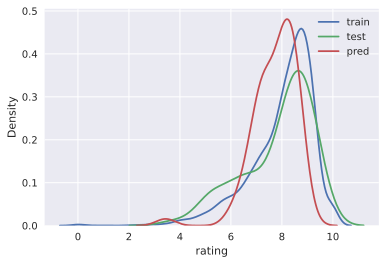

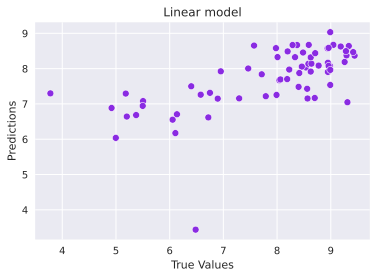

In [109]:
target_distr_linear(y_train, y_test, y_pred)  

In [110]:
calc_metrics(y_test, y_pred)

*** VAL **: 
MSE:   1.0801847872791506
RMSE:  1.0393193865598538
R2:    0.4125145864215821
MAE:   0.8023625891129681
MedAE: 0.6420175131664454
------------------------------


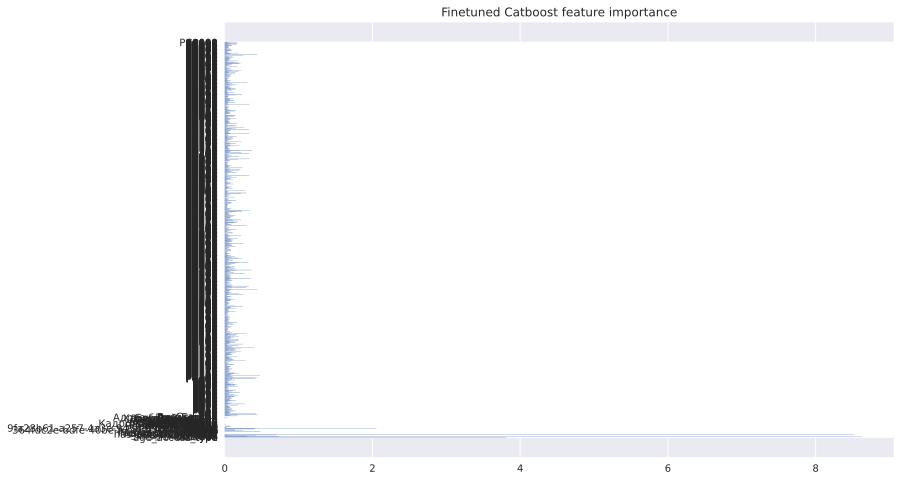

In [111]:
get_feature_imp(best_cat, train_dataset)

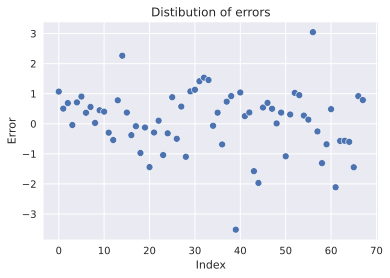

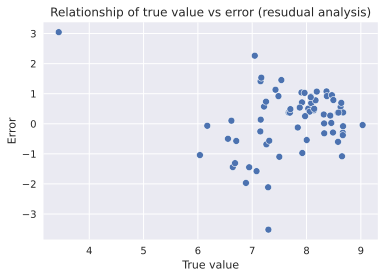

In [112]:
errors = y_test - y_pred
draw_res_analys(errors, y_pred)

In [113]:
test_df['PREDS_tune'] = y_pred.tolist()
test_df

,age_access_type,name,type,release_year,duration,element_uid,BUDGET,MARKETING,RUS,USA,...,Джим Дено,Дариуш Вольски,Харви Вайнштейн,Боб Вайнштейн,Адриан Политовски,Люк Бессон,Стэн Ли,PREDS,TARGET,PREDS_tune
10400,18,Не оставляй меня,SERIAL,2022,17.044733,00de4f79-d52d-4d2c-871c-e6e8432cc3df,NaN,NaN,NaN,NaN,...,0,0,0,0,0,0,0,8.044835,9.258333,8.188285
10300,18,Индекс страха,SERIAL,2022,16.200597,e281b84c-bb78-466a-ac71-c557aacc5c13,NaN,NaN,NaN,NaN,...,0,0,0,0,0,0,0,7.911867,8.536232,8.032230
10322,18,На взводе: Битва за UBER,SERIAL,2022,16.064695,fecde143-2a72-4a70-8efc-188079a62f1a,NaN,NaN,NaN,NaN,...,0,0,0,0,0,0,0,7.884719,8.773810,8.086707
10439,18,Жена путешественника во времени,SERIAL,2022,16.626117,7becd8d8-1fb8-4ee6-b903-47817686ddd8,NaN,NaN,NaN,NaN,...,0,0,0,0,0,0,0,8.366021,8.990000,9.032835
46,16,Боец: Король ринга,MOVIE,2022,15.665539,1f2481e2-55ec-429f-9e3d-6c3ea2087d00,15.894952,NaN,NaN,NaN,...,0,0,0,0,0,0,0,7.830845,8.626496,7.916237
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4414,18,Отряд «Призрак»,MOVIE,2022,15.656060,f132627d-5b3b-443f-bccd-feb92b51d08d,NaN,NaN,NaN,NaN,...,0,0,0,0,0,0,0,7.537429,6.750000,7.314184
4415,12,Падение Луны,MOVIE,2022,15.869634,595c19b8-a22f-4beb-ab9f-5431fd3929ea,18.826146,NaN,15.237295,16.763137,...,0,0,0,0,0,0,0,8.659111,7.979399,8.580153
4417,16,Парни под прикрытием,MOVIE,2022,15.501910,1b9df53f-e556-4f00-8d1f-67b2cc74e01a,NaN,NaN,12.266231,NaN,...,0,0,0,0,0,0,0,6.737643,5.497999,6.944195
3392,16,9 жизней,MOVIE,2022,15.566448,a7979b64-cf82-4c7f-86d8-05670b07d1b0,NaN,NaN,12.154206,NaN,...,0,0,0,0,0,0,0,7.359682,8.400693,7.483476


9940:	learn: 0.0007426	total: 32m 44s	remaining: 11.7s
9941:	learn: 0.0007425	total: 32m 44s	remaining: 11.5s
9942:	learn: 0.0007425	total: 32m 44s	remaining: 11.3s
9943:	learn: 0.0007425	total: 32m 45s	remaining: 11.1s
9944:	learn: 0.0007425	total: 32m 45s	remaining: 10.9s
9945:	learn: 0.0007425	total: 32m 45s	remaining: 10.7s
9946:	learn: 0.0007424	total: 32m 45s	remaining: 10.5s
9947:	learn: 0.0007424	total: 32m 45s	remaining: 10.3s
9948:	learn: 0.0007424	total: 32m 45s	remaining: 10.1s
9949:	learn: 0.0007423	total: 32m 46s	remaining: 9.88s
9950:	learn: 0.0007423	total: 32m 46s	remaining: 9.68s
9951:	learn: 0.0007423	total: 32m 46s	remaining: 9.48s
9952:	learn: 0.0007423	total: 32m 46s	remaining: 9.29s
9953:	learn: 0.0007422	total: 32m 46s	remaining: 9.09s
9954:	learn: 0.0007422	total: 32m 46s	remaining: 8.89s
9955:	learn: 0.0007422	total: 32m 46s	remaining: 8.69s
9956:	learn: 0.0007422	total: 32m 47s	remaining: 8.49s
9957:	learn: 0.0007422	total: 32m 47s	remaining: 8.3s
9958:	learn